# M2177.003100 Deep Learning <br> Assignment #4 Implementing Generative Adversarial Nets - part2 MNIST data

Copyright (C) Data Science Laboratory, Seoul National University. This material is for educational uses only. Some contents are based on the material provided by other paper/book authors and may be copyrighted by them. Written by Chaehun Shin, September 2020

In this notebook, you will learn how to implement Generative Adversarial Networks (GANs) <br>
The goal here is to build GANs that draw hand-written digits (MNIST data) <br> 

**Note**: certain details are missing or ambiguous on purpose, in order to test your knowledge on the related materials. However, if you really feel that something essential is missing and cannot proceed to the next step, then contact the teaching staff with clear description of your problem.

### Submitting your work:
<font color=red>**DO NOT clear the final outputs**</font> so that TAs can grade both your code and results.  
Once you have done **all parts**, run the *CollectSubmission.sh* script with your **Student_ID** as input argument. <br>
This will produce a zipped file called *[Your Student_ID].zip*. Please submit this file on ETL. &nbsp;&nbsp; (Usage: ./*CollectSubmission.sh* &nbsp; Student_ID)

### Some helpful tutorials and references for assignment #4-2:
- [1] Pytorch official tutorials. [[link]](https://pytorch.org/tutorials/)
- [2] Stanford CS231n lectures. [[link]](http://cs231n.stanford.edu/)
- [3] Goodfellow, Ian, et al. "Generative adversarial nets." Advances in neural information processing systems. 2014.
- [4] Mirza, Mehdi, and Simon Osindero. "Conditional generative adversarial nets." arXiv preprint arXiv:1411.1784 (2014).
- [5] Radford, Alec, Luke Metz, and Soumith Chintala. "Unsupervised representation learning with deep convolutional generative adversarial networks." arXiv preprint arXiv:1511.06434 (2015).

## 0. Download and load MNIST datasets
The MNIST datasets will be downloaded into the 'data/mnist' directory. If you want to change the directory the data is saved in, change 'mnist_data_dir' with where you want. <br>

In [1]:
import os
from torchvision.datasets import MNIST
import torchvision.transforms as T

mnist_data_dir = './data/mnist'
dataset = MNIST(root=mnist_data_dir,
               transform=T.ToTensor(), train=True, download=True)
print(dataset.train_data.shape)
print(dataset.train_labels.shape)

torch.Size([60000, 28, 28])
torch.Size([60000])


/home/jaekyungcho/anaconda3/envs/deep-learning-20/lib/python3.8/site-packages/torchvision/datasets/mnist.py:55: UserWarning: train_data has been renamed data
  warnings.warn("train_data has been renamed data")
/home/jaekyungcho/anaconda3/envs/deep-learning-20/lib/python3.8/site-packages/torchvision/datasets/mnist.py:45: UserWarning: train_labels has been renamed targets
  warnings.warn("train_labels has been renamed targets")


## <a name="1"></a> 1. Building a network


In this section, you will implement neural networks for <br>
(1) generator model to draw a digit <br>
(2) discriminator model to distinguish real images from generated images.<br>
You can use some layer function implemented in **'torch.nn'** library (abbretivated as **nn**) or **'torch.nn.functional'** library (abbreviated as **F**) as you want.
Just write the code in whatever way you find most clear.

In [2]:
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

It is time for a generator model.
You can change anything including the argument if you need. Feel Free to implement it.<br>
**(You should output the image as a range (0, 1) with Sigmoid function because we normalize the real images as a range (0, 1))**

In [3]:
h_dim_1 = 256
h_dim_2 = 512
h_dim_3 = 1024

In [4]:
class Generator(nn.Module):
    def __init__(self, latent_dim=10, image_dim=1):
        super().__init__()
        ################ ToDo ################
        self.fc = nn.Sequential(
            nn.Linear(in_features=latent_dim, out_features=h_dim_1),
            nn.ReLU(),
            nn.Linear(in_features=h_dim_1, out_features=h_dim_2),
            nn.ReLU(),
            nn.Linear(in_features=h_dim_2, out_features=h_dim_3),
            nn.ReLU(),
            nn.Linear(in_features=h_dim_3, out_features=784*image_dim),
            nn.Sigmoid()
        )

        
    def forward(self, z):
        ################ ToDo ################
        x = self.fc(z)
        out = x.view((-1,1,28,28))
        
        return out
        

Now, it's time for a discriminator model. Again, you can implement anything if you need. <br>
**(You should output the probability of whether the input image of discriminator is real or not. It means that you use the Sigmoid function at the last layer to make the value being in range (0, 1))**

In [5]:
class Discriminator(nn.Module):
    def __init__(self, img_dim=3):
        super().__init__()
        ################ ToDo ################
        self.fc = nn.Sequential(
            nn.Flatten(),
            nn.utils.spectral_norm(nn.Linear(in_features=784, out_features=h_dim_3)),
            nn.LeakyReLU(0.2),
            nn.utils.spectral_norm(nn.Linear(in_features=h_dim_3,out_features=h_dim_2)),
            nn.LeakyReLU(0.2),
            nn.utils.spectral_norm(nn.Linear(in_features=h_dim_2,out_features=h_dim_1)),
            nn.LeakyReLU(0.2),
            nn.Linear(in_features=h_dim_1,out_features=1),
            nn.Sigmoid()
        )
        
    def forward(self, img):
        ################ ToDo ################
        out = self.fc(img)
            
        return out
    

## <a name="2"></a> 2. Build a main part and train

In this section, you will implement the main part (define criterion variable and D_loss/G_loss to train in TODO parts, you can also use the criterion variable).
Feel free to set the hyperparmeters and fill in the main part.
When you are done, run the following to check your implementations.
In this section, you will implement the main part (define criterion variable and D_loss/G_loss to train in TODO parts).

You must show **at least three generated images** (At the beginning of, in the midway of, at the end of training).

In [6]:
# hyperparameter setting
img_dim=1
img_size = 28
latent_dim = 64
num_D_updates_per_G_update = 1

batch_size = 32
learning_rate = 2e-4
total_iter = 100000

log_freq = 10
viz_freq = 200

gen_num_samples = 50

Iter: 00010/100000, Gen loss: 1.6412, Dis loss: 0.8452
Iter: 00020/100000, Gen loss: 1.7624, Dis loss: 0.6468
Iter: 00030/100000, Gen loss: 1.3413, Dis loss: 1.0624
Iter: 00040/100000, Gen loss: 1.3117, Dis loss: 0.9889
Iter: 00050/100000, Gen loss: 1.3463, Dis loss: 0.9513
Iter: 00060/100000, Gen loss: 1.3871, Dis loss: 0.9105
Iter: 00070/100000, Gen loss: 1.4936, Dis loss: 0.7693
Iter: 00080/100000, Gen loss: 1.8464, Dis loss: 0.5503
Iter: 00090/100000, Gen loss: 2.1731, Dis loss: 0.3823
Iter: 00100/100000, Gen loss: 2.2143, Dis loss: 0.3520
Iter: 00110/100000, Gen loss: 2.3182, Dis loss: 0.3106
Iter: 00120/100000, Gen loss: 2.5486, Dis loss: 0.2414
Iter: 00130/100000, Gen loss: 2.9371, Dis loss: 0.1599
Iter: 00140/100000, Gen loss: 2.8073, Dis loss: 0.1596
Iter: 00150/100000, Gen loss: 2.9749, Dis loss: 0.1336
Iter: 00160/100000, Gen loss: 3.2905, Dis loss: 0.1244
Iter: 00170/100000, Gen loss: 3.2478, Dis loss: 0.1009
Iter: 00180/100000, Gen loss: 3.7816, Dis loss: 0.0975
Iter: 0019

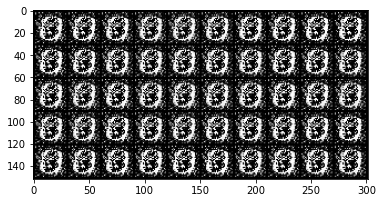

Iter: 00210/100000, Gen loss: 3.6175, Dis loss: 0.0799
Iter: 00220/100000, Gen loss: 2.6435, Dis loss: 0.2371
Iter: 00230/100000, Gen loss: 1.6321, Dis loss: 0.8350
Iter: 00240/100000, Gen loss: 1.3090, Dis loss: 0.9786
Iter: 00250/100000, Gen loss: 1.3508, Dis loss: 1.0483
Iter: 00260/100000, Gen loss: 1.5470, Dis loss: 0.9066
Iter: 00270/100000, Gen loss: 1.7447, Dis loss: 0.5711
Iter: 00280/100000, Gen loss: 2.2191, Dis loss: 0.3503
Iter: 00290/100000, Gen loss: 2.1749, Dis loss: 0.3520
Iter: 00300/100000, Gen loss: 1.9670, Dis loss: 0.5515
Iter: 00310/100000, Gen loss: 1.6402, Dis loss: 0.6322
Iter: 00320/100000, Gen loss: 1.5543, Dis loss: 0.8934
Iter: 00330/100000, Gen loss: 1.9332, Dis loss: 0.5667
Iter: 00340/100000, Gen loss: 1.9256, Dis loss: 0.4117
Iter: 00350/100000, Gen loss: 2.1270, Dis loss: 0.3754
Iter: 00360/100000, Gen loss: 2.0950, Dis loss: 0.3435
Iter: 00370/100000, Gen loss: 2.2123, Dis loss: 0.3691
Iter: 00380/100000, Gen loss: 1.9183, Dis loss: 0.5345
Iter: 0039

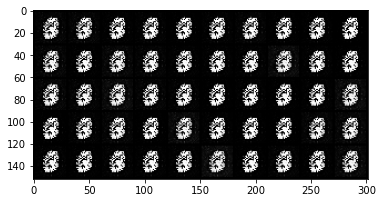

Iter: 00410/100000, Gen loss: 1.7624, Dis loss: 0.6539
Iter: 00420/100000, Gen loss: 1.9275, Dis loss: 0.5707
Iter: 00430/100000, Gen loss: 2.2061, Dis loss: 0.4382
Iter: 00440/100000, Gen loss: 1.9866, Dis loss: 0.5129
Iter: 00450/100000, Gen loss: 1.6108, Dis loss: 0.6860
Iter: 00460/100000, Gen loss: 1.5963, Dis loss: 0.7935
Iter: 00470/100000, Gen loss: 1.6430, Dis loss: 0.7280
Iter: 00480/100000, Gen loss: 1.9516, Dis loss: 0.4429
Iter: 00490/100000, Gen loss: 1.0888, Dis loss: 0.8804
Iter: 00500/100000, Gen loss: 1.0093, Dis loss: 1.4638
Iter: 00510/100000, Gen loss: 0.9492, Dis loss: 1.8763
Iter: 00520/100000, Gen loss: 1.4740, Dis loss: 0.9158
Iter: 00530/100000, Gen loss: 1.7186, Dis loss: 0.6768
Iter: 00540/100000, Gen loss: 2.3579, Dis loss: 0.4688
Iter: 00550/100000, Gen loss: 2.2088, Dis loss: 0.3406
Iter: 00560/100000, Gen loss: 2.6534, Dis loss: 0.2590
Iter: 00570/100000, Gen loss: 2.5122, Dis loss: 0.2358
Iter: 00580/100000, Gen loss: 2.9064, Dis loss: 0.1677
Iter: 0059

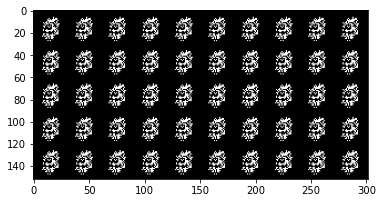

Iter: 00610/100000, Gen loss: 2.7380, Dis loss: 0.1931
Iter: 00620/100000, Gen loss: 2.5019, Dis loss: 0.2029
Iter: 00630/100000, Gen loss: 1.8388, Dis loss: 0.3622
Iter: 00640/100000, Gen loss: 1.6863, Dis loss: 0.4510
Iter: 00650/100000, Gen loss: 2.0523, Dis loss: 0.4196
Iter: 00660/100000, Gen loss: 2.5306, Dis loss: 0.2953
Iter: 00670/100000, Gen loss: 2.5428, Dis loss: 0.2090
Iter: 00680/100000, Gen loss: 2.5946, Dis loss: 0.2023
Iter: 00690/100000, Gen loss: 2.9315, Dis loss: 0.1893
Iter: 00700/100000, Gen loss: 3.2719, Dis loss: 0.1359
Iter: 00710/100000, Gen loss: 2.4754, Dis loss: 0.2146
Iter: 00720/100000, Gen loss: 2.9489, Dis loss: 0.1715
Iter: 00730/100000, Gen loss: 3.2345, Dis loss: 0.1473
Iter: 00740/100000, Gen loss: 3.0961, Dis loss: 0.1269
Iter: 00750/100000, Gen loss: 3.0568, Dis loss: 0.1586
Iter: 00760/100000, Gen loss: 2.0832, Dis loss: 0.2902
Iter: 00770/100000, Gen loss: 2.2583, Dis loss: 0.4317
Iter: 00780/100000, Gen loss: 1.9511, Dis loss: 0.5052
Iter: 0079

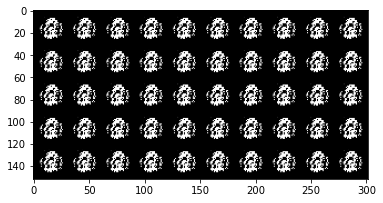

Iter: 00810/100000, Gen loss: 1.7932, Dis loss: 0.4877
Iter: 00820/100000, Gen loss: 2.0091, Dis loss: 0.3696
Iter: 00830/100000, Gen loss: 2.1243, Dis loss: 0.4941
Iter: 00840/100000, Gen loss: 1.8406, Dis loss: 0.4765
Iter: 00850/100000, Gen loss: 1.9008, Dis loss: 0.4589
Iter: 00860/100000, Gen loss: 2.4645, Dis loss: 0.3219
Iter: 00870/100000, Gen loss: 1.9367, Dis loss: 0.4058
Iter: 00880/100000, Gen loss: 1.3803, Dis loss: 0.7348
Iter: 00890/100000, Gen loss: 0.4609, Dis loss: 2.4011
Iter: 00900/100000, Gen loss: 0.6308, Dis loss: 1.8707
Iter: 00910/100000, Gen loss: 0.6332, Dis loss: 1.8732
Iter: 00920/100000, Gen loss: 1.4790, Dis loss: 0.8530
Iter: 00930/100000, Gen loss: 1.3320, Dis loss: 0.6616
Iter: 00940/100000, Gen loss: 1.5324, Dis loss: 0.5720
Iter: 00950/100000, Gen loss: 1.5875, Dis loss: 0.5462
Iter: 00960/100000, Gen loss: 1.7718, Dis loss: 0.4888
Iter: 00970/100000, Gen loss: 1.5548, Dis loss: 0.5345
Iter: 00980/100000, Gen loss: 1.7004, Dis loss: 0.5356
Iter: 0099

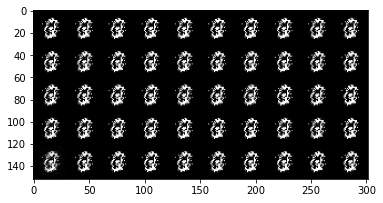

Iter: 01010/100000, Gen loss: 1.0620, Dis loss: 1.1913
Iter: 01020/100000, Gen loss: 1.0569, Dis loss: 1.2551
Iter: 01030/100000, Gen loss: 1.2118, Dis loss: 1.2241
Iter: 01040/100000, Gen loss: 1.5131, Dis loss: 0.7869
Iter: 01050/100000, Gen loss: 1.5160, Dis loss: 0.6268
Iter: 01060/100000, Gen loss: 1.4597, Dis loss: 0.5605
Iter: 01070/100000, Gen loss: 1.2278, Dis loss: 0.8322
Iter: 01080/100000, Gen loss: 1.7723, Dis loss: 0.5035
Iter: 01090/100000, Gen loss: 1.8927, Dis loss: 0.3517
Iter: 01100/100000, Gen loss: 2.3418, Dis loss: 0.2731
Iter: 01110/100000, Gen loss: 1.6498, Dis loss: 0.3701
Iter: 01120/100000, Gen loss: 1.9602, Dis loss: 0.3207
Iter: 01130/100000, Gen loss: 2.1613, Dis loss: 0.2886
Iter: 01140/100000, Gen loss: 2.0045, Dis loss: 0.3334
Iter: 01150/100000, Gen loss: 2.2998, Dis loss: 0.2594
Iter: 01160/100000, Gen loss: 1.5954, Dis loss: 0.4412
Iter: 01170/100000, Gen loss: 2.2033, Dis loss: 0.3881
Iter: 01180/100000, Gen loss: 2.0632, Dis loss: 0.3348
Iter: 0119

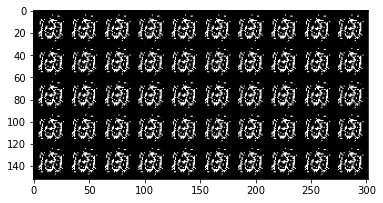

Iter: 01210/100000, Gen loss: 1.7378, Dis loss: 0.6311
Iter: 01220/100000, Gen loss: 2.3413, Dis loss: 0.3344
Iter: 01230/100000, Gen loss: 2.4654, Dis loss: 0.3274
Iter: 01240/100000, Gen loss: 2.2910, Dis loss: 0.2765
Iter: 01250/100000, Gen loss: 2.8722, Dis loss: 0.2272
Iter: 01260/100000, Gen loss: 3.0037, Dis loss: 0.1875
Iter: 01270/100000, Gen loss: 2.5668, Dis loss: 0.1842
Iter: 01280/100000, Gen loss: 2.7186, Dis loss: 0.1769
Iter: 01290/100000, Gen loss: 2.3480, Dis loss: 0.2474
Iter: 01300/100000, Gen loss: 1.9256, Dis loss: 0.3379
Iter: 01310/100000, Gen loss: 0.8628, Dis loss: 1.2490
Iter: 01320/100000, Gen loss: 0.3537, Dis loss: 2.6915
Iter: 01330/100000, Gen loss: 0.3253, Dis loss: 2.5828
Iter: 01340/100000, Gen loss: 0.6268, Dis loss: 1.6640
Iter: 01350/100000, Gen loss: 1.2481, Dis loss: 0.8636
Iter: 01360/100000, Gen loss: 1.5486, Dis loss: 0.6088
Iter: 01370/100000, Gen loss: 1.6413, Dis loss: 0.4982
Iter: 01380/100000, Gen loss: 1.4419, Dis loss: 0.5246
Iter: 0139

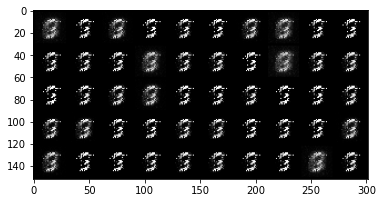

Iter: 01410/100000, Gen loss: 1.3589, Dis loss: 0.8156
Iter: 01420/100000, Gen loss: 1.1241, Dis loss: 0.7350
Iter: 01430/100000, Gen loss: 1.2369, Dis loss: 0.8027
Iter: 01440/100000, Gen loss: 1.0393, Dis loss: 0.8594
Iter: 01450/100000, Gen loss: 0.8603, Dis loss: 1.1238
Iter: 01460/100000, Gen loss: 0.9914, Dis loss: 1.1385
Iter: 01470/100000, Gen loss: 1.4317, Dis loss: 0.7467
Iter: 01480/100000, Gen loss: 1.5718, Dis loss: 0.6364
Iter: 01490/100000, Gen loss: 1.2189, Dis loss: 1.0261
Iter: 01500/100000, Gen loss: 0.4391, Dis loss: 1.9803
Iter: 01510/100000, Gen loss: 0.8799, Dis loss: 1.7204
Iter: 01520/100000, Gen loss: 0.9322, Dis loss: 1.3290
Iter: 01530/100000, Gen loss: 1.3878, Dis loss: 0.8528
Iter: 01540/100000, Gen loss: 1.3245, Dis loss: 0.7651
Iter: 01550/100000, Gen loss: 1.4844, Dis loss: 0.7362
Iter: 01560/100000, Gen loss: 1.1282, Dis loss: 0.9617
Iter: 01570/100000, Gen loss: 1.1616, Dis loss: 1.1766
Iter: 01580/100000, Gen loss: 1.4298, Dis loss: 0.7814
Iter: 0159

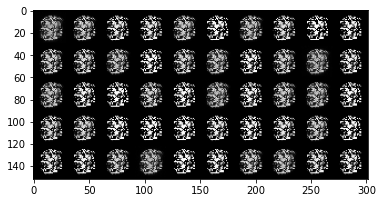

Iter: 01610/100000, Gen loss: 1.1005, Dis loss: 1.0064
Iter: 01620/100000, Gen loss: 0.8485, Dis loss: 1.3905
Iter: 01630/100000, Gen loss: 0.7687, Dis loss: 1.9780
Iter: 01640/100000, Gen loss: 1.0624, Dis loss: 1.4316
Iter: 01650/100000, Gen loss: 1.2298, Dis loss: 0.7758
Iter: 01660/100000, Gen loss: 1.3692, Dis loss: 0.7241
Iter: 01670/100000, Gen loss: 1.2304, Dis loss: 0.9351
Iter: 01680/100000, Gen loss: 1.1401, Dis loss: 0.8773
Iter: 01690/100000, Gen loss: 1.0363, Dis loss: 1.0570
Iter: 01700/100000, Gen loss: 0.9550, Dis loss: 0.9644
Iter: 01710/100000, Gen loss: 0.7273, Dis loss: 1.3509
Iter: 01720/100000, Gen loss: 0.8755, Dis loss: 1.0924
Iter: 01730/100000, Gen loss: 1.5590, Dis loss: 0.6851
Iter: 01740/100000, Gen loss: 1.9657, Dis loss: 0.4066
Iter: 01750/100000, Gen loss: 2.1511, Dis loss: 0.3569
Iter: 01760/100000, Gen loss: 2.2376, Dis loss: 0.2712
Iter: 01770/100000, Gen loss: 2.1718, Dis loss: 0.3328
Iter: 01780/100000, Gen loss: 2.3316, Dis loss: 0.2733
Iter: 0179

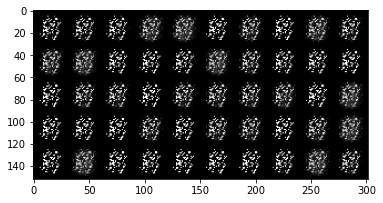

Iter: 01810/100000, Gen loss: 1.5244, Dis loss: 0.7007
Iter: 01820/100000, Gen loss: 1.3805, Dis loss: 0.7805
Iter: 01830/100000, Gen loss: 1.1647, Dis loss: 0.8667
Iter: 01840/100000, Gen loss: 1.0626, Dis loss: 1.1316
Iter: 01850/100000, Gen loss: 0.9202, Dis loss: 1.3141
Iter: 01860/100000, Gen loss: 0.7148, Dis loss: 1.6308
Iter: 01870/100000, Gen loss: 0.9599, Dis loss: 1.5660
Iter: 01880/100000, Gen loss: 1.1599, Dis loss: 1.1154
Iter: 01890/100000, Gen loss: 1.5723, Dis loss: 0.6016
Iter: 01900/100000, Gen loss: 1.8817, Dis loss: 0.5060
Iter: 01910/100000, Gen loss: 1.6115, Dis loss: 0.5698
Iter: 01920/100000, Gen loss: 1.3709, Dis loss: 0.7519
Iter: 01930/100000, Gen loss: 0.9911, Dis loss: 1.0106
Iter: 01940/100000, Gen loss: 0.7599, Dis loss: 1.3458
Iter: 01950/100000, Gen loss: 0.7993, Dis loss: 1.3313
Iter: 01960/100000, Gen loss: 0.8805, Dis loss: 1.2462
Iter: 01970/100000, Gen loss: 0.6788, Dis loss: 1.3945
Iter: 01980/100000, Gen loss: 0.6663, Dis loss: 1.6247
Iter: 0199

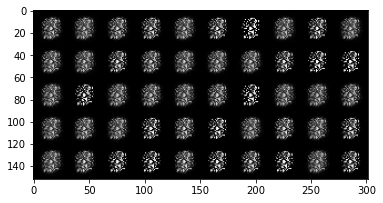

Iter: 02010/100000, Gen loss: 1.0967, Dis loss: 0.9599
Iter: 02020/100000, Gen loss: 0.9811, Dis loss: 0.9428
Iter: 02030/100000, Gen loss: 0.7289, Dis loss: 1.2859
Iter: 02040/100000, Gen loss: 0.5156, Dis loss: 1.7704
Iter: 02050/100000, Gen loss: 0.6581, Dis loss: 1.5460
Iter: 02060/100000, Gen loss: 0.9696, Dis loss: 1.1017
Iter: 02070/100000, Gen loss: 0.9768, Dis loss: 1.0083
Iter: 02080/100000, Gen loss: 0.8235, Dis loss: 1.0781
Iter: 02090/100000, Gen loss: 0.7524, Dis loss: 1.2912
Iter: 02100/100000, Gen loss: 0.6175, Dis loss: 1.5700
Iter: 02110/100000, Gen loss: 0.6046, Dis loss: 1.7377
Iter: 02120/100000, Gen loss: 0.9394, Dis loss: 1.2996
Iter: 02130/100000, Gen loss: 1.0368, Dis loss: 1.0579
Iter: 02140/100000, Gen loss: 0.8538, Dis loss: 1.1836
Iter: 02150/100000, Gen loss: 0.7328, Dis loss: 1.3598
Iter: 02160/100000, Gen loss: 0.6164, Dis loss: 1.6127
Iter: 02170/100000, Gen loss: 0.6367, Dis loss: 1.5684
Iter: 02180/100000, Gen loss: 0.7633, Dis loss: 1.4279
Iter: 0219

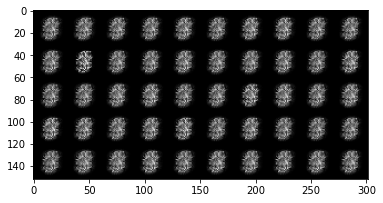

Iter: 02210/100000, Gen loss: 0.6929, Dis loss: 1.4500
Iter: 02220/100000, Gen loss: 0.6487, Dis loss: 1.6777
Iter: 02230/100000, Gen loss: 0.8748, Dis loss: 1.3433
Iter: 02240/100000, Gen loss: 0.8483, Dis loss: 1.1933
Iter: 02250/100000, Gen loss: 0.6387, Dis loss: 1.6135
Iter: 02260/100000, Gen loss: 0.5413, Dis loss: 1.7927
Iter: 02270/100000, Gen loss: 0.7615, Dis loss: 1.4180
Iter: 02280/100000, Gen loss: 0.9301, Dis loss: 1.0577
Iter: 02290/100000, Gen loss: 0.8829, Dis loss: 1.0625
Iter: 02300/100000, Gen loss: 0.7927, Dis loss: 1.2428
Iter: 02310/100000, Gen loss: 0.6462, Dis loss: 1.5787
Iter: 02320/100000, Gen loss: 0.5608, Dis loss: 1.7463
Iter: 02330/100000, Gen loss: 0.6772, Dis loss: 1.6255
Iter: 02340/100000, Gen loss: 0.7616, Dis loss: 1.3035
Iter: 02350/100000, Gen loss: 0.7972, Dis loss: 1.2489
Iter: 02360/100000, Gen loss: 0.6959, Dis loss: 1.3655
Iter: 02370/100000, Gen loss: 0.5585, Dis loss: 1.7378
Iter: 02380/100000, Gen loss: 0.4877, Dis loss: 1.8637
Iter: 0239

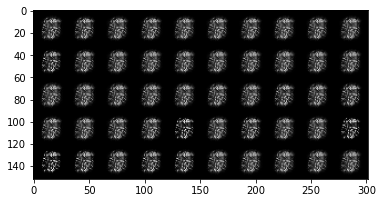

Iter: 02410/100000, Gen loss: 0.7514, Dis loss: 1.3162
Iter: 02420/100000, Gen loss: 0.7044, Dis loss: 1.3828
Iter: 02430/100000, Gen loss: 0.8585, Dis loss: 1.3104
Iter: 02440/100000, Gen loss: 0.9118, Dis loss: 1.0768
Iter: 02450/100000, Gen loss: 0.9213, Dis loss: 1.0630
Iter: 02460/100000, Gen loss: 0.8673, Dis loss: 1.1947
Iter: 02470/100000, Gen loss: 0.8624, Dis loss: 1.2443
Iter: 02480/100000, Gen loss: 0.7606, Dis loss: 1.3209
Iter: 02490/100000, Gen loss: 0.6606, Dis loss: 1.5525
Iter: 02500/100000, Gen loss: 0.6120, Dis loss: 1.5974
Iter: 02510/100000, Gen loss: 0.6451, Dis loss: 1.5161
Iter: 02520/100000, Gen loss: 0.7494, Dis loss: 1.3018
Iter: 02530/100000, Gen loss: 0.6966, Dis loss: 1.3782
Iter: 02540/100000, Gen loss: 0.5370, Dis loss: 1.7033
Iter: 02550/100000, Gen loss: 0.5090, Dis loss: 1.7821
Iter: 02560/100000, Gen loss: 0.6731, Dis loss: 1.5636
Iter: 02570/100000, Gen loss: 0.8184, Dis loss: 1.3051
Iter: 02580/100000, Gen loss: 0.8006, Dis loss: 1.2467
Iter: 0259

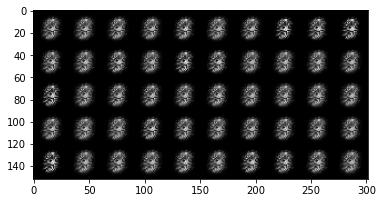

Iter: 02610/100000, Gen loss: 0.7522, Dis loss: 1.2935
Iter: 02620/100000, Gen loss: 0.8656, Dis loss: 1.1541
Iter: 02630/100000, Gen loss: 0.9271, Dis loss: 1.0454
Iter: 02640/100000, Gen loss: 0.9215, Dis loss: 1.1290
Iter: 02650/100000, Gen loss: 0.7985, Dis loss: 1.3272
Iter: 02660/100000, Gen loss: 0.6979, Dis loss: 1.4873
Iter: 02670/100000, Gen loss: 0.5979, Dis loss: 1.6147
Iter: 02680/100000, Gen loss: 0.5959, Dis loss: 1.7504
Iter: 02690/100000, Gen loss: 0.7432, Dis loss: 1.4950
Iter: 02700/100000, Gen loss: 0.8039, Dis loss: 1.3419
Iter: 02710/100000, Gen loss: 0.7936, Dis loss: 1.3002
Iter: 02720/100000, Gen loss: 0.6706, Dis loss: 1.4220
Iter: 02730/100000, Gen loss: 0.5207, Dis loss: 1.7118
Iter: 02740/100000, Gen loss: 0.4879, Dis loss: 1.7618
Iter: 02750/100000, Gen loss: 0.6239, Dis loss: 1.5147
Iter: 02760/100000, Gen loss: 0.7628, Dis loss: 1.2828
Iter: 02770/100000, Gen loss: 0.8235, Dis loss: 1.1967
Iter: 02780/100000, Gen loss: 0.8100, Dis loss: 1.1683
Iter: 0279

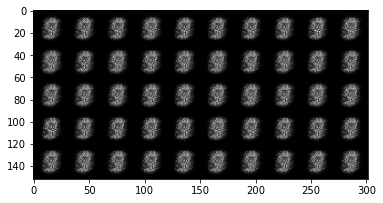

Iter: 02810/100000, Gen loss: 0.7687, Dis loss: 1.2837
Iter: 02820/100000, Gen loss: 0.7595, Dis loss: 1.3190
Iter: 02830/100000, Gen loss: 0.7586, Dis loss: 1.3060
Iter: 02840/100000, Gen loss: 0.7766, Dis loss: 1.2730
Iter: 02850/100000, Gen loss: 0.8488, Dis loss: 1.2116
Iter: 02860/100000, Gen loss: 0.8286, Dis loss: 1.1870
Iter: 02870/100000, Gen loss: 0.7412, Dis loss: 1.2959
Iter: 02880/100000, Gen loss: 0.6546, Dis loss: 1.5233
Iter: 02890/100000, Gen loss: 0.5580, Dis loss: 1.6023
Iter: 02900/100000, Gen loss: 0.5477, Dis loss: 1.7446
Iter: 02910/100000, Gen loss: 0.5757, Dis loss: 1.5911
Iter: 02920/100000, Gen loss: 0.6350, Dis loss: 1.5221
Iter: 02930/100000, Gen loss: 0.6677, Dis loss: 1.4821
Iter: 02940/100000, Gen loss: 0.6795, Dis loss: 1.4351
Iter: 02950/100000, Gen loss: 0.6749, Dis loss: 1.4071
Iter: 02960/100000, Gen loss: 0.6591, Dis loss: 1.4066
Iter: 02970/100000, Gen loss: 0.6590, Dis loss: 1.4720
Iter: 02980/100000, Gen loss: 0.6653, Dis loss: 1.3877
Iter: 0299

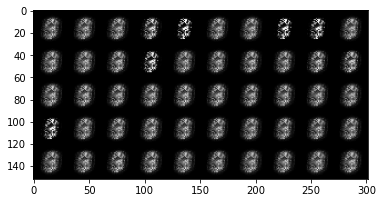

Iter: 03010/100000, Gen loss: 0.8240, Dis loss: 1.2130
Iter: 03020/100000, Gen loss: 0.8491, Dis loss: 1.1757
Iter: 03030/100000, Gen loss: 0.8581, Dis loss: 1.1644
Iter: 03040/100000, Gen loss: 0.8330, Dis loss: 1.1661
Iter: 03050/100000, Gen loss: 0.8083, Dis loss: 1.2041
Iter: 03060/100000, Gen loss: 0.7500, Dis loss: 1.3290
Iter: 03070/100000, Gen loss: 0.6939, Dis loss: 1.4606
Iter: 03080/100000, Gen loss: 0.6290, Dis loss: 1.5457
Iter: 03090/100000, Gen loss: 0.5933, Dis loss: 1.5751
Iter: 03100/100000, Gen loss: 0.6313, Dis loss: 1.5103
Iter: 03110/100000, Gen loss: 0.6872, Dis loss: 1.4350
Iter: 03120/100000, Gen loss: 0.7223, Dis loss: 1.3671
Iter: 03130/100000, Gen loss: 0.7389, Dis loss: 1.3289
Iter: 03140/100000, Gen loss: 0.7436, Dis loss: 1.3133
Iter: 03150/100000, Gen loss: 0.7589, Dis loss: 1.3219
Iter: 03160/100000, Gen loss: 0.8052, Dis loss: 1.2925
Iter: 03170/100000, Gen loss: 0.8405, Dis loss: 1.2629
Iter: 03180/100000, Gen loss: 0.8499, Dis loss: 1.2128
Iter: 0319

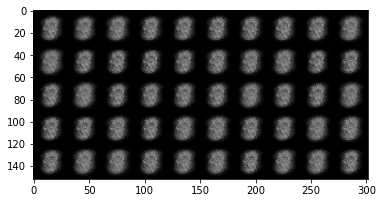

Iter: 03210/100000, Gen loss: 0.8161, Dis loss: 1.2102
Iter: 03220/100000, Gen loss: 0.7601, Dis loss: 1.2822
Iter: 03230/100000, Gen loss: 0.7237, Dis loss: 1.3191
Iter: 03240/100000, Gen loss: 0.6619, Dis loss: 1.5020
Iter: 03250/100000, Gen loss: 0.5756, Dis loss: 1.5351
Iter: 03260/100000, Gen loss: 0.6045, Dis loss: 1.5934
Iter: 03270/100000, Gen loss: 0.6184, Dis loss: 1.5682
Iter: 03280/100000, Gen loss: 0.6401, Dis loss: 1.4286
Iter: 03290/100000, Gen loss: 0.7602, Dis loss: 1.3345
Iter: 03300/100000, Gen loss: 0.8416, Dis loss: 1.1911
Iter: 03310/100000, Gen loss: 0.8249, Dis loss: 1.1452
Iter: 03320/100000, Gen loss: 0.8357, Dis loss: 1.1596
Iter: 03330/100000, Gen loss: 0.7953, Dis loss: 1.2301
Iter: 03340/100000, Gen loss: 0.7762, Dis loss: 1.2739
Iter: 03350/100000, Gen loss: 0.7943, Dis loss: 1.3274
Iter: 03360/100000, Gen loss: 0.7874, Dis loss: 1.2540
Iter: 03370/100000, Gen loss: 0.8706, Dis loss: 1.2082
Iter: 03380/100000, Gen loss: 0.9116, Dis loss: 1.1047
Iter: 0339

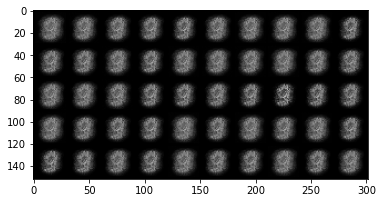

Iter: 03410/100000, Gen loss: 0.9131, Dis loss: 1.1128
Iter: 03420/100000, Gen loss: 0.7069, Dis loss: 1.2697
Iter: 03430/100000, Gen loss: 0.6645, Dis loss: 1.5291
Iter: 03440/100000, Gen loss: 0.6022, Dis loss: 1.6302
Iter: 03450/100000, Gen loss: 0.7115, Dis loss: 1.3810
Iter: 03460/100000, Gen loss: 0.8602, Dis loss: 1.1077
Iter: 03470/100000, Gen loss: 0.9779, Dis loss: 0.9224
Iter: 03480/100000, Gen loss: 1.0361, Dis loss: 0.8721
Iter: 03490/100000, Gen loss: 1.0199, Dis loss: 0.8739
Iter: 03500/100000, Gen loss: 0.8908, Dis loss: 1.1716
Iter: 03510/100000, Gen loss: 0.8056, Dis loss: 1.1783
Iter: 03520/100000, Gen loss: 0.7601, Dis loss: 1.2148
Iter: 03530/100000, Gen loss: 0.8413, Dis loss: 1.2132
Iter: 03540/100000, Gen loss: 0.9229, Dis loss: 1.1876
Iter: 03550/100000, Gen loss: 0.9612, Dis loss: 1.1090
Iter: 03560/100000, Gen loss: 1.0409, Dis loss: 1.0545
Iter: 03570/100000, Gen loss: 0.9042, Dis loss: 1.1805
Iter: 03580/100000, Gen loss: 0.8297, Dis loss: 1.4263
Iter: 0359

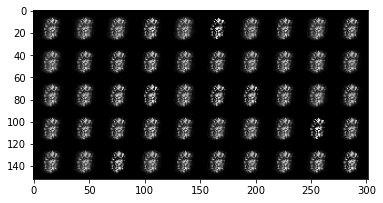

Iter: 03610/100000, Gen loss: 0.9095, Dis loss: 1.0453
Iter: 03620/100000, Gen loss: 0.8544, Dis loss: 1.1525
Iter: 03630/100000, Gen loss: 0.9289, Dis loss: 1.1487
Iter: 03640/100000, Gen loss: 1.1456, Dis loss: 0.9278
Iter: 03650/100000, Gen loss: 1.3602, Dis loss: 0.6645
Iter: 03660/100000, Gen loss: 1.3447, Dis loss: 0.6929
Iter: 03670/100000, Gen loss: 1.1340, Dis loss: 0.7981
Iter: 03680/100000, Gen loss: 0.9684, Dis loss: 1.0708
Iter: 03690/100000, Gen loss: 0.8199, Dis loss: 1.3504
Iter: 03700/100000, Gen loss: 0.8497, Dis loss: 1.3946
Iter: 03710/100000, Gen loss: 0.8289, Dis loss: 1.4507
Iter: 03720/100000, Gen loss: 0.8974, Dis loss: 1.4306
Iter: 03730/100000, Gen loss: 1.1287, Dis loss: 0.9645
Iter: 03740/100000, Gen loss: 1.2248, Dis loss: 0.8207
Iter: 03750/100000, Gen loss: 1.2335, Dis loss: 0.9126
Iter: 03760/100000, Gen loss: 0.9594, Dis loss: 1.1412
Iter: 03770/100000, Gen loss: 0.7348, Dis loss: 1.3251
Iter: 03780/100000, Gen loss: 0.9248, Dis loss: 1.3312
Iter: 0379

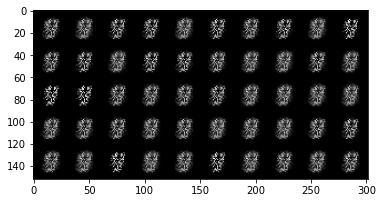

Iter: 03810/100000, Gen loss: 1.0085, Dis loss: 0.8628
Iter: 03820/100000, Gen loss: 0.9754, Dis loss: 0.9864
Iter: 03830/100000, Gen loss: 0.9762, Dis loss: 0.9413
Iter: 03840/100000, Gen loss: 1.1213, Dis loss: 0.8132
Iter: 03850/100000, Gen loss: 1.1912, Dis loss: 0.7963
Iter: 03860/100000, Gen loss: 1.1551, Dis loss: 0.9032
Iter: 03870/100000, Gen loss: 1.2918, Dis loss: 0.7760
Iter: 03880/100000, Gen loss: 1.2316, Dis loss: 0.7920
Iter: 03890/100000, Gen loss: 1.1711, Dis loss: 1.0585
Iter: 03900/100000, Gen loss: 1.2426, Dis loss: 1.1003
Iter: 03910/100000, Gen loss: 1.2035, Dis loss: 0.9812
Iter: 03920/100000, Gen loss: 1.4787, Dis loss: 0.8518
Iter: 03930/100000, Gen loss: 1.6378, Dis loss: 0.8724
Iter: 03940/100000, Gen loss: 1.6854, Dis loss: 0.5199
Iter: 03950/100000, Gen loss: 1.7687, Dis loss: 0.4884
Iter: 03960/100000, Gen loss: 1.6007, Dis loss: 0.7062
Iter: 03970/100000, Gen loss: 1.3313, Dis loss: 1.0020
Iter: 03980/100000, Gen loss: 1.0220, Dis loss: 1.2021
Iter: 0399

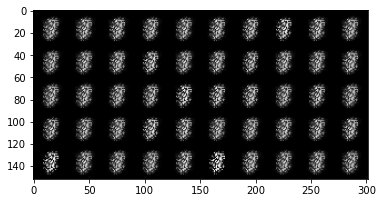

Iter: 04010/100000, Gen loss: 0.8078, Dis loss: 1.4833
Iter: 04020/100000, Gen loss: 0.9723, Dis loss: 1.1429
Iter: 04030/100000, Gen loss: 1.1721, Dis loss: 0.8691
Iter: 04040/100000, Gen loss: 1.2777, Dis loss: 0.7271
Iter: 04050/100000, Gen loss: 1.2061, Dis loss: 0.8879
Iter: 04060/100000, Gen loss: 1.0972, Dis loss: 0.9262
Iter: 04070/100000, Gen loss: 1.1864, Dis loss: 0.9410
Iter: 04080/100000, Gen loss: 1.1251, Dis loss: 0.9581
Iter: 04090/100000, Gen loss: 1.2763, Dis loss: 0.8414
Iter: 04100/100000, Gen loss: 1.3760, Dis loss: 0.7650
Iter: 04110/100000, Gen loss: 1.1193, Dis loss: 0.7689
Iter: 04120/100000, Gen loss: 1.2157, Dis loss: 1.2806
Iter: 04130/100000, Gen loss: 1.3013, Dis loss: 1.1512
Iter: 04140/100000, Gen loss: 1.1204, Dis loss: 0.9355
Iter: 04150/100000, Gen loss: 0.9923, Dis loss: 1.1085
Iter: 04160/100000, Gen loss: 1.0482, Dis loss: 1.1796
Iter: 04170/100000, Gen loss: 1.2641, Dis loss: 0.9577
Iter: 04180/100000, Gen loss: 1.1442, Dis loss: 0.9275
Iter: 0419

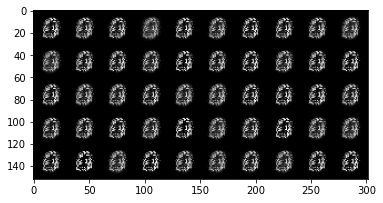

Iter: 04210/100000, Gen loss: 1.0351, Dis loss: 1.2403
Iter: 04220/100000, Gen loss: 1.2756, Dis loss: 0.7161
Iter: 04230/100000, Gen loss: 1.3319, Dis loss: 0.7624
Iter: 04240/100000, Gen loss: 1.1742, Dis loss: 0.8147
Iter: 04250/100000, Gen loss: 0.7608, Dis loss: 1.3976
Iter: 04260/100000, Gen loss: 0.8373, Dis loss: 1.6415
Iter: 04270/100000, Gen loss: 0.9410, Dis loss: 1.4131
Iter: 04280/100000, Gen loss: 1.2238, Dis loss: 0.9626
Iter: 04290/100000, Gen loss: 1.2588, Dis loss: 0.8320
Iter: 04300/100000, Gen loss: 1.1720, Dis loss: 0.8306
Iter: 04310/100000, Gen loss: 1.1723, Dis loss: 0.9936
Iter: 04320/100000, Gen loss: 1.2615, Dis loss: 1.2832
Iter: 04330/100000, Gen loss: 1.3343, Dis loss: 0.9222
Iter: 04340/100000, Gen loss: 1.6480, Dis loss: 0.6566
Iter: 04350/100000, Gen loss: 1.4400, Dis loss: 0.6900
Iter: 04360/100000, Gen loss: 1.4972, Dis loss: 0.8186
Iter: 04370/100000, Gen loss: 1.3756, Dis loss: 1.0276
Iter: 04380/100000, Gen loss: 1.1067, Dis loss: 0.9637
Iter: 0439

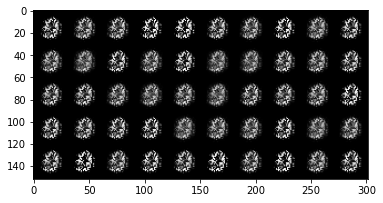

Iter: 04410/100000, Gen loss: 1.0854, Dis loss: 1.1433
Iter: 04420/100000, Gen loss: 0.7946, Dis loss: 1.7141
Iter: 04430/100000, Gen loss: 0.9039, Dis loss: 1.3964
Iter: 04440/100000, Gen loss: 1.0143, Dis loss: 1.0056
Iter: 04450/100000, Gen loss: 1.4190, Dis loss: 0.7110
Iter: 04460/100000, Gen loss: 1.6594, Dis loss: 0.4985
Iter: 04470/100000, Gen loss: 1.6558, Dis loss: 0.4644
Iter: 04480/100000, Gen loss: 1.5614, Dis loss: 0.6505
Iter: 04490/100000, Gen loss: 1.2576, Dis loss: 0.8066
Iter: 04500/100000, Gen loss: 1.3132, Dis loss: 0.7349
Iter: 04510/100000, Gen loss: 1.1802, Dis loss: 1.1170
Iter: 04520/100000, Gen loss: 0.9380, Dis loss: 1.4604
Iter: 04530/100000, Gen loss: 0.9258, Dis loss: 1.5539
Iter: 04540/100000, Gen loss: 0.8287, Dis loss: 1.4896
Iter: 04550/100000, Gen loss: 0.9378, Dis loss: 1.1027
Iter: 04560/100000, Gen loss: 1.0717, Dis loss: 0.9225
Iter: 04570/100000, Gen loss: 1.1112, Dis loss: 0.8473
Iter: 04580/100000, Gen loss: 1.1552, Dis loss: 0.8950
Iter: 0459

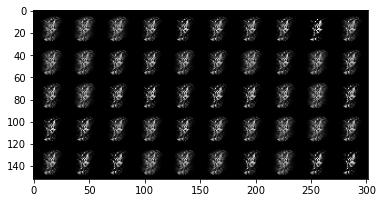

Iter: 04610/100000, Gen loss: 1.0041, Dis loss: 0.9746
Iter: 04620/100000, Gen loss: 1.0225, Dis loss: 1.0296
Iter: 04630/100000, Gen loss: 1.0587, Dis loss: 1.0679
Iter: 04640/100000, Gen loss: 1.2819, Dis loss: 1.0035
Iter: 04650/100000, Gen loss: 1.5479, Dis loss: 0.7384
Iter: 04660/100000, Gen loss: 1.6290, Dis loss: 0.6723
Iter: 04670/100000, Gen loss: 1.5329, Dis loss: 0.7867
Iter: 04680/100000, Gen loss: 1.5998, Dis loss: 0.8736
Iter: 04690/100000, Gen loss: 1.2717, Dis loss: 1.1801
Iter: 04700/100000, Gen loss: 1.2102, Dis loss: 1.3258
Iter: 04710/100000, Gen loss: 1.0887, Dis loss: 1.5725
Iter: 04720/100000, Gen loss: 1.0498, Dis loss: 1.5340
Iter: 04730/100000, Gen loss: 1.0388, Dis loss: 1.2429
Iter: 04740/100000, Gen loss: 1.2531, Dis loss: 1.0424
Iter: 04750/100000, Gen loss: 1.3305, Dis loss: 0.6590
Iter: 04760/100000, Gen loss: 1.4322, Dis loss: 0.8644
Iter: 04770/100000, Gen loss: 1.1459, Dis loss: 1.0658
Iter: 04780/100000, Gen loss: 0.9169, Dis loss: 1.4082
Iter: 0479

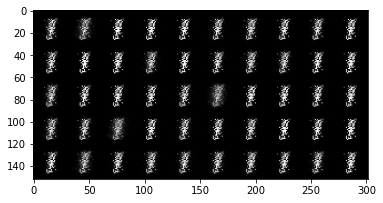

Iter: 04810/100000, Gen loss: 1.1695, Dis loss: 0.9860
Iter: 04820/100000, Gen loss: 1.2317, Dis loss: 0.8036
Iter: 04830/100000, Gen loss: 1.2792, Dis loss: 0.9732
Iter: 04840/100000, Gen loss: 1.2313, Dis loss: 0.8402
Iter: 04850/100000, Gen loss: 1.4906, Dis loss: 0.7129
Iter: 04860/100000, Gen loss: 1.3490, Dis loss: 0.9042
Iter: 04870/100000, Gen loss: 1.3158, Dis loss: 0.9775
Iter: 04880/100000, Gen loss: 1.3538, Dis loss: 1.2155
Iter: 04890/100000, Gen loss: 1.4213, Dis loss: 1.0106
Iter: 04900/100000, Gen loss: 1.4407, Dis loss: 0.8583
Iter: 04910/100000, Gen loss: 1.5541, Dis loss: 0.7391
Iter: 04920/100000, Gen loss: 1.3558, Dis loss: 0.8971
Iter: 04930/100000, Gen loss: 0.9944, Dis loss: 1.1016
Iter: 04940/100000, Gen loss: 1.2884, Dis loss: 1.5055
Iter: 04950/100000, Gen loss: 0.9634, Dis loss: 1.4299
Iter: 04960/100000, Gen loss: 1.1805, Dis loss: 1.0313
Iter: 04970/100000, Gen loss: 1.2164, Dis loss: 0.8911
Iter: 04980/100000, Gen loss: 1.1977, Dis loss: 0.8974
Iter: 0499

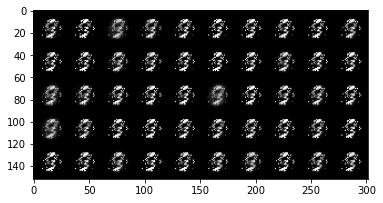

Iter: 05010/100000, Gen loss: 1.2513, Dis loss: 0.7318
Iter: 05020/100000, Gen loss: 1.3483, Dis loss: 0.7651
Iter: 05030/100000, Gen loss: 1.1780, Dis loss: 0.8187
Iter: 05040/100000, Gen loss: 0.9700, Dis loss: 1.1128
Iter: 05050/100000, Gen loss: 1.2512, Dis loss: 0.9349
Iter: 05060/100000, Gen loss: 1.3191, Dis loss: 0.7167
Iter: 05070/100000, Gen loss: 1.5720, Dis loss: 0.6467
Iter: 05080/100000, Gen loss: 1.6584, Dis loss: 0.6305
Iter: 05090/100000, Gen loss: 1.9587, Dis loss: 0.4853
Iter: 05100/100000, Gen loss: 1.9072, Dis loss: 0.4945
Iter: 05110/100000, Gen loss: 2.0850, Dis loss: 0.5881
Iter: 05120/100000, Gen loss: 2.2667, Dis loss: 0.5779
Iter: 05130/100000, Gen loss: 1.9002, Dis loss: 0.5380
Iter: 05140/100000, Gen loss: 1.5373, Dis loss: 0.7549
Iter: 05150/100000, Gen loss: 0.9310, Dis loss: 1.3519
Iter: 05160/100000, Gen loss: 0.8509, Dis loss: 1.6318
Iter: 05170/100000, Gen loss: 1.1439, Dis loss: 1.0365
Iter: 05180/100000, Gen loss: 1.4450, Dis loss: 0.7159
Iter: 0519

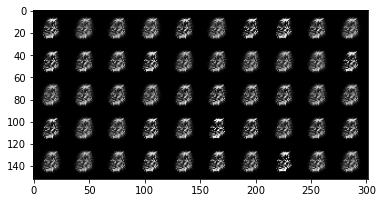

Iter: 05210/100000, Gen loss: 1.1527, Dis loss: 0.9401
Iter: 05220/100000, Gen loss: 1.0273, Dis loss: 1.0224
Iter: 05230/100000, Gen loss: 1.0309, Dis loss: 1.1007
Iter: 05240/100000, Gen loss: 1.1762, Dis loss: 0.7847
Iter: 05250/100000, Gen loss: 1.2573, Dis loss: 0.7676
Iter: 05260/100000, Gen loss: 1.3444, Dis loss: 0.7359
Iter: 05270/100000, Gen loss: 1.4067, Dis loss: 0.6004
Iter: 05280/100000, Gen loss: 1.3935, Dis loss: 0.5518
Iter: 05290/100000, Gen loss: 1.4954, Dis loss: 0.7026
Iter: 05300/100000, Gen loss: 1.3598, Dis loss: 0.7865
Iter: 05310/100000, Gen loss: 1.4495, Dis loss: 0.7543
Iter: 05320/100000, Gen loss: 1.4460, Dis loss: 1.0180
Iter: 05330/100000, Gen loss: 1.5226, Dis loss: 0.6247
Iter: 05340/100000, Gen loss: 1.5342, Dis loss: 0.9743
Iter: 05350/100000, Gen loss: 1.4774, Dis loss: 0.7218
Iter: 05360/100000, Gen loss: 1.5341, Dis loss: 0.5961
Iter: 05370/100000, Gen loss: 1.5166, Dis loss: 0.7798
Iter: 05380/100000, Gen loss: 1.3305, Dis loss: 0.6861
Iter: 0539

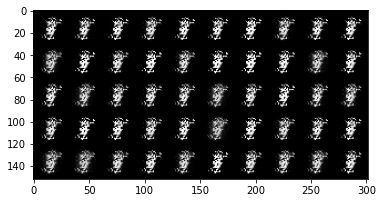

Iter: 05410/100000, Gen loss: 1.2074, Dis loss: 1.4865
Iter: 05420/100000, Gen loss: 1.2816, Dis loss: 0.8584
Iter: 05430/100000, Gen loss: 1.5028, Dis loss: 0.7249
Iter: 05440/100000, Gen loss: 1.6706, Dis loss: 0.5286
Iter: 05450/100000, Gen loss: 1.5752, Dis loss: 0.5474
Iter: 05460/100000, Gen loss: 1.8907, Dis loss: 0.4696
Iter: 05470/100000, Gen loss: 1.6120, Dis loss: 0.8058
Iter: 05480/100000, Gen loss: 1.4804, Dis loss: 1.2283
Iter: 05490/100000, Gen loss: 1.5846, Dis loss: 1.1363
Iter: 05500/100000, Gen loss: 1.2710, Dis loss: 1.3666
Iter: 05510/100000, Gen loss: 1.3329, Dis loss: 1.3141
Iter: 05520/100000, Gen loss: 1.0360, Dis loss: 1.2367
Iter: 05530/100000, Gen loss: 1.4043, Dis loss: 1.0923
Iter: 05540/100000, Gen loss: 1.0578, Dis loss: 1.3982
Iter: 05550/100000, Gen loss: 1.1850, Dis loss: 1.0704
Iter: 05560/100000, Gen loss: 0.9187, Dis loss: 1.2598
Iter: 05570/100000, Gen loss: 1.0273, Dis loss: 1.2741
Iter: 05580/100000, Gen loss: 1.0094, Dis loss: 1.1935
Iter: 0559

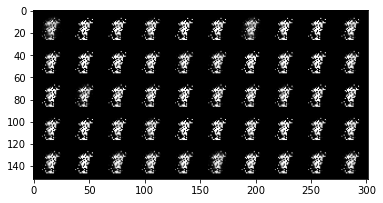

Iter: 05610/100000, Gen loss: 1.1844, Dis loss: 0.7974
Iter: 05620/100000, Gen loss: 1.6569, Dis loss: 0.6046
Iter: 05630/100000, Gen loss: 1.3516, Dis loss: 0.9288
Iter: 05640/100000, Gen loss: 1.5817, Dis loss: 0.6984
Iter: 05650/100000, Gen loss: 1.5773, Dis loss: 0.7382
Iter: 05660/100000, Gen loss: 1.9292, Dis loss: 0.5004
Iter: 05670/100000, Gen loss: 1.7023, Dis loss: 0.5801
Iter: 05680/100000, Gen loss: 1.6878, Dis loss: 0.6875
Iter: 05690/100000, Gen loss: 1.9183, Dis loss: 0.6602
Iter: 05700/100000, Gen loss: 1.3492, Dis loss: 0.8364
Iter: 05710/100000, Gen loss: 1.6056, Dis loss: 1.0965
Iter: 05720/100000, Gen loss: 1.3394, Dis loss: 1.0157
Iter: 05730/100000, Gen loss: 1.2033, Dis loss: 1.0578
Iter: 05740/100000, Gen loss: 1.0769, Dis loss: 1.5499
Iter: 05750/100000, Gen loss: 1.4354, Dis loss: 1.1043
Iter: 05760/100000, Gen loss: 1.2680, Dis loss: 0.9713
Iter: 05770/100000, Gen loss: 1.2312, Dis loss: 0.8653
Iter: 05780/100000, Gen loss: 1.1785, Dis loss: 0.9801
Iter: 0579

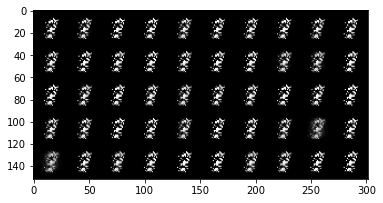

Iter: 05810/100000, Gen loss: 0.8800, Dis loss: 1.1757
Iter: 05820/100000, Gen loss: 0.8670, Dis loss: 1.2969
Iter: 05830/100000, Gen loss: 1.1359, Dis loss: 1.0873
Iter: 05840/100000, Gen loss: 1.0705, Dis loss: 0.9860
Iter: 05850/100000, Gen loss: 1.3022, Dis loss: 0.7139
Iter: 05860/100000, Gen loss: 1.7971, Dis loss: 0.4786
Iter: 05870/100000, Gen loss: 1.7132, Dis loss: 0.4964
Iter: 05880/100000, Gen loss: 2.3159, Dis loss: 0.3824
Iter: 05890/100000, Gen loss: 2.2866, Dis loss: 0.3452
Iter: 05900/100000, Gen loss: 2.3954, Dis loss: 0.4037
Iter: 05910/100000, Gen loss: 2.2619, Dis loss: 0.4051
Iter: 05920/100000, Gen loss: 2.3678, Dis loss: 0.4068
Iter: 05930/100000, Gen loss: 2.7201, Dis loss: 0.3201
Iter: 05940/100000, Gen loss: 2.3166, Dis loss: 0.4166
Iter: 05950/100000, Gen loss: 2.8307, Dis loss: 0.2835
Iter: 05960/100000, Gen loss: 2.2656, Dis loss: 0.2812
Iter: 05970/100000, Gen loss: 1.8965, Dis loss: 0.7211
Iter: 05980/100000, Gen loss: 1.2200, Dis loss: 1.3085
Iter: 0599

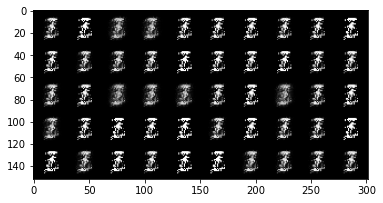

Iter: 06010/100000, Gen loss: 0.8608, Dis loss: 1.3443
Iter: 06020/100000, Gen loss: 0.8579, Dis loss: 1.3851
Iter: 06030/100000, Gen loss: 0.9602, Dis loss: 1.2231
Iter: 06040/100000, Gen loss: 1.0405, Dis loss: 1.0393
Iter: 06050/100000, Gen loss: 1.2180, Dis loss: 0.9993
Iter: 06060/100000, Gen loss: 1.3061, Dis loss: 0.7121
Iter: 06070/100000, Gen loss: 1.5502, Dis loss: 0.5618
Iter: 06080/100000, Gen loss: 1.4973, Dis loss: 0.6948
Iter: 06090/100000, Gen loss: 1.6719, Dis loss: 0.5932
Iter: 06100/100000, Gen loss: 1.6748, Dis loss: 0.6566
Iter: 06110/100000, Gen loss: 1.6384, Dis loss: 0.5922
Iter: 06120/100000, Gen loss: 1.5049, Dis loss: 0.8323
Iter: 06130/100000, Gen loss: 1.7986, Dis loss: 0.7835
Iter: 06140/100000, Gen loss: 1.5543, Dis loss: 0.6685
Iter: 06150/100000, Gen loss: 1.1965, Dis loss: 0.8806
Iter: 06160/100000, Gen loss: 1.3947, Dis loss: 0.8124
Iter: 06170/100000, Gen loss: 1.2913, Dis loss: 1.0142
Iter: 06180/100000, Gen loss: 1.2387, Dis loss: 1.2414
Iter: 0619

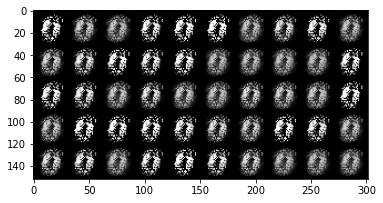

Iter: 06210/100000, Gen loss: 1.8289, Dis loss: 0.6008
Iter: 06220/100000, Gen loss: 1.9588, Dis loss: 0.4408
Iter: 06230/100000, Gen loss: 1.9738, Dis loss: 0.3577
Iter: 06240/100000, Gen loss: 1.8251, Dis loss: 0.4324
Iter: 06250/100000, Gen loss: 1.6674, Dis loss: 0.5787
Iter: 06260/100000, Gen loss: 1.1323, Dis loss: 0.7844
Iter: 06270/100000, Gen loss: 0.9076, Dis loss: 1.3147
Iter: 06280/100000, Gen loss: 0.9886, Dis loss: 1.2233
Iter: 06290/100000, Gen loss: 1.1778, Dis loss: 1.3416
Iter: 06300/100000, Gen loss: 1.1257, Dis loss: 0.9395
Iter: 06310/100000, Gen loss: 1.3962, Dis loss: 0.7212
Iter: 06320/100000, Gen loss: 1.5252, Dis loss: 0.5632
Iter: 06330/100000, Gen loss: 1.8479, Dis loss: 0.6285
Iter: 06340/100000, Gen loss: 1.6863, Dis loss: 0.4729
Iter: 06350/100000, Gen loss: 1.8113, Dis loss: 0.5823
Iter: 06360/100000, Gen loss: 1.5771, Dis loss: 0.7520
Iter: 06370/100000, Gen loss: 1.7169, Dis loss: 0.7956
Iter: 06380/100000, Gen loss: 1.5969, Dis loss: 0.6338
Iter: 0639

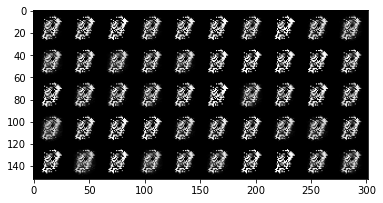

Iter: 06410/100000, Gen loss: 1.4615, Dis loss: 0.8261
Iter: 06420/100000, Gen loss: 1.4422, Dis loss: 0.9935
Iter: 06430/100000, Gen loss: 1.4579, Dis loss: 0.7575
Iter: 06440/100000, Gen loss: 1.3747, Dis loss: 0.5960
Iter: 06450/100000, Gen loss: 1.6242, Dis loss: 0.8058
Iter: 06460/100000, Gen loss: 1.6829, Dis loss: 0.4363
Iter: 06470/100000, Gen loss: 1.5032, Dis loss: 0.7667
Iter: 06480/100000, Gen loss: 1.3343, Dis loss: 0.9502
Iter: 06490/100000, Gen loss: 0.9509, Dis loss: 1.9949
Iter: 06500/100000, Gen loss: 1.3304, Dis loss: 1.0172
Iter: 06510/100000, Gen loss: 0.9850, Dis loss: 0.8754
Iter: 06520/100000, Gen loss: 1.4284, Dis loss: 0.7388
Iter: 06530/100000, Gen loss: 1.6029, Dis loss: 0.5809
Iter: 06540/100000, Gen loss: 1.5816, Dis loss: 0.5523
Iter: 06550/100000, Gen loss: 1.8310, Dis loss: 0.6289
Iter: 06560/100000, Gen loss: 1.7904, Dis loss: 0.6988
Iter: 06570/100000, Gen loss: 1.5845, Dis loss: 0.8501
Iter: 06580/100000, Gen loss: 1.5473, Dis loss: 0.8981
Iter: 0659

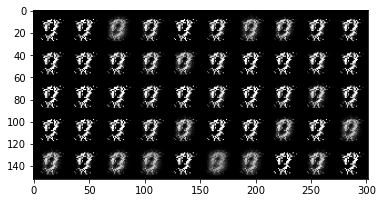

Iter: 06610/100000, Gen loss: 1.5077, Dis loss: 0.9195
Iter: 06620/100000, Gen loss: 1.4325, Dis loss: 0.8113
Iter: 06630/100000, Gen loss: 1.5138, Dis loss: 0.8718
Iter: 06640/100000, Gen loss: 1.5567, Dis loss: 0.8359
Iter: 06650/100000, Gen loss: 1.3509, Dis loss: 1.0957
Iter: 06660/100000, Gen loss: 1.0316, Dis loss: 1.5611
Iter: 06670/100000, Gen loss: 1.2204, Dis loss: 1.7282
Iter: 06680/100000, Gen loss: 0.9881, Dis loss: 1.4276
Iter: 06690/100000, Gen loss: 0.9736, Dis loss: 1.0019
Iter: 06700/100000, Gen loss: 1.1706, Dis loss: 0.7738
Iter: 06710/100000, Gen loss: 1.3570, Dis loss: 0.6991
Iter: 06720/100000, Gen loss: 1.7092, Dis loss: 0.6325
Iter: 06730/100000, Gen loss: 1.6010, Dis loss: 0.7478
Iter: 06740/100000, Gen loss: 1.8943, Dis loss: 0.5849
Iter: 06750/100000, Gen loss: 1.2234, Dis loss: 0.7661
Iter: 06760/100000, Gen loss: 1.2862, Dis loss: 1.1309
Iter: 06770/100000, Gen loss: 1.1039, Dis loss: 1.7014
Iter: 06780/100000, Gen loss: 1.1310, Dis loss: 1.2728
Iter: 0679

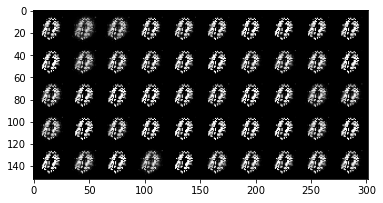

Iter: 06810/100000, Gen loss: 1.5631, Dis loss: 0.7075
Iter: 06820/100000, Gen loss: 1.9267, Dis loss: 0.6165
Iter: 06830/100000, Gen loss: 1.9104, Dis loss: 0.4035
Iter: 06840/100000, Gen loss: 2.3934, Dis loss: 0.3728
Iter: 06850/100000, Gen loss: 2.1585, Dis loss: 0.5017
Iter: 06860/100000, Gen loss: 2.1740, Dis loss: 0.7253
Iter: 06870/100000, Gen loss: 1.4802, Dis loss: 0.9734
Iter: 06880/100000, Gen loss: 1.5704, Dis loss: 1.1641
Iter: 06890/100000, Gen loss: 1.2307, Dis loss: 1.5744
Iter: 06900/100000, Gen loss: 1.3044, Dis loss: 1.2669
Iter: 06910/100000, Gen loss: 1.4659, Dis loss: 0.9066
Iter: 06920/100000, Gen loss: 1.3659, Dis loss: 0.5954
Iter: 06930/100000, Gen loss: 1.4404, Dis loss: 0.6746
Iter: 06940/100000, Gen loss: 1.5342, Dis loss: 0.5540
Iter: 06950/100000, Gen loss: 1.5416, Dis loss: 0.7711
Iter: 06960/100000, Gen loss: 1.6815, Dis loss: 0.5855
Iter: 06970/100000, Gen loss: 1.6070, Dis loss: 0.6464
Iter: 06980/100000, Gen loss: 1.8753, Dis loss: 0.4645
Iter: 0699

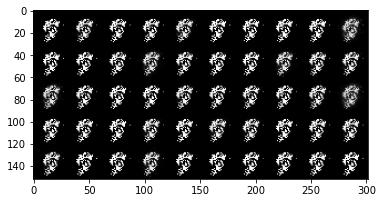

Iter: 07010/100000, Gen loss: 1.6808, Dis loss: 0.4662
Iter: 07020/100000, Gen loss: 1.8887, Dis loss: 0.7210
Iter: 07030/100000, Gen loss: 1.7843, Dis loss: 0.6482
Iter: 07040/100000, Gen loss: 1.7152, Dis loss: 0.5431
Iter: 07050/100000, Gen loss: 1.7966, Dis loss: 0.4948
Iter: 07060/100000, Gen loss: 1.7604, Dis loss: 0.6024
Iter: 07070/100000, Gen loss: 1.9031, Dis loss: 0.6922
Iter: 07080/100000, Gen loss: 1.6855, Dis loss: 0.7168
Iter: 07090/100000, Gen loss: 1.8784, Dis loss: 0.7740
Iter: 07100/100000, Gen loss: 1.3162, Dis loss: 0.9852
Iter: 07110/100000, Gen loss: 1.6455, Dis loss: 1.0471
Iter: 07120/100000, Gen loss: 1.2530, Dis loss: 0.9879
Iter: 07130/100000, Gen loss: 1.3959, Dis loss: 1.0767
Iter: 07140/100000, Gen loss: 1.2313, Dis loss: 0.9463
Iter: 07150/100000, Gen loss: 1.1878, Dis loss: 0.9044
Iter: 07160/100000, Gen loss: 1.4532, Dis loss: 0.8213
Iter: 07170/100000, Gen loss: 1.5622, Dis loss: 0.5068
Iter: 07180/100000, Gen loss: 1.5718, Dis loss: 0.5632
Iter: 0719

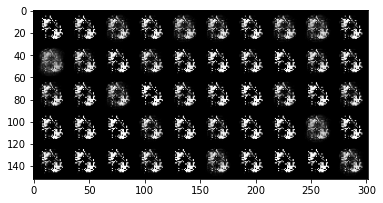

Iter: 07210/100000, Gen loss: 2.0790, Dis loss: 0.5148
Iter: 07220/100000, Gen loss: 1.9539, Dis loss: 0.6027
Iter: 07230/100000, Gen loss: 2.0809, Dis loss: 0.5573
Iter: 07240/100000, Gen loss: 2.0446, Dis loss: 0.7675
Iter: 07250/100000, Gen loss: 1.0797, Dis loss: 1.3179
Iter: 07260/100000, Gen loss: 1.5121, Dis loss: 1.4661
Iter: 07270/100000, Gen loss: 0.9493, Dis loss: 1.9733
Iter: 07280/100000, Gen loss: 0.8306, Dis loss: 1.5144
Iter: 07290/100000, Gen loss: 1.0598, Dis loss: 1.1795
Iter: 07300/100000, Gen loss: 1.1367, Dis loss: 0.9309
Iter: 07310/100000, Gen loss: 1.2768, Dis loss: 0.9762
Iter: 07320/100000, Gen loss: 1.3513, Dis loss: 0.8291
Iter: 07330/100000, Gen loss: 1.7674, Dis loss: 0.5972
Iter: 07340/100000, Gen loss: 1.6892, Dis loss: 0.5010
Iter: 07350/100000, Gen loss: 1.8317, Dis loss: 0.4016
Iter: 07360/100000, Gen loss: 1.6860, Dis loss: 0.4048
Iter: 07370/100000, Gen loss: 1.9027, Dis loss: 0.5659
Iter: 07380/100000, Gen loss: 1.6039, Dis loss: 0.6492
Iter: 0739

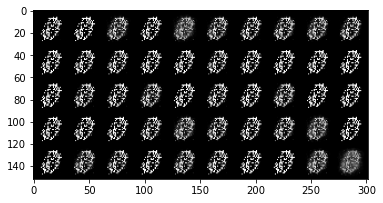

Iter: 07410/100000, Gen loss: 1.6554, Dis loss: 0.7598
Iter: 07420/100000, Gen loss: 1.9756, Dis loss: 0.5819
Iter: 07430/100000, Gen loss: 1.8145, Dis loss: 0.4607
Iter: 07440/100000, Gen loss: 1.5132, Dis loss: 0.6768
Iter: 07450/100000, Gen loss: 1.3261, Dis loss: 0.8129
Iter: 07460/100000, Gen loss: 1.4548, Dis loss: 1.4017
Iter: 07470/100000, Gen loss: 1.2006, Dis loss: 1.0393
Iter: 07480/100000, Gen loss: 1.4421, Dis loss: 0.9882
Iter: 07490/100000, Gen loss: 1.6804, Dis loss: 0.5184
Iter: 07500/100000, Gen loss: 1.5694, Dis loss: 0.4357
Iter: 07510/100000, Gen loss: 1.7519, Dis loss: 0.7100
Iter: 07520/100000, Gen loss: 1.5928, Dis loss: 0.5241
Iter: 07530/100000, Gen loss: 1.8995, Dis loss: 0.5468
Iter: 07540/100000, Gen loss: 1.5591, Dis loss: 0.7034
Iter: 07550/100000, Gen loss: 1.3501, Dis loss: 0.8711
Iter: 07560/100000, Gen loss: 1.4559, Dis loss: 0.7389
Iter: 07570/100000, Gen loss: 1.5238, Dis loss: 0.5661
Iter: 07580/100000, Gen loss: 1.7906, Dis loss: 0.5848
Iter: 0759

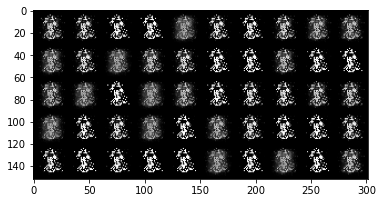

Iter: 07610/100000, Gen loss: 1.7068, Dis loss: 0.6007
Iter: 07620/100000, Gen loss: 1.4961, Dis loss: 0.6950
Iter: 07630/100000, Gen loss: 1.6118, Dis loss: 0.6582
Iter: 07640/100000, Gen loss: 1.7460, Dis loss: 0.7206
Iter: 07650/100000, Gen loss: 1.4967, Dis loss: 0.8320
Iter: 07660/100000, Gen loss: 1.6888, Dis loss: 0.7492
Iter: 07670/100000, Gen loss: 1.6186, Dis loss: 0.8467
Iter: 07680/100000, Gen loss: 1.6465, Dis loss: 0.7916
Iter: 07690/100000, Gen loss: 1.4057, Dis loss: 0.9408
Iter: 07700/100000, Gen loss: 1.0715, Dis loss: 1.1538
Iter: 07710/100000, Gen loss: 1.3573, Dis loss: 1.4503
Iter: 07720/100000, Gen loss: 1.1900, Dis loss: 0.8939
Iter: 07730/100000, Gen loss: 1.2690, Dis loss: 0.7085
Iter: 07740/100000, Gen loss: 1.5604, Dis loss: 0.5364
Iter: 07750/100000, Gen loss: 1.5177, Dis loss: 0.6025
Iter: 07760/100000, Gen loss: 1.7960, Dis loss: 0.5789
Iter: 07770/100000, Gen loss: 1.7882, Dis loss: 0.5169
Iter: 07780/100000, Gen loss: 1.6757, Dis loss: 0.8295
Iter: 0779

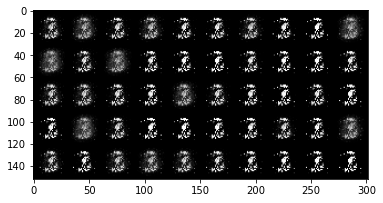

Iter: 07810/100000, Gen loss: 1.2277, Dis loss: 1.0100
Iter: 07820/100000, Gen loss: 1.0640, Dis loss: 1.4860
Iter: 07830/100000, Gen loss: 1.2241, Dis loss: 1.0580
Iter: 07840/100000, Gen loss: 1.0866, Dis loss: 1.0091
Iter: 07850/100000, Gen loss: 1.3983, Dis loss: 1.1756
Iter: 07860/100000, Gen loss: 1.4063, Dis loss: 0.8203
Iter: 07870/100000, Gen loss: 1.7581, Dis loss: 0.6761
Iter: 07880/100000, Gen loss: 1.6460, Dis loss: 0.6027
Iter: 07890/100000, Gen loss: 1.6950, Dis loss: 0.3706
Iter: 07900/100000, Gen loss: 1.6904, Dis loss: 0.8235
Iter: 07910/100000, Gen loss: 1.4563, Dis loss: 1.1442
Iter: 07920/100000, Gen loss: 1.3530, Dis loss: 1.2584
Iter: 07930/100000, Gen loss: 1.0564, Dis loss: 1.6855
Iter: 07940/100000, Gen loss: 0.8699, Dis loss: 1.2553
Iter: 07950/100000, Gen loss: 0.9398, Dis loss: 1.2741
Iter: 07960/100000, Gen loss: 0.9433, Dis loss: 1.0560
Iter: 07970/100000, Gen loss: 1.0045, Dis loss: 1.2607
Iter: 07980/100000, Gen loss: 1.1834, Dis loss: 0.6473
Iter: 0799

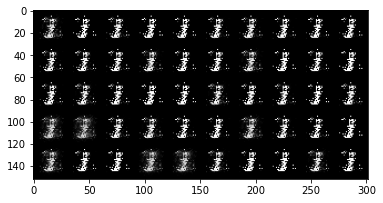

Iter: 08010/100000, Gen loss: 1.9211, Dis loss: 0.3759
Iter: 08020/100000, Gen loss: 1.7045, Dis loss: 0.4265
Iter: 08030/100000, Gen loss: 1.7762, Dis loss: 0.6245
Iter: 08040/100000, Gen loss: 1.9226, Dis loss: 0.4758
Iter: 08050/100000, Gen loss: 1.7590, Dis loss: 0.5145
Iter: 08060/100000, Gen loss: 1.7784, Dis loss: 0.7391
Iter: 08070/100000, Gen loss: 1.5530, Dis loss: 0.7814
Iter: 08080/100000, Gen loss: 1.4259, Dis loss: 0.9715
Iter: 08090/100000, Gen loss: 1.7600, Dis loss: 0.8106
Iter: 08100/100000, Gen loss: 1.5640, Dis loss: 0.7878
Iter: 08110/100000, Gen loss: 1.1373, Dis loss: 1.1587
Iter: 08120/100000, Gen loss: 1.2436, Dis loss: 1.5075
Iter: 08130/100000, Gen loss: 0.9999, Dis loss: 1.1984
Iter: 08140/100000, Gen loss: 0.9611, Dis loss: 1.0115
Iter: 08150/100000, Gen loss: 1.4149, Dis loss: 0.8091
Iter: 08160/100000, Gen loss: 1.2236, Dis loss: 0.7325
Iter: 08170/100000, Gen loss: 1.3653, Dis loss: 1.0583
Iter: 08180/100000, Gen loss: 1.1425, Dis loss: 1.1427
Iter: 0819

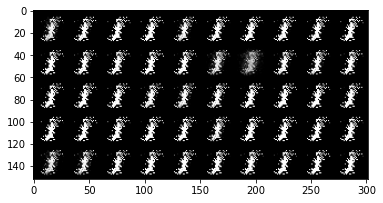

Iter: 08210/100000, Gen loss: 1.6322, Dis loss: 0.6888
Iter: 08220/100000, Gen loss: 1.5366, Dis loss: 0.6891
Iter: 08230/100000, Gen loss: 1.8180, Dis loss: 0.4818
Iter: 08240/100000, Gen loss: 1.6441, Dis loss: 0.8871
Iter: 08250/100000, Gen loss: 1.7284, Dis loss: 0.8147
Iter: 08260/100000, Gen loss: 1.3003, Dis loss: 1.4028
Iter: 08270/100000, Gen loss: 1.1085, Dis loss: 0.9925
Iter: 08280/100000, Gen loss: 1.4081, Dis loss: 0.8554
Iter: 08290/100000, Gen loss: 1.6112, Dis loss: 0.7166
Iter: 08300/100000, Gen loss: 1.8194, Dis loss: 0.5234
Iter: 08310/100000, Gen loss: 2.1034, Dis loss: 0.3876
Iter: 08320/100000, Gen loss: 2.3016, Dis loss: 0.3704
Iter: 08330/100000, Gen loss: 2.1784, Dis loss: 0.5012
Iter: 08340/100000, Gen loss: 2.3953, Dis loss: 0.8563
Iter: 08350/100000, Gen loss: 1.8124, Dis loss: 1.2403
Iter: 08360/100000, Gen loss: 1.5294, Dis loss: 1.0999
Iter: 08370/100000, Gen loss: 1.2484, Dis loss: 0.9897
Iter: 08380/100000, Gen loss: 1.2315, Dis loss: 0.8088
Iter: 0839

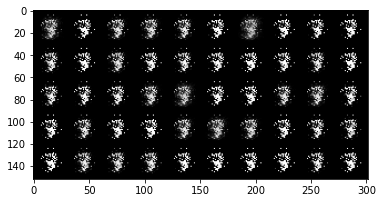

Iter: 08410/100000, Gen loss: 1.5602, Dis loss: 0.5807
Iter: 08420/100000, Gen loss: 1.6425, Dis loss: 0.6785
Iter: 08430/100000, Gen loss: 1.7436, Dis loss: 0.5474
Iter: 08440/100000, Gen loss: 1.8962, Dis loss: 0.4243
Iter: 08450/100000, Gen loss: 2.0613, Dis loss: 0.3128
Iter: 08460/100000, Gen loss: 2.2853, Dis loss: 0.3504
Iter: 08470/100000, Gen loss: 1.6176, Dis loss: 0.5887
Iter: 08480/100000, Gen loss: 2.0558, Dis loss: 0.5199
Iter: 08490/100000, Gen loss: 2.1564, Dis loss: 0.3688
Iter: 08500/100000, Gen loss: 2.0990, Dis loss: 0.3249
Iter: 08510/100000, Gen loss: 2.2764, Dis loss: 0.3541
Iter: 08520/100000, Gen loss: 1.9756, Dis loss: 0.7529
Iter: 08530/100000, Gen loss: 1.9013, Dis loss: 0.7264
Iter: 08540/100000, Gen loss: 1.7839, Dis loss: 0.8991
Iter: 08550/100000, Gen loss: 1.9932, Dis loss: 0.6595
Iter: 08560/100000, Gen loss: 1.6702, Dis loss: 0.7613
Iter: 08570/100000, Gen loss: 1.2950, Dis loss: 1.7134
Iter: 08580/100000, Gen loss: 1.2206, Dis loss: 1.7965
Iter: 0859

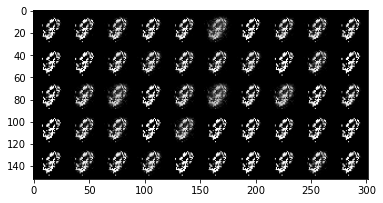

Iter: 08610/100000, Gen loss: 0.8988, Dis loss: 0.9752
Iter: 08620/100000, Gen loss: 1.0971, Dis loss: 0.9069
Iter: 08630/100000, Gen loss: 1.3404, Dis loss: 0.9297
Iter: 08640/100000, Gen loss: 1.5525, Dis loss: 0.6055
Iter: 08650/100000, Gen loss: 1.5570, Dis loss: 0.7682
Iter: 08660/100000, Gen loss: 1.4768, Dis loss: 0.7090
Iter: 08670/100000, Gen loss: 1.4717, Dis loss: 0.6439
Iter: 08680/100000, Gen loss: 1.6861, Dis loss: 0.4230
Iter: 08690/100000, Gen loss: 2.0815, Dis loss: 0.4109
Iter: 08700/100000, Gen loss: 2.1066, Dis loss: 0.3252
Iter: 08710/100000, Gen loss: 2.0541, Dis loss: 0.4451
Iter: 08720/100000, Gen loss: 1.9883, Dis loss: 0.4074
Iter: 08730/100000, Gen loss: 1.8817, Dis loss: 0.5914
Iter: 08740/100000, Gen loss: 1.6115, Dis loss: 0.5452
Iter: 08750/100000, Gen loss: 1.5656, Dis loss: 0.7205
Iter: 08760/100000, Gen loss: 1.5119, Dis loss: 0.6688
Iter: 08770/100000, Gen loss: 1.2531, Dis loss: 1.0275
Iter: 08780/100000, Gen loss: 1.4071, Dis loss: 0.8694
Iter: 0879

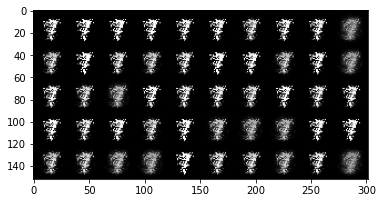

Iter: 08810/100000, Gen loss: 1.5034, Dis loss: 0.6790
Iter: 08820/100000, Gen loss: 1.8787, Dis loss: 0.4366
Iter: 08830/100000, Gen loss: 1.9416, Dis loss: 0.5648
Iter: 08840/100000, Gen loss: 1.6191, Dis loss: 0.7817
Iter: 08850/100000, Gen loss: 1.8414, Dis loss: 0.7453
Iter: 08860/100000, Gen loss: 1.6341, Dis loss: 0.7538
Iter: 08870/100000, Gen loss: 2.0722, Dis loss: 0.6798
Iter: 08880/100000, Gen loss: 1.7450, Dis loss: 0.5452
Iter: 08890/100000, Gen loss: 1.6752, Dis loss: 0.4804
Iter: 08900/100000, Gen loss: 1.8116, Dis loss: 0.6940
Iter: 08910/100000, Gen loss: 1.8852, Dis loss: 0.7077
Iter: 08920/100000, Gen loss: 1.7965, Dis loss: 0.5893
Iter: 08930/100000, Gen loss: 1.4776, Dis loss: 0.9937
Iter: 08940/100000, Gen loss: 1.4568, Dis loss: 0.9134
Iter: 08950/100000, Gen loss: 1.3811, Dis loss: 0.8218
Iter: 08960/100000, Gen loss: 1.2519, Dis loss: 1.1218
Iter: 08970/100000, Gen loss: 1.6190, Dis loss: 0.8387
Iter: 08980/100000, Gen loss: 1.3193, Dis loss: 0.9077
Iter: 0899

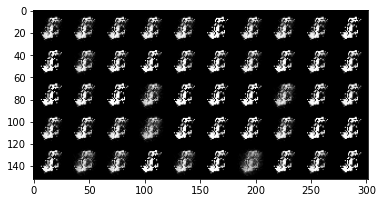

Iter: 09010/100000, Gen loss: 1.4911, Dis loss: 0.8918
Iter: 09020/100000, Gen loss: 1.3506, Dis loss: 0.5879
Iter: 09030/100000, Gen loss: 1.9062, Dis loss: 0.4669
Iter: 09040/100000, Gen loss: 1.7383, Dis loss: 0.4355
Iter: 09050/100000, Gen loss: 2.1736, Dis loss: 0.4029
Iter: 09060/100000, Gen loss: 1.8541, Dis loss: 0.4600
Iter: 09070/100000, Gen loss: 1.7303, Dis loss: 0.7732
Iter: 09080/100000, Gen loss: 1.7277, Dis loss: 0.8071
Iter: 09090/100000, Gen loss: 1.6990, Dis loss: 0.7074
Iter: 09100/100000, Gen loss: 1.9008, Dis loss: 0.4238
Iter: 09110/100000, Gen loss: 1.7844, Dis loss: 0.4546
Iter: 09120/100000, Gen loss: 1.8264, Dis loss: 0.4466
Iter: 09130/100000, Gen loss: 1.8567, Dis loss: 0.4447
Iter: 09140/100000, Gen loss: 1.9258, Dis loss: 0.7705
Iter: 09150/100000, Gen loss: 1.6990, Dis loss: 0.5999
Iter: 09160/100000, Gen loss: 1.9309, Dis loss: 0.4622
Iter: 09170/100000, Gen loss: 2.0145, Dis loss: 0.6681
Iter: 09180/100000, Gen loss: 1.8349, Dis loss: 0.4391
Iter: 0919

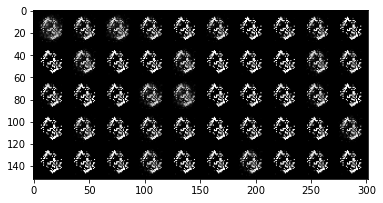

Iter: 09210/100000, Gen loss: 1.8102, Dis loss: 0.2825
Iter: 09220/100000, Gen loss: 2.1551, Dis loss: 0.3352
Iter: 09230/100000, Gen loss: 2.1495, Dis loss: 0.5295
Iter: 09240/100000, Gen loss: 2.3501, Dis loss: 0.2949
Iter: 09250/100000, Gen loss: 1.9531, Dis loss: 0.4219
Iter: 09260/100000, Gen loss: 2.1699, Dis loss: 0.4560
Iter: 09270/100000, Gen loss: 1.8195, Dis loss: 0.6696
Iter: 09280/100000, Gen loss: 1.7811, Dis loss: 0.8507
Iter: 09290/100000, Gen loss: 1.5533, Dis loss: 0.8732
Iter: 09300/100000, Gen loss: 1.5420, Dis loss: 0.8651
Iter: 09310/100000, Gen loss: 1.7029, Dis loss: 0.7407
Iter: 09320/100000, Gen loss: 1.7085, Dis loss: 0.6149
Iter: 09330/100000, Gen loss: 1.6375, Dis loss: 0.5717
Iter: 09340/100000, Gen loss: 1.9434, Dis loss: 0.6329
Iter: 09350/100000, Gen loss: 2.0994, Dis loss: 0.4704
Iter: 09360/100000, Gen loss: 1.9679, Dis loss: 0.4081
Iter: 09370/100000, Gen loss: 2.1961, Dis loss: 0.3785
Iter: 09380/100000, Gen loss: 1.8139, Dis loss: 0.6196
Iter: 0939

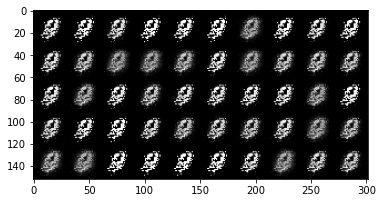

Iter: 09410/100000, Gen loss: 2.1791, Dis loss: 0.9365
Iter: 09420/100000, Gen loss: 1.7173, Dis loss: 0.6641
Iter: 09430/100000, Gen loss: 1.2632, Dis loss: 1.0019
Iter: 09440/100000, Gen loss: 1.5728, Dis loss: 0.6693
Iter: 09450/100000, Gen loss: 1.5838, Dis loss: 0.7961
Iter: 09460/100000, Gen loss: 1.6660, Dis loss: 0.5202
Iter: 09470/100000, Gen loss: 2.0659, Dis loss: 0.5389
Iter: 09480/100000, Gen loss: 2.2108, Dis loss: 0.3657
Iter: 09490/100000, Gen loss: 2.0082, Dis loss: 0.6150
Iter: 09500/100000, Gen loss: 1.8566, Dis loss: 0.5296
Iter: 09510/100000, Gen loss: 1.6908, Dis loss: 0.5626
Iter: 09520/100000, Gen loss: 1.7353, Dis loss: 0.7999
Iter: 09530/100000, Gen loss: 1.2887, Dis loss: 0.7959
Iter: 09540/100000, Gen loss: 1.2182, Dis loss: 0.8955
Iter: 09550/100000, Gen loss: 1.2265, Dis loss: 1.0121
Iter: 09560/100000, Gen loss: 1.3345, Dis loss: 1.0651
Iter: 09570/100000, Gen loss: 1.5693, Dis loss: 0.6553
Iter: 09580/100000, Gen loss: 2.1512, Dis loss: 0.5020
Iter: 0959

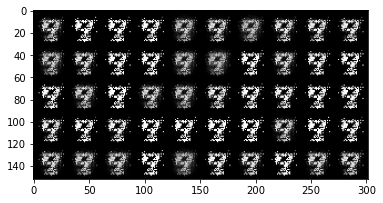

Iter: 09610/100000, Gen loss: 2.2397, Dis loss: 0.2666
Iter: 09620/100000, Gen loss: 2.6986, Dis loss: 0.2393
Iter: 09630/100000, Gen loss: 1.9132, Dis loss: 0.5326
Iter: 09640/100000, Gen loss: 2.4042, Dis loss: 0.2562
Iter: 09650/100000, Gen loss: 2.0244, Dis loss: 0.4144
Iter: 09660/100000, Gen loss: 1.9330, Dis loss: 0.5352
Iter: 09670/100000, Gen loss: 1.9560, Dis loss: 0.7454
Iter: 09680/100000, Gen loss: 1.9455, Dis loss: 0.8605
Iter: 09690/100000, Gen loss: 2.1288, Dis loss: 0.7034
Iter: 09700/100000, Gen loss: 1.4594, Dis loss: 1.1743
Iter: 09710/100000, Gen loss: 1.5918, Dis loss: 1.3748
Iter: 09720/100000, Gen loss: 1.1865, Dis loss: 1.2273
Iter: 09730/100000, Gen loss: 1.4475, Dis loss: 0.9042
Iter: 09740/100000, Gen loss: 1.8000, Dis loss: 0.5785
Iter: 09750/100000, Gen loss: 1.8812, Dis loss: 0.3938
Iter: 09760/100000, Gen loss: 2.2380, Dis loss: 0.3079
Iter: 09770/100000, Gen loss: 2.1830, Dis loss: 0.3375
Iter: 09780/100000, Gen loss: 2.3769, Dis loss: 0.4114
Iter: 0979

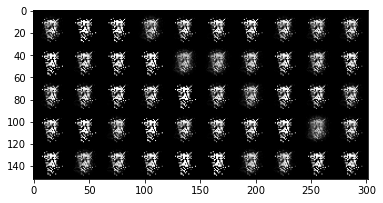

Iter: 09810/100000, Gen loss: 1.5346, Dis loss: 0.7836
Iter: 09820/100000, Gen loss: 1.6284, Dis loss: 0.8932
Iter: 09830/100000, Gen loss: 1.9407, Dis loss: 0.7277
Iter: 09840/100000, Gen loss: 1.9398, Dis loss: 0.4899
Iter: 09850/100000, Gen loss: 1.9771, Dis loss: 0.5686
Iter: 09860/100000, Gen loss: 2.1666, Dis loss: 0.4393
Iter: 09870/100000, Gen loss: 2.3416, Dis loss: 0.4098
Iter: 09880/100000, Gen loss: 2.3353, Dis loss: 0.3950
Iter: 09890/100000, Gen loss: 2.2936, Dis loss: 0.4504
Iter: 09900/100000, Gen loss: 2.4000, Dis loss: 0.4250
Iter: 09910/100000, Gen loss: 2.4181, Dis loss: 0.8389
Iter: 09920/100000, Gen loss: 2.1637, Dis loss: 0.7189
Iter: 09930/100000, Gen loss: 1.8737, Dis loss: 0.5587
Iter: 09940/100000, Gen loss: 1.7886, Dis loss: 0.4270
Iter: 09950/100000, Gen loss: 1.8879, Dis loss: 0.5567
Iter: 09960/100000, Gen loss: 1.8350, Dis loss: 0.5217
Iter: 09970/100000, Gen loss: 2.0620, Dis loss: 0.5698
Iter: 09980/100000, Gen loss: 1.9220, Dis loss: 0.5137
Iter: 0999

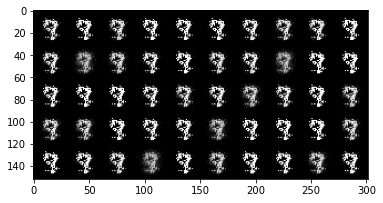

Iter: 10010/100000, Gen loss: 2.0808, Dis loss: 0.6056
Iter: 10020/100000, Gen loss: 2.2949, Dis loss: 0.5022
Iter: 10030/100000, Gen loss: 1.9372, Dis loss: 0.5310
Iter: 10040/100000, Gen loss: 1.9164, Dis loss: 0.7743
Iter: 10050/100000, Gen loss: 2.2892, Dis loss: 0.7266
Iter: 10060/100000, Gen loss: 2.1253, Dis loss: 0.3984
Iter: 10070/100000, Gen loss: 2.1204, Dis loss: 0.5766
Iter: 10080/100000, Gen loss: 2.0467, Dis loss: 0.6544
Iter: 10090/100000, Gen loss: 1.9712, Dis loss: 0.8838
Iter: 10100/100000, Gen loss: 1.9068, Dis loss: 0.8132
Iter: 10110/100000, Gen loss: 1.6186, Dis loss: 0.9481
Iter: 10120/100000, Gen loss: 1.8731, Dis loss: 0.4184
Iter: 10130/100000, Gen loss: 1.8580, Dis loss: 0.5089
Iter: 10140/100000, Gen loss: 2.2093, Dis loss: 0.4280
Iter: 10150/100000, Gen loss: 2.8734, Dis loss: 0.2012
Iter: 10160/100000, Gen loss: 2.6113, Dis loss: 0.3202
Iter: 10170/100000, Gen loss: 2.3185, Dis loss: 0.4289
Iter: 10180/100000, Gen loss: 2.3561, Dis loss: 0.4214
Iter: 1019

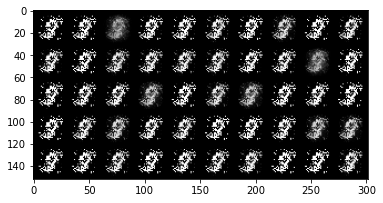

Iter: 10210/100000, Gen loss: 1.8103, Dis loss: 0.5481
Iter: 10220/100000, Gen loss: 2.9483, Dis loss: 0.4538
Iter: 10230/100000, Gen loss: 1.9551, Dis loss: 0.4440
Iter: 10240/100000, Gen loss: 3.9344, Dis loss: 0.1603
Iter: 10250/100000, Gen loss: 2.3451, Dis loss: 0.3995
Iter: 10260/100000, Gen loss: 3.3890, Dis loss: 0.3116
Iter: 10270/100000, Gen loss: 2.7215, Dis loss: 0.2826
Iter: 10280/100000, Gen loss: 3.1443, Dis loss: 0.2324
Iter: 10290/100000, Gen loss: 2.6572, Dis loss: 0.4026
Iter: 10300/100000, Gen loss: 3.4702, Dis loss: 0.3550
Iter: 10310/100000, Gen loss: 2.3603, Dis loss: 0.4351
Iter: 10320/100000, Gen loss: 2.9184, Dis loss: 0.6727
Iter: 10330/100000, Gen loss: 2.2792, Dis loss: 0.5909
Iter: 10340/100000, Gen loss: 2.5899, Dis loss: 0.4766
Iter: 10350/100000, Gen loss: 2.1401, Dis loss: 0.5280
Iter: 10360/100000, Gen loss: 1.8233, Dis loss: 0.6405
Iter: 10370/100000, Gen loss: 1.9742, Dis loss: 0.7667
Iter: 10380/100000, Gen loss: 2.1530, Dis loss: 0.9963
Iter: 1039

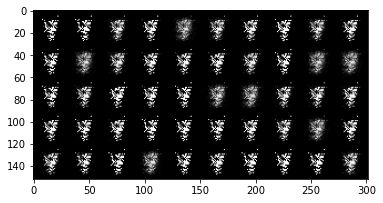

Iter: 10410/100000, Gen loss: 1.8246, Dis loss: 0.6478
Iter: 10420/100000, Gen loss: 2.0706, Dis loss: 0.4313
Iter: 10430/100000, Gen loss: 2.1743, Dis loss: 0.5650
Iter: 10440/100000, Gen loss: 2.1910, Dis loss: 0.3638
Iter: 10450/100000, Gen loss: 2.3884, Dis loss: 0.4411
Iter: 10460/100000, Gen loss: 2.0827, Dis loss: 0.3831
Iter: 10470/100000, Gen loss: 2.2434, Dis loss: 0.3934
Iter: 10480/100000, Gen loss: 2.3140, Dis loss: 0.5511
Iter: 10490/100000, Gen loss: 2.7446, Dis loss: 0.5363
Iter: 10500/100000, Gen loss: 2.4461, Dis loss: 0.4148
Iter: 10510/100000, Gen loss: 2.4143, Dis loss: 0.3241
Iter: 10520/100000, Gen loss: 2.2563, Dis loss: 0.4420
Iter: 10530/100000, Gen loss: 2.2495, Dis loss: 0.7156
Iter: 10540/100000, Gen loss: 2.2701, Dis loss: 0.4422
Iter: 10550/100000, Gen loss: 3.0721, Dis loss: 0.1558
Iter: 10560/100000, Gen loss: 2.3171, Dis loss: 0.2761
Iter: 10570/100000, Gen loss: 3.5836, Dis loss: 0.3456
Iter: 10580/100000, Gen loss: 2.6760, Dis loss: 0.2782
Iter: 1059

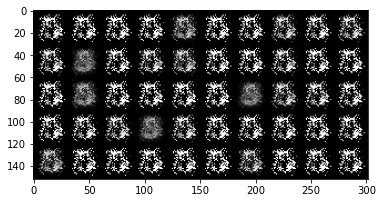

Iter: 10610/100000, Gen loss: 3.1450, Dis loss: 0.1843
Iter: 10620/100000, Gen loss: 3.0053, Dis loss: 0.5267
Iter: 10630/100000, Gen loss: 2.7057, Dis loss: 0.3985
Iter: 10640/100000, Gen loss: 2.1192, Dis loss: 0.9335
Iter: 10650/100000, Gen loss: 2.6633, Dis loss: 0.5698
Iter: 10660/100000, Gen loss: 1.7148, Dis loss: 1.0949
Iter: 10670/100000, Gen loss: 1.8683, Dis loss: 1.0595
Iter: 10680/100000, Gen loss: 2.1276, Dis loss: 0.5876
Iter: 10690/100000, Gen loss: 1.9976, Dis loss: 0.6185
Iter: 10700/100000, Gen loss: 2.4699, Dis loss: 0.3441
Iter: 10710/100000, Gen loss: 2.4202, Dis loss: 0.5070
Iter: 10720/100000, Gen loss: 1.8554, Dis loss: 0.4918
Iter: 10730/100000, Gen loss: 2.0706, Dis loss: 0.5930
Iter: 10740/100000, Gen loss: 2.3567, Dis loss: 0.5162
Iter: 10750/100000, Gen loss: 2.2988, Dis loss: 0.5465
Iter: 10760/100000, Gen loss: 1.9353, Dis loss: 0.6454
Iter: 10770/100000, Gen loss: 1.7901, Dis loss: 0.6358
Iter: 10780/100000, Gen loss: 1.8483, Dis loss: 0.9270
Iter: 1079

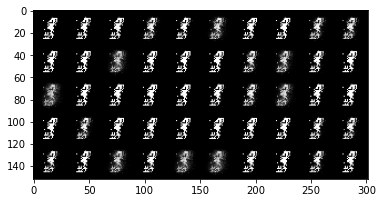

Iter: 10810/100000, Gen loss: 2.4400, Dis loss: 0.2977
Iter: 10820/100000, Gen loss: 2.2067, Dis loss: 0.2422
Iter: 10830/100000, Gen loss: 2.2113, Dis loss: 0.2986
Iter: 10840/100000, Gen loss: 2.1462, Dis loss: 0.2202
Iter: 10850/100000, Gen loss: 2.3081, Dis loss: 0.4234
Iter: 10860/100000, Gen loss: 2.0527, Dis loss: 0.4616
Iter: 10870/100000, Gen loss: 2.5766, Dis loss: 0.4281
Iter: 10880/100000, Gen loss: 2.0034, Dis loss: 0.4922
Iter: 10890/100000, Gen loss: 1.9276, Dis loss: 0.4922
Iter: 10900/100000, Gen loss: 1.3594, Dis loss: 0.7904
Iter: 10910/100000, Gen loss: 1.8686, Dis loss: 0.4784
Iter: 10920/100000, Gen loss: 1.9707, Dis loss: 0.4306
Iter: 10930/100000, Gen loss: 2.3418, Dis loss: 0.5658
Iter: 10940/100000, Gen loss: 2.4868, Dis loss: 0.2467
Iter: 10950/100000, Gen loss: 2.5000, Dis loss: 0.3899
Iter: 10960/100000, Gen loss: 2.5095, Dis loss: 0.6525
Iter: 10970/100000, Gen loss: 2.6588, Dis loss: 0.4418
Iter: 10980/100000, Gen loss: 2.7585, Dis loss: 0.3704
Iter: 1099

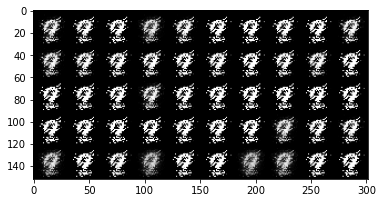

Iter: 11010/100000, Gen loss: 3.4276, Dis loss: 0.3900
Iter: 11020/100000, Gen loss: 2.4112, Dis loss: 0.4793
Iter: 11030/100000, Gen loss: 2.9278, Dis loss: 0.5166
Iter: 11040/100000, Gen loss: 2.6664, Dis loss: 0.4946
Iter: 11050/100000, Gen loss: 2.1616, Dis loss: 0.3213
Iter: 11060/100000, Gen loss: 2.2428, Dis loss: 0.3924
Iter: 11070/100000, Gen loss: 2.1247, Dis loss: 0.4160
Iter: 11080/100000, Gen loss: 2.3736, Dis loss: 0.3919
Iter: 11090/100000, Gen loss: 2.6394, Dis loss: 0.3213
Iter: 11100/100000, Gen loss: 2.2193, Dis loss: 0.2784
Iter: 11110/100000, Gen loss: 2.0863, Dis loss: 0.2955
Iter: 11120/100000, Gen loss: 2.2166, Dis loss: 0.3367
Iter: 11130/100000, Gen loss: 2.1323, Dis loss: 0.3239
Iter: 11140/100000, Gen loss: 2.3191, Dis loss: 0.3187
Iter: 11150/100000, Gen loss: 2.4230, Dis loss: 0.2253
Iter: 11160/100000, Gen loss: 2.7267, Dis loss: 0.1932
Iter: 11170/100000, Gen loss: 3.1317, Dis loss: 0.1241
Iter: 11180/100000, Gen loss: 2.7849, Dis loss: 0.2290
Iter: 1119

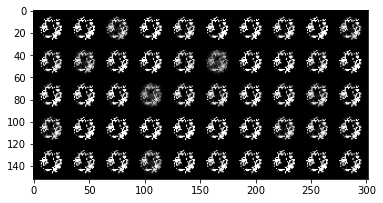

Iter: 11210/100000, Gen loss: 2.8436, Dis loss: 0.1223
Iter: 11220/100000, Gen loss: 3.5076, Dis loss: 0.2783
Iter: 11230/100000, Gen loss: 3.3668, Dis loss: 0.2471
Iter: 11240/100000, Gen loss: 3.3845, Dis loss: 0.1016
Iter: 11250/100000, Gen loss: 2.9349, Dis loss: 0.3094
Iter: 11260/100000, Gen loss: 3.3114, Dis loss: 0.1477
Iter: 11270/100000, Gen loss: 2.6395, Dis loss: 0.2877
Iter: 11280/100000, Gen loss: 2.0337, Dis loss: 0.3804
Iter: 11290/100000, Gen loss: 2.3306, Dis loss: 0.4689
Iter: 11300/100000, Gen loss: 2.0765, Dis loss: 0.5270
Iter: 11310/100000, Gen loss: 1.8902, Dis loss: 0.4760
Iter: 11320/100000, Gen loss: 2.5435, Dis loss: 0.2778
Iter: 11330/100000, Gen loss: 2.1403, Dis loss: 0.2860
Iter: 11340/100000, Gen loss: 2.2001, Dis loss: 0.3436
Iter: 11350/100000, Gen loss: 2.6757, Dis loss: 0.3017
Iter: 11360/100000, Gen loss: 2.6124, Dis loss: 0.3029
Iter: 11370/100000, Gen loss: 3.6421, Dis loss: 0.1641
Iter: 11380/100000, Gen loss: 3.1641, Dis loss: 0.1721
Iter: 1139

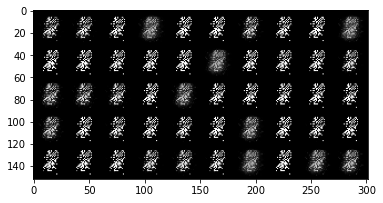

Iter: 11410/100000, Gen loss: 2.7881, Dis loss: 0.2645
Iter: 11420/100000, Gen loss: 2.9582, Dis loss: 0.2410
Iter: 11430/100000, Gen loss: 2.6455, Dis loss: 0.2843
Iter: 11440/100000, Gen loss: 1.9702, Dis loss: 0.5276
Iter: 11450/100000, Gen loss: 2.8691, Dis loss: 0.5636
Iter: 11460/100000, Gen loss: 2.4710, Dis loss: 0.3388
Iter: 11470/100000, Gen loss: 3.1808, Dis loss: 0.1921
Iter: 11480/100000, Gen loss: 2.7967, Dis loss: 0.3754
Iter: 11490/100000, Gen loss: 2.9217, Dis loss: 0.4206
Iter: 11500/100000, Gen loss: 2.8314, Dis loss: 0.2812
Iter: 11510/100000, Gen loss: 3.4109, Dis loss: 0.1649
Iter: 11520/100000, Gen loss: 2.9137, Dis loss: 0.2355
Iter: 11530/100000, Gen loss: 3.3672, Dis loss: 0.1907
Iter: 11540/100000, Gen loss: 3.3262, Dis loss: 0.1569
Iter: 11550/100000, Gen loss: 2.8201, Dis loss: 0.3049
Iter: 11560/100000, Gen loss: 2.7970, Dis loss: 0.2090
Iter: 11570/100000, Gen loss: 2.9064, Dis loss: 0.2457
Iter: 11580/100000, Gen loss: 2.9915, Dis loss: 0.3525
Iter: 1159

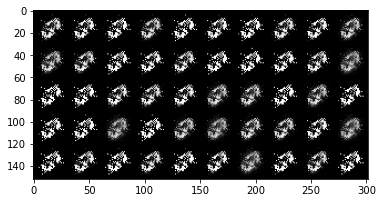

Iter: 11610/100000, Gen loss: 3.4495, Dis loss: 0.2978
Iter: 11620/100000, Gen loss: 2.7822, Dis loss: 0.2999
Iter: 11630/100000, Gen loss: 2.9694, Dis loss: 0.2729
Iter: 11640/100000, Gen loss: 2.5444, Dis loss: 0.3473
Iter: 11650/100000, Gen loss: 3.0742, Dis loss: 0.1849
Iter: 11660/100000, Gen loss: 2.7777, Dis loss: 0.1878
Iter: 11670/100000, Gen loss: 3.0369, Dis loss: 0.3761
Iter: 11680/100000, Gen loss: 3.0107, Dis loss: 0.3154
Iter: 11690/100000, Gen loss: 2.6255, Dis loss: 0.2801
Iter: 11700/100000, Gen loss: 2.5578, Dis loss: 0.7180
Iter: 11710/100000, Gen loss: 2.4123, Dis loss: 0.4954
Iter: 11720/100000, Gen loss: 2.9492, Dis loss: 0.2868
Iter: 11730/100000, Gen loss: 2.3310, Dis loss: 0.5324
Iter: 11740/100000, Gen loss: 2.6567, Dis loss: 0.3717
Iter: 11750/100000, Gen loss: 2.3947, Dis loss: 0.6136
Iter: 11760/100000, Gen loss: 2.1734, Dis loss: 0.4204
Iter: 11770/100000, Gen loss: 2.8683, Dis loss: 0.4593
Iter: 11780/100000, Gen loss: 2.4946, Dis loss: 0.2025
Iter: 1179

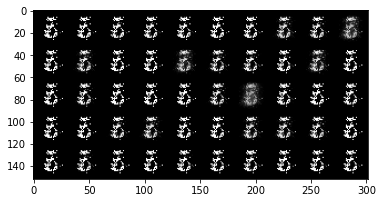

Iter: 11810/100000, Gen loss: 2.4349, Dis loss: 0.3385
Iter: 11820/100000, Gen loss: 2.8880, Dis loss: 0.1303
Iter: 11830/100000, Gen loss: 2.6267, Dis loss: 0.3654
Iter: 11840/100000, Gen loss: 3.0918, Dis loss: 0.3747
Iter: 11850/100000, Gen loss: 2.1373, Dis loss: 0.3999
Iter: 11860/100000, Gen loss: 3.5560, Dis loss: 0.4056
Iter: 11870/100000, Gen loss: 2.6061, Dis loss: 0.2967
Iter: 11880/100000, Gen loss: 3.0158, Dis loss: 0.2439
Iter: 11890/100000, Gen loss: 3.0941, Dis loss: 0.2461
Iter: 11900/100000, Gen loss: 2.8253, Dis loss: 0.2974
Iter: 11910/100000, Gen loss: 2.9166, Dis loss: 0.2295
Iter: 11920/100000, Gen loss: 2.9531, Dis loss: 0.3939
Iter: 11930/100000, Gen loss: 3.2960, Dis loss: 0.4390
Iter: 11940/100000, Gen loss: 3.4189, Dis loss: 0.3559
Iter: 11950/100000, Gen loss: 2.9549, Dis loss: 0.2124
Iter: 11960/100000, Gen loss: 3.0895, Dis loss: 0.1613
Iter: 11970/100000, Gen loss: 2.8820, Dis loss: 0.2316
Iter: 11980/100000, Gen loss: 2.8731, Dis loss: 0.3874
Iter: 1199

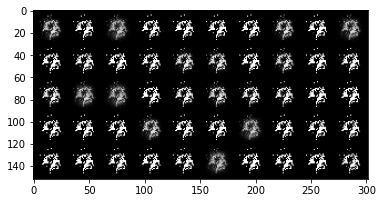

Iter: 12010/100000, Gen loss: 2.6138, Dis loss: 0.3277
Iter: 12020/100000, Gen loss: 2.9282, Dis loss: 0.4420
Iter: 12030/100000, Gen loss: 2.6516, Dis loss: 0.2835
Iter: 12040/100000, Gen loss: 2.4845, Dis loss: 0.2427
Iter: 12050/100000, Gen loss: 2.5537, Dis loss: 0.4947
Iter: 12060/100000, Gen loss: 2.8710, Dis loss: 0.2366
Iter: 12070/100000, Gen loss: 2.8884, Dis loss: 0.1910
Iter: 12080/100000, Gen loss: 3.5060, Dis loss: 0.2012
Iter: 12090/100000, Gen loss: 3.5689, Dis loss: 0.2327
Iter: 12100/100000, Gen loss: 3.0114, Dis loss: 0.5286
Iter: 12110/100000, Gen loss: 2.8646, Dis loss: 0.3744
Iter: 12120/100000, Gen loss: 2.2299, Dis loss: 0.7133
Iter: 12130/100000, Gen loss: 2.8291, Dis loss: 0.6510
Iter: 12140/100000, Gen loss: 3.0785, Dis loss: 0.2281
Iter: 12150/100000, Gen loss: 3.0854, Dis loss: 0.3959
Iter: 12160/100000, Gen loss: 2.6168, Dis loss: 0.1973
Iter: 12170/100000, Gen loss: 2.7296, Dis loss: 0.2814
Iter: 12180/100000, Gen loss: 3.3579, Dis loss: 0.2933
Iter: 1219

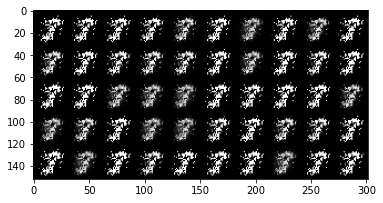

Iter: 12210/100000, Gen loss: 2.8721, Dis loss: 0.4305
Iter: 12220/100000, Gen loss: 2.8123, Dis loss: 0.2871
Iter: 12230/100000, Gen loss: 2.6076, Dis loss: 0.3537
Iter: 12240/100000, Gen loss: 3.1259, Dis loss: 0.1851
Iter: 12250/100000, Gen loss: 3.8018, Dis loss: 0.1377
Iter: 12260/100000, Gen loss: 3.1697, Dis loss: 0.1486
Iter: 12270/100000, Gen loss: 3.5295, Dis loss: 0.2587
Iter: 12280/100000, Gen loss: 3.5907, Dis loss: 0.2588
Iter: 12290/100000, Gen loss: 3.3199, Dis loss: 0.2318
Iter: 12300/100000, Gen loss: 3.7209, Dis loss: 0.2825
Iter: 12310/100000, Gen loss: 3.0497, Dis loss: 0.2352
Iter: 12320/100000, Gen loss: 3.6157, Dis loss: 0.2164
Iter: 12330/100000, Gen loss: 3.8380, Dis loss: 0.2196
Iter: 12340/100000, Gen loss: 3.7494, Dis loss: 0.2445
Iter: 12350/100000, Gen loss: 3.7036, Dis loss: 0.2460
Iter: 12360/100000, Gen loss: 3.3721, Dis loss: 0.4207
Iter: 12370/100000, Gen loss: 2.8333, Dis loss: 0.2967
Iter: 12380/100000, Gen loss: 3.4843, Dis loss: 0.3655
Iter: 1239

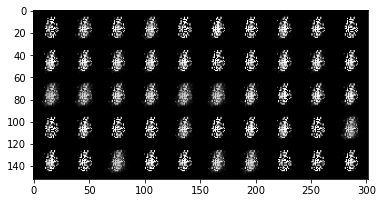

Iter: 12410/100000, Gen loss: 2.8124, Dis loss: 0.2421
Iter: 12420/100000, Gen loss: 3.0437, Dis loss: 0.2906
Iter: 12430/100000, Gen loss: 3.0116, Dis loss: 0.2813
Iter: 12440/100000, Gen loss: 3.1982, Dis loss: 0.5073
Iter: 12450/100000, Gen loss: 2.4344, Dis loss: 0.5579
Iter: 12460/100000, Gen loss: 2.9715, Dis loss: 0.2813
Iter: 12470/100000, Gen loss: 2.7809, Dis loss: 0.1942
Iter: 12480/100000, Gen loss: 2.9997, Dis loss: 0.1447
Iter: 12490/100000, Gen loss: 2.8190, Dis loss: 0.2217
Iter: 12500/100000, Gen loss: 3.3443, Dis loss: 0.2246
Iter: 12510/100000, Gen loss: 3.0967, Dis loss: 0.1878
Iter: 12520/100000, Gen loss: 3.7799, Dis loss: 0.1106
Iter: 12530/100000, Gen loss: 3.0505, Dis loss: 0.1137
Iter: 12540/100000, Gen loss: 3.2735, Dis loss: 0.1937
Iter: 12550/100000, Gen loss: 3.5744, Dis loss: 0.2659
Iter: 12560/100000, Gen loss: 3.0664, Dis loss: 0.2415
Iter: 12570/100000, Gen loss: 3.0286, Dis loss: 0.1515
Iter: 12580/100000, Gen loss: 3.3405, Dis loss: 0.2006
Iter: 1259

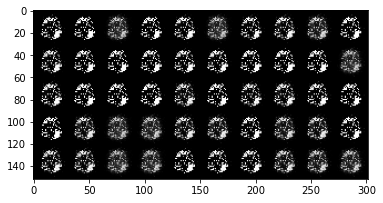

Iter: 12610/100000, Gen loss: 3.4532, Dis loss: 0.1214
Iter: 12620/100000, Gen loss: 3.1150, Dis loss: 0.1587
Iter: 12630/100000, Gen loss: 3.4327, Dis loss: 0.2477
Iter: 12640/100000, Gen loss: 4.1545, Dis loss: 0.2081
Iter: 12650/100000, Gen loss: 3.0463, Dis loss: 0.3593
Iter: 12660/100000, Gen loss: 3.1567, Dis loss: 0.2712
Iter: 12670/100000, Gen loss: 2.2828, Dis loss: 0.4112
Iter: 12680/100000, Gen loss: 3.3449, Dis loss: 0.2310
Iter: 12690/100000, Gen loss: 2.9828, Dis loss: 0.1779
Iter: 12700/100000, Gen loss: 3.6985, Dis loss: 0.1996
Iter: 12710/100000, Gen loss: 3.3716, Dis loss: 0.1398
Iter: 12720/100000, Gen loss: 4.6335, Dis loss: 0.1522
Iter: 12730/100000, Gen loss: 3.7904, Dis loss: 0.1812
Iter: 12740/100000, Gen loss: 2.8535, Dis loss: 0.3376
Iter: 12750/100000, Gen loss: 2.5287, Dis loss: 0.2938
Iter: 12760/100000, Gen loss: 3.4130, Dis loss: 0.5013
Iter: 12770/100000, Gen loss: 2.7592, Dis loss: 0.3966
Iter: 12780/100000, Gen loss: 2.8239, Dis loss: 0.2411
Iter: 1279

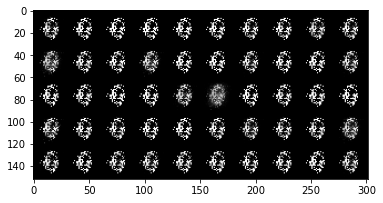

Iter: 12810/100000, Gen loss: 3.0554, Dis loss: 0.1782
Iter: 12820/100000, Gen loss: 2.9099, Dis loss: 0.2216
Iter: 12830/100000, Gen loss: 3.0006, Dis loss: 0.6576
Iter: 12840/100000, Gen loss: 3.2999, Dis loss: 0.0860
Iter: 12850/100000, Gen loss: 3.2472, Dis loss: 0.1378
Iter: 12860/100000, Gen loss: 3.4101, Dis loss: 0.1489
Iter: 12870/100000, Gen loss: 3.1859, Dis loss: 0.1183
Iter: 12880/100000, Gen loss: 3.6083, Dis loss: 0.1751
Iter: 12890/100000, Gen loss: 3.5052, Dis loss: 0.1573
Iter: 12900/100000, Gen loss: 3.1044, Dis loss: 0.2185
Iter: 12910/100000, Gen loss: 3.0823, Dis loss: 0.4585
Iter: 12920/100000, Gen loss: 3.7106, Dis loss: 0.2553
Iter: 12930/100000, Gen loss: 3.4038, Dis loss: 0.2048
Iter: 12940/100000, Gen loss: 3.5893, Dis loss: 0.2196
Iter: 12950/100000, Gen loss: 3.7981, Dis loss: 0.0901
Iter: 12960/100000, Gen loss: 3.6142, Dis loss: 0.1125
Iter: 12970/100000, Gen loss: 3.9851, Dis loss: 0.2335
Iter: 12980/100000, Gen loss: 3.4691, Dis loss: 0.1946
Iter: 1299

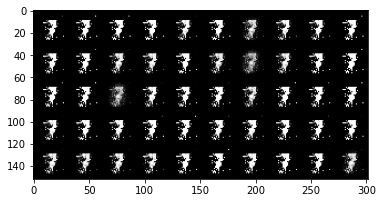

Iter: 13010/100000, Gen loss: 3.6779, Dis loss: 0.6310
Iter: 13020/100000, Gen loss: 2.5978, Dis loss: 0.2576
Iter: 13030/100000, Gen loss: 2.4918, Dis loss: 0.2033
Iter: 13040/100000, Gen loss: 3.0062, Dis loss: 0.3429
Iter: 13050/100000, Gen loss: 3.0826, Dis loss: 0.4136
Iter: 13060/100000, Gen loss: 2.6057, Dis loss: 0.2675
Iter: 13070/100000, Gen loss: 3.7124, Dis loss: 0.1688
Iter: 13080/100000, Gen loss: 2.9224, Dis loss: 0.1421
Iter: 13090/100000, Gen loss: 4.0376, Dis loss: 0.1800
Iter: 13100/100000, Gen loss: 3.3038, Dis loss: 0.1771
Iter: 13110/100000, Gen loss: 4.0310, Dis loss: 0.0962
Iter: 13120/100000, Gen loss: 3.5442, Dis loss: 0.0876
Iter: 13130/100000, Gen loss: 4.3704, Dis loss: 0.0378
Iter: 13140/100000, Gen loss: 3.4169, Dis loss: 0.0987
Iter: 13150/100000, Gen loss: 4.6567, Dis loss: 0.1053
Iter: 13160/100000, Gen loss: 3.8823, Dis loss: 0.0633
Iter: 13170/100000, Gen loss: 4.8738, Dis loss: 0.0794
Iter: 13180/100000, Gen loss: 5.6296, Dis loss: 0.1715
Iter: 1319

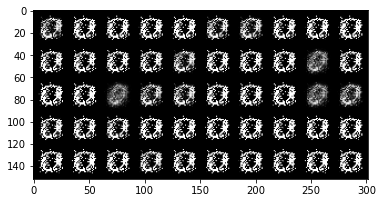

Iter: 13210/100000, Gen loss: 4.1595, Dis loss: 0.2698
Iter: 13220/100000, Gen loss: 3.2486, Dis loss: 0.3051
Iter: 13230/100000, Gen loss: 4.0078, Dis loss: 0.3125
Iter: 13240/100000, Gen loss: 3.2514, Dis loss: 0.4305
Iter: 13250/100000, Gen loss: 3.0658, Dis loss: 0.2153
Iter: 13260/100000, Gen loss: 3.0825, Dis loss: 0.1732
Iter: 13270/100000, Gen loss: 3.2298, Dis loss: 0.1269
Iter: 13280/100000, Gen loss: 2.7778, Dis loss: 0.1614
Iter: 13290/100000, Gen loss: 3.7311, Dis loss: 0.0553
Iter: 13300/100000, Gen loss: 3.1802, Dis loss: 0.1692
Iter: 13310/100000, Gen loss: 3.0301, Dis loss: 0.0966
Iter: 13320/100000, Gen loss: 3.3635, Dis loss: 0.0956
Iter: 13330/100000, Gen loss: 3.0484, Dis loss: 0.2427
Iter: 13340/100000, Gen loss: 3.3149, Dis loss: 0.1784
Iter: 13350/100000, Gen loss: 3.5501, Dis loss: 0.1666
Iter: 13360/100000, Gen loss: 3.1177, Dis loss: 0.2621
Iter: 13370/100000, Gen loss: 3.3121, Dis loss: 0.1747
Iter: 13380/100000, Gen loss: 3.3938, Dis loss: 0.1694
Iter: 1339

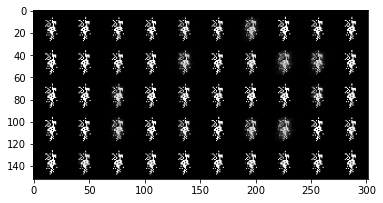

Iter: 13410/100000, Gen loss: 3.0062, Dis loss: 0.2267
Iter: 13420/100000, Gen loss: 3.2100, Dis loss: 0.1710
Iter: 13430/100000, Gen loss: 3.0188, Dis loss: 0.1151
Iter: 13440/100000, Gen loss: 3.0894, Dis loss: 0.1495
Iter: 13450/100000, Gen loss: 3.0752, Dis loss: 0.1414
Iter: 13460/100000, Gen loss: 3.2520, Dis loss: 0.2271
Iter: 13470/100000, Gen loss: 3.3254, Dis loss: 0.1527
Iter: 13480/100000, Gen loss: 3.5679, Dis loss: 0.1078
Iter: 13490/100000, Gen loss: 2.9092, Dis loss: 0.1489
Iter: 13500/100000, Gen loss: 3.5316, Dis loss: 0.0944
Iter: 13510/100000, Gen loss: 2.9737, Dis loss: 0.1092
Iter: 13520/100000, Gen loss: 3.0705, Dis loss: 0.1410
Iter: 13530/100000, Gen loss: 2.9124, Dis loss: 0.1873
Iter: 13540/100000, Gen loss: 3.6244, Dis loss: 0.1458
Iter: 13550/100000, Gen loss: 3.0670, Dis loss: 0.1959
Iter: 13560/100000, Gen loss: 4.2971, Dis loss: 0.1473
Iter: 13570/100000, Gen loss: 3.5631, Dis loss: 0.1641
Iter: 13580/100000, Gen loss: 4.4283, Dis loss: 0.1160
Iter: 1359

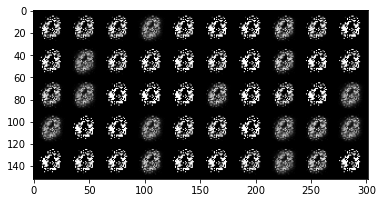

Iter: 13610/100000, Gen loss: 3.1042, Dis loss: 0.1973
Iter: 13620/100000, Gen loss: 3.7627, Dis loss: 0.1355
Iter: 13630/100000, Gen loss: 3.4393, Dis loss: 0.1894
Iter: 13640/100000, Gen loss: 3.6159, Dis loss: 0.2485
Iter: 13650/100000, Gen loss: 3.8432, Dis loss: 0.1268
Iter: 13660/100000, Gen loss: 3.4512, Dis loss: 0.1215
Iter: 13670/100000, Gen loss: 3.9379, Dis loss: 0.1632
Iter: 13680/100000, Gen loss: 3.8551, Dis loss: 0.1951
Iter: 13690/100000, Gen loss: 3.2099, Dis loss: 0.1673
Iter: 13700/100000, Gen loss: 3.8785, Dis loss: 0.1468
Iter: 13710/100000, Gen loss: 4.0499, Dis loss: 0.1293
Iter: 13720/100000, Gen loss: 4.3738, Dis loss: 0.2398
Iter: 13730/100000, Gen loss: 3.5922, Dis loss: 0.4192
Iter: 13740/100000, Gen loss: 3.4147, Dis loss: 0.4129
Iter: 13750/100000, Gen loss: 2.9254, Dis loss: 0.1869
Iter: 13760/100000, Gen loss: 2.8664, Dis loss: 0.2992
Iter: 13770/100000, Gen loss: 3.0982, Dis loss: 0.1633
Iter: 13780/100000, Gen loss: 2.8001, Dis loss: 0.1731
Iter: 1379

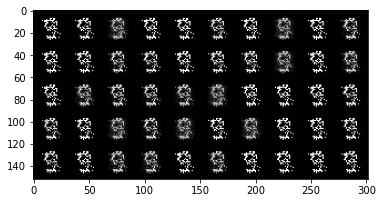

Iter: 13810/100000, Gen loss: 3.1641, Dis loss: 0.1657
Iter: 13820/100000, Gen loss: 3.8354, Dis loss: 0.1611
Iter: 13830/100000, Gen loss: 2.9515, Dis loss: 0.1379
Iter: 13840/100000, Gen loss: 3.7944, Dis loss: 0.0967
Iter: 13850/100000, Gen loss: 3.6420, Dis loss: 0.1701
Iter: 13860/100000, Gen loss: 3.6982, Dis loss: 0.0691
Iter: 13870/100000, Gen loss: 3.6656, Dis loss: 0.1975
Iter: 13880/100000, Gen loss: 3.4888, Dis loss: 0.3531
Iter: 13890/100000, Gen loss: 3.5665, Dis loss: 0.1225
Iter: 13900/100000, Gen loss: 3.1771, Dis loss: 0.2750
Iter: 13910/100000, Gen loss: 3.5779, Dis loss: 0.3074
Iter: 13920/100000, Gen loss: 3.3438, Dis loss: 0.1567
Iter: 13930/100000, Gen loss: 3.3327, Dis loss: 0.1114
Iter: 13940/100000, Gen loss: 3.6840, Dis loss: 0.2105
Iter: 13950/100000, Gen loss: 3.4761, Dis loss: 0.3409
Iter: 13960/100000, Gen loss: 3.5912, Dis loss: 0.2180
Iter: 13970/100000, Gen loss: 3.2439, Dis loss: 0.3395
Iter: 13980/100000, Gen loss: 2.8075, Dis loss: 0.1919
Iter: 1399

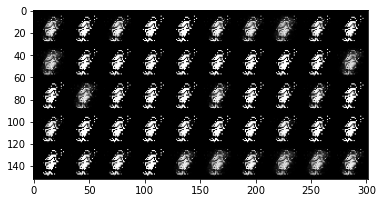

Iter: 14010/100000, Gen loss: 3.7781, Dis loss: 0.1444
Iter: 14020/100000, Gen loss: 3.8964, Dis loss: 0.1094
Iter: 14030/100000, Gen loss: 4.1516, Dis loss: 0.1898
Iter: 14040/100000, Gen loss: 3.4858, Dis loss: 0.1416
Iter: 14050/100000, Gen loss: 4.2740, Dis loss: 0.1527
Iter: 14060/100000, Gen loss: 4.2433, Dis loss: 0.1299
Iter: 14070/100000, Gen loss: 3.5366, Dis loss: 0.1247
Iter: 14080/100000, Gen loss: 3.8193, Dis loss: 0.1162
Iter: 14090/100000, Gen loss: 3.3278, Dis loss: 0.1358
Iter: 14100/100000, Gen loss: 3.8160, Dis loss: 0.2374
Iter: 14110/100000, Gen loss: 2.8034, Dis loss: 0.1998
Iter: 14120/100000, Gen loss: 3.1411, Dis loss: 0.2202
Iter: 14130/100000, Gen loss: 3.5467, Dis loss: 0.3189
Iter: 14140/100000, Gen loss: 3.5766, Dis loss: 0.1352
Iter: 14150/100000, Gen loss: 3.8713, Dis loss: 0.1157
Iter: 14160/100000, Gen loss: 3.1748, Dis loss: 0.2601
Iter: 14170/100000, Gen loss: 3.1352, Dis loss: 0.1639
Iter: 14180/100000, Gen loss: 4.1588, Dis loss: 0.0929
Iter: 1419

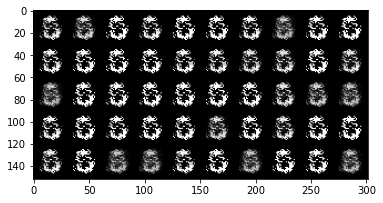

Iter: 14210/100000, Gen loss: 4.0165, Dis loss: 0.0996
Iter: 14220/100000, Gen loss: 4.4872, Dis loss: 0.1600
Iter: 14230/100000, Gen loss: 4.1466, Dis loss: 0.1695
Iter: 14240/100000, Gen loss: 4.0785, Dis loss: 0.4479
Iter: 14250/100000, Gen loss: 5.3690, Dis loss: 0.1964
Iter: 14260/100000, Gen loss: 3.7181, Dis loss: 0.1838
Iter: 14270/100000, Gen loss: 4.5085, Dis loss: 0.2861
Iter: 14280/100000, Gen loss: 3.2597, Dis loss: 0.3881
Iter: 14290/100000, Gen loss: 3.6691, Dis loss: 0.2006
Iter: 14300/100000, Gen loss: 3.3244, Dis loss: 0.1915
Iter: 14310/100000, Gen loss: 3.2695, Dis loss: 0.2180
Iter: 14320/100000, Gen loss: 2.6632, Dis loss: 0.2814
Iter: 14330/100000, Gen loss: 3.3067, Dis loss: 0.1794
Iter: 14340/100000, Gen loss: 2.6680, Dis loss: 0.1849
Iter: 14350/100000, Gen loss: 2.7884, Dis loss: 0.1852
Iter: 14360/100000, Gen loss: 3.1620, Dis loss: 0.1370
Iter: 14370/100000, Gen loss: 3.6577, Dis loss: 0.1472
Iter: 14380/100000, Gen loss: 3.9790, Dis loss: 0.1591
Iter: 1439

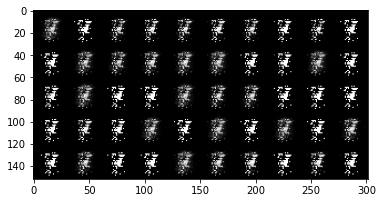

Iter: 14410/100000, Gen loss: 3.3067, Dis loss: 0.1954
Iter: 14420/100000, Gen loss: 4.3435, Dis loss: 0.1380
Iter: 14430/100000, Gen loss: 2.7041, Dis loss: 0.2545
Iter: 14440/100000, Gen loss: 3.8807, Dis loss: 0.2339
Iter: 14450/100000, Gen loss: 3.7640, Dis loss: 0.2022
Iter: 14460/100000, Gen loss: 4.0028, Dis loss: 0.2796
Iter: 14470/100000, Gen loss: 3.4117, Dis loss: 0.1703
Iter: 14480/100000, Gen loss: 3.3674, Dis loss: 0.2722
Iter: 14490/100000, Gen loss: 3.0877, Dis loss: 0.2943
Iter: 14500/100000, Gen loss: 3.8232, Dis loss: 0.3596
Iter: 14510/100000, Gen loss: 3.3815, Dis loss: 0.1748
Iter: 14520/100000, Gen loss: 3.2610, Dis loss: 0.1552
Iter: 14530/100000, Gen loss: 3.9183, Dis loss: 0.1149
Iter: 14540/100000, Gen loss: 4.0266, Dis loss: 0.1120
Iter: 14550/100000, Gen loss: 4.4142, Dis loss: 0.1716
Iter: 14560/100000, Gen loss: 4.0556, Dis loss: 0.1327
Iter: 14570/100000, Gen loss: 3.0995, Dis loss: 0.1108
Iter: 14580/100000, Gen loss: 4.2419, Dis loss: 0.1798
Iter: 1459

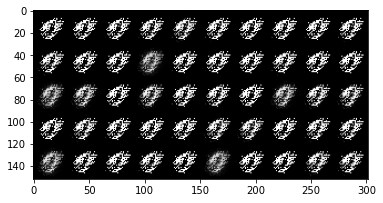

Iter: 14610/100000, Gen loss: 3.8940, Dis loss: 0.1156
Iter: 14620/100000, Gen loss: 3.5507, Dis loss: 0.1693
Iter: 14630/100000, Gen loss: 3.9179, Dis loss: 0.1363
Iter: 14640/100000, Gen loss: 3.2877, Dis loss: 0.1393
Iter: 14650/100000, Gen loss: 3.0349, Dis loss: 0.1751
Iter: 14660/100000, Gen loss: 3.7139, Dis loss: 0.1987
Iter: 14670/100000, Gen loss: 3.2689, Dis loss: 0.2331
Iter: 14680/100000, Gen loss: 3.9043, Dis loss: 0.2366
Iter: 14690/100000, Gen loss: 3.6023, Dis loss: 0.2466
Iter: 14700/100000, Gen loss: 3.3508, Dis loss: 0.1485
Iter: 14710/100000, Gen loss: 3.3190, Dis loss: 0.3530
Iter: 14720/100000, Gen loss: 4.1773, Dis loss: 0.1990
Iter: 14730/100000, Gen loss: 2.9019, Dis loss: 0.1748
Iter: 14740/100000, Gen loss: 3.7430, Dis loss: 0.3770
Iter: 14750/100000, Gen loss: 3.6009, Dis loss: 0.2270
Iter: 14760/100000, Gen loss: 3.6060, Dis loss: 0.2969
Iter: 14770/100000, Gen loss: 3.3929, Dis loss: 0.2638
Iter: 14780/100000, Gen loss: 3.2800, Dis loss: 0.2221
Iter: 1479

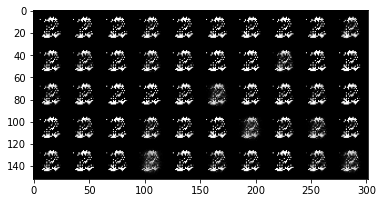

Iter: 14810/100000, Gen loss: 3.6563, Dis loss: 0.1766
Iter: 14820/100000, Gen loss: 3.0751, Dis loss: 0.1917
Iter: 14830/100000, Gen loss: 3.5055, Dis loss: 0.2246
Iter: 14840/100000, Gen loss: 3.6569, Dis loss: 0.2000
Iter: 14850/100000, Gen loss: 4.8009, Dis loss: 0.1783
Iter: 14860/100000, Gen loss: 3.8846, Dis loss: 0.2437
Iter: 14870/100000, Gen loss: 3.8690, Dis loss: 0.2791
Iter: 14880/100000, Gen loss: 3.7809, Dis loss: 0.1788
Iter: 14890/100000, Gen loss: 4.4575, Dis loss: 0.1380
Iter: 14900/100000, Gen loss: 5.2057, Dis loss: 0.1326
Iter: 14910/100000, Gen loss: 5.8402, Dis loss: 0.1872
Iter: 14920/100000, Gen loss: 6.6953, Dis loss: 0.1921
Iter: 14930/100000, Gen loss: 4.6728, Dis loss: 0.1299
Iter: 14940/100000, Gen loss: 3.3671, Dis loss: 0.3268
Iter: 14950/100000, Gen loss: 3.2010, Dis loss: 0.2288
Iter: 14960/100000, Gen loss: 3.7215, Dis loss: 0.1109
Iter: 14970/100000, Gen loss: 4.6322, Dis loss: 0.1746
Iter: 14980/100000, Gen loss: 3.8971, Dis loss: 0.1325
Iter: 1499

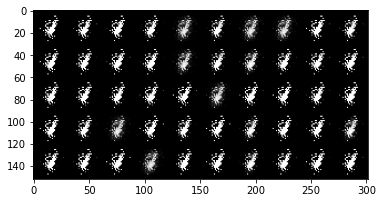

Iter: 15010/100000, Gen loss: 3.9280, Dis loss: 0.1238
Iter: 15020/100000, Gen loss: 3.9178, Dis loss: 0.1041
Iter: 15030/100000, Gen loss: 4.3489, Dis loss: 0.0839
Iter: 15040/100000, Gen loss: 3.4366, Dis loss: 0.1454
Iter: 15050/100000, Gen loss: 3.8563, Dis loss: 0.1736
Iter: 15060/100000, Gen loss: 3.4554, Dis loss: 0.1060
Iter: 15070/100000, Gen loss: 3.4368, Dis loss: 0.0844
Iter: 15080/100000, Gen loss: 3.2011, Dis loss: 0.1927
Iter: 15090/100000, Gen loss: 3.4166, Dis loss: 0.1834
Iter: 15100/100000, Gen loss: 3.9401, Dis loss: 0.2989
Iter: 15110/100000, Gen loss: 5.0713, Dis loss: 0.2319
Iter: 15120/100000, Gen loss: 3.6992, Dis loss: 0.3447
Iter: 15130/100000, Gen loss: 3.2878, Dis loss: 0.2295
Iter: 15140/100000, Gen loss: 3.8103, Dis loss: 0.0954
Iter: 15150/100000, Gen loss: 3.0253, Dis loss: 0.1979
Iter: 15160/100000, Gen loss: 3.5843, Dis loss: 0.1316
Iter: 15170/100000, Gen loss: 3.9860, Dis loss: 0.1039
Iter: 15180/100000, Gen loss: 4.2135, Dis loss: 0.1131
Iter: 1519

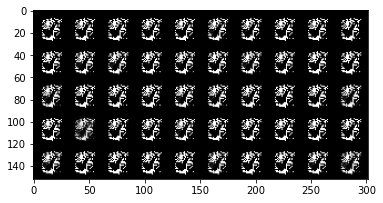

Iter: 15210/100000, Gen loss: 4.3654, Dis loss: 0.0661
Iter: 15220/100000, Gen loss: 4.1597, Dis loss: 0.0919
Iter: 15230/100000, Gen loss: 4.1672, Dis loss: 0.0578
Iter: 15240/100000, Gen loss: 4.3769, Dis loss: 0.0423
Iter: 15250/100000, Gen loss: 4.1895, Dis loss: 0.0494
Iter: 15260/100000, Gen loss: 4.7633, Dis loss: 0.0709
Iter: 15270/100000, Gen loss: 4.5568, Dis loss: 0.0787
Iter: 15280/100000, Gen loss: 4.6018, Dis loss: 0.0978
Iter: 15290/100000, Gen loss: 5.3487, Dis loss: 0.2712
Iter: 15300/100000, Gen loss: 4.6683, Dis loss: 0.0541
Iter: 15310/100000, Gen loss: 4.2538, Dis loss: 0.0366
Iter: 15320/100000, Gen loss: 6.3956, Dis loss: 0.1729
Iter: 15330/100000, Gen loss: 5.5717, Dis loss: 0.1480
Iter: 15340/100000, Gen loss: 5.4916, Dis loss: 0.1702
Iter: 15350/100000, Gen loss: 4.1050, Dis loss: 0.1849
Iter: 15360/100000, Gen loss: 3.1943, Dis loss: 0.1815
Iter: 15370/100000, Gen loss: 3.8101, Dis loss: 0.2710
Iter: 15380/100000, Gen loss: 3.6103, Dis loss: 0.1151
Iter: 1539

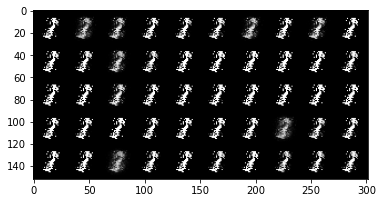

Iter: 15410/100000, Gen loss: 3.2489, Dis loss: 0.2274
Iter: 15420/100000, Gen loss: 3.2759, Dis loss: 0.2715
Iter: 15430/100000, Gen loss: 3.1135, Dis loss: 0.2769
Iter: 15440/100000, Gen loss: 2.9522, Dis loss: 0.1937
Iter: 15450/100000, Gen loss: 4.1827, Dis loss: 0.2267
Iter: 15460/100000, Gen loss: 2.7639, Dis loss: 0.2156
Iter: 15470/100000, Gen loss: 3.6369, Dis loss: 0.2007
Iter: 15480/100000, Gen loss: 4.4557, Dis loss: 0.2757
Iter: 15490/100000, Gen loss: 4.1837, Dis loss: 0.0791
Iter: 15500/100000, Gen loss: 4.1737, Dis loss: 0.0746
Iter: 15510/100000, Gen loss: 4.2073, Dis loss: 0.2520
Iter: 15520/100000, Gen loss: 3.7874, Dis loss: 0.1288
Iter: 15530/100000, Gen loss: 4.3374, Dis loss: 0.0675
Iter: 15540/100000, Gen loss: 4.8458, Dis loss: 0.0568
Iter: 15550/100000, Gen loss: 4.4197, Dis loss: 0.0706
Iter: 15560/100000, Gen loss: 4.0812, Dis loss: 0.2020
Iter: 15570/100000, Gen loss: 4.0068, Dis loss: 0.1343
Iter: 15580/100000, Gen loss: 3.5759, Dis loss: 0.1090
Iter: 1559

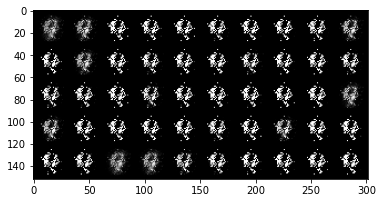

Iter: 15610/100000, Gen loss: 3.0998, Dis loss: 0.1745
Iter: 15620/100000, Gen loss: 4.0618, Dis loss: 0.1287
Iter: 15630/100000, Gen loss: 3.2224, Dis loss: 0.1414
Iter: 15640/100000, Gen loss: 4.5370, Dis loss: 0.1930
Iter: 15650/100000, Gen loss: 3.4957, Dis loss: 0.1486
Iter: 15660/100000, Gen loss: 4.9876, Dis loss: 0.0948
Iter: 15670/100000, Gen loss: 3.9729, Dis loss: 0.0957
Iter: 15680/100000, Gen loss: 3.6675, Dis loss: 0.0622
Iter: 15690/100000, Gen loss: 3.8520, Dis loss: 0.0827
Iter: 15700/100000, Gen loss: 4.2380, Dis loss: 0.0817
Iter: 15710/100000, Gen loss: 4.3903, Dis loss: 0.0803
Iter: 15720/100000, Gen loss: 3.5941, Dis loss: 0.0693
Iter: 15730/100000, Gen loss: 3.8126, Dis loss: 0.1341
Iter: 15740/100000, Gen loss: 3.8727, Dis loss: 0.0896
Iter: 15750/100000, Gen loss: 3.2897, Dis loss: 0.0635
Iter: 15760/100000, Gen loss: 4.8440, Dis loss: 0.0790
Iter: 15770/100000, Gen loss: 4.3900, Dis loss: 0.1466
Iter: 15780/100000, Gen loss: 4.7012, Dis loss: 0.0804
Iter: 1579

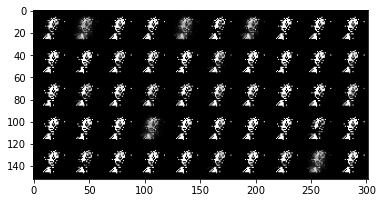

Iter: 15810/100000, Gen loss: 4.9611, Dis loss: 0.0709
Iter: 15820/100000, Gen loss: 3.8442, Dis loss: 0.0577
Iter: 15830/100000, Gen loss: 4.1876, Dis loss: 0.0752
Iter: 15840/100000, Gen loss: 3.5422, Dis loss: 0.1952
Iter: 15850/100000, Gen loss: 3.8510, Dis loss: 0.1017
Iter: 15860/100000, Gen loss: 4.2379, Dis loss: 0.1628
Iter: 15870/100000, Gen loss: 4.2413, Dis loss: 0.0456
Iter: 15880/100000, Gen loss: 3.9631, Dis loss: 0.1411
Iter: 15890/100000, Gen loss: 4.3531, Dis loss: 0.0747
Iter: 15900/100000, Gen loss: 4.4918, Dis loss: 0.1030
Iter: 15910/100000, Gen loss: 4.1589, Dis loss: 0.1336
Iter: 15920/100000, Gen loss: 4.4554, Dis loss: 0.2238
Iter: 15930/100000, Gen loss: 4.4515, Dis loss: 0.0939
Iter: 15940/100000, Gen loss: 4.5810, Dis loss: 0.1381
Iter: 15950/100000, Gen loss: 4.1397, Dis loss: 0.0952
Iter: 15960/100000, Gen loss: 3.9311, Dis loss: 0.1948
Iter: 15970/100000, Gen loss: 5.4086, Dis loss: 0.0747
Iter: 15980/100000, Gen loss: 4.1546, Dis loss: 0.0798
Iter: 1599

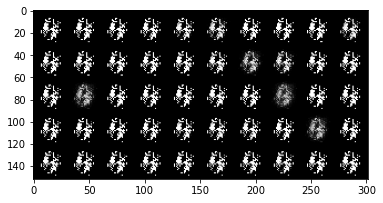

Iter: 16010/100000, Gen loss: 4.9810, Dis loss: 0.0564
Iter: 16020/100000, Gen loss: 4.5652, Dis loss: 0.0720
Iter: 16030/100000, Gen loss: 4.6350, Dis loss: 0.3173
Iter: 16040/100000, Gen loss: 4.4536, Dis loss: 0.2523
Iter: 16050/100000, Gen loss: 4.5153, Dis loss: 0.1759
Iter: 16060/100000, Gen loss: 4.6923, Dis loss: 0.1451
Iter: 16070/100000, Gen loss: 4.8246, Dis loss: 0.1337
Iter: 16080/100000, Gen loss: 3.6264, Dis loss: 0.1947
Iter: 16090/100000, Gen loss: 3.9109, Dis loss: 0.2017
Iter: 16100/100000, Gen loss: 3.8398, Dis loss: 0.0664
Iter: 16110/100000, Gen loss: 4.0200, Dis loss: 0.0789
Iter: 16120/100000, Gen loss: 4.3147, Dis loss: 0.1437
Iter: 16130/100000, Gen loss: 3.5172, Dis loss: 0.0752
Iter: 16140/100000, Gen loss: 4.9472, Dis loss: 0.0423
Iter: 16150/100000, Gen loss: 4.9811, Dis loss: 0.0450
Iter: 16160/100000, Gen loss: 4.3690, Dis loss: 0.0538
Iter: 16170/100000, Gen loss: 5.1164, Dis loss: 0.0706
Iter: 16180/100000, Gen loss: 5.3132, Dis loss: 0.0618
Iter: 1619

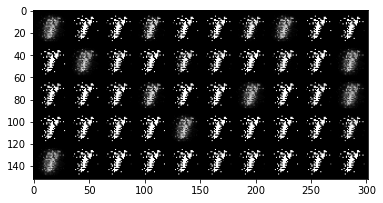

Iter: 16210/100000, Gen loss: 5.0148, Dis loss: 0.0485
Iter: 16220/100000, Gen loss: 4.8908, Dis loss: 0.1204
Iter: 16230/100000, Gen loss: 4.2317, Dis loss: 0.0560
Iter: 16240/100000, Gen loss: 5.3965, Dis loss: 0.0875
Iter: 16250/100000, Gen loss: 4.8194, Dis loss: 0.0495
Iter: 16260/100000, Gen loss: 6.6201, Dis loss: 0.0692
Iter: 16270/100000, Gen loss: 5.0933, Dis loss: 0.0790
Iter: 16280/100000, Gen loss: 4.1119, Dis loss: 0.1739
Iter: 16290/100000, Gen loss: 3.9329, Dis loss: 0.0878
Iter: 16300/100000, Gen loss: 4.4327, Dis loss: 0.1125
Iter: 16310/100000, Gen loss: 4.0636, Dis loss: 0.0532
Iter: 16320/100000, Gen loss: 4.4243, Dis loss: 0.0593
Iter: 16330/100000, Gen loss: 4.6567, Dis loss: 0.0908
Iter: 16340/100000, Gen loss: 4.8415, Dis loss: 0.0788
Iter: 16350/100000, Gen loss: 4.1660, Dis loss: 0.2294
Iter: 16360/100000, Gen loss: 4.4838, Dis loss: 0.0585
Iter: 16370/100000, Gen loss: 4.1143, Dis loss: 0.0660
Iter: 16380/100000, Gen loss: 4.4551, Dis loss: 0.0514
Iter: 1639

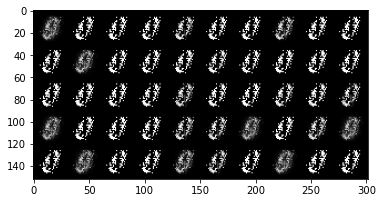

Iter: 16410/100000, Gen loss: 4.6047, Dis loss: 0.1054
Iter: 16420/100000, Gen loss: 4.1140, Dis loss: 0.0882
Iter: 16430/100000, Gen loss: 4.3699, Dis loss: 0.1217
Iter: 16440/100000, Gen loss: 3.9618, Dis loss: 0.0989
Iter: 16450/100000, Gen loss: 4.7081, Dis loss: 0.0780
Iter: 16460/100000, Gen loss: 4.7555, Dis loss: 0.0791
Iter: 16470/100000, Gen loss: 3.6893, Dis loss: 0.0891
Iter: 16480/100000, Gen loss: 4.1270, Dis loss: 0.0920
Iter: 16490/100000, Gen loss: 3.9095, Dis loss: 0.0734
Iter: 16500/100000, Gen loss: 4.2450, Dis loss: 0.1315
Iter: 16510/100000, Gen loss: 3.9802, Dis loss: 0.1688
Iter: 16520/100000, Gen loss: 5.1004, Dis loss: 0.0737
Iter: 16530/100000, Gen loss: 3.7775, Dis loss: 0.0828
Iter: 16540/100000, Gen loss: 4.4733, Dis loss: 0.1222
Iter: 16550/100000, Gen loss: 4.2289, Dis loss: 0.0921
Iter: 16560/100000, Gen loss: 4.1351, Dis loss: 0.0880
Iter: 16570/100000, Gen loss: 4.4793, Dis loss: 0.1413
Iter: 16580/100000, Gen loss: 3.3245, Dis loss: 0.1883
Iter: 1659

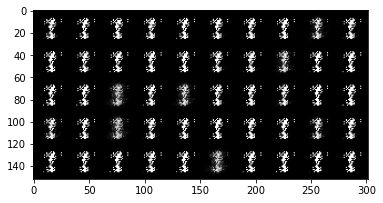

Iter: 16610/100000, Gen loss: 3.5112, Dis loss: 0.2966
Iter: 16620/100000, Gen loss: 3.0156, Dis loss: 0.2052
Iter: 16630/100000, Gen loss: 4.4868, Dis loss: 0.0945
Iter: 16640/100000, Gen loss: 4.0833, Dis loss: 0.0961
Iter: 16650/100000, Gen loss: 4.4377, Dis loss: 0.0864
Iter: 16660/100000, Gen loss: 4.4405, Dis loss: 0.0608
Iter: 16670/100000, Gen loss: 5.0325, Dis loss: 0.0306
Iter: 16680/100000, Gen loss: 5.1732, Dis loss: 0.0307
Iter: 16690/100000, Gen loss: 3.8848, Dis loss: 0.1162
Iter: 16700/100000, Gen loss: 4.2934, Dis loss: 0.0592
Iter: 16710/100000, Gen loss: 5.1033, Dis loss: 0.0431
Iter: 16720/100000, Gen loss: 4.4869, Dis loss: 0.0473
Iter: 16730/100000, Gen loss: 5.1959, Dis loss: 0.0840
Iter: 16740/100000, Gen loss: 5.0981, Dis loss: 0.0816
Iter: 16750/100000, Gen loss: 4.9118, Dis loss: 0.1371
Iter: 16760/100000, Gen loss: 4.3415, Dis loss: 0.1675
Iter: 16770/100000, Gen loss: 4.3936, Dis loss: 0.1583
Iter: 16780/100000, Gen loss: 3.6342, Dis loss: 0.0752
Iter: 1679

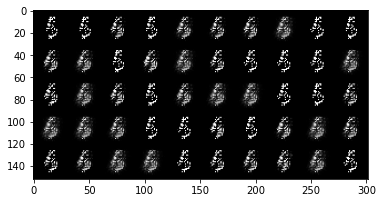

Iter: 16810/100000, Gen loss: 4.5751, Dis loss: 0.0942
Iter: 16820/100000, Gen loss: 5.0505, Dis loss: 0.2679
Iter: 16830/100000, Gen loss: 4.1346, Dis loss: 0.1242
Iter: 16840/100000, Gen loss: 3.9767, Dis loss: 0.1365
Iter: 16850/100000, Gen loss: 3.1164, Dis loss: 0.1687
Iter: 16860/100000, Gen loss: 3.1770, Dis loss: 0.1373
Iter: 16870/100000, Gen loss: 5.0808, Dis loss: 0.0805
Iter: 16880/100000, Gen loss: 3.0042, Dis loss: 0.1645
Iter: 16890/100000, Gen loss: 4.6265, Dis loss: 0.0254
Iter: 16900/100000, Gen loss: 3.5723, Dis loss: 0.1861
Iter: 16910/100000, Gen loss: 4.0683, Dis loss: 0.1713
Iter: 16920/100000, Gen loss: 4.6601, Dis loss: 0.0792
Iter: 16930/100000, Gen loss: 3.7044, Dis loss: 0.0957
Iter: 16940/100000, Gen loss: 4.7242, Dis loss: 0.0669
Iter: 16950/100000, Gen loss: 3.9763, Dis loss: 0.0650
Iter: 16960/100000, Gen loss: 3.9911, Dis loss: 0.1569
Iter: 16970/100000, Gen loss: 4.4330, Dis loss: 0.0416
Iter: 16980/100000, Gen loss: 4.4854, Dis loss: 0.0726
Iter: 1699

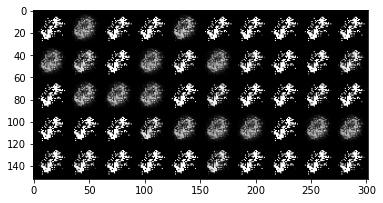

Iter: 17010/100000, Gen loss: 4.9174, Dis loss: 0.0626
Iter: 17020/100000, Gen loss: 3.7088, Dis loss: 0.0701
Iter: 17030/100000, Gen loss: 3.7014, Dis loss: 0.1105
Iter: 17040/100000, Gen loss: 3.6300, Dis loss: 0.1040
Iter: 17050/100000, Gen loss: 3.7030, Dis loss: 0.1229
Iter: 17060/100000, Gen loss: 4.0184, Dis loss: 0.0990
Iter: 17070/100000, Gen loss: 4.7838, Dis loss: 0.1002
Iter: 17080/100000, Gen loss: 4.4297, Dis loss: 0.1494
Iter: 17090/100000, Gen loss: 4.0467, Dis loss: 0.0647
Iter: 17100/100000, Gen loss: 3.7946, Dis loss: 0.1298
Iter: 17110/100000, Gen loss: 3.8201, Dis loss: 0.1493
Iter: 17120/100000, Gen loss: 3.1666, Dis loss: 0.1064
Iter: 17130/100000, Gen loss: 4.5840, Dis loss: 0.0712
Iter: 17140/100000, Gen loss: 3.9932, Dis loss: 0.1887
Iter: 17150/100000, Gen loss: 3.9721, Dis loss: 0.1204
Iter: 17160/100000, Gen loss: 3.3728, Dis loss: 0.0987
Iter: 17170/100000, Gen loss: 4.7811, Dis loss: 0.1312
Iter: 17180/100000, Gen loss: 4.1282, Dis loss: 0.1349
Iter: 1719

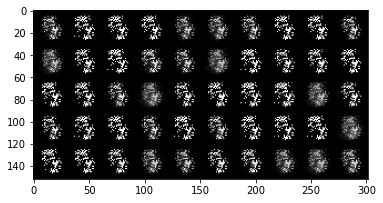

Iter: 17210/100000, Gen loss: 4.2858, Dis loss: 0.0690
Iter: 17220/100000, Gen loss: 5.2996, Dis loss: 0.0432
Iter: 17230/100000, Gen loss: 5.7378, Dis loss: 0.1360
Iter: 17240/100000, Gen loss: 5.5310, Dis loss: 0.1326
Iter: 17250/100000, Gen loss: 5.5886, Dis loss: 0.2482
Iter: 17260/100000, Gen loss: 5.5987, Dis loss: 0.1463
Iter: 17270/100000, Gen loss: 4.1843, Dis loss: 0.0613
Iter: 17280/100000, Gen loss: 4.8171, Dis loss: 0.1329
Iter: 17290/100000, Gen loss: 4.7111, Dis loss: 0.1359
Iter: 17300/100000, Gen loss: 4.0650, Dis loss: 0.0962
Iter: 17310/100000, Gen loss: 4.1471, Dis loss: 0.1900
Iter: 17320/100000, Gen loss: 3.9862, Dis loss: 0.1694
Iter: 17330/100000, Gen loss: 4.6284, Dis loss: 0.0497
Iter: 17340/100000, Gen loss: 3.9581, Dis loss: 0.0504
Iter: 17350/100000, Gen loss: 4.5536, Dis loss: 0.0526
Iter: 17360/100000, Gen loss: 3.8671, Dis loss: 0.0907
Iter: 17370/100000, Gen loss: 4.0558, Dis loss: 0.0838
Iter: 17380/100000, Gen loss: 3.9764, Dis loss: 0.0685
Iter: 1739

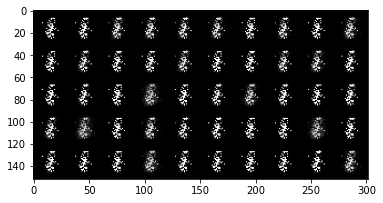

Iter: 17410/100000, Gen loss: 4.8195, Dis loss: 0.0384
Iter: 17420/100000, Gen loss: 4.0386, Dis loss: 0.0649
Iter: 17430/100000, Gen loss: 4.2871, Dis loss: 0.0759
Iter: 17440/100000, Gen loss: 3.9866, Dis loss: 0.0707
Iter: 17450/100000, Gen loss: 3.9084, Dis loss: 0.2975
Iter: 17460/100000, Gen loss: 4.1614, Dis loss: 0.0933
Iter: 17470/100000, Gen loss: 4.2940, Dis loss: 0.0495
Iter: 17480/100000, Gen loss: 3.9993, Dis loss: 0.0515
Iter: 17490/100000, Gen loss: 4.4616, Dis loss: 0.1680
Iter: 17500/100000, Gen loss: 3.8149, Dis loss: 0.0642
Iter: 17510/100000, Gen loss: 4.0227, Dis loss: 0.0544
Iter: 17520/100000, Gen loss: 4.7146, Dis loss: 0.0464
Iter: 17530/100000, Gen loss: 4.7569, Dis loss: 0.0667
Iter: 17540/100000, Gen loss: 5.1027, Dis loss: 0.0363
Iter: 17550/100000, Gen loss: 5.4313, Dis loss: 0.1053
Iter: 17560/100000, Gen loss: 5.9227, Dis loss: 0.0410
Iter: 17570/100000, Gen loss: 4.4208, Dis loss: 0.1801
Iter: 17580/100000, Gen loss: 5.7387, Dis loss: 0.0600
Iter: 1759

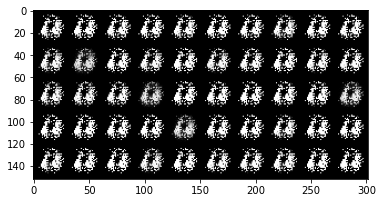

Iter: 17610/100000, Gen loss: 5.0897, Dis loss: 0.1777
Iter: 17620/100000, Gen loss: 4.4922, Dis loss: 0.1007
Iter: 17630/100000, Gen loss: 4.5728, Dis loss: 0.0656
Iter: 17640/100000, Gen loss: 5.3482, Dis loss: 0.0311
Iter: 17650/100000, Gen loss: 5.1628, Dis loss: 0.0707
Iter: 17660/100000, Gen loss: 5.7456, Dis loss: 0.0778
Iter: 17670/100000, Gen loss: 5.6081, Dis loss: 0.1615
Iter: 17680/100000, Gen loss: 4.2782, Dis loss: 0.2025
Iter: 17690/100000, Gen loss: 5.3757, Dis loss: 0.2044
Iter: 17700/100000, Gen loss: 4.4486, Dis loss: 0.0635
Iter: 17710/100000, Gen loss: 4.7307, Dis loss: 0.0818
Iter: 17720/100000, Gen loss: 4.8888, Dis loss: 0.0416
Iter: 17730/100000, Gen loss: 4.1084, Dis loss: 0.0299
Iter: 17740/100000, Gen loss: 3.6925, Dis loss: 0.1450
Iter: 17750/100000, Gen loss: 4.5205, Dis loss: 0.0965
Iter: 17760/100000, Gen loss: 3.2522, Dis loss: 0.1362
Iter: 17770/100000, Gen loss: 5.1944, Dis loss: 0.0795
Iter: 17780/100000, Gen loss: 4.2809, Dis loss: 0.0811
Iter: 1779

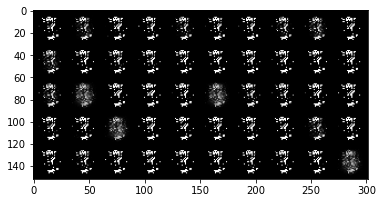

Iter: 17810/100000, Gen loss: 3.5235, Dis loss: 0.1834
Iter: 17820/100000, Gen loss: 3.7742, Dis loss: 0.0802
Iter: 17830/100000, Gen loss: 5.3752, Dis loss: 0.0700
Iter: 17840/100000, Gen loss: 6.6282, Dis loss: 0.0929
Iter: 17850/100000, Gen loss: 5.2114, Dis loss: 0.0390
Iter: 17860/100000, Gen loss: 5.8523, Dis loss: 0.0287
Iter: 17870/100000, Gen loss: 4.1423, Dis loss: 0.1369
Iter: 17880/100000, Gen loss: 5.1552, Dis loss: 0.0806
Iter: 17890/100000, Gen loss: 4.0753, Dis loss: 0.1111
Iter: 17900/100000, Gen loss: 3.9093, Dis loss: 0.1323
Iter: 17910/100000, Gen loss: 4.2951, Dis loss: 0.0721
Iter: 17920/100000, Gen loss: 4.5757, Dis loss: 0.1176
Iter: 17930/100000, Gen loss: 4.8830, Dis loss: 0.1654
Iter: 17940/100000, Gen loss: 3.4781, Dis loss: 0.0731
Iter: 17950/100000, Gen loss: 3.6244, Dis loss: 0.1470
Iter: 17960/100000, Gen loss: 4.5541, Dis loss: 0.0528
Iter: 17970/100000, Gen loss: 4.4550, Dis loss: 0.1652
Iter: 17980/100000, Gen loss: 4.2460, Dis loss: 0.1315
Iter: 1799

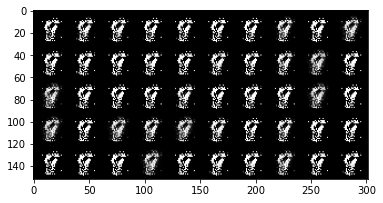

Iter: 18010/100000, Gen loss: 5.2593, Dis loss: 0.0956
Iter: 18020/100000, Gen loss: 4.5227, Dis loss: 0.0562
Iter: 18030/100000, Gen loss: 4.4952, Dis loss: 0.1152
Iter: 18040/100000, Gen loss: 5.2133, Dis loss: 0.0238
Iter: 18050/100000, Gen loss: 4.9628, Dis loss: 0.0264
Iter: 18060/100000, Gen loss: 6.9820, Dis loss: 0.0490
Iter: 18070/100000, Gen loss: 4.3801, Dis loss: 0.0533
Iter: 18080/100000, Gen loss: 5.0230, Dis loss: 0.0454
Iter: 18090/100000, Gen loss: 6.0683, Dis loss: 0.0450
Iter: 18100/100000, Gen loss: 4.6752, Dis loss: 0.0928
Iter: 18110/100000, Gen loss: 5.5123, Dis loss: 0.0491
Iter: 18120/100000, Gen loss: 4.8966, Dis loss: 0.0970
Iter: 18130/100000, Gen loss: 4.3762, Dis loss: 0.0629
Iter: 18140/100000, Gen loss: 4.8252, Dis loss: 0.0329
Iter: 18150/100000, Gen loss: 4.4060, Dis loss: 0.0330
Iter: 18160/100000, Gen loss: 3.9349, Dis loss: 0.1173
Iter: 18170/100000, Gen loss: 3.8826, Dis loss: 0.1075
Iter: 18180/100000, Gen loss: 5.3622, Dis loss: 0.0380
Iter: 1819

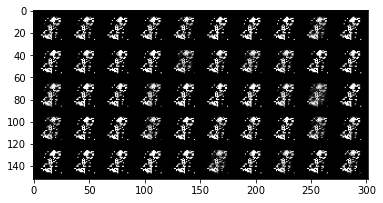

Iter: 18210/100000, Gen loss: 4.8595, Dis loss: 0.0368
Iter: 18220/100000, Gen loss: 4.6764, Dis loss: 0.1325
Iter: 18230/100000, Gen loss: 4.5480, Dis loss: 0.0594
Iter: 18240/100000, Gen loss: 3.8293, Dis loss: 0.2806
Iter: 18250/100000, Gen loss: 4.3329, Dis loss: 0.1257
Iter: 18260/100000, Gen loss: 5.2794, Dis loss: 0.0515
Iter: 18270/100000, Gen loss: 4.7524, Dis loss: 0.0704
Iter: 18280/100000, Gen loss: 5.4959, Dis loss: 0.0586
Iter: 18290/100000, Gen loss: 4.9828, Dis loss: 0.1009
Iter: 18300/100000, Gen loss: 4.8785, Dis loss: 0.0385
Iter: 18310/100000, Gen loss: 6.0471, Dis loss: 0.0515
Iter: 18320/100000, Gen loss: 5.6155, Dis loss: 0.0811
Iter: 18330/100000, Gen loss: 6.2661, Dis loss: 0.0635
Iter: 18340/100000, Gen loss: 5.9609, Dis loss: 0.0244
Iter: 18350/100000, Gen loss: 6.3616, Dis loss: 0.0675
Iter: 18360/100000, Gen loss: 5.7775, Dis loss: 0.0630
Iter: 18370/100000, Gen loss: 4.2110, Dis loss: 0.1170
Iter: 18380/100000, Gen loss: 5.4344, Dis loss: 0.0510
Iter: 1839

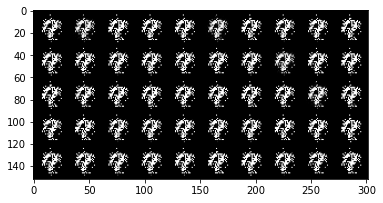

Iter: 18410/100000, Gen loss: 5.5288, Dis loss: 0.0307
Iter: 18420/100000, Gen loss: 4.5655, Dis loss: 0.0696
Iter: 18430/100000, Gen loss: 5.1002, Dis loss: 0.0529
Iter: 18440/100000, Gen loss: 4.6211, Dis loss: 0.0378
Iter: 18450/100000, Gen loss: 5.3140, Dis loss: 0.0241
Iter: 18460/100000, Gen loss: 4.9423, Dis loss: 0.0159
Iter: 18470/100000, Gen loss: 4.8726, Dis loss: 0.0486
Iter: 18480/100000, Gen loss: 4.6831, Dis loss: 0.0545
Iter: 18490/100000, Gen loss: 4.4233, Dis loss: 0.0548
Iter: 18500/100000, Gen loss: 4.0687, Dis loss: 0.0577
Iter: 18510/100000, Gen loss: 4.5836, Dis loss: 0.0428
Iter: 18520/100000, Gen loss: 3.7628, Dis loss: 0.1616
Iter: 18530/100000, Gen loss: 5.5038, Dis loss: 0.0430
Iter: 18540/100000, Gen loss: 3.5405, Dis loss: 0.0743
Iter: 18550/100000, Gen loss: 6.3305, Dis loss: 0.0280
Iter: 18560/100000, Gen loss: 4.2755, Dis loss: 0.0225
Iter: 18570/100000, Gen loss: 5.2085, Dis loss: 0.0503
Iter: 18580/100000, Gen loss: 4.8783, Dis loss: 0.0352
Iter: 1859

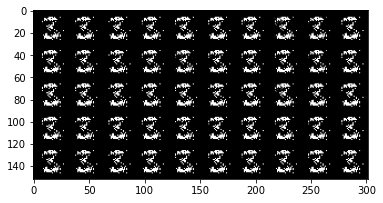

Iter: 18610/100000, Gen loss: 4.6542, Dis loss: 0.0330
Iter: 18620/100000, Gen loss: 4.8769, Dis loss: 0.0331
Iter: 18630/100000, Gen loss: 4.8716, Dis loss: 0.0111
Iter: 18640/100000, Gen loss: 6.0088, Dis loss: 0.0042
Iter: 18650/100000, Gen loss: 6.0723, Dis loss: 0.0507
Iter: 18660/100000, Gen loss: 6.1161, Dis loss: 0.0044
Iter: 18670/100000, Gen loss: 6.6794, Dis loss: 0.0117
Iter: 18680/100000, Gen loss: 5.5710, Dis loss: 0.0109
Iter: 18690/100000, Gen loss: 6.1303, Dis loss: 0.0332
Iter: 18700/100000, Gen loss: 6.5141, Dis loss: 0.0143
Iter: 18710/100000, Gen loss: 6.7211, Dis loss: 0.0056
Iter: 18720/100000, Gen loss: 5.5973, Dis loss: 0.0050
Iter: 18730/100000, Gen loss: 7.1820, Dis loss: 0.0023
Iter: 18740/100000, Gen loss: 6.5292, Dis loss: 0.0134
Iter: 18750/100000, Gen loss: 6.1363, Dis loss: 0.0944
Iter: 18760/100000, Gen loss: 5.9112, Dis loss: 0.0140
Iter: 18770/100000, Gen loss: 6.0578, Dis loss: 0.0374
Iter: 18780/100000, Gen loss: 7.4119, Dis loss: 0.0106
Iter: 1879

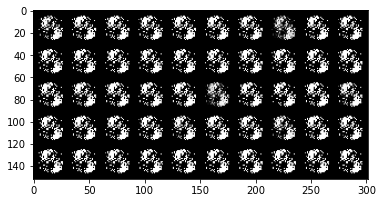

Iter: 18810/100000, Gen loss: 6.0951, Dis loss: 0.0127
Iter: 18820/100000, Gen loss: 5.5524, Dis loss: 0.0212
Iter: 18830/100000, Gen loss: 5.4283, Dis loss: 0.1408
Iter: 18840/100000, Gen loss: 7.1303, Dis loss: 0.1189
Iter: 18850/100000, Gen loss: 5.2542, Dis loss: 0.0717
Iter: 18860/100000, Gen loss: 4.6336, Dis loss: 0.1395
Iter: 18870/100000, Gen loss: 6.3998, Dis loss: 0.0717
Iter: 18880/100000, Gen loss: 3.7507, Dis loss: 0.1354
Iter: 18890/100000, Gen loss: 4.4452, Dis loss: 0.0867
Iter: 18900/100000, Gen loss: 3.7768, Dis loss: 0.0778
Iter: 18910/100000, Gen loss: 5.3925, Dis loss: 0.0325
Iter: 18920/100000, Gen loss: 4.1248, Dis loss: 0.1565
Iter: 18930/100000, Gen loss: 5.7964, Dis loss: 0.0555
Iter: 18940/100000, Gen loss: 3.9598, Dis loss: 0.0193
Iter: 18950/100000, Gen loss: 4.7987, Dis loss: 0.0610
Iter: 18960/100000, Gen loss: 4.6079, Dis loss: 0.0270
Iter: 18970/100000, Gen loss: 4.4833, Dis loss: 0.0421
Iter: 18980/100000, Gen loss: 5.1273, Dis loss: 0.0419
Iter: 1899

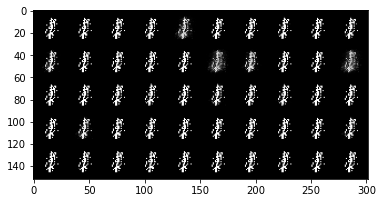

Iter: 19010/100000, Gen loss: 4.1472, Dis loss: 0.0604
Iter: 19020/100000, Gen loss: 5.2078, Dis loss: 0.0337
Iter: 19030/100000, Gen loss: 4.4618, Dis loss: 0.0173
Iter: 19040/100000, Gen loss: 4.5318, Dis loss: 0.0249
Iter: 19050/100000, Gen loss: 4.3405, Dis loss: 0.0737
Iter: 19060/100000, Gen loss: 4.3276, Dis loss: 0.0363
Iter: 19070/100000, Gen loss: 4.5409, Dis loss: 0.0195
Iter: 19080/100000, Gen loss: 4.6082, Dis loss: 0.0203
Iter: 19090/100000, Gen loss: 5.1437, Dis loss: 0.0279
Iter: 19100/100000, Gen loss: 5.7605, Dis loss: 0.0088
Iter: 19110/100000, Gen loss: 4.9983, Dis loss: 0.0418
Iter: 19120/100000, Gen loss: 5.8386, Dis loss: 0.0235
Iter: 19130/100000, Gen loss: 5.3310, Dis loss: 0.0257
Iter: 19140/100000, Gen loss: 4.3019, Dis loss: 0.0249
Iter: 19150/100000, Gen loss: 4.9108, Dis loss: 0.0382
Iter: 19160/100000, Gen loss: 5.8203, Dis loss: 0.0384
Iter: 19170/100000, Gen loss: 4.7221, Dis loss: 0.0198
Iter: 19180/100000, Gen loss: 5.3333, Dis loss: 0.0249
Iter: 1919

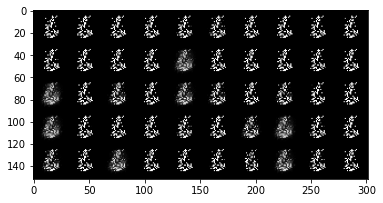

Iter: 19210/100000, Gen loss: 4.7554, Dis loss: 0.0336
Iter: 19220/100000, Gen loss: 5.1690, Dis loss: 0.0179
Iter: 19230/100000, Gen loss: 5.5669, Dis loss: 0.0222
Iter: 19240/100000, Gen loss: 6.2290, Dis loss: 0.0378
Iter: 19250/100000, Gen loss: 6.7117, Dis loss: 0.0168
Iter: 19260/100000, Gen loss: 5.6170, Dis loss: 0.0680
Iter: 19270/100000, Gen loss: 5.1803, Dis loss: 0.1088
Iter: 19280/100000, Gen loss: 5.6227, Dis loss: 0.1165
Iter: 19290/100000, Gen loss: 5.3319, Dis loss: 0.0744
Iter: 19300/100000, Gen loss: 8.2336, Dis loss: 0.0711
Iter: 19310/100000, Gen loss: 5.7689, Dis loss: 0.0369
Iter: 19320/100000, Gen loss: 5.8500, Dis loss: 0.0608
Iter: 19330/100000, Gen loss: 5.0677, Dis loss: 0.0959
Iter: 19340/100000, Gen loss: 5.7410, Dis loss: 0.0538
Iter: 19350/100000, Gen loss: 4.5054, Dis loss: 0.0998
Iter: 19360/100000, Gen loss: 5.0452, Dis loss: 0.1145
Iter: 19370/100000, Gen loss: 5.2299, Dis loss: 0.1191
Iter: 19380/100000, Gen loss: 6.0808, Dis loss: 0.0578
Iter: 1939

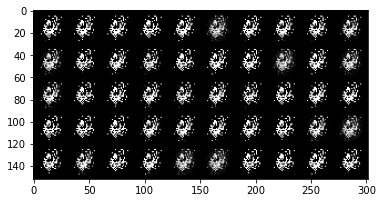

Iter: 19410/100000, Gen loss: 4.8243, Dis loss: 0.0523
Iter: 19420/100000, Gen loss: 5.7858, Dis loss: 0.0206
Iter: 19430/100000, Gen loss: 5.1799, Dis loss: 0.0228
Iter: 19440/100000, Gen loss: 6.0593, Dis loss: 0.0141
Iter: 19450/100000, Gen loss: 5.0138, Dis loss: 0.0377
Iter: 19460/100000, Gen loss: 6.3257, Dis loss: 0.0103
Iter: 19470/100000, Gen loss: 6.4756, Dis loss: 0.0184
Iter: 19480/100000, Gen loss: 5.7117, Dis loss: 0.0222
Iter: 19490/100000, Gen loss: 7.4664, Dis loss: 0.0422
Iter: 19500/100000, Gen loss: 8.2894, Dis loss: 0.0414
Iter: 19510/100000, Gen loss: 7.6934, Dis loss: 0.0260
Iter: 19520/100000, Gen loss: 6.2123, Dis loss: 0.0206
Iter: 19530/100000, Gen loss: 5.6784, Dis loss: 0.1325
Iter: 19540/100000, Gen loss: 5.0553, Dis loss: 0.1528
Iter: 19550/100000, Gen loss: 4.8985, Dis loss: 0.0969
Iter: 19560/100000, Gen loss: 5.6018, Dis loss: 0.0230
Iter: 19570/100000, Gen loss: 4.0634, Dis loss: 0.0418
Iter: 19580/100000, Gen loss: 6.0040, Dis loss: 0.0069
Iter: 1959

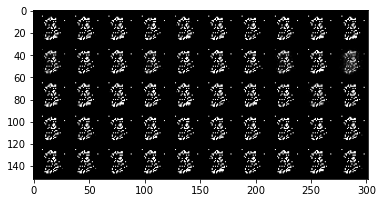

Iter: 19610/100000, Gen loss: 5.1056, Dis loss: 0.0117
Iter: 19620/100000, Gen loss: 4.6838, Dis loss: 0.0117
Iter: 19630/100000, Gen loss: 5.5710, Dis loss: 0.0144
Iter: 19640/100000, Gen loss: 5.0151, Dis loss: 0.0128
Iter: 19650/100000, Gen loss: 5.7685, Dis loss: 0.0096
Iter: 19660/100000, Gen loss: 5.8632, Dis loss: 0.0754
Iter: 19670/100000, Gen loss: 4.9534, Dis loss: 0.0136
Iter: 19680/100000, Gen loss: 5.1031, Dis loss: 0.0159
Iter: 19690/100000, Gen loss: 6.0798, Dis loss: 0.0083
Iter: 19700/100000, Gen loss: 4.9994, Dis loss: 0.0506
Iter: 19710/100000, Gen loss: 5.5822, Dis loss: 0.0087
Iter: 19720/100000, Gen loss: 5.7572, Dis loss: 0.0166
Iter: 19730/100000, Gen loss: 5.3781, Dis loss: 0.0105
Iter: 19740/100000, Gen loss: 6.3873, Dis loss: 0.0111
Iter: 19750/100000, Gen loss: 5.2697, Dis loss: 0.0069
Iter: 19760/100000, Gen loss: 5.5849, Dis loss: 0.0284
Iter: 19770/100000, Gen loss: 5.1548, Dis loss: 0.0865
Iter: 19780/100000, Gen loss: 5.8072, Dis loss: 0.0155
Iter: 1979

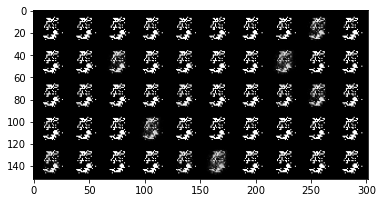

Iter: 19810/100000, Gen loss: 5.2131, Dis loss: 0.0432
Iter: 19820/100000, Gen loss: 6.0075, Dis loss: 0.0535
Iter: 19830/100000, Gen loss: 5.9625, Dis loss: 0.0547
Iter: 19840/100000, Gen loss: 4.7559, Dis loss: 0.0777
Iter: 19850/100000, Gen loss: 5.0227, Dis loss: 0.0610
Iter: 19860/100000, Gen loss: 4.1084, Dis loss: 0.0609
Iter: 19870/100000, Gen loss: 5.0043, Dis loss: 0.0163
Iter: 19880/100000, Gen loss: 5.0722, Dis loss: 0.0451
Iter: 19890/100000, Gen loss: 4.5747, Dis loss: 0.0423
Iter: 19900/100000, Gen loss: 4.9854, Dis loss: 0.0470
Iter: 19910/100000, Gen loss: 4.5835, Dis loss: 0.0492
Iter: 19920/100000, Gen loss: 5.8767, Dis loss: 0.0429
Iter: 19930/100000, Gen loss: 4.6936, Dis loss: 0.0238
Iter: 19940/100000, Gen loss: 5.9516, Dis loss: 0.0242
Iter: 19950/100000, Gen loss: 5.3499, Dis loss: 0.0637
Iter: 19960/100000, Gen loss: 5.7964, Dis loss: 0.0414
Iter: 19970/100000, Gen loss: 5.0260, Dis loss: 0.0291
Iter: 19980/100000, Gen loss: 4.5639, Dis loss: 0.0502
Iter: 1999

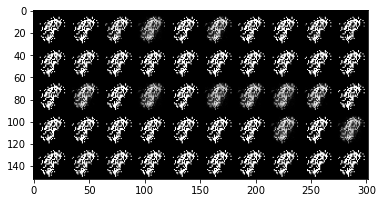

Iter: 20010/100000, Gen loss: 7.0575, Dis loss: 0.0186
Iter: 20020/100000, Gen loss: 7.2358, Dis loss: 0.0615
Iter: 20030/100000, Gen loss: 7.6282, Dis loss: 0.0421
Iter: 20040/100000, Gen loss: 8.0944, Dis loss: 0.0195
Iter: 20050/100000, Gen loss: 8.4839, Dis loss: 0.0313
Iter: 20060/100000, Gen loss: 6.9067, Dis loss: 0.0378
Iter: 20070/100000, Gen loss: 6.0158, Dis loss: 0.0394
Iter: 20080/100000, Gen loss: 4.1681, Dis loss: 0.0500
Iter: 20090/100000, Gen loss: 6.5092, Dis loss: 0.0181
Iter: 20100/100000, Gen loss: 4.9086, Dis loss: 0.0452
Iter: 20110/100000, Gen loss: 5.5945, Dis loss: 0.0706
Iter: 20120/100000, Gen loss: 5.1131, Dis loss: 0.0463
Iter: 20130/100000, Gen loss: 5.0663, Dis loss: 0.0512
Iter: 20140/100000, Gen loss: 4.8582, Dis loss: 0.0632
Iter: 20150/100000, Gen loss: 5.5537, Dis loss: 0.0233
Iter: 20160/100000, Gen loss: 6.0553, Dis loss: 0.0217
Iter: 20170/100000, Gen loss: 6.3572, Dis loss: 0.0520
Iter: 20180/100000, Gen loss: 7.0644, Dis loss: 0.0675
Iter: 2019

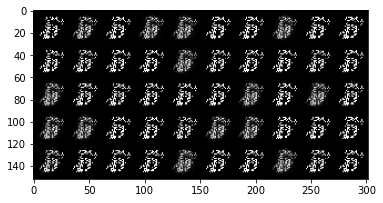

Iter: 20210/100000, Gen loss: 5.9389, Dis loss: 0.0207
Iter: 20220/100000, Gen loss: 6.8029, Dis loss: 0.0198
Iter: 20230/100000, Gen loss: 5.5730, Dis loss: 0.0662
Iter: 20240/100000, Gen loss: 6.9155, Dis loss: 0.0501
Iter: 20250/100000, Gen loss: 7.2327, Dis loss: 0.0538
Iter: 20260/100000, Gen loss: 6.2118, Dis loss: 0.0961
Iter: 20270/100000, Gen loss: 5.5254, Dis loss: 0.0778
Iter: 20280/100000, Gen loss: 5.2352, Dis loss: 0.1413
Iter: 20290/100000, Gen loss: 4.8664, Dis loss: 0.1445
Iter: 20300/100000, Gen loss: 5.2610, Dis loss: 0.0519
Iter: 20310/100000, Gen loss: 5.6321, Dis loss: 0.1475
Iter: 20320/100000, Gen loss: 5.3797, Dis loss: 0.0163
Iter: 20330/100000, Gen loss: 5.6436, Dis loss: 0.0964
Iter: 20340/100000, Gen loss: 6.2950, Dis loss: 0.0194
Iter: 20350/100000, Gen loss: 5.7833, Dis loss: 0.1974
Iter: 20360/100000, Gen loss: 4.9070, Dis loss: 0.0453
Iter: 20370/100000, Gen loss: 4.7017, Dis loss: 0.0517
Iter: 20380/100000, Gen loss: 5.7565, Dis loss: 0.1737
Iter: 2039

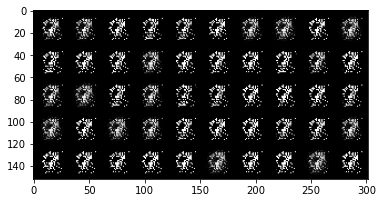

Iter: 20410/100000, Gen loss: 6.1554, Dis loss: 0.1276
Iter: 20420/100000, Gen loss: 5.3499, Dis loss: 0.0651
Iter: 20430/100000, Gen loss: 4.8085, Dis loss: 0.0852
Iter: 20440/100000, Gen loss: 6.1390, Dis loss: 0.0392
Iter: 20450/100000, Gen loss: 5.6139, Dis loss: 0.0365
Iter: 20460/100000, Gen loss: 5.5513, Dis loss: 0.0743
Iter: 20470/100000, Gen loss: 5.2457, Dis loss: 0.0272
Iter: 20480/100000, Gen loss: 5.4203, Dis loss: 0.0093
Iter: 20490/100000, Gen loss: 6.4739, Dis loss: 0.0345
Iter: 20500/100000, Gen loss: 4.7904, Dis loss: 0.0445
Iter: 20510/100000, Gen loss: 6.0212, Dis loss: 0.0245
Iter: 20520/100000, Gen loss: 4.9922, Dis loss: 0.0220
Iter: 20530/100000, Gen loss: 5.7470, Dis loss: 0.0281
Iter: 20540/100000, Gen loss: 5.2505, Dis loss: 0.0759
Iter: 20550/100000, Gen loss: 5.2928, Dis loss: 0.0719
Iter: 20560/100000, Gen loss: 4.2787, Dis loss: 0.1694
Iter: 20570/100000, Gen loss: 5.4335, Dis loss: 0.0982
Iter: 20580/100000, Gen loss: 5.0850, Dis loss: 0.2213
Iter: 2059

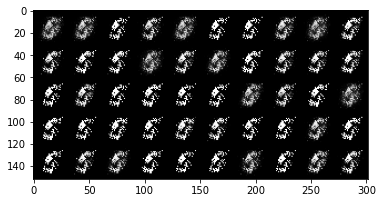

Iter: 20610/100000, Gen loss: 5.1156, Dis loss: 0.0296
Iter: 20620/100000, Gen loss: 5.4549, Dis loss: 0.0483
Iter: 20630/100000, Gen loss: 4.4259, Dis loss: 0.0383
Iter: 20640/100000, Gen loss: 5.2728, Dis loss: 0.0484
Iter: 20650/100000, Gen loss: 4.1572, Dis loss: 0.0556
Iter: 20660/100000, Gen loss: 5.1692, Dis loss: 0.0687
Iter: 20670/100000, Gen loss: 4.8773, Dis loss: 0.0243
Iter: 20680/100000, Gen loss: 6.0797, Dis loss: 0.0382
Iter: 20690/100000, Gen loss: 5.4257, Dis loss: 0.0567
Iter: 20700/100000, Gen loss: 5.2840, Dis loss: 0.1293
Iter: 20710/100000, Gen loss: 5.6890, Dis loss: 0.0890
Iter: 20720/100000, Gen loss: 5.7173, Dis loss: 0.0599
Iter: 20730/100000, Gen loss: 5.6161, Dis loss: 0.1538
Iter: 20740/100000, Gen loss: 5.8989, Dis loss: 0.0206
Iter: 20750/100000, Gen loss: 5.7631, Dis loss: 0.0429
Iter: 20760/100000, Gen loss: 5.5388, Dis loss: 0.0464
Iter: 20770/100000, Gen loss: 6.8940, Dis loss: 0.0739
Iter: 20780/100000, Gen loss: 4.6256, Dis loss: 0.1138
Iter: 2079

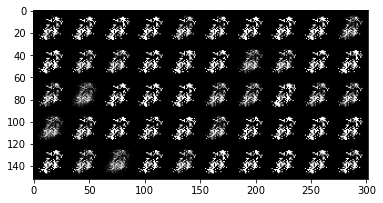

Iter: 20810/100000, Gen loss: 6.4131, Dis loss: 0.0061
Iter: 20820/100000, Gen loss: 5.8687, Dis loss: 0.0192
Iter: 20830/100000, Gen loss: 5.6190, Dis loss: 0.0204
Iter: 20840/100000, Gen loss: 5.4514, Dis loss: 0.0240
Iter: 20850/100000, Gen loss: 7.0212, Dis loss: 0.0311
Iter: 20860/100000, Gen loss: 8.0478, Dis loss: 0.0203
Iter: 20870/100000, Gen loss: 6.0275, Dis loss: 0.0463
Iter: 20880/100000, Gen loss: 5.6607, Dis loss: 0.0594
Iter: 20890/100000, Gen loss: 5.1624, Dis loss: 0.0585
Iter: 20900/100000, Gen loss: 5.7919, Dis loss: 0.0711
Iter: 20910/100000, Gen loss: 6.5691, Dis loss: 0.0938
Iter: 20920/100000, Gen loss: 5.4871, Dis loss: 0.1254
Iter: 20930/100000, Gen loss: 5.5705, Dis loss: 0.0916
Iter: 20940/100000, Gen loss: 5.2426, Dis loss: 0.1124
Iter: 20950/100000, Gen loss: 5.6828, Dis loss: 0.0732
Iter: 20960/100000, Gen loss: 4.5151, Dis loss: 0.0449
Iter: 20970/100000, Gen loss: 4.4812, Dis loss: 0.0743
Iter: 20980/100000, Gen loss: 4.2203, Dis loss: 0.1315
Iter: 2099

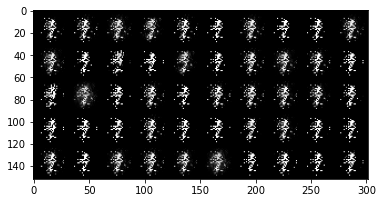

Iter: 21010/100000, Gen loss: 4.9173, Dis loss: 0.0724
Iter: 21020/100000, Gen loss: 5.1766, Dis loss: 0.0707
Iter: 21030/100000, Gen loss: 5.6723, Dis loss: 0.0355
Iter: 21040/100000, Gen loss: 5.0948, Dis loss: 0.1479
Iter: 21050/100000, Gen loss: 5.9912, Dis loss: 0.1086
Iter: 21060/100000, Gen loss: 4.9763, Dis loss: 0.0569
Iter: 21070/100000, Gen loss: 4.4307, Dis loss: 0.0401
Iter: 21080/100000, Gen loss: 5.1669, Dis loss: 0.0580
Iter: 21090/100000, Gen loss: 4.1400, Dis loss: 0.1307
Iter: 21100/100000, Gen loss: 4.3588, Dis loss: 0.0905
Iter: 21110/100000, Gen loss: 4.7745, Dis loss: 0.0673
Iter: 21120/100000, Gen loss: 4.3168, Dis loss: 0.0423
Iter: 21130/100000, Gen loss: 4.8764, Dis loss: 0.0310
Iter: 21140/100000, Gen loss: 4.8222, Dis loss: 0.2588
Iter: 21150/100000, Gen loss: 5.2891, Dis loss: 0.1356
Iter: 21160/100000, Gen loss: 4.6841, Dis loss: 0.0225
Iter: 21170/100000, Gen loss: 5.0642, Dis loss: 0.1390
Iter: 21180/100000, Gen loss: 4.6648, Dis loss: 0.1418
Iter: 2119

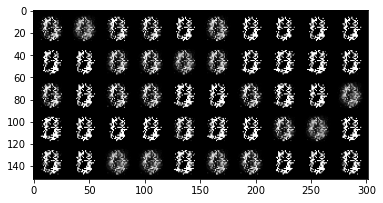

Iter: 21210/100000, Gen loss: 5.0777, Dis loss: 0.0387
Iter: 21220/100000, Gen loss: 5.4490, Dis loss: 0.0947
Iter: 21230/100000, Gen loss: 5.1296, Dis loss: 0.0483
Iter: 21240/100000, Gen loss: 4.7617, Dis loss: 0.0309
Iter: 21250/100000, Gen loss: 4.7112, Dis loss: 0.0417
Iter: 21260/100000, Gen loss: 5.3686, Dis loss: 0.0476
Iter: 21270/100000, Gen loss: 4.7760, Dis loss: 0.0385
Iter: 21280/100000, Gen loss: 4.9060, Dis loss: 0.0579
Iter: 21290/100000, Gen loss: 4.8615, Dis loss: 0.1497
Iter: 21300/100000, Gen loss: 6.6151, Dis loss: 0.3691
Iter: 21310/100000, Gen loss: 5.3104, Dis loss: 0.0249
Iter: 21320/100000, Gen loss: 3.8505, Dis loss: 0.1469
Iter: 21330/100000, Gen loss: 5.1192, Dis loss: 0.0984
Iter: 21340/100000, Gen loss: 5.1649, Dis loss: 0.0408
Iter: 21350/100000, Gen loss: 5.1656, Dis loss: 0.0778
Iter: 21360/100000, Gen loss: 4.4208, Dis loss: 0.0752
Iter: 21370/100000, Gen loss: 4.5981, Dis loss: 0.0582
Iter: 21380/100000, Gen loss: 3.8970, Dis loss: 0.1342
Iter: 2139

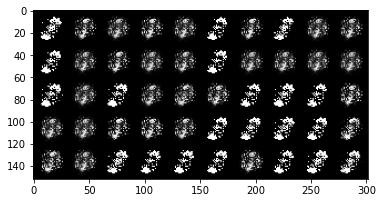

Iter: 21410/100000, Gen loss: 4.7602, Dis loss: 0.1041
Iter: 21420/100000, Gen loss: 3.6645, Dis loss: 0.2346
Iter: 21430/100000, Gen loss: 5.0362, Dis loss: 0.0308
Iter: 21440/100000, Gen loss: 3.7028, Dis loss: 0.1104
Iter: 21450/100000, Gen loss: 4.1947, Dis loss: 0.0511
Iter: 21460/100000, Gen loss: 4.1290, Dis loss: 0.0580
Iter: 21470/100000, Gen loss: 3.6176, Dis loss: 0.1346
Iter: 21480/100000, Gen loss: 3.9623, Dis loss: 0.0617
Iter: 21490/100000, Gen loss: 4.2975, Dis loss: 0.0844
Iter: 21500/100000, Gen loss: 4.1466, Dis loss: 0.0677
Iter: 21510/100000, Gen loss: 4.1682, Dis loss: 0.0672
Iter: 21520/100000, Gen loss: 4.0974, Dis loss: 0.0502
Iter: 21530/100000, Gen loss: 4.4565, Dis loss: 0.0523
Iter: 21540/100000, Gen loss: 4.0596, Dis loss: 0.0731
Iter: 21550/100000, Gen loss: 4.5202, Dis loss: 0.1517
Iter: 21560/100000, Gen loss: 4.0117, Dis loss: 0.2000
Iter: 21570/100000, Gen loss: 4.4707, Dis loss: 0.0717
Iter: 21580/100000, Gen loss: 4.2187, Dis loss: 0.0876
Iter: 2159

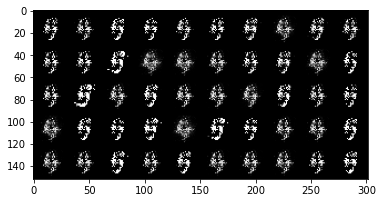

Iter: 21610/100000, Gen loss: 3.8330, Dis loss: 0.1182
Iter: 21620/100000, Gen loss: 4.5522, Dis loss: 0.0662
Iter: 21630/100000, Gen loss: 4.9207, Dis loss: 0.0369
Iter: 21640/100000, Gen loss: 4.7229, Dis loss: 0.0252
Iter: 21650/100000, Gen loss: 5.2427, Dis loss: 0.0375
Iter: 21660/100000, Gen loss: 5.3667, Dis loss: 0.0436
Iter: 21670/100000, Gen loss: 4.8724, Dis loss: 0.1433
Iter: 21680/100000, Gen loss: 5.3035, Dis loss: 0.0195
Iter: 21690/100000, Gen loss: 4.4220, Dis loss: 0.2967
Iter: 21700/100000, Gen loss: 4.5939, Dis loss: 0.0798
Iter: 21710/100000, Gen loss: 5.0740, Dis loss: 0.0345
Iter: 21720/100000, Gen loss: 4.9098, Dis loss: 0.0482
Iter: 21730/100000, Gen loss: 4.8288, Dis loss: 0.0762
Iter: 21740/100000, Gen loss: 4.7322, Dis loss: 0.1686
Iter: 21750/100000, Gen loss: 5.1743, Dis loss: 0.0417
Iter: 21760/100000, Gen loss: 5.4410, Dis loss: 0.0352
Iter: 21770/100000, Gen loss: 6.6217, Dis loss: 0.0174
Iter: 21780/100000, Gen loss: 5.2032, Dis loss: 0.0723
Iter: 2179

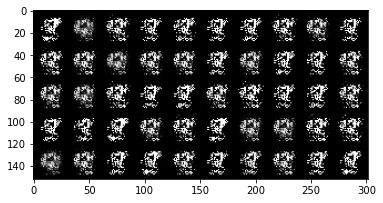

Iter: 21810/100000, Gen loss: 5.6181, Dis loss: 0.0852
Iter: 21820/100000, Gen loss: 6.0221, Dis loss: 0.1359
Iter: 21830/100000, Gen loss: 5.3898, Dis loss: 0.0453
Iter: 21840/100000, Gen loss: 4.9275, Dis loss: 0.0811
Iter: 21850/100000, Gen loss: 5.3893, Dis loss: 0.0423
Iter: 21860/100000, Gen loss: 4.1037, Dis loss: 0.1602
Iter: 21870/100000, Gen loss: 4.4760, Dis loss: 0.1228
Iter: 21880/100000, Gen loss: 4.3586, Dis loss: 0.0962
Iter: 21890/100000, Gen loss: 4.1721, Dis loss: 0.2066
Iter: 21900/100000, Gen loss: 4.2830, Dis loss: 0.1758
Iter: 21910/100000, Gen loss: 4.3670, Dis loss: 0.0873
Iter: 21920/100000, Gen loss: 4.5049, Dis loss: 0.0451
Iter: 21930/100000, Gen loss: 3.3290, Dis loss: 0.1218
Iter: 21940/100000, Gen loss: 4.1054, Dis loss: 0.0770
Iter: 21950/100000, Gen loss: 4.4880, Dis loss: 0.0921
Iter: 21960/100000, Gen loss: 3.2774, Dis loss: 0.1226
Iter: 21970/100000, Gen loss: 4.0521, Dis loss: 0.1355
Iter: 21980/100000, Gen loss: 3.7806, Dis loss: 0.0964
Iter: 2199

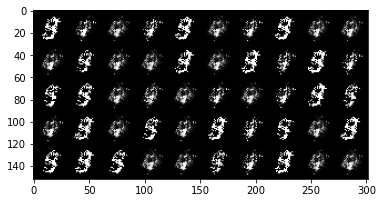

Iter: 22010/100000, Gen loss: 3.5762, Dis loss: 0.0947
Iter: 22020/100000, Gen loss: 3.9060, Dis loss: 0.0961
Iter: 22030/100000, Gen loss: 4.3122, Dis loss: 0.0869
Iter: 22040/100000, Gen loss: 3.4501, Dis loss: 0.1738
Iter: 22050/100000, Gen loss: 3.5576, Dis loss: 0.0677
Iter: 22060/100000, Gen loss: 3.8733, Dis loss: 0.1060
Iter: 22070/100000, Gen loss: 4.0520, Dis loss: 0.0771
Iter: 22080/100000, Gen loss: 3.6092, Dis loss: 0.0778
Iter: 22090/100000, Gen loss: 3.7977, Dis loss: 0.0661
Iter: 22100/100000, Gen loss: 3.8532, Dis loss: 0.1059
Iter: 22110/100000, Gen loss: 3.9876, Dis loss: 0.0861
Iter: 22120/100000, Gen loss: 3.8145, Dis loss: 0.1094
Iter: 22130/100000, Gen loss: 4.0732, Dis loss: 0.1379
Iter: 22140/100000, Gen loss: 4.2855, Dis loss: 0.1284
Iter: 22150/100000, Gen loss: 3.9338, Dis loss: 0.2055
Iter: 22160/100000, Gen loss: 4.1783, Dis loss: 0.0687
Iter: 22170/100000, Gen loss: 4.7661, Dis loss: 0.1551
Iter: 22180/100000, Gen loss: 4.1044, Dis loss: 0.0751
Iter: 2219

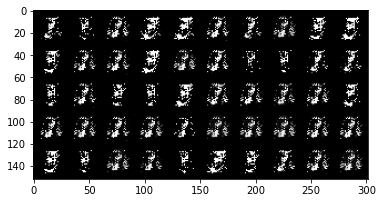

Iter: 22210/100000, Gen loss: 4.9805, Dis loss: 0.0701
Iter: 22220/100000, Gen loss: 5.0219, Dis loss: 0.0481
Iter: 22230/100000, Gen loss: 4.8568, Dis loss: 0.0403
Iter: 22240/100000, Gen loss: 4.7179, Dis loss: 0.0343
Iter: 22250/100000, Gen loss: 5.2625, Dis loss: 0.0386
Iter: 22260/100000, Gen loss: 4.5480, Dis loss: 0.0565
Iter: 22270/100000, Gen loss: 4.3964, Dis loss: 0.0861
Iter: 22280/100000, Gen loss: 5.0529, Dis loss: 0.0627
Iter: 22290/100000, Gen loss: 5.0336, Dis loss: 0.0841
Iter: 22300/100000, Gen loss: 5.4638, Dis loss: 0.0265
Iter: 22310/100000, Gen loss: 5.4028, Dis loss: 0.0702
Iter: 22320/100000, Gen loss: 5.5091, Dis loss: 0.0927
Iter: 22330/100000, Gen loss: 5.1705, Dis loss: 0.0573
Iter: 22340/100000, Gen loss: 5.2034, Dis loss: 0.0135
Iter: 22350/100000, Gen loss: 4.8571, Dis loss: 0.0244
Iter: 22360/100000, Gen loss: 4.5294, Dis loss: 0.1400
Iter: 22370/100000, Gen loss: 5.6456, Dis loss: 0.1058
Iter: 22380/100000, Gen loss: 5.0914, Dis loss: 0.1597
Iter: 2239

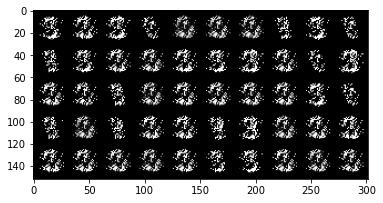

Iter: 22410/100000, Gen loss: 4.3403, Dis loss: 0.0279
Iter: 22420/100000, Gen loss: 5.0557, Dis loss: 0.0279
Iter: 22430/100000, Gen loss: 5.0960, Dis loss: 0.0178
Iter: 22440/100000, Gen loss: 5.6419, Dis loss: 0.0498
Iter: 22450/100000, Gen loss: 5.5077, Dis loss: 0.0405
Iter: 22460/100000, Gen loss: 5.2428, Dis loss: 0.1648
Iter: 22470/100000, Gen loss: 5.1033, Dis loss: 0.1599
Iter: 22480/100000, Gen loss: 3.5240, Dis loss: 0.1296
Iter: 22490/100000, Gen loss: 5.3442, Dis loss: 0.0332
Iter: 22500/100000, Gen loss: 4.4400, Dis loss: 0.1799
Iter: 22510/100000, Gen loss: 4.2486, Dis loss: 0.0711
Iter: 22520/100000, Gen loss: 3.9389, Dis loss: 0.0952
Iter: 22530/100000, Gen loss: 5.2534, Dis loss: 0.0491
Iter: 22540/100000, Gen loss: 4.6624, Dis loss: 0.0410
Iter: 22550/100000, Gen loss: 3.9432, Dis loss: 0.0483
Iter: 22560/100000, Gen loss: 3.8188, Dis loss: 0.1744
Iter: 22570/100000, Gen loss: 4.3502, Dis loss: 0.0537
Iter: 22580/100000, Gen loss: 4.1906, Dis loss: 0.0515
Iter: 2259

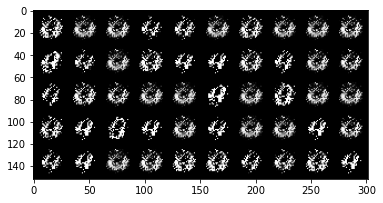

Iter: 22610/100000, Gen loss: 4.3397, Dis loss: 0.2565
Iter: 22620/100000, Gen loss: 4.4853, Dis loss: 0.2710
Iter: 22630/100000, Gen loss: 4.2296, Dis loss: 0.0534
Iter: 22640/100000, Gen loss: 5.4047, Dis loss: 0.0158
Iter: 22650/100000, Gen loss: 4.3006, Dis loss: 0.0732
Iter: 22660/100000, Gen loss: 4.4793, Dis loss: 0.0956
Iter: 22670/100000, Gen loss: 4.6320, Dis loss: 0.0457
Iter: 22680/100000, Gen loss: 5.1571, Dis loss: 0.0356
Iter: 22690/100000, Gen loss: 3.2544, Dis loss: 0.1880
Iter: 22700/100000, Gen loss: 4.6801, Dis loss: 0.0784
Iter: 22710/100000, Gen loss: 5.6953, Dis loss: 0.0611
Iter: 22720/100000, Gen loss: 4.1015, Dis loss: 0.0969
Iter: 22730/100000, Gen loss: 4.5447, Dis loss: 0.0674
Iter: 22740/100000, Gen loss: 4.4425, Dis loss: 0.0477
Iter: 22750/100000, Gen loss: 3.9892, Dis loss: 0.1230
Iter: 22760/100000, Gen loss: 5.3573, Dis loss: 0.0501
Iter: 22770/100000, Gen loss: 4.7615, Dis loss: 0.0354
Iter: 22780/100000, Gen loss: 4.6953, Dis loss: 0.0805
Iter: 2279

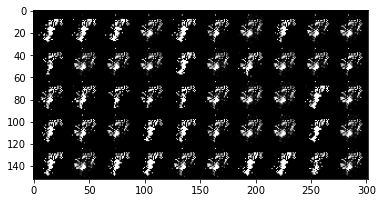

Iter: 22810/100000, Gen loss: 4.4687, Dis loss: 0.0670
Iter: 22820/100000, Gen loss: 4.9173, Dis loss: 0.0428
Iter: 22830/100000, Gen loss: 5.3363, Dis loss: 0.0193
Iter: 22840/100000, Gen loss: 4.9135, Dis loss: 0.1217
Iter: 22850/100000, Gen loss: 5.5118, Dis loss: 0.0301
Iter: 22860/100000, Gen loss: 5.3847, Dis loss: 0.0107
Iter: 22870/100000, Gen loss: 5.2001, Dis loss: 0.0304
Iter: 22880/100000, Gen loss: 5.3918, Dis loss: 0.0391
Iter: 22890/100000, Gen loss: 6.6394, Dis loss: 0.0080
Iter: 22900/100000, Gen loss: 5.2517, Dis loss: 0.0153
Iter: 22910/100000, Gen loss: 5.7061, Dis loss: 0.0517
Iter: 22920/100000, Gen loss: 6.1790, Dis loss: 0.0113
Iter: 22930/100000, Gen loss: 5.7570, Dis loss: 0.0236
Iter: 22940/100000, Gen loss: 6.2187, Dis loss: 0.0343
Iter: 22950/100000, Gen loss: 6.0236, Dis loss: 0.0347
Iter: 22960/100000, Gen loss: 6.3402, Dis loss: 0.1182
Iter: 22970/100000, Gen loss: 6.0424, Dis loss: 0.0116
Iter: 22980/100000, Gen loss: 5.4355, Dis loss: 0.1353
Iter: 2299

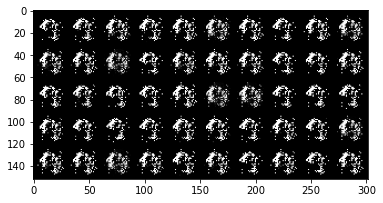

Iter: 23010/100000, Gen loss: 5.1726, Dis loss: 0.0190
Iter: 23020/100000, Gen loss: 4.9635, Dis loss: 0.2014
Iter: 23030/100000, Gen loss: 5.6551, Dis loss: 0.0872
Iter: 23040/100000, Gen loss: 6.2680, Dis loss: 0.0055
Iter: 23050/100000, Gen loss: 4.7997, Dis loss: 0.0303
Iter: 23060/100000, Gen loss: 8.5234, Dis loss: 0.0166
Iter: 23070/100000, Gen loss: 5.4108, Dis loss: 0.0749
Iter: 23080/100000, Gen loss: 6.4900, Dis loss: 0.0023
Iter: 23090/100000, Gen loss: 5.5840, Dis loss: 0.0155
Iter: 23100/100000, Gen loss: 7.4079, Dis loss: 0.0152
Iter: 23110/100000, Gen loss: 4.3555, Dis loss: 0.1002
Iter: 23120/100000, Gen loss: 6.6812, Dis loss: 0.0089
Iter: 23130/100000, Gen loss: 5.5164, Dis loss: 0.0204
Iter: 23140/100000, Gen loss: 6.1098, Dis loss: 0.0601
Iter: 23150/100000, Gen loss: 5.5942, Dis loss: 0.1382
Iter: 23160/100000, Gen loss: 5.9769, Dis loss: 0.1751
Iter: 23170/100000, Gen loss: 5.7494, Dis loss: 0.0226
Iter: 23180/100000, Gen loss: 6.3883, Dis loss: 0.0122
Iter: 2319

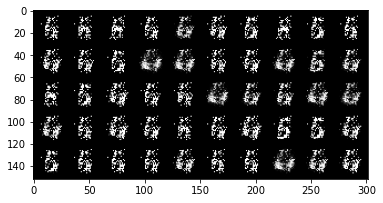

Iter: 23210/100000, Gen loss: 5.3564, Dis loss: 0.1457
Iter: 23220/100000, Gen loss: 6.2476, Dis loss: 0.1790
Iter: 23230/100000, Gen loss: 5.1880, Dis loss: 0.1333
Iter: 23240/100000, Gen loss: 4.0832, Dis loss: 0.0769
Iter: 23250/100000, Gen loss: 3.7638, Dis loss: 0.2092
Iter: 23260/100000, Gen loss: 4.8881, Dis loss: 0.0659
Iter: 23270/100000, Gen loss: 4.5460, Dis loss: 0.1091
Iter: 23280/100000, Gen loss: 4.0749, Dis loss: 0.1183
Iter: 23290/100000, Gen loss: 3.7640, Dis loss: 0.0541
Iter: 23300/100000, Gen loss: 4.3600, Dis loss: 0.0381
Iter: 23310/100000, Gen loss: 3.8821, Dis loss: 0.2062
Iter: 23320/100000, Gen loss: 4.2923, Dis loss: 0.0555
Iter: 23330/100000, Gen loss: 4.4003, Dis loss: 0.1346
Iter: 23340/100000, Gen loss: 4.3130, Dis loss: 0.1043
Iter: 23350/100000, Gen loss: 4.4895, Dis loss: 0.0991
Iter: 23360/100000, Gen loss: 3.6341, Dis loss: 0.1252
Iter: 23370/100000, Gen loss: 5.0367, Dis loss: 0.0484
Iter: 23380/100000, Gen loss: 4.9555, Dis loss: 0.0513
Iter: 2339

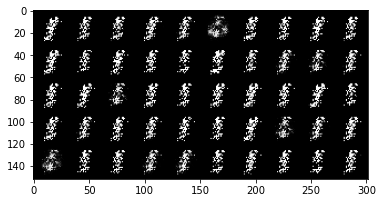

Iter: 23410/100000, Gen loss: 4.5771, Dis loss: 0.0663
Iter: 23420/100000, Gen loss: 5.3154, Dis loss: 0.0469
Iter: 23430/100000, Gen loss: 4.8616, Dis loss: 0.0369
Iter: 23440/100000, Gen loss: 4.9132, Dis loss: 0.0597
Iter: 23450/100000, Gen loss: 4.9363, Dis loss: 0.0197
Iter: 23460/100000, Gen loss: 4.4525, Dis loss: 0.0261
Iter: 23470/100000, Gen loss: 5.0282, Dis loss: 0.1643
Iter: 23480/100000, Gen loss: 5.1366, Dis loss: 0.0541
Iter: 23490/100000, Gen loss: 4.6524, Dis loss: 0.0246
Iter: 23500/100000, Gen loss: 6.2786, Dis loss: 0.0987
Iter: 23510/100000, Gen loss: 7.4839, Dis loss: 0.2650
Iter: 23520/100000, Gen loss: 6.3895, Dis loss: 0.1046
Iter: 23530/100000, Gen loss: 6.2146, Dis loss: 0.1052
Iter: 23540/100000, Gen loss: 6.1999, Dis loss: 0.0448
Iter: 23550/100000, Gen loss: 5.3344, Dis loss: 0.1298
Iter: 23560/100000, Gen loss: 4.1797, Dis loss: 0.0406
Iter: 23570/100000, Gen loss: 5.3034, Dis loss: 0.0250
Iter: 23580/100000, Gen loss: 3.7269, Dis loss: 0.0916
Iter: 2359

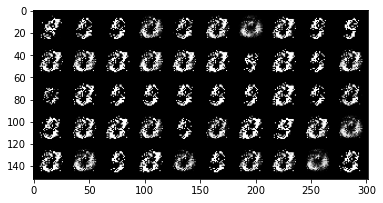

Iter: 23610/100000, Gen loss: 4.4730, Dis loss: 0.2434
Iter: 23620/100000, Gen loss: 4.6660, Dis loss: 0.1684
Iter: 23630/100000, Gen loss: 4.8172, Dis loss: 0.0458
Iter: 23640/100000, Gen loss: 4.4053, Dis loss: 0.0448
Iter: 23650/100000, Gen loss: 3.7722, Dis loss: 0.2153
Iter: 23660/100000, Gen loss: 5.1419, Dis loss: 0.0382
Iter: 23670/100000, Gen loss: 4.6598, Dis loss: 0.0447
Iter: 23680/100000, Gen loss: 4.6273, Dis loss: 0.0283
Iter: 23690/100000, Gen loss: 3.8355, Dis loss: 0.0751
Iter: 23700/100000, Gen loss: 4.2973, Dis loss: 0.1658
Iter: 23710/100000, Gen loss: 5.6561, Dis loss: 0.0334
Iter: 23720/100000, Gen loss: 4.9739, Dis loss: 0.0288
Iter: 23730/100000, Gen loss: 5.0357, Dis loss: 0.0847
Iter: 23740/100000, Gen loss: 4.1878, Dis loss: 0.1429
Iter: 23750/100000, Gen loss: 5.6572, Dis loss: 0.0543
Iter: 23760/100000, Gen loss: 4.9732, Dis loss: 0.0392
Iter: 23770/100000, Gen loss: 5.0658, Dis loss: 0.0565
Iter: 23780/100000, Gen loss: 5.4407, Dis loss: 0.0126
Iter: 2379

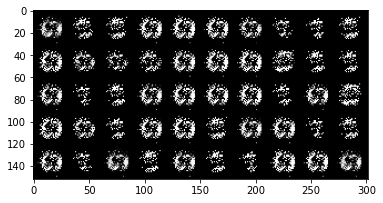

Iter: 23810/100000, Gen loss: 5.1397, Dis loss: 0.0521
Iter: 23820/100000, Gen loss: 4.6018, Dis loss: 0.0152
Iter: 23830/100000, Gen loss: 5.2614, Dis loss: 0.0183
Iter: 23840/100000, Gen loss: 5.2870, Dis loss: 0.0255
Iter: 23850/100000, Gen loss: 4.7167, Dis loss: 0.0464
Iter: 23860/100000, Gen loss: 4.5464, Dis loss: 0.0352
Iter: 23870/100000, Gen loss: 5.4315, Dis loss: 0.0664
Iter: 23880/100000, Gen loss: 4.5217, Dis loss: 0.0376
Iter: 23890/100000, Gen loss: 4.2019, Dis loss: 0.0543
Iter: 23900/100000, Gen loss: 5.9491, Dis loss: 0.0188
Iter: 23910/100000, Gen loss: 5.5191, Dis loss: 0.1180
Iter: 23920/100000, Gen loss: 5.6053, Dis loss: 0.1280
Iter: 23930/100000, Gen loss: 4.9474, Dis loss: 0.0490
Iter: 23940/100000, Gen loss: 5.3418, Dis loss: 0.0512
Iter: 23950/100000, Gen loss: 5.5179, Dis loss: 0.0152
Iter: 23960/100000, Gen loss: 6.0392, Dis loss: 0.0350
Iter: 23970/100000, Gen loss: 4.3987, Dis loss: 0.0893
Iter: 23980/100000, Gen loss: 5.7784, Dis loss: 0.0330
Iter: 2399

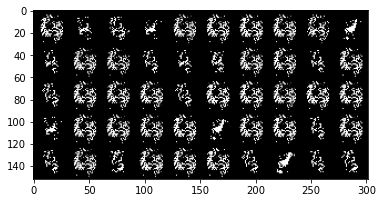

Iter: 24010/100000, Gen loss: 5.7027, Dis loss: 0.0695
Iter: 24020/100000, Gen loss: 6.5192, Dis loss: 0.0101
Iter: 24030/100000, Gen loss: 5.9209, Dis loss: 0.0292
Iter: 24040/100000, Gen loss: 5.2260, Dis loss: 0.0253
Iter: 24050/100000, Gen loss: 6.1482, Dis loss: 0.0159
Iter: 24060/100000, Gen loss: 5.3582, Dis loss: 0.0288
Iter: 24070/100000, Gen loss: 6.2173, Dis loss: 0.0581
Iter: 24080/100000, Gen loss: 5.3423, Dis loss: 0.0779
Iter: 24090/100000, Gen loss: 5.7804, Dis loss: 0.0377
Iter: 24100/100000, Gen loss: 4.9806, Dis loss: 0.0190
Iter: 24110/100000, Gen loss: 5.4641, Dis loss: 0.0956
Iter: 24120/100000, Gen loss: 6.1608, Dis loss: 0.0117
Iter: 24130/100000, Gen loss: 5.5368, Dis loss: 0.0143
Iter: 24140/100000, Gen loss: 6.1088, Dis loss: 0.1104
Iter: 24150/100000, Gen loss: 5.3384, Dis loss: 0.0241
Iter: 24160/100000, Gen loss: 5.1855, Dis loss: 0.1654
Iter: 24170/100000, Gen loss: 5.5112, Dis loss: 0.0452
Iter: 24180/100000, Gen loss: 5.9822, Dis loss: 0.0338
Iter: 2419

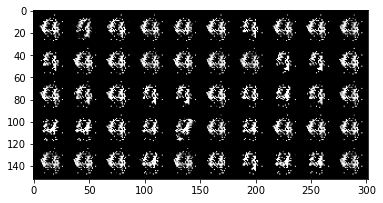

Iter: 24210/100000, Gen loss: 5.2632, Dis loss: 0.0442
Iter: 24220/100000, Gen loss: 5.4448, Dis loss: 0.0236
Iter: 24230/100000, Gen loss: 5.2553, Dis loss: 0.0329
Iter: 24240/100000, Gen loss: 5.5473, Dis loss: 0.0080
Iter: 24250/100000, Gen loss: 5.7820, Dis loss: 0.1271
Iter: 24260/100000, Gen loss: 4.1047, Dis loss: 0.0460
Iter: 24270/100000, Gen loss: 6.1060, Dis loss: 0.0869
Iter: 24280/100000, Gen loss: 4.5266, Dis loss: 0.0490
Iter: 24290/100000, Gen loss: 5.6620, Dis loss: 0.0135
Iter: 24300/100000, Gen loss: 5.4805, Dis loss: 0.0214
Iter: 24310/100000, Gen loss: 4.8535, Dis loss: 0.0559
Iter: 24320/100000, Gen loss: 5.3592, Dis loss: 0.0084
Iter: 24330/100000, Gen loss: 5.3779, Dis loss: 0.1142
Iter: 24340/100000, Gen loss: 4.9162, Dis loss: 0.0894
Iter: 24350/100000, Gen loss: 5.4836, Dis loss: 0.0506
Iter: 24360/100000, Gen loss: 3.9889, Dis loss: 0.0411
Iter: 24370/100000, Gen loss: 5.6055, Dis loss: 0.0282
Iter: 24380/100000, Gen loss: 4.4580, Dis loss: 0.0960
Iter: 2439

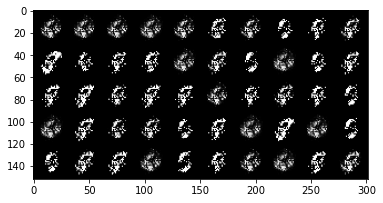

Iter: 24410/100000, Gen loss: 4.4355, Dis loss: 0.0648
Iter: 24420/100000, Gen loss: 5.6464, Dis loss: 0.0429
Iter: 24430/100000, Gen loss: 4.1801, Dis loss: 0.0220
Iter: 24440/100000, Gen loss: 4.7204, Dis loss: 0.0309
Iter: 24450/100000, Gen loss: 5.7525, Dis loss: 0.0498
Iter: 24460/100000, Gen loss: 4.7278, Dis loss: 0.0370
Iter: 24470/100000, Gen loss: 4.1746, Dis loss: 0.0456
Iter: 24480/100000, Gen loss: 4.2112, Dis loss: 0.0865
Iter: 24490/100000, Gen loss: 4.4918, Dis loss: 0.1001
Iter: 24500/100000, Gen loss: 4.4097, Dis loss: 0.0710
Iter: 24510/100000, Gen loss: 4.3261, Dis loss: 0.0507
Iter: 24520/100000, Gen loss: 4.2815, Dis loss: 0.1722
Iter: 24530/100000, Gen loss: 4.0162, Dis loss: 0.0657
Iter: 24540/100000, Gen loss: 5.0190, Dis loss: 0.0715
Iter: 24550/100000, Gen loss: 4.3767, Dis loss: 0.2966
Iter: 24560/100000, Gen loss: 4.1507, Dis loss: 0.0820
Iter: 24570/100000, Gen loss: 4.7509, Dis loss: 0.0783
Iter: 24580/100000, Gen loss: 4.0670, Dis loss: 0.1028
Iter: 2459

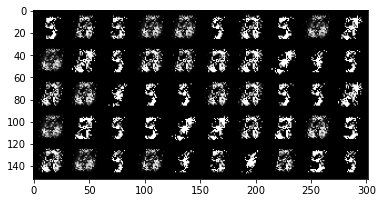

Iter: 24610/100000, Gen loss: 4.4178, Dis loss: 0.0993
Iter: 24620/100000, Gen loss: 5.8659, Dis loss: 0.1589
Iter: 24630/100000, Gen loss: 4.2441, Dis loss: 0.0361
Iter: 24640/100000, Gen loss: 4.9749, Dis loss: 0.0532
Iter: 24650/100000, Gen loss: 4.8365, Dis loss: 0.0332
Iter: 24660/100000, Gen loss: 5.4893, Dis loss: 0.0885
Iter: 24670/100000, Gen loss: 4.8088, Dis loss: 0.0535
Iter: 24680/100000, Gen loss: 3.2229, Dis loss: 0.1347
Iter: 24690/100000, Gen loss: 5.1924, Dis loss: 0.1394
Iter: 24700/100000, Gen loss: 4.2589, Dis loss: 0.0718
Iter: 24710/100000, Gen loss: 4.1154, Dis loss: 0.0524
Iter: 24720/100000, Gen loss: 4.0426, Dis loss: 0.0504
Iter: 24730/100000, Gen loss: 4.0319, Dis loss: 0.0638
Iter: 24740/100000, Gen loss: 4.2158, Dis loss: 0.0716
Iter: 24750/100000, Gen loss: 5.7400, Dis loss: 0.0345
Iter: 24760/100000, Gen loss: 4.6546, Dis loss: 0.0454
Iter: 24770/100000, Gen loss: 5.1209, Dis loss: 0.0247
Iter: 24780/100000, Gen loss: 4.5443, Dis loss: 0.1273
Iter: 2479

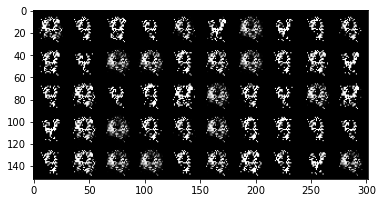

Iter: 24810/100000, Gen loss: 4.7313, Dis loss: 0.0393
Iter: 24820/100000, Gen loss: 5.1663, Dis loss: 0.0518
Iter: 24830/100000, Gen loss: 5.6553, Dis loss: 0.0212
Iter: 24840/100000, Gen loss: 4.9967, Dis loss: 0.0253
Iter: 24850/100000, Gen loss: 5.7402, Dis loss: 0.0360
Iter: 24860/100000, Gen loss: 5.5043, Dis loss: 0.0461
Iter: 24870/100000, Gen loss: 5.3828, Dis loss: 0.0179
Iter: 24880/100000, Gen loss: 5.6972, Dis loss: 0.0160
Iter: 24890/100000, Gen loss: 4.4107, Dis loss: 0.1102
Iter: 24900/100000, Gen loss: 5.5887, Dis loss: 0.0330
Iter: 24910/100000, Gen loss: 5.0224, Dis loss: 0.0348
Iter: 24920/100000, Gen loss: 5.7900, Dis loss: 0.0706
Iter: 24930/100000, Gen loss: 4.3067, Dis loss: 0.1449
Iter: 24940/100000, Gen loss: 4.9372, Dis loss: 0.1018
Iter: 24950/100000, Gen loss: 4.6548, Dis loss: 0.0556
Iter: 24960/100000, Gen loss: 4.3111, Dis loss: 0.0382
Iter: 24970/100000, Gen loss: 4.7713, Dis loss: 0.0349
Iter: 24980/100000, Gen loss: 4.3024, Dis loss: 0.0669
Iter: 2499

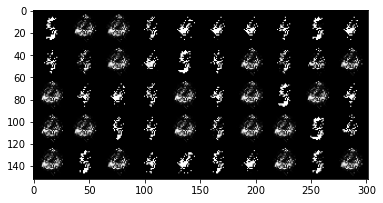

Iter: 25010/100000, Gen loss: 4.3216, Dis loss: 0.0351
Iter: 25020/100000, Gen loss: 4.1841, Dis loss: 0.0430
Iter: 25030/100000, Gen loss: 4.4310, Dis loss: 0.0502
Iter: 25040/100000, Gen loss: 3.4966, Dis loss: 0.1976
Iter: 25050/100000, Gen loss: 3.5638, Dis loss: 0.0858
Iter: 25060/100000, Gen loss: 4.2864, Dis loss: 0.1522
Iter: 25070/100000, Gen loss: 4.0428, Dis loss: 0.0660
Iter: 25080/100000, Gen loss: 4.5474, Dis loss: 0.1587
Iter: 25090/100000, Gen loss: 4.2385, Dis loss: 0.1408
Iter: 25100/100000, Gen loss: 4.2697, Dis loss: 0.0817
Iter: 25110/100000, Gen loss: 3.6418, Dis loss: 0.1098
Iter: 25120/100000, Gen loss: 4.1314, Dis loss: 0.0463
Iter: 25130/100000, Gen loss: 3.9007, Dis loss: 0.0541
Iter: 25140/100000, Gen loss: 4.4270, Dis loss: 0.0843
Iter: 25150/100000, Gen loss: 4.5083, Dis loss: 0.0685
Iter: 25160/100000, Gen loss: 3.0703, Dis loss: 0.0889
Iter: 25170/100000, Gen loss: 4.6170, Dis loss: 0.0762
Iter: 25180/100000, Gen loss: 4.3157, Dis loss: 0.0892
Iter: 2519

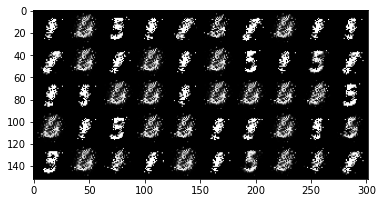

Iter: 25210/100000, Gen loss: 4.1001, Dis loss: 0.1012
Iter: 25220/100000, Gen loss: 4.3193, Dis loss: 0.0466
Iter: 25230/100000, Gen loss: 4.6980, Dis loss: 0.0498
Iter: 25240/100000, Gen loss: 4.6444, Dis loss: 0.1334
Iter: 25250/100000, Gen loss: 4.1075, Dis loss: 0.0578
Iter: 25260/100000, Gen loss: 5.3059, Dis loss: 0.0409
Iter: 25270/100000, Gen loss: 4.9637, Dis loss: 0.0829
Iter: 25280/100000, Gen loss: 4.6266, Dis loss: 0.0280
Iter: 25290/100000, Gen loss: 5.7134, Dis loss: 0.0121
Iter: 25300/100000, Gen loss: 4.9849, Dis loss: 0.1556
Iter: 25310/100000, Gen loss: 4.9477, Dis loss: 0.0269
Iter: 25320/100000, Gen loss: 4.9725, Dis loss: 0.0952
Iter: 25330/100000, Gen loss: 5.0848, Dis loss: 0.0418
Iter: 25340/100000, Gen loss: 5.0513, Dis loss: 0.0232
Iter: 25350/100000, Gen loss: 4.4143, Dis loss: 0.0761
Iter: 25360/100000, Gen loss: 5.1970, Dis loss: 0.0188
Iter: 25370/100000, Gen loss: 4.7152, Dis loss: 0.0264
Iter: 25380/100000, Gen loss: 4.5724, Dis loss: 0.0366
Iter: 2539

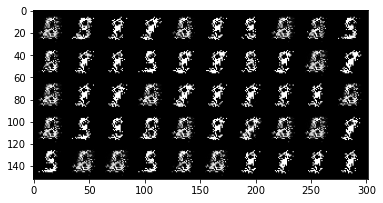

Iter: 25410/100000, Gen loss: 5.6785, Dis loss: 0.0092
Iter: 25420/100000, Gen loss: 5.1011, Dis loss: 0.0160
Iter: 25430/100000, Gen loss: 5.3738, Dis loss: 0.0303
Iter: 25440/100000, Gen loss: 4.6418, Dis loss: 0.0466
Iter: 25450/100000, Gen loss: 4.5471, Dis loss: 0.0848
Iter: 25460/100000, Gen loss: 5.0384, Dis loss: 0.0494
Iter: 25470/100000, Gen loss: 4.5460, Dis loss: 0.0889
Iter: 25480/100000, Gen loss: 4.5415, Dis loss: 0.0252
Iter: 25490/100000, Gen loss: 4.4230, Dis loss: 0.0452
Iter: 25500/100000, Gen loss: 4.8803, Dis loss: 0.0658
Iter: 25510/100000, Gen loss: 4.3883, Dis loss: 0.0595
Iter: 25520/100000, Gen loss: 4.0226, Dis loss: 0.0399
Iter: 25530/100000, Gen loss: 4.5659, Dis loss: 0.0651
Iter: 25540/100000, Gen loss: 3.7141, Dis loss: 0.0652
Iter: 25550/100000, Gen loss: 4.6475, Dis loss: 0.1496
Iter: 25560/100000, Gen loss: 4.7695, Dis loss: 0.0404
Iter: 25570/100000, Gen loss: 3.6365, Dis loss: 0.0428
Iter: 25580/100000, Gen loss: 4.7207, Dis loss: 0.1090
Iter: 2559

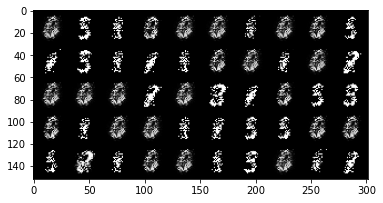

Iter: 25610/100000, Gen loss: 4.4804, Dis loss: 0.1145
Iter: 25620/100000, Gen loss: 3.8424, Dis loss: 0.2187
Iter: 25630/100000, Gen loss: 4.4978, Dis loss: 0.1005
Iter: 25640/100000, Gen loss: 4.0926, Dis loss: 0.1093
Iter: 25650/100000, Gen loss: 4.9551, Dis loss: 0.0375
Iter: 25660/100000, Gen loss: 4.1561, Dis loss: 0.1053
Iter: 25670/100000, Gen loss: 4.7251, Dis loss: 0.0947
Iter: 25680/100000, Gen loss: 4.5438, Dis loss: 0.0472
Iter: 25690/100000, Gen loss: 4.3948, Dis loss: 0.0925
Iter: 25700/100000, Gen loss: 4.5229, Dis loss: 0.0808
Iter: 25710/100000, Gen loss: 4.1294, Dis loss: 0.1025
Iter: 25720/100000, Gen loss: 3.8303, Dis loss: 0.0984
Iter: 25730/100000, Gen loss: 4.2138, Dis loss: 0.0722
Iter: 25740/100000, Gen loss: 4.0454, Dis loss: 0.0460
Iter: 25750/100000, Gen loss: 5.0833, Dis loss: 0.0278
Iter: 25760/100000, Gen loss: 3.9268, Dis loss: 0.0836
Iter: 25770/100000, Gen loss: 4.6628, Dis loss: 0.0333
Iter: 25780/100000, Gen loss: 4.1549, Dis loss: 0.0656
Iter: 2579

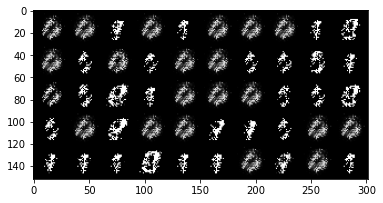

Iter: 25810/100000, Gen loss: 4.0776, Dis loss: 0.0721
Iter: 25820/100000, Gen loss: 5.6568, Dis loss: 0.0536
Iter: 25830/100000, Gen loss: 4.6567, Dis loss: 0.0362
Iter: 25840/100000, Gen loss: 4.2462, Dis loss: 0.0358
Iter: 25850/100000, Gen loss: 4.7232, Dis loss: 0.0327
Iter: 25860/100000, Gen loss: 4.2033, Dis loss: 0.0873
Iter: 25870/100000, Gen loss: 4.5810, Dis loss: 0.0458
Iter: 25880/100000, Gen loss: 3.5199, Dis loss: 0.0813
Iter: 25890/100000, Gen loss: 4.1487, Dis loss: 0.1109
Iter: 25900/100000, Gen loss: 4.6477, Dis loss: 0.1651
Iter: 25910/100000, Gen loss: 4.1836, Dis loss: 0.1744
Iter: 25920/100000, Gen loss: 5.0278, Dis loss: 0.0429
Iter: 25930/100000, Gen loss: 3.9471, Dis loss: 0.1045
Iter: 25940/100000, Gen loss: 4.0656, Dis loss: 0.1068
Iter: 25950/100000, Gen loss: 5.6280, Dis loss: 0.0450
Iter: 25960/100000, Gen loss: 4.4980, Dis loss: 0.0593
Iter: 25970/100000, Gen loss: 4.8389, Dis loss: 0.0853
Iter: 25980/100000, Gen loss: 5.0219, Dis loss: 0.0733
Iter: 2599

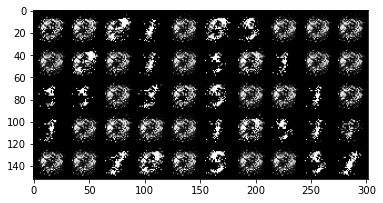

Iter: 26010/100000, Gen loss: 5.0478, Dis loss: 0.0345
Iter: 26020/100000, Gen loss: 4.4658, Dis loss: 0.0546
Iter: 26030/100000, Gen loss: 4.8385, Dis loss: 0.0324
Iter: 26040/100000, Gen loss: 5.5631, Dis loss: 0.1425
Iter: 26050/100000, Gen loss: 5.5242, Dis loss: 0.0670
Iter: 26060/100000, Gen loss: 4.2573, Dis loss: 0.0480
Iter: 26070/100000, Gen loss: 4.9337, Dis loss: 0.0272
Iter: 26080/100000, Gen loss: 6.0191, Dis loss: 0.0698
Iter: 26090/100000, Gen loss: 4.9543, Dis loss: 0.0467
Iter: 26100/100000, Gen loss: 4.5904, Dis loss: 0.0658
Iter: 26110/100000, Gen loss: 5.3605, Dis loss: 0.0959
Iter: 26120/100000, Gen loss: 4.9046, Dis loss: 0.0530
Iter: 26130/100000, Gen loss: 4.3586, Dis loss: 0.0468
Iter: 26140/100000, Gen loss: 5.2769, Dis loss: 0.0506
Iter: 26150/100000, Gen loss: 4.6158, Dis loss: 0.0870
Iter: 26160/100000, Gen loss: 4.0825, Dis loss: 0.0966
Iter: 26170/100000, Gen loss: 4.1428, Dis loss: 0.0604
Iter: 26180/100000, Gen loss: 3.7836, Dis loss: 0.0882
Iter: 2619

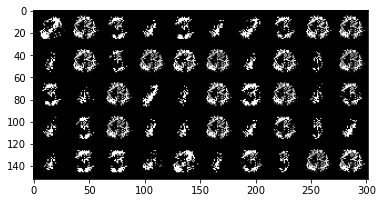

Iter: 26210/100000, Gen loss: 5.2412, Dis loss: 0.0460
Iter: 26220/100000, Gen loss: 4.5667, Dis loss: 0.0272
Iter: 26230/100000, Gen loss: 5.2106, Dis loss: 0.0223
Iter: 26240/100000, Gen loss: 4.4605, Dis loss: 0.0324
Iter: 26250/100000, Gen loss: 4.6952, Dis loss: 0.1152
Iter: 26260/100000, Gen loss: 5.0656, Dis loss: 0.0214
Iter: 26270/100000, Gen loss: 4.9497, Dis loss: 0.0296
Iter: 26280/100000, Gen loss: 4.5306, Dis loss: 0.0288
Iter: 26290/100000, Gen loss: 4.7692, Dis loss: 0.1156
Iter: 26300/100000, Gen loss: 5.3575, Dis loss: 0.0177
Iter: 26310/100000, Gen loss: 4.4583, Dis loss: 0.0710
Iter: 26320/100000, Gen loss: 5.3575, Dis loss: 0.0541
Iter: 26330/100000, Gen loss: 5.5489, Dis loss: 0.0303
Iter: 26340/100000, Gen loss: 4.8677, Dis loss: 0.1200
Iter: 26350/100000, Gen loss: 5.5692, Dis loss: 0.0132
Iter: 26360/100000, Gen loss: 5.5938, Dis loss: 0.1429
Iter: 26370/100000, Gen loss: 4.8981, Dis loss: 0.0820
Iter: 26380/100000, Gen loss: 6.1736, Dis loss: 0.0119
Iter: 2639

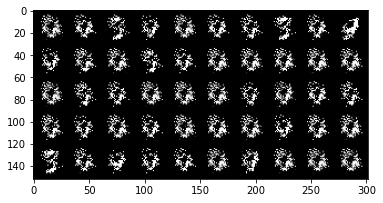

Iter: 26410/100000, Gen loss: 6.0723, Dis loss: 0.0245
Iter: 26420/100000, Gen loss: 5.4834, Dis loss: 0.0354
Iter: 26430/100000, Gen loss: 4.8689, Dis loss: 0.0322
Iter: 26440/100000, Gen loss: 6.0017, Dis loss: 0.0636
Iter: 26450/100000, Gen loss: 4.7725, Dis loss: 0.1240
Iter: 26460/100000, Gen loss: 5.9544, Dis loss: 0.0331
Iter: 26470/100000, Gen loss: 6.8067, Dis loss: 0.0255
Iter: 26480/100000, Gen loss: 6.3136, Dis loss: 0.0391
Iter: 26490/100000, Gen loss: 6.4025, Dis loss: 0.0949
Iter: 26500/100000, Gen loss: 5.5032, Dis loss: 0.0492
Iter: 26510/100000, Gen loss: 7.6408, Dis loss: 0.0236
Iter: 26520/100000, Gen loss: 5.2938, Dis loss: 0.0581
Iter: 26530/100000, Gen loss: 6.0290, Dis loss: 0.0179
Iter: 26540/100000, Gen loss: 5.9106, Dis loss: 0.0632
Iter: 26550/100000, Gen loss: 5.4066, Dis loss: 0.0426
Iter: 26560/100000, Gen loss: 5.6398, Dis loss: 0.0262
Iter: 26570/100000, Gen loss: 6.0183, Dis loss: 0.0797
Iter: 26580/100000, Gen loss: 5.6465, Dis loss: 0.1610
Iter: 2659

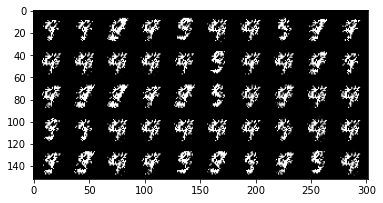

Iter: 26610/100000, Gen loss: 6.3141, Dis loss: 0.0382
Iter: 26620/100000, Gen loss: 4.5406, Dis loss: 0.0645
Iter: 26630/100000, Gen loss: 5.2214, Dis loss: 0.0258
Iter: 26640/100000, Gen loss: 3.7655, Dis loss: 0.0542
Iter: 26650/100000, Gen loss: 5.3243, Dis loss: 0.0883
Iter: 26660/100000, Gen loss: 4.7292, Dis loss: 0.0351
Iter: 26670/100000, Gen loss: 6.1753, Dis loss: 0.0073
Iter: 26680/100000, Gen loss: 5.0709, Dis loss: 0.0389
Iter: 26690/100000, Gen loss: 4.7367, Dis loss: 0.0216
Iter: 26700/100000, Gen loss: 5.2455, Dis loss: 0.0395
Iter: 26710/100000, Gen loss: 4.8145, Dis loss: 0.0677
Iter: 26720/100000, Gen loss: 5.5821, Dis loss: 0.0202
Iter: 26730/100000, Gen loss: 5.6761, Dis loss: 0.0194
Iter: 26740/100000, Gen loss: 5.3754, Dis loss: 0.0234
Iter: 26750/100000, Gen loss: 5.3630, Dis loss: 0.0178
Iter: 26760/100000, Gen loss: 5.0354, Dis loss: 0.0139
Iter: 26770/100000, Gen loss: 5.5280, Dis loss: 0.0238
Iter: 26780/100000, Gen loss: 5.5959, Dis loss: 0.0241
Iter: 2679

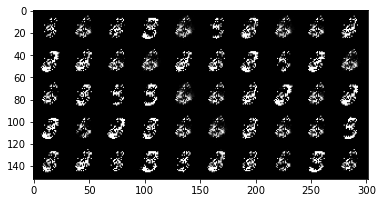

Iter: 26810/100000, Gen loss: 4.9280, Dis loss: 0.0251
Iter: 26820/100000, Gen loss: 5.0718, Dis loss: 0.0386
Iter: 26830/100000, Gen loss: 5.5142, Dis loss: 0.0269
Iter: 26840/100000, Gen loss: 5.0464, Dis loss: 0.0174
Iter: 26850/100000, Gen loss: 4.5835, Dis loss: 0.0283
Iter: 26860/100000, Gen loss: 5.0078, Dis loss: 0.0327
Iter: 26870/100000, Gen loss: 4.4957, Dis loss: 0.0527
Iter: 26880/100000, Gen loss: 5.9169, Dis loss: 0.0260
Iter: 26890/100000, Gen loss: 4.6550, Dis loss: 0.0539
Iter: 26900/100000, Gen loss: 4.8516, Dis loss: 0.0436
Iter: 26910/100000, Gen loss: 6.5340, Dis loss: 0.0381
Iter: 26920/100000, Gen loss: 5.5984, Dis loss: 0.0352
Iter: 26930/100000, Gen loss: 5.6999, Dis loss: 0.0716
Iter: 26940/100000, Gen loss: 5.1697, Dis loss: 0.0279
Iter: 26950/100000, Gen loss: 5.9100, Dis loss: 0.0129
Iter: 26960/100000, Gen loss: 5.3915, Dis loss: 0.0879
Iter: 26970/100000, Gen loss: 5.0292, Dis loss: 0.1133
Iter: 26980/100000, Gen loss: 5.3304, Dis loss: 0.0111
Iter: 2699

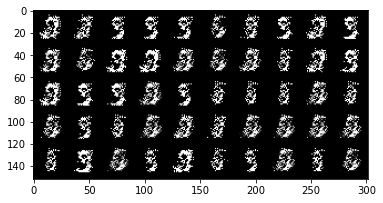

Iter: 27010/100000, Gen loss: 6.3232, Dis loss: 0.0084
Iter: 27020/100000, Gen loss: 6.3136, Dis loss: 0.0052
Iter: 27030/100000, Gen loss: 6.9383, Dis loss: 0.0748
Iter: 27040/100000, Gen loss: 5.1031, Dis loss: 0.0622
Iter: 27050/100000, Gen loss: 6.5184, Dis loss: 0.0358
Iter: 27060/100000, Gen loss: 4.9045, Dis loss: 0.0288
Iter: 27070/100000, Gen loss: 4.8526, Dis loss: 0.0403
Iter: 27080/100000, Gen loss: 5.4154, Dis loss: 0.0571
Iter: 27090/100000, Gen loss: 6.4444, Dis loss: 0.0274
Iter: 27100/100000, Gen loss: 6.1439, Dis loss: 0.0325
Iter: 27110/100000, Gen loss: 5.5761, Dis loss: 0.0459
Iter: 27120/100000, Gen loss: 6.0059, Dis loss: 0.0286
Iter: 27130/100000, Gen loss: 4.4535, Dis loss: 0.0399
Iter: 27140/100000, Gen loss: 6.3680, Dis loss: 0.0179
Iter: 27150/100000, Gen loss: 5.2783, Dis loss: 0.0421
Iter: 27160/100000, Gen loss: 5.2005, Dis loss: 0.0158
Iter: 27170/100000, Gen loss: 5.1593, Dis loss: 0.0454
Iter: 27180/100000, Gen loss: 4.9254, Dis loss: 0.0349
Iter: 2719

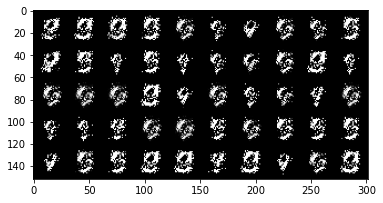

Iter: 27210/100000, Gen loss: 5.3668, Dis loss: 0.0169
Iter: 27220/100000, Gen loss: 5.1998, Dis loss: 0.1059
Iter: 27230/100000, Gen loss: 4.4258, Dis loss: 0.0677
Iter: 27240/100000, Gen loss: 6.1985, Dis loss: 0.1028
Iter: 27250/100000, Gen loss: 4.4197, Dis loss: 0.0403
Iter: 27260/100000, Gen loss: 5.1931, Dis loss: 0.0428
Iter: 27270/100000, Gen loss: 5.4254, Dis loss: 0.0284
Iter: 27280/100000, Gen loss: 5.4070, Dis loss: 0.0153
Iter: 27290/100000, Gen loss: 5.4008, Dis loss: 0.0253
Iter: 27300/100000, Gen loss: 5.4241, Dis loss: 0.0284
Iter: 27310/100000, Gen loss: 5.0044, Dis loss: 0.0263
Iter: 27320/100000, Gen loss: 7.1941, Dis loss: 0.0068
Iter: 27330/100000, Gen loss: 4.9560, Dis loss: 0.0287
Iter: 27340/100000, Gen loss: 5.8058, Dis loss: 0.0429
Iter: 27350/100000, Gen loss: 4.9145, Dis loss: 0.0936
Iter: 27360/100000, Gen loss: 5.6027, Dis loss: 0.1548
Iter: 27370/100000, Gen loss: 5.1951, Dis loss: 0.0321
Iter: 27380/100000, Gen loss: 5.3836, Dis loss: 0.0476
Iter: 2739

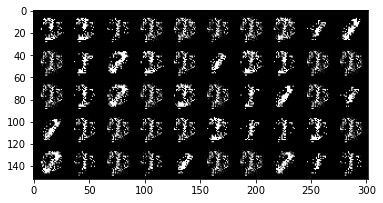

Iter: 27410/100000, Gen loss: 5.3278, Dis loss: 0.0935
Iter: 27420/100000, Gen loss: 4.9785, Dis loss: 0.0317
Iter: 27430/100000, Gen loss: 4.4142, Dis loss: 0.0321
Iter: 27440/100000, Gen loss: 5.8007, Dis loss: 0.1419
Iter: 27450/100000, Gen loss: 5.7203, Dis loss: 0.0514
Iter: 27460/100000, Gen loss: 4.7958, Dis loss: 0.0251
Iter: 27470/100000, Gen loss: 5.4610, Dis loss: 0.0165
Iter: 27480/100000, Gen loss: 5.0153, Dis loss: 0.0567
Iter: 27490/100000, Gen loss: 5.5460, Dis loss: 0.0213
Iter: 27500/100000, Gen loss: 5.5426, Dis loss: 0.0649
Iter: 27510/100000, Gen loss: 4.3695, Dis loss: 0.1556
Iter: 27520/100000, Gen loss: 4.9333, Dis loss: 0.0546
Iter: 27530/100000, Gen loss: 5.4705, Dis loss: 0.1437
Iter: 27540/100000, Gen loss: 5.2496, Dis loss: 0.1096
Iter: 27550/100000, Gen loss: 4.4298, Dis loss: 0.0827
Iter: 27560/100000, Gen loss: 3.4950, Dis loss: 0.1904
Iter: 27570/100000, Gen loss: 5.1230, Dis loss: 0.0624
Iter: 27580/100000, Gen loss: 5.1315, Dis loss: 0.0654
Iter: 2759

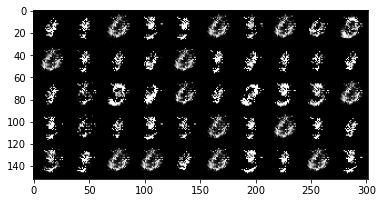

Iter: 27610/100000, Gen loss: 4.4781, Dis loss: 0.0746
Iter: 27620/100000, Gen loss: 3.4648, Dis loss: 0.1246
Iter: 27630/100000, Gen loss: 3.8108, Dis loss: 0.1173
Iter: 27640/100000, Gen loss: 3.6850, Dis loss: 0.1719
Iter: 27650/100000, Gen loss: 4.2460, Dis loss: 0.1407
Iter: 27660/100000, Gen loss: 4.9084, Dis loss: 0.1829
Iter: 27670/100000, Gen loss: 4.5587, Dis loss: 0.1099
Iter: 27680/100000, Gen loss: 4.1548, Dis loss: 0.0713
Iter: 27690/100000, Gen loss: 4.0327, Dis loss: 0.0788
Iter: 27700/100000, Gen loss: 5.1396, Dis loss: 0.0993
Iter: 27710/100000, Gen loss: 4.3973, Dis loss: 0.2870
Iter: 27720/100000, Gen loss: 5.0467, Dis loss: 0.2025
Iter: 27730/100000, Gen loss: 4.1299, Dis loss: 0.0338
Iter: 27740/100000, Gen loss: 4.8838, Dis loss: 0.2215
Iter: 27750/100000, Gen loss: 5.0682, Dis loss: 0.0464
Iter: 27760/100000, Gen loss: 4.9207, Dis loss: 0.0597
Iter: 27770/100000, Gen loss: 4.8721, Dis loss: 0.0497
Iter: 27780/100000, Gen loss: 4.3503, Dis loss: 0.0780
Iter: 2779

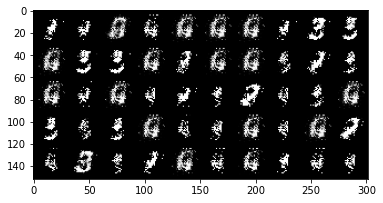

Iter: 27810/100000, Gen loss: 3.1760, Dis loss: 0.2105
Iter: 27820/100000, Gen loss: 4.3737, Dis loss: 0.0599
Iter: 27830/100000, Gen loss: 4.3798, Dis loss: 0.0909
Iter: 27840/100000, Gen loss: 4.8192, Dis loss: 0.0744
Iter: 27850/100000, Gen loss: 4.3371, Dis loss: 0.1265
Iter: 27860/100000, Gen loss: 5.4654, Dis loss: 0.0314
Iter: 27870/100000, Gen loss: 4.4342, Dis loss: 0.1117
Iter: 27880/100000, Gen loss: 6.2947, Dis loss: 0.0245
Iter: 27890/100000, Gen loss: 4.3160, Dis loss: 0.0917
Iter: 27900/100000, Gen loss: 5.0048, Dis loss: 0.0235
Iter: 27910/100000, Gen loss: 4.6767, Dis loss: 0.0378
Iter: 27920/100000, Gen loss: 5.7945, Dis loss: 0.0788
Iter: 27930/100000, Gen loss: 4.5841, Dis loss: 0.0444
Iter: 27940/100000, Gen loss: 4.6308, Dis loss: 0.0442
Iter: 27950/100000, Gen loss: 3.6266, Dis loss: 0.1342
Iter: 27960/100000, Gen loss: 4.1640, Dis loss: 0.0440
Iter: 27970/100000, Gen loss: 4.9233, Dis loss: 0.0245
Iter: 27980/100000, Gen loss: 4.2442, Dis loss: 0.0375
Iter: 2799

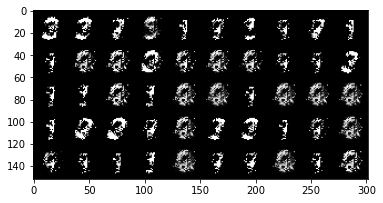

Iter: 28010/100000, Gen loss: 4.7350, Dis loss: 0.0813
Iter: 28020/100000, Gen loss: 3.8712, Dis loss: 0.0685
Iter: 28030/100000, Gen loss: 3.8740, Dis loss: 0.0356
Iter: 28040/100000, Gen loss: 4.4605, Dis loss: 0.1053
Iter: 28050/100000, Gen loss: 3.8985, Dis loss: 0.1796
Iter: 28060/100000, Gen loss: 4.0107, Dis loss: 0.0693
Iter: 28070/100000, Gen loss: 3.9517, Dis loss: 0.1273
Iter: 28080/100000, Gen loss: 4.3553, Dis loss: 0.1109
Iter: 28090/100000, Gen loss: 3.4278, Dis loss: 0.1229
Iter: 28100/100000, Gen loss: 4.8137, Dis loss: 0.0703
Iter: 28110/100000, Gen loss: 4.7813, Dis loss: 0.0783
Iter: 28120/100000, Gen loss: 4.6380, Dis loss: 0.0870
Iter: 28130/100000, Gen loss: 4.7925, Dis loss: 0.0266
Iter: 28140/100000, Gen loss: 5.0198, Dis loss: 0.0272
Iter: 28150/100000, Gen loss: 4.7594, Dis loss: 0.0820
Iter: 28160/100000, Gen loss: 4.1906, Dis loss: 0.0928
Iter: 28170/100000, Gen loss: 5.0774, Dis loss: 0.0839
Iter: 28180/100000, Gen loss: 4.9654, Dis loss: 0.0245
Iter: 2819

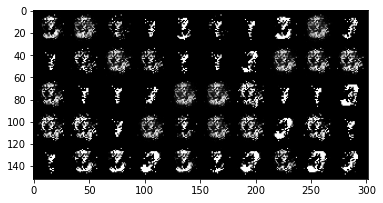

Iter: 28210/100000, Gen loss: 4.3665, Dis loss: 0.0686
Iter: 28220/100000, Gen loss: 4.2969, Dis loss: 0.0506
Iter: 28230/100000, Gen loss: 4.7749, Dis loss: 0.0568
Iter: 28240/100000, Gen loss: 4.3256, Dis loss: 0.0640
Iter: 28250/100000, Gen loss: 5.2183, Dis loss: 0.0450
Iter: 28260/100000, Gen loss: 5.0692, Dis loss: 0.0473
Iter: 28270/100000, Gen loss: 5.3207, Dis loss: 0.0276
Iter: 28280/100000, Gen loss: 4.8676, Dis loss: 0.0617
Iter: 28290/100000, Gen loss: 5.6631, Dis loss: 0.0171
Iter: 28300/100000, Gen loss: 4.9915, Dis loss: 0.0587
Iter: 28310/100000, Gen loss: 4.7120, Dis loss: 0.0388
Iter: 28320/100000, Gen loss: 4.3527, Dis loss: 0.0705
Iter: 28330/100000, Gen loss: 4.9452, Dis loss: 0.0656
Iter: 28340/100000, Gen loss: 4.8144, Dis loss: 0.0488
Iter: 28350/100000, Gen loss: 5.5131, Dis loss: 0.0576
Iter: 28360/100000, Gen loss: 4.1662, Dis loss: 0.0440
Iter: 28370/100000, Gen loss: 5.4607, Dis loss: 0.0580
Iter: 28380/100000, Gen loss: 5.0957, Dis loss: 0.0498
Iter: 2839

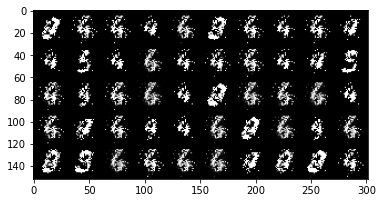

Iter: 28410/100000, Gen loss: 4.5322, Dis loss: 0.0439
Iter: 28420/100000, Gen loss: 4.9390, Dis loss: 0.0687
Iter: 28430/100000, Gen loss: 4.7347, Dis loss: 0.0191
Iter: 28440/100000, Gen loss: 5.3888, Dis loss: 0.0428
Iter: 28450/100000, Gen loss: 5.5079, Dis loss: 0.0421
Iter: 28460/100000, Gen loss: 3.4469, Dis loss: 0.0813
Iter: 28470/100000, Gen loss: 5.5768, Dis loss: 0.0296
Iter: 28480/100000, Gen loss: 5.3323, Dis loss: 0.0408
Iter: 28490/100000, Gen loss: 5.0840, Dis loss: 0.0496
Iter: 28500/100000, Gen loss: 5.1029, Dis loss: 0.0337
Iter: 28510/100000, Gen loss: 4.4857, Dis loss: 0.0495
Iter: 28520/100000, Gen loss: 5.5064, Dis loss: 0.0758
Iter: 28530/100000, Gen loss: 5.6068, Dis loss: 0.0959
Iter: 28540/100000, Gen loss: 5.1259, Dis loss: 0.0206
Iter: 28550/100000, Gen loss: 4.6976, Dis loss: 0.0692
Iter: 28560/100000, Gen loss: 5.7149, Dis loss: 0.0125
Iter: 28570/100000, Gen loss: 5.5406, Dis loss: 0.0663
Iter: 28580/100000, Gen loss: 5.1872, Dis loss: 0.0333
Iter: 2859

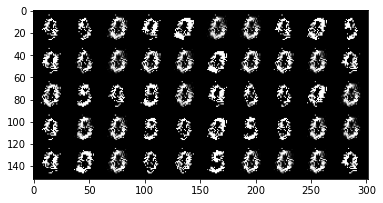

Iter: 28610/100000, Gen loss: 4.6319, Dis loss: 0.1462
Iter: 28620/100000, Gen loss: 5.4288, Dis loss: 0.0589
Iter: 28630/100000, Gen loss: 4.7282, Dis loss: 0.1547
Iter: 28640/100000, Gen loss: 5.4387, Dis loss: 0.1651
Iter: 28650/100000, Gen loss: 4.2784, Dis loss: 0.0331
Iter: 28660/100000, Gen loss: 4.6555, Dis loss: 0.0537
Iter: 28670/100000, Gen loss: 4.6278, Dis loss: 0.0332
Iter: 28680/100000, Gen loss: 3.6966, Dis loss: 0.0752
Iter: 28690/100000, Gen loss: 5.1581, Dis loss: 0.0654
Iter: 28700/100000, Gen loss: 4.0377, Dis loss: 0.0879
Iter: 28710/100000, Gen loss: 5.2548, Dis loss: 0.0574
Iter: 28720/100000, Gen loss: 4.2939, Dis loss: 0.0334
Iter: 28730/100000, Gen loss: 4.5446, Dis loss: 0.0681
Iter: 28740/100000, Gen loss: 4.0482, Dis loss: 0.1239
Iter: 28750/100000, Gen loss: 4.7045, Dis loss: 0.0291
Iter: 28760/100000, Gen loss: 4.8908, Dis loss: 0.0602
Iter: 28770/100000, Gen loss: 3.7630, Dis loss: 0.1266
Iter: 28780/100000, Gen loss: 6.3599, Dis loss: 0.0338
Iter: 2879

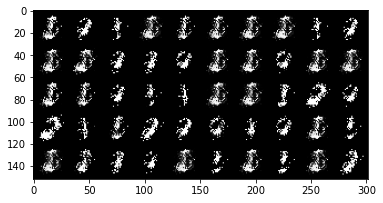

Iter: 28810/100000, Gen loss: 3.8442, Dis loss: 0.1496
Iter: 28820/100000, Gen loss: 4.9257, Dis loss: 0.0819
Iter: 28830/100000, Gen loss: 5.5607, Dis loss: 0.0564
Iter: 28840/100000, Gen loss: 4.7410, Dis loss: 0.0267
Iter: 28850/100000, Gen loss: 5.5823, Dis loss: 0.0830
Iter: 28860/100000, Gen loss: 4.2340, Dis loss: 0.0857
Iter: 28870/100000, Gen loss: 5.1140, Dis loss: 0.0971
Iter: 28880/100000, Gen loss: 4.9374, Dis loss: 0.1077
Iter: 28890/100000, Gen loss: 5.0240, Dis loss: 0.0271
Iter: 28900/100000, Gen loss: 5.5335, Dis loss: 0.0346
Iter: 28910/100000, Gen loss: 5.0606, Dis loss: 0.1122
Iter: 28920/100000, Gen loss: 6.3814, Dis loss: 0.0306
Iter: 28930/100000, Gen loss: 5.4172, Dis loss: 0.0208
Iter: 28940/100000, Gen loss: 5.2000, Dis loss: 0.0532
Iter: 28950/100000, Gen loss: 6.3580, Dis loss: 0.0877
Iter: 28960/100000, Gen loss: 5.1938, Dis loss: 0.2670
Iter: 28970/100000, Gen loss: 5.2956, Dis loss: 0.0286
Iter: 28980/100000, Gen loss: 4.6097, Dis loss: 0.0560
Iter: 2899

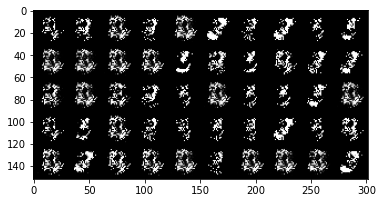

Iter: 29010/100000, Gen loss: 4.8434, Dis loss: 0.0911
Iter: 29020/100000, Gen loss: 3.5525, Dis loss: 0.0816
Iter: 29030/100000, Gen loss: 5.3353, Dis loss: 0.0766
Iter: 29040/100000, Gen loss: 4.6402, Dis loss: 0.1567
Iter: 29050/100000, Gen loss: 5.3285, Dis loss: 0.0559
Iter: 29060/100000, Gen loss: 5.4399, Dis loss: 0.0535
Iter: 29070/100000, Gen loss: 3.7332, Dis loss: 0.0498
Iter: 29080/100000, Gen loss: 5.5571, Dis loss: 0.0195
Iter: 29090/100000, Gen loss: 5.1132, Dis loss: 0.0701
Iter: 29100/100000, Gen loss: 4.6056, Dis loss: 0.0914
Iter: 29110/100000, Gen loss: 4.6378, Dis loss: 0.0577
Iter: 29120/100000, Gen loss: 5.3238, Dis loss: 0.0322
Iter: 29130/100000, Gen loss: 4.4288, Dis loss: 0.0415
Iter: 29140/100000, Gen loss: 4.6720, Dis loss: 0.0758
Iter: 29150/100000, Gen loss: 4.5434, Dis loss: 0.0490
Iter: 29160/100000, Gen loss: 3.9564, Dis loss: 0.0937
Iter: 29170/100000, Gen loss: 4.7458, Dis loss: 0.0312
Iter: 29180/100000, Gen loss: 4.2215, Dis loss: 0.0814
Iter: 2919

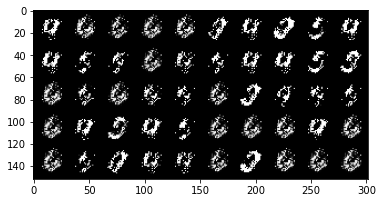

Iter: 29210/100000, Gen loss: 5.0838, Dis loss: 0.0348
Iter: 29220/100000, Gen loss: 5.2366, Dis loss: 0.2819
Iter: 29230/100000, Gen loss: 4.4906, Dis loss: 0.0319
Iter: 29240/100000, Gen loss: 4.5635, Dis loss: 0.0388
Iter: 29250/100000, Gen loss: 4.6880, Dis loss: 0.1313
Iter: 29260/100000, Gen loss: 5.2300, Dis loss: 0.0392
Iter: 29270/100000, Gen loss: 4.6711, Dis loss: 0.1329
Iter: 29280/100000, Gen loss: 5.5376, Dis loss: 0.0603
Iter: 29290/100000, Gen loss: 5.6174, Dis loss: 0.0255
Iter: 29300/100000, Gen loss: 4.5913, Dis loss: 0.0371
Iter: 29310/100000, Gen loss: 5.4286, Dis loss: 0.0400
Iter: 29320/100000, Gen loss: 5.1091, Dis loss: 0.1175
Iter: 29330/100000, Gen loss: 4.9398, Dis loss: 0.2034
Iter: 29340/100000, Gen loss: 5.9186, Dis loss: 0.0363
Iter: 29350/100000, Gen loss: 4.4579, Dis loss: 0.0557
Iter: 29360/100000, Gen loss: 4.9660, Dis loss: 0.0621
Iter: 29370/100000, Gen loss: 4.7511, Dis loss: 0.0350
Iter: 29380/100000, Gen loss: 4.9494, Dis loss: 0.0202
Iter: 2939

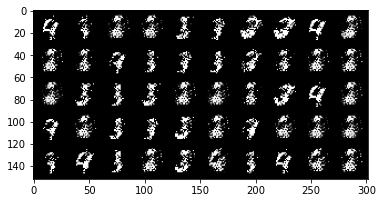

Iter: 29410/100000, Gen loss: 5.4741, Dis loss: 0.0238
Iter: 29420/100000, Gen loss: 5.4218, Dis loss: 0.0151
Iter: 29430/100000, Gen loss: 4.9414, Dis loss: 0.0476
Iter: 29440/100000, Gen loss: 5.5626, Dis loss: 0.0432
Iter: 29450/100000, Gen loss: 5.1129, Dis loss: 0.0285
Iter: 29460/100000, Gen loss: 6.0272, Dis loss: 0.0182
Iter: 29470/100000, Gen loss: 5.6197, Dis loss: 0.0116
Iter: 29480/100000, Gen loss: 5.2908, Dis loss: 0.0149
Iter: 29490/100000, Gen loss: 6.1693, Dis loss: 0.0121
Iter: 29500/100000, Gen loss: 5.7712, Dis loss: 0.0150
Iter: 29510/100000, Gen loss: 5.3806, Dis loss: 0.0669
Iter: 29520/100000, Gen loss: 6.1227, Dis loss: 0.0100
Iter: 29530/100000, Gen loss: 5.3756, Dis loss: 0.0220
Iter: 29540/100000, Gen loss: 5.1171, Dis loss: 0.0108
Iter: 29550/100000, Gen loss: 4.8031, Dis loss: 0.0202
Iter: 29560/100000, Gen loss: 4.9808, Dis loss: 0.0227
Iter: 29570/100000, Gen loss: 5.9162, Dis loss: 0.0148
Iter: 29580/100000, Gen loss: 4.7370, Dis loss: 0.0275
Iter: 2959

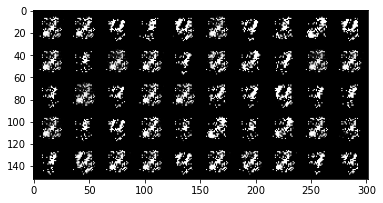

Iter: 29610/100000, Gen loss: 6.4033, Dis loss: 0.0418
Iter: 29620/100000, Gen loss: 5.7162, Dis loss: 0.0307
Iter: 29630/100000, Gen loss: 5.2143, Dis loss: 0.0373
Iter: 29640/100000, Gen loss: 6.4074, Dis loss: 0.1583
Iter: 29650/100000, Gen loss: 5.3428, Dis loss: 0.0237
Iter: 29660/100000, Gen loss: 5.1810, Dis loss: 0.0280
Iter: 29670/100000, Gen loss: 5.8440, Dis loss: 0.0734
Iter: 29680/100000, Gen loss: 5.2234, Dis loss: 0.0569
Iter: 29690/100000, Gen loss: 4.8876, Dis loss: 0.0764
Iter: 29700/100000, Gen loss: 4.1220, Dis loss: 0.0508
Iter: 29710/100000, Gen loss: 7.0348, Dis loss: 0.0607
Iter: 29720/100000, Gen loss: 5.4600, Dis loss: 0.0377
Iter: 29730/100000, Gen loss: 4.4703, Dis loss: 0.0336
Iter: 29740/100000, Gen loss: 4.6849, Dis loss: 0.0844
Iter: 29750/100000, Gen loss: 4.2198, Dis loss: 0.0473
Iter: 29760/100000, Gen loss: 4.7460, Dis loss: 0.0894
Iter: 29770/100000, Gen loss: 4.0725, Dis loss: 0.1380
Iter: 29780/100000, Gen loss: 4.9039, Dis loss: 0.2332
Iter: 2979

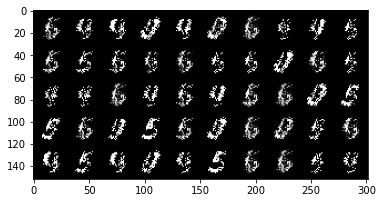

Iter: 29810/100000, Gen loss: 4.5706, Dis loss: 0.0410
Iter: 29820/100000, Gen loss: 4.6303, Dis loss: 0.0394
Iter: 29830/100000, Gen loss: 5.5102, Dis loss: 0.0798
Iter: 29840/100000, Gen loss: 5.4117, Dis loss: 0.0159
Iter: 29850/100000, Gen loss: 4.6359, Dis loss: 0.0891
Iter: 29860/100000, Gen loss: 5.9785, Dis loss: 0.0814
Iter: 29870/100000, Gen loss: 4.3375, Dis loss: 0.0601
Iter: 29880/100000, Gen loss: 5.1718, Dis loss: 0.0510
Iter: 29890/100000, Gen loss: 4.5949, Dis loss: 0.1734
Iter: 29900/100000, Gen loss: 5.1781, Dis loss: 0.0589
Iter: 29910/100000, Gen loss: 3.8393, Dis loss: 0.1355
Iter: 29920/100000, Gen loss: 4.5919, Dis loss: 0.1003
Iter: 29930/100000, Gen loss: 4.7184, Dis loss: 0.0510
Iter: 29940/100000, Gen loss: 4.1729, Dis loss: 0.0557
Iter: 29950/100000, Gen loss: 4.3600, Dis loss: 0.0473
Iter: 29960/100000, Gen loss: 4.0208, Dis loss: 0.1729
Iter: 29970/100000, Gen loss: 5.7475, Dis loss: 0.0742
Iter: 29980/100000, Gen loss: 4.3971, Dis loss: 0.1439
Iter: 2999

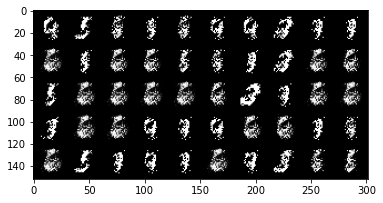

Iter: 30010/100000, Gen loss: 3.8008, Dis loss: 0.0885
Iter: 30020/100000, Gen loss: 3.5764, Dis loss: 0.1893
Iter: 30030/100000, Gen loss: 5.1995, Dis loss: 0.0253
Iter: 30040/100000, Gen loss: 5.1025, Dis loss: 0.0208
Iter: 30050/100000, Gen loss: 4.1611, Dis loss: 0.0569
Iter: 30060/100000, Gen loss: 4.7135, Dis loss: 0.0271
Iter: 30070/100000, Gen loss: 5.6491, Dis loss: 0.0371
Iter: 30080/100000, Gen loss: 5.1529, Dis loss: 0.0372
Iter: 30090/100000, Gen loss: 4.2903, Dis loss: 0.0281
Iter: 30100/100000, Gen loss: 5.6932, Dis loss: 0.0518
Iter: 30110/100000, Gen loss: 4.3123, Dis loss: 0.0580
Iter: 30120/100000, Gen loss: 5.8450, Dis loss: 0.0538
Iter: 30130/100000, Gen loss: 5.9441, Dis loss: 0.0931
Iter: 30140/100000, Gen loss: 5.8236, Dis loss: 0.0561
Iter: 30150/100000, Gen loss: 6.1280, Dis loss: 0.0337
Iter: 30160/100000, Gen loss: 5.3647, Dis loss: 0.0456
Iter: 30170/100000, Gen loss: 6.1046, Dis loss: 0.0127
Iter: 30180/100000, Gen loss: 6.1304, Dis loss: 0.0103
Iter: 3019

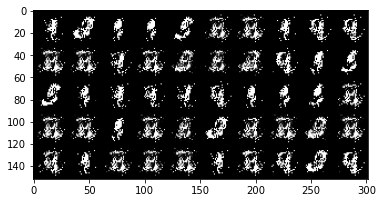

Iter: 30210/100000, Gen loss: 5.7239, Dis loss: 0.0227
Iter: 30220/100000, Gen loss: 5.2039, Dis loss: 0.0345
Iter: 30230/100000, Gen loss: 5.7000, Dis loss: 0.0172
Iter: 30240/100000, Gen loss: 6.1370, Dis loss: 0.0197
Iter: 30250/100000, Gen loss: 5.1390, Dis loss: 0.0137
Iter: 30260/100000, Gen loss: 5.8792, Dis loss: 0.0158
Iter: 30270/100000, Gen loss: 5.3498, Dis loss: 0.0469
Iter: 30280/100000, Gen loss: 4.8900, Dis loss: 0.0138
Iter: 30290/100000, Gen loss: 5.6110, Dis loss: 0.0567
Iter: 30300/100000, Gen loss: 5.4864, Dis loss: 0.0306
Iter: 30310/100000, Gen loss: 5.0983, Dis loss: 0.0320
Iter: 30320/100000, Gen loss: 5.5251, Dis loss: 0.0169
Iter: 30330/100000, Gen loss: 5.0164, Dis loss: 0.0398
Iter: 30340/100000, Gen loss: 5.8699, Dis loss: 0.0118
Iter: 30350/100000, Gen loss: 5.4577, Dis loss: 0.0105
Iter: 30360/100000, Gen loss: 5.3949, Dis loss: 0.0239
Iter: 30370/100000, Gen loss: 5.3682, Dis loss: 0.0398
Iter: 30380/100000, Gen loss: 4.5921, Dis loss: 0.0950
Iter: 3039

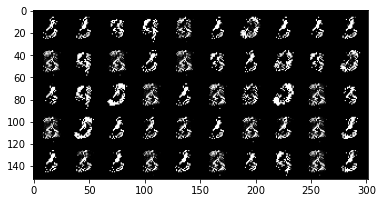

Iter: 30410/100000, Gen loss: 5.2740, Dis loss: 0.0292
Iter: 30420/100000, Gen loss: 5.5548, Dis loss: 0.0214
Iter: 30430/100000, Gen loss: 5.3430, Dis loss: 0.0241
Iter: 30440/100000, Gen loss: 4.3243, Dis loss: 0.1974
Iter: 30450/100000, Gen loss: 5.6991, Dis loss: 0.0189
Iter: 30460/100000, Gen loss: 5.5435, Dis loss: 0.0117
Iter: 30470/100000, Gen loss: 5.0374, Dis loss: 0.0393
Iter: 30480/100000, Gen loss: 4.6284, Dis loss: 0.0343
Iter: 30490/100000, Gen loss: 5.3224, Dis loss: 0.0162
Iter: 30500/100000, Gen loss: 6.0255, Dis loss: 0.0103
Iter: 30510/100000, Gen loss: 5.2848, Dis loss: 0.0117
Iter: 30520/100000, Gen loss: 5.8933, Dis loss: 0.0111
Iter: 30530/100000, Gen loss: 4.3792, Dis loss: 0.0353
Iter: 30540/100000, Gen loss: 5.5611, Dis loss: 0.0498
Iter: 30550/100000, Gen loss: 4.9218, Dis loss: 0.0928
Iter: 30560/100000, Gen loss: 6.6761, Dis loss: 0.0084
Iter: 30570/100000, Gen loss: 5.7064, Dis loss: 0.0124
Iter: 30580/100000, Gen loss: 6.5704, Dis loss: 0.0057
Iter: 3059

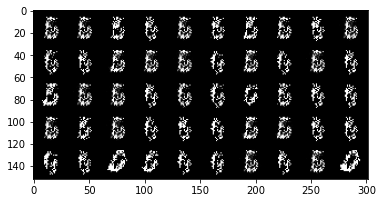

Iter: 30610/100000, Gen loss: 5.6363, Dis loss: 0.0094
Iter: 30620/100000, Gen loss: 5.0743, Dis loss: 0.0248
Iter: 30630/100000, Gen loss: 5.0226, Dis loss: 0.0702
Iter: 30640/100000, Gen loss: 6.6203, Dis loss: 0.0111
Iter: 30650/100000, Gen loss: 5.9338, Dis loss: 0.0854
Iter: 30660/100000, Gen loss: 5.0121, Dis loss: 0.0213
Iter: 30670/100000, Gen loss: 5.3232, Dis loss: 0.0118
Iter: 30680/100000, Gen loss: 5.1876, Dis loss: 0.0183
Iter: 30690/100000, Gen loss: 5.0445, Dis loss: 0.0272
Iter: 30700/100000, Gen loss: 6.6540, Dis loss: 0.0216
Iter: 30710/100000, Gen loss: 5.5010, Dis loss: 0.0299
Iter: 30720/100000, Gen loss: 6.4965, Dis loss: 0.0098
Iter: 30730/100000, Gen loss: 5.3011, Dis loss: 0.0348
Iter: 30740/100000, Gen loss: 4.2292, Dis loss: 0.1356
Iter: 30750/100000, Gen loss: 5.4150, Dis loss: 0.1038
Iter: 30760/100000, Gen loss: 5.0558, Dis loss: 0.0220
Iter: 30770/100000, Gen loss: 5.4475, Dis loss: 0.0252
Iter: 30780/100000, Gen loss: 5.3295, Dis loss: 0.1071
Iter: 3079

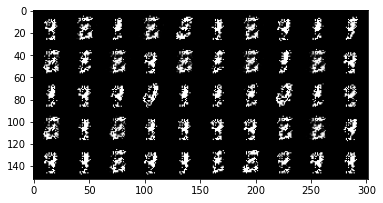

Iter: 30810/100000, Gen loss: 4.6207, Dis loss: 0.0259
Iter: 30820/100000, Gen loss: 5.8488, Dis loss: 0.0352
Iter: 30830/100000, Gen loss: 5.5823, Dis loss: 0.0493
Iter: 30840/100000, Gen loss: 6.0452, Dis loss: 0.0053
Iter: 30850/100000, Gen loss: 5.4216, Dis loss: 0.0254
Iter: 30860/100000, Gen loss: 6.4155, Dis loss: 0.0525
Iter: 30870/100000, Gen loss: 5.4829, Dis loss: 0.0297
Iter: 30880/100000, Gen loss: 5.5371, Dis loss: 0.0116
Iter: 30890/100000, Gen loss: 6.7008, Dis loss: 0.0115
Iter: 30900/100000, Gen loss: 5.8682, Dis loss: 0.0552
Iter: 30910/100000, Gen loss: 6.0126, Dis loss: 0.0046
Iter: 30920/100000, Gen loss: 5.6502, Dis loss: 0.0104
Iter: 30930/100000, Gen loss: 6.1506, Dis loss: 0.0175
Iter: 30940/100000, Gen loss: 6.8661, Dis loss: 0.0254
Iter: 30950/100000, Gen loss: 6.3818, Dis loss: 0.0052
Iter: 30960/100000, Gen loss: 6.4704, Dis loss: 0.0242
Iter: 30970/100000, Gen loss: 5.9775, Dis loss: 0.0256
Iter: 30980/100000, Gen loss: 6.7385, Dis loss: 0.0319
Iter: 3099

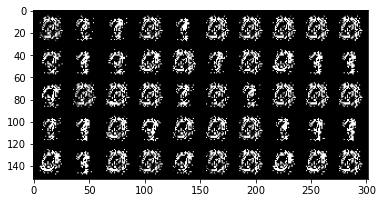

Iter: 31010/100000, Gen loss: 6.4277, Dis loss: 0.0121
Iter: 31020/100000, Gen loss: 6.3999, Dis loss: 0.0076
Iter: 31030/100000, Gen loss: 6.4869, Dis loss: 0.0195
Iter: 31040/100000, Gen loss: 6.0811, Dis loss: 0.0184
Iter: 31050/100000, Gen loss: 6.3061, Dis loss: 0.0154
Iter: 31060/100000, Gen loss: 6.0841, Dis loss: 0.0363
Iter: 31070/100000, Gen loss: 5.5381, Dis loss: 0.0124
Iter: 31080/100000, Gen loss: 5.8772, Dis loss: 0.0158
Iter: 31090/100000, Gen loss: 6.0647, Dis loss: 0.0181
Iter: 31100/100000, Gen loss: 5.8716, Dis loss: 0.0220
Iter: 31110/100000, Gen loss: 7.3532, Dis loss: 0.0167
Iter: 31120/100000, Gen loss: 7.6790, Dis loss: 0.0193
Iter: 31130/100000, Gen loss: 7.0440, Dis loss: 0.0023
Iter: 31140/100000, Gen loss: 8.2423, Dis loss: 0.0318
Iter: 31150/100000, Gen loss: 8.1222, Dis loss: 0.0028
Iter: 31160/100000, Gen loss: 6.4369, Dis loss: 0.0174
Iter: 31170/100000, Gen loss: 6.1751, Dis loss: 0.0078
Iter: 31180/100000, Gen loss: 6.1413, Dis loss: 0.0073
Iter: 3119

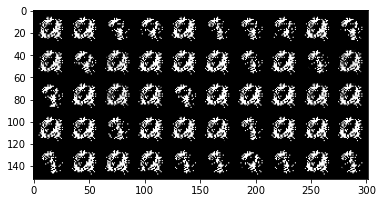

Iter: 31210/100000, Gen loss: 6.1934, Dis loss: 0.0043
Iter: 31220/100000, Gen loss: 7.2780, Dis loss: 0.0078
Iter: 31230/100000, Gen loss: 6.8456, Dis loss: 0.0045
Iter: 31240/100000, Gen loss: 6.4265, Dis loss: 0.0325
Iter: 31250/100000, Gen loss: 7.0360, Dis loss: 0.0311
Iter: 31260/100000, Gen loss: 7.3217, Dis loss: 0.0076
Iter: 31270/100000, Gen loss: 5.6567, Dis loss: 0.0186
Iter: 31280/100000, Gen loss: 6.8793, Dis loss: 0.0036
Iter: 31290/100000, Gen loss: 5.4820, Dis loss: 0.0241
Iter: 31300/100000, Gen loss: 5.7642, Dis loss: 0.0542
Iter: 31310/100000, Gen loss: 5.9294, Dis loss: 0.0287
Iter: 31320/100000, Gen loss: 6.3374, Dis loss: 0.0118
Iter: 31330/100000, Gen loss: 5.5424, Dis loss: 0.0690
Iter: 31340/100000, Gen loss: 4.6613, Dis loss: 0.0970
Iter: 31350/100000, Gen loss: 4.8908, Dis loss: 0.0764
Iter: 31360/100000, Gen loss: 5.3715, Dis loss: 0.0742
Iter: 31370/100000, Gen loss: 5.8651, Dis loss: 0.0506
Iter: 31380/100000, Gen loss: 4.5871, Dis loss: 0.0991
Iter: 3139

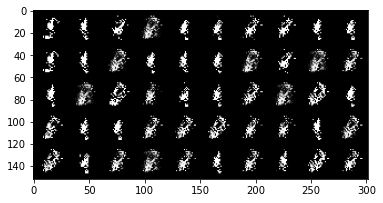

Iter: 31410/100000, Gen loss: 4.8607, Dis loss: 0.0469
Iter: 31420/100000, Gen loss: 4.0350, Dis loss: 0.0717
Iter: 31430/100000, Gen loss: 3.9642, Dis loss: 0.0529
Iter: 31440/100000, Gen loss: 5.6617, Dis loss: 0.0312
Iter: 31450/100000, Gen loss: 4.5215, Dis loss: 0.0526
Iter: 31460/100000, Gen loss: 5.1107, Dis loss: 0.0241
Iter: 31470/100000, Gen loss: 5.2382, Dis loss: 0.0990
Iter: 31480/100000, Gen loss: 5.1349, Dis loss: 0.0370
Iter: 31490/100000, Gen loss: 4.4787, Dis loss: 0.0433
Iter: 31500/100000, Gen loss: 5.1865, Dis loss: 0.0346
Iter: 31510/100000, Gen loss: 4.7104, Dis loss: 0.0334
Iter: 31520/100000, Gen loss: 5.6447, Dis loss: 0.0197
Iter: 31530/100000, Gen loss: 5.4877, Dis loss: 0.0283
Iter: 31540/100000, Gen loss: 4.6920, Dis loss: 0.0830
Iter: 31550/100000, Gen loss: 4.9722, Dis loss: 0.0927
Iter: 31560/100000, Gen loss: 5.1750, Dis loss: 0.0189
Iter: 31570/100000, Gen loss: 5.0201, Dis loss: 0.0696
Iter: 31580/100000, Gen loss: 4.7374, Dis loss: 0.0494
Iter: 3159

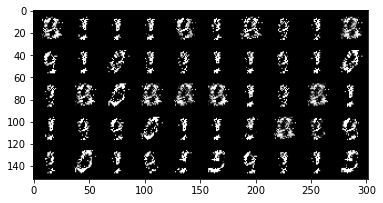

Iter: 31610/100000, Gen loss: 5.2754, Dis loss: 0.0534
Iter: 31620/100000, Gen loss: 4.5856, Dis loss: 0.0374
Iter: 31630/100000, Gen loss: 5.6051, Dis loss: 0.0312
Iter: 31640/100000, Gen loss: 4.6158, Dis loss: 0.0287
Iter: 31650/100000, Gen loss: 5.0427, Dis loss: 0.0340
Iter: 31660/100000, Gen loss: 4.3034, Dis loss: 0.0497
Iter: 31670/100000, Gen loss: 4.9526, Dis loss: 0.0296
Iter: 31680/100000, Gen loss: 4.6133, Dis loss: 0.0306
Iter: 31690/100000, Gen loss: 6.0104, Dis loss: 0.0426
Iter: 31700/100000, Gen loss: 4.7096, Dis loss: 0.1114
Iter: 31710/100000, Gen loss: 3.8893, Dis loss: 0.0257
Iter: 31720/100000, Gen loss: 5.6802, Dis loss: 0.0260
Iter: 31730/100000, Gen loss: 5.1456, Dis loss: 0.0152
Iter: 31740/100000, Gen loss: 5.6344, Dis loss: 0.0281
Iter: 31750/100000, Gen loss: 5.3775, Dis loss: 0.0223
Iter: 31760/100000, Gen loss: 5.1947, Dis loss: 0.0151
Iter: 31770/100000, Gen loss: 5.3701, Dis loss: 0.0080
Iter: 31780/100000, Gen loss: 5.8062, Dis loss: 0.0101
Iter: 3179

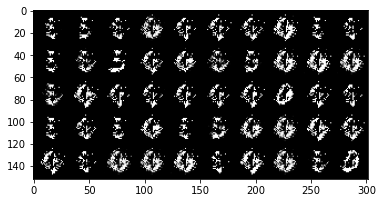

Iter: 31810/100000, Gen loss: 4.7826, Dis loss: 0.0565
Iter: 31820/100000, Gen loss: 5.7408, Dis loss: 0.0170
Iter: 31830/100000, Gen loss: 5.0788, Dis loss: 0.0239
Iter: 31840/100000, Gen loss: 5.4588, Dis loss: 0.0346
Iter: 31850/100000, Gen loss: 5.2059, Dis loss: 0.0511
Iter: 31860/100000, Gen loss: 6.7577, Dis loss: 0.0645
Iter: 31870/100000, Gen loss: 4.5523, Dis loss: 0.0559
Iter: 31880/100000, Gen loss: 6.4594, Dis loss: 0.0101
Iter: 31890/100000, Gen loss: 6.0947, Dis loss: 0.0199
Iter: 31900/100000, Gen loss: 5.5332, Dis loss: 0.0364
Iter: 31910/100000, Gen loss: 6.2455, Dis loss: 0.0126
Iter: 31920/100000, Gen loss: 6.6594, Dis loss: 0.0337
Iter: 31930/100000, Gen loss: 6.1220, Dis loss: 0.0191
Iter: 31940/100000, Gen loss: 6.6504, Dis loss: 0.0072
Iter: 31950/100000, Gen loss: 5.1260, Dis loss: 0.0107
Iter: 31960/100000, Gen loss: 6.3165, Dis loss: 0.0218
Iter: 31970/100000, Gen loss: 5.1228, Dis loss: 0.0355
Iter: 31980/100000, Gen loss: 5.2719, Dis loss: 0.1436
Iter: 3199

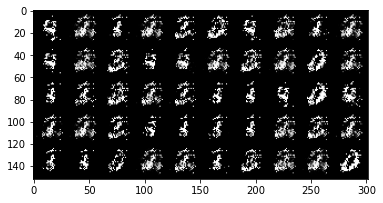

Iter: 32010/100000, Gen loss: 6.4558, Dis loss: 0.0230
Iter: 32020/100000, Gen loss: 4.1361, Dis loss: 0.0574
Iter: 32030/100000, Gen loss: 4.8000, Dis loss: 0.0368
Iter: 32040/100000, Gen loss: 6.0904, Dis loss: 0.0782
Iter: 32050/100000, Gen loss: 5.3953, Dis loss: 0.0117
Iter: 32060/100000, Gen loss: 5.2148, Dis loss: 0.0840
Iter: 32070/100000, Gen loss: 4.7085, Dis loss: 0.0611
Iter: 32080/100000, Gen loss: 6.1464, Dis loss: 0.0106
Iter: 32090/100000, Gen loss: 4.4452, Dis loss: 0.0512
Iter: 32100/100000, Gen loss: 5.2338, Dis loss: 0.1603
Iter: 32110/100000, Gen loss: 6.3458, Dis loss: 0.0665
Iter: 32120/100000, Gen loss: 6.0170, Dis loss: 0.0467
Iter: 32130/100000, Gen loss: 5.5409, Dis loss: 0.0567
Iter: 32140/100000, Gen loss: 5.6539, Dis loss: 0.0386
Iter: 32150/100000, Gen loss: 4.7676, Dis loss: 0.0199
Iter: 32160/100000, Gen loss: 5.3550, Dis loss: 0.2056
Iter: 32170/100000, Gen loss: 4.9700, Dis loss: 0.0476
Iter: 32180/100000, Gen loss: 4.5799, Dis loss: 0.0265
Iter: 3219

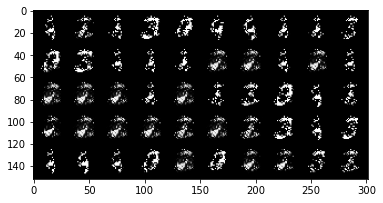

Iter: 32210/100000, Gen loss: 4.4991, Dis loss: 0.0410
Iter: 32220/100000, Gen loss: 4.0499, Dis loss: 0.0830
Iter: 32230/100000, Gen loss: 5.3662, Dis loss: 0.0220
Iter: 32240/100000, Gen loss: 4.1513, Dis loss: 0.0618
Iter: 32250/100000, Gen loss: 5.0147, Dis loss: 0.0222
Iter: 32260/100000, Gen loss: 5.0244, Dis loss: 0.0376
Iter: 32270/100000, Gen loss: 4.9928, Dis loss: 0.0747
Iter: 32280/100000, Gen loss: 4.3174, Dis loss: 0.0820
Iter: 32290/100000, Gen loss: 5.0209, Dis loss: 0.1214
Iter: 32300/100000, Gen loss: 5.4285, Dis loss: 0.0552
Iter: 32310/100000, Gen loss: 4.7059, Dis loss: 0.0346
Iter: 32320/100000, Gen loss: 4.4857, Dis loss: 0.1199
Iter: 32330/100000, Gen loss: 5.5534, Dis loss: 0.0625
Iter: 32340/100000, Gen loss: 4.9828, Dis loss: 0.0732
Iter: 32350/100000, Gen loss: 5.6848, Dis loss: 0.0668
Iter: 32360/100000, Gen loss: 4.5173, Dis loss: 0.1096
Iter: 32370/100000, Gen loss: 5.8455, Dis loss: 0.0527
Iter: 32380/100000, Gen loss: 5.1957, Dis loss: 0.0317
Iter: 3239

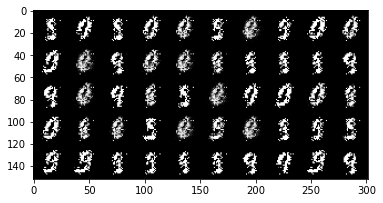

Iter: 32410/100000, Gen loss: 5.2881, Dis loss: 0.0128
Iter: 32420/100000, Gen loss: 5.0911, Dis loss: 0.0695
Iter: 32430/100000, Gen loss: 5.9859, Dis loss: 0.0618
Iter: 32440/100000, Gen loss: 5.8556, Dis loss: 0.0358
Iter: 32450/100000, Gen loss: 5.2440, Dis loss: 0.0262
Iter: 32460/100000, Gen loss: 6.4935, Dis loss: 0.0527
Iter: 32470/100000, Gen loss: 4.5245, Dis loss: 0.0948
Iter: 32480/100000, Gen loss: 5.7374, Dis loss: 0.0570
Iter: 32490/100000, Gen loss: 5.3177, Dis loss: 0.0411
Iter: 32500/100000, Gen loss: 5.2476, Dis loss: 0.0373
Iter: 32510/100000, Gen loss: 4.9145, Dis loss: 0.0937
Iter: 32520/100000, Gen loss: 5.3041, Dis loss: 0.0373
Iter: 32530/100000, Gen loss: 5.5393, Dis loss: 0.0567
Iter: 32540/100000, Gen loss: 5.5856, Dis loss: 0.0267
Iter: 32550/100000, Gen loss: 5.7281, Dis loss: 0.1245
Iter: 32560/100000, Gen loss: 4.8649, Dis loss: 0.1301
Iter: 32570/100000, Gen loss: 5.4462, Dis loss: 0.0130
Iter: 32580/100000, Gen loss: 5.3657, Dis loss: 0.0409
Iter: 3259

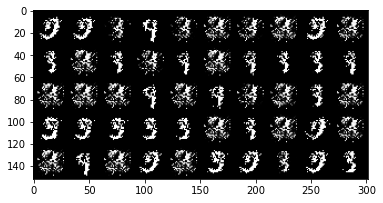

Iter: 32610/100000, Gen loss: 5.3964, Dis loss: 0.0662
Iter: 32620/100000, Gen loss: 4.6728, Dis loss: 0.1285
Iter: 32630/100000, Gen loss: 6.0556, Dis loss: 0.0908
Iter: 32640/100000, Gen loss: 5.0759, Dis loss: 0.0243
Iter: 32650/100000, Gen loss: 5.5435, Dis loss: 0.0768
Iter: 32660/100000, Gen loss: 6.4245, Dis loss: 0.0210
Iter: 32670/100000, Gen loss: 4.9221, Dis loss: 0.0271
Iter: 32680/100000, Gen loss: 5.9226, Dis loss: 0.0056
Iter: 32690/100000, Gen loss: 5.8545, Dis loss: 0.0232
Iter: 32700/100000, Gen loss: 4.8019, Dis loss: 0.0166
Iter: 32710/100000, Gen loss: 5.5682, Dis loss: 0.0122
Iter: 32720/100000, Gen loss: 5.2697, Dis loss: 0.0107
Iter: 32730/100000, Gen loss: 5.3967, Dis loss: 0.0164
Iter: 32740/100000, Gen loss: 5.4230, Dis loss: 0.1074
Iter: 32750/100000, Gen loss: 5.7449, Dis loss: 0.0045
Iter: 32760/100000, Gen loss: 5.7519, Dis loss: 0.0110
Iter: 32770/100000, Gen loss: 4.8554, Dis loss: 0.0132
Iter: 32780/100000, Gen loss: 4.8863, Dis loss: 0.0279
Iter: 3279

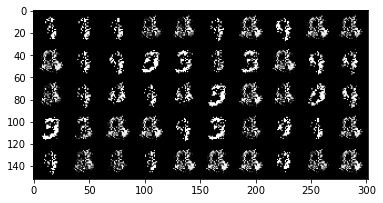

Iter: 32810/100000, Gen loss: 4.9401, Dis loss: 0.0394
Iter: 32820/100000, Gen loss: 5.7071, Dis loss: 0.0281
Iter: 32830/100000, Gen loss: 4.5088, Dis loss: 0.0293
Iter: 32840/100000, Gen loss: 6.6336, Dis loss: 0.1406
Iter: 32850/100000, Gen loss: 4.9404, Dis loss: 0.0291
Iter: 32860/100000, Gen loss: 5.5210, Dis loss: 0.0243
Iter: 32870/100000, Gen loss: 5.3515, Dis loss: 0.0120
Iter: 32880/100000, Gen loss: 5.4996, Dis loss: 0.0449
Iter: 32890/100000, Gen loss: 5.7114, Dis loss: 0.0622
Iter: 32900/100000, Gen loss: 5.1499, Dis loss: 0.0335
Iter: 32910/100000, Gen loss: 4.4510, Dis loss: 0.0957
Iter: 32920/100000, Gen loss: 6.0912, Dis loss: 0.0889
Iter: 32930/100000, Gen loss: 5.2571, Dis loss: 0.0275
Iter: 32940/100000, Gen loss: 5.8662, Dis loss: 0.0742
Iter: 32950/100000, Gen loss: 4.4261, Dis loss: 0.0410
Iter: 32960/100000, Gen loss: 4.9930, Dis loss: 0.0357
Iter: 32970/100000, Gen loss: 5.2331, Dis loss: 0.0211
Iter: 32980/100000, Gen loss: 5.0680, Dis loss: 0.0279
Iter: 3299

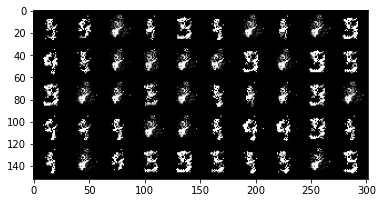

Iter: 33010/100000, Gen loss: 3.8631, Dis loss: 0.0891
Iter: 33020/100000, Gen loss: 5.6443, Dis loss: 0.3056
Iter: 33030/100000, Gen loss: 5.3718, Dis loss: 0.0536
Iter: 33040/100000, Gen loss: 4.6649, Dis loss: 0.0757
Iter: 33050/100000, Gen loss: 4.6940, Dis loss: 0.0842
Iter: 33060/100000, Gen loss: 5.1522, Dis loss: 0.1200
Iter: 33070/100000, Gen loss: 5.6043, Dis loss: 0.0422
Iter: 33080/100000, Gen loss: 3.4867, Dis loss: 0.0359
Iter: 33090/100000, Gen loss: 6.8597, Dis loss: 0.1436
Iter: 33100/100000, Gen loss: 5.1473, Dis loss: 0.0244
Iter: 33110/100000, Gen loss: 4.8472, Dis loss: 0.0409
Iter: 33120/100000, Gen loss: 4.3551, Dis loss: 0.0706
Iter: 33130/100000, Gen loss: 4.7207, Dis loss: 0.0200
Iter: 33140/100000, Gen loss: 3.8497, Dis loss: 0.0572
Iter: 33150/100000, Gen loss: 5.3704, Dis loss: 0.0217
Iter: 33160/100000, Gen loss: 5.4154, Dis loss: 0.0337
Iter: 33170/100000, Gen loss: 5.1840, Dis loss: 0.0171
Iter: 33180/100000, Gen loss: 5.8282, Dis loss: 0.0327
Iter: 3319

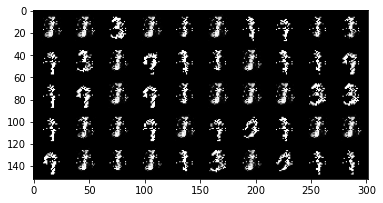

Iter: 33210/100000, Gen loss: 5.5136, Dis loss: 0.0324
Iter: 33220/100000, Gen loss: 4.9210, Dis loss: 0.0305
Iter: 33230/100000, Gen loss: 5.5478, Dis loss: 0.0150
Iter: 33240/100000, Gen loss: 5.2684, Dis loss: 0.0371
Iter: 33250/100000, Gen loss: 5.6000, Dis loss: 0.0173
Iter: 33260/100000, Gen loss: 6.4708, Dis loss: 0.0112
Iter: 33270/100000, Gen loss: 5.2380, Dis loss: 0.0775
Iter: 33280/100000, Gen loss: 5.3745, Dis loss: 0.0302
Iter: 33290/100000, Gen loss: 5.1166, Dis loss: 0.0311
Iter: 33300/100000, Gen loss: 5.5203, Dis loss: 0.0099
Iter: 33310/100000, Gen loss: 5.9098, Dis loss: 0.0109
Iter: 33320/100000, Gen loss: 5.3577, Dis loss: 0.0114
Iter: 33330/100000, Gen loss: 4.9787, Dis loss: 0.0150
Iter: 33340/100000, Gen loss: 6.4292, Dis loss: 0.0060
Iter: 33350/100000, Gen loss: 5.7927, Dis loss: 0.0088
Iter: 33360/100000, Gen loss: 6.3250, Dis loss: 0.0068
Iter: 33370/100000, Gen loss: 5.1248, Dis loss: 0.0325
Iter: 33380/100000, Gen loss: 5.9950, Dis loss: 0.0402
Iter: 3339

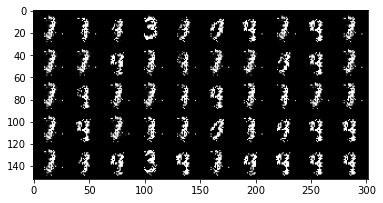

Iter: 33410/100000, Gen loss: 5.2468, Dis loss: 0.0273
Iter: 33420/100000, Gen loss: 5.6908, Dis loss: 0.0279
Iter: 33430/100000, Gen loss: 5.8522, Dis loss: 0.0201
Iter: 33440/100000, Gen loss: 5.8387, Dis loss: 0.0135
Iter: 33450/100000, Gen loss: 4.8603, Dis loss: 0.0354
Iter: 33460/100000, Gen loss: 4.9710, Dis loss: 0.0076
Iter: 33470/100000, Gen loss: 5.6767, Dis loss: 0.0092
Iter: 33480/100000, Gen loss: 6.1080, Dis loss: 0.0091
Iter: 33490/100000, Gen loss: 5.4406, Dis loss: 0.0097
Iter: 33500/100000, Gen loss: 5.9834, Dis loss: 0.0110
Iter: 33510/100000, Gen loss: 5.1779, Dis loss: 0.0542
Iter: 33520/100000, Gen loss: 5.3301, Dis loss: 0.0815
Iter: 33530/100000, Gen loss: 5.5213, Dis loss: 0.0146
Iter: 33540/100000, Gen loss: 5.4111, Dis loss: 0.0264
Iter: 33550/100000, Gen loss: 4.4229, Dis loss: 0.0624
Iter: 33560/100000, Gen loss: 5.7947, Dis loss: 0.0364
Iter: 33570/100000, Gen loss: 6.0271, Dis loss: 0.0594
Iter: 33580/100000, Gen loss: 4.3961, Dis loss: 0.0832
Iter: 3359

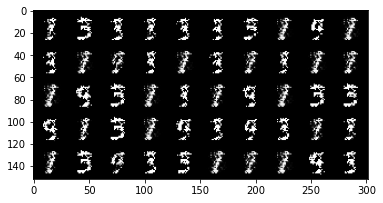

Iter: 33610/100000, Gen loss: 5.9899, Dis loss: 0.0378
Iter: 33620/100000, Gen loss: 5.6653, Dis loss: 0.0761
Iter: 33630/100000, Gen loss: 3.7409, Dis loss: 0.1827
Iter: 33640/100000, Gen loss: 5.9289, Dis loss: 0.0230
Iter: 33650/100000, Gen loss: 4.6387, Dis loss: 0.0734
Iter: 33660/100000, Gen loss: 5.2991, Dis loss: 0.0281
Iter: 33670/100000, Gen loss: 6.0540, Dis loss: 0.0752
Iter: 33680/100000, Gen loss: 5.1809, Dis loss: 0.0432
Iter: 33690/100000, Gen loss: 5.0547, Dis loss: 0.0456
Iter: 33700/100000, Gen loss: 4.7265, Dis loss: 0.0659
Iter: 33710/100000, Gen loss: 4.6416, Dis loss: 0.0557
Iter: 33720/100000, Gen loss: 4.6802, Dis loss: 0.1107
Iter: 33730/100000, Gen loss: 3.9662, Dis loss: 0.0958
Iter: 33740/100000, Gen loss: 4.2657, Dis loss: 0.0326
Iter: 33750/100000, Gen loss: 3.3495, Dis loss: 0.0887
Iter: 33760/100000, Gen loss: 4.2406, Dis loss: 0.0290
Iter: 33770/100000, Gen loss: 4.9030, Dis loss: 0.0791
Iter: 33780/100000, Gen loss: 4.7521, Dis loss: 0.0448
Iter: 3379

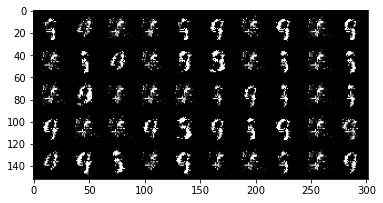

Iter: 33810/100000, Gen loss: 4.2508, Dis loss: 0.0895
Iter: 33820/100000, Gen loss: 5.0114, Dis loss: 0.0423
Iter: 33830/100000, Gen loss: 4.0698, Dis loss: 0.0690
Iter: 33840/100000, Gen loss: 5.0711, Dis loss: 0.0331
Iter: 33850/100000, Gen loss: 3.8342, Dis loss: 0.0750
Iter: 33860/100000, Gen loss: 5.7568, Dis loss: 0.0132
Iter: 33870/100000, Gen loss: 4.8875, Dis loss: 0.0289
Iter: 33880/100000, Gen loss: 4.6624, Dis loss: 0.0573
Iter: 33890/100000, Gen loss: 4.8212, Dis loss: 0.0250
Iter: 33900/100000, Gen loss: 4.5815, Dis loss: 0.0461
Iter: 33910/100000, Gen loss: 5.4669, Dis loss: 0.1495
Iter: 33920/100000, Gen loss: 5.1663, Dis loss: 0.0402
Iter: 33930/100000, Gen loss: 5.0370, Dis loss: 0.1029
Iter: 33940/100000, Gen loss: 5.0916, Dis loss: 0.0303
Iter: 33950/100000, Gen loss: 6.2461, Dis loss: 0.0479
Iter: 33960/100000, Gen loss: 5.4216, Dis loss: 0.0199
Iter: 33970/100000, Gen loss: 6.2066, Dis loss: 0.1893
Iter: 33980/100000, Gen loss: 6.4123, Dis loss: 0.0159
Iter: 3399

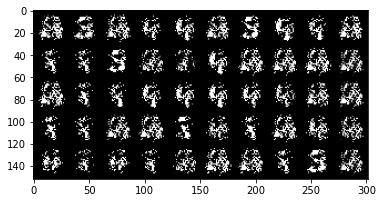

Iter: 34010/100000, Gen loss: 5.4782, Dis loss: 0.0255
Iter: 34020/100000, Gen loss: 7.1029, Dis loss: 0.0150
Iter: 34030/100000, Gen loss: 6.1888, Dis loss: 0.0089
Iter: 34040/100000, Gen loss: 5.7086, Dis loss: 0.0232
Iter: 34050/100000, Gen loss: 7.5229, Dis loss: 0.0055
Iter: 34060/100000, Gen loss: 5.5779, Dis loss: 0.0240
Iter: 34070/100000, Gen loss: 6.4684, Dis loss: 0.0182
Iter: 34080/100000, Gen loss: 6.6671, Dis loss: 0.0056
Iter: 34090/100000, Gen loss: 6.0720, Dis loss: 0.0459
Iter: 34100/100000, Gen loss: 7.7145, Dis loss: 0.0354
Iter: 34110/100000, Gen loss: 7.6415, Dis loss: 0.0063
Iter: 34120/100000, Gen loss: 7.3644, Dis loss: 0.0727
Iter: 34130/100000, Gen loss: 6.4837, Dis loss: 0.0046
Iter: 34140/100000, Gen loss: 7.2745, Dis loss: 0.0035
Iter: 34150/100000, Gen loss: 5.8274, Dis loss: 0.0784
Iter: 34160/100000, Gen loss: 7.8397, Dis loss: 0.0019
Iter: 34170/100000, Gen loss: 5.9596, Dis loss: 0.0104
Iter: 34180/100000, Gen loss: 6.8953, Dis loss: 0.0049
Iter: 3419

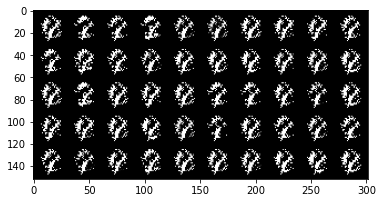

Iter: 34210/100000, Gen loss: 6.1081, Dis loss: 0.0066
Iter: 34220/100000, Gen loss: 5.3299, Dis loss: 0.0132
Iter: 34230/100000, Gen loss: 7.3165, Dis loss: 0.0072
Iter: 34240/100000, Gen loss: 6.3033, Dis loss: 0.0263
Iter: 34250/100000, Gen loss: 6.7144, Dis loss: 0.0259
Iter: 34260/100000, Gen loss: 5.2685, Dis loss: 0.0066
Iter: 34270/100000, Gen loss: 7.8879, Dis loss: 0.0012
Iter: 34280/100000, Gen loss: 7.2750, Dis loss: 0.0092
Iter: 34290/100000, Gen loss: 6.9696, Dis loss: 0.0067
Iter: 34300/100000, Gen loss: 6.3607, Dis loss: 0.0406
Iter: 34310/100000, Gen loss: 6.0502, Dis loss: 0.0227
Iter: 34320/100000, Gen loss: 6.7047, Dis loss: 0.0114
Iter: 34330/100000, Gen loss: 5.0564, Dis loss: 0.0369
Iter: 34340/100000, Gen loss: 6.2939, Dis loss: 0.0124
Iter: 34350/100000, Gen loss: 5.9844, Dis loss: 0.0129
Iter: 34360/100000, Gen loss: 5.9991, Dis loss: 0.0206
Iter: 34370/100000, Gen loss: 5.4773, Dis loss: 0.0155
Iter: 34380/100000, Gen loss: 6.1653, Dis loss: 0.0183
Iter: 3439

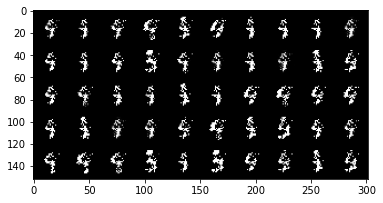

Iter: 34410/100000, Gen loss: 5.4738, Dis loss: 0.0432
Iter: 34420/100000, Gen loss: 6.1701, Dis loss: 0.0044
Iter: 34430/100000, Gen loss: 5.2908, Dis loss: 0.0557
Iter: 34440/100000, Gen loss: 4.2475, Dis loss: 0.0405
Iter: 34450/100000, Gen loss: 5.1100, Dis loss: 0.1450
Iter: 34460/100000, Gen loss: 4.7312, Dis loss: 0.0325
Iter: 34470/100000, Gen loss: 6.2083, Dis loss: 0.0283
Iter: 34480/100000, Gen loss: 5.9225, Dis loss: 0.3060
Iter: 34490/100000, Gen loss: 5.6090, Dis loss: 0.0408
Iter: 34500/100000, Gen loss: 6.2419, Dis loss: 0.0395
Iter: 34510/100000, Gen loss: 4.6533, Dis loss: 0.0915
Iter: 34520/100000, Gen loss: 5.7809, Dis loss: 0.0410
Iter: 34530/100000, Gen loss: 5.5041, Dis loss: 0.0244
Iter: 34540/100000, Gen loss: 5.2606, Dis loss: 0.0821
Iter: 34550/100000, Gen loss: 6.4643, Dis loss: 0.0473
Iter: 34560/100000, Gen loss: 6.0590, Dis loss: 0.0586
Iter: 34570/100000, Gen loss: 5.2714, Dis loss: 0.0315
Iter: 34580/100000, Gen loss: 7.6490, Dis loss: 0.0088
Iter: 3459

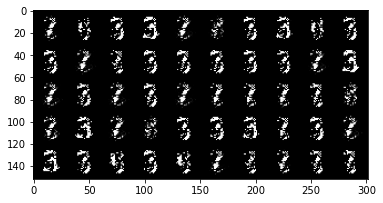

Iter: 34610/100000, Gen loss: 6.4533, Dis loss: 0.0641
Iter: 34620/100000, Gen loss: 5.7593, Dis loss: 0.0312
Iter: 34630/100000, Gen loss: 5.9403, Dis loss: 0.0403
Iter: 34640/100000, Gen loss: 5.9820, Dis loss: 0.0205
Iter: 34650/100000, Gen loss: 6.3892, Dis loss: 0.0141
Iter: 34660/100000, Gen loss: 7.2775, Dis loss: 0.2060
Iter: 34670/100000, Gen loss: 6.4366, Dis loss: 0.0255
Iter: 34680/100000, Gen loss: 5.0660, Dis loss: 0.0408
Iter: 34690/100000, Gen loss: 8.1355, Dis loss: 0.0157
Iter: 34700/100000, Gen loss: 6.0815, Dis loss: 0.0263
Iter: 34710/100000, Gen loss: 6.5753, Dis loss: 0.0078
Iter: 34720/100000, Gen loss: 5.3654, Dis loss: 0.0213
Iter: 34730/100000, Gen loss: 6.9194, Dis loss: 0.0051
Iter: 34740/100000, Gen loss: 6.4775, Dis loss: 0.0104
Iter: 34750/100000, Gen loss: 6.7925, Dis loss: 0.0087
Iter: 34760/100000, Gen loss: 6.5507, Dis loss: 0.0162
Iter: 34770/100000, Gen loss: 7.8056, Dis loss: 0.0041
Iter: 34780/100000, Gen loss: 6.9900, Dis loss: 0.0088
Iter: 3479

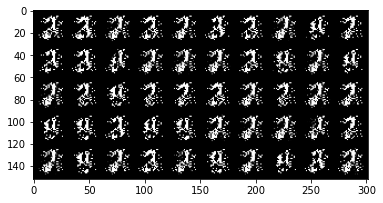

Iter: 34810/100000, Gen loss: 7.7353, Dis loss: 0.0030
Iter: 34820/100000, Gen loss: 5.3869, Dis loss: 0.0221
Iter: 34830/100000, Gen loss: 6.4968, Dis loss: 0.0074
Iter: 34840/100000, Gen loss: 6.5680, Dis loss: 0.1328
Iter: 34850/100000, Gen loss: 9.4067, Dis loss: 0.0484
Iter: 34860/100000, Gen loss: 7.4570, Dis loss: 0.0827
Iter: 34870/100000, Gen loss: 6.0805, Dis loss: 0.0339
Iter: 34880/100000, Gen loss: 6.1092, Dis loss: 0.0958
Iter: 34890/100000, Gen loss: 5.4073, Dis loss: 0.0660
Iter: 34900/100000, Gen loss: 5.8769, Dis loss: 0.1597
Iter: 34910/100000, Gen loss: 6.0240, Dis loss: 0.1372
Iter: 34920/100000, Gen loss: 4.0359, Dis loss: 0.0752
Iter: 34930/100000, Gen loss: 5.6695, Dis loss: 0.0131
Iter: 34940/100000, Gen loss: 4.4376, Dis loss: 0.0407
Iter: 34950/100000, Gen loss: 4.4550, Dis loss: 0.0701
Iter: 34960/100000, Gen loss: 5.1633, Dis loss: 0.0571
Iter: 34970/100000, Gen loss: 4.5496, Dis loss: 0.0245
Iter: 34980/100000, Gen loss: 5.3559, Dis loss: 0.0298
Iter: 3499

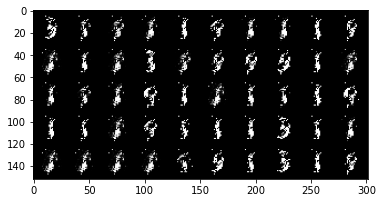

Iter: 35010/100000, Gen loss: 6.1672, Dis loss: 0.1056
Iter: 35020/100000, Gen loss: 4.7311, Dis loss: 0.0528
Iter: 35030/100000, Gen loss: 5.1834, Dis loss: 0.0121
Iter: 35040/100000, Gen loss: 5.1434, Dis loss: 0.0204
Iter: 35050/100000, Gen loss: 4.6959, Dis loss: 0.0620
Iter: 35060/100000, Gen loss: 5.1453, Dis loss: 0.0141
Iter: 35070/100000, Gen loss: 4.9545, Dis loss: 0.0509
Iter: 35080/100000, Gen loss: 5.7399, Dis loss: 0.0077
Iter: 35090/100000, Gen loss: 4.5896, Dis loss: 0.0668
Iter: 35100/100000, Gen loss: 6.3257, Dis loss: 0.0070
Iter: 35110/100000, Gen loss: 5.7221, Dis loss: 0.0150
Iter: 35120/100000, Gen loss: 4.9985, Dis loss: 0.0492
Iter: 35130/100000, Gen loss: 5.1816, Dis loss: 0.0186
Iter: 35140/100000, Gen loss: 5.4965, Dis loss: 0.0415
Iter: 35150/100000, Gen loss: 5.3875, Dis loss: 0.0499
Iter: 35160/100000, Gen loss: 6.9724, Dis loss: 0.0092
Iter: 35170/100000, Gen loss: 5.1048, Dis loss: 0.0276
Iter: 35180/100000, Gen loss: 6.0102, Dis loss: 0.0538
Iter: 3519

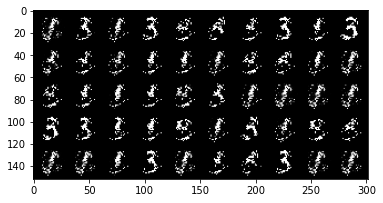

Iter: 35210/100000, Gen loss: 5.9929, Dis loss: 0.0119
Iter: 35220/100000, Gen loss: 5.6887, Dis loss: 0.0132
Iter: 35230/100000, Gen loss: 6.1692, Dis loss: 0.0221
Iter: 35240/100000, Gen loss: 5.5181, Dis loss: 0.0220
Iter: 35250/100000, Gen loss: 6.6965, Dis loss: 0.0044
Iter: 35260/100000, Gen loss: 6.2373, Dis loss: 0.0140
Iter: 35270/100000, Gen loss: 5.8076, Dis loss: 0.0120
Iter: 35280/100000, Gen loss: 6.1773, Dis loss: 0.0252
Iter: 35290/100000, Gen loss: 5.6843, Dis loss: 0.0245
Iter: 35300/100000, Gen loss: 5.6956, Dis loss: 0.0213
Iter: 35310/100000, Gen loss: 5.1996, Dis loss: 0.1127
Iter: 35320/100000, Gen loss: 5.8535, Dis loss: 0.0085
Iter: 35330/100000, Gen loss: 6.1829, Dis loss: 0.1010
Iter: 35340/100000, Gen loss: 6.0972, Dis loss: 0.0425
Iter: 35350/100000, Gen loss: 6.6785, Dis loss: 0.0493
Iter: 35360/100000, Gen loss: 5.9222, Dis loss: 0.0130
Iter: 35370/100000, Gen loss: 6.2186, Dis loss: 0.0798
Iter: 35380/100000, Gen loss: 6.6641, Dis loss: 0.0068
Iter: 3539

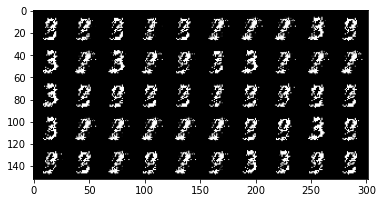

Iter: 35410/100000, Gen loss: 6.0960, Dis loss: 0.0219
Iter: 35420/100000, Gen loss: 7.0131, Dis loss: 0.0028
Iter: 35430/100000, Gen loss: 5.7546, Dis loss: 0.0490
Iter: 35440/100000, Gen loss: 6.6995, Dis loss: 0.0040
Iter: 35450/100000, Gen loss: 5.3973, Dis loss: 0.0058
Iter: 35460/100000, Gen loss: 7.4185, Dis loss: 0.0031
Iter: 35470/100000, Gen loss: 7.1910, Dis loss: 0.0026
Iter: 35480/100000, Gen loss: 6.0747, Dis loss: 0.0063
Iter: 35490/100000, Gen loss: 6.4758, Dis loss: 0.0032
Iter: 35500/100000, Gen loss: 7.7089, Dis loss: 0.0156
Iter: 35510/100000, Gen loss: 6.6386, Dis loss: 0.0054
Iter: 35520/100000, Gen loss: 7.9205, Dis loss: 0.0028
Iter: 35530/100000, Gen loss: 5.7608, Dis loss: 0.0070
Iter: 35540/100000, Gen loss: 7.8051, Dis loss: 0.0146
Iter: 35550/100000, Gen loss: 5.5763, Dis loss: 0.0102
Iter: 35560/100000, Gen loss: 6.1223, Dis loss: 0.0083
Iter: 35570/100000, Gen loss: 6.8963, Dis loss: 0.0119
Iter: 35580/100000, Gen loss: 6.1092, Dis loss: 0.1100
Iter: 3559

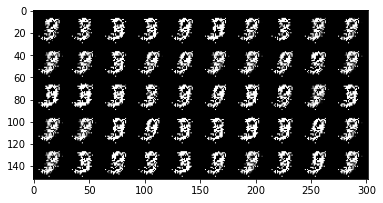

Iter: 35610/100000, Gen loss: 5.5893, Dis loss: 0.0072
Iter: 35620/100000, Gen loss: 7.0507, Dis loss: 0.0132
Iter: 35630/100000, Gen loss: 6.0779, Dis loss: 0.0081
Iter: 35640/100000, Gen loss: 6.3421, Dis loss: 0.0111
Iter: 35650/100000, Gen loss: 7.4451, Dis loss: 0.0177
Iter: 35660/100000, Gen loss: 6.7820, Dis loss: 0.0072
Iter: 35670/100000, Gen loss: 5.9390, Dis loss: 0.0211
Iter: 35680/100000, Gen loss: 6.5629, Dis loss: 0.0328
Iter: 35690/100000, Gen loss: 6.2442, Dis loss: 0.0158
Iter: 35700/100000, Gen loss: 6.5281, Dis loss: 0.0063
Iter: 35710/100000, Gen loss: 6.5973, Dis loss: 0.0288
Iter: 35720/100000, Gen loss: 7.3988, Dis loss: 0.0078
Iter: 35730/100000, Gen loss: 5.0001, Dis loss: 0.0399
Iter: 35740/100000, Gen loss: 6.1046, Dis loss: 0.0204
Iter: 35750/100000, Gen loss: 7.0296, Dis loss: 0.0084
Iter: 35760/100000, Gen loss: 6.8539, Dis loss: 0.0067
Iter: 35770/100000, Gen loss: 6.0477, Dis loss: 0.0177
Iter: 35780/100000, Gen loss: 6.5276, Dis loss: 0.0146
Iter: 3579

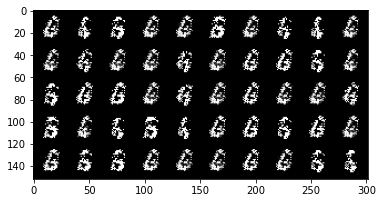

Iter: 35810/100000, Gen loss: 6.6323, Dis loss: 0.0162
Iter: 35820/100000, Gen loss: 6.3870, Dis loss: 0.0143
Iter: 35830/100000, Gen loss: 5.4829, Dis loss: 0.0152
Iter: 35840/100000, Gen loss: 6.0540, Dis loss: 0.0177
Iter: 35850/100000, Gen loss: 5.5941, Dis loss: 0.0288
Iter: 35860/100000, Gen loss: 5.8711, Dis loss: 0.0113
Iter: 35870/100000, Gen loss: 5.7733, Dis loss: 0.0056
Iter: 35880/100000, Gen loss: 5.3262, Dis loss: 0.0113
Iter: 35890/100000, Gen loss: 6.8210, Dis loss: 0.0328
Iter: 35900/100000, Gen loss: 6.3983, Dis loss: 0.0225
Iter: 35910/100000, Gen loss: 4.8394, Dis loss: 0.0180
Iter: 35920/100000, Gen loss: 7.1627, Dis loss: 0.0334
Iter: 35930/100000, Gen loss: 5.1924, Dis loss: 0.0116
Iter: 35940/100000, Gen loss: 5.8450, Dis loss: 0.0096
Iter: 35950/100000, Gen loss: 5.6539, Dis loss: 0.0081
Iter: 35960/100000, Gen loss: 5.2111, Dis loss: 0.0172
Iter: 35970/100000, Gen loss: 6.4560, Dis loss: 0.0076
Iter: 35980/100000, Gen loss: 4.8861, Dis loss: 0.0544
Iter: 3599

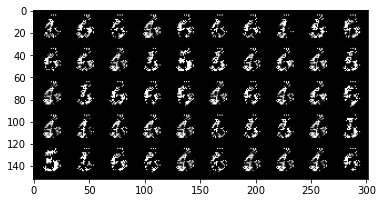

Iter: 36010/100000, Gen loss: 6.7710, Dis loss: 0.0366
Iter: 36020/100000, Gen loss: 6.6018, Dis loss: 0.0068
Iter: 36030/100000, Gen loss: 6.2931, Dis loss: 0.0291
Iter: 36040/100000, Gen loss: 5.8826, Dis loss: 0.0172
Iter: 36050/100000, Gen loss: 5.9140, Dis loss: 0.0115
Iter: 36060/100000, Gen loss: 4.9862, Dis loss: 0.0245
Iter: 36070/100000, Gen loss: 7.1287, Dis loss: 0.0119
Iter: 36080/100000, Gen loss: 5.1212, Dis loss: 0.0167
Iter: 36090/100000, Gen loss: 5.3614, Dis loss: 0.0158
Iter: 36100/100000, Gen loss: 3.9775, Dis loss: 0.0368
Iter: 36110/100000, Gen loss: 7.1711, Dis loss: 0.0214
Iter: 36120/100000, Gen loss: 4.4008, Dis loss: 0.0458
Iter: 36130/100000, Gen loss: 6.2689, Dis loss: 0.0079
Iter: 36140/100000, Gen loss: 4.5933, Dis loss: 0.0255
Iter: 36150/100000, Gen loss: 5.5563, Dis loss: 0.0175
Iter: 36160/100000, Gen loss: 4.9592, Dis loss: 0.0355
Iter: 36170/100000, Gen loss: 4.2419, Dis loss: 0.0735
Iter: 36180/100000, Gen loss: 5.2048, Dis loss: 0.0144
Iter: 3619

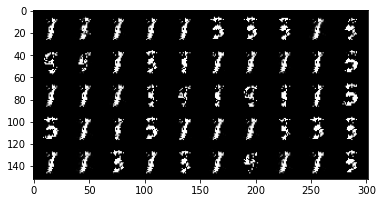

Iter: 36210/100000, Gen loss: 5.2037, Dis loss: 0.0270
Iter: 36220/100000, Gen loss: 5.0941, Dis loss: 0.0102
Iter: 36230/100000, Gen loss: 5.3627, Dis loss: 0.0198
Iter: 36240/100000, Gen loss: 4.3396, Dis loss: 0.0201
Iter: 36250/100000, Gen loss: 4.6262, Dis loss: 0.0419
Iter: 36260/100000, Gen loss: 6.0770, Dis loss: 0.0100
Iter: 36270/100000, Gen loss: 4.9847, Dis loss: 0.0068
Iter: 36280/100000, Gen loss: 6.4622, Dis loss: 0.0323
Iter: 36290/100000, Gen loss: 4.8847, Dis loss: 0.0317
Iter: 36300/100000, Gen loss: 6.0903, Dis loss: 0.0161
Iter: 36310/100000, Gen loss: 5.5891, Dis loss: 0.0145
Iter: 36320/100000, Gen loss: 5.2256, Dis loss: 0.0270
Iter: 36330/100000, Gen loss: 6.4850, Dis loss: 0.0026
Iter: 36340/100000, Gen loss: 6.1714, Dis loss: 0.0153
Iter: 36350/100000, Gen loss: 5.6472, Dis loss: 0.0116
Iter: 36360/100000, Gen loss: 5.9890, Dis loss: 0.0088
Iter: 36370/100000, Gen loss: 6.0013, Dis loss: 0.0600
Iter: 36380/100000, Gen loss: 5.4546, Dis loss: 0.0886
Iter: 3639

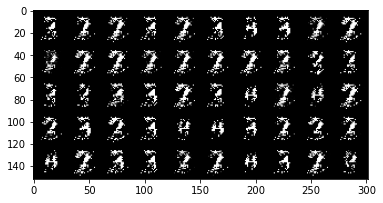

Iter: 36410/100000, Gen loss: 6.6138, Dis loss: 0.0122
Iter: 36420/100000, Gen loss: 6.0053, Dis loss: 0.1177
Iter: 36430/100000, Gen loss: 6.8785, Dis loss: 0.0257
Iter: 36440/100000, Gen loss: 5.9619, Dis loss: 0.0218
Iter: 36450/100000, Gen loss: 6.3962, Dis loss: 0.0113
Iter: 36460/100000, Gen loss: 6.3968, Dis loss: 0.0916
Iter: 36470/100000, Gen loss: 6.6830, Dis loss: 0.0169
Iter: 36480/100000, Gen loss: 6.9565, Dis loss: 0.0254
Iter: 36490/100000, Gen loss: 6.8568, Dis loss: 0.0440
Iter: 36500/100000, Gen loss: 5.9150, Dis loss: 0.0236
Iter: 36510/100000, Gen loss: 5.1049, Dis loss: 0.0856
Iter: 36520/100000, Gen loss: 5.9623, Dis loss: 0.0476
Iter: 36530/100000, Gen loss: 6.4415, Dis loss: 0.0091
Iter: 36540/100000, Gen loss: 5.3720, Dis loss: 0.0890
Iter: 36550/100000, Gen loss: 5.5894, Dis loss: 0.0751
Iter: 36560/100000, Gen loss: 6.6942, Dis loss: 0.0313
Iter: 36570/100000, Gen loss: 4.8979, Dis loss: 0.1533
Iter: 36580/100000, Gen loss: 6.0162, Dis loss: 0.0329
Iter: 3659

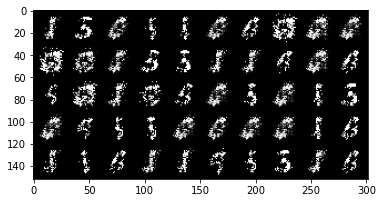

Iter: 36610/100000, Gen loss: 5.2136, Dis loss: 0.0453
Iter: 36620/100000, Gen loss: 5.5156, Dis loss: 0.0491
Iter: 36630/100000, Gen loss: 6.2008, Dis loss: 0.1338
Iter: 36640/100000, Gen loss: 6.6187, Dis loss: 0.0972
Iter: 36650/100000, Gen loss: 6.2130, Dis loss: 0.1387
Iter: 36660/100000, Gen loss: 6.0042, Dis loss: 0.0799
Iter: 36670/100000, Gen loss: 7.2888, Dis loss: 0.2518
Iter: 36680/100000, Gen loss: 5.7133, Dis loss: 0.0460
Iter: 36690/100000, Gen loss: 5.8207, Dis loss: 0.0470
Iter: 36700/100000, Gen loss: 6.4538, Dis loss: 0.1226
Iter: 36710/100000, Gen loss: 5.9745, Dis loss: 0.0737
Iter: 36720/100000, Gen loss: 5.7417, Dis loss: 0.0383
Iter: 36730/100000, Gen loss: 5.5533, Dis loss: 0.0206
Iter: 36740/100000, Gen loss: 5.5520, Dis loss: 0.0661
Iter: 36750/100000, Gen loss: 5.4573, Dis loss: 0.0250
Iter: 36760/100000, Gen loss: 4.9447, Dis loss: 0.0455
Iter: 36770/100000, Gen loss: 4.9287, Dis loss: 0.0310
Iter: 36780/100000, Gen loss: 5.1815, Dis loss: 0.0421
Iter: 3679

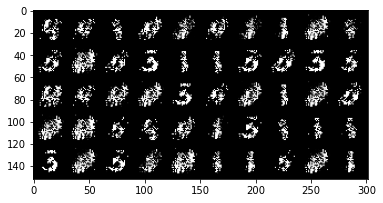

Iter: 36810/100000, Gen loss: 4.4698, Dis loss: 0.0978
Iter: 36820/100000, Gen loss: 6.1118, Dis loss: 0.0105
Iter: 36830/100000, Gen loss: 5.9625, Dis loss: 0.0274
Iter: 36840/100000, Gen loss: 6.7256, Dis loss: 0.0221
Iter: 36850/100000, Gen loss: 5.9593, Dis loss: 0.0471
Iter: 36860/100000, Gen loss: 5.5944, Dis loss: 0.0419
Iter: 36870/100000, Gen loss: 5.8017, Dis loss: 0.0137
Iter: 36880/100000, Gen loss: 6.1971, Dis loss: 0.0293
Iter: 36890/100000, Gen loss: 6.1743, Dis loss: 0.0280
Iter: 36900/100000, Gen loss: 4.8960, Dis loss: 0.0867
Iter: 36910/100000, Gen loss: 5.6227, Dis loss: 0.0737
Iter: 36920/100000, Gen loss: 5.2695, Dis loss: 0.0172
Iter: 36930/100000, Gen loss: 5.2281, Dis loss: 0.0542
Iter: 36940/100000, Gen loss: 4.7724, Dis loss: 0.0374
Iter: 36950/100000, Gen loss: 5.7942, Dis loss: 0.0244
Iter: 36960/100000, Gen loss: 5.3372, Dis loss: 0.0262
Iter: 36970/100000, Gen loss: 5.5356, Dis loss: 0.0397
Iter: 36980/100000, Gen loss: 5.6985, Dis loss: 0.0293
Iter: 3699

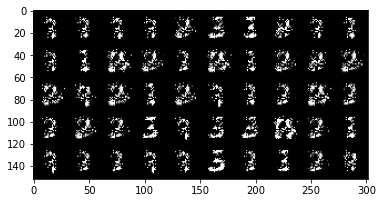

Iter: 37010/100000, Gen loss: 4.9846, Dis loss: 0.0322
Iter: 37020/100000, Gen loss: 5.8878, Dis loss: 0.0090
Iter: 37030/100000, Gen loss: 6.3115, Dis loss: 0.0083
Iter: 37040/100000, Gen loss: 5.5254, Dis loss: 0.0140
Iter: 37050/100000, Gen loss: 6.9823, Dis loss: 0.0031
Iter: 37060/100000, Gen loss: 5.9208, Dis loss: 0.0055
Iter: 37070/100000, Gen loss: 6.8994, Dis loss: 0.0110
Iter: 37080/100000, Gen loss: 5.9766, Dis loss: 0.0525
Iter: 37090/100000, Gen loss: 7.5051, Dis loss: 0.0123
Iter: 37100/100000, Gen loss: 6.0317, Dis loss: 0.0172
Iter: 37110/100000, Gen loss: 6.5181, Dis loss: 0.0483
Iter: 37120/100000, Gen loss: 6.8025, Dis loss: 0.0163
Iter: 37130/100000, Gen loss: 7.4630, Dis loss: 0.0088
Iter: 37140/100000, Gen loss: 6.8871, Dis loss: 0.0068
Iter: 37150/100000, Gen loss: 5.5816, Dis loss: 0.0188
Iter: 37160/100000, Gen loss: 5.7989, Dis loss: 0.0285
Iter: 37170/100000, Gen loss: 5.7588, Dis loss: 0.0187
Iter: 37180/100000, Gen loss: 6.5766, Dis loss: 0.0245
Iter: 3719

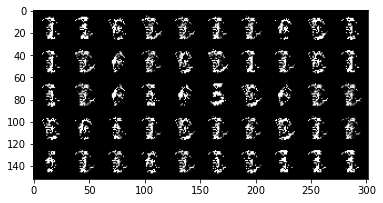

Iter: 37210/100000, Gen loss: 5.3739, Dis loss: 0.0168
Iter: 37220/100000, Gen loss: 6.2466, Dis loss: 0.0127
Iter: 37230/100000, Gen loss: 6.0643, Dis loss: 0.0203
Iter: 37240/100000, Gen loss: 5.0972, Dis loss: 0.0448
Iter: 37250/100000, Gen loss: 5.8316, Dis loss: 0.0083
Iter: 37260/100000, Gen loss: 4.2692, Dis loss: 0.0256
Iter: 37270/100000, Gen loss: 5.5061, Dis loss: 0.0604
Iter: 37280/100000, Gen loss: 5.1053, Dis loss: 0.0606
Iter: 37290/100000, Gen loss: 6.2947, Dis loss: 0.0065
Iter: 37300/100000, Gen loss: 4.8196, Dis loss: 0.0238
Iter: 37310/100000, Gen loss: 5.5049, Dis loss: 0.0123
Iter: 37320/100000, Gen loss: 5.8377, Dis loss: 0.0127
Iter: 37330/100000, Gen loss: 5.0277, Dis loss: 0.0259
Iter: 37340/100000, Gen loss: 5.2246, Dis loss: 0.0248
Iter: 37350/100000, Gen loss: 4.6791, Dis loss: 0.0350
Iter: 37360/100000, Gen loss: 5.8504, Dis loss: 0.0551
Iter: 37370/100000, Gen loss: 4.8604, Dis loss: 0.0424
Iter: 37380/100000, Gen loss: 5.1785, Dis loss: 0.0212
Iter: 3739

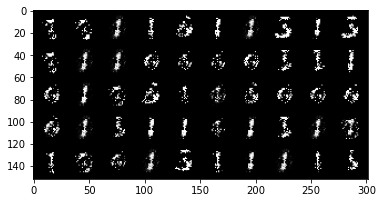

Iter: 37410/100000, Gen loss: 4.2387, Dis loss: 0.0406
Iter: 37420/100000, Gen loss: 5.7726, Dis loss: 0.0721
Iter: 37430/100000, Gen loss: 4.4281, Dis loss: 0.0318
Iter: 37440/100000, Gen loss: 5.4269, Dis loss: 0.0221
Iter: 37450/100000, Gen loss: 5.1515, Dis loss: 0.0194
Iter: 37460/100000, Gen loss: 5.7767, Dis loss: 0.0531
Iter: 37470/100000, Gen loss: 5.6278, Dis loss: 0.0185
Iter: 37480/100000, Gen loss: 6.5371, Dis loss: 0.0143
Iter: 37490/100000, Gen loss: 4.5823, Dis loss: 0.0276
Iter: 37500/100000, Gen loss: 5.9234, Dis loss: 0.0058
Iter: 37510/100000, Gen loss: 5.0233, Dis loss: 0.0141
Iter: 37520/100000, Gen loss: 5.4250, Dis loss: 0.0265
Iter: 37530/100000, Gen loss: 6.1093, Dis loss: 0.0097
Iter: 37540/100000, Gen loss: 5.4547, Dis loss: 0.0133
Iter: 37550/100000, Gen loss: 6.7076, Dis loss: 0.0183
Iter: 37560/100000, Gen loss: 5.2464, Dis loss: 0.0361
Iter: 37570/100000, Gen loss: 5.1209, Dis loss: 0.0432
Iter: 37580/100000, Gen loss: 6.1782, Dis loss: 0.0100
Iter: 3759

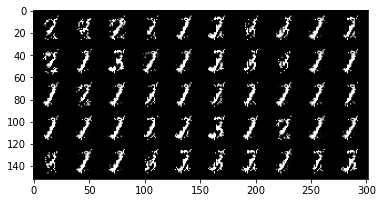

Iter: 37610/100000, Gen loss: 6.8901, Dis loss: 0.0036
Iter: 37620/100000, Gen loss: 5.3899, Dis loss: 0.0850
Iter: 37630/100000, Gen loss: 5.7514, Dis loss: 0.0196
Iter: 37640/100000, Gen loss: 7.3060, Dis loss: 0.0022
Iter: 37650/100000, Gen loss: 6.0408, Dis loss: 0.0102
Iter: 37660/100000, Gen loss: 5.9384, Dis loss: 0.0073
Iter: 37670/100000, Gen loss: 6.2253, Dis loss: 0.0140
Iter: 37680/100000, Gen loss: 6.3235, Dis loss: 0.0609
Iter: 37690/100000, Gen loss: 7.7025, Dis loss: 0.0038
Iter: 37700/100000, Gen loss: 8.0071, Dis loss: 0.0024
Iter: 37710/100000, Gen loss: 4.9404, Dis loss: 0.0159
Iter: 37720/100000, Gen loss: 6.0146, Dis loss: 0.0356
Iter: 37730/100000, Gen loss: 6.2453, Dis loss: 0.0183
Iter: 37740/100000, Gen loss: 5.3962, Dis loss: 0.0710
Iter: 37750/100000, Gen loss: 5.8196, Dis loss: 0.0266
Iter: 37760/100000, Gen loss: 5.0336, Dis loss: 0.0182
Iter: 37770/100000, Gen loss: 5.8563, Dis loss: 0.0670
Iter: 37780/100000, Gen loss: 5.4150, Dis loss: 0.0505
Iter: 3779

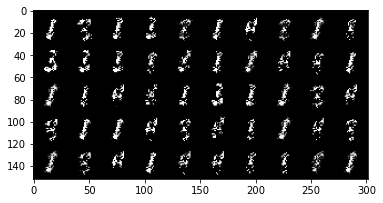

Iter: 37810/100000, Gen loss: 5.3675, Dis loss: 0.0371
Iter: 37820/100000, Gen loss: 4.8365, Dis loss: 0.0219
Iter: 37830/100000, Gen loss: 5.5451, Dis loss: 0.0561
Iter: 37840/100000, Gen loss: 4.9050, Dis loss: 0.0210
Iter: 37850/100000, Gen loss: 4.5038, Dis loss: 0.0456
Iter: 37860/100000, Gen loss: 4.8744, Dis loss: 0.1015
Iter: 37870/100000, Gen loss: 4.0560, Dis loss: 0.0520
Iter: 37880/100000, Gen loss: 4.8486, Dis loss: 0.0329
Iter: 37890/100000, Gen loss: 3.8296, Dis loss: 0.0559
Iter: 37900/100000, Gen loss: 5.0875, Dis loss: 0.0520
Iter: 37910/100000, Gen loss: 4.4872, Dis loss: 0.0339
Iter: 37920/100000, Gen loss: 4.1578, Dis loss: 0.0371
Iter: 37930/100000, Gen loss: 4.3597, Dis loss: 0.2638
Iter: 37940/100000, Gen loss: 5.3593, Dis loss: 0.0278
Iter: 37950/100000, Gen loss: 4.3632, Dis loss: 0.0842
Iter: 37960/100000, Gen loss: 6.1210, Dis loss: 0.0276
Iter: 37970/100000, Gen loss: 4.3803, Dis loss: 0.0802
Iter: 37980/100000, Gen loss: 5.6239, Dis loss: 0.0812
Iter: 3799

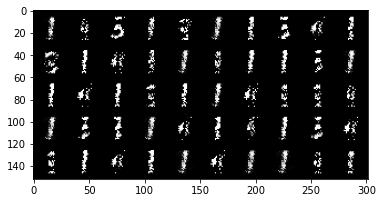

Iter: 38010/100000, Gen loss: 4.5860, Dis loss: 0.0561
Iter: 38020/100000, Gen loss: 6.3679, Dis loss: 0.0469
Iter: 38030/100000, Gen loss: 4.7153, Dis loss: 0.0569
Iter: 38040/100000, Gen loss: 4.9409, Dis loss: 0.0264
Iter: 38050/100000, Gen loss: 3.9322, Dis loss: 0.1376
Iter: 38060/100000, Gen loss: 5.0167, Dis loss: 0.0372
Iter: 38070/100000, Gen loss: 4.0094, Dis loss: 0.0812
Iter: 38080/100000, Gen loss: 4.2912, Dis loss: 0.0307
Iter: 38090/100000, Gen loss: 4.5559, Dis loss: 0.1430
Iter: 38100/100000, Gen loss: 5.1967, Dis loss: 0.0541
Iter: 38110/100000, Gen loss: 4.3651, Dis loss: 0.0413
Iter: 38120/100000, Gen loss: 4.0901, Dis loss: 0.0539
Iter: 38130/100000, Gen loss: 3.9366, Dis loss: 0.0776
Iter: 38140/100000, Gen loss: 4.7144, Dis loss: 0.1744
Iter: 38150/100000, Gen loss: 4.9859, Dis loss: 0.0799
Iter: 38160/100000, Gen loss: 4.5124, Dis loss: 0.0951
Iter: 38170/100000, Gen loss: 3.8624, Dis loss: 0.0598
Iter: 38180/100000, Gen loss: 4.9479, Dis loss: 0.0669
Iter: 3819

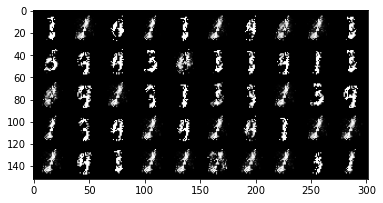

Iter: 38210/100000, Gen loss: 4.9414, Dis loss: 0.0622
Iter: 38220/100000, Gen loss: 5.3929, Dis loss: 0.0917
Iter: 38230/100000, Gen loss: 4.5713, Dis loss: 0.0456
Iter: 38240/100000, Gen loss: 4.7011, Dis loss: 0.1104
Iter: 38250/100000, Gen loss: 4.9982, Dis loss: 0.0312
Iter: 38260/100000, Gen loss: 5.2133, Dis loss: 0.0369
Iter: 38270/100000, Gen loss: 4.7024, Dis loss: 0.0416
Iter: 38280/100000, Gen loss: 4.4033, Dis loss: 0.0483
Iter: 38290/100000, Gen loss: 4.1707, Dis loss: 0.0568
Iter: 38300/100000, Gen loss: 4.6905, Dis loss: 0.0341
Iter: 38310/100000, Gen loss: 4.7729, Dis loss: 0.0155
Iter: 38320/100000, Gen loss: 4.1734, Dis loss: 0.0302
Iter: 38330/100000, Gen loss: 5.7523, Dis loss: 0.0359
Iter: 38340/100000, Gen loss: 4.7631, Dis loss: 0.0270
Iter: 38350/100000, Gen loss: 4.5931, Dis loss: 0.0347
Iter: 38360/100000, Gen loss: 5.3084, Dis loss: 0.0508
Iter: 38370/100000, Gen loss: 4.1976, Dis loss: 0.0790
Iter: 38380/100000, Gen loss: 4.5056, Dis loss: 0.0475
Iter: 3839

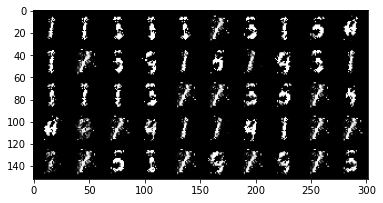

Iter: 38410/100000, Gen loss: 3.9552, Dis loss: 0.0757
Iter: 38420/100000, Gen loss: 5.2344, Dis loss: 0.0707
Iter: 38430/100000, Gen loss: 5.1238, Dis loss: 0.0425
Iter: 38440/100000, Gen loss: 3.8133, Dis loss: 0.1106
Iter: 38450/100000, Gen loss: 4.1355, Dis loss: 0.0704
Iter: 38460/100000, Gen loss: 4.6498, Dis loss: 0.0557
Iter: 38470/100000, Gen loss: 4.4229, Dis loss: 0.0627
Iter: 38480/100000, Gen loss: 4.2855, Dis loss: 0.0527
Iter: 38490/100000, Gen loss: 4.2061, Dis loss: 0.0508
Iter: 38500/100000, Gen loss: 4.3605, Dis loss: 0.0789
Iter: 38510/100000, Gen loss: 3.9582, Dis loss: 0.0979
Iter: 38520/100000, Gen loss: 4.7794, Dis loss: 0.0577
Iter: 38530/100000, Gen loss: 4.3389, Dis loss: 0.0901
Iter: 38540/100000, Gen loss: 4.1830, Dis loss: 0.0529
Iter: 38550/100000, Gen loss: 3.3518, Dis loss: 0.1276
Iter: 38560/100000, Gen loss: 4.0164, Dis loss: 0.1531
Iter: 38570/100000, Gen loss: 3.6507, Dis loss: 0.1380
Iter: 38580/100000, Gen loss: 3.8871, Dis loss: 0.1308
Iter: 3859

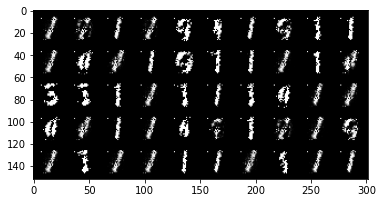

Iter: 38610/100000, Gen loss: 4.1419, Dis loss: 0.1520
Iter: 38620/100000, Gen loss: 5.6098, Dis loss: 0.0824
Iter: 38630/100000, Gen loss: 5.0121, Dis loss: 0.0689
Iter: 38640/100000, Gen loss: 4.4305, Dis loss: 0.0504
Iter: 38650/100000, Gen loss: 3.8161, Dis loss: 0.2106
Iter: 38660/100000, Gen loss: 4.0128, Dis loss: 0.0547
Iter: 38670/100000, Gen loss: 3.9714, Dis loss: 0.0358
Iter: 38680/100000, Gen loss: 4.9047, Dis loss: 0.1579
Iter: 38690/100000, Gen loss: 5.0728, Dis loss: 0.1007
Iter: 38700/100000, Gen loss: 3.0522, Dis loss: 0.0916
Iter: 38710/100000, Gen loss: 5.4541, Dis loss: 0.2002
Iter: 38720/100000, Gen loss: 4.3508, Dis loss: 0.0476
Iter: 38730/100000, Gen loss: 4.0683, Dis loss: 0.1196
Iter: 38740/100000, Gen loss: 5.3294, Dis loss: 0.0381
Iter: 38750/100000, Gen loss: 3.6155, Dis loss: 0.0412
Iter: 38760/100000, Gen loss: 4.6922, Dis loss: 0.0790
Iter: 38770/100000, Gen loss: 3.8322, Dis loss: 0.0477
Iter: 38780/100000, Gen loss: 4.9676, Dis loss: 0.0231
Iter: 3879

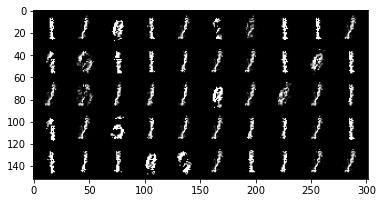

Iter: 38810/100000, Gen loss: 4.2713, Dis loss: 0.1106
Iter: 38820/100000, Gen loss: 4.4120, Dis loss: 0.0353
Iter: 38830/100000, Gen loss: 3.9180, Dis loss: 0.1218
Iter: 38840/100000, Gen loss: 3.8879, Dis loss: 0.1068
Iter: 38850/100000, Gen loss: 4.6201, Dis loss: 0.2003
Iter: 38860/100000, Gen loss: 3.4894, Dis loss: 0.1533
Iter: 38870/100000, Gen loss: 3.4653, Dis loss: 0.3049
Iter: 38880/100000, Gen loss: 4.3004, Dis loss: 0.3375
Iter: 38890/100000, Gen loss: 3.2820, Dis loss: 0.1162
Iter: 38900/100000, Gen loss: 4.1791, Dis loss: 0.1011
Iter: 38910/100000, Gen loss: 3.7212, Dis loss: 0.0531
Iter: 38920/100000, Gen loss: 3.3738, Dis loss: 0.1138
Iter: 38930/100000, Gen loss: 3.6819, Dis loss: 0.1327
Iter: 38940/100000, Gen loss: 3.5146, Dis loss: 0.1400
Iter: 38950/100000, Gen loss: 2.9348, Dis loss: 0.3591
Iter: 38960/100000, Gen loss: 4.1801, Dis loss: 0.2283
Iter: 38970/100000, Gen loss: 4.9268, Dis loss: 0.2117
Iter: 38980/100000, Gen loss: 3.5585, Dis loss: 0.0746
Iter: 3899

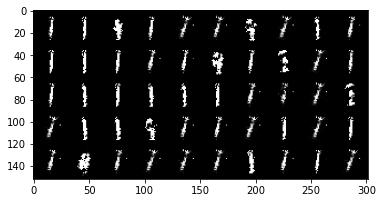

Iter: 39010/100000, Gen loss: 4.0903, Dis loss: 0.0822
Iter: 39020/100000, Gen loss: 3.7461, Dis loss: 0.1113
Iter: 39030/100000, Gen loss: 4.7296, Dis loss: 0.1596
Iter: 39040/100000, Gen loss: 3.7873, Dis loss: 0.0868
Iter: 39050/100000, Gen loss: 3.7738, Dis loss: 0.1080
Iter: 39060/100000, Gen loss: 3.9504, Dis loss: 0.0672
Iter: 39070/100000, Gen loss: 3.6643, Dis loss: 0.0978
Iter: 39080/100000, Gen loss: 3.4724, Dis loss: 0.0869
Iter: 39090/100000, Gen loss: 4.2131, Dis loss: 0.1683
Iter: 39100/100000, Gen loss: 4.3261, Dis loss: 0.0711
Iter: 39110/100000, Gen loss: 4.6601, Dis loss: 0.0333
Iter: 39120/100000, Gen loss: 4.3956, Dis loss: 0.0852
Iter: 39130/100000, Gen loss: 4.7531, Dis loss: 0.0520
Iter: 39140/100000, Gen loss: 4.1132, Dis loss: 0.1008
Iter: 39150/100000, Gen loss: 4.3243, Dis loss: 0.0526
Iter: 39160/100000, Gen loss: 3.6902, Dis loss: 0.0975
Iter: 39170/100000, Gen loss: 4.9944, Dis loss: 0.0575
Iter: 39180/100000, Gen loss: 3.8702, Dis loss: 0.0544
Iter: 3919

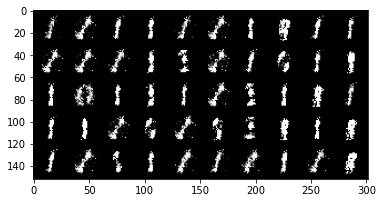

Iter: 39210/100000, Gen loss: 3.8928, Dis loss: 0.0499
Iter: 39220/100000, Gen loss: 5.3336, Dis loss: 0.1133
Iter: 39230/100000, Gen loss: 4.2116, Dis loss: 0.0683
Iter: 39240/100000, Gen loss: 4.4719, Dis loss: 0.0634
Iter: 39250/100000, Gen loss: 3.9523, Dis loss: 0.0671
Iter: 39260/100000, Gen loss: 4.4473, Dis loss: 0.1853
Iter: 39270/100000, Gen loss: 5.1363, Dis loss: 0.0458
Iter: 39280/100000, Gen loss: 4.4680, Dis loss: 0.0425
Iter: 39290/100000, Gen loss: 4.3406, Dis loss: 0.0515
Iter: 39300/100000, Gen loss: 4.5632, Dis loss: 0.1420
Iter: 39310/100000, Gen loss: 5.2085, Dis loss: 0.0546
Iter: 39320/100000, Gen loss: 4.3343, Dis loss: 0.0287
Iter: 39330/100000, Gen loss: 4.1476, Dis loss: 0.1071
Iter: 39340/100000, Gen loss: 5.4247, Dis loss: 0.0673
Iter: 39350/100000, Gen loss: 4.5613, Dis loss: 0.0906
Iter: 39360/100000, Gen loss: 4.8935, Dis loss: 0.0871
Iter: 39370/100000, Gen loss: 4.6018, Dis loss: 0.0826
Iter: 39380/100000, Gen loss: 4.3331, Dis loss: 0.1136
Iter: 3939

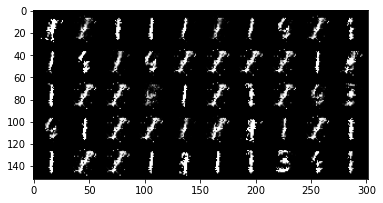

Iter: 39410/100000, Gen loss: 4.7336, Dis loss: 0.0745
Iter: 39420/100000, Gen loss: 4.1357, Dis loss: 0.0825
Iter: 39430/100000, Gen loss: 3.7521, Dis loss: 0.0926
Iter: 39440/100000, Gen loss: 4.2390, Dis loss: 0.0642
Iter: 39450/100000, Gen loss: 4.0195, Dis loss: 0.0617
Iter: 39460/100000, Gen loss: 3.7251, Dis loss: 0.1193
Iter: 39470/100000, Gen loss: 4.0210, Dis loss: 0.0361
Iter: 39480/100000, Gen loss: 3.7669, Dis loss: 0.1333
Iter: 39490/100000, Gen loss: 3.5473, Dis loss: 0.1541
Iter: 39500/100000, Gen loss: 4.5977, Dis loss: 0.0300
Iter: 39510/100000, Gen loss: 4.4227, Dis loss: 0.0430
Iter: 39520/100000, Gen loss: 4.3854, Dis loss: 0.0224
Iter: 39530/100000, Gen loss: 4.0665, Dis loss: 0.0460
Iter: 39540/100000, Gen loss: 4.5422, Dis loss: 0.0257
Iter: 39550/100000, Gen loss: 4.6064, Dis loss: 0.1216
Iter: 39560/100000, Gen loss: 4.2892, Dis loss: 0.0339
Iter: 39570/100000, Gen loss: 5.0043, Dis loss: 0.0263
Iter: 39580/100000, Gen loss: 4.5991, Dis loss: 0.1009
Iter: 3959

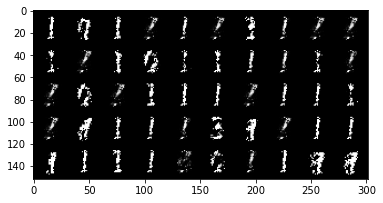

Iter: 39610/100000, Gen loss: 4.9549, Dis loss: 0.0511
Iter: 39620/100000, Gen loss: 5.5425, Dis loss: 0.0193
Iter: 39630/100000, Gen loss: 4.4667, Dis loss: 0.0262
Iter: 39640/100000, Gen loss: 4.8894, Dis loss: 0.0165
Iter: 39650/100000, Gen loss: 4.6390, Dis loss: 0.0771
Iter: 39660/100000, Gen loss: 4.1425, Dis loss: 0.0284
Iter: 39670/100000, Gen loss: 4.8118, Dis loss: 0.1211
Iter: 39680/100000, Gen loss: 4.5415, Dis loss: 0.2093
Iter: 39690/100000, Gen loss: 4.9394, Dis loss: 0.0433
Iter: 39700/100000, Gen loss: 4.1689, Dis loss: 0.0913
Iter: 39710/100000, Gen loss: 4.1266, Dis loss: 0.0364
Iter: 39720/100000, Gen loss: 3.9043, Dis loss: 0.1427
Iter: 39730/100000, Gen loss: 4.9794, Dis loss: 0.0310
Iter: 39740/100000, Gen loss: 3.4652, Dis loss: 0.3998
Iter: 39750/100000, Gen loss: 4.3696, Dis loss: 0.1311
Iter: 39760/100000, Gen loss: 4.0909, Dis loss: 0.1124
Iter: 39770/100000, Gen loss: 4.2831, Dis loss: 0.1125
Iter: 39780/100000, Gen loss: 4.1560, Dis loss: 0.1229
Iter: 3979

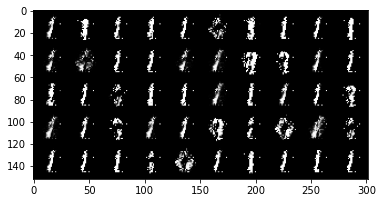

Iter: 39810/100000, Gen loss: 4.8932, Dis loss: 0.1283
Iter: 39820/100000, Gen loss: 4.5261, Dis loss: 0.1677
Iter: 39830/100000, Gen loss: 4.7319, Dis loss: 0.0376
Iter: 39840/100000, Gen loss: 4.8434, Dis loss: 0.0253
Iter: 39850/100000, Gen loss: 4.4264, Dis loss: 0.0656
Iter: 39860/100000, Gen loss: 3.5106, Dis loss: 0.2822
Iter: 39870/100000, Gen loss: 4.7982, Dis loss: 0.3090
Iter: 39880/100000, Gen loss: 4.9664, Dis loss: 0.1178
Iter: 39890/100000, Gen loss: 3.8274, Dis loss: 0.0354
Iter: 39900/100000, Gen loss: 4.4852, Dis loss: 0.0662
Iter: 39910/100000, Gen loss: 3.8974, Dis loss: 0.0849
Iter: 39920/100000, Gen loss: 5.2454, Dis loss: 0.0373
Iter: 39930/100000, Gen loss: 3.8308, Dis loss: 0.1358
Iter: 39940/100000, Gen loss: 4.1664, Dis loss: 0.0441
Iter: 39950/100000, Gen loss: 4.2965, Dis loss: 0.0421
Iter: 39960/100000, Gen loss: 3.7268, Dis loss: 0.2095
Iter: 39970/100000, Gen loss: 4.5603, Dis loss: 0.0773
Iter: 39980/100000, Gen loss: 4.4865, Dis loss: 0.0851
Iter: 3999

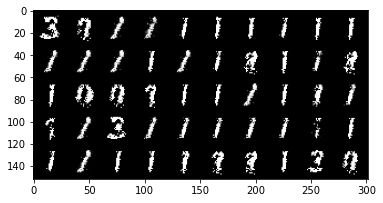

Iter: 40010/100000, Gen loss: 4.7614, Dis loss: 0.1415
Iter: 40020/100000, Gen loss: 4.6357, Dis loss: 0.0536
Iter: 40030/100000, Gen loss: 4.3837, Dis loss: 0.1269
Iter: 40040/100000, Gen loss: 4.7255, Dis loss: 0.0643
Iter: 40050/100000, Gen loss: 3.8762, Dis loss: 0.1716
Iter: 40060/100000, Gen loss: 4.2526, Dis loss: 0.0471
Iter: 40070/100000, Gen loss: 4.7217, Dis loss: 0.1576
Iter: 40080/100000, Gen loss: 3.7447, Dis loss: 0.0600
Iter: 40090/100000, Gen loss: 4.0012, Dis loss: 0.1146
Iter: 40100/100000, Gen loss: 4.9296, Dis loss: 0.0783
Iter: 40110/100000, Gen loss: 3.6654, Dis loss: 0.1763
Iter: 40120/100000, Gen loss: 4.1147, Dis loss: 0.0738
Iter: 40130/100000, Gen loss: 4.9065, Dis loss: 0.0707
Iter: 40140/100000, Gen loss: 4.1484, Dis loss: 0.0613
Iter: 40150/100000, Gen loss: 4.1320, Dis loss: 0.1561
Iter: 40160/100000, Gen loss: 4.4116, Dis loss: 0.1126
Iter: 40170/100000, Gen loss: 3.9793, Dis loss: 0.2122
Iter: 40180/100000, Gen loss: 4.0962, Dis loss: 0.0703
Iter: 4019

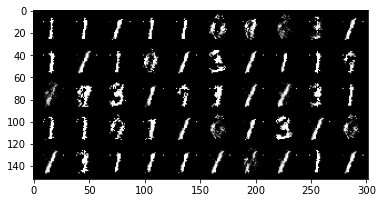

Iter: 40210/100000, Gen loss: 4.5689, Dis loss: 0.0459
Iter: 40220/100000, Gen loss: 3.1987, Dis loss: 0.1063
Iter: 40230/100000, Gen loss: 3.5737, Dis loss: 0.2767
Iter: 40240/100000, Gen loss: 3.3869, Dis loss: 0.2773
Iter: 40250/100000, Gen loss: 3.5525, Dis loss: 0.1334
Iter: 40260/100000, Gen loss: 4.6411, Dis loss: 0.0285
Iter: 40270/100000, Gen loss: 3.4045, Dis loss: 0.1155
Iter: 40280/100000, Gen loss: 4.7429, Dis loss: 0.1310
Iter: 40290/100000, Gen loss: 4.0331, Dis loss: 0.0796
Iter: 40300/100000, Gen loss: 4.4457, Dis loss: 0.1319
Iter: 40310/100000, Gen loss: 3.5156, Dis loss: 0.2446
Iter: 40320/100000, Gen loss: 3.8706, Dis loss: 0.0578
Iter: 40330/100000, Gen loss: 3.6707, Dis loss: 0.0695
Iter: 40340/100000, Gen loss: 3.4844, Dis loss: 0.0836
Iter: 40350/100000, Gen loss: 4.1308, Dis loss: 0.0333
Iter: 40360/100000, Gen loss: 4.0032, Dis loss: 0.1299
Iter: 40370/100000, Gen loss: 4.3299, Dis loss: 0.0607
Iter: 40380/100000, Gen loss: 3.3275, Dis loss: 0.0569
Iter: 4039

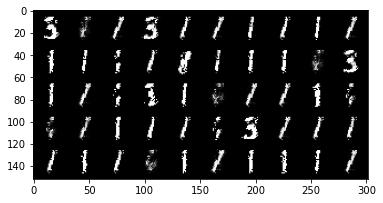

Iter: 40410/100000, Gen loss: 3.5825, Dis loss: 0.0852
Iter: 40420/100000, Gen loss: 3.8791, Dis loss: 0.1383
Iter: 40430/100000, Gen loss: 2.9602, Dis loss: 0.1936
Iter: 40440/100000, Gen loss: 4.7982, Dis loss: 0.0728
Iter: 40450/100000, Gen loss: 3.8362, Dis loss: 0.1319
Iter: 40460/100000, Gen loss: 3.9830, Dis loss: 0.0560
Iter: 40470/100000, Gen loss: 3.7177, Dis loss: 0.0559
Iter: 40480/100000, Gen loss: 3.9424, Dis loss: 0.0731
Iter: 40490/100000, Gen loss: 3.9215, Dis loss: 0.1001
Iter: 40500/100000, Gen loss: 3.7386, Dis loss: 0.0636
Iter: 40510/100000, Gen loss: 3.5121, Dis loss: 0.1054
Iter: 40520/100000, Gen loss: 3.8287, Dis loss: 0.1599
Iter: 40530/100000, Gen loss: 2.8880, Dis loss: 0.1946
Iter: 40540/100000, Gen loss: 4.6746, Dis loss: 0.0854
Iter: 40550/100000, Gen loss: 3.6460, Dis loss: 0.1940
Iter: 40560/100000, Gen loss: 3.3239, Dis loss: 0.0609
Iter: 40570/100000, Gen loss: 3.4036, Dis loss: 0.0476
Iter: 40580/100000, Gen loss: 3.7562, Dis loss: 0.1027
Iter: 4059

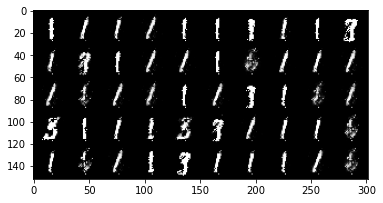

Iter: 40610/100000, Gen loss: 4.3920, Dis loss: 0.1449
Iter: 40620/100000, Gen loss: 3.9746, Dis loss: 0.0836
Iter: 40630/100000, Gen loss: 3.5903, Dis loss: 0.1565
Iter: 40640/100000, Gen loss: 4.1944, Dis loss: 0.1122
Iter: 40650/100000, Gen loss: 3.3618, Dis loss: 0.1257
Iter: 40660/100000, Gen loss: 3.9533, Dis loss: 0.1143
Iter: 40670/100000, Gen loss: 4.6329, Dis loss: 0.1082
Iter: 40680/100000, Gen loss: 2.4518, Dis loss: 0.3137
Iter: 40690/100000, Gen loss: 3.8607, Dis loss: 0.0847
Iter: 40700/100000, Gen loss: 2.7604, Dis loss: 0.1973
Iter: 40710/100000, Gen loss: 4.7780, Dis loss: 0.1056
Iter: 40720/100000, Gen loss: 4.1904, Dis loss: 0.0768
Iter: 40730/100000, Gen loss: 3.5831, Dis loss: 0.0704
Iter: 40740/100000, Gen loss: 4.5689, Dis loss: 0.0337
Iter: 40750/100000, Gen loss: 4.7170, Dis loss: 0.0724
Iter: 40760/100000, Gen loss: 3.9576, Dis loss: 0.0741
Iter: 40770/100000, Gen loss: 4.2158, Dis loss: 0.0918
Iter: 40780/100000, Gen loss: 3.9889, Dis loss: 0.1288
Iter: 4079

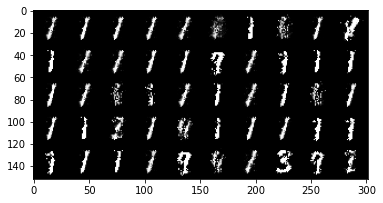

Iter: 40810/100000, Gen loss: 4.3946, Dis loss: 0.1534
Iter: 40820/100000, Gen loss: 3.7008, Dis loss: 0.1660
Iter: 40830/100000, Gen loss: 3.3234, Dis loss: 0.0509
Iter: 40840/100000, Gen loss: 4.5103, Dis loss: 0.0942
Iter: 40850/100000, Gen loss: 3.6996, Dis loss: 0.0383
Iter: 40860/100000, Gen loss: 4.0547, Dis loss: 0.1050
Iter: 40870/100000, Gen loss: 5.8226, Dis loss: 0.0846
Iter: 40880/100000, Gen loss: 4.5501, Dis loss: 0.0837
Iter: 40890/100000, Gen loss: 5.4458, Dis loss: 0.0594
Iter: 40900/100000, Gen loss: 3.7904, Dis loss: 0.0560
Iter: 40910/100000, Gen loss: 3.4900, Dis loss: 0.0731
Iter: 40920/100000, Gen loss: 4.6915, Dis loss: 0.0602
Iter: 40930/100000, Gen loss: 2.6969, Dis loss: 0.2834
Iter: 40940/100000, Gen loss: 4.7931, Dis loss: 0.2235
Iter: 40950/100000, Gen loss: 3.7034, Dis loss: 0.1091
Iter: 40960/100000, Gen loss: 3.4081, Dis loss: 0.1583
Iter: 40970/100000, Gen loss: 3.4373, Dis loss: 0.0977
Iter: 40980/100000, Gen loss: 3.6121, Dis loss: 0.1058
Iter: 4099

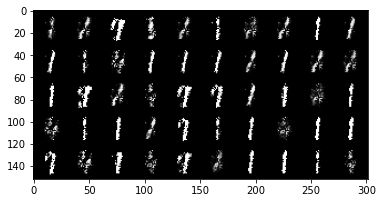

Iter: 41010/100000, Gen loss: 3.6955, Dis loss: 0.2405
Iter: 41020/100000, Gen loss: 3.5210, Dis loss: 0.2089
Iter: 41030/100000, Gen loss: 4.0118, Dis loss: 0.2556
Iter: 41040/100000, Gen loss: 3.2310, Dis loss: 0.1864
Iter: 41050/100000, Gen loss: 3.2231, Dis loss: 0.1721
Iter: 41060/100000, Gen loss: 3.9304, Dis loss: 0.1432
Iter: 41070/100000, Gen loss: 3.9825, Dis loss: 0.0538
Iter: 41080/100000, Gen loss: 3.6859, Dis loss: 0.0854
Iter: 41090/100000, Gen loss: 3.6144, Dis loss: 0.1607
Iter: 41100/100000, Gen loss: 4.3267, Dis loss: 0.2009
Iter: 41110/100000, Gen loss: 2.6452, Dis loss: 0.1862
Iter: 41120/100000, Gen loss: 4.7180, Dis loss: 0.0612
Iter: 41130/100000, Gen loss: 4.1438, Dis loss: 0.0511
Iter: 41140/100000, Gen loss: 4.5433, Dis loss: 0.1444
Iter: 41150/100000, Gen loss: 4.7525, Dis loss: 0.0649
Iter: 41160/100000, Gen loss: 3.9139, Dis loss: 0.1326
Iter: 41170/100000, Gen loss: 5.2068, Dis loss: 0.1642
Iter: 41180/100000, Gen loss: 4.9384, Dis loss: 0.0825
Iter: 4119

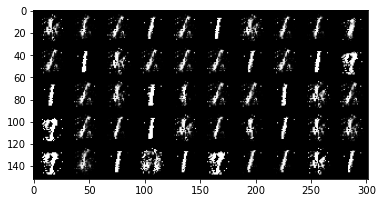

Iter: 41210/100000, Gen loss: 5.3041, Dis loss: 0.1660
Iter: 41220/100000, Gen loss: 3.8860, Dis loss: 0.1943
Iter: 41230/100000, Gen loss: 3.3035, Dis loss: 0.0695
Iter: 41240/100000, Gen loss: 4.5562, Dis loss: 0.1417
Iter: 41250/100000, Gen loss: 3.6987, Dis loss: 0.0969
Iter: 41260/100000, Gen loss: 3.4608, Dis loss: 0.0632
Iter: 41270/100000, Gen loss: 3.8527, Dis loss: 0.1545
Iter: 41280/100000, Gen loss: 4.7897, Dis loss: 0.1106
Iter: 41290/100000, Gen loss: 3.8037, Dis loss: 0.1193
Iter: 41300/100000, Gen loss: 4.9877, Dis loss: 0.1094
Iter: 41310/100000, Gen loss: 4.1354, Dis loss: 0.0572
Iter: 41320/100000, Gen loss: 4.4955, Dis loss: 0.1105
Iter: 41330/100000, Gen loss: 5.0090, Dis loss: 0.0730
Iter: 41340/100000, Gen loss: 3.7801, Dis loss: 0.0561
Iter: 41350/100000, Gen loss: 5.1218, Dis loss: 0.0933
Iter: 41360/100000, Gen loss: 4.3563, Dis loss: 0.0876
Iter: 41370/100000, Gen loss: 4.5375, Dis loss: 0.0661
Iter: 41380/100000, Gen loss: 4.0062, Dis loss: 0.0714
Iter: 4139

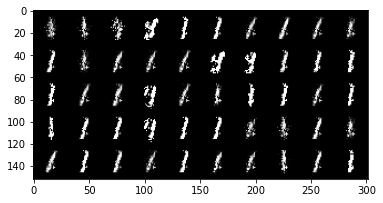

Iter: 41410/100000, Gen loss: 4.3085, Dis loss: 0.2043
Iter: 41420/100000, Gen loss: 3.9134, Dis loss: 0.1276
Iter: 41430/100000, Gen loss: 4.1652, Dis loss: 0.0780
Iter: 41440/100000, Gen loss: 3.9913, Dis loss: 0.1163
Iter: 41450/100000, Gen loss: 3.3176, Dis loss: 0.1687
Iter: 41460/100000, Gen loss: 3.4128, Dis loss: 0.1745
Iter: 41470/100000, Gen loss: 3.4271, Dis loss: 0.1426
Iter: 41480/100000, Gen loss: 3.2708, Dis loss: 0.1420
Iter: 41490/100000, Gen loss: 3.7358, Dis loss: 0.2929
Iter: 41500/100000, Gen loss: 3.9541, Dis loss: 0.2334
Iter: 41510/100000, Gen loss: 3.3412, Dis loss: 0.4138
Iter: 41520/100000, Gen loss: 4.3796, Dis loss: 0.1247
Iter: 41530/100000, Gen loss: 4.0029, Dis loss: 0.0868
Iter: 41540/100000, Gen loss: 3.4013, Dis loss: 0.1651
Iter: 41550/100000, Gen loss: 3.9579, Dis loss: 0.0713
Iter: 41560/100000, Gen loss: 3.2943, Dis loss: 0.1472
Iter: 41570/100000, Gen loss: 3.5691, Dis loss: 0.3578
Iter: 41580/100000, Gen loss: 4.0764, Dis loss: 0.2688
Iter: 4159

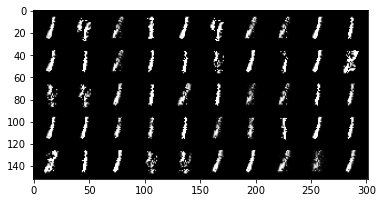

Iter: 41610/100000, Gen loss: 3.8503, Dis loss: 0.3535
Iter: 41620/100000, Gen loss: 3.5452, Dis loss: 0.1532
Iter: 41630/100000, Gen loss: 2.8445, Dis loss: 0.3614
Iter: 41640/100000, Gen loss: 3.0419, Dis loss: 0.2551
Iter: 41650/100000, Gen loss: 3.2294, Dis loss: 0.1158
Iter: 41660/100000, Gen loss: 3.0964, Dis loss: 0.1125
Iter: 41670/100000, Gen loss: 3.8302, Dis loss: 0.3944
Iter: 41680/100000, Gen loss: 3.2046, Dis loss: 0.1955
Iter: 41690/100000, Gen loss: 3.5075, Dis loss: 0.1934
Iter: 41700/100000, Gen loss: 3.8680, Dis loss: 0.1430
Iter: 41710/100000, Gen loss: 3.9198, Dis loss: 0.2781
Iter: 41720/100000, Gen loss: 2.9469, Dis loss: 0.1645
Iter: 41730/100000, Gen loss: 2.7403, Dis loss: 0.1271
Iter: 41740/100000, Gen loss: 4.1567, Dis loss: 0.1383
Iter: 41750/100000, Gen loss: 4.1113, Dis loss: 0.1017
Iter: 41760/100000, Gen loss: 3.4749, Dis loss: 0.1296
Iter: 41770/100000, Gen loss: 3.6988, Dis loss: 0.0787
Iter: 41780/100000, Gen loss: 2.8054, Dis loss: 0.1952
Iter: 4179

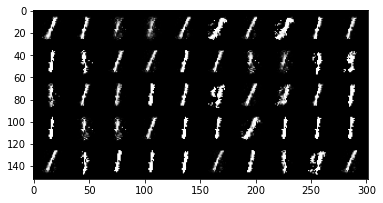

Iter: 41810/100000, Gen loss: 3.0101, Dis loss: 0.2999
Iter: 41820/100000, Gen loss: 3.3847, Dis loss: 0.3472
Iter: 41830/100000, Gen loss: 3.7254, Dis loss: 0.1060
Iter: 41840/100000, Gen loss: 2.6554, Dis loss: 0.3484
Iter: 41850/100000, Gen loss: 3.7567, Dis loss: 0.2934
Iter: 41860/100000, Gen loss: 3.3525, Dis loss: 0.1504
Iter: 41870/100000, Gen loss: 3.7103, Dis loss: 0.1189
Iter: 41880/100000, Gen loss: 3.1690, Dis loss: 0.1494
Iter: 41890/100000, Gen loss: 3.0197, Dis loss: 0.2337
Iter: 41900/100000, Gen loss: 3.6042, Dis loss: 0.2279
Iter: 41910/100000, Gen loss: 3.1104, Dis loss: 0.4262
Iter: 41920/100000, Gen loss: 3.2861, Dis loss: 0.1496
Iter: 41930/100000, Gen loss: 3.0885, Dis loss: 0.0811
Iter: 41940/100000, Gen loss: 3.3828, Dis loss: 0.1782
Iter: 41950/100000, Gen loss: 3.3022, Dis loss: 0.0747
Iter: 41960/100000, Gen loss: 3.9732, Dis loss: 0.2680
Iter: 41970/100000, Gen loss: 2.9080, Dis loss: 0.1772
Iter: 41980/100000, Gen loss: 3.2052, Dis loss: 0.1422
Iter: 4199

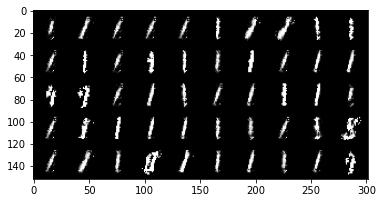

Iter: 42010/100000, Gen loss: 3.1884, Dis loss: 0.1187
Iter: 42020/100000, Gen loss: 2.6999, Dis loss: 0.1675
Iter: 42030/100000, Gen loss: 2.5322, Dis loss: 0.1256
Iter: 42040/100000, Gen loss: 3.5212, Dis loss: 0.5019
Iter: 42050/100000, Gen loss: 3.8025, Dis loss: 0.1398
Iter: 42060/100000, Gen loss: 2.7389, Dis loss: 0.2436
Iter: 42070/100000, Gen loss: 2.6115, Dis loss: 0.3015
Iter: 42080/100000, Gen loss: 4.4488, Dis loss: 0.1197
Iter: 42090/100000, Gen loss: 3.2338, Dis loss: 0.1136
Iter: 42100/100000, Gen loss: 2.9828, Dis loss: 0.2150
Iter: 42110/100000, Gen loss: 4.1052, Dis loss: 0.0666
Iter: 42120/100000, Gen loss: 2.6360, Dis loss: 0.1520
Iter: 42130/100000, Gen loss: 3.2922, Dis loss: 0.3647
Iter: 42140/100000, Gen loss: 3.3582, Dis loss: 0.0945
Iter: 42150/100000, Gen loss: 3.6038, Dis loss: 0.2257
Iter: 42160/100000, Gen loss: 3.0713, Dis loss: 0.2353
Iter: 42170/100000, Gen loss: 2.4211, Dis loss: 0.1788
Iter: 42180/100000, Gen loss: 3.6475, Dis loss: 0.3991
Iter: 4219

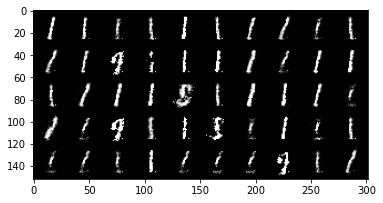

Iter: 42210/100000, Gen loss: 3.0422, Dis loss: 0.2113
Iter: 42220/100000, Gen loss: 3.1994, Dis loss: 0.1464
Iter: 42230/100000, Gen loss: 3.0850, Dis loss: 0.1842
Iter: 42240/100000, Gen loss: 3.4584, Dis loss: 0.1890
Iter: 42250/100000, Gen loss: 3.3238, Dis loss: 0.3484
Iter: 42260/100000, Gen loss: 2.9506, Dis loss: 0.1724
Iter: 42270/100000, Gen loss: 3.1759, Dis loss: 0.2680
Iter: 42280/100000, Gen loss: 3.5678, Dis loss: 0.4097
Iter: 42290/100000, Gen loss: 2.9188, Dis loss: 0.1351
Iter: 42300/100000, Gen loss: 3.5405, Dis loss: 0.3443
Iter: 42310/100000, Gen loss: 3.1257, Dis loss: 0.2325
Iter: 42320/100000, Gen loss: 2.8691, Dis loss: 0.1713
Iter: 42330/100000, Gen loss: 3.3558, Dis loss: 0.1195
Iter: 42340/100000, Gen loss: 3.0804, Dis loss: 0.3801
Iter: 42350/100000, Gen loss: 3.3205, Dis loss: 0.3330
Iter: 42360/100000, Gen loss: 2.9740, Dis loss: 0.1803
Iter: 42370/100000, Gen loss: 3.1750, Dis loss: 0.2093
Iter: 42380/100000, Gen loss: 2.8922, Dis loss: 0.3183
Iter: 4239

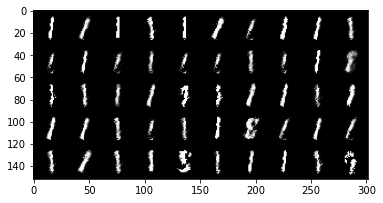

Iter: 42410/100000, Gen loss: 2.9245, Dis loss: 0.2244
Iter: 42420/100000, Gen loss: 2.4625, Dis loss: 0.4179
Iter: 42430/100000, Gen loss: 3.5878, Dis loss: 0.2605
Iter: 42440/100000, Gen loss: 3.1115, Dis loss: 0.1509
Iter: 42450/100000, Gen loss: 2.8768, Dis loss: 0.0736
Iter: 42460/100000, Gen loss: 3.2789, Dis loss: 0.2355
Iter: 42470/100000, Gen loss: 3.2927, Dis loss: 0.0968
Iter: 42480/100000, Gen loss: 2.9530, Dis loss: 0.2166
Iter: 42490/100000, Gen loss: 3.6642, Dis loss: 0.2410
Iter: 42500/100000, Gen loss: 2.8512, Dis loss: 0.2117
Iter: 42510/100000, Gen loss: 3.5461, Dis loss: 0.2074
Iter: 42520/100000, Gen loss: 3.1620, Dis loss: 0.1164
Iter: 42530/100000, Gen loss: 3.0434, Dis loss: 0.5475
Iter: 42540/100000, Gen loss: 3.6016, Dis loss: 0.1733
Iter: 42550/100000, Gen loss: 2.8477, Dis loss: 0.3144
Iter: 42560/100000, Gen loss: 2.5141, Dis loss: 0.2823
Iter: 42570/100000, Gen loss: 2.5818, Dis loss: 0.4596
Iter: 42580/100000, Gen loss: 3.6804, Dis loss: 0.1447
Iter: 4259

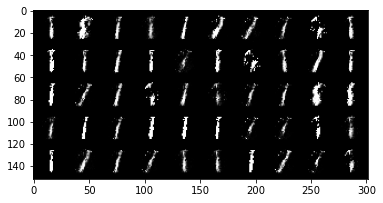

Iter: 42610/100000, Gen loss: 2.8699, Dis loss: 0.2748
Iter: 42620/100000, Gen loss: 3.1910, Dis loss: 0.2095
Iter: 42630/100000, Gen loss: 3.1329, Dis loss: 0.3216
Iter: 42640/100000, Gen loss: 3.6629, Dis loss: 0.1932
Iter: 42650/100000, Gen loss: 3.8365, Dis loss: 0.1352
Iter: 42660/100000, Gen loss: 3.4805, Dis loss: 0.1944
Iter: 42670/100000, Gen loss: 4.2722, Dis loss: 0.0549
Iter: 42680/100000, Gen loss: 2.9314, Dis loss: 0.3342
Iter: 42690/100000, Gen loss: 2.5536, Dis loss: 0.4986
Iter: 42700/100000, Gen loss: 3.0291, Dis loss: 0.2000
Iter: 42710/100000, Gen loss: 3.0384, Dis loss: 0.3228
Iter: 42720/100000, Gen loss: 3.3396, Dis loss: 0.2609
Iter: 42730/100000, Gen loss: 3.3757, Dis loss: 0.2968
Iter: 42740/100000, Gen loss: 2.8281, Dis loss: 0.4482
Iter: 42750/100000, Gen loss: 3.2332, Dis loss: 0.2166
Iter: 42760/100000, Gen loss: 3.1903, Dis loss: 0.3082
Iter: 42770/100000, Gen loss: 2.9851, Dis loss: 0.2861
Iter: 42780/100000, Gen loss: 2.9982, Dis loss: 0.2198
Iter: 4279

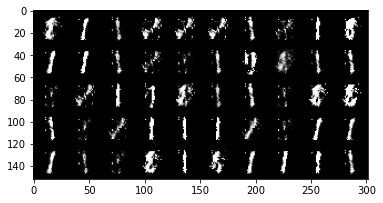

Iter: 42810/100000, Gen loss: 3.3850, Dis loss: 0.2268
Iter: 42820/100000, Gen loss: 3.4592, Dis loss: 0.2581
Iter: 42830/100000, Gen loss: 3.5247, Dis loss: 0.3286
Iter: 42840/100000, Gen loss: 3.0199, Dis loss: 0.2383
Iter: 42850/100000, Gen loss: 3.0941, Dis loss: 0.1696
Iter: 42860/100000, Gen loss: 3.9120, Dis loss: 0.1459
Iter: 42870/100000, Gen loss: 2.7344, Dis loss: 0.1995
Iter: 42880/100000, Gen loss: 3.4264, Dis loss: 0.1237
Iter: 42890/100000, Gen loss: 3.2491, Dis loss: 0.2319
Iter: 42900/100000, Gen loss: 2.9696, Dis loss: 0.3258
Iter: 42910/100000, Gen loss: 3.2674, Dis loss: 0.2742
Iter: 42920/100000, Gen loss: 3.4443, Dis loss: 0.1384
Iter: 42930/100000, Gen loss: 2.2856, Dis loss: 0.4523
Iter: 42940/100000, Gen loss: 3.1720, Dis loss: 0.5942
Iter: 42950/100000, Gen loss: 2.9561, Dis loss: 0.1556
Iter: 42960/100000, Gen loss: 2.3237, Dis loss: 0.2997
Iter: 42970/100000, Gen loss: 3.3807, Dis loss: 0.2484
Iter: 42980/100000, Gen loss: 3.5136, Dis loss: 0.4056
Iter: 4299

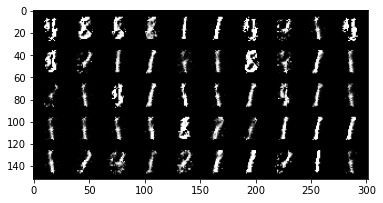

Iter: 43010/100000, Gen loss: 3.6961, Dis loss: 0.2123
Iter: 43020/100000, Gen loss: 3.0512, Dis loss: 0.3785
Iter: 43030/100000, Gen loss: 2.4117, Dis loss: 0.4661
Iter: 43040/100000, Gen loss: 3.1119, Dis loss: 0.4113
Iter: 43050/100000, Gen loss: 3.2886, Dis loss: 0.2513
Iter: 43060/100000, Gen loss: 2.6671, Dis loss: 0.5617
Iter: 43070/100000, Gen loss: 2.5806, Dis loss: 0.4177
Iter: 43080/100000, Gen loss: 2.7391, Dis loss: 0.3278
Iter: 43090/100000, Gen loss: 2.3152, Dis loss: 0.3528
Iter: 43100/100000, Gen loss: 3.5252, Dis loss: 0.1653
Iter: 43110/100000, Gen loss: 3.1934, Dis loss: 0.2942
Iter: 43120/100000, Gen loss: 2.8742, Dis loss: 0.1438
Iter: 43130/100000, Gen loss: 4.0543, Dis loss: 0.1672
Iter: 43140/100000, Gen loss: 2.7454, Dis loss: 0.4060
Iter: 43150/100000, Gen loss: 2.7076, Dis loss: 0.2990
Iter: 43160/100000, Gen loss: 3.2910, Dis loss: 0.2673
Iter: 43170/100000, Gen loss: 2.9034, Dis loss: 0.1559
Iter: 43180/100000, Gen loss: 3.2682, Dis loss: 0.1723
Iter: 4319

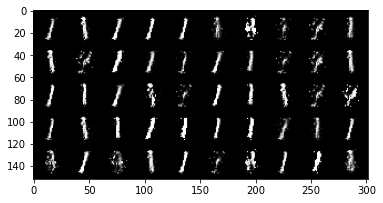

Iter: 43210/100000, Gen loss: 2.7767, Dis loss: 0.3684
Iter: 43220/100000, Gen loss: 2.9604, Dis loss: 0.2759
Iter: 43230/100000, Gen loss: 3.2837, Dis loss: 0.2879
Iter: 43240/100000, Gen loss: 2.3949, Dis loss: 0.3533
Iter: 43250/100000, Gen loss: 3.1413, Dis loss: 0.1561
Iter: 43260/100000, Gen loss: 3.7594, Dis loss: 0.2760
Iter: 43270/100000, Gen loss: 3.3085, Dis loss: 0.0929
Iter: 43280/100000, Gen loss: 3.1795, Dis loss: 0.2580
Iter: 43290/100000, Gen loss: 3.8399, Dis loss: 0.1488
Iter: 43300/100000, Gen loss: 4.1274, Dis loss: 0.1975
Iter: 43310/100000, Gen loss: 2.9406, Dis loss: 0.2706
Iter: 43320/100000, Gen loss: 3.5182, Dis loss: 0.1188
Iter: 43330/100000, Gen loss: 3.1493, Dis loss: 0.1458
Iter: 43340/100000, Gen loss: 3.6990, Dis loss: 0.2509
Iter: 43350/100000, Gen loss: 3.7463, Dis loss: 0.2565
Iter: 43360/100000, Gen loss: 3.1893, Dis loss: 0.1613
Iter: 43370/100000, Gen loss: 3.1571, Dis loss: 0.3605
Iter: 43380/100000, Gen loss: 3.3519, Dis loss: 0.3597
Iter: 4339

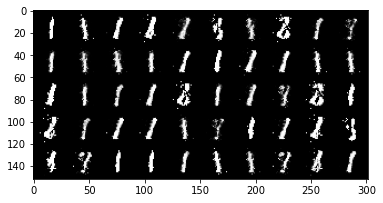

Iter: 43410/100000, Gen loss: 3.9296, Dis loss: 0.2859
Iter: 43420/100000, Gen loss: 3.5408, Dis loss: 0.0942
Iter: 43430/100000, Gen loss: 3.6526, Dis loss: 0.4756
Iter: 43440/100000, Gen loss: 3.8001, Dis loss: 0.1960
Iter: 43450/100000, Gen loss: 3.2975, Dis loss: 0.3028
Iter: 43460/100000, Gen loss: 3.0555, Dis loss: 0.1351
Iter: 43470/100000, Gen loss: 3.5687, Dis loss: 0.2437
Iter: 43480/100000, Gen loss: 2.5420, Dis loss: 0.2350
Iter: 43490/100000, Gen loss: 3.7566, Dis loss: 0.1373
Iter: 43500/100000, Gen loss: 2.7849, Dis loss: 0.3005
Iter: 43510/100000, Gen loss: 3.4769, Dis loss: 0.0816
Iter: 43520/100000, Gen loss: 3.1549, Dis loss: 0.1660
Iter: 43530/100000, Gen loss: 3.1976, Dis loss: 0.3931
Iter: 43540/100000, Gen loss: 3.3865, Dis loss: 0.0825
Iter: 43550/100000, Gen loss: 2.5405, Dis loss: 0.1429
Iter: 43560/100000, Gen loss: 3.2922, Dis loss: 0.3606
Iter: 43570/100000, Gen loss: 3.4689, Dis loss: 0.1354
Iter: 43580/100000, Gen loss: 2.7836, Dis loss: 0.2352
Iter: 4359

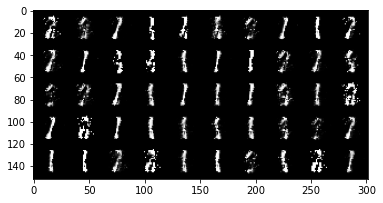

Iter: 43610/100000, Gen loss: 3.0118, Dis loss: 0.2209
Iter: 43620/100000, Gen loss: 3.3434, Dis loss: 0.1364
Iter: 43630/100000, Gen loss: 3.0783, Dis loss: 0.1697
Iter: 43640/100000, Gen loss: 3.7355, Dis loss: 0.5048
Iter: 43650/100000, Gen loss: 3.7596, Dis loss: 0.2711
Iter: 43660/100000, Gen loss: 3.2483, Dis loss: 0.8994
Iter: 43670/100000, Gen loss: 4.4964, Dis loss: 0.4637
Iter: 43680/100000, Gen loss: 3.4290, Dis loss: 0.3460
Iter: 43690/100000, Gen loss: 3.4466, Dis loss: 0.1378
Iter: 43700/100000, Gen loss: 3.5783, Dis loss: 0.1616
Iter: 43710/100000, Gen loss: 3.7229, Dis loss: 0.2225
Iter: 43720/100000, Gen loss: 3.9176, Dis loss: 0.2753
Iter: 43730/100000, Gen loss: 4.2750, Dis loss: 0.2110
Iter: 43740/100000, Gen loss: 3.7344, Dis loss: 0.1641
Iter: 43750/100000, Gen loss: 3.6049, Dis loss: 0.4050
Iter: 43760/100000, Gen loss: 4.5624, Dis loss: 0.1046
Iter: 43770/100000, Gen loss: 3.4958, Dis loss: 0.3720
Iter: 43780/100000, Gen loss: 3.4826, Dis loss: 0.2376
Iter: 4379

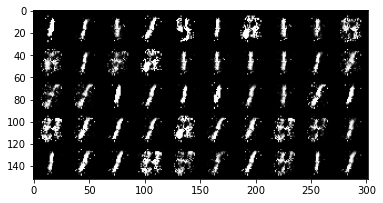

Iter: 43810/100000, Gen loss: 3.9125, Dis loss: 0.0802
Iter: 43820/100000, Gen loss: 3.6752, Dis loss: 0.1865
Iter: 43830/100000, Gen loss: 3.5087, Dis loss: 0.1858
Iter: 43840/100000, Gen loss: 4.2351, Dis loss: 0.1712
Iter: 43850/100000, Gen loss: 4.0840, Dis loss: 0.2031
Iter: 43860/100000, Gen loss: 3.3485, Dis loss: 0.2078
Iter: 43870/100000, Gen loss: 4.2405, Dis loss: 0.1046
Iter: 43880/100000, Gen loss: 3.8613, Dis loss: 0.1183
Iter: 43890/100000, Gen loss: 3.0062, Dis loss: 0.3026
Iter: 43900/100000, Gen loss: 3.8238, Dis loss: 0.3409
Iter: 43910/100000, Gen loss: 3.3694, Dis loss: 0.3315
Iter: 43920/100000, Gen loss: 3.7416, Dis loss: 0.2707
Iter: 43930/100000, Gen loss: 3.7160, Dis loss: 0.5014
Iter: 43940/100000, Gen loss: 3.7466, Dis loss: 0.1914
Iter: 43950/100000, Gen loss: 3.1532, Dis loss: 0.2494
Iter: 43960/100000, Gen loss: 3.8980, Dis loss: 0.1572
Iter: 43970/100000, Gen loss: 3.6004, Dis loss: 0.1835
Iter: 43980/100000, Gen loss: 3.3394, Dis loss: 0.1258
Iter: 4399

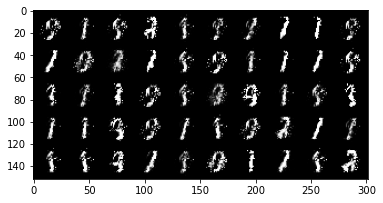

Iter: 44010/100000, Gen loss: 3.0650, Dis loss: 0.2776
Iter: 44020/100000, Gen loss: 2.9042, Dis loss: 0.1597
Iter: 44030/100000, Gen loss: 3.3261, Dis loss: 0.1502
Iter: 44040/100000, Gen loss: 2.5238, Dis loss: 0.3429
Iter: 44050/100000, Gen loss: 3.0991, Dis loss: 0.2020
Iter: 44060/100000, Gen loss: 3.3067, Dis loss: 0.1975
Iter: 44070/100000, Gen loss: 3.4206, Dis loss: 0.1336
Iter: 44080/100000, Gen loss: 3.2792, Dis loss: 0.1539
Iter: 44090/100000, Gen loss: 3.4326, Dis loss: 0.2139
Iter: 44100/100000, Gen loss: 3.6905, Dis loss: 0.2425
Iter: 44110/100000, Gen loss: 3.5988, Dis loss: 0.1368
Iter: 44120/100000, Gen loss: 3.2987, Dis loss: 0.2838
Iter: 44130/100000, Gen loss: 3.5099, Dis loss: 0.1616
Iter: 44140/100000, Gen loss: 2.9302, Dis loss: 0.1770
Iter: 44150/100000, Gen loss: 3.9900, Dis loss: 0.0898
Iter: 44160/100000, Gen loss: 3.9710, Dis loss: 0.2368
Iter: 44170/100000, Gen loss: 2.8446, Dis loss: 0.3380
Iter: 44180/100000, Gen loss: 3.5299, Dis loss: 0.2164
Iter: 4419

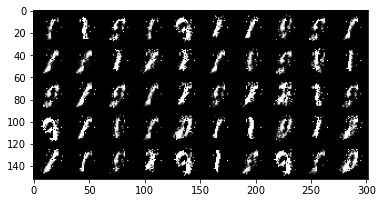

Iter: 44210/100000, Gen loss: 3.4538, Dis loss: 0.1729
Iter: 44220/100000, Gen loss: 4.7352, Dis loss: 0.2051
Iter: 44230/100000, Gen loss: 4.4968, Dis loss: 0.1355
Iter: 44240/100000, Gen loss: 3.7897, Dis loss: 0.3746
Iter: 44250/100000, Gen loss: 4.6516, Dis loss: 0.0972
Iter: 44260/100000, Gen loss: 4.0248, Dis loss: 0.1225
Iter: 44270/100000, Gen loss: 3.5018, Dis loss: 0.1529
Iter: 44280/100000, Gen loss: 3.3997, Dis loss: 0.0890
Iter: 44290/100000, Gen loss: 4.4705, Dis loss: 0.2175
Iter: 44300/100000, Gen loss: 3.9784, Dis loss: 0.1224
Iter: 44310/100000, Gen loss: 4.0120, Dis loss: 0.0607
Iter: 44320/100000, Gen loss: 3.7425, Dis loss: 0.2699
Iter: 44330/100000, Gen loss: 3.3130, Dis loss: 0.1302
Iter: 44340/100000, Gen loss: 3.5510, Dis loss: 0.2122
Iter: 44350/100000, Gen loss: 3.0989, Dis loss: 0.2041
Iter: 44360/100000, Gen loss: 3.3232, Dis loss: 0.3752
Iter: 44370/100000, Gen loss: 3.2021, Dis loss: 0.2064
Iter: 44380/100000, Gen loss: 3.1120, Dis loss: 0.2888
Iter: 4439

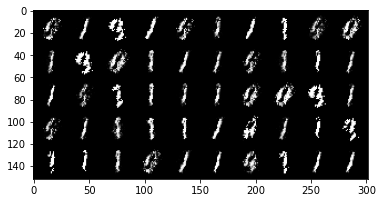

Iter: 44410/100000, Gen loss: 3.0614, Dis loss: 0.3993
Iter: 44420/100000, Gen loss: 3.6586, Dis loss: 0.4122
Iter: 44430/100000, Gen loss: 2.6549, Dis loss: 0.4711
Iter: 44440/100000, Gen loss: 2.6904, Dis loss: 0.2223
Iter: 44450/100000, Gen loss: 3.5241, Dis loss: 0.4645
Iter: 44460/100000, Gen loss: 3.0093, Dis loss: 0.1355
Iter: 44470/100000, Gen loss: 3.1334, Dis loss: 0.1472
Iter: 44480/100000, Gen loss: 3.7667, Dis loss: 0.2364
Iter: 44490/100000, Gen loss: 3.5683, Dis loss: 0.2547
Iter: 44500/100000, Gen loss: 2.5392, Dis loss: 0.2664
Iter: 44510/100000, Gen loss: 3.4218, Dis loss: 0.2806
Iter: 44520/100000, Gen loss: 3.0864, Dis loss: 0.2526
Iter: 44530/100000, Gen loss: 3.3415, Dis loss: 0.1348
Iter: 44540/100000, Gen loss: 3.4073, Dis loss: 0.1755
Iter: 44550/100000, Gen loss: 2.5685, Dis loss: 0.3012
Iter: 44560/100000, Gen loss: 3.7501, Dis loss: 0.1267
Iter: 44570/100000, Gen loss: 3.1644, Dis loss: 0.1033
Iter: 44580/100000, Gen loss: 2.9858, Dis loss: 0.2439
Iter: 4459

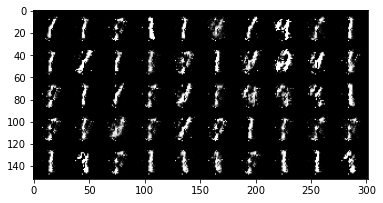

Iter: 44610/100000, Gen loss: 3.5815, Dis loss: 0.1649
Iter: 44620/100000, Gen loss: 4.1482, Dis loss: 0.1434
Iter: 44630/100000, Gen loss: 2.9619, Dis loss: 0.2359
Iter: 44640/100000, Gen loss: 3.1195, Dis loss: 0.1670
Iter: 44650/100000, Gen loss: 3.8240, Dis loss: 0.3241
Iter: 44660/100000, Gen loss: 4.5600, Dis loss: 0.1495
Iter: 44670/100000, Gen loss: 4.3480, Dis loss: 0.0922
Iter: 44680/100000, Gen loss: 5.1391, Dis loss: 0.0870
Iter: 44690/100000, Gen loss: 4.3554, Dis loss: 0.1632
Iter: 44700/100000, Gen loss: 3.6724, Dis loss: 0.1415
Iter: 44710/100000, Gen loss: 3.2186, Dis loss: 0.2295
Iter: 44720/100000, Gen loss: 3.4308, Dis loss: 0.0945
Iter: 44730/100000, Gen loss: 3.9604, Dis loss: 0.1339
Iter: 44740/100000, Gen loss: 3.4040, Dis loss: 0.1859
Iter: 44750/100000, Gen loss: 3.4772, Dis loss: 0.2017
Iter: 44760/100000, Gen loss: 3.2072, Dis loss: 0.2988
Iter: 44770/100000, Gen loss: 3.1715, Dis loss: 0.3337
Iter: 44780/100000, Gen loss: 3.2109, Dis loss: 0.1776
Iter: 4479

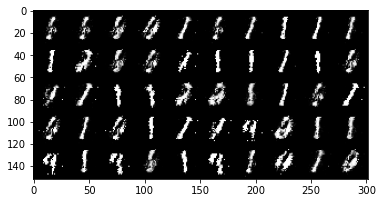

Iter: 44810/100000, Gen loss: 3.2612, Dis loss: 0.2592
Iter: 44820/100000, Gen loss: 3.0552, Dis loss: 0.1933
Iter: 44830/100000, Gen loss: 2.9851, Dis loss: 0.2154
Iter: 44840/100000, Gen loss: 2.9120, Dis loss: 0.1940
Iter: 44850/100000, Gen loss: 3.1377, Dis loss: 0.1404
Iter: 44860/100000, Gen loss: 2.9401, Dis loss: 0.1705
Iter: 44870/100000, Gen loss: 2.9548, Dis loss: 0.2519
Iter: 44880/100000, Gen loss: 2.9677, Dis loss: 0.1656
Iter: 44890/100000, Gen loss: 2.5894, Dis loss: 0.2753
Iter: 44900/100000, Gen loss: 3.3077, Dis loss: 0.2206
Iter: 44910/100000, Gen loss: 3.6525, Dis loss: 0.1626
Iter: 44920/100000, Gen loss: 2.9397, Dis loss: 0.1662
Iter: 44930/100000, Gen loss: 3.3130, Dis loss: 0.2347
Iter: 44940/100000, Gen loss: 2.9799, Dis loss: 0.2097
Iter: 44950/100000, Gen loss: 2.9453, Dis loss: 0.1434
Iter: 44960/100000, Gen loss: 3.3094, Dis loss: 0.2193
Iter: 44970/100000, Gen loss: 3.3779, Dis loss: 0.1063
Iter: 44980/100000, Gen loss: 4.5603, Dis loss: 0.0988
Iter: 4499

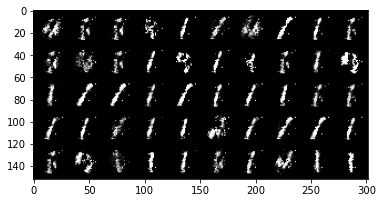

Iter: 45010/100000, Gen loss: 3.5327, Dis loss: 0.1671
Iter: 45020/100000, Gen loss: 3.7946, Dis loss: 0.2033
Iter: 45030/100000, Gen loss: 2.9910, Dis loss: 0.3797
Iter: 45040/100000, Gen loss: 3.3602, Dis loss: 0.2967
Iter: 45050/100000, Gen loss: 2.9312, Dis loss: 0.3185
Iter: 45060/100000, Gen loss: 3.8820, Dis loss: 0.3927
Iter: 45070/100000, Gen loss: 3.3457, Dis loss: 0.2266
Iter: 45080/100000, Gen loss: 3.2134, Dis loss: 0.2000
Iter: 45090/100000, Gen loss: 2.8869, Dis loss: 0.1964
Iter: 45100/100000, Gen loss: 3.1582, Dis loss: 0.1677
Iter: 45110/100000, Gen loss: 3.4748, Dis loss: 0.3683
Iter: 45120/100000, Gen loss: 4.1493, Dis loss: 0.2407
Iter: 45130/100000, Gen loss: 3.1495, Dis loss: 0.2194
Iter: 45140/100000, Gen loss: 3.4957, Dis loss: 0.3546
Iter: 45150/100000, Gen loss: 3.5984, Dis loss: 0.3594
Iter: 45160/100000, Gen loss: 3.4294, Dis loss: 0.2711
Iter: 45170/100000, Gen loss: 2.9681, Dis loss: 0.2655
Iter: 45180/100000, Gen loss: 3.0020, Dis loss: 0.1578
Iter: 4519

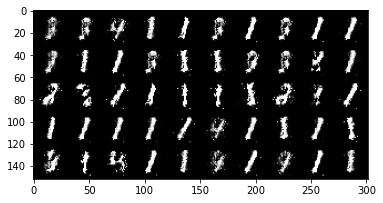

Iter: 45210/100000, Gen loss: 4.4969, Dis loss: 0.2910
Iter: 45220/100000, Gen loss: 3.7232, Dis loss: 0.2266
Iter: 45230/100000, Gen loss: 2.8152, Dis loss: 0.3518
Iter: 45240/100000, Gen loss: 2.9608, Dis loss: 0.2279
Iter: 45250/100000, Gen loss: 3.8412, Dis loss: 0.1051
Iter: 45260/100000, Gen loss: 2.8596, Dis loss: 0.4729
Iter: 45270/100000, Gen loss: 3.4284, Dis loss: 0.3303
Iter: 45280/100000, Gen loss: 2.9562, Dis loss: 0.1336
Iter: 45290/100000, Gen loss: 4.0134, Dis loss: 0.1579
Iter: 45300/100000, Gen loss: 3.3981, Dis loss: 0.1700
Iter: 45310/100000, Gen loss: 3.3528, Dis loss: 0.3032
Iter: 45320/100000, Gen loss: 3.6129, Dis loss: 0.3244
Iter: 45330/100000, Gen loss: 2.8270, Dis loss: 0.3998
Iter: 45340/100000, Gen loss: 3.8161, Dis loss: 0.2794
Iter: 45350/100000, Gen loss: 2.6624, Dis loss: 0.2142
Iter: 45360/100000, Gen loss: 2.4288, Dis loss: 0.3572
Iter: 45370/100000, Gen loss: 3.2909, Dis loss: 0.2693
Iter: 45380/100000, Gen loss: 2.5522, Dis loss: 0.3457
Iter: 4539

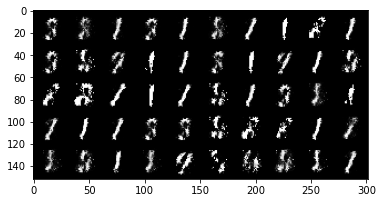

Iter: 45410/100000, Gen loss: 3.5717, Dis loss: 0.4111
Iter: 45420/100000, Gen loss: 3.2037, Dis loss: 0.3273
Iter: 45430/100000, Gen loss: 3.0557, Dis loss: 0.2616
Iter: 45440/100000, Gen loss: 3.4872, Dis loss: 0.4763
Iter: 45450/100000, Gen loss: 3.3589, Dis loss: 0.3898
Iter: 45460/100000, Gen loss: 3.6414, Dis loss: 0.3797
Iter: 45470/100000, Gen loss: 3.3498, Dis loss: 0.3596
Iter: 45480/100000, Gen loss: 2.6958, Dis loss: 0.4949
Iter: 45490/100000, Gen loss: 2.3545, Dis loss: 0.5468
Iter: 45500/100000, Gen loss: 2.7711, Dis loss: 0.6729
Iter: 45510/100000, Gen loss: 2.6898, Dis loss: 0.3551
Iter: 45520/100000, Gen loss: 2.3336, Dis loss: 0.4686
Iter: 45530/100000, Gen loss: 2.6084, Dis loss: 0.1920
Iter: 45540/100000, Gen loss: 3.5923, Dis loss: 0.1367
Iter: 45550/100000, Gen loss: 3.4068, Dis loss: 0.4979
Iter: 45560/100000, Gen loss: 2.8585, Dis loss: 0.1745
Iter: 45570/100000, Gen loss: 2.4396, Dis loss: 0.1499
Iter: 45580/100000, Gen loss: 3.0719, Dis loss: 0.2016
Iter: 4559

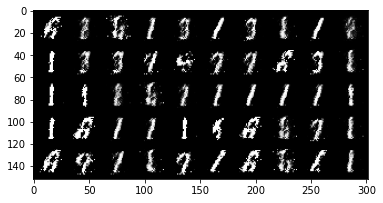

Iter: 45610/100000, Gen loss: 3.5010, Dis loss: 0.3600
Iter: 45620/100000, Gen loss: 2.8862, Dis loss: 0.3970
Iter: 45630/100000, Gen loss: 2.4510, Dis loss: 0.1807
Iter: 45640/100000, Gen loss: 2.3961, Dis loss: 0.2093
Iter: 45650/100000, Gen loss: 2.7313, Dis loss: 0.2935
Iter: 45660/100000, Gen loss: 3.1500, Dis loss: 0.2284
Iter: 45670/100000, Gen loss: 2.3661, Dis loss: 0.3833
Iter: 45680/100000, Gen loss: 2.8788, Dis loss: 0.5897
Iter: 45690/100000, Gen loss: 2.9874, Dis loss: 0.2464
Iter: 45700/100000, Gen loss: 2.5581, Dis loss: 0.3606
Iter: 45710/100000, Gen loss: 2.0791, Dis loss: 0.4278
Iter: 45720/100000, Gen loss: 3.3225, Dis loss: 0.4423
Iter: 45730/100000, Gen loss: 2.6571, Dis loss: 0.2380
Iter: 45740/100000, Gen loss: 2.8930, Dis loss: 0.2910
Iter: 45750/100000, Gen loss: 2.9110, Dis loss: 0.2869
Iter: 45760/100000, Gen loss: 2.8120, Dis loss: 0.2496
Iter: 45770/100000, Gen loss: 2.8070, Dis loss: 0.3867
Iter: 45780/100000, Gen loss: 2.6297, Dis loss: 0.2467
Iter: 4579

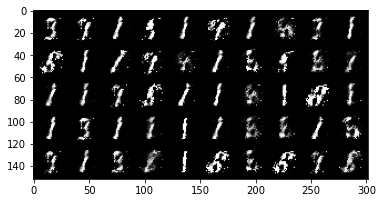

Iter: 45810/100000, Gen loss: 2.8494, Dis loss: 0.2445
Iter: 45820/100000, Gen loss: 2.8939, Dis loss: 0.2671
Iter: 45830/100000, Gen loss: 3.0595, Dis loss: 0.4226
Iter: 45840/100000, Gen loss: 3.5675, Dis loss: 0.2207
Iter: 45850/100000, Gen loss: 2.0243, Dis loss: 0.3125
Iter: 45860/100000, Gen loss: 2.7331, Dis loss: 0.5601
Iter: 45870/100000, Gen loss: 3.2548, Dis loss: 0.3701
Iter: 45880/100000, Gen loss: 2.7758, Dis loss: 0.2101
Iter: 45890/100000, Gen loss: 3.0284, Dis loss: 0.4031
Iter: 45900/100000, Gen loss: 3.4971, Dis loss: 0.2078
Iter: 45910/100000, Gen loss: 2.2411, Dis loss: 0.5005
Iter: 45920/100000, Gen loss: 2.1554, Dis loss: 0.3220
Iter: 45930/100000, Gen loss: 3.5954, Dis loss: 0.2238
Iter: 45940/100000, Gen loss: 2.8028, Dis loss: 0.2221
Iter: 45950/100000, Gen loss: 2.7461, Dis loss: 0.2120
Iter: 45960/100000, Gen loss: 2.8596, Dis loss: 0.2995
Iter: 45970/100000, Gen loss: 3.0128, Dis loss: 0.4121
Iter: 45980/100000, Gen loss: 3.4960, Dis loss: 0.1081
Iter: 4599

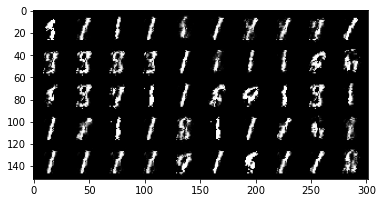

Iter: 46010/100000, Gen loss: 3.3765, Dis loss: 0.3434
Iter: 46020/100000, Gen loss: 3.2948, Dis loss: 0.2100
Iter: 46030/100000, Gen loss: 2.7583, Dis loss: 0.1386
Iter: 46040/100000, Gen loss: 3.3764, Dis loss: 0.3235
Iter: 46050/100000, Gen loss: 2.8869, Dis loss: 0.3977
Iter: 46060/100000, Gen loss: 2.9727, Dis loss: 0.3650
Iter: 46070/100000, Gen loss: 2.9426, Dis loss: 0.1490
Iter: 46080/100000, Gen loss: 2.8947, Dis loss: 0.3799
Iter: 46090/100000, Gen loss: 2.5471, Dis loss: 0.3711
Iter: 46100/100000, Gen loss: 2.4350, Dis loss: 0.5966
Iter: 46110/100000, Gen loss: 3.1670, Dis loss: 0.2516
Iter: 46120/100000, Gen loss: 3.6932, Dis loss: 0.7224
Iter: 46130/100000, Gen loss: 2.5295, Dis loss: 0.3606
Iter: 46140/100000, Gen loss: 3.4642, Dis loss: 0.1904
Iter: 46150/100000, Gen loss: 2.6016, Dis loss: 0.4193
Iter: 46160/100000, Gen loss: 2.8123, Dis loss: 0.2607
Iter: 46170/100000, Gen loss: 2.2174, Dis loss: 0.3680
Iter: 46180/100000, Gen loss: 3.0216, Dis loss: 0.4707
Iter: 4619

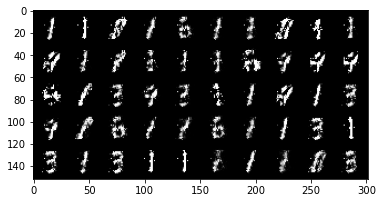

Iter: 46210/100000, Gen loss: 3.5864, Dis loss: 0.3463
Iter: 46220/100000, Gen loss: 3.0687, Dis loss: 0.1981
Iter: 46230/100000, Gen loss: 3.2777, Dis loss: 0.2323
Iter: 46240/100000, Gen loss: 2.6973, Dis loss: 0.4413
Iter: 46250/100000, Gen loss: 2.7067, Dis loss: 0.4638
Iter: 46260/100000, Gen loss: 3.3361, Dis loss: 0.1580
Iter: 46270/100000, Gen loss: 2.9223, Dis loss: 0.2375
Iter: 46280/100000, Gen loss: 2.9556, Dis loss: 0.4050
Iter: 46290/100000, Gen loss: 3.8939, Dis loss: 0.5293
Iter: 46300/100000, Gen loss: 2.6505, Dis loss: 0.4815
Iter: 46310/100000, Gen loss: 2.3222, Dis loss: 0.4552
Iter: 46320/100000, Gen loss: 2.8507, Dis loss: 0.2091
Iter: 46330/100000, Gen loss: 3.1048, Dis loss: 0.3393
Iter: 46340/100000, Gen loss: 2.9081, Dis loss: 0.2914
Iter: 46350/100000, Gen loss: 3.0238, Dis loss: 0.2407
Iter: 46360/100000, Gen loss: 2.3042, Dis loss: 0.3299
Iter: 46370/100000, Gen loss: 2.8432, Dis loss: 0.1212
Iter: 46380/100000, Gen loss: 2.8898, Dis loss: 0.3601
Iter: 4639

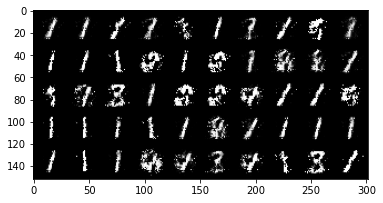

Iter: 46410/100000, Gen loss: 3.2687, Dis loss: 0.4892
Iter: 46420/100000, Gen loss: 2.0220, Dis loss: 0.3942
Iter: 46430/100000, Gen loss: 4.0738, Dis loss: 0.3224
Iter: 46440/100000, Gen loss: 3.1963, Dis loss: 0.3831
Iter: 46450/100000, Gen loss: 2.6651, Dis loss: 0.2372
Iter: 46460/100000, Gen loss: 2.4441, Dis loss: 0.5637
Iter: 46470/100000, Gen loss: 3.4434, Dis loss: 0.3252
Iter: 46480/100000, Gen loss: 3.9424, Dis loss: 0.3012
Iter: 46490/100000, Gen loss: 2.3850, Dis loss: 0.6808
Iter: 46500/100000, Gen loss: 2.9324, Dis loss: 0.2834
Iter: 46510/100000, Gen loss: 3.9544, Dis loss: 0.3854
Iter: 46520/100000, Gen loss: 2.6294, Dis loss: 0.3810
Iter: 46530/100000, Gen loss: 4.1693, Dis loss: 0.3364
Iter: 46540/100000, Gen loss: 3.1751, Dis loss: 0.2769
Iter: 46550/100000, Gen loss: 2.8421, Dis loss: 0.3768
Iter: 46560/100000, Gen loss: 3.6587, Dis loss: 0.4954
Iter: 46570/100000, Gen loss: 3.0750, Dis loss: 0.3282
Iter: 46580/100000, Gen loss: 2.9879, Dis loss: 0.2202
Iter: 4659

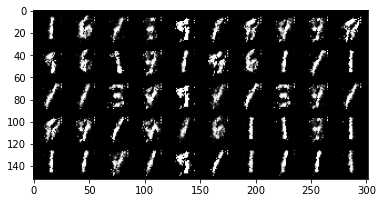

Iter: 46610/100000, Gen loss: 2.8333, Dis loss: 0.3287
Iter: 46620/100000, Gen loss: 2.5200, Dis loss: 0.4996
Iter: 46630/100000, Gen loss: 2.3861, Dis loss: 0.3684
Iter: 46640/100000, Gen loss: 2.9046, Dis loss: 0.1815
Iter: 46650/100000, Gen loss: 3.1859, Dis loss: 0.2861
Iter: 46660/100000, Gen loss: 3.2053, Dis loss: 0.1020
Iter: 46670/100000, Gen loss: 3.0334, Dis loss: 0.1225
Iter: 46680/100000, Gen loss: 2.3839, Dis loss: 0.2313
Iter: 46690/100000, Gen loss: 3.3955, Dis loss: 0.3441
Iter: 46700/100000, Gen loss: 2.7530, Dis loss: 0.3875
Iter: 46710/100000, Gen loss: 3.0294, Dis loss: 0.5988
Iter: 46720/100000, Gen loss: 3.1245, Dis loss: 0.3338
Iter: 46730/100000, Gen loss: 3.0947, Dis loss: 0.3320
Iter: 46740/100000, Gen loss: 3.0768, Dis loss: 0.4036
Iter: 46750/100000, Gen loss: 3.1655, Dis loss: 0.1450
Iter: 46760/100000, Gen loss: 2.8468, Dis loss: 0.1480
Iter: 46770/100000, Gen loss: 2.2987, Dis loss: 0.3585
Iter: 46780/100000, Gen loss: 2.6996, Dis loss: 0.3148
Iter: 4679

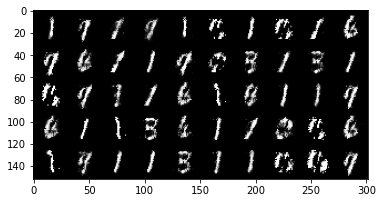

Iter: 46810/100000, Gen loss: 3.0642, Dis loss: 0.7129
Iter: 46820/100000, Gen loss: 3.1101, Dis loss: 0.3563
Iter: 46830/100000, Gen loss: 2.6197, Dis loss: 0.3604
Iter: 46840/100000, Gen loss: 2.7750, Dis loss: 0.5175
Iter: 46850/100000, Gen loss: 2.7186, Dis loss: 0.3896
Iter: 46860/100000, Gen loss: 2.6088, Dis loss: 0.3209
Iter: 46870/100000, Gen loss: 3.2937, Dis loss: 0.3800
Iter: 46880/100000, Gen loss: 2.6860, Dis loss: 0.3169
Iter: 46890/100000, Gen loss: 2.4974, Dis loss: 0.3160
Iter: 46900/100000, Gen loss: 3.2661, Dis loss: 0.2440
Iter: 46910/100000, Gen loss: 2.8031, Dis loss: 0.2611
Iter: 46920/100000, Gen loss: 2.9722, Dis loss: 0.1964
Iter: 46930/100000, Gen loss: 2.6154, Dis loss: 0.3496
Iter: 46940/100000, Gen loss: 2.7356, Dis loss: 0.1504
Iter: 46950/100000, Gen loss: 2.6543, Dis loss: 0.2931
Iter: 46960/100000, Gen loss: 3.3276, Dis loss: 0.4376
Iter: 46970/100000, Gen loss: 3.3946, Dis loss: 0.3331
Iter: 46980/100000, Gen loss: 2.8252, Dis loss: 0.4579
Iter: 4699

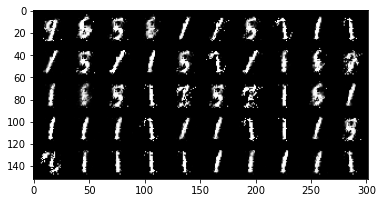

Iter: 47010/100000, Gen loss: 2.4898, Dis loss: 0.2266
Iter: 47020/100000, Gen loss: 2.9956, Dis loss: 0.4244
Iter: 47030/100000, Gen loss: 3.2177, Dis loss: 0.3059
Iter: 47040/100000, Gen loss: 2.7922, Dis loss: 0.2166
Iter: 47050/100000, Gen loss: 2.7699, Dis loss: 0.3499
Iter: 47060/100000, Gen loss: 3.0941, Dis loss: 0.1962
Iter: 47070/100000, Gen loss: 3.1626, Dis loss: 0.3419
Iter: 47080/100000, Gen loss: 3.4960, Dis loss: 0.1519
Iter: 47090/100000, Gen loss: 3.0021, Dis loss: 0.1756
Iter: 47100/100000, Gen loss: 3.4821, Dis loss: 0.0970
Iter: 47110/100000, Gen loss: 3.4874, Dis loss: 0.1919
Iter: 47120/100000, Gen loss: 3.5655, Dis loss: 0.2690
Iter: 47130/100000, Gen loss: 2.9773, Dis loss: 0.1194
Iter: 47140/100000, Gen loss: 3.1050, Dis loss: 0.3441
Iter: 47150/100000, Gen loss: 2.8144, Dis loss: 0.2648
Iter: 47160/100000, Gen loss: 3.0231, Dis loss: 0.3641
Iter: 47170/100000, Gen loss: 3.4291, Dis loss: 0.1084
Iter: 47180/100000, Gen loss: 2.6413, Dis loss: 0.2812
Iter: 4719

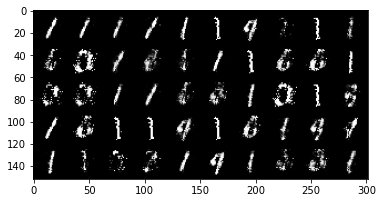

Iter: 47210/100000, Gen loss: 2.9615, Dis loss: 0.4174
Iter: 47220/100000, Gen loss: 2.8030, Dis loss: 0.4635
Iter: 47230/100000, Gen loss: 2.7435, Dis loss: 0.3072
Iter: 47240/100000, Gen loss: 3.1845, Dis loss: 0.2274
Iter: 47250/100000, Gen loss: 2.3771, Dis loss: 0.3617
Iter: 47260/100000, Gen loss: 2.8150, Dis loss: 0.2728
Iter: 47270/100000, Gen loss: 3.3497, Dis loss: 0.2488
Iter: 47280/100000, Gen loss: 3.5295, Dis loss: 0.0910
Iter: 47290/100000, Gen loss: 3.2063, Dis loss: 0.1201
Iter: 47300/100000, Gen loss: 3.1232, Dis loss: 0.3088
Iter: 47310/100000, Gen loss: 2.8277, Dis loss: 0.3301
Iter: 47320/100000, Gen loss: 2.7817, Dis loss: 0.3531
Iter: 47330/100000, Gen loss: 2.7031, Dis loss: 0.2394
Iter: 47340/100000, Gen loss: 2.5510, Dis loss: 0.2544
Iter: 47350/100000, Gen loss: 3.8287, Dis loss: 0.1924
Iter: 47360/100000, Gen loss: 3.3217, Dis loss: 0.2717
Iter: 47370/100000, Gen loss: 2.8841, Dis loss: 0.7526
Iter: 47380/100000, Gen loss: 2.6636, Dis loss: 0.3341
Iter: 4739

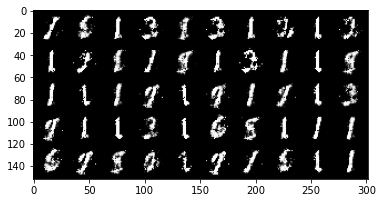

Iter: 47410/100000, Gen loss: 2.8493, Dis loss: 0.1793
Iter: 47420/100000, Gen loss: 2.9863, Dis loss: 0.3947
Iter: 47430/100000, Gen loss: 2.9275, Dis loss: 0.3524
Iter: 47440/100000, Gen loss: 3.4646, Dis loss: 0.1494
Iter: 47450/100000, Gen loss: 2.7855, Dis loss: 0.3485
Iter: 47460/100000, Gen loss: 3.0842, Dis loss: 0.1884
Iter: 47470/100000, Gen loss: 2.8093, Dis loss: 0.2936
Iter: 47480/100000, Gen loss: 3.5660, Dis loss: 0.1360
Iter: 47490/100000, Gen loss: 2.5091, Dis loss: 0.2489
Iter: 47500/100000, Gen loss: 3.4103, Dis loss: 0.2123
Iter: 47510/100000, Gen loss: 2.8782, Dis loss: 0.2282
Iter: 47520/100000, Gen loss: 3.0340, Dis loss: 0.4081
Iter: 47530/100000, Gen loss: 3.0920, Dis loss: 0.1965
Iter: 47540/100000, Gen loss: 3.3020, Dis loss: 0.4222
Iter: 47550/100000, Gen loss: 2.9738, Dis loss: 0.3258
Iter: 47560/100000, Gen loss: 2.4217, Dis loss: 0.3008
Iter: 47570/100000, Gen loss: 2.8513, Dis loss: 0.6153
Iter: 47580/100000, Gen loss: 3.2880, Dis loss: 0.2751
Iter: 4759

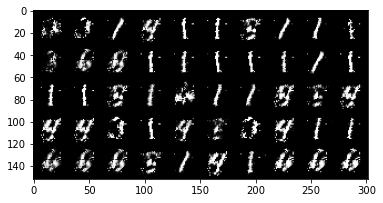

Iter: 47610/100000, Gen loss: 2.2652, Dis loss: 0.4391
Iter: 47620/100000, Gen loss: 2.5167, Dis loss: 0.5397
Iter: 47630/100000, Gen loss: 2.9960, Dis loss: 0.3621
Iter: 47640/100000, Gen loss: 3.0562, Dis loss: 0.6634
Iter: 47650/100000, Gen loss: 3.2440, Dis loss: 0.2039
Iter: 47660/100000, Gen loss: 3.7472, Dis loss: 0.1674
Iter: 47670/100000, Gen loss: 3.1092, Dis loss: 0.1661
Iter: 47680/100000, Gen loss: 3.3919, Dis loss: 0.2132
Iter: 47690/100000, Gen loss: 2.9798, Dis loss: 0.1852
Iter: 47700/100000, Gen loss: 3.0608, Dis loss: 0.1738
Iter: 47710/100000, Gen loss: 3.2490, Dis loss: 0.2540
Iter: 47720/100000, Gen loss: 3.4946, Dis loss: 0.2235
Iter: 47730/100000, Gen loss: 3.1203, Dis loss: 0.1855
Iter: 47740/100000, Gen loss: 3.4623, Dis loss: 0.1940
Iter: 47750/100000, Gen loss: 3.5365, Dis loss: 0.1730
Iter: 47760/100000, Gen loss: 3.4849, Dis loss: 0.1072
Iter: 47770/100000, Gen loss: 3.1000, Dis loss: 0.1535
Iter: 47780/100000, Gen loss: 3.1039, Dis loss: 0.0756
Iter: 4779

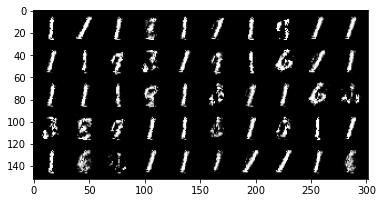

Iter: 47810/100000, Gen loss: 3.6251, Dis loss: 0.1226
Iter: 47820/100000, Gen loss: 2.4369, Dis loss: 0.1922
Iter: 47830/100000, Gen loss: 2.8968, Dis loss: 0.2989
Iter: 47840/100000, Gen loss: 3.0222, Dis loss: 0.1867
Iter: 47850/100000, Gen loss: 2.6487, Dis loss: 0.3148
Iter: 47860/100000, Gen loss: 2.9405, Dis loss: 0.2966
Iter: 47870/100000, Gen loss: 3.2096, Dis loss: 0.2264
Iter: 47880/100000, Gen loss: 3.6135, Dis loss: 0.1536
Iter: 47890/100000, Gen loss: 2.9043, Dis loss: 0.3390
Iter: 47900/100000, Gen loss: 3.3204, Dis loss: 0.5010
Iter: 47910/100000, Gen loss: 2.9335, Dis loss: 0.3222
Iter: 47920/100000, Gen loss: 2.9492, Dis loss: 0.3587
Iter: 47930/100000, Gen loss: 2.6457, Dis loss: 0.2892
Iter: 47940/100000, Gen loss: 2.7883, Dis loss: 0.2360
Iter: 47950/100000, Gen loss: 3.2464, Dis loss: 0.2708
Iter: 47960/100000, Gen loss: 2.0811, Dis loss: 0.3797
Iter: 47970/100000, Gen loss: 2.2088, Dis loss: 0.5001
Iter: 47980/100000, Gen loss: 2.3304, Dis loss: 0.2921
Iter: 4799

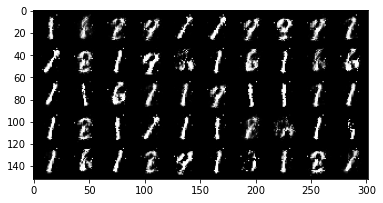

Iter: 48010/100000, Gen loss: 2.8785, Dis loss: 0.2652
Iter: 48020/100000, Gen loss: 2.7066, Dis loss: 0.3580
Iter: 48030/100000, Gen loss: 3.3156, Dis loss: 0.1494
Iter: 48040/100000, Gen loss: 3.2514, Dis loss: 0.1727
Iter: 48050/100000, Gen loss: 3.4592, Dis loss: 0.2721
Iter: 48060/100000, Gen loss: 2.9718, Dis loss: 0.3301
Iter: 48070/100000, Gen loss: 3.6512, Dis loss: 0.2661
Iter: 48080/100000, Gen loss: 2.5996, Dis loss: 0.3711
Iter: 48090/100000, Gen loss: 3.1398, Dis loss: 0.2845
Iter: 48100/100000, Gen loss: 2.3610, Dis loss: 0.3345
Iter: 48110/100000, Gen loss: 3.6159, Dis loss: 0.1870
Iter: 48120/100000, Gen loss: 3.0669, Dis loss: 0.1646
Iter: 48130/100000, Gen loss: 2.7928, Dis loss: 0.1679
Iter: 48140/100000, Gen loss: 3.1508, Dis loss: 0.1677
Iter: 48150/100000, Gen loss: 3.2598, Dis loss: 0.2252
Iter: 48160/100000, Gen loss: 2.6640, Dis loss: 0.2817
Iter: 48170/100000, Gen loss: 2.5739, Dis loss: 0.3255
Iter: 48180/100000, Gen loss: 3.1076, Dis loss: 0.1887
Iter: 4819

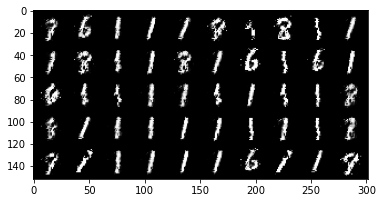

Iter: 48210/100000, Gen loss: 2.9975, Dis loss: 0.4044
Iter: 48220/100000, Gen loss: 2.7914, Dis loss: 0.3148
Iter: 48230/100000, Gen loss: 2.1445, Dis loss: 0.1824
Iter: 48240/100000, Gen loss: 2.4287, Dis loss: 0.3744
Iter: 48250/100000, Gen loss: 3.1684, Dis loss: 0.4091
Iter: 48260/100000, Gen loss: 3.1170, Dis loss: 0.2856
Iter: 48270/100000, Gen loss: 2.3296, Dis loss: 0.3403
Iter: 48280/100000, Gen loss: 2.5543, Dis loss: 0.2004
Iter: 48290/100000, Gen loss: 2.9956, Dis loss: 0.3302
Iter: 48300/100000, Gen loss: 3.4183, Dis loss: 0.2847
Iter: 48310/100000, Gen loss: 2.8216, Dis loss: 0.5641
Iter: 48320/100000, Gen loss: 2.3582, Dis loss: 0.4005
Iter: 48330/100000, Gen loss: 2.6709, Dis loss: 0.2684
Iter: 48340/100000, Gen loss: 3.0675, Dis loss: 0.3551
Iter: 48350/100000, Gen loss: 2.5111, Dis loss: 0.2909
Iter: 48360/100000, Gen loss: 3.2232, Dis loss: 0.2957
Iter: 48370/100000, Gen loss: 2.5691, Dis loss: 0.5123
Iter: 48380/100000, Gen loss: 2.6635, Dis loss: 0.4404
Iter: 4839

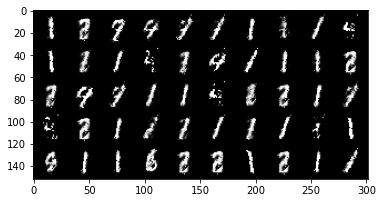

Iter: 48410/100000, Gen loss: 2.9409, Dis loss: 0.3969
Iter: 48420/100000, Gen loss: 3.0728, Dis loss: 0.3025
Iter: 48430/100000, Gen loss: 2.5871, Dis loss: 0.3011
Iter: 48440/100000, Gen loss: 2.7735, Dis loss: 0.4049
Iter: 48450/100000, Gen loss: 2.9496, Dis loss: 0.3378
Iter: 48460/100000, Gen loss: 2.9517, Dis loss: 0.3538
Iter: 48470/100000, Gen loss: 3.2618, Dis loss: 0.4531
Iter: 48480/100000, Gen loss: 2.7407, Dis loss: 0.4382
Iter: 48490/100000, Gen loss: 2.4914, Dis loss: 0.2540
Iter: 48500/100000, Gen loss: 2.5957, Dis loss: 0.2910
Iter: 48510/100000, Gen loss: 2.5044, Dis loss: 0.2606
Iter: 48520/100000, Gen loss: 3.3350, Dis loss: 0.1899
Iter: 48530/100000, Gen loss: 2.9628, Dis loss: 0.4453
Iter: 48540/100000, Gen loss: 2.5167, Dis loss: 0.3166
Iter: 48550/100000, Gen loss: 2.7985, Dis loss: 0.1888
Iter: 48560/100000, Gen loss: 2.4853, Dis loss: 0.5047
Iter: 48570/100000, Gen loss: 3.0431, Dis loss: 0.3039
Iter: 48580/100000, Gen loss: 2.8975, Dis loss: 0.6268
Iter: 4859

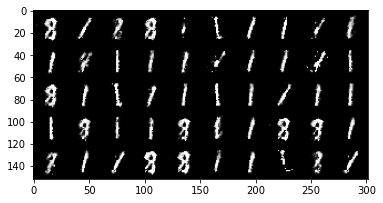

Iter: 48610/100000, Gen loss: 2.1794, Dis loss: 0.3753
Iter: 48620/100000, Gen loss: 3.1306, Dis loss: 0.3118
Iter: 48630/100000, Gen loss: 2.7312, Dis loss: 0.3917
Iter: 48640/100000, Gen loss: 2.0160, Dis loss: 0.5073
Iter: 48650/100000, Gen loss: 2.7882, Dis loss: 0.4663
Iter: 48660/100000, Gen loss: 3.2704, Dis loss: 0.4164
Iter: 48670/100000, Gen loss: 3.2176, Dis loss: 0.3178
Iter: 48680/100000, Gen loss: 1.8026, Dis loss: 0.3365
Iter: 48690/100000, Gen loss: 3.5060, Dis loss: 0.1642
Iter: 48700/100000, Gen loss: 2.8542, Dis loss: 0.1464
Iter: 48710/100000, Gen loss: 2.6245, Dis loss: 0.4380
Iter: 48720/100000, Gen loss: 2.7354, Dis loss: 0.4142
Iter: 48730/100000, Gen loss: 2.7735, Dis loss: 0.4709
Iter: 48740/100000, Gen loss: 2.7832, Dis loss: 0.2723
Iter: 48750/100000, Gen loss: 2.0403, Dis loss: 0.5564
Iter: 48760/100000, Gen loss: 2.5417, Dis loss: 0.3102
Iter: 48770/100000, Gen loss: 2.9671, Dis loss: 0.2065
Iter: 48780/100000, Gen loss: 3.3000, Dis loss: 0.1432
Iter: 4879

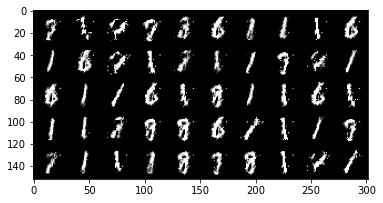

Iter: 48810/100000, Gen loss: 2.6559, Dis loss: 0.2929
Iter: 48820/100000, Gen loss: 3.3427, Dis loss: 0.3105
Iter: 48830/100000, Gen loss: 3.0180, Dis loss: 0.4262
Iter: 48840/100000, Gen loss: 2.4378, Dis loss: 0.3831
Iter: 48850/100000, Gen loss: 3.0230, Dis loss: 0.3046
Iter: 48860/100000, Gen loss: 2.4887, Dis loss: 0.6142
Iter: 48870/100000, Gen loss: 2.1297, Dis loss: 0.3572
Iter: 48880/100000, Gen loss: 2.9968, Dis loss: 0.5163
Iter: 48890/100000, Gen loss: 2.3514, Dis loss: 0.4611
Iter: 48900/100000, Gen loss: 2.6447, Dis loss: 0.1469
Iter: 48910/100000, Gen loss: 2.7703, Dis loss: 0.3886
Iter: 48920/100000, Gen loss: 2.5333, Dis loss: 0.2945
Iter: 48930/100000, Gen loss: 2.9033, Dis loss: 0.1955
Iter: 48940/100000, Gen loss: 2.4769, Dis loss: 0.2568
Iter: 48950/100000, Gen loss: 3.1506, Dis loss: 0.2655
Iter: 48960/100000, Gen loss: 2.5250, Dis loss: 0.2519
Iter: 48970/100000, Gen loss: 2.2149, Dis loss: 0.2464
Iter: 48980/100000, Gen loss: 2.6050, Dis loss: 0.3419
Iter: 4899

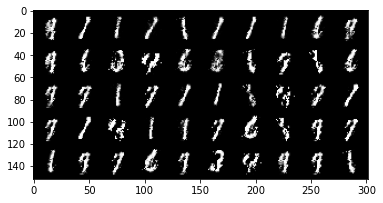

Iter: 49010/100000, Gen loss: 3.2191, Dis loss: 0.5065
Iter: 49020/100000, Gen loss: 2.8460, Dis loss: 0.2853
Iter: 49030/100000, Gen loss: 2.9283, Dis loss: 0.4289
Iter: 49040/100000, Gen loss: 3.1924, Dis loss: 0.3328
Iter: 49050/100000, Gen loss: 2.1185, Dis loss: 0.6839
Iter: 49060/100000, Gen loss: 2.9203, Dis loss: 0.5844
Iter: 49070/100000, Gen loss: 2.7898, Dis loss: 0.2586
Iter: 49080/100000, Gen loss: 3.2146, Dis loss: 0.6665
Iter: 49090/100000, Gen loss: 2.8513, Dis loss: 0.3525
Iter: 49100/100000, Gen loss: 2.8320, Dis loss: 0.4290
Iter: 49110/100000, Gen loss: 2.6213, Dis loss: 0.3397
Iter: 49120/100000, Gen loss: 3.3255, Dis loss: 0.5112
Iter: 49130/100000, Gen loss: 3.1181, Dis loss: 0.3186
Iter: 49140/100000, Gen loss: 2.5256, Dis loss: 0.5069
Iter: 49150/100000, Gen loss: 2.5599, Dis loss: 0.4217
Iter: 49160/100000, Gen loss: 2.7401, Dis loss: 0.5297
Iter: 49170/100000, Gen loss: 2.8189, Dis loss: 0.2570
Iter: 49180/100000, Gen loss: 2.2333, Dis loss: 0.5428
Iter: 4919

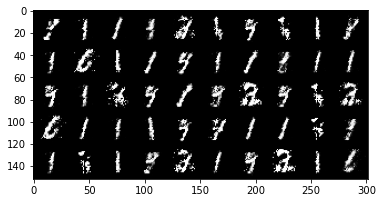

Iter: 49210/100000, Gen loss: 2.3041, Dis loss: 0.3120
Iter: 49220/100000, Gen loss: 2.2325, Dis loss: 0.2918
Iter: 49230/100000, Gen loss: 2.4299, Dis loss: 0.3656
Iter: 49240/100000, Gen loss: 2.9066, Dis loss: 0.2197
Iter: 49250/100000, Gen loss: 3.1670, Dis loss: 0.4268
Iter: 49260/100000, Gen loss: 2.7686, Dis loss: 0.3469
Iter: 49270/100000, Gen loss: 2.4275, Dis loss: 0.3351
Iter: 49280/100000, Gen loss: 3.0992, Dis loss: 0.3365
Iter: 49290/100000, Gen loss: 3.5399, Dis loss: 0.4411
Iter: 49300/100000, Gen loss: 3.0094, Dis loss: 0.3416
Iter: 49310/100000, Gen loss: 2.3286, Dis loss: 0.3413
Iter: 49320/100000, Gen loss: 3.1280, Dis loss: 0.3513
Iter: 49330/100000, Gen loss: 2.9729, Dis loss: 0.4529
Iter: 49340/100000, Gen loss: 2.4863, Dis loss: 0.2935
Iter: 49350/100000, Gen loss: 2.6261, Dis loss: 0.2544
Iter: 49360/100000, Gen loss: 3.1875, Dis loss: 0.2695
Iter: 49370/100000, Gen loss: 2.2803, Dis loss: 0.2733
Iter: 49380/100000, Gen loss: 2.6333, Dis loss: 0.2587
Iter: 4939

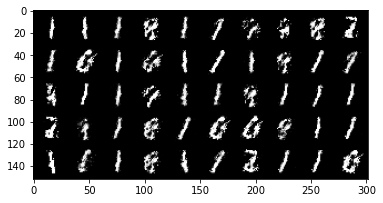

Iter: 49410/100000, Gen loss: 2.8258, Dis loss: 0.3540
Iter: 49420/100000, Gen loss: 2.5705, Dis loss: 0.3810
Iter: 49430/100000, Gen loss: 3.5378, Dis loss: 0.4156
Iter: 49440/100000, Gen loss: 3.2756, Dis loss: 0.5168
Iter: 49450/100000, Gen loss: 2.5751, Dis loss: 0.3081
Iter: 49460/100000, Gen loss: 3.1864, Dis loss: 0.1917
Iter: 49470/100000, Gen loss: 3.3640, Dis loss: 0.2488
Iter: 49480/100000, Gen loss: 2.8274, Dis loss: 0.2347
Iter: 49490/100000, Gen loss: 2.4087, Dis loss: 0.2645
Iter: 49500/100000, Gen loss: 3.2508, Dis loss: 0.4114
Iter: 49510/100000, Gen loss: 3.2586, Dis loss: 0.2458
Iter: 49520/100000, Gen loss: 3.0592, Dis loss: 0.1818
Iter: 49530/100000, Gen loss: 3.0131, Dis loss: 0.3387
Iter: 49540/100000, Gen loss: 2.9537, Dis loss: 0.4934
Iter: 49550/100000, Gen loss: 2.2272, Dis loss: 0.5092
Iter: 49560/100000, Gen loss: 2.5148, Dis loss: 0.5972
Iter: 49570/100000, Gen loss: 3.2344, Dis loss: 0.2359
Iter: 49580/100000, Gen loss: 2.7473, Dis loss: 0.3077
Iter: 4959

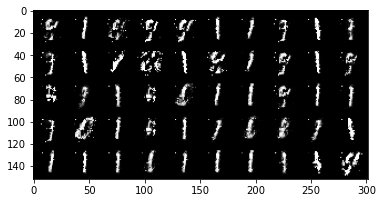

Iter: 49610/100000, Gen loss: 2.6796, Dis loss: 0.3716
Iter: 49620/100000, Gen loss: 2.5917, Dis loss: 0.3827
Iter: 49630/100000, Gen loss: 3.0286, Dis loss: 0.4560
Iter: 49640/100000, Gen loss: 2.8281, Dis loss: 0.4900
Iter: 49650/100000, Gen loss: 2.8846, Dis loss: 0.2946
Iter: 49660/100000, Gen loss: 2.2598, Dis loss: 0.3842
Iter: 49670/100000, Gen loss: 2.7186, Dis loss: 0.2996
Iter: 49680/100000, Gen loss: 2.5721, Dis loss: 0.4570
Iter: 49690/100000, Gen loss: 3.0978, Dis loss: 0.2214
Iter: 49700/100000, Gen loss: 2.1929, Dis loss: 0.4011
Iter: 49710/100000, Gen loss: 2.1365, Dis loss: 0.6208
Iter: 49720/100000, Gen loss: 2.2418, Dis loss: 0.6773
Iter: 49730/100000, Gen loss: 2.7778, Dis loss: 0.6408
Iter: 49740/100000, Gen loss: 2.6778, Dis loss: 0.4376
Iter: 49750/100000, Gen loss: 1.8279, Dis loss: 0.4758
Iter: 49760/100000, Gen loss: 2.4177, Dis loss: 0.3122
Iter: 49770/100000, Gen loss: 2.2310, Dis loss: 0.3603
Iter: 49780/100000, Gen loss: 2.9528, Dis loss: 0.4689
Iter: 4979

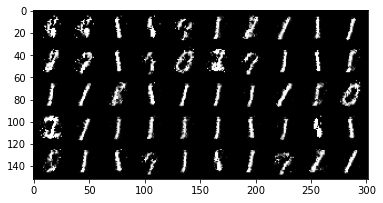

Iter: 49810/100000, Gen loss: 2.3353, Dis loss: 0.3818
Iter: 49820/100000, Gen loss: 2.0762, Dis loss: 0.5172
Iter: 49830/100000, Gen loss: 2.7700, Dis loss: 0.4146
Iter: 49840/100000, Gen loss: 2.8578, Dis loss: 0.5906
Iter: 49850/100000, Gen loss: 2.5478, Dis loss: 0.2848
Iter: 49860/100000, Gen loss: 2.6775, Dis loss: 0.3374
Iter: 49870/100000, Gen loss: 2.7757, Dis loss: 0.3444
Iter: 49880/100000, Gen loss: 2.7558, Dis loss: 0.3226
Iter: 49890/100000, Gen loss: 2.9274, Dis loss: 0.4618
Iter: 49900/100000, Gen loss: 3.4484, Dis loss: 0.2382
Iter: 49910/100000, Gen loss: 2.1263, Dis loss: 0.2977
Iter: 49920/100000, Gen loss: 2.5629, Dis loss: 0.3678
Iter: 49930/100000, Gen loss: 3.2592, Dis loss: 0.4152
Iter: 49940/100000, Gen loss: 3.3731, Dis loss: 0.3288
Iter: 49950/100000, Gen loss: 2.5769, Dis loss: 0.2507
Iter: 49960/100000, Gen loss: 2.5350, Dis loss: 0.2714
Iter: 49970/100000, Gen loss: 3.1299, Dis loss: 0.3504
Iter: 49980/100000, Gen loss: 2.4278, Dis loss: 0.4507
Iter: 4999

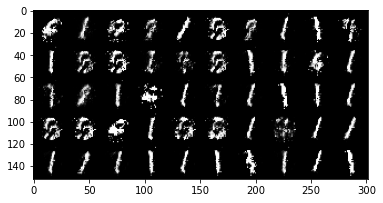

Iter: 50010/100000, Gen loss: 2.5398, Dis loss: 0.4072
Iter: 50020/100000, Gen loss: 2.5985, Dis loss: 0.3873
Iter: 50030/100000, Gen loss: 2.4812, Dis loss: 0.5598
Iter: 50040/100000, Gen loss: 2.9659, Dis loss: 0.3231
Iter: 50050/100000, Gen loss: 2.8264, Dis loss: 0.3810
Iter: 50060/100000, Gen loss: 2.4279, Dis loss: 0.5964
Iter: 50070/100000, Gen loss: 2.1933, Dis loss: 0.5069
Iter: 50080/100000, Gen loss: 3.2150, Dis loss: 0.4316
Iter: 50090/100000, Gen loss: 2.9343, Dis loss: 0.4920
Iter: 50100/100000, Gen loss: 2.6325, Dis loss: 0.2035
Iter: 50110/100000, Gen loss: 2.4604, Dis loss: 0.5099
Iter: 50120/100000, Gen loss: 2.4372, Dis loss: 0.4093
Iter: 50130/100000, Gen loss: 2.9248, Dis loss: 0.3013
Iter: 50140/100000, Gen loss: 2.3506, Dis loss: 0.2429
Iter: 50150/100000, Gen loss: 2.6776, Dis loss: 0.4065
Iter: 50160/100000, Gen loss: 2.3209, Dis loss: 0.3490
Iter: 50170/100000, Gen loss: 2.7335, Dis loss: 0.2389
Iter: 50180/100000, Gen loss: 2.5077, Dis loss: 0.3247
Iter: 5019

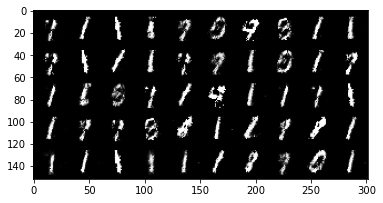

Iter: 50210/100000, Gen loss: 2.6932, Dis loss: 0.2794
Iter: 50220/100000, Gen loss: 2.5466, Dis loss: 0.4646
Iter: 50230/100000, Gen loss: 2.4289, Dis loss: 0.2764
Iter: 50240/100000, Gen loss: 2.2451, Dis loss: 0.3100
Iter: 50250/100000, Gen loss: 2.9136, Dis loss: 0.3655
Iter: 50260/100000, Gen loss: 2.3288, Dis loss: 0.4813
Iter: 50270/100000, Gen loss: 2.0812, Dis loss: 0.3349
Iter: 50280/100000, Gen loss: 2.8418, Dis loss: 0.3686
Iter: 50290/100000, Gen loss: 2.6308, Dis loss: 0.1160
Iter: 50300/100000, Gen loss: 2.4806, Dis loss: 0.2768
Iter: 50310/100000, Gen loss: 2.7291, Dis loss: 0.4308
Iter: 50320/100000, Gen loss: 2.8824, Dis loss: 0.3261
Iter: 50330/100000, Gen loss: 3.0980, Dis loss: 0.4542
Iter: 50340/100000, Gen loss: 2.8639, Dis loss: 0.2989
Iter: 50350/100000, Gen loss: 2.8093, Dis loss: 0.4491
Iter: 50360/100000, Gen loss: 3.0768, Dis loss: 0.2933
Iter: 50370/100000, Gen loss: 2.9893, Dis loss: 0.1782
Iter: 50380/100000, Gen loss: 2.9214, Dis loss: 0.3344
Iter: 5039

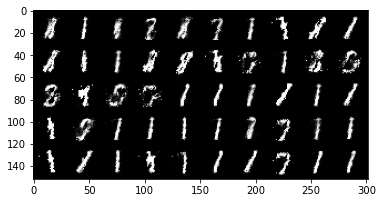

Iter: 50410/100000, Gen loss: 2.8004, Dis loss: 0.5327
Iter: 50420/100000, Gen loss: 2.3198, Dis loss: 0.4271
Iter: 50430/100000, Gen loss: 1.9752, Dis loss: 0.4353
Iter: 50440/100000, Gen loss: 2.4618, Dis loss: 0.1936
Iter: 50450/100000, Gen loss: 2.7815, Dis loss: 0.3345
Iter: 50460/100000, Gen loss: 2.4344, Dis loss: 0.3059
Iter: 50470/100000, Gen loss: 3.2191, Dis loss: 0.2132
Iter: 50480/100000, Gen loss: 2.2087, Dis loss: 0.2734
Iter: 50490/100000, Gen loss: 2.4980, Dis loss: 0.4474
Iter: 50500/100000, Gen loss: 2.6725, Dis loss: 0.3821
Iter: 50510/100000, Gen loss: 2.4926, Dis loss: 0.4573
Iter: 50520/100000, Gen loss: 2.3956, Dis loss: 0.5764
Iter: 50530/100000, Gen loss: 2.5870, Dis loss: 0.3103
Iter: 50540/100000, Gen loss: 2.5017, Dis loss: 0.2038
Iter: 50550/100000, Gen loss: 2.1401, Dis loss: 0.3697
Iter: 50560/100000, Gen loss: 2.1783, Dis loss: 0.3283
Iter: 50570/100000, Gen loss: 2.5821, Dis loss: 0.2440
Iter: 50580/100000, Gen loss: 2.5984, Dis loss: 0.5182
Iter: 5059

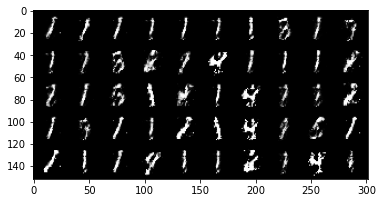

Iter: 50610/100000, Gen loss: 2.6787, Dis loss: 0.2952
Iter: 50620/100000, Gen loss: 2.4283, Dis loss: 0.4051
Iter: 50630/100000, Gen loss: 2.7959, Dis loss: 0.2209
Iter: 50640/100000, Gen loss: 2.8313, Dis loss: 0.3020
Iter: 50650/100000, Gen loss: 2.5338, Dis loss: 0.2643
Iter: 50660/100000, Gen loss: 2.4681, Dis loss: 0.1871
Iter: 50670/100000, Gen loss: 2.6593, Dis loss: 0.3185
Iter: 50680/100000, Gen loss: 2.3189, Dis loss: 0.3032
Iter: 50690/100000, Gen loss: 1.8157, Dis loss: 0.5722
Iter: 50700/100000, Gen loss: 2.0167, Dis loss: 0.4962
Iter: 50710/100000, Gen loss: 3.1442, Dis loss: 0.5574
Iter: 50720/100000, Gen loss: 3.1474, Dis loss: 0.5695
Iter: 50730/100000, Gen loss: 2.6267, Dis loss: 0.4964
Iter: 50740/100000, Gen loss: 2.2256, Dis loss: 0.4182
Iter: 50750/100000, Gen loss: 2.5609, Dis loss: 0.5577
Iter: 50760/100000, Gen loss: 2.4836, Dis loss: 0.4193
Iter: 50770/100000, Gen loss: 1.9256, Dis loss: 0.4781
Iter: 50780/100000, Gen loss: 2.4442, Dis loss: 0.4063
Iter: 5079

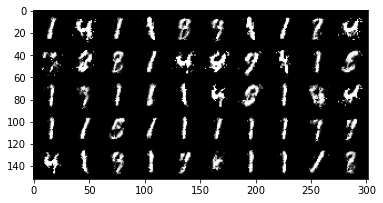

Iter: 50810/100000, Gen loss: 1.8545, Dis loss: 0.4802
Iter: 50820/100000, Gen loss: 2.3414, Dis loss: 0.6679
Iter: 50830/100000, Gen loss: 2.4315, Dis loss: 0.3563
Iter: 50840/100000, Gen loss: 2.3319, Dis loss: 0.2644
Iter: 50850/100000, Gen loss: 2.8073, Dis loss: 0.3931
Iter: 50860/100000, Gen loss: 2.1953, Dis loss: 0.4326
Iter: 50870/100000, Gen loss: 2.3168, Dis loss: 0.3655
Iter: 50880/100000, Gen loss: 2.5365, Dis loss: 0.5927
Iter: 50890/100000, Gen loss: 2.5166, Dis loss: 0.5600
Iter: 50900/100000, Gen loss: 2.9121, Dis loss: 0.5290
Iter: 50910/100000, Gen loss: 2.0609, Dis loss: 0.4651
Iter: 50920/100000, Gen loss: 2.6995, Dis loss: 0.2503
Iter: 50930/100000, Gen loss: 2.7594, Dis loss: 0.5290
Iter: 50940/100000, Gen loss: 2.3544, Dis loss: 0.2380
Iter: 50950/100000, Gen loss: 2.6432, Dis loss: 0.3782
Iter: 50960/100000, Gen loss: 2.7118, Dis loss: 0.2857
Iter: 50970/100000, Gen loss: 2.9242, Dis loss: 0.3478
Iter: 50980/100000, Gen loss: 2.2238, Dis loss: 0.2274
Iter: 5099

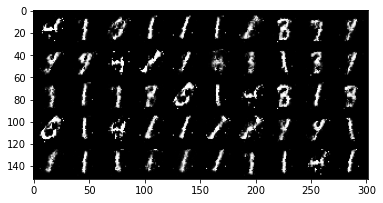

Iter: 51010/100000, Gen loss: 2.3228, Dis loss: 0.5352
Iter: 51020/100000, Gen loss: 2.3651, Dis loss: 0.3635
Iter: 51030/100000, Gen loss: 2.5122, Dis loss: 0.1473
Iter: 51040/100000, Gen loss: 2.7715, Dis loss: 0.6006
Iter: 51050/100000, Gen loss: 2.6679, Dis loss: 0.4811
Iter: 51060/100000, Gen loss: 2.1274, Dis loss: 0.7235
Iter: 51070/100000, Gen loss: 1.9354, Dis loss: 0.4043
Iter: 51080/100000, Gen loss: 2.6331, Dis loss: 0.4961
Iter: 51090/100000, Gen loss: 2.5118, Dis loss: 0.6372
Iter: 51100/100000, Gen loss: 2.3680, Dis loss: 0.2614
Iter: 51110/100000, Gen loss: 2.3769, Dis loss: 0.4730
Iter: 51120/100000, Gen loss: 2.8241, Dis loss: 0.5460
Iter: 51130/100000, Gen loss: 2.4988, Dis loss: 0.4018
Iter: 51140/100000, Gen loss: 1.9652, Dis loss: 0.5640
Iter: 51150/100000, Gen loss: 2.7372, Dis loss: 0.3531
Iter: 51160/100000, Gen loss: 2.7234, Dis loss: 0.5670
Iter: 51170/100000, Gen loss: 2.7832, Dis loss: 0.4786
Iter: 51180/100000, Gen loss: 2.3942, Dis loss: 0.4377
Iter: 5119

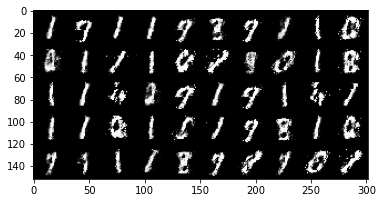

Iter: 51210/100000, Gen loss: 2.7308, Dis loss: 0.4597
Iter: 51220/100000, Gen loss: 2.4397, Dis loss: 0.4235
Iter: 51230/100000, Gen loss: 2.0521, Dis loss: 0.6373
Iter: 51240/100000, Gen loss: 2.0073, Dis loss: 0.3507
Iter: 51250/100000, Gen loss: 2.6681, Dis loss: 0.4488
Iter: 51260/100000, Gen loss: 2.6289, Dis loss: 0.4565
Iter: 51270/100000, Gen loss: 2.2347, Dis loss: 0.7102
Iter: 51280/100000, Gen loss: 2.2722, Dis loss: 0.3269
Iter: 51290/100000, Gen loss: 2.6441, Dis loss: 0.3032
Iter: 51300/100000, Gen loss: 2.2397, Dis loss: 0.3183
Iter: 51310/100000, Gen loss: 2.0245, Dis loss: 0.7355
Iter: 51320/100000, Gen loss: 2.6410, Dis loss: 0.7017
Iter: 51330/100000, Gen loss: 2.2690, Dis loss: 0.4897
Iter: 51340/100000, Gen loss: 2.0117, Dis loss: 0.7864
Iter: 51350/100000, Gen loss: 2.3190, Dis loss: 0.5693
Iter: 51360/100000, Gen loss: 2.8435, Dis loss: 0.1655
Iter: 51370/100000, Gen loss: 2.1716, Dis loss: 0.4695
Iter: 51380/100000, Gen loss: 2.6014, Dis loss: 0.3648
Iter: 5139

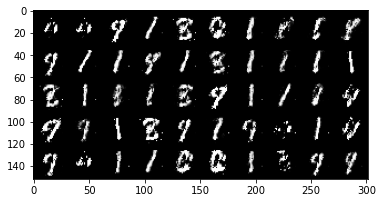

Iter: 51410/100000, Gen loss: 2.4045, Dis loss: 0.3870
Iter: 51420/100000, Gen loss: 2.4871, Dis loss: 0.4188
Iter: 51430/100000, Gen loss: 2.6557, Dis loss: 0.2920
Iter: 51440/100000, Gen loss: 2.5991, Dis loss: 0.4256
Iter: 51450/100000, Gen loss: 2.3663, Dis loss: 0.4072
Iter: 51460/100000, Gen loss: 2.5060, Dis loss: 0.6460
Iter: 51470/100000, Gen loss: 2.1082, Dis loss: 0.3023
Iter: 51480/100000, Gen loss: 2.7762, Dis loss: 0.3467
Iter: 51490/100000, Gen loss: 2.8111, Dis loss: 0.5008
Iter: 51500/100000, Gen loss: 2.7259, Dis loss: 0.4744
Iter: 51510/100000, Gen loss: 2.2000, Dis loss: 0.4027
Iter: 51520/100000, Gen loss: 2.5303, Dis loss: 0.7930
Iter: 51530/100000, Gen loss: 2.7625, Dis loss: 0.3389
Iter: 51540/100000, Gen loss: 2.3384, Dis loss: 0.6643
Iter: 51550/100000, Gen loss: 2.5733, Dis loss: 0.5674
Iter: 51560/100000, Gen loss: 2.1416, Dis loss: 0.3424
Iter: 51570/100000, Gen loss: 2.2856, Dis loss: 0.4528
Iter: 51580/100000, Gen loss: 2.4043, Dis loss: 0.5335
Iter: 5159

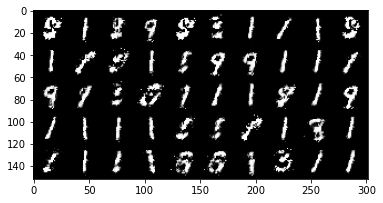

Iter: 51610/100000, Gen loss: 2.6097, Dis loss: 0.7923
Iter: 51620/100000, Gen loss: 2.5685, Dis loss: 0.5546
Iter: 51630/100000, Gen loss: 2.6354, Dis loss: 0.3902
Iter: 51640/100000, Gen loss: 2.3006, Dis loss: 0.4655
Iter: 51650/100000, Gen loss: 1.8043, Dis loss: 0.4431
Iter: 51660/100000, Gen loss: 2.4397, Dis loss: 0.4444
Iter: 51670/100000, Gen loss: 2.2839, Dis loss: 0.6255
Iter: 51680/100000, Gen loss: 2.7796, Dis loss: 0.2626
Iter: 51690/100000, Gen loss: 2.8004, Dis loss: 0.3219
Iter: 51700/100000, Gen loss: 2.2081, Dis loss: 0.4434
Iter: 51710/100000, Gen loss: 2.6822, Dis loss: 0.3354
Iter: 51720/100000, Gen loss: 2.7578, Dis loss: 0.4158
Iter: 51730/100000, Gen loss: 2.3318, Dis loss: 0.7774
Iter: 51740/100000, Gen loss: 2.7162, Dis loss: 0.2578
Iter: 51750/100000, Gen loss: 2.6978, Dis loss: 0.3813
Iter: 51760/100000, Gen loss: 2.5353, Dis loss: 0.3097
Iter: 51770/100000, Gen loss: 2.8416, Dis loss: 0.4638
Iter: 51780/100000, Gen loss: 2.5726, Dis loss: 0.2862
Iter: 5179

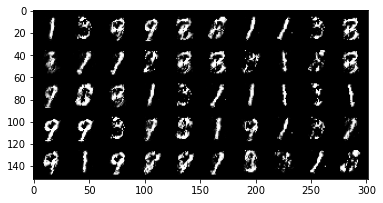

Iter: 51810/100000, Gen loss: 2.5448, Dis loss: 0.4518
Iter: 51820/100000, Gen loss: 2.4204, Dis loss: 0.3440
Iter: 51830/100000, Gen loss: 2.4126, Dis loss: 0.3721
Iter: 51840/100000, Gen loss: 2.5854, Dis loss: 0.5656
Iter: 51850/100000, Gen loss: 3.0862, Dis loss: 0.5927
Iter: 51860/100000, Gen loss: 3.0646, Dis loss: 0.4180
Iter: 51870/100000, Gen loss: 2.3917, Dis loss: 0.4306
Iter: 51880/100000, Gen loss: 2.3047, Dis loss: 0.4491
Iter: 51890/100000, Gen loss: 2.8963, Dis loss: 0.2204
Iter: 51900/100000, Gen loss: 2.4869, Dis loss: 0.3878
Iter: 51910/100000, Gen loss: 2.5089, Dis loss: 0.3364
Iter: 51920/100000, Gen loss: 2.5570, Dis loss: 0.3903
Iter: 51930/100000, Gen loss: 2.5888, Dis loss: 0.2989
Iter: 51940/100000, Gen loss: 2.2432, Dis loss: 0.4918
Iter: 51950/100000, Gen loss: 2.6256, Dis loss: 0.3396
Iter: 51960/100000, Gen loss: 2.8236, Dis loss: 0.2828
Iter: 51970/100000, Gen loss: 3.3392, Dis loss: 0.3898
Iter: 51980/100000, Gen loss: 3.2122, Dis loss: 0.5055
Iter: 5199

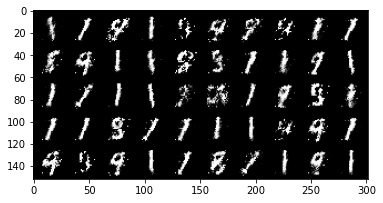

Iter: 52010/100000, Gen loss: 2.9279, Dis loss: 0.1766
Iter: 52020/100000, Gen loss: 2.8257, Dis loss: 0.2731
Iter: 52030/100000, Gen loss: 2.5120, Dis loss: 0.4817
Iter: 52040/100000, Gen loss: 2.2442, Dis loss: 0.6919
Iter: 52050/100000, Gen loss: 2.1810, Dis loss: 0.5333
Iter: 52060/100000, Gen loss: 2.4817, Dis loss: 0.4364
Iter: 52070/100000, Gen loss: 3.6304, Dis loss: 0.4950
Iter: 52080/100000, Gen loss: 2.6455, Dis loss: 0.4979
Iter: 52090/100000, Gen loss: 2.5444, Dis loss: 0.5247
Iter: 52100/100000, Gen loss: 2.4602, Dis loss: 0.2675
Iter: 52110/100000, Gen loss: 2.4715, Dis loss: 0.6149
Iter: 52120/100000, Gen loss: 2.6642, Dis loss: 0.3051
Iter: 52130/100000, Gen loss: 2.5978, Dis loss: 0.4715
Iter: 52140/100000, Gen loss: 2.7448, Dis loss: 0.7090
Iter: 52150/100000, Gen loss: 2.4900, Dis loss: 0.5822
Iter: 52160/100000, Gen loss: 2.6866, Dis loss: 0.5040
Iter: 52170/100000, Gen loss: 3.1138, Dis loss: 0.2930
Iter: 52180/100000, Gen loss: 2.2118, Dis loss: 0.3726
Iter: 5219

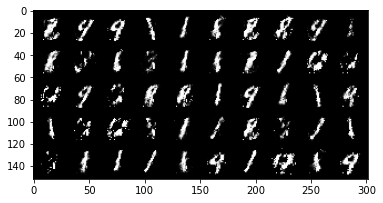

Iter: 52210/100000, Gen loss: 2.6630, Dis loss: 0.6189
Iter: 52220/100000, Gen loss: 2.7395, Dis loss: 0.2873
Iter: 52230/100000, Gen loss: 2.6993, Dis loss: 0.5525
Iter: 52240/100000, Gen loss: 2.0802, Dis loss: 0.3505
Iter: 52250/100000, Gen loss: 2.5369, Dis loss: 0.4168
Iter: 52260/100000, Gen loss: 2.3500, Dis loss: 0.4884
Iter: 52270/100000, Gen loss: 2.7601, Dis loss: 0.3053
Iter: 52280/100000, Gen loss: 2.5635, Dis loss: 0.2757
Iter: 52290/100000, Gen loss: 2.5773, Dis loss: 0.3674
Iter: 52300/100000, Gen loss: 2.8131, Dis loss: 0.4054
Iter: 52310/100000, Gen loss: 2.5746, Dis loss: 0.5469
Iter: 52320/100000, Gen loss: 2.6393, Dis loss: 0.4270
Iter: 52330/100000, Gen loss: 2.1814, Dis loss: 0.6002
Iter: 52340/100000, Gen loss: 2.5919, Dis loss: 0.2697
Iter: 52350/100000, Gen loss: 3.5049, Dis loss: 0.3687
Iter: 52360/100000, Gen loss: 2.5078, Dis loss: 0.3889
Iter: 52370/100000, Gen loss: 2.7530, Dis loss: 0.3963
Iter: 52380/100000, Gen loss: 2.6534, Dis loss: 0.5116
Iter: 5239

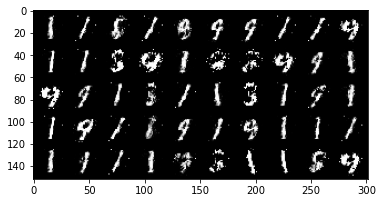

Iter: 52410/100000, Gen loss: 2.6113, Dis loss: 0.4630
Iter: 52420/100000, Gen loss: 2.5740, Dis loss: 0.7270
Iter: 52430/100000, Gen loss: 2.6252, Dis loss: 0.4067
Iter: 52440/100000, Gen loss: 2.5542, Dis loss: 0.4461
Iter: 52450/100000, Gen loss: 2.1778, Dis loss: 0.4779
Iter: 52460/100000, Gen loss: 2.8866, Dis loss: 0.4862
Iter: 52470/100000, Gen loss: 2.6003, Dis loss: 0.3171
Iter: 52480/100000, Gen loss: 2.1518, Dis loss: 0.5416
Iter: 52490/100000, Gen loss: 2.3132, Dis loss: 0.3586
Iter: 52500/100000, Gen loss: 2.9590, Dis loss: 0.3612
Iter: 52510/100000, Gen loss: 2.5792, Dis loss: 0.3907
Iter: 52520/100000, Gen loss: 2.2546, Dis loss: 0.5342
Iter: 52530/100000, Gen loss: 2.8014, Dis loss: 0.4633
Iter: 52540/100000, Gen loss: 2.2418, Dis loss: 0.4214
Iter: 52550/100000, Gen loss: 1.9376, Dis loss: 0.7254
Iter: 52560/100000, Gen loss: 2.6994, Dis loss: 0.3205
Iter: 52570/100000, Gen loss: 2.6959, Dis loss: 0.4256
Iter: 52580/100000, Gen loss: 2.2763, Dis loss: 0.3875
Iter: 5259

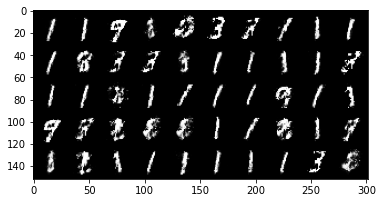

Iter: 52610/100000, Gen loss: 2.4451, Dis loss: 0.3898
Iter: 52620/100000, Gen loss: 2.1470, Dis loss: 0.4710
Iter: 52630/100000, Gen loss: 2.8657, Dis loss: 0.2607
Iter: 52640/100000, Gen loss: 2.2601, Dis loss: 0.5400
Iter: 52650/100000, Gen loss: 2.4161, Dis loss: 0.5541
Iter: 52660/100000, Gen loss: 1.7868, Dis loss: 0.4849
Iter: 52670/100000, Gen loss: 2.7649, Dis loss: 0.5872
Iter: 52680/100000, Gen loss: 2.6422, Dis loss: 0.4702
Iter: 52690/100000, Gen loss: 2.2504, Dis loss: 0.5655
Iter: 52700/100000, Gen loss: 2.1720, Dis loss: 0.4977
Iter: 52710/100000, Gen loss: 2.2743, Dis loss: 0.4187
Iter: 52720/100000, Gen loss: 2.3029, Dis loss: 0.2956
Iter: 52730/100000, Gen loss: 2.5370, Dis loss: 0.4013
Iter: 52740/100000, Gen loss: 2.7757, Dis loss: 0.4602
Iter: 52750/100000, Gen loss: 2.3108, Dis loss: 0.4290
Iter: 52760/100000, Gen loss: 2.3593, Dis loss: 0.3899
Iter: 52770/100000, Gen loss: 2.5559, Dis loss: 0.5036
Iter: 52780/100000, Gen loss: 2.8014, Dis loss: 0.3253
Iter: 5279

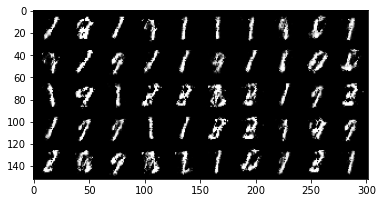

Iter: 52810/100000, Gen loss: 2.8436, Dis loss: 0.4875
Iter: 52820/100000, Gen loss: 1.9668, Dis loss: 0.7000
Iter: 52830/100000, Gen loss: 2.1596, Dis loss: 0.5374
Iter: 52840/100000, Gen loss: 1.8788, Dis loss: 0.8966
Iter: 52850/100000, Gen loss: 2.3314, Dis loss: 0.4064
Iter: 52860/100000, Gen loss: 2.4716, Dis loss: 0.4802
Iter: 52870/100000, Gen loss: 2.2117, Dis loss: 0.3706
Iter: 52880/100000, Gen loss: 2.3310, Dis loss: 0.4061
Iter: 52890/100000, Gen loss: 2.6071, Dis loss: 0.4638
Iter: 52900/100000, Gen loss: 2.2505, Dis loss: 0.4043
Iter: 52910/100000, Gen loss: 2.6153, Dis loss: 0.6464
Iter: 52920/100000, Gen loss: 2.6668, Dis loss: 0.3113
Iter: 52930/100000, Gen loss: 2.0442, Dis loss: 0.2663
Iter: 52940/100000, Gen loss: 2.7228, Dis loss: 0.7368
Iter: 52950/100000, Gen loss: 2.3873, Dis loss: 0.6607
Iter: 52960/100000, Gen loss: 2.6001, Dis loss: 0.5147
Iter: 52970/100000, Gen loss: 2.7206, Dis loss: 0.3183
Iter: 52980/100000, Gen loss: 2.2599, Dis loss: 0.5528
Iter: 5299

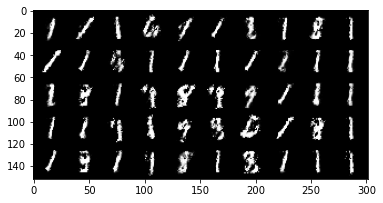

Iter: 53010/100000, Gen loss: 2.1821, Dis loss: 0.4301
Iter: 53020/100000, Gen loss: 2.3155, Dis loss: 0.3077
Iter: 53030/100000, Gen loss: 2.1682, Dis loss: 0.4144
Iter: 53040/100000, Gen loss: 2.2251, Dis loss: 0.4055
Iter: 53050/100000, Gen loss: 2.1720, Dis loss: 0.4555
Iter: 53060/100000, Gen loss: 2.4563, Dis loss: 0.3307
Iter: 53070/100000, Gen loss: 2.1468, Dis loss: 0.4625
Iter: 53080/100000, Gen loss: 2.4875, Dis loss: 0.3911
Iter: 53090/100000, Gen loss: 2.1555, Dis loss: 0.3722
Iter: 53100/100000, Gen loss: 2.0015, Dis loss: 0.7454
Iter: 53110/100000, Gen loss: 2.9032, Dis loss: 0.3684
Iter: 53120/100000, Gen loss: 2.2846, Dis loss: 0.3537
Iter: 53130/100000, Gen loss: 2.9140, Dis loss: 0.2631
Iter: 53140/100000, Gen loss: 2.9892, Dis loss: 0.3013
Iter: 53150/100000, Gen loss: 1.9850, Dis loss: 0.4567
Iter: 53160/100000, Gen loss: 2.7189, Dis loss: 0.4457
Iter: 53170/100000, Gen loss: 2.6534, Dis loss: 0.5868
Iter: 53180/100000, Gen loss: 2.9627, Dis loss: 0.5321
Iter: 5319

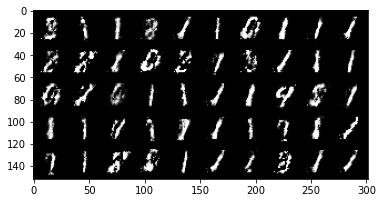

Iter: 53210/100000, Gen loss: 2.7932, Dis loss: 0.4798
Iter: 53220/100000, Gen loss: 2.2674, Dis loss: 0.8173
Iter: 53230/100000, Gen loss: 2.0284, Dis loss: 0.4503
Iter: 53240/100000, Gen loss: 2.6650, Dis loss: 0.5283
Iter: 53250/100000, Gen loss: 2.6433, Dis loss: 0.4605
Iter: 53260/100000, Gen loss: 2.3106, Dis loss: 0.4526
Iter: 53270/100000, Gen loss: 2.1510, Dis loss: 0.3125
Iter: 53280/100000, Gen loss: 2.5471, Dis loss: 0.5551
Iter: 53290/100000, Gen loss: 1.9449, Dis loss: 0.5372
Iter: 53300/100000, Gen loss: 1.9605, Dis loss: 0.5218
Iter: 53310/100000, Gen loss: 2.3410, Dis loss: 0.3840
Iter: 53320/100000, Gen loss: 2.3606, Dis loss: 0.5093
Iter: 53330/100000, Gen loss: 2.6978, Dis loss: 0.5294
Iter: 53340/100000, Gen loss: 2.6543, Dis loss: 0.4963
Iter: 53350/100000, Gen loss: 1.8257, Dis loss: 0.6241
Iter: 53360/100000, Gen loss: 2.3543, Dis loss: 0.6417
Iter: 53370/100000, Gen loss: 2.7857, Dis loss: 0.2552
Iter: 53380/100000, Gen loss: 2.5261, Dis loss: 0.3537
Iter: 5339

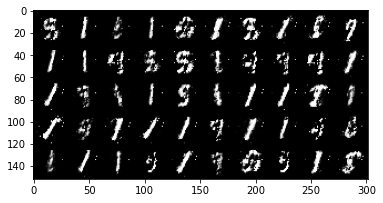

Iter: 53410/100000, Gen loss: 2.8865, Dis loss: 0.7094
Iter: 53420/100000, Gen loss: 2.4307, Dis loss: 0.3749
Iter: 53430/100000, Gen loss: 2.4408, Dis loss: 0.4549
Iter: 53440/100000, Gen loss: 1.8335, Dis loss: 0.5698
Iter: 53450/100000, Gen loss: 2.5361, Dis loss: 0.3786
Iter: 53460/100000, Gen loss: 2.7177, Dis loss: 0.3078
Iter: 53470/100000, Gen loss: 2.5486, Dis loss: 0.3254
Iter: 53480/100000, Gen loss: 2.0397, Dis loss: 0.5227
Iter: 53490/100000, Gen loss: 2.2579, Dis loss: 0.3287
Iter: 53500/100000, Gen loss: 2.5915, Dis loss: 0.3550
Iter: 53510/100000, Gen loss: 2.4128, Dis loss: 0.4125
Iter: 53520/100000, Gen loss: 2.4344, Dis loss: 0.4140
Iter: 53530/100000, Gen loss: 2.5773, Dis loss: 0.5039
Iter: 53540/100000, Gen loss: 2.2030, Dis loss: 0.4902
Iter: 53550/100000, Gen loss: 2.6643, Dis loss: 0.2241
Iter: 53560/100000, Gen loss: 1.9151, Dis loss: 0.5594
Iter: 53570/100000, Gen loss: 2.1475, Dis loss: 0.4301
Iter: 53580/100000, Gen loss: 3.0070, Dis loss: 0.6389
Iter: 5359

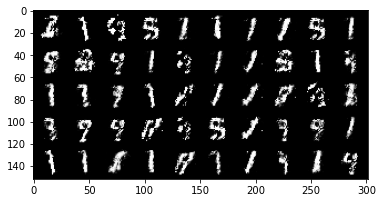

Iter: 53610/100000, Gen loss: 2.7196, Dis loss: 0.3772
Iter: 53620/100000, Gen loss: 2.4498, Dis loss: 0.5076
Iter: 53630/100000, Gen loss: 2.4371, Dis loss: 0.5143
Iter: 53640/100000, Gen loss: 2.5084, Dis loss: 0.7042
Iter: 53650/100000, Gen loss: 2.4308, Dis loss: 0.3610
Iter: 53660/100000, Gen loss: 2.0007, Dis loss: 0.4738
Iter: 53670/100000, Gen loss: 2.2299, Dis loss: 0.3727
Iter: 53680/100000, Gen loss: 2.0752, Dis loss: 0.6694
Iter: 53690/100000, Gen loss: 2.8484, Dis loss: 0.3375
Iter: 53700/100000, Gen loss: 1.9600, Dis loss: 0.5429
Iter: 53710/100000, Gen loss: 2.4208, Dis loss: 0.5914
Iter: 53720/100000, Gen loss: 2.6501, Dis loss: 0.3340
Iter: 53730/100000, Gen loss: 2.0753, Dis loss: 0.3955
Iter: 53740/100000, Gen loss: 2.4377, Dis loss: 0.4222
Iter: 53750/100000, Gen loss: 2.1082, Dis loss: 0.4691
Iter: 53760/100000, Gen loss: 2.2543, Dis loss: 0.4409
Iter: 53770/100000, Gen loss: 2.6902, Dis loss: 0.4398
Iter: 53780/100000, Gen loss: 2.3312, Dis loss: 0.3637
Iter: 5379

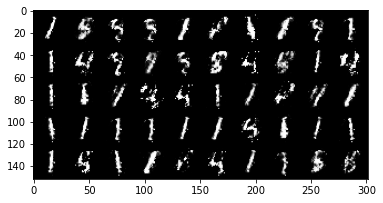

Iter: 53810/100000, Gen loss: 2.6782, Dis loss: 0.8045
Iter: 53820/100000, Gen loss: 2.3973, Dis loss: 0.6348
Iter: 53830/100000, Gen loss: 2.4157, Dis loss: 0.3955
Iter: 53840/100000, Gen loss: 2.2507, Dis loss: 0.6414
Iter: 53850/100000, Gen loss: 2.4239, Dis loss: 0.6764
Iter: 53860/100000, Gen loss: 2.4440, Dis loss: 0.3965
Iter: 53870/100000, Gen loss: 1.9432, Dis loss: 0.5087
Iter: 53880/100000, Gen loss: 2.7012, Dis loss: 0.3920
Iter: 53890/100000, Gen loss: 2.0894, Dis loss: 0.7845
Iter: 53900/100000, Gen loss: 2.3209, Dis loss: 0.4207
Iter: 53910/100000, Gen loss: 2.4180, Dis loss: 0.4307
Iter: 53920/100000, Gen loss: 2.0120, Dis loss: 0.5675
Iter: 53930/100000, Gen loss: 2.4331, Dis loss: 0.3998
Iter: 53940/100000, Gen loss: 1.6772, Dis loss: 0.6256
Iter: 53950/100000, Gen loss: 1.8598, Dis loss: 0.5844
Iter: 53960/100000, Gen loss: 2.2497, Dis loss: 0.4897
Iter: 53970/100000, Gen loss: 2.1875, Dis loss: 0.4666
Iter: 53980/100000, Gen loss: 1.9750, Dis loss: 0.5654
Iter: 5399

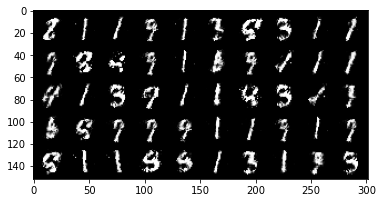

Iter: 54010/100000, Gen loss: 2.6645, Dis loss: 0.5622
Iter: 54020/100000, Gen loss: 2.2720, Dis loss: 0.4210
Iter: 54030/100000, Gen loss: 1.5016, Dis loss: 0.7175
Iter: 54040/100000, Gen loss: 1.7262, Dis loss: 0.5330
Iter: 54050/100000, Gen loss: 2.1358, Dis loss: 0.6161
Iter: 54060/100000, Gen loss: 2.2496, Dis loss: 0.6682
Iter: 54070/100000, Gen loss: 2.2216, Dis loss: 0.8845
Iter: 54080/100000, Gen loss: 2.1211, Dis loss: 0.4057
Iter: 54090/100000, Gen loss: 2.4302, Dis loss: 0.5561
Iter: 54100/100000, Gen loss: 2.3528, Dis loss: 0.4707
Iter: 54110/100000, Gen loss: 2.3119, Dis loss: 0.3643
Iter: 54120/100000, Gen loss: 2.4758, Dis loss: 0.5605
Iter: 54130/100000, Gen loss: 2.2313, Dis loss: 0.3022
Iter: 54140/100000, Gen loss: 2.1174, Dis loss: 0.5365
Iter: 54150/100000, Gen loss: 2.2522, Dis loss: 0.6400
Iter: 54160/100000, Gen loss: 2.1355, Dis loss: 0.3841
Iter: 54170/100000, Gen loss: 2.2039, Dis loss: 0.4651
Iter: 54180/100000, Gen loss: 2.3025, Dis loss: 0.6163
Iter: 5419

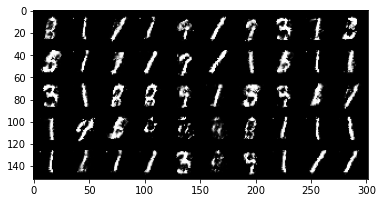

Iter: 54210/100000, Gen loss: 2.2370, Dis loss: 0.5030
Iter: 54220/100000, Gen loss: 2.1017, Dis loss: 0.6383
Iter: 54230/100000, Gen loss: 1.9167, Dis loss: 0.4724
Iter: 54240/100000, Gen loss: 1.5131, Dis loss: 0.8667
Iter: 54250/100000, Gen loss: 2.3992, Dis loss: 0.5145
Iter: 54260/100000, Gen loss: 2.1741, Dis loss: 0.8504
Iter: 54270/100000, Gen loss: 2.4700, Dis loss: 0.4365
Iter: 54280/100000, Gen loss: 2.0347, Dis loss: 0.6914
Iter: 54290/100000, Gen loss: 1.6822, Dis loss: 0.6878
Iter: 54300/100000, Gen loss: 2.4343, Dis loss: 0.5012
Iter: 54310/100000, Gen loss: 2.5630, Dis loss: 0.4783
Iter: 54320/100000, Gen loss: 2.1765, Dis loss: 0.3741
Iter: 54330/100000, Gen loss: 1.6730, Dis loss: 0.4489
Iter: 54340/100000, Gen loss: 1.7053, Dis loss: 0.7910
Iter: 54350/100000, Gen loss: 2.8462, Dis loss: 0.6598
Iter: 54360/100000, Gen loss: 2.1341, Dis loss: 0.5334
Iter: 54370/100000, Gen loss: 1.7607, Dis loss: 0.5151
Iter: 54380/100000, Gen loss: 2.6601, Dis loss: 0.3795
Iter: 5439

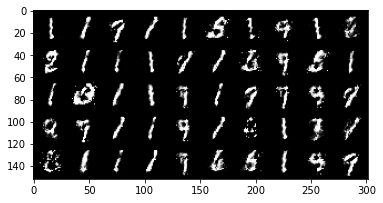

Iter: 54410/100000, Gen loss: 1.9413, Dis loss: 0.6401
Iter: 54420/100000, Gen loss: 2.6668, Dis loss: 0.4671
Iter: 54430/100000, Gen loss: 1.9649, Dis loss: 0.4450
Iter: 54440/100000, Gen loss: 1.7064, Dis loss: 0.5163
Iter: 54450/100000, Gen loss: 2.2519, Dis loss: 0.4451
Iter: 54460/100000, Gen loss: 2.6189, Dis loss: 0.7590
Iter: 54470/100000, Gen loss: 2.0907, Dis loss: 0.5407
Iter: 54480/100000, Gen loss: 2.1404, Dis loss: 0.5390
Iter: 54490/100000, Gen loss: 2.5329, Dis loss: 0.2932
Iter: 54500/100000, Gen loss: 2.2091, Dis loss: 0.5397
Iter: 54510/100000, Gen loss: 2.1427, Dis loss: 0.5208
Iter: 54520/100000, Gen loss: 2.6145, Dis loss: 0.4732
Iter: 54530/100000, Gen loss: 2.2567, Dis loss: 0.6657
Iter: 54540/100000, Gen loss: 2.5451, Dis loss: 0.5742
Iter: 54550/100000, Gen loss: 2.8751, Dis loss: 0.3206
Iter: 54560/100000, Gen loss: 2.6880, Dis loss: 0.3020
Iter: 54570/100000, Gen loss: 2.4866, Dis loss: 0.4179
Iter: 54580/100000, Gen loss: 2.5884, Dis loss: 0.4854
Iter: 5459

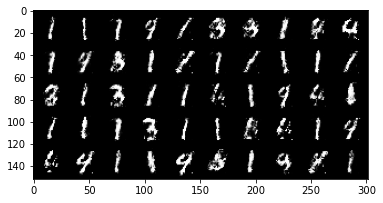

Iter: 54610/100000, Gen loss: 2.1290, Dis loss: 0.3482
Iter: 54620/100000, Gen loss: 2.8178, Dis loss: 0.6825
Iter: 54630/100000, Gen loss: 2.3310, Dis loss: 0.4840
Iter: 54640/100000, Gen loss: 2.4289, Dis loss: 0.4454
Iter: 54650/100000, Gen loss: 1.9785, Dis loss: 0.7644
Iter: 54660/100000, Gen loss: 2.3083, Dis loss: 0.3459
Iter: 54670/100000, Gen loss: 2.4681, Dis loss: 0.4617
Iter: 54680/100000, Gen loss: 2.4209, Dis loss: 0.5128
Iter: 54690/100000, Gen loss: 2.5103, Dis loss: 0.3720
Iter: 54700/100000, Gen loss: 2.3849, Dis loss: 0.4437
Iter: 54710/100000, Gen loss: 2.1967, Dis loss: 0.3094
Iter: 54720/100000, Gen loss: 2.0315, Dis loss: 0.4965
Iter: 54730/100000, Gen loss: 2.2167, Dis loss: 0.4783
Iter: 54740/100000, Gen loss: 2.0218, Dis loss: 0.4989
Iter: 54750/100000, Gen loss: 2.3047, Dis loss: 0.7242
Iter: 54760/100000, Gen loss: 1.8887, Dis loss: 0.6386
Iter: 54770/100000, Gen loss: 1.9461, Dis loss: 0.3579
Iter: 54780/100000, Gen loss: 2.1135, Dis loss: 0.3407
Iter: 5479

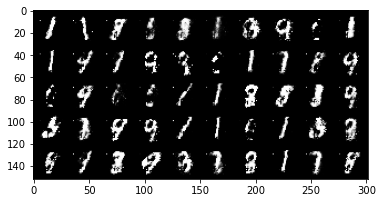

Iter: 54810/100000, Gen loss: 2.3570, Dis loss: 0.5392
Iter: 54820/100000, Gen loss: 2.1645, Dis loss: 0.4830
Iter: 54830/100000, Gen loss: 2.3519, Dis loss: 0.5601
Iter: 54840/100000, Gen loss: 2.4173, Dis loss: 0.4913
Iter: 54850/100000, Gen loss: 2.1281, Dis loss: 0.7623
Iter: 54860/100000, Gen loss: 1.9248, Dis loss: 0.4384
Iter: 54870/100000, Gen loss: 2.1174, Dis loss: 0.4299
Iter: 54880/100000, Gen loss: 2.4125, Dis loss: 0.2295
Iter: 54890/100000, Gen loss: 2.1470, Dis loss: 0.4307
Iter: 54900/100000, Gen loss: 2.1494, Dis loss: 0.2704
Iter: 54910/100000, Gen loss: 2.8861, Dis loss: 0.6186
Iter: 54920/100000, Gen loss: 2.3188, Dis loss: 0.4689
Iter: 54930/100000, Gen loss: 1.8946, Dis loss: 0.4676
Iter: 54940/100000, Gen loss: 2.4435, Dis loss: 0.3661
Iter: 54950/100000, Gen loss: 2.0281, Dis loss: 0.5493
Iter: 54960/100000, Gen loss: 2.5120, Dis loss: 0.5167
Iter: 54970/100000, Gen loss: 2.2902, Dis loss: 0.5618
Iter: 54980/100000, Gen loss: 1.9144, Dis loss: 0.4663
Iter: 5499

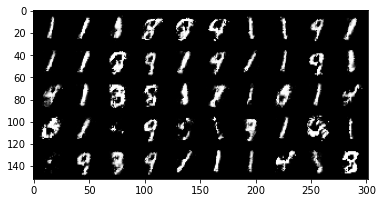

Iter: 55010/100000, Gen loss: 2.3976, Dis loss: 0.3828
Iter: 55020/100000, Gen loss: 2.1412, Dis loss: 0.6682
Iter: 55030/100000, Gen loss: 2.1781, Dis loss: 0.4382
Iter: 55040/100000, Gen loss: 2.1270, Dis loss: 0.3022
Iter: 55050/100000, Gen loss: 2.0227, Dis loss: 0.4891
Iter: 55060/100000, Gen loss: 1.6348, Dis loss: 0.4747
Iter: 55070/100000, Gen loss: 1.8734, Dis loss: 0.3592
Iter: 55080/100000, Gen loss: 2.1612, Dis loss: 0.4951
Iter: 55090/100000, Gen loss: 1.9618, Dis loss: 0.7006
Iter: 55100/100000, Gen loss: 2.0167, Dis loss: 0.4738
Iter: 55110/100000, Gen loss: 2.0992, Dis loss: 0.4673
Iter: 55120/100000, Gen loss: 2.5324, Dis loss: 0.5857
Iter: 55130/100000, Gen loss: 1.8367, Dis loss: 0.9242
Iter: 55140/100000, Gen loss: 1.9563, Dis loss: 0.5409
Iter: 55150/100000, Gen loss: 1.8847, Dis loss: 0.6009
Iter: 55160/100000, Gen loss: 1.9304, Dis loss: 0.4329
Iter: 55170/100000, Gen loss: 2.1510, Dis loss: 0.4918
Iter: 55180/100000, Gen loss: 2.1896, Dis loss: 0.3668
Iter: 5519

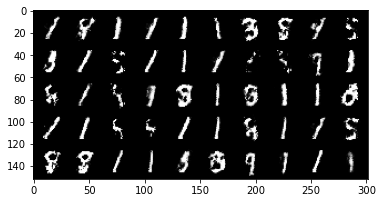

Iter: 55210/100000, Gen loss: 1.9385, Dis loss: 0.4501
Iter: 55220/100000, Gen loss: 2.0146, Dis loss: 0.9440
Iter: 55230/100000, Gen loss: 2.2467, Dis loss: 0.4719
Iter: 55240/100000, Gen loss: 2.2069, Dis loss: 0.7867
Iter: 55250/100000, Gen loss: 2.1596, Dis loss: 0.6108
Iter: 55260/100000, Gen loss: 2.5760, Dis loss: 0.5516
Iter: 55270/100000, Gen loss: 2.4329, Dis loss: 0.6029
Iter: 55280/100000, Gen loss: 1.8040, Dis loss: 0.4112
Iter: 55290/100000, Gen loss: 1.6782, Dis loss: 0.3727
Iter: 55300/100000, Gen loss: 2.8001, Dis loss: 0.6309
Iter: 55310/100000, Gen loss: 2.3003, Dis loss: 0.3620
Iter: 55320/100000, Gen loss: 1.7702, Dis loss: 0.5983
Iter: 55330/100000, Gen loss: 2.5789, Dis loss: 0.7203
Iter: 55340/100000, Gen loss: 2.3635, Dis loss: 0.4401
Iter: 55350/100000, Gen loss: 2.3346, Dis loss: 0.3876
Iter: 55360/100000, Gen loss: 2.4805, Dis loss: 1.0466
Iter: 55370/100000, Gen loss: 2.5306, Dis loss: 0.6597
Iter: 55380/100000, Gen loss: 2.4850, Dis loss: 0.4720
Iter: 5539

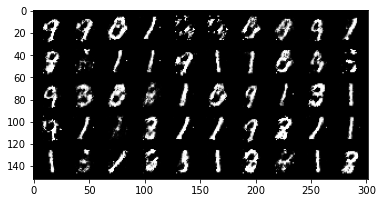

Iter: 55410/100000, Gen loss: 2.3438, Dis loss: 0.5813
Iter: 55420/100000, Gen loss: 2.6478, Dis loss: 0.6248
Iter: 55430/100000, Gen loss: 2.0256, Dis loss: 0.6539
Iter: 55440/100000, Gen loss: 2.3764, Dis loss: 0.5913
Iter: 55450/100000, Gen loss: 1.7960, Dis loss: 0.7085
Iter: 55460/100000, Gen loss: 2.5185, Dis loss: 0.5940
Iter: 55470/100000, Gen loss: 2.2495, Dis loss: 0.3074
Iter: 55480/100000, Gen loss: 1.7080, Dis loss: 0.3440
Iter: 55490/100000, Gen loss: 1.8979, Dis loss: 0.5433
Iter: 55500/100000, Gen loss: 2.2114, Dis loss: 0.5538
Iter: 55510/100000, Gen loss: 2.0961, Dis loss: 0.7729
Iter: 55520/100000, Gen loss: 1.9345, Dis loss: 0.5515
Iter: 55530/100000, Gen loss: 1.8587, Dis loss: 0.6039
Iter: 55540/100000, Gen loss: 2.2973, Dis loss: 0.8671
Iter: 55550/100000, Gen loss: 2.4667, Dis loss: 0.6519
Iter: 55560/100000, Gen loss: 2.0183, Dis loss: 0.5259
Iter: 55570/100000, Gen loss: 2.1423, Dis loss: 0.5875
Iter: 55580/100000, Gen loss: 2.0104, Dis loss: 0.5585
Iter: 5559

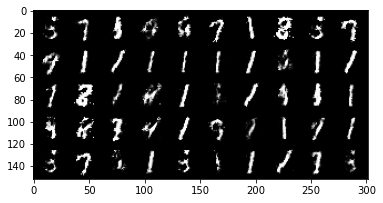

Iter: 55610/100000, Gen loss: 2.1309, Dis loss: 0.4183
Iter: 55620/100000, Gen loss: 1.6741, Dis loss: 0.2896
Iter: 55630/100000, Gen loss: 1.9655, Dis loss: 0.5989
Iter: 55640/100000, Gen loss: 2.4846, Dis loss: 0.3908
Iter: 55650/100000, Gen loss: 2.1404, Dis loss: 0.4699
Iter: 55660/100000, Gen loss: 2.2226, Dis loss: 0.5924
Iter: 55670/100000, Gen loss: 2.2949, Dis loss: 0.7226
Iter: 55680/100000, Gen loss: 1.9844, Dis loss: 0.6388
Iter: 55690/100000, Gen loss: 1.8832, Dis loss: 0.3711
Iter: 55700/100000, Gen loss: 2.3075, Dis loss: 0.4045
Iter: 55710/100000, Gen loss: 2.6409, Dis loss: 0.3799
Iter: 55720/100000, Gen loss: 2.0043, Dis loss: 0.5020
Iter: 55730/100000, Gen loss: 2.0570, Dis loss: 0.5230
Iter: 55740/100000, Gen loss: 2.2650, Dis loss: 0.2921
Iter: 55750/100000, Gen loss: 2.7861, Dis loss: 0.5427
Iter: 55760/100000, Gen loss: 2.0808, Dis loss: 0.5554
Iter: 55770/100000, Gen loss: 2.0547, Dis loss: 0.6176
Iter: 55780/100000, Gen loss: 1.6596, Dis loss: 0.6782
Iter: 5579

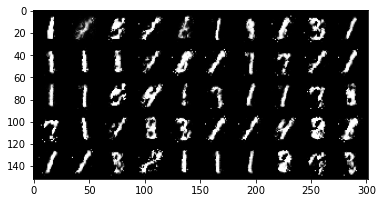

Iter: 55810/100000, Gen loss: 2.1255, Dis loss: 0.4325
Iter: 55820/100000, Gen loss: 2.3573, Dis loss: 0.2995
Iter: 55830/100000, Gen loss: 1.9922, Dis loss: 0.5314
Iter: 55840/100000, Gen loss: 1.8888, Dis loss: 0.3396
Iter: 55850/100000, Gen loss: 1.9275, Dis loss: 0.4045
Iter: 55860/100000, Gen loss: 1.9977, Dis loss: 0.3889
Iter: 55870/100000, Gen loss: 1.7602, Dis loss: 0.5550
Iter: 55880/100000, Gen loss: 2.0706, Dis loss: 0.4035
Iter: 55890/100000, Gen loss: 1.8057, Dis loss: 0.4899
Iter: 55900/100000, Gen loss: 2.1251, Dis loss: 0.3656
Iter: 55910/100000, Gen loss: 2.6813, Dis loss: 0.6457
Iter: 55920/100000, Gen loss: 2.5452, Dis loss: 0.4050
Iter: 55930/100000, Gen loss: 2.4585, Dis loss: 0.3140
Iter: 55940/100000, Gen loss: 2.0072, Dis loss: 0.6610
Iter: 55950/100000, Gen loss: 2.2612, Dis loss: 0.4187
Iter: 55960/100000, Gen loss: 2.6493, Dis loss: 0.5540
Iter: 55970/100000, Gen loss: 2.2638, Dis loss: 0.5676
Iter: 55980/100000, Gen loss: 1.6728, Dis loss: 0.4036
Iter: 5599

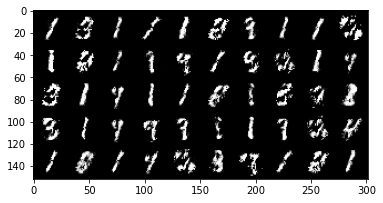

Iter: 56010/100000, Gen loss: 2.1074, Dis loss: 0.6382
Iter: 56020/100000, Gen loss: 2.1669, Dis loss: 0.6508
Iter: 56030/100000, Gen loss: 2.1995, Dis loss: 0.8185
Iter: 56040/100000, Gen loss: 2.0876, Dis loss: 0.4421
Iter: 56050/100000, Gen loss: 1.6989, Dis loss: 0.5792
Iter: 56060/100000, Gen loss: 2.1019, Dis loss: 0.3725
Iter: 56070/100000, Gen loss: 2.1188, Dis loss: 0.4621
Iter: 56080/100000, Gen loss: 2.4040, Dis loss: 0.3008
Iter: 56090/100000, Gen loss: 2.7394, Dis loss: 0.3003
Iter: 56100/100000, Gen loss: 2.4095, Dis loss: 0.4221
Iter: 56110/100000, Gen loss: 2.4324, Dis loss: 0.4079
Iter: 56120/100000, Gen loss: 2.1675, Dis loss: 0.3678
Iter: 56130/100000, Gen loss: 2.7493, Dis loss: 0.5282
Iter: 56140/100000, Gen loss: 2.6191, Dis loss: 0.4721
Iter: 56150/100000, Gen loss: 1.9635, Dis loss: 0.5028
Iter: 56160/100000, Gen loss: 2.5990, Dis loss: 0.5683
Iter: 56170/100000, Gen loss: 2.6004, Dis loss: 0.5799
Iter: 56180/100000, Gen loss: 1.9813, Dis loss: 0.5425
Iter: 5619

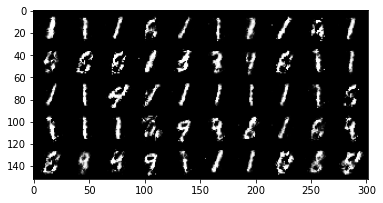

Iter: 56210/100000, Gen loss: 1.8595, Dis loss: 0.4715
Iter: 56220/100000, Gen loss: 1.9999, Dis loss: 0.3877
Iter: 56230/100000, Gen loss: 2.3199, Dis loss: 0.4759
Iter: 56240/100000, Gen loss: 2.1464, Dis loss: 0.4048
Iter: 56250/100000, Gen loss: 1.9600, Dis loss: 0.4086
Iter: 56260/100000, Gen loss: 2.2269, Dis loss: 0.5614
Iter: 56270/100000, Gen loss: 2.3640, Dis loss: 0.5048
Iter: 56280/100000, Gen loss: 1.6800, Dis loss: 0.9101
Iter: 56290/100000, Gen loss: 1.6887, Dis loss: 0.5298
Iter: 56300/100000, Gen loss: 2.1455, Dis loss: 0.6370
Iter: 56310/100000, Gen loss: 2.5053, Dis loss: 0.7628
Iter: 56320/100000, Gen loss: 2.7854, Dis loss: 0.4045
Iter: 56330/100000, Gen loss: 2.2202, Dis loss: 0.6021
Iter: 56340/100000, Gen loss: 2.4585, Dis loss: 0.4133
Iter: 56350/100000, Gen loss: 2.7066, Dis loss: 0.6395
Iter: 56360/100000, Gen loss: 2.2558, Dis loss: 0.7624
Iter: 56370/100000, Gen loss: 2.1387, Dis loss: 0.6626
Iter: 56380/100000, Gen loss: 2.4514, Dis loss: 0.7453
Iter: 5639

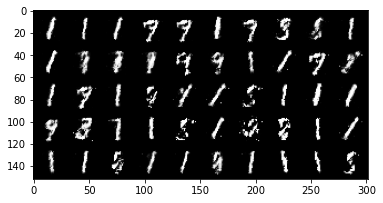

Iter: 56410/100000, Gen loss: 1.8616, Dis loss: 0.5210
Iter: 56420/100000, Gen loss: 2.1147, Dis loss: 0.7689
Iter: 56430/100000, Gen loss: 2.3227, Dis loss: 0.4562
Iter: 56440/100000, Gen loss: 1.4322, Dis loss: 0.5506
Iter: 56450/100000, Gen loss: 1.8891, Dis loss: 0.6805
Iter: 56460/100000, Gen loss: 2.2022, Dis loss: 0.6307
Iter: 56470/100000, Gen loss: 2.3565, Dis loss: 0.4225
Iter: 56480/100000, Gen loss: 1.8556, Dis loss: 0.5266
Iter: 56490/100000, Gen loss: 2.0203, Dis loss: 0.5001
Iter: 56500/100000, Gen loss: 2.0882, Dis loss: 0.6783
Iter: 56510/100000, Gen loss: 2.0254, Dis loss: 0.5083
Iter: 56520/100000, Gen loss: 1.8318, Dis loss: 0.6643
Iter: 56530/100000, Gen loss: 2.3507, Dis loss: 0.6745
Iter: 56540/100000, Gen loss: 2.1851, Dis loss: 0.7093
Iter: 56550/100000, Gen loss: 1.9719, Dis loss: 0.8238
Iter: 56560/100000, Gen loss: 2.1301, Dis loss: 0.6005
Iter: 56570/100000, Gen loss: 1.5916, Dis loss: 0.5356
Iter: 56580/100000, Gen loss: 2.1558, Dis loss: 0.5616
Iter: 5659

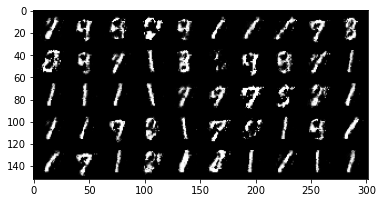

Iter: 56610/100000, Gen loss: 2.3288, Dis loss: 0.5360
Iter: 56620/100000, Gen loss: 2.1345, Dis loss: 0.7514
Iter: 56630/100000, Gen loss: 2.3266, Dis loss: 0.3802
Iter: 56640/100000, Gen loss: 1.8558, Dis loss: 0.5993
Iter: 56650/100000, Gen loss: 2.0826, Dis loss: 0.4850
Iter: 56660/100000, Gen loss: 1.9460, Dis loss: 0.6061
Iter: 56670/100000, Gen loss: 2.4077, Dis loss: 0.6726
Iter: 56680/100000, Gen loss: 2.1661, Dis loss: 0.5833
Iter: 56690/100000, Gen loss: 1.8828, Dis loss: 0.8377
Iter: 56700/100000, Gen loss: 2.4882, Dis loss: 0.6271
Iter: 56710/100000, Gen loss: 2.1692, Dis loss: 0.8533
Iter: 56720/100000, Gen loss: 2.2391, Dis loss: 0.5700
Iter: 56730/100000, Gen loss: 1.9916, Dis loss: 0.4204
Iter: 56740/100000, Gen loss: 2.5435, Dis loss: 0.8124
Iter: 56750/100000, Gen loss: 1.9382, Dis loss: 0.5536
Iter: 56760/100000, Gen loss: 1.6215, Dis loss: 0.8159
Iter: 56770/100000, Gen loss: 1.9257, Dis loss: 0.4093
Iter: 56780/100000, Gen loss: 1.7041, Dis loss: 0.7121
Iter: 5679

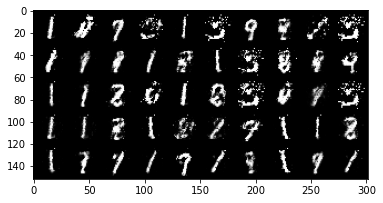

Iter: 56810/100000, Gen loss: 1.9155, Dis loss: 0.7822
Iter: 56820/100000, Gen loss: 2.0494, Dis loss: 0.4419
Iter: 56830/100000, Gen loss: 2.5333, Dis loss: 0.5654
Iter: 56840/100000, Gen loss: 1.8220, Dis loss: 0.7706
Iter: 56850/100000, Gen loss: 1.9129, Dis loss: 0.7123
Iter: 56860/100000, Gen loss: 1.9240, Dis loss: 0.7406
Iter: 56870/100000, Gen loss: 2.3128, Dis loss: 0.6629
Iter: 56880/100000, Gen loss: 2.1759, Dis loss: 0.5068
Iter: 56890/100000, Gen loss: 1.9238, Dis loss: 0.6445
Iter: 56900/100000, Gen loss: 2.0092, Dis loss: 0.6775
Iter: 56910/100000, Gen loss: 1.8222, Dis loss: 0.5143
Iter: 56920/100000, Gen loss: 2.2258, Dis loss: 0.6158
Iter: 56930/100000, Gen loss: 2.2361, Dis loss: 0.3412
Iter: 56940/100000, Gen loss: 1.7277, Dis loss: 0.6989
Iter: 56950/100000, Gen loss: 1.9839, Dis loss: 0.6999
Iter: 56960/100000, Gen loss: 2.0876, Dis loss: 0.7309
Iter: 56970/100000, Gen loss: 2.5039, Dis loss: 0.3304
Iter: 56980/100000, Gen loss: 2.0570, Dis loss: 0.5220
Iter: 5699

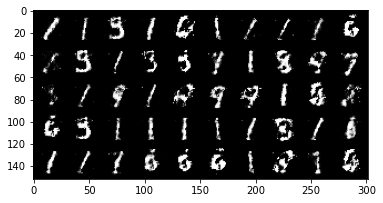

Iter: 57010/100000, Gen loss: 2.1293, Dis loss: 0.3987
Iter: 57020/100000, Gen loss: 1.8450, Dis loss: 0.7416
Iter: 57030/100000, Gen loss: 1.6572, Dis loss: 0.5981
Iter: 57040/100000, Gen loss: 2.1490, Dis loss: 0.4070
Iter: 57050/100000, Gen loss: 2.2644, Dis loss: 0.4752
Iter: 57060/100000, Gen loss: 2.4003, Dis loss: 0.4860
Iter: 57070/100000, Gen loss: 2.0084, Dis loss: 0.7216
Iter: 57080/100000, Gen loss: 1.9153, Dis loss: 0.5777
Iter: 57090/100000, Gen loss: 1.9048, Dis loss: 0.6254
Iter: 57100/100000, Gen loss: 2.1033, Dis loss: 0.5463
Iter: 57110/100000, Gen loss: 2.4549, Dis loss: 0.4845
Iter: 57120/100000, Gen loss: 2.0222, Dis loss: 0.5173
Iter: 57130/100000, Gen loss: 1.6146, Dis loss: 0.6844
Iter: 57140/100000, Gen loss: 1.7777, Dis loss: 0.9901
Iter: 57150/100000, Gen loss: 2.3695, Dis loss: 0.5039
Iter: 57160/100000, Gen loss: 1.9080, Dis loss: 0.4521
Iter: 57170/100000, Gen loss: 1.8002, Dis loss: 0.7025
Iter: 57180/100000, Gen loss: 2.1917, Dis loss: 0.5490
Iter: 5719

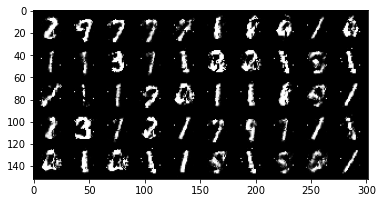

Iter: 57210/100000, Gen loss: 2.3239, Dis loss: 0.5122
Iter: 57220/100000, Gen loss: 2.0829, Dis loss: 0.4200
Iter: 57230/100000, Gen loss: 2.2605, Dis loss: 0.4292
Iter: 57240/100000, Gen loss: 1.9465, Dis loss: 0.5478
Iter: 57250/100000, Gen loss: 2.7277, Dis loss: 0.5580
Iter: 57260/100000, Gen loss: 2.7560, Dis loss: 0.3950
Iter: 57270/100000, Gen loss: 2.0271, Dis loss: 0.6233
Iter: 57280/100000, Gen loss: 1.8048, Dis loss: 0.6061
Iter: 57290/100000, Gen loss: 2.3607, Dis loss: 0.4132
Iter: 57300/100000, Gen loss: 2.7435, Dis loss: 0.4491
Iter: 57310/100000, Gen loss: 2.3251, Dis loss: 0.4667
Iter: 57320/100000, Gen loss: 1.8624, Dis loss: 0.6003
Iter: 57330/100000, Gen loss: 2.4156, Dis loss: 0.9037
Iter: 57340/100000, Gen loss: 1.8526, Dis loss: 0.6677
Iter: 57350/100000, Gen loss: 2.3445, Dis loss: 0.7007
Iter: 57360/100000, Gen loss: 2.3902, Dis loss: 0.6978
Iter: 57370/100000, Gen loss: 2.0615, Dis loss: 0.4804
Iter: 57380/100000, Gen loss: 1.8931, Dis loss: 0.7617
Iter: 5739

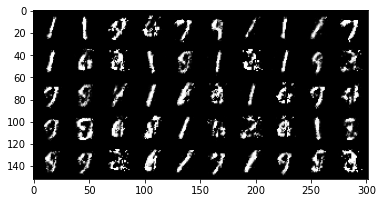

Iter: 57410/100000, Gen loss: 2.0307, Dis loss: 0.5360
Iter: 57420/100000, Gen loss: 2.0115, Dis loss: 0.4573
Iter: 57430/100000, Gen loss: 2.1782, Dis loss: 0.4887
Iter: 57440/100000, Gen loss: 2.6628, Dis loss: 0.2686
Iter: 57450/100000, Gen loss: 2.1292, Dis loss: 0.6217
Iter: 57460/100000, Gen loss: 1.6517, Dis loss: 0.9810
Iter: 57470/100000, Gen loss: 2.3747, Dis loss: 0.6584
Iter: 57480/100000, Gen loss: 2.5513, Dis loss: 0.5845
Iter: 57490/100000, Gen loss: 1.9883, Dis loss: 0.5190
Iter: 57500/100000, Gen loss: 1.5645, Dis loss: 0.6870
Iter: 57510/100000, Gen loss: 1.8987, Dis loss: 0.5585
Iter: 57520/100000, Gen loss: 1.9084, Dis loss: 0.6520
Iter: 57530/100000, Gen loss: 2.2337, Dis loss: 0.3858
Iter: 57540/100000, Gen loss: 2.0758, Dis loss: 0.4769
Iter: 57550/100000, Gen loss: 2.0429, Dis loss: 0.7640
Iter: 57560/100000, Gen loss: 2.0695, Dis loss: 0.3297
Iter: 57570/100000, Gen loss: 1.9032, Dis loss: 0.5474
Iter: 57580/100000, Gen loss: 2.1335, Dis loss: 0.5540
Iter: 5759

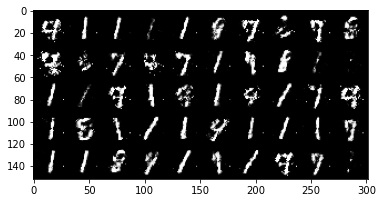

Iter: 57610/100000, Gen loss: 2.0336, Dis loss: 0.5101
Iter: 57620/100000, Gen loss: 2.0958, Dis loss: 0.6093
Iter: 57630/100000, Gen loss: 1.7451, Dis loss: 0.5082
Iter: 57640/100000, Gen loss: 2.4955, Dis loss: 0.5061
Iter: 57650/100000, Gen loss: 2.1091, Dis loss: 0.7273
Iter: 57660/100000, Gen loss: 2.0743, Dis loss: 0.9064
Iter: 57670/100000, Gen loss: 1.6552, Dis loss: 0.8793
Iter: 57680/100000, Gen loss: 2.0959, Dis loss: 0.6945
Iter: 57690/100000, Gen loss: 1.8955, Dis loss: 0.3711
Iter: 57700/100000, Gen loss: 1.8161, Dis loss: 0.4277
Iter: 57710/100000, Gen loss: 1.9238, Dis loss: 0.6380
Iter: 57720/100000, Gen loss: 2.1765, Dis loss: 0.4993
Iter: 57730/100000, Gen loss: 1.9120, Dis loss: 0.5388
Iter: 57740/100000, Gen loss: 1.8813, Dis loss: 0.6614
Iter: 57750/100000, Gen loss: 1.8479, Dis loss: 0.5204
Iter: 57760/100000, Gen loss: 2.1303, Dis loss: 0.7438
Iter: 57770/100000, Gen loss: 1.7869, Dis loss: 0.6091
Iter: 57780/100000, Gen loss: 1.8673, Dis loss: 0.7002
Iter: 5779

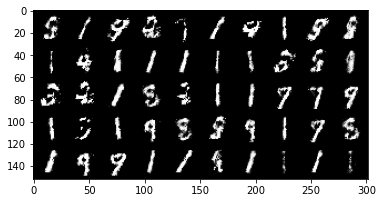

Iter: 57810/100000, Gen loss: 2.0533, Dis loss: 0.4854
Iter: 57820/100000, Gen loss: 2.1299, Dis loss: 0.4936
Iter: 57830/100000, Gen loss: 2.0815, Dis loss: 0.4843
Iter: 57840/100000, Gen loss: 2.0411, Dis loss: 0.4959
Iter: 57850/100000, Gen loss: 1.5566, Dis loss: 0.5205
Iter: 57860/100000, Gen loss: 2.3402, Dis loss: 0.9447
Iter: 57870/100000, Gen loss: 1.9052, Dis loss: 0.6223
Iter: 57880/100000, Gen loss: 2.0696, Dis loss: 0.8706
Iter: 57890/100000, Gen loss: 2.1382, Dis loss: 0.4990
Iter: 57900/100000, Gen loss: 2.2207, Dis loss: 0.8021
Iter: 57910/100000, Gen loss: 1.5402, Dis loss: 0.6020
Iter: 57920/100000, Gen loss: 1.7351, Dis loss: 0.8379
Iter: 57930/100000, Gen loss: 2.3019, Dis loss: 0.4752
Iter: 57940/100000, Gen loss: 1.9538, Dis loss: 0.4276
Iter: 57950/100000, Gen loss: 2.2303, Dis loss: 0.7282
Iter: 57960/100000, Gen loss: 2.4190, Dis loss: 0.6029
Iter: 57970/100000, Gen loss: 2.1313, Dis loss: 0.7064
Iter: 57980/100000, Gen loss: 1.9417, Dis loss: 0.6578
Iter: 5799

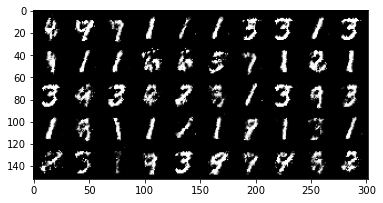

Iter: 58010/100000, Gen loss: 2.2454, Dis loss: 0.4872
Iter: 58020/100000, Gen loss: 1.8664, Dis loss: 0.5404
Iter: 58030/100000, Gen loss: 2.2816, Dis loss: 0.7849
Iter: 58040/100000, Gen loss: 2.0684, Dis loss: 0.5445
Iter: 58050/100000, Gen loss: 1.7103, Dis loss: 0.4381
Iter: 58060/100000, Gen loss: 1.7362, Dis loss: 0.7396
Iter: 58070/100000, Gen loss: 1.8303, Dis loss: 0.5927
Iter: 58080/100000, Gen loss: 2.2480, Dis loss: 0.5924
Iter: 58090/100000, Gen loss: 1.6782, Dis loss: 0.8313
Iter: 58100/100000, Gen loss: 1.4457, Dis loss: 0.7761
Iter: 58110/100000, Gen loss: 2.1789, Dis loss: 0.8687
Iter: 58120/100000, Gen loss: 1.9798, Dis loss: 0.6930
Iter: 58130/100000, Gen loss: 2.1125, Dis loss: 0.8100
Iter: 58140/100000, Gen loss: 2.6324, Dis loss: 0.4774
Iter: 58150/100000, Gen loss: 2.1535, Dis loss: 0.5712
Iter: 58160/100000, Gen loss: 2.5509, Dis loss: 0.7562
Iter: 58170/100000, Gen loss: 2.2424, Dis loss: 0.5238
Iter: 58180/100000, Gen loss: 2.3925, Dis loss: 0.8828
Iter: 5819

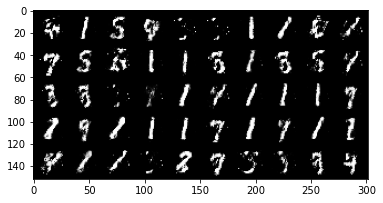

Iter: 58210/100000, Gen loss: 2.1263, Dis loss: 0.4486
Iter: 58220/100000, Gen loss: 2.0831, Dis loss: 0.3514
Iter: 58230/100000, Gen loss: 1.9047, Dis loss: 0.6396
Iter: 58240/100000, Gen loss: 2.0875, Dis loss: 0.5491
Iter: 58250/100000, Gen loss: 1.8875, Dis loss: 0.6701
Iter: 58260/100000, Gen loss: 1.8417, Dis loss: 0.5288
Iter: 58270/100000, Gen loss: 1.8269, Dis loss: 0.6359
Iter: 58280/100000, Gen loss: 1.5754, Dis loss: 0.7339
Iter: 58290/100000, Gen loss: 1.9477, Dis loss: 0.6642
Iter: 58300/100000, Gen loss: 1.7806, Dis loss: 0.6873
Iter: 58310/100000, Gen loss: 2.1691, Dis loss: 0.4827
Iter: 58320/100000, Gen loss: 2.1411, Dis loss: 0.5072
Iter: 58330/100000, Gen loss: 2.6847, Dis loss: 0.4310
Iter: 58340/100000, Gen loss: 2.4788, Dis loss: 0.5142
Iter: 58350/100000, Gen loss: 2.1867, Dis loss: 0.6317
Iter: 58360/100000, Gen loss: 2.3066, Dis loss: 0.5024
Iter: 58370/100000, Gen loss: 1.8371, Dis loss: 0.6857
Iter: 58380/100000, Gen loss: 2.1358, Dis loss: 0.6147
Iter: 5839

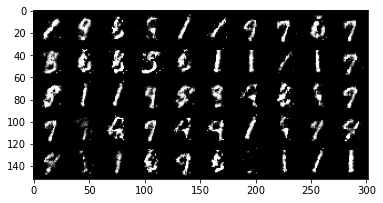

Iter: 58410/100000, Gen loss: 2.0938, Dis loss: 0.5152
Iter: 58420/100000, Gen loss: 1.7935, Dis loss: 0.4433
Iter: 58430/100000, Gen loss: 2.5607, Dis loss: 0.6138
Iter: 58440/100000, Gen loss: 1.7953, Dis loss: 0.5697
Iter: 58450/100000, Gen loss: 2.1987, Dis loss: 0.6123
Iter: 58460/100000, Gen loss: 1.7981, Dis loss: 0.5219
Iter: 58470/100000, Gen loss: 1.7230, Dis loss: 0.6998
Iter: 58480/100000, Gen loss: 2.5951, Dis loss: 0.4338
Iter: 58490/100000, Gen loss: 1.9658, Dis loss: 0.6268
Iter: 58500/100000, Gen loss: 1.6006, Dis loss: 0.5420
Iter: 58510/100000, Gen loss: 2.4324, Dis loss: 0.4047
Iter: 58520/100000, Gen loss: 2.1868, Dis loss: 0.4025
Iter: 58530/100000, Gen loss: 1.8784, Dis loss: 0.4646
Iter: 58540/100000, Gen loss: 1.9964, Dis loss: 0.4125
Iter: 58550/100000, Gen loss: 1.8836, Dis loss: 0.5100
Iter: 58560/100000, Gen loss: 2.0488, Dis loss: 0.6413
Iter: 58570/100000, Gen loss: 2.4783, Dis loss: 0.7351
Iter: 58580/100000, Gen loss: 2.2190, Dis loss: 0.3379
Iter: 5859

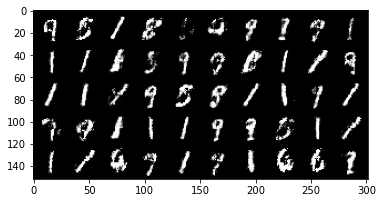

Iter: 58610/100000, Gen loss: 1.6336, Dis loss: 0.4323
Iter: 58620/100000, Gen loss: 1.5874, Dis loss: 0.5069
Iter: 58630/100000, Gen loss: 2.0722, Dis loss: 0.7206
Iter: 58640/100000, Gen loss: 2.3742, Dis loss: 0.3152
Iter: 58650/100000, Gen loss: 1.9325, Dis loss: 0.7164
Iter: 58660/100000, Gen loss: 1.7552, Dis loss: 0.4873
Iter: 58670/100000, Gen loss: 2.0779, Dis loss: 0.7478
Iter: 58680/100000, Gen loss: 1.9398, Dis loss: 0.5573
Iter: 58690/100000, Gen loss: 1.8607, Dis loss: 0.8373
Iter: 58700/100000, Gen loss: 2.1379, Dis loss: 0.5412
Iter: 58710/100000, Gen loss: 1.9565, Dis loss: 0.6836
Iter: 58720/100000, Gen loss: 1.7339, Dis loss: 0.7170
Iter: 58730/100000, Gen loss: 1.8746, Dis loss: 0.7322
Iter: 58740/100000, Gen loss: 1.8886, Dis loss: 0.6937
Iter: 58750/100000, Gen loss: 2.2688, Dis loss: 0.4855
Iter: 58760/100000, Gen loss: 1.8985, Dis loss: 0.5244
Iter: 58770/100000, Gen loss: 2.1045, Dis loss: 0.5799
Iter: 58780/100000, Gen loss: 2.0696, Dis loss: 0.6625
Iter: 5879

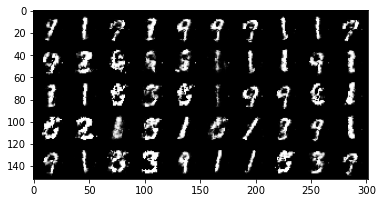

Iter: 58810/100000, Gen loss: 2.3275, Dis loss: 0.5946
Iter: 58820/100000, Gen loss: 1.7322, Dis loss: 0.5107
Iter: 58830/100000, Gen loss: 2.1223, Dis loss: 0.5262
Iter: 58840/100000, Gen loss: 2.9546, Dis loss: 0.9182
Iter: 58850/100000, Gen loss: 2.2853, Dis loss: 0.4552
Iter: 58860/100000, Gen loss: 1.8240, Dis loss: 0.5226
Iter: 58870/100000, Gen loss: 1.9413, Dis loss: 0.5355
Iter: 58880/100000, Gen loss: 2.3387, Dis loss: 0.5858
Iter: 58890/100000, Gen loss: 2.1997, Dis loss: 0.4603
Iter: 58900/100000, Gen loss: 1.8258, Dis loss: 0.5242
Iter: 58910/100000, Gen loss: 2.1959, Dis loss: 0.5460
Iter: 58920/100000, Gen loss: 1.8823, Dis loss: 0.5691
Iter: 58930/100000, Gen loss: 2.2869, Dis loss: 0.4227
Iter: 58940/100000, Gen loss: 1.9532, Dis loss: 0.5027
Iter: 58950/100000, Gen loss: 2.0245, Dis loss: 0.5119
Iter: 58960/100000, Gen loss: 1.6943, Dis loss: 0.6573
Iter: 58970/100000, Gen loss: 1.6942, Dis loss: 0.7398
Iter: 58980/100000, Gen loss: 2.1692, Dis loss: 0.5998
Iter: 5899

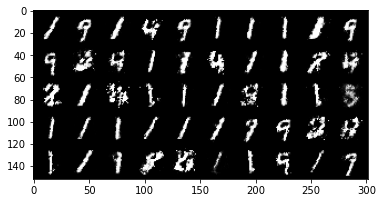

Iter: 59010/100000, Gen loss: 2.2284, Dis loss: 0.5706
Iter: 59020/100000, Gen loss: 1.8597, Dis loss: 0.5491
Iter: 59030/100000, Gen loss: 2.1098, Dis loss: 0.7300
Iter: 59040/100000, Gen loss: 1.7709, Dis loss: 0.6176
Iter: 59050/100000, Gen loss: 2.4815, Dis loss: 0.4944
Iter: 59060/100000, Gen loss: 2.4121, Dis loss: 0.5789
Iter: 59070/100000, Gen loss: 1.4573, Dis loss: 0.5559
Iter: 59080/100000, Gen loss: 2.0322, Dis loss: 0.5179
Iter: 59090/100000, Gen loss: 2.5559, Dis loss: 0.5773
Iter: 59100/100000, Gen loss: 2.0098, Dis loss: 0.4483
Iter: 59110/100000, Gen loss: 1.8375, Dis loss: 0.5359
Iter: 59120/100000, Gen loss: 1.9773, Dis loss: 0.4784
Iter: 59130/100000, Gen loss: 2.2279, Dis loss: 0.6252
Iter: 59140/100000, Gen loss: 1.9874, Dis loss: 0.6905
Iter: 59150/100000, Gen loss: 2.4418, Dis loss: 0.3320
Iter: 59160/100000, Gen loss: 2.1191, Dis loss: 0.5207
Iter: 59170/100000, Gen loss: 1.9237, Dis loss: 0.4622
Iter: 59180/100000, Gen loss: 2.1537, Dis loss: 0.6173
Iter: 5919

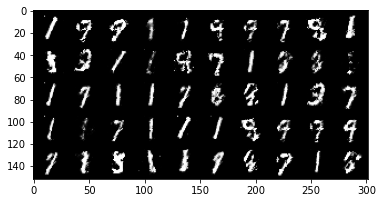

Iter: 59210/100000, Gen loss: 2.4528, Dis loss: 0.5300
Iter: 59220/100000, Gen loss: 1.5787, Dis loss: 0.8225
Iter: 59230/100000, Gen loss: 1.6152, Dis loss: 0.8683
Iter: 59240/100000, Gen loss: 2.1042, Dis loss: 0.7030
Iter: 59250/100000, Gen loss: 1.9565, Dis loss: 0.6104
Iter: 59260/100000, Gen loss: 1.6902, Dis loss: 0.5519
Iter: 59270/100000, Gen loss: 2.0421, Dis loss: 0.3979
Iter: 59280/100000, Gen loss: 2.0167, Dis loss: 0.5980
Iter: 59290/100000, Gen loss: 1.9640, Dis loss: 0.4311
Iter: 59300/100000, Gen loss: 1.6480, Dis loss: 0.8831
Iter: 59310/100000, Gen loss: 2.3835, Dis loss: 0.7129
Iter: 59320/100000, Gen loss: 2.2449, Dis loss: 0.6289
Iter: 59330/100000, Gen loss: 1.8198, Dis loss: 0.6043
Iter: 59340/100000, Gen loss: 1.4619, Dis loss: 0.5472
Iter: 59350/100000, Gen loss: 1.5784, Dis loss: 0.7947
Iter: 59360/100000, Gen loss: 1.7076, Dis loss: 0.4124
Iter: 59370/100000, Gen loss: 1.9317, Dis loss: 0.7094
Iter: 59380/100000, Gen loss: 1.9960, Dis loss: 0.5145
Iter: 5939

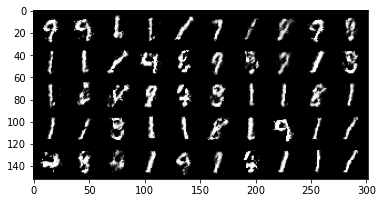

Iter: 59410/100000, Gen loss: 1.9389, Dis loss: 0.6834
Iter: 59420/100000, Gen loss: 1.8409, Dis loss: 0.5479
Iter: 59430/100000, Gen loss: 1.1448, Dis loss: 0.8874
Iter: 59440/100000, Gen loss: 1.5232, Dis loss: 0.6082
Iter: 59450/100000, Gen loss: 1.7179, Dis loss: 0.9558
Iter: 59460/100000, Gen loss: 2.1818, Dis loss: 0.3595
Iter: 59470/100000, Gen loss: 1.8868, Dis loss: 0.6914
Iter: 59480/100000, Gen loss: 1.8253, Dis loss: 0.5401
Iter: 59490/100000, Gen loss: 1.7731, Dis loss: 0.5043
Iter: 59500/100000, Gen loss: 1.5792, Dis loss: 0.5433
Iter: 59510/100000, Gen loss: 1.8163, Dis loss: 0.6102
Iter: 59520/100000, Gen loss: 2.3998, Dis loss: 1.0393
Iter: 59530/100000, Gen loss: 2.3506, Dis loss: 0.6503
Iter: 59540/100000, Gen loss: 1.3399, Dis loss: 0.5697
Iter: 59550/100000, Gen loss: 2.0323, Dis loss: 0.3952
Iter: 59560/100000, Gen loss: 2.0229, Dis loss: 0.5416
Iter: 59570/100000, Gen loss: 1.5800, Dis loss: 0.8917
Iter: 59580/100000, Gen loss: 1.7898, Dis loss: 0.4275
Iter: 5959

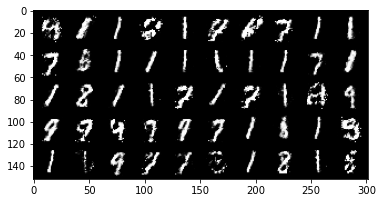

Iter: 59610/100000, Gen loss: 1.9969, Dis loss: 0.4236
Iter: 59620/100000, Gen loss: 1.9730, Dis loss: 0.9732
Iter: 59630/100000, Gen loss: 1.9890, Dis loss: 0.6153
Iter: 59640/100000, Gen loss: 1.7127, Dis loss: 0.6411
Iter: 59650/100000, Gen loss: 1.5756, Dis loss: 0.5099
Iter: 59660/100000, Gen loss: 1.7342, Dis loss: 0.7417
Iter: 59670/100000, Gen loss: 1.9611, Dis loss: 0.7536
Iter: 59680/100000, Gen loss: 1.6756, Dis loss: 0.8194
Iter: 59690/100000, Gen loss: 1.9641, Dis loss: 0.7233
Iter: 59700/100000, Gen loss: 1.6490, Dis loss: 1.2616
Iter: 59710/100000, Gen loss: 1.7785, Dis loss: 0.6322
Iter: 59720/100000, Gen loss: 1.8050, Dis loss: 0.6369
Iter: 59730/100000, Gen loss: 1.5292, Dis loss: 0.6593
Iter: 59740/100000, Gen loss: 1.3809, Dis loss: 0.6090
Iter: 59750/100000, Gen loss: 1.7297, Dis loss: 0.6094
Iter: 59760/100000, Gen loss: 2.4248, Dis loss: 0.3301
Iter: 59770/100000, Gen loss: 2.0894, Dis loss: 0.7354
Iter: 59780/100000, Gen loss: 1.5797, Dis loss: 0.4805
Iter: 5979

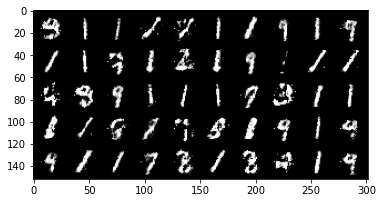

Iter: 59810/100000, Gen loss: 2.1659, Dis loss: 0.8486
Iter: 59820/100000, Gen loss: 1.7007, Dis loss: 0.6756
Iter: 59830/100000, Gen loss: 1.8156, Dis loss: 0.8097
Iter: 59840/100000, Gen loss: 1.7400, Dis loss: 0.6429
Iter: 59850/100000, Gen loss: 1.5779, Dis loss: 0.8172
Iter: 59860/100000, Gen loss: 2.0031, Dis loss: 0.5606
Iter: 59870/100000, Gen loss: 2.1391, Dis loss: 0.7237
Iter: 59880/100000, Gen loss: 1.9604, Dis loss: 0.7229
Iter: 59890/100000, Gen loss: 1.9992, Dis loss: 0.7902
Iter: 59900/100000, Gen loss: 1.7385, Dis loss: 0.7186
Iter: 59910/100000, Gen loss: 2.2177, Dis loss: 0.5576
Iter: 59920/100000, Gen loss: 1.9880, Dis loss: 0.7966
Iter: 59930/100000, Gen loss: 1.9438, Dis loss: 0.7221
Iter: 59940/100000, Gen loss: 1.6860, Dis loss: 0.5995
Iter: 59950/100000, Gen loss: 1.5940, Dis loss: 0.5410
Iter: 59960/100000, Gen loss: 1.8050, Dis loss: 0.6524
Iter: 59970/100000, Gen loss: 1.6420, Dis loss: 0.9923
Iter: 59980/100000, Gen loss: 1.8967, Dis loss: 0.8108
Iter: 5999

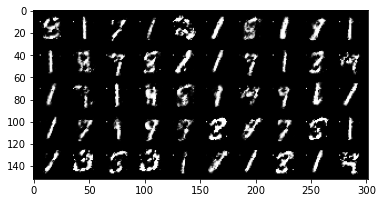

Iter: 60010/100000, Gen loss: 1.7660, Dis loss: 0.6493
Iter: 60020/100000, Gen loss: 2.0367, Dis loss: 0.8993
Iter: 60030/100000, Gen loss: 1.6917, Dis loss: 0.5713
Iter: 60040/100000, Gen loss: 1.9030, Dis loss: 0.8639
Iter: 60050/100000, Gen loss: 2.1099, Dis loss: 0.8770
Iter: 60060/100000, Gen loss: 1.5978, Dis loss: 0.8875
Iter: 60070/100000, Gen loss: 1.7268, Dis loss: 0.7643
Iter: 60080/100000, Gen loss: 2.0820, Dis loss: 0.5598
Iter: 60090/100000, Gen loss: 1.8519, Dis loss: 0.5771
Iter: 60100/100000, Gen loss: 1.9016, Dis loss: 0.6605
Iter: 60110/100000, Gen loss: 1.9944, Dis loss: 0.6203
Iter: 60120/100000, Gen loss: 1.8650, Dis loss: 0.7245
Iter: 60130/100000, Gen loss: 2.0229, Dis loss: 0.4731
Iter: 60140/100000, Gen loss: 2.1514, Dis loss: 0.4258
Iter: 60150/100000, Gen loss: 1.9983, Dis loss: 0.5470
Iter: 60160/100000, Gen loss: 1.9938, Dis loss: 0.7306
Iter: 60170/100000, Gen loss: 2.2947, Dis loss: 0.6861
Iter: 60180/100000, Gen loss: 1.6643, Dis loss: 0.7386
Iter: 6019

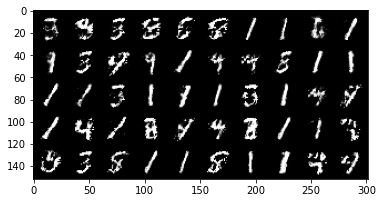

Iter: 60210/100000, Gen loss: 1.7405, Dis loss: 0.6125
Iter: 60220/100000, Gen loss: 1.7514, Dis loss: 0.7388
Iter: 60230/100000, Gen loss: 2.0227, Dis loss: 0.5100
Iter: 60240/100000, Gen loss: 1.6249, Dis loss: 0.6310
Iter: 60250/100000, Gen loss: 1.7856, Dis loss: 0.6069
Iter: 60260/100000, Gen loss: 1.7823, Dis loss: 0.5956
Iter: 60270/100000, Gen loss: 2.2102, Dis loss: 0.4101
Iter: 60280/100000, Gen loss: 2.1902, Dis loss: 0.5216
Iter: 60290/100000, Gen loss: 2.0669, Dis loss: 0.6710
Iter: 60300/100000, Gen loss: 2.0133, Dis loss: 0.6268
Iter: 60310/100000, Gen loss: 1.6620, Dis loss: 0.5834
Iter: 60320/100000, Gen loss: 2.0242, Dis loss: 0.7740
Iter: 60330/100000, Gen loss: 1.8448, Dis loss: 0.5134
Iter: 60340/100000, Gen loss: 2.0546, Dis loss: 0.4982
Iter: 60350/100000, Gen loss: 2.1358, Dis loss: 0.4071
Iter: 60360/100000, Gen loss: 1.8770, Dis loss: 0.7908
Iter: 60370/100000, Gen loss: 1.4743, Dis loss: 0.6959
Iter: 60380/100000, Gen loss: 1.6688, Dis loss: 0.3923
Iter: 6039

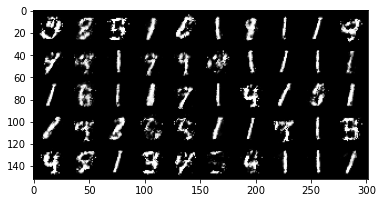

Iter: 60410/100000, Gen loss: 2.5998, Dis loss: 0.3349
Iter: 60420/100000, Gen loss: 1.8226, Dis loss: 0.6131
Iter: 60430/100000, Gen loss: 1.6277, Dis loss: 0.6734
Iter: 60440/100000, Gen loss: 2.1865, Dis loss: 0.6379
Iter: 60450/100000, Gen loss: 2.2525, Dis loss: 0.4913
Iter: 60460/100000, Gen loss: 1.8296, Dis loss: 0.6522
Iter: 60470/100000, Gen loss: 1.5958, Dis loss: 0.6252
Iter: 60480/100000, Gen loss: 1.6973, Dis loss: 0.6334
Iter: 60490/100000, Gen loss: 2.0997, Dis loss: 0.4318
Iter: 60500/100000, Gen loss: 2.0414, Dis loss: 0.4860
Iter: 60510/100000, Gen loss: 1.4923, Dis loss: 0.7025
Iter: 60520/100000, Gen loss: 1.9499, Dis loss: 0.6405
Iter: 60530/100000, Gen loss: 2.2007, Dis loss: 0.4868
Iter: 60540/100000, Gen loss: 1.6995, Dis loss: 0.6202
Iter: 60550/100000, Gen loss: 2.1635, Dis loss: 0.3651
Iter: 60560/100000, Gen loss: 1.7725, Dis loss: 0.6821
Iter: 60570/100000, Gen loss: 1.9312, Dis loss: 0.4354
Iter: 60580/100000, Gen loss: 1.6804, Dis loss: 0.7003
Iter: 6059

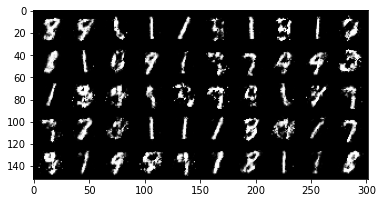

Iter: 60610/100000, Gen loss: 1.6542, Dis loss: 0.9691
Iter: 60620/100000, Gen loss: 1.8505, Dis loss: 0.7593
Iter: 60630/100000, Gen loss: 1.7307, Dis loss: 0.6471
Iter: 60640/100000, Gen loss: 1.5041, Dis loss: 0.9068
Iter: 60650/100000, Gen loss: 2.1072, Dis loss: 0.6365
Iter: 60660/100000, Gen loss: 1.6837, Dis loss: 0.8933
Iter: 60670/100000, Gen loss: 2.1007, Dis loss: 0.5647
Iter: 60680/100000, Gen loss: 1.6735, Dis loss: 0.7995
Iter: 60690/100000, Gen loss: 1.8687, Dis loss: 0.5204
Iter: 60700/100000, Gen loss: 1.9901, Dis loss: 0.8324
Iter: 60710/100000, Gen loss: 2.0140, Dis loss: 0.9356
Iter: 60720/100000, Gen loss: 2.2646, Dis loss: 0.7536
Iter: 60730/100000, Gen loss: 2.0808, Dis loss: 0.7513
Iter: 60740/100000, Gen loss: 1.9854, Dis loss: 1.0484
Iter: 60750/100000, Gen loss: 2.1679, Dis loss: 0.6845
Iter: 60760/100000, Gen loss: 2.2199, Dis loss: 0.6378
Iter: 60770/100000, Gen loss: 1.8122, Dis loss: 0.7003
Iter: 60780/100000, Gen loss: 1.7619, Dis loss: 0.4907
Iter: 6079

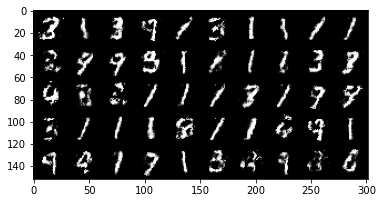

Iter: 60810/100000, Gen loss: 1.9342, Dis loss: 0.7432
Iter: 60820/100000, Gen loss: 1.6135, Dis loss: 0.5682
Iter: 60830/100000, Gen loss: 1.7561, Dis loss: 0.8891
Iter: 60840/100000, Gen loss: 1.6503, Dis loss: 0.6497
Iter: 60850/100000, Gen loss: 1.5451, Dis loss: 0.7189
Iter: 60860/100000, Gen loss: 1.6314, Dis loss: 0.4860
Iter: 60870/100000, Gen loss: 1.9924, Dis loss: 0.5261
Iter: 60880/100000, Gen loss: 2.0680, Dis loss: 1.0482
Iter: 60890/100000, Gen loss: 1.8673, Dis loss: 0.5533
Iter: 60900/100000, Gen loss: 1.7772, Dis loss: 0.6316
Iter: 60910/100000, Gen loss: 1.6374, Dis loss: 0.9773
Iter: 60920/100000, Gen loss: 1.6271, Dis loss: 0.4061
Iter: 60930/100000, Gen loss: 1.9144, Dis loss: 0.5215
Iter: 60940/100000, Gen loss: 1.6193, Dis loss: 0.7802
Iter: 60950/100000, Gen loss: 1.6888, Dis loss: 0.9533
Iter: 60960/100000, Gen loss: 2.2180, Dis loss: 0.6906
Iter: 60970/100000, Gen loss: 1.7016, Dis loss: 0.8079
Iter: 60980/100000, Gen loss: 1.9537, Dis loss: 0.5907
Iter: 6099

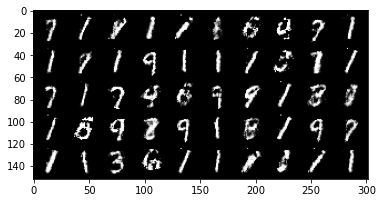

Iter: 61010/100000, Gen loss: 1.8187, Dis loss: 0.5434
Iter: 61020/100000, Gen loss: 2.0750, Dis loss: 0.5351
Iter: 61030/100000, Gen loss: 1.7857, Dis loss: 0.5649
Iter: 61040/100000, Gen loss: 1.7070, Dis loss: 0.7817
Iter: 61050/100000, Gen loss: 1.8782, Dis loss: 0.8394
Iter: 61060/100000, Gen loss: 1.8527, Dis loss: 0.5603
Iter: 61070/100000, Gen loss: 1.3227, Dis loss: 0.6187
Iter: 61080/100000, Gen loss: 1.7336, Dis loss: 0.5648
Iter: 61090/100000, Gen loss: 1.6967, Dis loss: 0.5905
Iter: 61100/100000, Gen loss: 1.7832, Dis loss: 0.7674
Iter: 61110/100000, Gen loss: 1.6557, Dis loss: 0.6742
Iter: 61120/100000, Gen loss: 2.1167, Dis loss: 0.6277
Iter: 61130/100000, Gen loss: 1.7026, Dis loss: 0.8100
Iter: 61140/100000, Gen loss: 1.6842, Dis loss: 0.6715
Iter: 61150/100000, Gen loss: 1.6523, Dis loss: 0.8286
Iter: 61160/100000, Gen loss: 1.4650, Dis loss: 0.7239
Iter: 61170/100000, Gen loss: 2.1194, Dis loss: 0.6377
Iter: 61180/100000, Gen loss: 1.7356, Dis loss: 0.7441
Iter: 6119

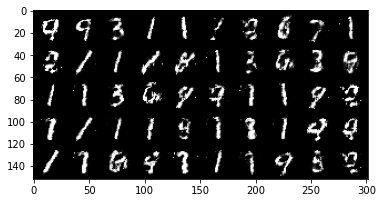

Iter: 61210/100000, Gen loss: 2.0934, Dis loss: 0.5669
Iter: 61220/100000, Gen loss: 2.0794, Dis loss: 0.5678
Iter: 61230/100000, Gen loss: 1.7732, Dis loss: 0.4820
Iter: 61240/100000, Gen loss: 2.0036, Dis loss: 0.5210
Iter: 61250/100000, Gen loss: 1.9753, Dis loss: 0.6859
Iter: 61260/100000, Gen loss: 2.1328, Dis loss: 0.4013
Iter: 61270/100000, Gen loss: 1.8791, Dis loss: 0.5603
Iter: 61280/100000, Gen loss: 1.8505, Dis loss: 0.7226
Iter: 61290/100000, Gen loss: 1.5900, Dis loss: 0.6935
Iter: 61300/100000, Gen loss: 1.7965, Dis loss: 0.7207
Iter: 61310/100000, Gen loss: 1.8502, Dis loss: 0.6092
Iter: 61320/100000, Gen loss: 1.7248, Dis loss: 0.6291
Iter: 61330/100000, Gen loss: 2.0056, Dis loss: 0.6497
Iter: 61340/100000, Gen loss: 1.9216, Dis loss: 0.6194
Iter: 61350/100000, Gen loss: 2.1968, Dis loss: 0.4902
Iter: 61360/100000, Gen loss: 1.5204, Dis loss: 0.7311
Iter: 61370/100000, Gen loss: 1.6677, Dis loss: 0.7883
Iter: 61380/100000, Gen loss: 1.9637, Dis loss: 0.7548
Iter: 6139

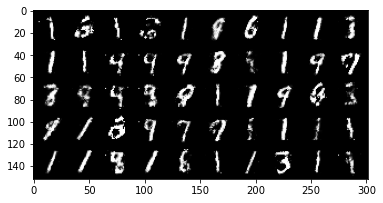

Iter: 61410/100000, Gen loss: 1.7554, Dis loss: 0.7689
Iter: 61420/100000, Gen loss: 1.7719, Dis loss: 0.7730
Iter: 61430/100000, Gen loss: 1.3753, Dis loss: 0.8335
Iter: 61440/100000, Gen loss: 1.8784, Dis loss: 0.7209
Iter: 61450/100000, Gen loss: 1.7698, Dis loss: 0.7344
Iter: 61460/100000, Gen loss: 1.5909, Dis loss: 0.7274
Iter: 61470/100000, Gen loss: 1.7367, Dis loss: 0.7062
Iter: 61480/100000, Gen loss: 1.8188, Dis loss: 0.5684
Iter: 61490/100000, Gen loss: 1.9635, Dis loss: 0.6476
Iter: 61500/100000, Gen loss: 1.9253, Dis loss: 0.6522
Iter: 61510/100000, Gen loss: 1.9073, Dis loss: 0.7009
Iter: 61520/100000, Gen loss: 1.2877, Dis loss: 0.8526
Iter: 61530/100000, Gen loss: 1.6836, Dis loss: 0.9740
Iter: 61540/100000, Gen loss: 2.1429, Dis loss: 0.7106
Iter: 61550/100000, Gen loss: 1.6692, Dis loss: 0.7738
Iter: 61560/100000, Gen loss: 1.6446, Dis loss: 0.8296
Iter: 61570/100000, Gen loss: 1.7981, Dis loss: 0.6072
Iter: 61580/100000, Gen loss: 1.9949, Dis loss: 0.5646
Iter: 6159

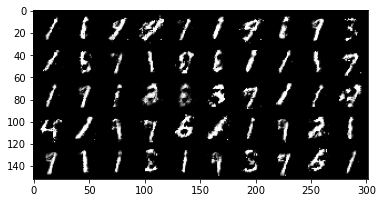

Iter: 61610/100000, Gen loss: 1.6023, Dis loss: 0.9410
Iter: 61620/100000, Gen loss: 1.4863, Dis loss: 0.8760
Iter: 61630/100000, Gen loss: 1.8196, Dis loss: 0.6651
Iter: 61640/100000, Gen loss: 2.3405, Dis loss: 0.5721
Iter: 61650/100000, Gen loss: 2.0079, Dis loss: 0.8109
Iter: 61660/100000, Gen loss: 1.6066, Dis loss: 0.7008
Iter: 61670/100000, Gen loss: 1.5700, Dis loss: 0.9781
Iter: 61680/100000, Gen loss: 1.7041, Dis loss: 0.8010
Iter: 61690/100000, Gen loss: 1.8848, Dis loss: 0.5641
Iter: 61700/100000, Gen loss: 2.1694, Dis loss: 0.4157
Iter: 61710/100000, Gen loss: 1.6175, Dis loss: 0.4670
Iter: 61720/100000, Gen loss: 2.1212, Dis loss: 0.6442
Iter: 61730/100000, Gen loss: 2.0036, Dis loss: 0.6432
Iter: 61740/100000, Gen loss: 2.0476, Dis loss: 0.8890
Iter: 61750/100000, Gen loss: 1.9430, Dis loss: 0.6520
Iter: 61760/100000, Gen loss: 1.8608, Dis loss: 0.6605
Iter: 61770/100000, Gen loss: 1.6069, Dis loss: 0.5808
Iter: 61780/100000, Gen loss: 2.4698, Dis loss: 0.5893
Iter: 6179

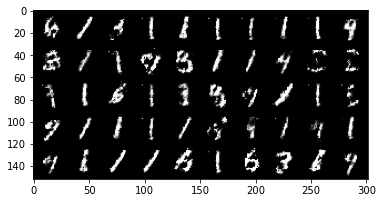

Iter: 61810/100000, Gen loss: 1.7367, Dis loss: 0.8195
Iter: 61820/100000, Gen loss: 1.8524, Dis loss: 0.6869
Iter: 61830/100000, Gen loss: 2.0247, Dis loss: 0.7418
Iter: 61840/100000, Gen loss: 1.8080, Dis loss: 0.7600
Iter: 61850/100000, Gen loss: 1.7202, Dis loss: 0.4686
Iter: 61860/100000, Gen loss: 2.2293, Dis loss: 0.9536
Iter: 61870/100000, Gen loss: 2.2539, Dis loss: 0.7496
Iter: 61880/100000, Gen loss: 2.1435, Dis loss: 0.7211
Iter: 61890/100000, Gen loss: 1.5779, Dis loss: 0.7521
Iter: 61900/100000, Gen loss: 1.9362, Dis loss: 0.6038
Iter: 61910/100000, Gen loss: 2.0132, Dis loss: 0.6711
Iter: 61920/100000, Gen loss: 1.8860, Dis loss: 0.5446
Iter: 61930/100000, Gen loss: 1.9177, Dis loss: 0.5774
Iter: 61940/100000, Gen loss: 2.4428, Dis loss: 0.7554
Iter: 61950/100000, Gen loss: 2.1853, Dis loss: 0.7033
Iter: 61960/100000, Gen loss: 1.8107, Dis loss: 0.8049
Iter: 61970/100000, Gen loss: 1.9280, Dis loss: 0.8161
Iter: 61980/100000, Gen loss: 1.8626, Dis loss: 0.6482
Iter: 6199

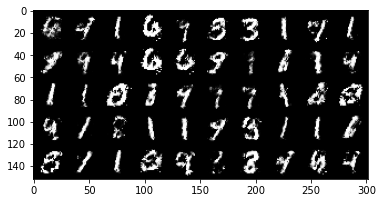

Iter: 62010/100000, Gen loss: 1.2588, Dis loss: 0.8045
Iter: 62020/100000, Gen loss: 2.1681, Dis loss: 0.7865
Iter: 62030/100000, Gen loss: 2.0721, Dis loss: 0.4388
Iter: 62040/100000, Gen loss: 2.4112, Dis loss: 1.0194
Iter: 62050/100000, Gen loss: 1.7457, Dis loss: 0.8378
Iter: 62060/100000, Gen loss: 2.1761, Dis loss: 0.5671
Iter: 62070/100000, Gen loss: 1.7258, Dis loss: 0.7255
Iter: 62080/100000, Gen loss: 1.9898, Dis loss: 0.5855
Iter: 62090/100000, Gen loss: 1.8749, Dis loss: 0.5618
Iter: 62100/100000, Gen loss: 1.8552, Dis loss: 0.6443
Iter: 62110/100000, Gen loss: 2.1746, Dis loss: 0.3617
Iter: 62120/100000, Gen loss: 2.0328, Dis loss: 0.5755
Iter: 62130/100000, Gen loss: 1.5438, Dis loss: 0.6009
Iter: 62140/100000, Gen loss: 1.5383, Dis loss: 0.5392
Iter: 62150/100000, Gen loss: 1.8730, Dis loss: 0.5752
Iter: 62160/100000, Gen loss: 1.9964, Dis loss: 0.5306
Iter: 62170/100000, Gen loss: 1.7824, Dis loss: 0.9453
Iter: 62180/100000, Gen loss: 1.5229, Dis loss: 0.5958
Iter: 6219

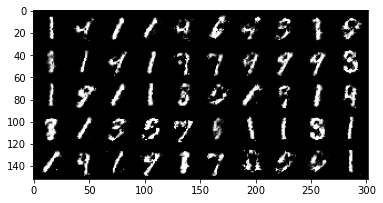

Iter: 62210/100000, Gen loss: 1.8077, Dis loss: 0.6432
Iter: 62220/100000, Gen loss: 1.6441, Dis loss: 0.6568
Iter: 62230/100000, Gen loss: 1.6532, Dis loss: 0.7223
Iter: 62240/100000, Gen loss: 1.9665, Dis loss: 0.7622
Iter: 62250/100000, Gen loss: 1.6695, Dis loss: 0.5215
Iter: 62260/100000, Gen loss: 1.7037, Dis loss: 0.5429
Iter: 62270/100000, Gen loss: 1.4854, Dis loss: 0.6697
Iter: 62280/100000, Gen loss: 2.1069, Dis loss: 0.8046
Iter: 62290/100000, Gen loss: 1.9821, Dis loss: 0.6213
Iter: 62300/100000, Gen loss: 2.3279, Dis loss: 0.5706
Iter: 62310/100000, Gen loss: 2.1180, Dis loss: 0.5535
Iter: 62320/100000, Gen loss: 1.5908, Dis loss: 0.5827
Iter: 62330/100000, Gen loss: 1.6429, Dis loss: 0.6945
Iter: 62340/100000, Gen loss: 1.8101, Dis loss: 0.7506
Iter: 62350/100000, Gen loss: 2.1512, Dis loss: 0.5316
Iter: 62360/100000, Gen loss: 1.8229, Dis loss: 0.7510
Iter: 62370/100000, Gen loss: 1.8943, Dis loss: 0.4859
Iter: 62380/100000, Gen loss: 1.4184, Dis loss: 0.8091
Iter: 6239

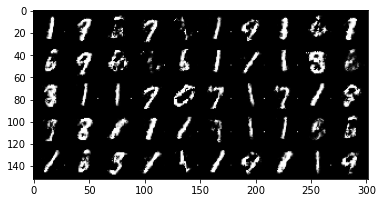

Iter: 62410/100000, Gen loss: 1.7374, Dis loss: 0.5062
Iter: 62420/100000, Gen loss: 1.9103, Dis loss: 0.7818
Iter: 62430/100000, Gen loss: 1.9750, Dis loss: 0.5188
Iter: 62440/100000, Gen loss: 1.9456, Dis loss: 0.5433
Iter: 62450/100000, Gen loss: 1.4572, Dis loss: 0.8308
Iter: 62460/100000, Gen loss: 1.5333, Dis loss: 0.6507
Iter: 62470/100000, Gen loss: 1.8469, Dis loss: 0.6055
Iter: 62480/100000, Gen loss: 1.8213, Dis loss: 0.8994
Iter: 62490/100000, Gen loss: 2.0247, Dis loss: 0.5659
Iter: 62500/100000, Gen loss: 1.9973, Dis loss: 0.6776
Iter: 62510/100000, Gen loss: 1.7939, Dis loss: 0.6830
Iter: 62520/100000, Gen loss: 1.6861, Dis loss: 0.7265
Iter: 62530/100000, Gen loss: 1.8445, Dis loss: 0.4998
Iter: 62540/100000, Gen loss: 1.9211, Dis loss: 0.7586
Iter: 62550/100000, Gen loss: 2.2249, Dis loss: 0.7270
Iter: 62560/100000, Gen loss: 1.6621, Dis loss: 0.8234
Iter: 62570/100000, Gen loss: 1.8180, Dis loss: 0.6686
Iter: 62580/100000, Gen loss: 1.9107, Dis loss: 0.6474
Iter: 6259

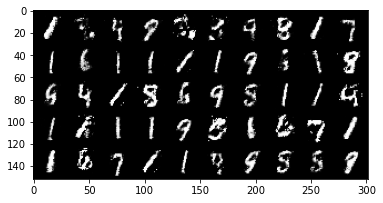

Iter: 62610/100000, Gen loss: 1.8050, Dis loss: 0.6843
Iter: 62620/100000, Gen loss: 1.6215, Dis loss: 0.7372
Iter: 62630/100000, Gen loss: 1.9416, Dis loss: 0.6460
Iter: 62640/100000, Gen loss: 1.8777, Dis loss: 0.6904
Iter: 62650/100000, Gen loss: 1.9882, Dis loss: 0.5444
Iter: 62660/100000, Gen loss: 1.9879, Dis loss: 0.6930
Iter: 62670/100000, Gen loss: 1.5440, Dis loss: 0.6288
Iter: 62680/100000, Gen loss: 1.9244, Dis loss: 0.6462
Iter: 62690/100000, Gen loss: 1.6590, Dis loss: 0.6415
Iter: 62700/100000, Gen loss: 1.8185, Dis loss: 0.7865
Iter: 62710/100000, Gen loss: 1.8768, Dis loss: 0.9260
Iter: 62720/100000, Gen loss: 1.8042, Dis loss: 0.7170
Iter: 62730/100000, Gen loss: 1.4919, Dis loss: 0.6258
Iter: 62740/100000, Gen loss: 2.0343, Dis loss: 0.6337
Iter: 62750/100000, Gen loss: 1.7400, Dis loss: 0.6092
Iter: 62760/100000, Gen loss: 1.5532, Dis loss: 0.7731
Iter: 62770/100000, Gen loss: 1.4323, Dis loss: 0.5876
Iter: 62780/100000, Gen loss: 2.0764, Dis loss: 0.6385
Iter: 6279

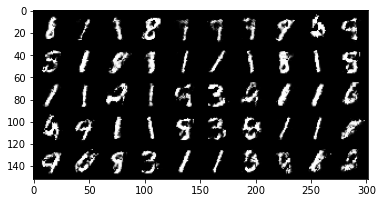

Iter: 62810/100000, Gen loss: 2.0169, Dis loss: 0.7774
Iter: 62820/100000, Gen loss: 1.6197, Dis loss: 0.7929
Iter: 62830/100000, Gen loss: 1.6772, Dis loss: 0.8775
Iter: 62840/100000, Gen loss: 1.4982, Dis loss: 0.8127
Iter: 62850/100000, Gen loss: 1.5375, Dis loss: 0.5967
Iter: 62860/100000, Gen loss: 1.7417, Dis loss: 0.7308
Iter: 62870/100000, Gen loss: 1.9809, Dis loss: 0.7341
Iter: 62880/100000, Gen loss: 2.0965, Dis loss: 0.7794
Iter: 62890/100000, Gen loss: 2.0872, Dis loss: 0.6539
Iter: 62900/100000, Gen loss: 2.2404, Dis loss: 0.6492
Iter: 62910/100000, Gen loss: 2.2117, Dis loss: 0.6239
Iter: 62920/100000, Gen loss: 1.8436, Dis loss: 0.8656
Iter: 62930/100000, Gen loss: 1.3394, Dis loss: 0.5737
Iter: 62940/100000, Gen loss: 1.4113, Dis loss: 0.6393
Iter: 62950/100000, Gen loss: 1.8575, Dis loss: 0.9332
Iter: 62960/100000, Gen loss: 1.7496, Dis loss: 0.7239
Iter: 62970/100000, Gen loss: 1.3798, Dis loss: 0.7679
Iter: 62980/100000, Gen loss: 1.8172, Dis loss: 0.6781
Iter: 6299

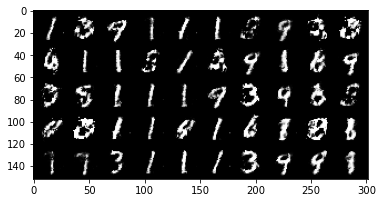

Iter: 63010/100000, Gen loss: 1.6227, Dis loss: 0.6646
Iter: 63020/100000, Gen loss: 2.1047, Dis loss: 0.7041
Iter: 63030/100000, Gen loss: 1.7911, Dis loss: 0.7378
Iter: 63040/100000, Gen loss: 1.9186, Dis loss: 0.5671
Iter: 63050/100000, Gen loss: 1.5369, Dis loss: 0.7320
Iter: 63060/100000, Gen loss: 1.6074, Dis loss: 0.6723
Iter: 63070/100000, Gen loss: 1.9406, Dis loss: 0.6819
Iter: 63080/100000, Gen loss: 1.9196, Dis loss: 0.6531
Iter: 63090/100000, Gen loss: 1.9646, Dis loss: 0.6465
Iter: 63100/100000, Gen loss: 1.9949, Dis loss: 0.9877
Iter: 63110/100000, Gen loss: 1.6305, Dis loss: 0.6977
Iter: 63120/100000, Gen loss: 1.7403, Dis loss: 0.6680
Iter: 63130/100000, Gen loss: 1.8673, Dis loss: 0.7240
Iter: 63140/100000, Gen loss: 1.6809, Dis loss: 0.6946
Iter: 63150/100000, Gen loss: 1.9225, Dis loss: 0.6816
Iter: 63160/100000, Gen loss: 1.9240, Dis loss: 0.8266
Iter: 63170/100000, Gen loss: 1.5685, Dis loss: 0.6090
Iter: 63180/100000, Gen loss: 1.6091, Dis loss: 0.6384
Iter: 6319

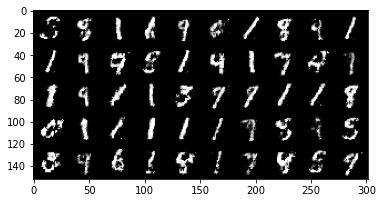

Iter: 63210/100000, Gen loss: 1.8744, Dis loss: 0.5760
Iter: 63220/100000, Gen loss: 2.0470, Dis loss: 0.6629
Iter: 63230/100000, Gen loss: 1.5200, Dis loss: 0.4773
Iter: 63240/100000, Gen loss: 1.6469, Dis loss: 0.7513
Iter: 63250/100000, Gen loss: 1.6472, Dis loss: 0.8625
Iter: 63260/100000, Gen loss: 1.7439, Dis loss: 0.6420
Iter: 63270/100000, Gen loss: 2.0529, Dis loss: 0.6822
Iter: 63280/100000, Gen loss: 1.6630, Dis loss: 0.6514
Iter: 63290/100000, Gen loss: 1.4652, Dis loss: 0.7319
Iter: 63300/100000, Gen loss: 1.6588, Dis loss: 0.7452
Iter: 63310/100000, Gen loss: 2.5207, Dis loss: 0.7079
Iter: 63320/100000, Gen loss: 2.3841, Dis loss: 0.6877
Iter: 63330/100000, Gen loss: 1.2718, Dis loss: 0.7184
Iter: 63340/100000, Gen loss: 1.7182, Dis loss: 0.5917
Iter: 63350/100000, Gen loss: 1.6758, Dis loss: 0.7675
Iter: 63360/100000, Gen loss: 1.9552, Dis loss: 0.6218
Iter: 63370/100000, Gen loss: 2.1100, Dis loss: 0.5944
Iter: 63380/100000, Gen loss: 1.8129, Dis loss: 0.5881
Iter: 6339

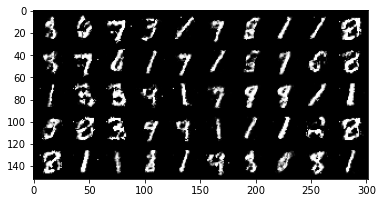

Iter: 63410/100000, Gen loss: 1.7292, Dis loss: 0.6093
Iter: 63420/100000, Gen loss: 2.1223, Dis loss: 0.7103
Iter: 63430/100000, Gen loss: 1.9821, Dis loss: 0.7654
Iter: 63440/100000, Gen loss: 1.6023, Dis loss: 0.9133
Iter: 63450/100000, Gen loss: 1.6808, Dis loss: 0.6316
Iter: 63460/100000, Gen loss: 1.7685, Dis loss: 0.9035
Iter: 63470/100000, Gen loss: 1.7508, Dis loss: 0.7886
Iter: 63480/100000, Gen loss: 1.6200, Dis loss: 0.6756
Iter: 63490/100000, Gen loss: 1.4100, Dis loss: 0.5665
Iter: 63500/100000, Gen loss: 2.0163, Dis loss: 0.6493
Iter: 63510/100000, Gen loss: 1.7522, Dis loss: 0.6261
Iter: 63520/100000, Gen loss: 2.1076, Dis loss: 0.7429
Iter: 63530/100000, Gen loss: 2.1483, Dis loss: 0.4601
Iter: 63540/100000, Gen loss: 1.3100, Dis loss: 0.6581
Iter: 63550/100000, Gen loss: 1.6143, Dis loss: 0.9252
Iter: 63560/100000, Gen loss: 1.8333, Dis loss: 0.7007
Iter: 63570/100000, Gen loss: 1.6107, Dis loss: 0.6803
Iter: 63580/100000, Gen loss: 1.6345, Dis loss: 0.6563
Iter: 6359

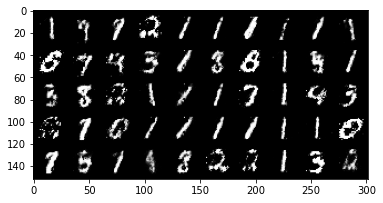

Iter: 63610/100000, Gen loss: 1.8365, Dis loss: 0.7835
Iter: 63620/100000, Gen loss: 1.8754, Dis loss: 0.7153
Iter: 63630/100000, Gen loss: 1.4830, Dis loss: 0.7596
Iter: 63640/100000, Gen loss: 1.6173, Dis loss: 0.7361
Iter: 63650/100000, Gen loss: 1.5347, Dis loss: 0.7223
Iter: 63660/100000, Gen loss: 2.1048, Dis loss: 0.6769
Iter: 63670/100000, Gen loss: 1.6285, Dis loss: 0.6842
Iter: 63680/100000, Gen loss: 1.8032, Dis loss: 0.7574
Iter: 63690/100000, Gen loss: 1.9244, Dis loss: 0.6468
Iter: 63700/100000, Gen loss: 1.7442, Dis loss: 0.7117
Iter: 63710/100000, Gen loss: 1.4870, Dis loss: 0.6196
Iter: 63720/100000, Gen loss: 1.3564, Dis loss: 0.7352
Iter: 63730/100000, Gen loss: 1.7520, Dis loss: 0.6916
Iter: 63740/100000, Gen loss: 1.9351, Dis loss: 0.6149
Iter: 63750/100000, Gen loss: 1.8974, Dis loss: 0.7004
Iter: 63760/100000, Gen loss: 1.5690, Dis loss: 0.7601
Iter: 63770/100000, Gen loss: 1.6081, Dis loss: 0.8232
Iter: 63780/100000, Gen loss: 1.6402, Dis loss: 0.5905
Iter: 6379

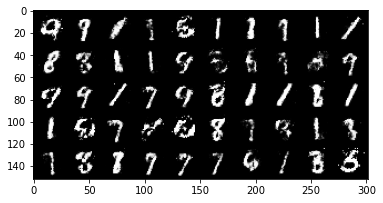

Iter: 63810/100000, Gen loss: 1.6723, Dis loss: 0.9284
Iter: 63820/100000, Gen loss: 1.6771, Dis loss: 0.5896
Iter: 63830/100000, Gen loss: 1.7455, Dis loss: 0.5325
Iter: 63840/100000, Gen loss: 1.6822, Dis loss: 0.7315
Iter: 63850/100000, Gen loss: 1.5312, Dis loss: 0.6214
Iter: 63860/100000, Gen loss: 1.5018, Dis loss: 0.6725
Iter: 63870/100000, Gen loss: 1.7633, Dis loss: 0.7253
Iter: 63880/100000, Gen loss: 1.6689, Dis loss: 0.5275
Iter: 63890/100000, Gen loss: 1.4214, Dis loss: 0.5826
Iter: 63900/100000, Gen loss: 1.7151, Dis loss: 0.6432
Iter: 63910/100000, Gen loss: 1.9154, Dis loss: 0.5526
Iter: 63920/100000, Gen loss: 1.6938, Dis loss: 0.5641
Iter: 63930/100000, Gen loss: 1.7370, Dis loss: 0.4957
Iter: 63940/100000, Gen loss: 1.9253, Dis loss: 1.0110
Iter: 63950/100000, Gen loss: 1.5652, Dis loss: 0.8361
Iter: 63960/100000, Gen loss: 1.5178, Dis loss: 0.7396
Iter: 63970/100000, Gen loss: 1.5738, Dis loss: 0.7667
Iter: 63980/100000, Gen loss: 1.4875, Dis loss: 0.7642
Iter: 6399

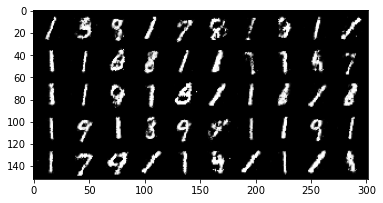

Iter: 64010/100000, Gen loss: 1.6530, Dis loss: 0.5817
Iter: 64020/100000, Gen loss: 1.4382, Dis loss: 0.6736
Iter: 64030/100000, Gen loss: 1.5389, Dis loss: 0.5758
Iter: 64040/100000, Gen loss: 1.5282, Dis loss: 0.7520
Iter: 64050/100000, Gen loss: 1.8162, Dis loss: 0.7336
Iter: 64060/100000, Gen loss: 2.0675, Dis loss: 0.5311
Iter: 64070/100000, Gen loss: 2.1248, Dis loss: 0.6354
Iter: 64080/100000, Gen loss: 1.6785, Dis loss: 0.9366
Iter: 64090/100000, Gen loss: 1.6356, Dis loss: 0.6486
Iter: 64100/100000, Gen loss: 1.8364, Dis loss: 0.8053
Iter: 64110/100000, Gen loss: 1.8830, Dis loss: 0.9149
Iter: 64120/100000, Gen loss: 1.9514, Dis loss: 0.6154
Iter: 64130/100000, Gen loss: 1.4384, Dis loss: 0.5920
Iter: 64140/100000, Gen loss: 1.6498, Dis loss: 0.6917
Iter: 64150/100000, Gen loss: 1.8151, Dis loss: 0.5105
Iter: 64160/100000, Gen loss: 1.9733, Dis loss: 0.9383
Iter: 64170/100000, Gen loss: 1.6587, Dis loss: 0.7987
Iter: 64180/100000, Gen loss: 1.5607, Dis loss: 0.8241
Iter: 6419

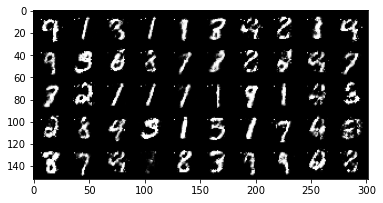

Iter: 64210/100000, Gen loss: 1.7137, Dis loss: 0.8334
Iter: 64220/100000, Gen loss: 2.0864, Dis loss: 0.6596
Iter: 64230/100000, Gen loss: 2.0012, Dis loss: 0.6691
Iter: 64240/100000, Gen loss: 1.6380, Dis loss: 0.5288
Iter: 64250/100000, Gen loss: 2.2777, Dis loss: 0.5761
Iter: 64260/100000, Gen loss: 1.9950, Dis loss: 0.5985
Iter: 64270/100000, Gen loss: 2.1261, Dis loss: 0.9492
Iter: 64280/100000, Gen loss: 1.7222, Dis loss: 0.6923
Iter: 64290/100000, Gen loss: 1.6420, Dis loss: 1.0295
Iter: 64300/100000, Gen loss: 1.8739, Dis loss: 0.7016
Iter: 64310/100000, Gen loss: 1.4639, Dis loss: 0.6383
Iter: 64320/100000, Gen loss: 1.6055, Dis loss: 0.6946
Iter: 64330/100000, Gen loss: 1.2565, Dis loss: 0.8275
Iter: 64340/100000, Gen loss: 1.3123, Dis loss: 0.7885
Iter: 64350/100000, Gen loss: 1.6219, Dis loss: 0.8218
Iter: 64360/100000, Gen loss: 1.6301, Dis loss: 0.5775
Iter: 64370/100000, Gen loss: 2.1436, Dis loss: 0.8208
Iter: 64380/100000, Gen loss: 2.3559, Dis loss: 0.8983
Iter: 6439

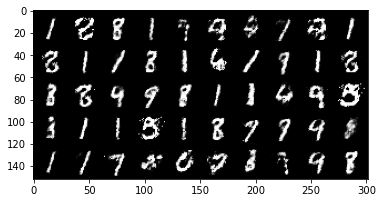

Iter: 64410/100000, Gen loss: 1.6066, Dis loss: 0.7742
Iter: 64420/100000, Gen loss: 2.1518, Dis loss: 0.8670
Iter: 64430/100000, Gen loss: 1.8340, Dis loss: 0.5906
Iter: 64440/100000, Gen loss: 1.4634, Dis loss: 0.7422
Iter: 64450/100000, Gen loss: 1.2551, Dis loss: 0.8881
Iter: 64460/100000, Gen loss: 1.8652, Dis loss: 0.6452
Iter: 64470/100000, Gen loss: 1.6050, Dis loss: 0.6630
Iter: 64480/100000, Gen loss: 1.8721, Dis loss: 0.6715
Iter: 64490/100000, Gen loss: 1.8318, Dis loss: 0.6391
Iter: 64500/100000, Gen loss: 1.7360, Dis loss: 0.6957
Iter: 64510/100000, Gen loss: 1.6596, Dis loss: 0.7819
Iter: 64520/100000, Gen loss: 1.6003, Dis loss: 0.9268
Iter: 64530/100000, Gen loss: 1.8021, Dis loss: 0.6733
Iter: 64540/100000, Gen loss: 1.9291, Dis loss: 0.8107
Iter: 64550/100000, Gen loss: 1.4937, Dis loss: 0.8181
Iter: 64560/100000, Gen loss: 1.9969, Dis loss: 0.8328
Iter: 64570/100000, Gen loss: 1.6887, Dis loss: 0.8535
Iter: 64580/100000, Gen loss: 1.9665, Dis loss: 0.8210
Iter: 6459

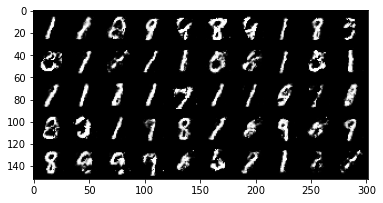

Iter: 64610/100000, Gen loss: 1.5643, Dis loss: 0.7458
Iter: 64620/100000, Gen loss: 1.7198, Dis loss: 0.7773
Iter: 64630/100000, Gen loss: 1.7605, Dis loss: 0.7092
Iter: 64640/100000, Gen loss: 1.8214, Dis loss: 0.8855
Iter: 64650/100000, Gen loss: 2.2415, Dis loss: 0.6439
Iter: 64660/100000, Gen loss: 1.9427, Dis loss: 0.6840
Iter: 64670/100000, Gen loss: 1.6750, Dis loss: 0.8841
Iter: 64680/100000, Gen loss: 1.6971, Dis loss: 0.7034
Iter: 64690/100000, Gen loss: 1.6316, Dis loss: 0.5958
Iter: 64700/100000, Gen loss: 2.0865, Dis loss: 0.6181
Iter: 64710/100000, Gen loss: 1.8703, Dis loss: 0.8718
Iter: 64720/100000, Gen loss: 1.5084, Dis loss: 0.8574
Iter: 64730/100000, Gen loss: 1.6992, Dis loss: 0.6090
Iter: 64740/100000, Gen loss: 1.7630, Dis loss: 0.8155
Iter: 64750/100000, Gen loss: 2.0955, Dis loss: 0.6906
Iter: 64760/100000, Gen loss: 2.0014, Dis loss: 0.6953
Iter: 64770/100000, Gen loss: 2.0370, Dis loss: 0.7106
Iter: 64780/100000, Gen loss: 2.0200, Dis loss: 0.4426
Iter: 6479

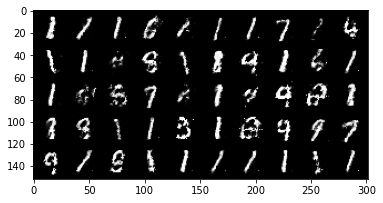

Iter: 64810/100000, Gen loss: 1.6429, Dis loss: 0.8336
Iter: 64820/100000, Gen loss: 1.5794, Dis loss: 0.9307
Iter: 64830/100000, Gen loss: 1.7007, Dis loss: 0.5961
Iter: 64840/100000, Gen loss: 1.9061, Dis loss: 0.7490
Iter: 64850/100000, Gen loss: 2.2473, Dis loss: 0.5534
Iter: 64860/100000, Gen loss: 1.9520, Dis loss: 0.7080
Iter: 64870/100000, Gen loss: 1.8243, Dis loss: 0.6983
Iter: 64880/100000, Gen loss: 1.1957, Dis loss: 0.6565
Iter: 64890/100000, Gen loss: 1.8236, Dis loss: 0.8633
Iter: 64900/100000, Gen loss: 1.8683, Dis loss: 0.5532
Iter: 64910/100000, Gen loss: 1.7820, Dis loss: 0.7106
Iter: 64920/100000, Gen loss: 1.6886, Dis loss: 0.7580
Iter: 64930/100000, Gen loss: 1.6585, Dis loss: 0.5010
Iter: 64940/100000, Gen loss: 1.7789, Dis loss: 0.8187
Iter: 64950/100000, Gen loss: 1.9341, Dis loss: 0.4700
Iter: 64960/100000, Gen loss: 1.4519, Dis loss: 0.5467
Iter: 64970/100000, Gen loss: 1.5456, Dis loss: 0.6482
Iter: 64980/100000, Gen loss: 1.7706, Dis loss: 0.8008
Iter: 6499

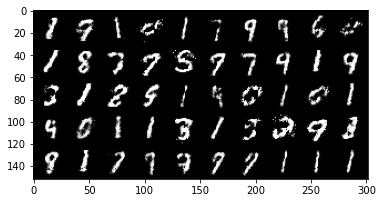

Iter: 65010/100000, Gen loss: 1.8853, Dis loss: 0.7949
Iter: 65020/100000, Gen loss: 1.3772, Dis loss: 0.6612
Iter: 65030/100000, Gen loss: 1.2550, Dis loss: 0.6535
Iter: 65040/100000, Gen loss: 1.5418, Dis loss: 0.7965
Iter: 65050/100000, Gen loss: 1.7023, Dis loss: 0.6307
Iter: 65060/100000, Gen loss: 1.9752, Dis loss: 0.7414
Iter: 65070/100000, Gen loss: 1.4761, Dis loss: 0.7984
Iter: 65080/100000, Gen loss: 1.2423, Dis loss: 1.0090
Iter: 65090/100000, Gen loss: 1.8243, Dis loss: 0.7279
Iter: 65100/100000, Gen loss: 1.8109, Dis loss: 0.7668
Iter: 65110/100000, Gen loss: 1.7967, Dis loss: 0.5461
Iter: 65120/100000, Gen loss: 1.7671, Dis loss: 0.5351
Iter: 65130/100000, Gen loss: 1.8231, Dis loss: 0.8935
Iter: 65140/100000, Gen loss: 1.9222, Dis loss: 0.6749
Iter: 65150/100000, Gen loss: 1.7606, Dis loss: 0.5304
Iter: 65160/100000, Gen loss: 1.4342, Dis loss: 0.7982
Iter: 65170/100000, Gen loss: 1.3974, Dis loss: 0.8269
Iter: 65180/100000, Gen loss: 1.7271, Dis loss: 0.8422
Iter: 6519

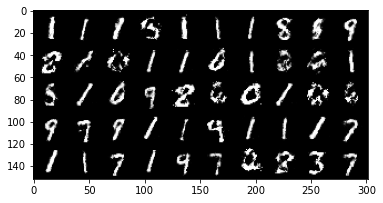

Iter: 65210/100000, Gen loss: 1.6354, Dis loss: 0.6850
Iter: 65220/100000, Gen loss: 1.1939, Dis loss: 0.7801
Iter: 65230/100000, Gen loss: 1.6176, Dis loss: 0.8017
Iter: 65240/100000, Gen loss: 1.7386, Dis loss: 0.5655
Iter: 65250/100000, Gen loss: 1.6879, Dis loss: 1.0008
Iter: 65260/100000, Gen loss: 1.6506, Dis loss: 0.7132
Iter: 65270/100000, Gen loss: 1.1604, Dis loss: 0.7212
Iter: 65280/100000, Gen loss: 1.4749, Dis loss: 0.8047
Iter: 65290/100000, Gen loss: 1.4602, Dis loss: 0.8560
Iter: 65300/100000, Gen loss: 1.2927, Dis loss: 0.6772
Iter: 65310/100000, Gen loss: 1.7698, Dis loss: 0.8632
Iter: 65320/100000, Gen loss: 1.7738, Dis loss: 0.8336
Iter: 65330/100000, Gen loss: 1.9731, Dis loss: 0.8112
Iter: 65340/100000, Gen loss: 1.8353, Dis loss: 1.2288
Iter: 65350/100000, Gen loss: 2.0035, Dis loss: 0.7952
Iter: 65360/100000, Gen loss: 1.2967, Dis loss: 0.8038
Iter: 65370/100000, Gen loss: 1.6288, Dis loss: 0.8799
Iter: 65380/100000, Gen loss: 1.6043, Dis loss: 1.0638
Iter: 6539

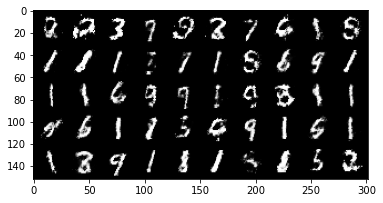

Iter: 65410/100000, Gen loss: 1.6312, Dis loss: 0.7290
Iter: 65420/100000, Gen loss: 1.8508, Dis loss: 0.7855
Iter: 65430/100000, Gen loss: 1.3671, Dis loss: 0.5774
Iter: 65440/100000, Gen loss: 1.7593, Dis loss: 0.9898
Iter: 65450/100000, Gen loss: 1.7314, Dis loss: 0.7535
Iter: 65460/100000, Gen loss: 1.8531, Dis loss: 0.6688
Iter: 65470/100000, Gen loss: 1.8909, Dis loss: 0.7740
Iter: 65480/100000, Gen loss: 1.5110, Dis loss: 0.6596
Iter: 65490/100000, Gen loss: 1.4268, Dis loss: 0.7762
Iter: 65500/100000, Gen loss: 1.3643, Dis loss: 0.8230
Iter: 65510/100000, Gen loss: 1.7549, Dis loss: 0.7922
Iter: 65520/100000, Gen loss: 1.6893, Dis loss: 0.7237
Iter: 65530/100000, Gen loss: 1.7106, Dis loss: 0.5431
Iter: 65540/100000, Gen loss: 1.5342, Dis loss: 1.0331
Iter: 65550/100000, Gen loss: 1.7228, Dis loss: 0.7873
Iter: 65560/100000, Gen loss: 1.8490, Dis loss: 0.6475
Iter: 65570/100000, Gen loss: 1.7431, Dis loss: 0.6267
Iter: 65580/100000, Gen loss: 1.6200, Dis loss: 0.5927
Iter: 6559

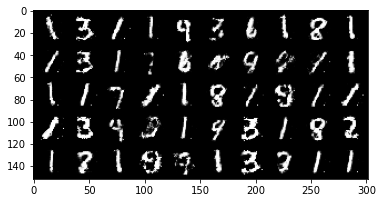

Iter: 65610/100000, Gen loss: 1.5642, Dis loss: 0.7484
Iter: 65620/100000, Gen loss: 1.6616, Dis loss: 0.6875
Iter: 65630/100000, Gen loss: 1.7427, Dis loss: 0.5666
Iter: 65640/100000, Gen loss: 1.7274, Dis loss: 0.8843
Iter: 65650/100000, Gen loss: 1.9360, Dis loss: 0.8725
Iter: 65660/100000, Gen loss: 2.0963, Dis loss: 0.9435
Iter: 65670/100000, Gen loss: 1.4435, Dis loss: 0.6936
Iter: 65680/100000, Gen loss: 1.2865, Dis loss: 0.7476
Iter: 65690/100000, Gen loss: 1.4314, Dis loss: 0.7077
Iter: 65700/100000, Gen loss: 1.4810, Dis loss: 0.7554
Iter: 65710/100000, Gen loss: 1.9465, Dis loss: 0.8607
Iter: 65720/100000, Gen loss: 2.4523, Dis loss: 0.8213
Iter: 65730/100000, Gen loss: 1.9778, Dis loss: 0.6852
Iter: 65740/100000, Gen loss: 1.8871, Dis loss: 0.7589
Iter: 65750/100000, Gen loss: 1.5239, Dis loss: 0.7205
Iter: 65760/100000, Gen loss: 1.6078, Dis loss: 1.1163
Iter: 65770/100000, Gen loss: 1.3445, Dis loss: 1.0446
Iter: 65780/100000, Gen loss: 1.4949, Dis loss: 0.7415
Iter: 6579

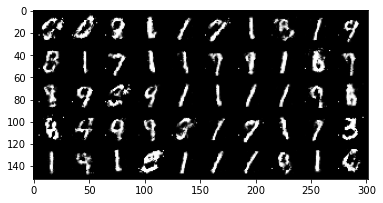

Iter: 65810/100000, Gen loss: 1.5637, Dis loss: 0.6265
Iter: 65820/100000, Gen loss: 1.9907, Dis loss: 0.7929
Iter: 65830/100000, Gen loss: 2.2081, Dis loss: 0.5562
Iter: 65840/100000, Gen loss: 1.7944, Dis loss: 0.7339
Iter: 65850/100000, Gen loss: 1.7081, Dis loss: 0.8181
Iter: 65860/100000, Gen loss: 2.0038, Dis loss: 0.8554
Iter: 65870/100000, Gen loss: 1.7736, Dis loss: 0.8107
Iter: 65880/100000, Gen loss: 1.7824, Dis loss: 0.5702
Iter: 65890/100000, Gen loss: 1.6079, Dis loss: 0.8569
Iter: 65900/100000, Gen loss: 1.5783, Dis loss: 0.5757
Iter: 65910/100000, Gen loss: 2.1238, Dis loss: 0.7656
Iter: 65920/100000, Gen loss: 1.8376, Dis loss: 0.5912
Iter: 65930/100000, Gen loss: 1.8638, Dis loss: 0.5935
Iter: 65940/100000, Gen loss: 2.0364, Dis loss: 0.7052
Iter: 65950/100000, Gen loss: 2.0686, Dis loss: 0.8624
Iter: 65960/100000, Gen loss: 1.7097, Dis loss: 0.9764
Iter: 65970/100000, Gen loss: 1.7187, Dis loss: 0.8813
Iter: 65980/100000, Gen loss: 1.5777, Dis loss: 0.6484
Iter: 6599

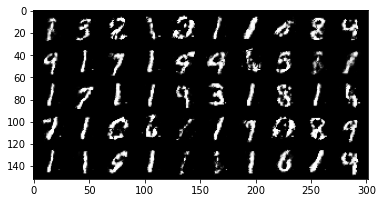

Iter: 66010/100000, Gen loss: 1.7751, Dis loss: 0.7939
Iter: 66020/100000, Gen loss: 1.4541, Dis loss: 0.6875
Iter: 66030/100000, Gen loss: 1.5166, Dis loss: 0.5519
Iter: 66040/100000, Gen loss: 1.6426, Dis loss: 0.7225
Iter: 66050/100000, Gen loss: 1.8932, Dis loss: 0.6271
Iter: 66060/100000, Gen loss: 1.6912, Dis loss: 0.7519
Iter: 66070/100000, Gen loss: 2.2851, Dis loss: 0.9899
Iter: 66080/100000, Gen loss: 1.4444, Dis loss: 0.8578
Iter: 66090/100000, Gen loss: 1.9835, Dis loss: 0.8290
Iter: 66100/100000, Gen loss: 1.4125, Dis loss: 0.7358
Iter: 66110/100000, Gen loss: 1.8241, Dis loss: 0.5736
Iter: 66120/100000, Gen loss: 1.5663, Dis loss: 0.8420
Iter: 66130/100000, Gen loss: 1.8186, Dis loss: 0.6942
Iter: 66140/100000, Gen loss: 1.6404, Dis loss: 0.5564
Iter: 66150/100000, Gen loss: 1.6052, Dis loss: 0.5866
Iter: 66160/100000, Gen loss: 1.9980, Dis loss: 0.5057
Iter: 66170/100000, Gen loss: 1.9054, Dis loss: 0.5705
Iter: 66180/100000, Gen loss: 1.8545, Dis loss: 0.5215
Iter: 6619

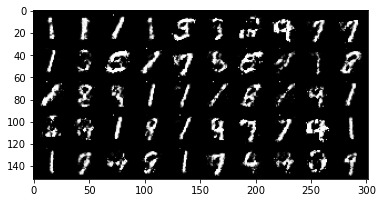

Iter: 66210/100000, Gen loss: 1.6136, Dis loss: 0.8663
Iter: 66220/100000, Gen loss: 1.4641, Dis loss: 0.5459
Iter: 66230/100000, Gen loss: 1.7424, Dis loss: 0.6080
Iter: 66240/100000, Gen loss: 1.7077, Dis loss: 0.7209
Iter: 66250/100000, Gen loss: 1.5534, Dis loss: 0.6605
Iter: 66260/100000, Gen loss: 1.4959, Dis loss: 0.4331
Iter: 66270/100000, Gen loss: 1.9359, Dis loss: 0.7865
Iter: 66280/100000, Gen loss: 2.1065, Dis loss: 0.5885
Iter: 66290/100000, Gen loss: 1.7324, Dis loss: 0.6041
Iter: 66300/100000, Gen loss: 1.6128, Dis loss: 0.5933
Iter: 66310/100000, Gen loss: 1.8499, Dis loss: 0.7436
Iter: 66320/100000, Gen loss: 1.7636, Dis loss: 0.9586
Iter: 66330/100000, Gen loss: 1.5804, Dis loss: 1.0060
Iter: 66340/100000, Gen loss: 1.2844, Dis loss: 0.8158
Iter: 66350/100000, Gen loss: 1.6443, Dis loss: 0.5290
Iter: 66360/100000, Gen loss: 1.8370, Dis loss: 0.6179
Iter: 66370/100000, Gen loss: 1.5381, Dis loss: 0.5060
Iter: 66380/100000, Gen loss: 2.0281, Dis loss: 0.5826
Iter: 6639

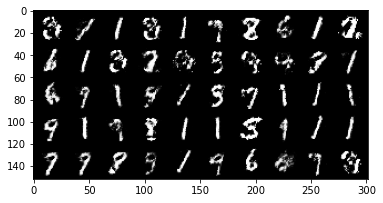

Iter: 66410/100000, Gen loss: 1.9991, Dis loss: 0.8463
Iter: 66420/100000, Gen loss: 1.4765, Dis loss: 1.0602
Iter: 66430/100000, Gen loss: 1.4416, Dis loss: 0.6963
Iter: 66440/100000, Gen loss: 1.2663, Dis loss: 0.8439
Iter: 66450/100000, Gen loss: 1.5505, Dis loss: 0.6002
Iter: 66460/100000, Gen loss: 1.8085, Dis loss: 0.5824
Iter: 66470/100000, Gen loss: 1.4323, Dis loss: 0.6485
Iter: 66480/100000, Gen loss: 1.5569, Dis loss: 0.5999
Iter: 66490/100000, Gen loss: 1.6162, Dis loss: 0.8605
Iter: 66500/100000, Gen loss: 1.7621, Dis loss: 1.0399
Iter: 66510/100000, Gen loss: 1.7009, Dis loss: 0.7757
Iter: 66520/100000, Gen loss: 1.7461, Dis loss: 0.7360
Iter: 66530/100000, Gen loss: 1.6461, Dis loss: 0.6588
Iter: 66540/100000, Gen loss: 1.7293, Dis loss: 0.6068
Iter: 66550/100000, Gen loss: 1.5401, Dis loss: 0.7088
Iter: 66560/100000, Gen loss: 1.5017, Dis loss: 0.5758
Iter: 66570/100000, Gen loss: 1.0772, Dis loss: 0.9322
Iter: 66580/100000, Gen loss: 1.6696, Dis loss: 0.8397
Iter: 6659

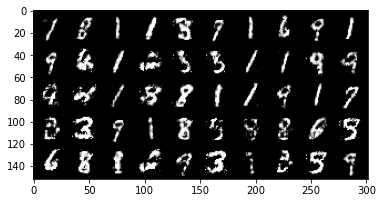

Iter: 66610/100000, Gen loss: 2.0183, Dis loss: 0.7621
Iter: 66620/100000, Gen loss: 1.6560, Dis loss: 0.7800
Iter: 66630/100000, Gen loss: 1.5796, Dis loss: 0.6003
Iter: 66640/100000, Gen loss: 1.7951, Dis loss: 0.6399
Iter: 66650/100000, Gen loss: 1.8926, Dis loss: 0.6351
Iter: 66660/100000, Gen loss: 2.0033, Dis loss: 0.8498
Iter: 66670/100000, Gen loss: 1.3838, Dis loss: 0.7203
Iter: 66680/100000, Gen loss: 1.6266, Dis loss: 0.6462
Iter: 66690/100000, Gen loss: 1.8095, Dis loss: 1.0357
Iter: 66700/100000, Gen loss: 1.5231, Dis loss: 0.7638
Iter: 66710/100000, Gen loss: 1.6902, Dis loss: 0.7635
Iter: 66720/100000, Gen loss: 1.7532, Dis loss: 0.6119
Iter: 66730/100000, Gen loss: 1.6396, Dis loss: 0.8158
Iter: 66740/100000, Gen loss: 1.3747, Dis loss: 0.6726
Iter: 66750/100000, Gen loss: 1.6478, Dis loss: 0.6453
Iter: 66760/100000, Gen loss: 1.7021, Dis loss: 0.9771
Iter: 66770/100000, Gen loss: 1.5992, Dis loss: 0.8087
Iter: 66780/100000, Gen loss: 1.7765, Dis loss: 0.5594
Iter: 6679

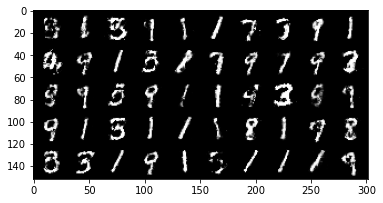

Iter: 66810/100000, Gen loss: 1.4557, Dis loss: 0.6555
Iter: 66820/100000, Gen loss: 1.6393, Dis loss: 0.7808
Iter: 66830/100000, Gen loss: 1.6352, Dis loss: 0.6191
Iter: 66840/100000, Gen loss: 1.8706, Dis loss: 0.6390
Iter: 66850/100000, Gen loss: 1.6425, Dis loss: 0.5892
Iter: 66860/100000, Gen loss: 1.4916, Dis loss: 0.8885
Iter: 66870/100000, Gen loss: 1.4284, Dis loss: 0.9284
Iter: 66880/100000, Gen loss: 1.2928, Dis loss: 0.8306
Iter: 66890/100000, Gen loss: 1.5927, Dis loss: 0.8085
Iter: 66900/100000, Gen loss: 1.7455, Dis loss: 0.9387
Iter: 66910/100000, Gen loss: 1.7790, Dis loss: 0.6478
Iter: 66920/100000, Gen loss: 2.0006, Dis loss: 0.6392
Iter: 66930/100000, Gen loss: 1.5837, Dis loss: 0.6909
Iter: 66940/100000, Gen loss: 1.5874, Dis loss: 0.5960
Iter: 66950/100000, Gen loss: 1.5483, Dis loss: 0.9493
Iter: 66960/100000, Gen loss: 1.5913, Dis loss: 0.7724
Iter: 66970/100000, Gen loss: 1.9154, Dis loss: 0.5487
Iter: 66980/100000, Gen loss: 1.6967, Dis loss: 0.6280
Iter: 6699

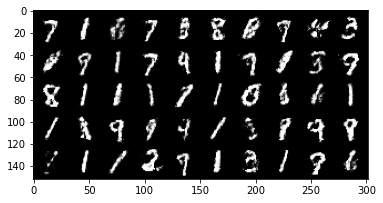

Iter: 67010/100000, Gen loss: 1.7651, Dis loss: 0.5172
Iter: 67020/100000, Gen loss: 1.7114, Dis loss: 0.4432
Iter: 67030/100000, Gen loss: 1.8198, Dis loss: 0.6867
Iter: 67040/100000, Gen loss: 1.6070, Dis loss: 0.7570
Iter: 67050/100000, Gen loss: 1.7522, Dis loss: 0.6213
Iter: 67060/100000, Gen loss: 1.6341, Dis loss: 0.4283
Iter: 67070/100000, Gen loss: 1.6767, Dis loss: 0.8464
Iter: 67080/100000, Gen loss: 1.4537, Dis loss: 0.8899
Iter: 67090/100000, Gen loss: 2.0956, Dis loss: 0.5616
Iter: 67100/100000, Gen loss: 1.7222, Dis loss: 0.6173
Iter: 67110/100000, Gen loss: 1.6683, Dis loss: 0.7379
Iter: 67120/100000, Gen loss: 1.7072, Dis loss: 0.8623
Iter: 67130/100000, Gen loss: 1.4892, Dis loss: 0.6764
Iter: 67140/100000, Gen loss: 1.8498, Dis loss: 0.6389
Iter: 67150/100000, Gen loss: 1.9494, Dis loss: 0.5728
Iter: 67160/100000, Gen loss: 1.5747, Dis loss: 0.7348
Iter: 67170/100000, Gen loss: 1.9436, Dis loss: 0.6983
Iter: 67180/100000, Gen loss: 2.0228, Dis loss: 0.6124
Iter: 6719

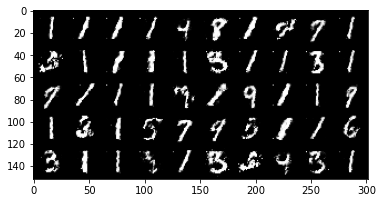

Iter: 67210/100000, Gen loss: 1.4872, Dis loss: 0.6884
Iter: 67220/100000, Gen loss: 1.3979, Dis loss: 0.9729
Iter: 67230/100000, Gen loss: 1.4551, Dis loss: 0.7202
Iter: 67240/100000, Gen loss: 1.9030, Dis loss: 0.5153
Iter: 67250/100000, Gen loss: 1.8975, Dis loss: 0.7442
Iter: 67260/100000, Gen loss: 1.8997, Dis loss: 0.7303
Iter: 67270/100000, Gen loss: 1.6439, Dis loss: 0.6241
Iter: 67280/100000, Gen loss: 1.5085, Dis loss: 0.9010
Iter: 67290/100000, Gen loss: 1.5599, Dis loss: 0.5813
Iter: 67300/100000, Gen loss: 1.3992, Dis loss: 0.6926
Iter: 67310/100000, Gen loss: 2.1129, Dis loss: 0.8565
Iter: 67320/100000, Gen loss: 1.8482, Dis loss: 0.9619
Iter: 67330/100000, Gen loss: 1.9276, Dis loss: 0.6968
Iter: 67340/100000, Gen loss: 1.3541, Dis loss: 1.0402
Iter: 67350/100000, Gen loss: 1.7309, Dis loss: 0.6613
Iter: 67360/100000, Gen loss: 1.4797, Dis loss: 0.7879
Iter: 67370/100000, Gen loss: 2.0602, Dis loss: 0.6696
Iter: 67380/100000, Gen loss: 1.9351, Dis loss: 0.6201
Iter: 6739

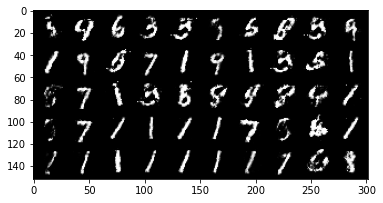

Iter: 67410/100000, Gen loss: 1.5898, Dis loss: 0.5561
Iter: 67420/100000, Gen loss: 1.7599, Dis loss: 0.8822
Iter: 67430/100000, Gen loss: 1.7488, Dis loss: 1.0897
Iter: 67440/100000, Gen loss: 2.0820, Dis loss: 0.7992
Iter: 67450/100000, Gen loss: 1.9052, Dis loss: 0.8517
Iter: 67460/100000, Gen loss: 1.5864, Dis loss: 0.7770
Iter: 67470/100000, Gen loss: 1.5571, Dis loss: 0.7930
Iter: 67480/100000, Gen loss: 1.5097, Dis loss: 0.9121
Iter: 67490/100000, Gen loss: 1.6151, Dis loss: 0.6938
Iter: 67500/100000, Gen loss: 1.8159, Dis loss: 0.7161
Iter: 67510/100000, Gen loss: 1.7175, Dis loss: 0.6552
Iter: 67520/100000, Gen loss: 1.6563, Dis loss: 0.6186
Iter: 67530/100000, Gen loss: 1.6928, Dis loss: 0.7466
Iter: 67540/100000, Gen loss: 1.7166, Dis loss: 1.0561
Iter: 67550/100000, Gen loss: 1.8083, Dis loss: 0.8201
Iter: 67560/100000, Gen loss: 1.7047, Dis loss: 0.4656
Iter: 67570/100000, Gen loss: 1.7134, Dis loss: 0.9566
Iter: 67580/100000, Gen loss: 2.2769, Dis loss: 0.7852
Iter: 6759

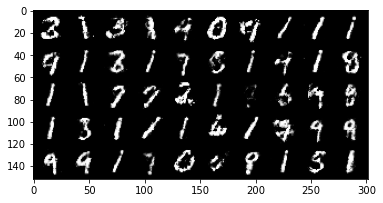

Iter: 67610/100000, Gen loss: 1.8861, Dis loss: 0.6370
Iter: 67620/100000, Gen loss: 1.6453, Dis loss: 0.6593
Iter: 67630/100000, Gen loss: 1.6425, Dis loss: 0.7487
Iter: 67640/100000, Gen loss: 1.5542, Dis loss: 0.9147
Iter: 67650/100000, Gen loss: 1.6593, Dis loss: 0.5528
Iter: 67660/100000, Gen loss: 1.7980, Dis loss: 0.5371
Iter: 67670/100000, Gen loss: 2.0985, Dis loss: 0.6510
Iter: 67680/100000, Gen loss: 1.5560, Dis loss: 0.5808
Iter: 67690/100000, Gen loss: 1.8267, Dis loss: 0.9481
Iter: 67700/100000, Gen loss: 1.4896, Dis loss: 0.9922
Iter: 67710/100000, Gen loss: 1.2753, Dis loss: 0.7172
Iter: 67720/100000, Gen loss: 1.8080, Dis loss: 0.6149
Iter: 67730/100000, Gen loss: 1.9992, Dis loss: 0.5392
Iter: 67740/100000, Gen loss: 1.6654, Dis loss: 0.7105
Iter: 67750/100000, Gen loss: 1.4099, Dis loss: 0.7175
Iter: 67760/100000, Gen loss: 2.0525, Dis loss: 0.7794
Iter: 67770/100000, Gen loss: 1.9906, Dis loss: 0.7749
Iter: 67780/100000, Gen loss: 1.7349, Dis loss: 0.6812
Iter: 6779

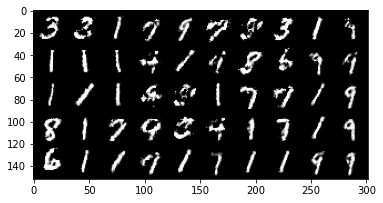

Iter: 67810/100000, Gen loss: 1.8834, Dis loss: 0.7722
Iter: 67820/100000, Gen loss: 1.6590, Dis loss: 0.6247
Iter: 67830/100000, Gen loss: 1.5324, Dis loss: 0.6720
Iter: 67840/100000, Gen loss: 1.6346, Dis loss: 0.8546
Iter: 67850/100000, Gen loss: 1.3725, Dis loss: 0.7171
Iter: 67860/100000, Gen loss: 1.9578, Dis loss: 0.6682
Iter: 67870/100000, Gen loss: 1.6795, Dis loss: 0.6535
Iter: 67880/100000, Gen loss: 1.9554, Dis loss: 0.6066
Iter: 67890/100000, Gen loss: 1.8410, Dis loss: 0.6053
Iter: 67900/100000, Gen loss: 1.3347, Dis loss: 0.9617
Iter: 67910/100000, Gen loss: 1.1711, Dis loss: 0.8447
Iter: 67920/100000, Gen loss: 1.3300, Dis loss: 0.8380
Iter: 67930/100000, Gen loss: 1.7412, Dis loss: 0.8788
Iter: 67940/100000, Gen loss: 2.0822, Dis loss: 0.9387
Iter: 67950/100000, Gen loss: 1.7506, Dis loss: 0.8643
Iter: 67960/100000, Gen loss: 1.4861, Dis loss: 0.8214
Iter: 67970/100000, Gen loss: 1.8310, Dis loss: 0.7569
Iter: 67980/100000, Gen loss: 1.7975, Dis loss: 1.0331
Iter: 6799

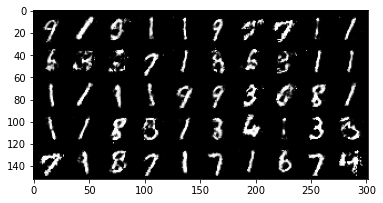

Iter: 68010/100000, Gen loss: 1.3597, Dis loss: 0.7490
Iter: 68020/100000, Gen loss: 1.7813, Dis loss: 0.6338
Iter: 68030/100000, Gen loss: 1.7807, Dis loss: 0.8665
Iter: 68040/100000, Gen loss: 1.8825, Dis loss: 0.7821
Iter: 68050/100000, Gen loss: 2.0566, Dis loss: 0.9315
Iter: 68060/100000, Gen loss: 1.4726, Dis loss: 0.9067
Iter: 68070/100000, Gen loss: 1.5174, Dis loss: 0.6780
Iter: 68080/100000, Gen loss: 1.7749, Dis loss: 0.6049
Iter: 68090/100000, Gen loss: 1.9343, Dis loss: 1.0714
Iter: 68100/100000, Gen loss: 1.7403, Dis loss: 1.0270
Iter: 68110/100000, Gen loss: 1.6065, Dis loss: 0.6717
Iter: 68120/100000, Gen loss: 1.9012, Dis loss: 0.5663
Iter: 68130/100000, Gen loss: 1.7029, Dis loss: 0.5561
Iter: 68140/100000, Gen loss: 1.7084, Dis loss: 0.6374
Iter: 68150/100000, Gen loss: 1.7883, Dis loss: 0.7505
Iter: 68160/100000, Gen loss: 1.8017, Dis loss: 0.8861
Iter: 68170/100000, Gen loss: 1.7845, Dis loss: 0.5285
Iter: 68180/100000, Gen loss: 1.6599, Dis loss: 0.6568
Iter: 6819

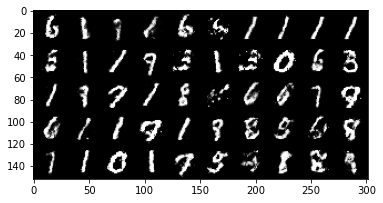

Iter: 68210/100000, Gen loss: 1.6248, Dis loss: 0.7126
Iter: 68220/100000, Gen loss: 1.3618, Dis loss: 0.6428
Iter: 68230/100000, Gen loss: 1.3862, Dis loss: 0.7425
Iter: 68240/100000, Gen loss: 1.7984, Dis loss: 0.8987
Iter: 68250/100000, Gen loss: 1.8006, Dis loss: 0.8268
Iter: 68260/100000, Gen loss: 1.8304, Dis loss: 0.8375
Iter: 68270/100000, Gen loss: 1.9666, Dis loss: 0.7512
Iter: 68280/100000, Gen loss: 1.7342, Dis loss: 0.8399
Iter: 68290/100000, Gen loss: 1.3349, Dis loss: 0.8790
Iter: 68300/100000, Gen loss: 1.5757, Dis loss: 0.6839
Iter: 68310/100000, Gen loss: 1.6017, Dis loss: 0.6930
Iter: 68320/100000, Gen loss: 1.2680, Dis loss: 0.8795
Iter: 68330/100000, Gen loss: 1.8309, Dis loss: 0.5616
Iter: 68340/100000, Gen loss: 1.7081, Dis loss: 0.7499
Iter: 68350/100000, Gen loss: 2.0757, Dis loss: 1.0835
Iter: 68360/100000, Gen loss: 2.0393, Dis loss: 0.6635
Iter: 68370/100000, Gen loss: 1.5853, Dis loss: 0.6671
Iter: 68380/100000, Gen loss: 1.8920, Dis loss: 0.9173
Iter: 6839

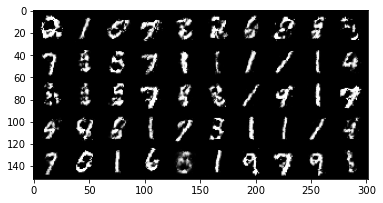

Iter: 68410/100000, Gen loss: 1.5061, Dis loss: 0.8182
Iter: 68420/100000, Gen loss: 1.8989, Dis loss: 0.8611
Iter: 68430/100000, Gen loss: 1.6482, Dis loss: 0.9299
Iter: 68440/100000, Gen loss: 1.7840, Dis loss: 0.8725
Iter: 68450/100000, Gen loss: 1.6356, Dis loss: 0.8117
Iter: 68460/100000, Gen loss: 1.6802, Dis loss: 0.7034
Iter: 68470/100000, Gen loss: 1.8549, Dis loss: 0.7804
Iter: 68480/100000, Gen loss: 1.7706, Dis loss: 0.7666
Iter: 68490/100000, Gen loss: 1.3496, Dis loss: 0.6173
Iter: 68500/100000, Gen loss: 1.6774, Dis loss: 0.6688
Iter: 68510/100000, Gen loss: 1.6736, Dis loss: 0.5663
Iter: 68520/100000, Gen loss: 1.7146, Dis loss: 0.7933
Iter: 68530/100000, Gen loss: 1.4234, Dis loss: 0.5399
Iter: 68540/100000, Gen loss: 1.8273, Dis loss: 0.7491
Iter: 68550/100000, Gen loss: 1.7591, Dis loss: 0.6438
Iter: 68560/100000, Gen loss: 1.4582, Dis loss: 0.8495
Iter: 68570/100000, Gen loss: 1.9366, Dis loss: 0.9011
Iter: 68580/100000, Gen loss: 1.7837, Dis loss: 0.8436
Iter: 6859

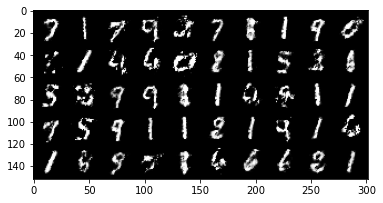

Iter: 68610/100000, Gen loss: 1.5563, Dis loss: 0.6324
Iter: 68620/100000, Gen loss: 1.5875, Dis loss: 0.6906
Iter: 68630/100000, Gen loss: 1.7439, Dis loss: 0.6250
Iter: 68640/100000, Gen loss: 1.6375, Dis loss: 0.7843
Iter: 68650/100000, Gen loss: 1.2056, Dis loss: 0.7240
Iter: 68660/100000, Gen loss: 1.4508, Dis loss: 0.6615
Iter: 68670/100000, Gen loss: 1.7403, Dis loss: 0.7961
Iter: 68680/100000, Gen loss: 1.2874, Dis loss: 0.6852
Iter: 68690/100000, Gen loss: 1.5858, Dis loss: 0.6138
Iter: 68700/100000, Gen loss: 1.4635, Dis loss: 0.8754
Iter: 68710/100000, Gen loss: 1.3875, Dis loss: 0.7753
Iter: 68720/100000, Gen loss: 1.8103, Dis loss: 0.6825
Iter: 68730/100000, Gen loss: 1.4980, Dis loss: 0.8491
Iter: 68740/100000, Gen loss: 1.6020, Dis loss: 0.8143
Iter: 68750/100000, Gen loss: 1.4985, Dis loss: 0.7991
Iter: 68760/100000, Gen loss: 1.4784, Dis loss: 0.8129
Iter: 68770/100000, Gen loss: 1.3978, Dis loss: 0.8276
Iter: 68780/100000, Gen loss: 1.5618, Dis loss: 0.6018
Iter: 6879

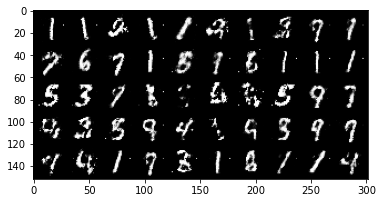

Iter: 68810/100000, Gen loss: 1.9185, Dis loss: 0.5582
Iter: 68820/100000, Gen loss: 1.9294, Dis loss: 0.7168
Iter: 68830/100000, Gen loss: 1.4742, Dis loss: 0.6472
Iter: 68840/100000, Gen loss: 1.6132, Dis loss: 0.8204
Iter: 68850/100000, Gen loss: 1.6590, Dis loss: 0.7176
Iter: 68860/100000, Gen loss: 1.6873, Dis loss: 0.8435
Iter: 68870/100000, Gen loss: 1.8350, Dis loss: 0.7565
Iter: 68880/100000, Gen loss: 1.7538, Dis loss: 0.7189
Iter: 68890/100000, Gen loss: 1.5665, Dis loss: 1.0300
Iter: 68900/100000, Gen loss: 1.5682, Dis loss: 0.7547
Iter: 68910/100000, Gen loss: 1.5561, Dis loss: 0.7625
Iter: 68920/100000, Gen loss: 1.4515, Dis loss: 0.7747
Iter: 68930/100000, Gen loss: 1.3937, Dis loss: 0.6394
Iter: 68940/100000, Gen loss: 1.4046, Dis loss: 0.6898
Iter: 68950/100000, Gen loss: 1.6626, Dis loss: 0.9108
Iter: 68960/100000, Gen loss: 1.6394, Dis loss: 0.6660
Iter: 68970/100000, Gen loss: 1.7321, Dis loss: 0.7452
Iter: 68980/100000, Gen loss: 1.5006, Dis loss: 0.7456
Iter: 6899

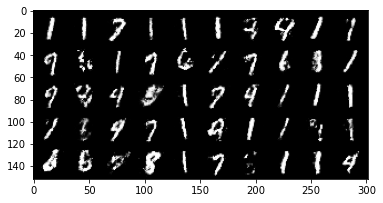

Iter: 69010/100000, Gen loss: 1.6902, Dis loss: 0.6773
Iter: 69020/100000, Gen loss: 1.6371, Dis loss: 0.8527
Iter: 69030/100000, Gen loss: 1.4911, Dis loss: 0.7836
Iter: 69040/100000, Gen loss: 1.6554, Dis loss: 0.8263
Iter: 69050/100000, Gen loss: 1.5874, Dis loss: 1.0049
Iter: 69060/100000, Gen loss: 1.5959, Dis loss: 0.8449
Iter: 69070/100000, Gen loss: 1.6502, Dis loss: 0.8065
Iter: 69080/100000, Gen loss: 1.5478, Dis loss: 0.7441
Iter: 69090/100000, Gen loss: 1.4768, Dis loss: 0.8370
Iter: 69100/100000, Gen loss: 1.6926, Dis loss: 0.7778
Iter: 69110/100000, Gen loss: 1.4980, Dis loss: 0.7845
Iter: 69120/100000, Gen loss: 1.5838, Dis loss: 0.7897
Iter: 69130/100000, Gen loss: 1.4415, Dis loss: 0.6840
Iter: 69140/100000, Gen loss: 1.8299, Dis loss: 0.6990
Iter: 69150/100000, Gen loss: 1.7864, Dis loss: 0.8310
Iter: 69160/100000, Gen loss: 1.7215, Dis loss: 0.5749
Iter: 69170/100000, Gen loss: 1.5243, Dis loss: 0.8854
Iter: 69180/100000, Gen loss: 1.2826, Dis loss: 0.7685
Iter: 6919

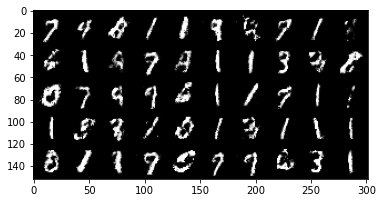

Iter: 69210/100000, Gen loss: 1.6988, Dis loss: 0.7973
Iter: 69220/100000, Gen loss: 1.8352, Dis loss: 0.7516
Iter: 69230/100000, Gen loss: 1.5963, Dis loss: 0.7874
Iter: 69240/100000, Gen loss: 1.2295, Dis loss: 1.0400
Iter: 69250/100000, Gen loss: 1.5484, Dis loss: 0.8092
Iter: 69260/100000, Gen loss: 1.9661, Dis loss: 0.8425
Iter: 69270/100000, Gen loss: 1.6007, Dis loss: 0.8713
Iter: 69280/100000, Gen loss: 1.9390, Dis loss: 0.9364
Iter: 69290/100000, Gen loss: 1.6860, Dis loss: 0.8719
Iter: 69300/100000, Gen loss: 1.6087, Dis loss: 1.0273
Iter: 69310/100000, Gen loss: 2.2298, Dis loss: 0.6700
Iter: 69320/100000, Gen loss: 2.1844, Dis loss: 0.8199
Iter: 69330/100000, Gen loss: 1.8717, Dis loss: 0.6549
Iter: 69340/100000, Gen loss: 1.8085, Dis loss: 0.5633
Iter: 69350/100000, Gen loss: 1.6142, Dis loss: 0.5974
Iter: 69360/100000, Gen loss: 1.5450, Dis loss: 0.7432
Iter: 69370/100000, Gen loss: 1.4487, Dis loss: 0.9301
Iter: 69380/100000, Gen loss: 1.7166, Dis loss: 0.6376
Iter: 6939

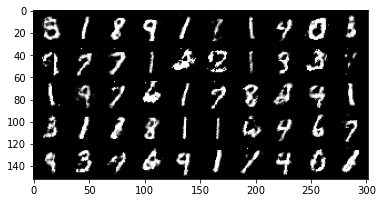

Iter: 69410/100000, Gen loss: 1.4993, Dis loss: 0.7320
Iter: 69420/100000, Gen loss: 1.3323, Dis loss: 0.8119
Iter: 69430/100000, Gen loss: 1.6647, Dis loss: 0.7081
Iter: 69440/100000, Gen loss: 1.4464, Dis loss: 1.0002
Iter: 69450/100000, Gen loss: 1.6854, Dis loss: 0.8132
Iter: 69460/100000, Gen loss: 1.8532, Dis loss: 0.9228
Iter: 69470/100000, Gen loss: 1.8764, Dis loss: 0.8026
Iter: 69480/100000, Gen loss: 1.9392, Dis loss: 0.7204
Iter: 69490/100000, Gen loss: 1.6951, Dis loss: 0.6560
Iter: 69500/100000, Gen loss: 1.7694, Dis loss: 0.7670
Iter: 69510/100000, Gen loss: 1.4482, Dis loss: 0.6601
Iter: 69520/100000, Gen loss: 1.7404, Dis loss: 0.9108
Iter: 69530/100000, Gen loss: 1.5482, Dis loss: 0.7905
Iter: 69540/100000, Gen loss: 1.4338, Dis loss: 0.7844
Iter: 69550/100000, Gen loss: 1.6057, Dis loss: 0.9371
Iter: 69560/100000, Gen loss: 1.7492, Dis loss: 0.8950
Iter: 69570/100000, Gen loss: 1.6343, Dis loss: 0.7956
Iter: 69580/100000, Gen loss: 1.3757, Dis loss: 0.7828
Iter: 6959

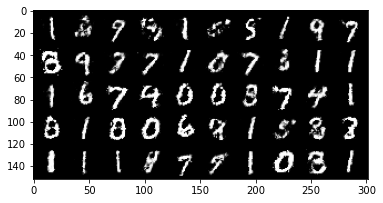

Iter: 69610/100000, Gen loss: 1.9399, Dis loss: 0.5373
Iter: 69620/100000, Gen loss: 2.1220, Dis loss: 0.9465
Iter: 69630/100000, Gen loss: 1.4279, Dis loss: 0.6695
Iter: 69640/100000, Gen loss: 1.1385, Dis loss: 0.6128
Iter: 69650/100000, Gen loss: 1.5937, Dis loss: 0.7119
Iter: 69660/100000, Gen loss: 1.7269, Dis loss: 0.7195
Iter: 69670/100000, Gen loss: 1.8630, Dis loss: 0.8849
Iter: 69680/100000, Gen loss: 1.7813, Dis loss: 0.7896
Iter: 69690/100000, Gen loss: 1.4560, Dis loss: 0.7639
Iter: 69700/100000, Gen loss: 1.6920, Dis loss: 0.8679
Iter: 69710/100000, Gen loss: 1.7576, Dis loss: 0.9770
Iter: 69720/100000, Gen loss: 1.7914, Dis loss: 0.7248
Iter: 69730/100000, Gen loss: 1.5906, Dis loss: 0.9065
Iter: 69740/100000, Gen loss: 1.5729, Dis loss: 0.7882
Iter: 69750/100000, Gen loss: 1.8701, Dis loss: 1.0145
Iter: 69760/100000, Gen loss: 1.7368, Dis loss: 0.5510
Iter: 69770/100000, Gen loss: 1.5858, Dis loss: 0.9711
Iter: 69780/100000, Gen loss: 1.7553, Dis loss: 0.9494
Iter: 6979

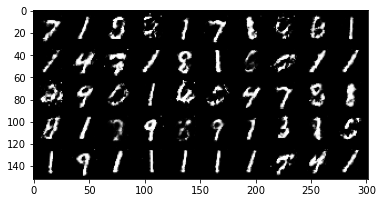

Iter: 69810/100000, Gen loss: 1.9016, Dis loss: 0.6560
Iter: 69820/100000, Gen loss: 1.5866, Dis loss: 0.9253
Iter: 69830/100000, Gen loss: 1.6692, Dis loss: 0.7934
Iter: 69840/100000, Gen loss: 1.8909, Dis loss: 0.7695
Iter: 69850/100000, Gen loss: 1.7175, Dis loss: 0.6560
Iter: 69860/100000, Gen loss: 1.9164, Dis loss: 0.8477
Iter: 69870/100000, Gen loss: 1.7219, Dis loss: 0.7710
Iter: 69880/100000, Gen loss: 1.2298, Dis loss: 0.7729
Iter: 69890/100000, Gen loss: 1.6667, Dis loss: 0.7465
Iter: 69900/100000, Gen loss: 1.6115, Dis loss: 0.7893
Iter: 69910/100000, Gen loss: 1.8370, Dis loss: 0.5410
Iter: 69920/100000, Gen loss: 1.7407, Dis loss: 0.7045
Iter: 69930/100000, Gen loss: 1.3962, Dis loss: 0.8151
Iter: 69940/100000, Gen loss: 1.3775, Dis loss: 1.0711
Iter: 69950/100000, Gen loss: 1.6039, Dis loss: 0.8136
Iter: 69960/100000, Gen loss: 1.8331, Dis loss: 1.0946
Iter: 69970/100000, Gen loss: 1.7140, Dis loss: 0.6522
Iter: 69980/100000, Gen loss: 1.9439, Dis loss: 0.6537
Iter: 6999

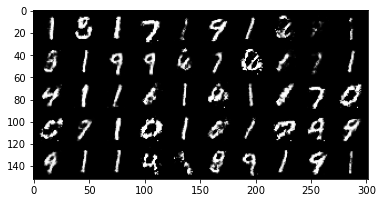

Iter: 70010/100000, Gen loss: 1.3797, Dis loss: 1.0840
Iter: 70020/100000, Gen loss: 1.5366, Dis loss: 1.2032
Iter: 70030/100000, Gen loss: 1.4082, Dis loss: 0.6851
Iter: 70040/100000, Gen loss: 1.6666, Dis loss: 0.7800
Iter: 70050/100000, Gen loss: 1.4071, Dis loss: 0.7108
Iter: 70060/100000, Gen loss: 1.3558, Dis loss: 0.6516
Iter: 70070/100000, Gen loss: 2.1033, Dis loss: 0.6232
Iter: 70080/100000, Gen loss: 1.9333, Dis loss: 0.6952
Iter: 70090/100000, Gen loss: 1.8640, Dis loss: 0.7453
Iter: 70100/100000, Gen loss: 2.1690, Dis loss: 0.8254
Iter: 70110/100000, Gen loss: 1.8291, Dis loss: 0.8015
Iter: 70120/100000, Gen loss: 2.0834, Dis loss: 0.7363
Iter: 70130/100000, Gen loss: 1.9584, Dis loss: 1.0332
Iter: 70140/100000, Gen loss: 1.3715, Dis loss: 0.8746
Iter: 70150/100000, Gen loss: 1.7093, Dis loss: 0.6850
Iter: 70160/100000, Gen loss: 1.6666, Dis loss: 0.7047
Iter: 70170/100000, Gen loss: 1.9605, Dis loss: 0.8907
Iter: 70180/100000, Gen loss: 2.0037, Dis loss: 0.7058
Iter: 7019

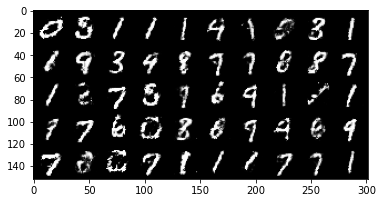

Iter: 70210/100000, Gen loss: 1.6270, Dis loss: 0.7337
Iter: 70220/100000, Gen loss: 1.7179, Dis loss: 0.6717
Iter: 70230/100000, Gen loss: 1.7043, Dis loss: 0.7154
Iter: 70240/100000, Gen loss: 1.5177, Dis loss: 0.6882
Iter: 70250/100000, Gen loss: 1.4775, Dis loss: 0.8600
Iter: 70260/100000, Gen loss: 1.6297, Dis loss: 0.6419
Iter: 70270/100000, Gen loss: 1.5466, Dis loss: 0.7138
Iter: 70280/100000, Gen loss: 1.8600, Dis loss: 0.6033
Iter: 70290/100000, Gen loss: 1.6361, Dis loss: 0.5451
Iter: 70300/100000, Gen loss: 1.8704, Dis loss: 0.7353
Iter: 70310/100000, Gen loss: 2.0437, Dis loss: 0.7558
Iter: 70320/100000, Gen loss: 1.7218, Dis loss: 0.9234
Iter: 70330/100000, Gen loss: 1.7835, Dis loss: 0.6348
Iter: 70340/100000, Gen loss: 1.4779, Dis loss: 0.8159
Iter: 70350/100000, Gen loss: 1.9869, Dis loss: 0.8787
Iter: 70360/100000, Gen loss: 2.0767, Dis loss: 0.8295
Iter: 70370/100000, Gen loss: 1.4410, Dis loss: 0.4688
Iter: 70380/100000, Gen loss: 1.2506, Dis loss: 0.9073
Iter: 7039

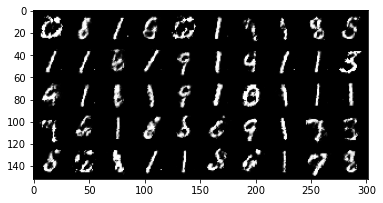

Iter: 70410/100000, Gen loss: 1.5817, Dis loss: 0.7531
Iter: 70420/100000, Gen loss: 1.5198, Dis loss: 0.7784
Iter: 70430/100000, Gen loss: 1.6987, Dis loss: 0.6988
Iter: 70440/100000, Gen loss: 1.8155, Dis loss: 0.7371
Iter: 70450/100000, Gen loss: 1.8219, Dis loss: 0.9880
Iter: 70460/100000, Gen loss: 1.5945, Dis loss: 0.7298
Iter: 70470/100000, Gen loss: 1.3344, Dis loss: 0.9398
Iter: 70480/100000, Gen loss: 1.8476, Dis loss: 0.7598
Iter: 70490/100000, Gen loss: 1.5642, Dis loss: 0.4900
Iter: 70500/100000, Gen loss: 1.5530, Dis loss: 0.7908
Iter: 70510/100000, Gen loss: 1.6445, Dis loss: 0.7941
Iter: 70520/100000, Gen loss: 2.1334, Dis loss: 0.8330
Iter: 70530/100000, Gen loss: 2.2167, Dis loss: 0.7602
Iter: 70540/100000, Gen loss: 1.8532, Dis loss: 0.6859
Iter: 70550/100000, Gen loss: 1.9199, Dis loss: 0.7912
Iter: 70560/100000, Gen loss: 1.7678, Dis loss: 0.6909
Iter: 70570/100000, Gen loss: 1.7863, Dis loss: 0.6747
Iter: 70580/100000, Gen loss: 1.6852, Dis loss: 0.6732
Iter: 7059

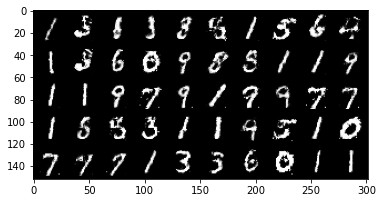

Iter: 70610/100000, Gen loss: 1.6072, Dis loss: 0.9096
Iter: 70620/100000, Gen loss: 1.5425, Dis loss: 0.7941
Iter: 70630/100000, Gen loss: 1.3957, Dis loss: 0.7360
Iter: 70640/100000, Gen loss: 1.1893, Dis loss: 0.8044
Iter: 70650/100000, Gen loss: 1.2824, Dis loss: 0.5932
Iter: 70660/100000, Gen loss: 1.5789, Dis loss: 0.8392
Iter: 70670/100000, Gen loss: 1.5301, Dis loss: 0.5379
Iter: 70680/100000, Gen loss: 1.2152, Dis loss: 0.8601
Iter: 70690/100000, Gen loss: 1.4634, Dis loss: 0.6728
Iter: 70700/100000, Gen loss: 1.6885, Dis loss: 0.5614
Iter: 70710/100000, Gen loss: 1.4876, Dis loss: 0.6872
Iter: 70720/100000, Gen loss: 1.6157, Dis loss: 0.7378
Iter: 70730/100000, Gen loss: 1.7463, Dis loss: 0.6418
Iter: 70740/100000, Gen loss: 1.3836, Dis loss: 0.9108
Iter: 70750/100000, Gen loss: 1.3738, Dis loss: 0.8501
Iter: 70760/100000, Gen loss: 1.3220, Dis loss: 0.7277
Iter: 70770/100000, Gen loss: 1.6457, Dis loss: 0.9345
Iter: 70780/100000, Gen loss: 1.5459, Dis loss: 0.9868
Iter: 7079

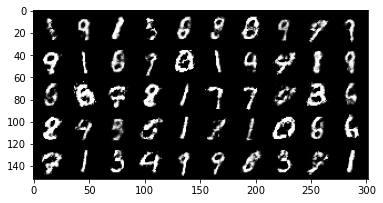

Iter: 70810/100000, Gen loss: 1.7435, Dis loss: 0.8734
Iter: 70820/100000, Gen loss: 1.4799, Dis loss: 0.9900
Iter: 70830/100000, Gen loss: 1.4911, Dis loss: 0.8510
Iter: 70840/100000, Gen loss: 1.2687, Dis loss: 0.8210
Iter: 70850/100000, Gen loss: 1.4452, Dis loss: 1.1058
Iter: 70860/100000, Gen loss: 1.4750, Dis loss: 0.7740
Iter: 70870/100000, Gen loss: 1.4543, Dis loss: 1.0529
Iter: 70880/100000, Gen loss: 1.7208, Dis loss: 0.7935
Iter: 70890/100000, Gen loss: 1.5460, Dis loss: 0.9335
Iter: 70900/100000, Gen loss: 1.5308, Dis loss: 0.9250
Iter: 70910/100000, Gen loss: 1.6636, Dis loss: 0.8218
Iter: 70920/100000, Gen loss: 1.6616, Dis loss: 0.6972
Iter: 70930/100000, Gen loss: 1.6059, Dis loss: 0.6444
Iter: 70940/100000, Gen loss: 1.1588, Dis loss: 0.7894
Iter: 70950/100000, Gen loss: 1.7250, Dis loss: 0.8759
Iter: 70960/100000, Gen loss: 1.4818, Dis loss: 0.8536
Iter: 70970/100000, Gen loss: 1.2874, Dis loss: 0.9132
Iter: 70980/100000, Gen loss: 1.6027, Dis loss: 0.8311
Iter: 7099

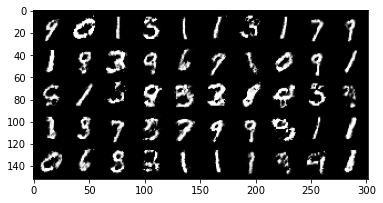

Iter: 71010/100000, Gen loss: 1.3467, Dis loss: 0.7702
Iter: 71020/100000, Gen loss: 1.5655, Dis loss: 0.7464
Iter: 71030/100000, Gen loss: 1.6699, Dis loss: 0.7002
Iter: 71040/100000, Gen loss: 1.6393, Dis loss: 0.7587
Iter: 71050/100000, Gen loss: 2.0163, Dis loss: 0.8882
Iter: 71060/100000, Gen loss: 1.7896, Dis loss: 0.9369
Iter: 71070/100000, Gen loss: 1.8226, Dis loss: 0.9080
Iter: 71080/100000, Gen loss: 1.7020, Dis loss: 0.9374
Iter: 71090/100000, Gen loss: 1.6268, Dis loss: 0.7479
Iter: 71100/100000, Gen loss: 2.1270, Dis loss: 0.7674
Iter: 71110/100000, Gen loss: 1.6146, Dis loss: 0.7095
Iter: 71120/100000, Gen loss: 1.2725, Dis loss: 1.0623
Iter: 71130/100000, Gen loss: 1.1355, Dis loss: 0.7176
Iter: 71140/100000, Gen loss: 1.6796, Dis loss: 0.6341
Iter: 71150/100000, Gen loss: 1.4290, Dis loss: 0.7845
Iter: 71160/100000, Gen loss: 1.7688, Dis loss: 0.7822
Iter: 71170/100000, Gen loss: 1.9171, Dis loss: 0.9806
Iter: 71180/100000, Gen loss: 1.3231, Dis loss: 0.8589
Iter: 7119

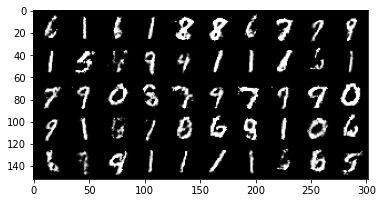

Iter: 71210/100000, Gen loss: 1.4969, Dis loss: 0.8947
Iter: 71220/100000, Gen loss: 1.4122, Dis loss: 0.5285
Iter: 71230/100000, Gen loss: 1.7562, Dis loss: 0.7878
Iter: 71240/100000, Gen loss: 1.8587, Dis loss: 0.8953
Iter: 71250/100000, Gen loss: 1.5667, Dis loss: 0.8037
Iter: 71260/100000, Gen loss: 1.6577, Dis loss: 0.6030
Iter: 71270/100000, Gen loss: 2.0316, Dis loss: 0.5947
Iter: 71280/100000, Gen loss: 1.5079, Dis loss: 0.8375
Iter: 71290/100000, Gen loss: 1.3771, Dis loss: 0.9854
Iter: 71300/100000, Gen loss: 1.3179, Dis loss: 0.8067
Iter: 71310/100000, Gen loss: 1.2327, Dis loss: 0.8918
Iter: 71320/100000, Gen loss: 1.3317, Dis loss: 0.9089
Iter: 71330/100000, Gen loss: 1.9493, Dis loss: 0.7802
Iter: 71340/100000, Gen loss: 1.4024, Dis loss: 0.8879
Iter: 71350/100000, Gen loss: 1.4348, Dis loss: 1.0454
Iter: 71360/100000, Gen loss: 1.4365, Dis loss: 1.1304
Iter: 71370/100000, Gen loss: 1.5560, Dis loss: 0.9410
Iter: 71380/100000, Gen loss: 1.5333, Dis loss: 0.8060
Iter: 7139

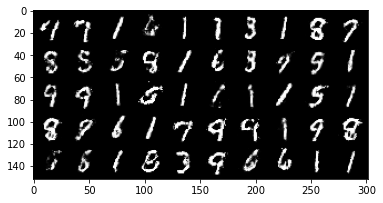

Iter: 71410/100000, Gen loss: 1.5132, Dis loss: 0.8625
Iter: 71420/100000, Gen loss: 1.6788, Dis loss: 0.7735
Iter: 71430/100000, Gen loss: 1.6254, Dis loss: 0.7407
Iter: 71440/100000, Gen loss: 1.6779, Dis loss: 0.7998
Iter: 71450/100000, Gen loss: 1.7391, Dis loss: 0.9280
Iter: 71460/100000, Gen loss: 1.6711, Dis loss: 0.8065
Iter: 71470/100000, Gen loss: 1.5235, Dis loss: 0.6119
Iter: 71480/100000, Gen loss: 1.5976, Dis loss: 0.6013
Iter: 71490/100000, Gen loss: 1.5699, Dis loss: 0.6930
Iter: 71500/100000, Gen loss: 1.6997, Dis loss: 0.6929
Iter: 71510/100000, Gen loss: 1.6698, Dis loss: 0.7845
Iter: 71520/100000, Gen loss: 1.3296, Dis loss: 0.8283
Iter: 71530/100000, Gen loss: 1.5418, Dis loss: 0.9649
Iter: 71540/100000, Gen loss: 1.6659, Dis loss: 0.6333
Iter: 71550/100000, Gen loss: 1.2948, Dis loss: 0.8154
Iter: 71560/100000, Gen loss: 1.5875, Dis loss: 0.8981
Iter: 71570/100000, Gen loss: 1.5878, Dis loss: 1.0954
Iter: 71580/100000, Gen loss: 1.8504, Dis loss: 0.6234
Iter: 7159

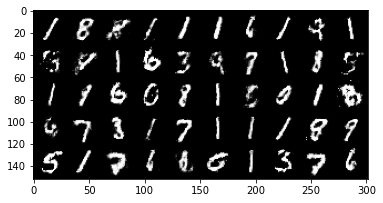

Iter: 71610/100000, Gen loss: 1.2824, Dis loss: 0.6857
Iter: 71620/100000, Gen loss: 1.1197, Dis loss: 0.8990
Iter: 71630/100000, Gen loss: 1.6843, Dis loss: 0.7456
Iter: 71640/100000, Gen loss: 1.5375, Dis loss: 0.8253
Iter: 71650/100000, Gen loss: 1.4368, Dis loss: 0.8119
Iter: 71660/100000, Gen loss: 1.5246, Dis loss: 0.7017
Iter: 71670/100000, Gen loss: 1.7527, Dis loss: 0.8403
Iter: 71680/100000, Gen loss: 1.5513, Dis loss: 0.8453
Iter: 71690/100000, Gen loss: 1.4646, Dis loss: 0.7468
Iter: 71700/100000, Gen loss: 1.6623, Dis loss: 0.8234
Iter: 71710/100000, Gen loss: 1.5438, Dis loss: 0.7890
Iter: 71720/100000, Gen loss: 1.9883, Dis loss: 0.8737
Iter: 71730/100000, Gen loss: 1.4843, Dis loss: 0.8369
Iter: 71740/100000, Gen loss: 1.6493, Dis loss: 0.8495
Iter: 71750/100000, Gen loss: 1.8720, Dis loss: 0.7951
Iter: 71760/100000, Gen loss: 1.7537, Dis loss: 0.7461
Iter: 71770/100000, Gen loss: 1.4169, Dis loss: 0.8862
Iter: 71780/100000, Gen loss: 1.9079, Dis loss: 0.6109
Iter: 7179

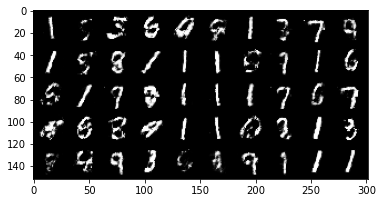

Iter: 71810/100000, Gen loss: 1.3368, Dis loss: 0.8426
Iter: 71820/100000, Gen loss: 1.3693, Dis loss: 0.8951
Iter: 71830/100000, Gen loss: 1.6319, Dis loss: 0.9251
Iter: 71840/100000, Gen loss: 1.8534, Dis loss: 0.7134
Iter: 71850/100000, Gen loss: 1.4369, Dis loss: 0.8245
Iter: 71860/100000, Gen loss: 1.3508, Dis loss: 0.8424
Iter: 71870/100000, Gen loss: 1.5582, Dis loss: 0.8929
Iter: 71880/100000, Gen loss: 1.6411, Dis loss: 0.8496
Iter: 71890/100000, Gen loss: 1.2815, Dis loss: 0.7359
Iter: 71900/100000, Gen loss: 1.4932, Dis loss: 0.8698
Iter: 71910/100000, Gen loss: 1.3494, Dis loss: 0.6693
Iter: 71920/100000, Gen loss: 1.5174, Dis loss: 0.7650
Iter: 71930/100000, Gen loss: 1.8727, Dis loss: 0.6657
Iter: 71940/100000, Gen loss: 1.8314, Dis loss: 0.6861
Iter: 71950/100000, Gen loss: 1.8020, Dis loss: 0.7495
Iter: 71960/100000, Gen loss: 1.8357, Dis loss: 0.9653
Iter: 71970/100000, Gen loss: 1.6106, Dis loss: 0.7292
Iter: 71980/100000, Gen loss: 1.4604, Dis loss: 0.9167
Iter: 7199

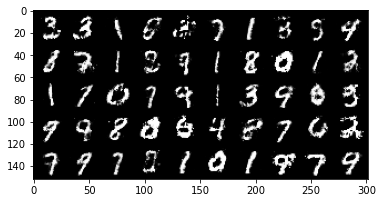

Iter: 72010/100000, Gen loss: 1.6085, Dis loss: 0.9070
Iter: 72020/100000, Gen loss: 1.3614, Dis loss: 0.8376
Iter: 72030/100000, Gen loss: 1.4744, Dis loss: 0.8585
Iter: 72040/100000, Gen loss: 1.4695, Dis loss: 0.6681
Iter: 72050/100000, Gen loss: 1.0996, Dis loss: 0.8252
Iter: 72060/100000, Gen loss: 1.1951, Dis loss: 0.7158
Iter: 72070/100000, Gen loss: 1.3507, Dis loss: 1.0061
Iter: 72080/100000, Gen loss: 1.4270, Dis loss: 1.2668
Iter: 72090/100000, Gen loss: 1.1248, Dis loss: 1.1557
Iter: 72100/100000, Gen loss: 1.7213, Dis loss: 0.6436
Iter: 72110/100000, Gen loss: 1.4576, Dis loss: 0.7818
Iter: 72120/100000, Gen loss: 1.6471, Dis loss: 0.8231
Iter: 72130/100000, Gen loss: 1.8718, Dis loss: 0.8131
Iter: 72140/100000, Gen loss: 1.8077, Dis loss: 0.6101
Iter: 72150/100000, Gen loss: 2.3037, Dis loss: 0.7812
Iter: 72160/100000, Gen loss: 1.7394, Dis loss: 0.5677
Iter: 72170/100000, Gen loss: 1.8847, Dis loss: 0.5844
Iter: 72180/100000, Gen loss: 1.7195, Dis loss: 0.4738
Iter: 7219

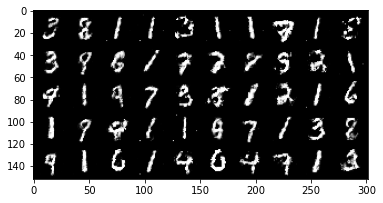

Iter: 72210/100000, Gen loss: 2.0176, Dis loss: 0.5477
Iter: 72220/100000, Gen loss: 1.6370, Dis loss: 0.7388
Iter: 72230/100000, Gen loss: 1.7693, Dis loss: 0.8832
Iter: 72240/100000, Gen loss: 1.6482, Dis loss: 0.6527
Iter: 72250/100000, Gen loss: 1.8365, Dis loss: 0.7448
Iter: 72260/100000, Gen loss: 1.5094, Dis loss: 0.9069
Iter: 72270/100000, Gen loss: 1.5564, Dis loss: 0.7151
Iter: 72280/100000, Gen loss: 1.8094, Dis loss: 1.1391
Iter: 72290/100000, Gen loss: 1.5840, Dis loss: 0.6927
Iter: 72300/100000, Gen loss: 1.6492, Dis loss: 0.9370
Iter: 72310/100000, Gen loss: 2.0847, Dis loss: 0.5560
Iter: 72320/100000, Gen loss: 1.9988, Dis loss: 0.7712
Iter: 72330/100000, Gen loss: 1.7976, Dis loss: 0.9170
Iter: 72340/100000, Gen loss: 1.5580, Dis loss: 0.6305
Iter: 72350/100000, Gen loss: 1.5632, Dis loss: 0.9163
Iter: 72360/100000, Gen loss: 1.5527, Dis loss: 0.9629
Iter: 72370/100000, Gen loss: 1.3970, Dis loss: 0.6940
Iter: 72380/100000, Gen loss: 1.7413, Dis loss: 0.8217
Iter: 7239

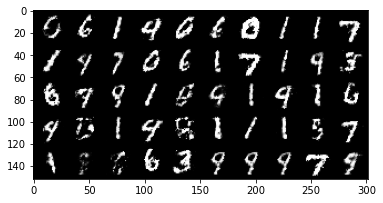

Iter: 72410/100000, Gen loss: 1.6131, Dis loss: 0.6705
Iter: 72420/100000, Gen loss: 1.5853, Dis loss: 0.8834
Iter: 72430/100000, Gen loss: 1.4106, Dis loss: 0.8013
Iter: 72440/100000, Gen loss: 1.8841, Dis loss: 0.7249
Iter: 72450/100000, Gen loss: 1.5003, Dis loss: 0.9654
Iter: 72460/100000, Gen loss: 1.6077, Dis loss: 0.6197
Iter: 72470/100000, Gen loss: 1.6096, Dis loss: 0.8745
Iter: 72480/100000, Gen loss: 1.3271, Dis loss: 0.8384
Iter: 72490/100000, Gen loss: 1.1658, Dis loss: 1.0814
Iter: 72500/100000, Gen loss: 1.6737, Dis loss: 1.1182
Iter: 72510/100000, Gen loss: 1.6910, Dis loss: 0.5872
Iter: 72520/100000, Gen loss: 1.9749, Dis loss: 0.5146
Iter: 72530/100000, Gen loss: 1.4495, Dis loss: 0.7697
Iter: 72540/100000, Gen loss: 1.4015, Dis loss: 0.7635
Iter: 72550/100000, Gen loss: 1.5837, Dis loss: 0.7572
Iter: 72560/100000, Gen loss: 1.2121, Dis loss: 0.7211
Iter: 72570/100000, Gen loss: 1.5255, Dis loss: 0.8047
Iter: 72580/100000, Gen loss: 1.5138, Dis loss: 0.9850
Iter: 7259

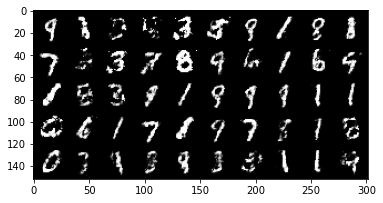

Iter: 72610/100000, Gen loss: 1.3346, Dis loss: 0.8041
Iter: 72620/100000, Gen loss: 1.6958, Dis loss: 0.7827
Iter: 72630/100000, Gen loss: 1.6178, Dis loss: 0.6333
Iter: 72640/100000, Gen loss: 1.5188, Dis loss: 0.6450
Iter: 72650/100000, Gen loss: 1.3064, Dis loss: 0.8268
Iter: 72660/100000, Gen loss: 1.8951, Dis loss: 0.7826
Iter: 72670/100000, Gen loss: 1.6351, Dis loss: 0.7861
Iter: 72680/100000, Gen loss: 1.4688, Dis loss: 0.7285
Iter: 72690/100000, Gen loss: 1.8519, Dis loss: 0.7990
Iter: 72700/100000, Gen loss: 1.8958, Dis loss: 0.6200
Iter: 72710/100000, Gen loss: 1.6355, Dis loss: 0.7220
Iter: 72720/100000, Gen loss: 1.8619, Dis loss: 0.6284
Iter: 72730/100000, Gen loss: 1.6933, Dis loss: 0.8385
Iter: 72740/100000, Gen loss: 1.6883, Dis loss: 0.7487
Iter: 72750/100000, Gen loss: 1.4230, Dis loss: 0.8046
Iter: 72760/100000, Gen loss: 1.6874, Dis loss: 0.6263
Iter: 72770/100000, Gen loss: 1.2429, Dis loss: 0.8322
Iter: 72780/100000, Gen loss: 1.5521, Dis loss: 0.9549
Iter: 7279

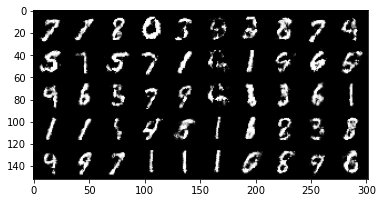

Iter: 72810/100000, Gen loss: 1.9359, Dis loss: 0.8068
Iter: 72820/100000, Gen loss: 1.6458, Dis loss: 0.7937
Iter: 72830/100000, Gen loss: 1.6127, Dis loss: 0.7604
Iter: 72840/100000, Gen loss: 2.1586, Dis loss: 0.8506
Iter: 72850/100000, Gen loss: 1.4415, Dis loss: 0.8905
Iter: 72860/100000, Gen loss: 1.4216, Dis loss: 0.6410
Iter: 72870/100000, Gen loss: 1.4066, Dis loss: 0.6754
Iter: 72880/100000, Gen loss: 1.2625, Dis loss: 0.7760
Iter: 72890/100000, Gen loss: 1.2827, Dis loss: 0.8927
Iter: 72900/100000, Gen loss: 1.4159, Dis loss: 0.6662
Iter: 72910/100000, Gen loss: 1.8367, Dis loss: 0.7633
Iter: 72920/100000, Gen loss: 1.5105, Dis loss: 0.8781
Iter: 72930/100000, Gen loss: 1.4209, Dis loss: 0.7207
Iter: 72940/100000, Gen loss: 1.2826, Dis loss: 1.0077
Iter: 72950/100000, Gen loss: 1.5735, Dis loss: 0.7118
Iter: 72960/100000, Gen loss: 1.5240, Dis loss: 0.8462
Iter: 72970/100000, Gen loss: 1.6225, Dis loss: 1.0963
Iter: 72980/100000, Gen loss: 1.5780, Dis loss: 0.6717
Iter: 7299

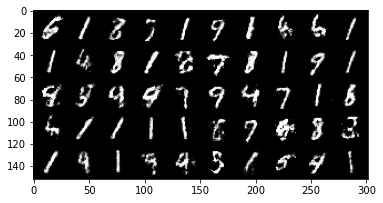

Iter: 73010/100000, Gen loss: 1.7520, Dis loss: 0.8509
Iter: 73020/100000, Gen loss: 1.5564, Dis loss: 0.8506
Iter: 73030/100000, Gen loss: 1.4244, Dis loss: 0.7351
Iter: 73040/100000, Gen loss: 1.5709, Dis loss: 0.6767
Iter: 73050/100000, Gen loss: 1.5683, Dis loss: 1.0686
Iter: 73060/100000, Gen loss: 1.5928, Dis loss: 0.9689
Iter: 73070/100000, Gen loss: 1.5258, Dis loss: 1.0055
Iter: 73080/100000, Gen loss: 1.5928, Dis loss: 0.7959
Iter: 73090/100000, Gen loss: 1.4459, Dis loss: 1.0441
Iter: 73100/100000, Gen loss: 1.6373, Dis loss: 0.8108
Iter: 73110/100000, Gen loss: 1.3273, Dis loss: 0.8052
Iter: 73120/100000, Gen loss: 1.7504, Dis loss: 0.8045
Iter: 73130/100000, Gen loss: 1.3206, Dis loss: 0.8415
Iter: 73140/100000, Gen loss: 1.5726, Dis loss: 0.8744
Iter: 73150/100000, Gen loss: 1.2872, Dis loss: 0.9507
Iter: 73160/100000, Gen loss: 1.2867, Dis loss: 0.7193
Iter: 73170/100000, Gen loss: 1.4115, Dis loss: 0.7169
Iter: 73180/100000, Gen loss: 1.6936, Dis loss: 0.9164
Iter: 7319

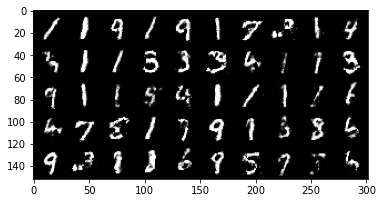

Iter: 73210/100000, Gen loss: 1.3343, Dis loss: 0.8194
Iter: 73220/100000, Gen loss: 1.7097, Dis loss: 0.8163
Iter: 73230/100000, Gen loss: 1.4904, Dis loss: 0.7589
Iter: 73240/100000, Gen loss: 1.6504, Dis loss: 0.7644
Iter: 73250/100000, Gen loss: 1.6540, Dis loss: 0.8348
Iter: 73260/100000, Gen loss: 1.4822, Dis loss: 0.8271
Iter: 73270/100000, Gen loss: 1.7421, Dis loss: 0.7567
Iter: 73280/100000, Gen loss: 1.7023, Dis loss: 0.8693
Iter: 73290/100000, Gen loss: 1.4697, Dis loss: 0.7842
Iter: 73300/100000, Gen loss: 1.3912, Dis loss: 1.0050
Iter: 73310/100000, Gen loss: 1.5314, Dis loss: 0.6906
Iter: 73320/100000, Gen loss: 1.5116, Dis loss: 0.8709
Iter: 73330/100000, Gen loss: 1.5141, Dis loss: 0.8174
Iter: 73340/100000, Gen loss: 1.7563, Dis loss: 0.7518
Iter: 73350/100000, Gen loss: 1.4933, Dis loss: 0.9600
Iter: 73360/100000, Gen loss: 1.5386, Dis loss: 0.6377
Iter: 73370/100000, Gen loss: 1.5094, Dis loss: 0.8874
Iter: 73380/100000, Gen loss: 1.1534, Dis loss: 0.7564
Iter: 7339

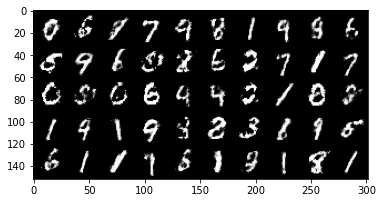

Iter: 73410/100000, Gen loss: 1.4445, Dis loss: 0.7608
Iter: 73420/100000, Gen loss: 1.1732, Dis loss: 0.9968
Iter: 73430/100000, Gen loss: 1.0261, Dis loss: 1.0973
Iter: 73440/100000, Gen loss: 1.2439, Dis loss: 0.9363
Iter: 73450/100000, Gen loss: 1.2939, Dis loss: 0.8613
Iter: 73460/100000, Gen loss: 1.7209, Dis loss: 0.9732
Iter: 73470/100000, Gen loss: 1.3934, Dis loss: 0.8955
Iter: 73480/100000, Gen loss: 1.3762, Dis loss: 0.9142
Iter: 73490/100000, Gen loss: 1.5027, Dis loss: 0.8080
Iter: 73500/100000, Gen loss: 1.5053, Dis loss: 0.9682
Iter: 73510/100000, Gen loss: 1.3912, Dis loss: 0.9230
Iter: 73520/100000, Gen loss: 1.2995, Dis loss: 0.6483
Iter: 73530/100000, Gen loss: 1.4226, Dis loss: 0.7323
Iter: 73540/100000, Gen loss: 1.2496, Dis loss: 0.6656
Iter: 73550/100000, Gen loss: 1.5491, Dis loss: 1.2724
Iter: 73560/100000, Gen loss: 1.3451, Dis loss: 1.0997
Iter: 73570/100000, Gen loss: 1.2514, Dis loss: 0.8424
Iter: 73580/100000, Gen loss: 1.4664, Dis loss: 0.8642
Iter: 7359

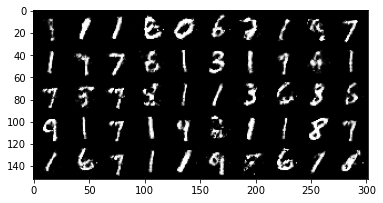

Iter: 73610/100000, Gen loss: 1.3394, Dis loss: 0.7819
Iter: 73620/100000, Gen loss: 1.4612, Dis loss: 0.7315
Iter: 73630/100000, Gen loss: 1.5503, Dis loss: 0.7023
Iter: 73640/100000, Gen loss: 1.2815, Dis loss: 0.8855
Iter: 73650/100000, Gen loss: 1.3271, Dis loss: 0.7341
Iter: 73660/100000, Gen loss: 1.2502, Dis loss: 0.7507
Iter: 73670/100000, Gen loss: 1.6404, Dis loss: 0.8562
Iter: 73680/100000, Gen loss: 1.3458, Dis loss: 0.9231
Iter: 73690/100000, Gen loss: 1.4806, Dis loss: 0.8389
Iter: 73700/100000, Gen loss: 1.4682, Dis loss: 1.0225
Iter: 73710/100000, Gen loss: 1.7333, Dis loss: 0.7580
Iter: 73720/100000, Gen loss: 1.3723, Dis loss: 0.8854
Iter: 73730/100000, Gen loss: 1.4050, Dis loss: 0.7091
Iter: 73740/100000, Gen loss: 1.3704, Dis loss: 0.8841
Iter: 73750/100000, Gen loss: 1.4897, Dis loss: 0.6956
Iter: 73760/100000, Gen loss: 1.7150, Dis loss: 0.6925
Iter: 73770/100000, Gen loss: 1.8625, Dis loss: 0.6807
Iter: 73780/100000, Gen loss: 1.7021, Dis loss: 0.7467
Iter: 7379

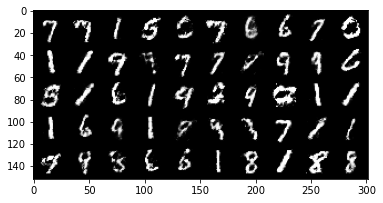

Iter: 73810/100000, Gen loss: 1.3578, Dis loss: 0.7825
Iter: 73820/100000, Gen loss: 1.8259, Dis loss: 0.6926
Iter: 73830/100000, Gen loss: 1.3476, Dis loss: 0.8170
Iter: 73840/100000, Gen loss: 1.5638, Dis loss: 0.6828
Iter: 73850/100000, Gen loss: 1.5713, Dis loss: 0.8207
Iter: 73860/100000, Gen loss: 1.4672, Dis loss: 1.0116
Iter: 73870/100000, Gen loss: 1.3922, Dis loss: 1.1579
Iter: 73880/100000, Gen loss: 1.5984, Dis loss: 0.8716
Iter: 73890/100000, Gen loss: 1.7587, Dis loss: 0.6061
Iter: 73900/100000, Gen loss: 1.9228, Dis loss: 0.5440
Iter: 73910/100000, Gen loss: 1.3650, Dis loss: 0.5544
Iter: 73920/100000, Gen loss: 1.6864, Dis loss: 0.7890
Iter: 73930/100000, Gen loss: 1.5869, Dis loss: 0.7515
Iter: 73940/100000, Gen loss: 1.7562, Dis loss: 0.6220
Iter: 73950/100000, Gen loss: 1.3598, Dis loss: 0.7056
Iter: 73960/100000, Gen loss: 1.1818, Dis loss: 0.7167
Iter: 73970/100000, Gen loss: 1.7401, Dis loss: 0.7939
Iter: 73980/100000, Gen loss: 1.5367, Dis loss: 1.0552
Iter: 7399

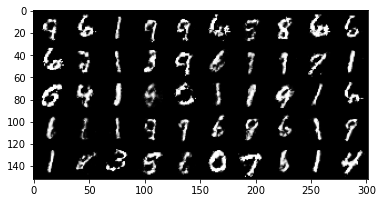

Iter: 74010/100000, Gen loss: 1.7553, Dis loss: 0.7104
Iter: 74020/100000, Gen loss: 1.7060, Dis loss: 0.6644
Iter: 74030/100000, Gen loss: 1.5154, Dis loss: 0.5444
Iter: 74040/100000, Gen loss: 1.4122, Dis loss: 0.6937
Iter: 74050/100000, Gen loss: 1.6349, Dis loss: 1.0487
Iter: 74060/100000, Gen loss: 1.4635, Dis loss: 0.8686
Iter: 74070/100000, Gen loss: 1.6915, Dis loss: 0.7918
Iter: 74080/100000, Gen loss: 1.3868, Dis loss: 0.9644
Iter: 74090/100000, Gen loss: 1.3126, Dis loss: 0.8448
Iter: 74100/100000, Gen loss: 1.7697, Dis loss: 0.6391
Iter: 74110/100000, Gen loss: 1.6603, Dis loss: 0.8010
Iter: 74120/100000, Gen loss: 1.7502, Dis loss: 0.8234
Iter: 74130/100000, Gen loss: 1.3955, Dis loss: 0.9698
Iter: 74140/100000, Gen loss: 1.4115, Dis loss: 0.7441
Iter: 74150/100000, Gen loss: 1.7436, Dis loss: 0.7557
Iter: 74160/100000, Gen loss: 1.5108, Dis loss: 0.7349
Iter: 74170/100000, Gen loss: 1.3759, Dis loss: 0.9121
Iter: 74180/100000, Gen loss: 1.5110, Dis loss: 0.7363
Iter: 7419

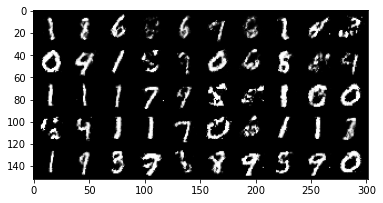

Iter: 74210/100000, Gen loss: 1.3329, Dis loss: 0.8317
Iter: 74220/100000, Gen loss: 1.3971, Dis loss: 0.9608
Iter: 74230/100000, Gen loss: 1.7753, Dis loss: 0.8340
Iter: 74240/100000, Gen loss: 1.6650, Dis loss: 0.5605
Iter: 74250/100000, Gen loss: 2.0144, Dis loss: 0.8098
Iter: 74260/100000, Gen loss: 1.7776, Dis loss: 0.6727
Iter: 74270/100000, Gen loss: 1.7078, Dis loss: 0.7278
Iter: 74280/100000, Gen loss: 1.5802, Dis loss: 0.8458
Iter: 74290/100000, Gen loss: 1.6517, Dis loss: 0.8891
Iter: 74300/100000, Gen loss: 1.5770, Dis loss: 1.0417
Iter: 74310/100000, Gen loss: 1.5069, Dis loss: 0.8537
Iter: 74320/100000, Gen loss: 1.7603, Dis loss: 0.8538
Iter: 74330/100000, Gen loss: 2.0294, Dis loss: 0.9766
Iter: 74340/100000, Gen loss: 1.8541, Dis loss: 1.0063
Iter: 74350/100000, Gen loss: 1.5057, Dis loss: 0.7977
Iter: 74360/100000, Gen loss: 1.3952, Dis loss: 0.9319
Iter: 74370/100000, Gen loss: 1.5500, Dis loss: 0.8241
Iter: 74380/100000, Gen loss: 1.3800, Dis loss: 0.8323
Iter: 7439

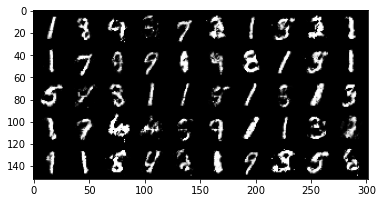

Iter: 74410/100000, Gen loss: 1.5331, Dis loss: 0.8805
Iter: 74420/100000, Gen loss: 1.3488, Dis loss: 0.9792
Iter: 74430/100000, Gen loss: 1.4356, Dis loss: 0.9583
Iter: 74440/100000, Gen loss: 1.7403, Dis loss: 0.9333
Iter: 74450/100000, Gen loss: 1.6228, Dis loss: 0.8865
Iter: 74460/100000, Gen loss: 1.7757, Dis loss: 0.7402
Iter: 74470/100000, Gen loss: 1.3990, Dis loss: 0.6778
Iter: 74480/100000, Gen loss: 1.3977, Dis loss: 0.8468
Iter: 74490/100000, Gen loss: 1.3101, Dis loss: 0.7986
Iter: 74500/100000, Gen loss: 1.2915, Dis loss: 0.9332
Iter: 74510/100000, Gen loss: 1.3616, Dis loss: 0.8331
Iter: 74520/100000, Gen loss: 1.4517, Dis loss: 0.8655
Iter: 74530/100000, Gen loss: 1.4636, Dis loss: 0.9756
Iter: 74540/100000, Gen loss: 1.2594, Dis loss: 0.8127
Iter: 74550/100000, Gen loss: 1.3203, Dis loss: 0.8080
Iter: 74560/100000, Gen loss: 1.8223, Dis loss: 0.8648
Iter: 74570/100000, Gen loss: 1.5165, Dis loss: 0.8524
Iter: 74580/100000, Gen loss: 1.4306, Dis loss: 0.5896
Iter: 7459

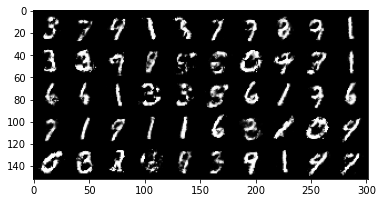

Iter: 74610/100000, Gen loss: 1.1530, Dis loss: 0.7323
Iter: 74620/100000, Gen loss: 1.4540, Dis loss: 0.8280
Iter: 74630/100000, Gen loss: 1.3788, Dis loss: 0.7611
Iter: 74640/100000, Gen loss: 1.5119, Dis loss: 0.7340
Iter: 74650/100000, Gen loss: 1.3872, Dis loss: 0.8702
Iter: 74660/100000, Gen loss: 1.8001, Dis loss: 0.6101
Iter: 74670/100000, Gen loss: 1.3650, Dis loss: 0.7674
Iter: 74680/100000, Gen loss: 1.5027, Dis loss: 0.7271
Iter: 74690/100000, Gen loss: 1.9496, Dis loss: 0.7908
Iter: 74700/100000, Gen loss: 1.6888, Dis loss: 0.8392
Iter: 74710/100000, Gen loss: 1.8094, Dis loss: 0.7044
Iter: 74720/100000, Gen loss: 1.8188, Dis loss: 0.7510
Iter: 74730/100000, Gen loss: 1.7001, Dis loss: 0.7712
Iter: 74740/100000, Gen loss: 1.6831, Dis loss: 0.6713
Iter: 74750/100000, Gen loss: 1.7354, Dis loss: 0.8703
Iter: 74760/100000, Gen loss: 1.2959, Dis loss: 0.8327
Iter: 74770/100000, Gen loss: 1.2463, Dis loss: 0.8632
Iter: 74780/100000, Gen loss: 1.4993, Dis loss: 0.8808
Iter: 7479

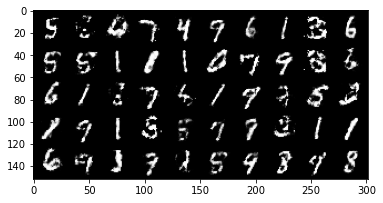

Iter: 74810/100000, Gen loss: 1.6521, Dis loss: 0.7839
Iter: 74820/100000, Gen loss: 1.4628, Dis loss: 0.8256
Iter: 74830/100000, Gen loss: 1.3876, Dis loss: 0.9134
Iter: 74840/100000, Gen loss: 1.4065, Dis loss: 0.7798
Iter: 74850/100000, Gen loss: 2.0186, Dis loss: 0.9650
Iter: 74860/100000, Gen loss: 1.4556, Dis loss: 1.1264
Iter: 74870/100000, Gen loss: 1.3638, Dis loss: 0.8817
Iter: 74880/100000, Gen loss: 1.2014, Dis loss: 1.0291
Iter: 74890/100000, Gen loss: 1.1398, Dis loss: 0.9008
Iter: 74900/100000, Gen loss: 1.1988, Dis loss: 0.9743
Iter: 74910/100000, Gen loss: 1.1425, Dis loss: 0.7147
Iter: 74920/100000, Gen loss: 1.6187, Dis loss: 0.7882
Iter: 74930/100000, Gen loss: 1.4932, Dis loss: 0.7124
Iter: 74940/100000, Gen loss: 1.2072, Dis loss: 0.7827
Iter: 74950/100000, Gen loss: 1.7050, Dis loss: 0.8524
Iter: 74960/100000, Gen loss: 1.5673, Dis loss: 1.1180
Iter: 74970/100000, Gen loss: 1.4107, Dis loss: 1.0262
Iter: 74980/100000, Gen loss: 1.1385, Dis loss: 0.7346
Iter: 7499

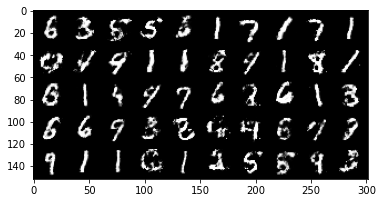

Iter: 75010/100000, Gen loss: 1.2689, Dis loss: 0.7639
Iter: 75020/100000, Gen loss: 1.2392, Dis loss: 0.8787
Iter: 75030/100000, Gen loss: 1.3488, Dis loss: 0.8904
Iter: 75040/100000, Gen loss: 1.2869, Dis loss: 0.6840
Iter: 75050/100000, Gen loss: 1.4353, Dis loss: 0.8209
Iter: 75060/100000, Gen loss: 1.8124, Dis loss: 0.8062
Iter: 75070/100000, Gen loss: 1.8270, Dis loss: 0.6445
Iter: 75080/100000, Gen loss: 1.6230, Dis loss: 0.6842
Iter: 75090/100000, Gen loss: 1.6358, Dis loss: 0.6580
Iter: 75100/100000, Gen loss: 1.2727, Dis loss: 0.6293
Iter: 75110/100000, Gen loss: 1.3117, Dis loss: 0.7748
Iter: 75120/100000, Gen loss: 1.4805, Dis loss: 1.1267
Iter: 75130/100000, Gen loss: 1.4893, Dis loss: 0.9028
Iter: 75140/100000, Gen loss: 1.6824, Dis loss: 0.8708
Iter: 75150/100000, Gen loss: 1.5230, Dis loss: 1.0237
Iter: 75160/100000, Gen loss: 1.3958, Dis loss: 0.9791
Iter: 75170/100000, Gen loss: 1.4941, Dis loss: 0.8191
Iter: 75180/100000, Gen loss: 1.3655, Dis loss: 0.7488
Iter: 7519

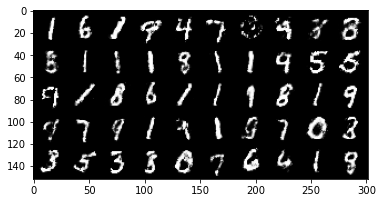

Iter: 75210/100000, Gen loss: 1.4798, Dis loss: 0.7553
Iter: 75220/100000, Gen loss: 1.8704, Dis loss: 0.8239
Iter: 75230/100000, Gen loss: 1.6788, Dis loss: 0.8958
Iter: 75240/100000, Gen loss: 1.2553, Dis loss: 0.9706
Iter: 75250/100000, Gen loss: 1.2954, Dis loss: 1.2780
Iter: 75260/100000, Gen loss: 1.6115, Dis loss: 0.9148
Iter: 75270/100000, Gen loss: 1.2921, Dis loss: 0.9986
Iter: 75280/100000, Gen loss: 1.7993, Dis loss: 0.8237
Iter: 75290/100000, Gen loss: 1.6783, Dis loss: 0.7014
Iter: 75300/100000, Gen loss: 1.5446, Dis loss: 0.7773
Iter: 75310/100000, Gen loss: 1.5874, Dis loss: 0.9219
Iter: 75320/100000, Gen loss: 1.5805, Dis loss: 0.8728
Iter: 75330/100000, Gen loss: 1.2988, Dis loss: 0.7251
Iter: 75340/100000, Gen loss: 1.3970, Dis loss: 0.6400
Iter: 75350/100000, Gen loss: 1.2565, Dis loss: 0.9686
Iter: 75360/100000, Gen loss: 1.3971, Dis loss: 0.9887
Iter: 75370/100000, Gen loss: 1.7549, Dis loss: 0.6592
Iter: 75380/100000, Gen loss: 1.5181, Dis loss: 0.7695
Iter: 7539

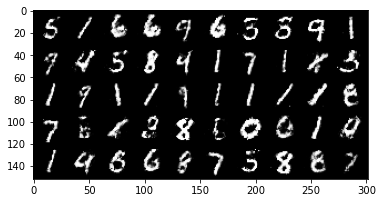

Iter: 75410/100000, Gen loss: 1.5940, Dis loss: 0.6894
Iter: 75420/100000, Gen loss: 1.2336, Dis loss: 0.9641
Iter: 75430/100000, Gen loss: 1.0890, Dis loss: 0.9275
Iter: 75440/100000, Gen loss: 1.2391, Dis loss: 0.7131
Iter: 75450/100000, Gen loss: 1.4767, Dis loss: 0.8542
Iter: 75460/100000, Gen loss: 1.5800, Dis loss: 0.7394
Iter: 75470/100000, Gen loss: 1.7834, Dis loss: 0.7070
Iter: 75480/100000, Gen loss: 1.6491, Dis loss: 0.8449
Iter: 75490/100000, Gen loss: 1.2717, Dis loss: 0.7779
Iter: 75500/100000, Gen loss: 1.5290, Dis loss: 0.7316
Iter: 75510/100000, Gen loss: 1.3240, Dis loss: 0.8272
Iter: 75520/100000, Gen loss: 1.5662, Dis loss: 0.7648
Iter: 75530/100000, Gen loss: 1.7712, Dis loss: 0.7882
Iter: 75540/100000, Gen loss: 1.5427, Dis loss: 0.8711
Iter: 75550/100000, Gen loss: 1.9938, Dis loss: 0.6355
Iter: 75560/100000, Gen loss: 1.5743, Dis loss: 0.7361
Iter: 75570/100000, Gen loss: 1.6916, Dis loss: 0.8977
Iter: 75580/100000, Gen loss: 1.1084, Dis loss: 0.9678
Iter: 7559

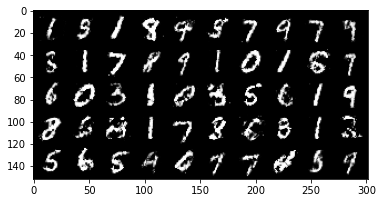

Iter: 75610/100000, Gen loss: 1.5999, Dis loss: 0.9320
Iter: 75620/100000, Gen loss: 1.8726, Dis loss: 0.7021
Iter: 75630/100000, Gen loss: 1.7714, Dis loss: 0.7588
Iter: 75640/100000, Gen loss: 1.7226, Dis loss: 0.9082
Iter: 75650/100000, Gen loss: 1.2785, Dis loss: 0.9961
Iter: 75660/100000, Gen loss: 1.3186, Dis loss: 1.1620
Iter: 75670/100000, Gen loss: 1.5298, Dis loss: 0.8275
Iter: 75680/100000, Gen loss: 1.7228, Dis loss: 0.8447
Iter: 75690/100000, Gen loss: 1.6666, Dis loss: 0.6799
Iter: 75700/100000, Gen loss: 1.9147, Dis loss: 0.8319
Iter: 75710/100000, Gen loss: 1.3147, Dis loss: 0.9093
Iter: 75720/100000, Gen loss: 1.5990, Dis loss: 0.7397
Iter: 75730/100000, Gen loss: 1.3633, Dis loss: 0.8151
Iter: 75740/100000, Gen loss: 1.6352, Dis loss: 0.8679
Iter: 75750/100000, Gen loss: 1.9999, Dis loss: 1.0166
Iter: 75760/100000, Gen loss: 1.4980, Dis loss: 0.8323
Iter: 75770/100000, Gen loss: 1.6849, Dis loss: 0.9548
Iter: 75780/100000, Gen loss: 1.3283, Dis loss: 0.8112
Iter: 7579

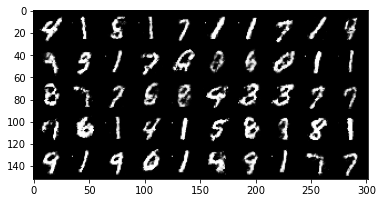

Iter: 75810/100000, Gen loss: 1.0746, Dis loss: 0.7976
Iter: 75820/100000, Gen loss: 1.1301, Dis loss: 0.8059
Iter: 75830/100000, Gen loss: 1.0473, Dis loss: 0.6779
Iter: 75840/100000, Gen loss: 1.6421, Dis loss: 0.6194
Iter: 75850/100000, Gen loss: 1.5905, Dis loss: 0.8759
Iter: 75860/100000, Gen loss: 1.5866, Dis loss: 0.8687
Iter: 75870/100000, Gen loss: 0.9934, Dis loss: 0.9038
Iter: 75880/100000, Gen loss: 1.2528, Dis loss: 0.9238
Iter: 75890/100000, Gen loss: 1.3644, Dis loss: 0.7089
Iter: 75900/100000, Gen loss: 1.8320, Dis loss: 0.7396
Iter: 75910/100000, Gen loss: 2.1557, Dis loss: 0.8590
Iter: 75920/100000, Gen loss: 1.8178, Dis loss: 1.0306
Iter: 75930/100000, Gen loss: 1.6950, Dis loss: 0.8362
Iter: 75940/100000, Gen loss: 1.8337, Dis loss: 0.9540
Iter: 75950/100000, Gen loss: 1.7824, Dis loss: 0.8091
Iter: 75960/100000, Gen loss: 1.4653, Dis loss: 0.8999
Iter: 75970/100000, Gen loss: 1.2810, Dis loss: 0.7763
Iter: 75980/100000, Gen loss: 1.1685, Dis loss: 0.8867
Iter: 7599

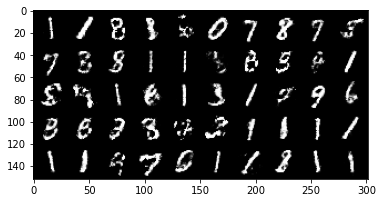

Iter: 76010/100000, Gen loss: 1.6425, Dis loss: 0.8115
Iter: 76020/100000, Gen loss: 1.6057, Dis loss: 0.8036
Iter: 76030/100000, Gen loss: 1.4324, Dis loss: 0.8361
Iter: 76040/100000, Gen loss: 1.1737, Dis loss: 1.0139
Iter: 76050/100000, Gen loss: 1.2182, Dis loss: 0.6686
Iter: 76060/100000, Gen loss: 1.1743, Dis loss: 0.8611
Iter: 76070/100000, Gen loss: 1.2499, Dis loss: 0.7286
Iter: 76080/100000, Gen loss: 1.6330, Dis loss: 0.8745
Iter: 76090/100000, Gen loss: 1.5208, Dis loss: 0.7687
Iter: 76100/100000, Gen loss: 1.4286, Dis loss: 0.7671
Iter: 76110/100000, Gen loss: 1.6310, Dis loss: 0.9464
Iter: 76120/100000, Gen loss: 1.3386, Dis loss: 0.8370
Iter: 76130/100000, Gen loss: 1.5099, Dis loss: 0.6719
Iter: 76140/100000, Gen loss: 1.3794, Dis loss: 0.6799
Iter: 76150/100000, Gen loss: 1.7917, Dis loss: 0.9643
Iter: 76160/100000, Gen loss: 0.9502, Dis loss: 0.8529
Iter: 76170/100000, Gen loss: 1.3273, Dis loss: 0.8762
Iter: 76180/100000, Gen loss: 1.6424, Dis loss: 0.9321
Iter: 7619

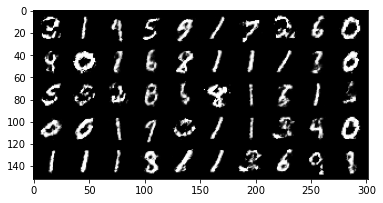

Iter: 76210/100000, Gen loss: 1.5248, Dis loss: 0.7724
Iter: 76220/100000, Gen loss: 1.3743, Dis loss: 1.0585
Iter: 76230/100000, Gen loss: 1.3081, Dis loss: 0.7936
Iter: 76240/100000, Gen loss: 1.6885, Dis loss: 0.8259
Iter: 76250/100000, Gen loss: 1.2981, Dis loss: 0.9343
Iter: 76260/100000, Gen loss: 1.6768, Dis loss: 0.8632
Iter: 76270/100000, Gen loss: 1.5419, Dis loss: 0.8930
Iter: 76280/100000, Gen loss: 1.2808, Dis loss: 1.0228
Iter: 76290/100000, Gen loss: 1.6148, Dis loss: 0.8530
Iter: 76300/100000, Gen loss: 1.1387, Dis loss: 1.0288
Iter: 76310/100000, Gen loss: 1.4752, Dis loss: 0.7960
Iter: 76320/100000, Gen loss: 1.3422, Dis loss: 0.7922
Iter: 76330/100000, Gen loss: 1.5301, Dis loss: 0.7945
Iter: 76340/100000, Gen loss: 1.3286, Dis loss: 0.8660
Iter: 76350/100000, Gen loss: 1.5215, Dis loss: 0.7228
Iter: 76360/100000, Gen loss: 1.4178, Dis loss: 0.7639
Iter: 76370/100000, Gen loss: 1.2776, Dis loss: 0.9160
Iter: 76380/100000, Gen loss: 1.4512, Dis loss: 0.9450
Iter: 7639

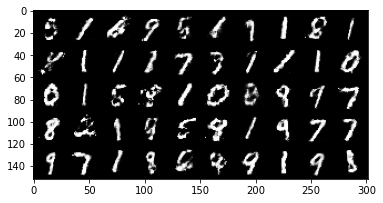

Iter: 76410/100000, Gen loss: 1.4855, Dis loss: 0.7592
Iter: 76420/100000, Gen loss: 1.6127, Dis loss: 0.9732
Iter: 76430/100000, Gen loss: 1.4942, Dis loss: 0.7779
Iter: 76440/100000, Gen loss: 1.4090, Dis loss: 0.8267
Iter: 76450/100000, Gen loss: 1.3680, Dis loss: 0.8560
Iter: 76460/100000, Gen loss: 1.3616, Dis loss: 1.0241
Iter: 76470/100000, Gen loss: 1.4195, Dis loss: 0.9317
Iter: 76480/100000, Gen loss: 1.5331, Dis loss: 0.7856
Iter: 76490/100000, Gen loss: 1.6818, Dis loss: 0.8538
Iter: 76500/100000, Gen loss: 1.5111, Dis loss: 0.9316
Iter: 76510/100000, Gen loss: 1.2525, Dis loss: 0.8012
Iter: 76520/100000, Gen loss: 1.5074, Dis loss: 0.7174
Iter: 76530/100000, Gen loss: 1.5443, Dis loss: 0.5149
Iter: 76540/100000, Gen loss: 1.5662, Dis loss: 0.7783
Iter: 76550/100000, Gen loss: 1.2816, Dis loss: 0.7346
Iter: 76560/100000, Gen loss: 1.2459, Dis loss: 0.8286
Iter: 76570/100000, Gen loss: 1.8125, Dis loss: 0.9694
Iter: 76580/100000, Gen loss: 1.7176, Dis loss: 0.8867
Iter: 7659

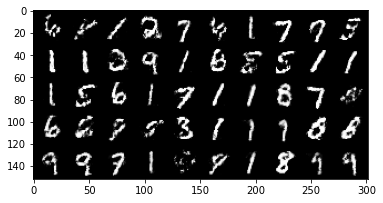

Iter: 76610/100000, Gen loss: 1.1215, Dis loss: 1.1674
Iter: 76620/100000, Gen loss: 1.0883, Dis loss: 1.1054
Iter: 76630/100000, Gen loss: 1.1444, Dis loss: 0.8132
Iter: 76640/100000, Gen loss: 1.2481, Dis loss: 0.9831
Iter: 76650/100000, Gen loss: 1.4314, Dis loss: 0.7636
Iter: 76660/100000, Gen loss: 1.5875, Dis loss: 0.8505
Iter: 76670/100000, Gen loss: 1.6186, Dis loss: 0.7371
Iter: 76680/100000, Gen loss: 1.7515, Dis loss: 1.0237
Iter: 76690/100000, Gen loss: 1.3125, Dis loss: 1.0457
Iter: 76700/100000, Gen loss: 1.1573, Dis loss: 0.8933
Iter: 76710/100000, Gen loss: 1.4303, Dis loss: 0.8880
Iter: 76720/100000, Gen loss: 1.5827, Dis loss: 0.8977
Iter: 76730/100000, Gen loss: 1.5353, Dis loss: 0.9155
Iter: 76740/100000, Gen loss: 1.7775, Dis loss: 0.9010
Iter: 76750/100000, Gen loss: 1.3426, Dis loss: 0.8520
Iter: 76760/100000, Gen loss: 1.7407, Dis loss: 1.0045
Iter: 76770/100000, Gen loss: 1.2740, Dis loss: 0.8897
Iter: 76780/100000, Gen loss: 1.3678, Dis loss: 1.0906
Iter: 7679

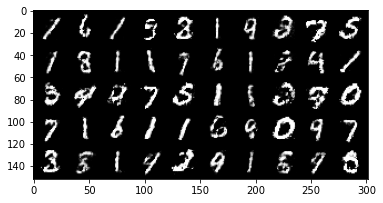

Iter: 76810/100000, Gen loss: 1.3071, Dis loss: 0.7791
Iter: 76820/100000, Gen loss: 1.2890, Dis loss: 0.8283
Iter: 76830/100000, Gen loss: 1.3335, Dis loss: 0.7395
Iter: 76840/100000, Gen loss: 1.2034, Dis loss: 0.7095
Iter: 76850/100000, Gen loss: 1.2816, Dis loss: 0.9195
Iter: 76860/100000, Gen loss: 1.3975, Dis loss: 0.9520
Iter: 76870/100000, Gen loss: 1.2138, Dis loss: 0.9066
Iter: 76880/100000, Gen loss: 1.4475, Dis loss: 0.7463
Iter: 76890/100000, Gen loss: 1.6405, Dis loss: 0.8101
Iter: 76900/100000, Gen loss: 1.5237, Dis loss: 0.7715
Iter: 76910/100000, Gen loss: 1.1883, Dis loss: 0.9911
Iter: 76920/100000, Gen loss: 1.2640, Dis loss: 0.7508
Iter: 76930/100000, Gen loss: 1.3507, Dis loss: 0.7532
Iter: 76940/100000, Gen loss: 1.8794, Dis loss: 0.8502
Iter: 76950/100000, Gen loss: 1.4901, Dis loss: 1.1613
Iter: 76960/100000, Gen loss: 1.3243, Dis loss: 0.8356
Iter: 76970/100000, Gen loss: 1.2736, Dis loss: 0.9990
Iter: 76980/100000, Gen loss: 1.3278, Dis loss: 0.8540
Iter: 7699

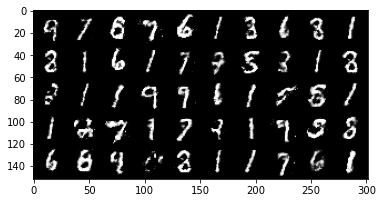

Iter: 77010/100000, Gen loss: 1.4669, Dis loss: 0.7818
Iter: 77020/100000, Gen loss: 1.4086, Dis loss: 0.8194
Iter: 77030/100000, Gen loss: 1.3015, Dis loss: 0.8536
Iter: 77040/100000, Gen loss: 1.5810, Dis loss: 0.8083
Iter: 77050/100000, Gen loss: 1.2643, Dis loss: 0.9473
Iter: 77060/100000, Gen loss: 1.3179, Dis loss: 0.8210
Iter: 77070/100000, Gen loss: 1.8542, Dis loss: 0.7135
Iter: 77080/100000, Gen loss: 1.6476, Dis loss: 0.9973
Iter: 77090/100000, Gen loss: 1.7028, Dis loss: 0.9102
Iter: 77100/100000, Gen loss: 1.8195, Dis loss: 0.9403
Iter: 77110/100000, Gen loss: 1.6889, Dis loss: 1.0003
Iter: 77120/100000, Gen loss: 1.5278, Dis loss: 0.7270
Iter: 77130/100000, Gen loss: 1.4710, Dis loss: 0.7316
Iter: 77140/100000, Gen loss: 1.3800, Dis loss: 0.8191
Iter: 77150/100000, Gen loss: 1.5760, Dis loss: 0.6845
Iter: 77160/100000, Gen loss: 1.6923, Dis loss: 0.9272
Iter: 77170/100000, Gen loss: 1.5681, Dis loss: 0.8071
Iter: 77180/100000, Gen loss: 1.6986, Dis loss: 0.7941
Iter: 7719

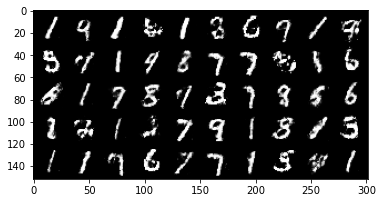

Iter: 77210/100000, Gen loss: 1.1990, Dis loss: 0.7693
Iter: 77220/100000, Gen loss: 1.4136, Dis loss: 0.7025
Iter: 77230/100000, Gen loss: 1.4338, Dis loss: 0.7937
Iter: 77240/100000, Gen loss: 1.4190, Dis loss: 0.8484
Iter: 77250/100000, Gen loss: 1.9118, Dis loss: 0.9873
Iter: 77260/100000, Gen loss: 1.6003, Dis loss: 0.7699
Iter: 77270/100000, Gen loss: 1.5820, Dis loss: 0.8681
Iter: 77280/100000, Gen loss: 1.5034, Dis loss: 0.7394
Iter: 77290/100000, Gen loss: 1.7275, Dis loss: 0.8927
Iter: 77300/100000, Gen loss: 1.5354, Dis loss: 0.8258
Iter: 77310/100000, Gen loss: 1.2275, Dis loss: 0.9578
Iter: 77320/100000, Gen loss: 0.9432, Dis loss: 1.0008
Iter: 77330/100000, Gen loss: 1.1729, Dis loss: 0.9125
Iter: 77340/100000, Gen loss: 1.3682, Dis loss: 0.6891
Iter: 77350/100000, Gen loss: 1.5097, Dis loss: 0.9545
Iter: 77360/100000, Gen loss: 1.4794, Dis loss: 0.8790
Iter: 77370/100000, Gen loss: 1.4335, Dis loss: 0.8885
Iter: 77380/100000, Gen loss: 1.3662, Dis loss: 0.9594
Iter: 7739

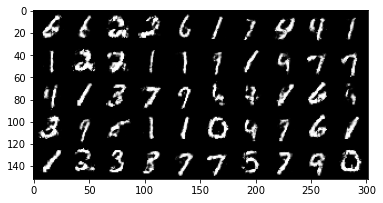

Iter: 77410/100000, Gen loss: 1.4733, Dis loss: 0.7027
Iter: 77420/100000, Gen loss: 1.4311, Dis loss: 0.7617
Iter: 77430/100000, Gen loss: 1.4108, Dis loss: 0.7477
Iter: 77440/100000, Gen loss: 1.3358, Dis loss: 0.8174
Iter: 77450/100000, Gen loss: 1.3018, Dis loss: 0.9164
Iter: 77460/100000, Gen loss: 1.5629, Dis loss: 0.9474
Iter: 77470/100000, Gen loss: 1.3535, Dis loss: 1.0012
Iter: 77480/100000, Gen loss: 1.6473, Dis loss: 0.9082
Iter: 77490/100000, Gen loss: 1.6071, Dis loss: 0.8671
Iter: 77500/100000, Gen loss: 1.2191, Dis loss: 1.1234
Iter: 77510/100000, Gen loss: 1.0474, Dis loss: 0.7225
Iter: 77520/100000, Gen loss: 1.4658, Dis loss: 1.0108
Iter: 77530/100000, Gen loss: 1.7295, Dis loss: 0.8340
Iter: 77540/100000, Gen loss: 1.3151, Dis loss: 0.7689
Iter: 77550/100000, Gen loss: 1.4956, Dis loss: 0.9512
Iter: 77560/100000, Gen loss: 1.3872, Dis loss: 0.8808
Iter: 77570/100000, Gen loss: 1.5761, Dis loss: 0.8765
Iter: 77580/100000, Gen loss: 1.5685, Dis loss: 0.9195
Iter: 7759

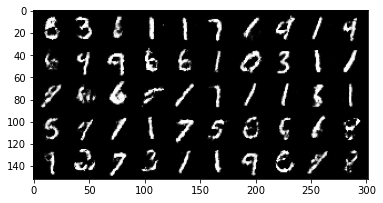

Iter: 77610/100000, Gen loss: 1.5297, Dis loss: 0.7725
Iter: 77620/100000, Gen loss: 1.6408, Dis loss: 1.2165
Iter: 77630/100000, Gen loss: 1.6607, Dis loss: 0.7114
Iter: 77640/100000, Gen loss: 1.1934, Dis loss: 0.9936
Iter: 77650/100000, Gen loss: 1.4983, Dis loss: 0.9595
Iter: 77660/100000, Gen loss: 1.7517, Dis loss: 0.8929
Iter: 77670/100000, Gen loss: 1.6542, Dis loss: 0.6881
Iter: 77680/100000, Gen loss: 1.3605, Dis loss: 0.7652
Iter: 77690/100000, Gen loss: 1.4278, Dis loss: 0.8141
Iter: 77700/100000, Gen loss: 1.2435, Dis loss: 0.9711
Iter: 77710/100000, Gen loss: 1.2643, Dis loss: 0.9121
Iter: 77720/100000, Gen loss: 1.1752, Dis loss: 0.6191
Iter: 77730/100000, Gen loss: 1.5932, Dis loss: 0.9370
Iter: 77740/100000, Gen loss: 1.7221, Dis loss: 0.9499
Iter: 77750/100000, Gen loss: 1.5372, Dis loss: 1.0052
Iter: 77760/100000, Gen loss: 1.4524, Dis loss: 0.7758
Iter: 77770/100000, Gen loss: 1.5082, Dis loss: 0.8820
Iter: 77780/100000, Gen loss: 1.3460, Dis loss: 1.0877
Iter: 7779

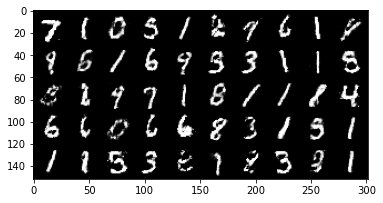

Iter: 77810/100000, Gen loss: 1.1839, Dis loss: 0.9307
Iter: 77820/100000, Gen loss: 1.5581, Dis loss: 0.9905
Iter: 77830/100000, Gen loss: 1.4928, Dis loss: 0.9064
Iter: 77840/100000, Gen loss: 1.5354, Dis loss: 0.8774
Iter: 77850/100000, Gen loss: 1.4886, Dis loss: 1.0404
Iter: 77860/100000, Gen loss: 1.2932, Dis loss: 0.9785
Iter: 77870/100000, Gen loss: 1.2114, Dis loss: 0.9563
Iter: 77880/100000, Gen loss: 1.1085, Dis loss: 1.0695
Iter: 77890/100000, Gen loss: 1.4083, Dis loss: 0.6597
Iter: 77900/100000, Gen loss: 1.4853, Dis loss: 0.9535
Iter: 77910/100000, Gen loss: 1.7595, Dis loss: 0.6557
Iter: 77920/100000, Gen loss: 1.6747, Dis loss: 0.9749
Iter: 77930/100000, Gen loss: 1.6775, Dis loss: 0.9755
Iter: 77940/100000, Gen loss: 1.5036, Dis loss: 0.9890
Iter: 77950/100000, Gen loss: 1.2880, Dis loss: 0.9689
Iter: 77960/100000, Gen loss: 1.0605, Dis loss: 0.9820
Iter: 77970/100000, Gen loss: 1.0514, Dis loss: 1.0727
Iter: 77980/100000, Gen loss: 1.1091, Dis loss: 0.7601
Iter: 7799

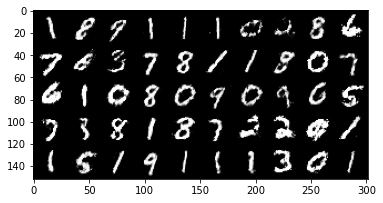

Iter: 78010/100000, Gen loss: 1.4504, Dis loss: 0.8609
Iter: 78020/100000, Gen loss: 1.4254, Dis loss: 1.0405
Iter: 78030/100000, Gen loss: 1.6518, Dis loss: 0.7923
Iter: 78040/100000, Gen loss: 1.6740, Dis loss: 1.0712
Iter: 78050/100000, Gen loss: 1.5210, Dis loss: 0.7721
Iter: 78060/100000, Gen loss: 1.5204, Dis loss: 0.7918
Iter: 78070/100000, Gen loss: 1.5658, Dis loss: 0.8154
Iter: 78080/100000, Gen loss: 1.3085, Dis loss: 1.0710
Iter: 78090/100000, Gen loss: 1.2867, Dis loss: 1.0299
Iter: 78100/100000, Gen loss: 1.5063, Dis loss: 0.9862
Iter: 78110/100000, Gen loss: 1.1197, Dis loss: 0.9992
Iter: 78120/100000, Gen loss: 1.1919, Dis loss: 0.9804
Iter: 78130/100000, Gen loss: 1.5838, Dis loss: 0.9926
Iter: 78140/100000, Gen loss: 1.3685, Dis loss: 0.8978
Iter: 78150/100000, Gen loss: 1.4391, Dis loss: 0.9172
Iter: 78160/100000, Gen loss: 1.2126, Dis loss: 0.8170
Iter: 78170/100000, Gen loss: 1.2961, Dis loss: 0.8188
Iter: 78180/100000, Gen loss: 1.1222, Dis loss: 0.7089
Iter: 7819

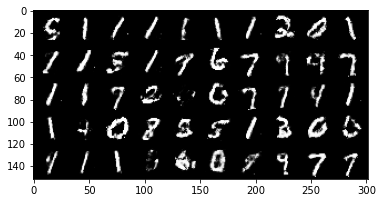

Iter: 78210/100000, Gen loss: 1.4535, Dis loss: 0.8619
Iter: 78220/100000, Gen loss: 1.7201, Dis loss: 1.1324
Iter: 78230/100000, Gen loss: 1.4951, Dis loss: 0.7181
Iter: 78240/100000, Gen loss: 1.5691, Dis loss: 0.8709
Iter: 78250/100000, Gen loss: 1.3873, Dis loss: 1.0518
Iter: 78260/100000, Gen loss: 1.4809, Dis loss: 0.7975
Iter: 78270/100000, Gen loss: 1.4881, Dis loss: 0.9917
Iter: 78280/100000, Gen loss: 1.3964, Dis loss: 0.5991
Iter: 78290/100000, Gen loss: 1.3690, Dis loss: 0.8533
Iter: 78300/100000, Gen loss: 1.4661, Dis loss: 0.9449
Iter: 78310/100000, Gen loss: 1.3910, Dis loss: 0.9606
Iter: 78320/100000, Gen loss: 1.2498, Dis loss: 0.7767
Iter: 78330/100000, Gen loss: 1.3930, Dis loss: 0.9082
Iter: 78340/100000, Gen loss: 1.6701, Dis loss: 0.8330
Iter: 78350/100000, Gen loss: 1.4190, Dis loss: 0.7435
Iter: 78360/100000, Gen loss: 1.4891, Dis loss: 0.6130
Iter: 78370/100000, Gen loss: 1.5780, Dis loss: 0.9924
Iter: 78380/100000, Gen loss: 1.6831, Dis loss: 0.8720
Iter: 7839

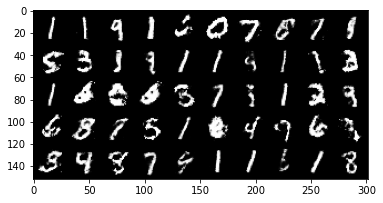

Iter: 78410/100000, Gen loss: 1.2227, Dis loss: 0.9775
Iter: 78420/100000, Gen loss: 1.1115, Dis loss: 0.8087
Iter: 78430/100000, Gen loss: 1.3667, Dis loss: 0.8846
Iter: 78440/100000, Gen loss: 1.3630, Dis loss: 1.0145
Iter: 78450/100000, Gen loss: 1.4233, Dis loss: 0.9212
Iter: 78460/100000, Gen loss: 1.2789, Dis loss: 0.9726
Iter: 78470/100000, Gen loss: 1.3814, Dis loss: 0.8319
Iter: 78480/100000, Gen loss: 1.4697, Dis loss: 0.8591
Iter: 78490/100000, Gen loss: 1.2562, Dis loss: 0.8015
Iter: 78500/100000, Gen loss: 1.3918, Dis loss: 0.9489
Iter: 78510/100000, Gen loss: 1.2030, Dis loss: 1.0665
Iter: 78520/100000, Gen loss: 1.4332, Dis loss: 1.1074
Iter: 78530/100000, Gen loss: 1.5011, Dis loss: 0.7873
Iter: 78540/100000, Gen loss: 1.0470, Dis loss: 1.1049
Iter: 78550/100000, Gen loss: 1.3734, Dis loss: 0.9528
Iter: 78560/100000, Gen loss: 1.4221, Dis loss: 0.8516
Iter: 78570/100000, Gen loss: 1.5439, Dis loss: 0.9191
Iter: 78580/100000, Gen loss: 1.3170, Dis loss: 1.0161
Iter: 7859

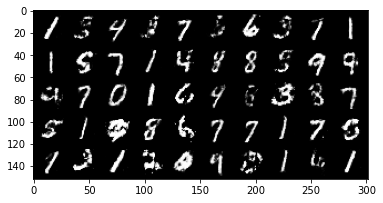

Iter: 78610/100000, Gen loss: 1.3888, Dis loss: 0.9019
Iter: 78620/100000, Gen loss: 1.1591, Dis loss: 0.9690
Iter: 78630/100000, Gen loss: 1.2876, Dis loss: 0.8016
Iter: 78640/100000, Gen loss: 1.1866, Dis loss: 0.7767
Iter: 78650/100000, Gen loss: 1.2019, Dis loss: 1.3592
Iter: 78660/100000, Gen loss: 1.2639, Dis loss: 0.9522
Iter: 78670/100000, Gen loss: 1.8229, Dis loss: 0.5888
Iter: 78680/100000, Gen loss: 1.6612, Dis loss: 0.9010
Iter: 78690/100000, Gen loss: 1.6071, Dis loss: 0.5951
Iter: 78700/100000, Gen loss: 1.3571, Dis loss: 0.6913
Iter: 78710/100000, Gen loss: 1.2658, Dis loss: 0.8026
Iter: 78720/100000, Gen loss: 1.2027, Dis loss: 0.9988
Iter: 78730/100000, Gen loss: 1.1990, Dis loss: 0.8098
Iter: 78740/100000, Gen loss: 1.1031, Dis loss: 0.9894
Iter: 78750/100000, Gen loss: 1.0263, Dis loss: 0.7369
Iter: 78760/100000, Gen loss: 1.4451, Dis loss: 0.8851
Iter: 78770/100000, Gen loss: 1.3000, Dis loss: 0.9202
Iter: 78780/100000, Gen loss: 1.3446, Dis loss: 0.9539
Iter: 7879

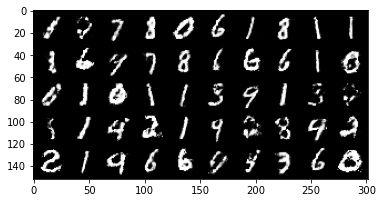

Iter: 78810/100000, Gen loss: 1.3723, Dis loss: 0.8845
Iter: 78820/100000, Gen loss: 1.5913, Dis loss: 0.6546
Iter: 78830/100000, Gen loss: 1.4283, Dis loss: 0.9005
Iter: 78840/100000, Gen loss: 1.2988, Dis loss: 0.8792
Iter: 78850/100000, Gen loss: 1.1780, Dis loss: 0.9283
Iter: 78860/100000, Gen loss: 0.8550, Dis loss: 0.9705
Iter: 78870/100000, Gen loss: 1.3318, Dis loss: 0.9040
Iter: 78880/100000, Gen loss: 1.3499, Dis loss: 1.0392
Iter: 78890/100000, Gen loss: 1.1775, Dis loss: 0.8104
Iter: 78900/100000, Gen loss: 1.2449, Dis loss: 0.6419
Iter: 78910/100000, Gen loss: 1.3253, Dis loss: 1.1509
Iter: 78920/100000, Gen loss: 1.3194, Dis loss: 0.9688
Iter: 78930/100000, Gen loss: 1.2761, Dis loss: 1.2116
Iter: 78940/100000, Gen loss: 1.2044, Dis loss: 0.9225
Iter: 78950/100000, Gen loss: 1.5611, Dis loss: 0.9965
Iter: 78960/100000, Gen loss: 1.2994, Dis loss: 0.8505
Iter: 78970/100000, Gen loss: 1.3429, Dis loss: 0.9901
Iter: 78980/100000, Gen loss: 1.1094, Dis loss: 1.1647
Iter: 7899

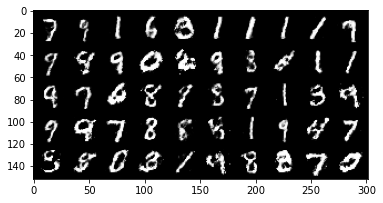

Iter: 79010/100000, Gen loss: 1.3777, Dis loss: 0.9808
Iter: 79020/100000, Gen loss: 1.5121, Dis loss: 0.9437
Iter: 79030/100000, Gen loss: 1.1210, Dis loss: 0.8501
Iter: 79040/100000, Gen loss: 1.2659, Dis loss: 0.8054
Iter: 79050/100000, Gen loss: 1.2355, Dis loss: 0.9832
Iter: 79060/100000, Gen loss: 1.1880, Dis loss: 0.9969
Iter: 79070/100000, Gen loss: 1.1474, Dis loss: 0.7903
Iter: 79080/100000, Gen loss: 1.1633, Dis loss: 1.0324
Iter: 79090/100000, Gen loss: 1.3667, Dis loss: 0.7334
Iter: 79100/100000, Gen loss: 1.0028, Dis loss: 1.0116
Iter: 79110/100000, Gen loss: 1.3641, Dis loss: 0.6676
Iter: 79120/100000, Gen loss: 1.1646, Dis loss: 0.6996
Iter: 79130/100000, Gen loss: 1.3960, Dis loss: 0.9185
Iter: 79140/100000, Gen loss: 1.3661, Dis loss: 0.9573
Iter: 79150/100000, Gen loss: 1.4098, Dis loss: 0.8749
Iter: 79160/100000, Gen loss: 1.5204, Dis loss: 0.7948
Iter: 79170/100000, Gen loss: 1.6416, Dis loss: 0.7473
Iter: 79180/100000, Gen loss: 1.3200, Dis loss: 0.7547
Iter: 7919

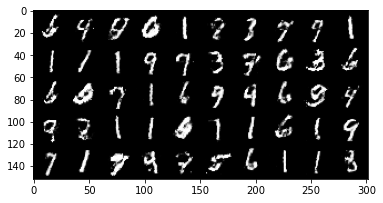

Iter: 79210/100000, Gen loss: 1.5199, Dis loss: 1.0707
Iter: 79220/100000, Gen loss: 1.4124, Dis loss: 0.7144
Iter: 79230/100000, Gen loss: 1.3977, Dis loss: 0.6785
Iter: 79240/100000, Gen loss: 1.2554, Dis loss: 0.9595
Iter: 79250/100000, Gen loss: 1.3179, Dis loss: 1.0371
Iter: 79260/100000, Gen loss: 1.2479, Dis loss: 0.9817
Iter: 79270/100000, Gen loss: 1.3128, Dis loss: 1.0709
Iter: 79280/100000, Gen loss: 1.4042, Dis loss: 1.0460
Iter: 79290/100000, Gen loss: 1.4260, Dis loss: 0.8222
Iter: 79300/100000, Gen loss: 1.3571, Dis loss: 0.8955
Iter: 79310/100000, Gen loss: 1.2023, Dis loss: 0.8914
Iter: 79320/100000, Gen loss: 1.0990, Dis loss: 1.1403
Iter: 79330/100000, Gen loss: 1.1149, Dis loss: 0.8630
Iter: 79340/100000, Gen loss: 1.4028, Dis loss: 1.0329
Iter: 79350/100000, Gen loss: 1.4177, Dis loss: 0.7896
Iter: 79360/100000, Gen loss: 1.2059, Dis loss: 0.7214
Iter: 79370/100000, Gen loss: 1.3287, Dis loss: 0.8255
Iter: 79380/100000, Gen loss: 1.4244, Dis loss: 0.7935
Iter: 7939

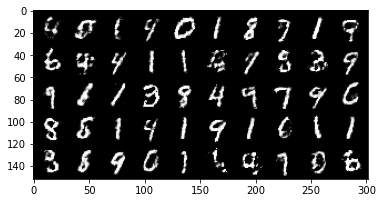

Iter: 79410/100000, Gen loss: 1.4636, Dis loss: 0.6537
Iter: 79420/100000, Gen loss: 1.5724, Dis loss: 0.9325
Iter: 79430/100000, Gen loss: 1.5651, Dis loss: 0.7493
Iter: 79440/100000, Gen loss: 1.3100, Dis loss: 0.8943
Iter: 79450/100000, Gen loss: 1.4582, Dis loss: 1.2476
Iter: 79460/100000, Gen loss: 1.2563, Dis loss: 0.7529
Iter: 79470/100000, Gen loss: 1.5802, Dis loss: 0.8721
Iter: 79480/100000, Gen loss: 1.5704, Dis loss: 0.7306
Iter: 79490/100000, Gen loss: 1.6255, Dis loss: 1.0826
Iter: 79500/100000, Gen loss: 1.3725, Dis loss: 1.0515
Iter: 79510/100000, Gen loss: 1.4468, Dis loss: 0.9684
Iter: 79520/100000, Gen loss: 1.5850, Dis loss: 1.0613
Iter: 79530/100000, Gen loss: 1.6608, Dis loss: 0.8124
Iter: 79540/100000, Gen loss: 1.5179, Dis loss: 1.3013
Iter: 79550/100000, Gen loss: 1.2725, Dis loss: 0.8226
Iter: 79560/100000, Gen loss: 1.5756, Dis loss: 0.9252
Iter: 79570/100000, Gen loss: 1.7940, Dis loss: 0.9387
Iter: 79580/100000, Gen loss: 1.4045, Dis loss: 0.9011
Iter: 7959

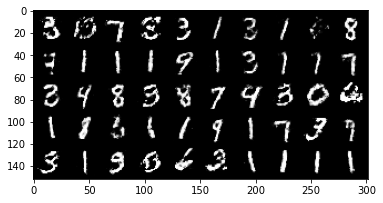

Iter: 79610/100000, Gen loss: 1.2284, Dis loss: 0.9258
Iter: 79620/100000, Gen loss: 1.7473, Dis loss: 0.8517
Iter: 79630/100000, Gen loss: 1.6544, Dis loss: 0.8603
Iter: 79640/100000, Gen loss: 1.5616, Dis loss: 0.8507
Iter: 79650/100000, Gen loss: 1.4491, Dis loss: 1.0880
Iter: 79660/100000, Gen loss: 1.1892, Dis loss: 0.9467
Iter: 79670/100000, Gen loss: 1.4417, Dis loss: 0.8450
Iter: 79680/100000, Gen loss: 1.4010, Dis loss: 0.9011
Iter: 79690/100000, Gen loss: 1.3738, Dis loss: 1.1847
Iter: 79700/100000, Gen loss: 1.4497, Dis loss: 0.9978
Iter: 79710/100000, Gen loss: 1.3458, Dis loss: 0.9100
Iter: 79720/100000, Gen loss: 1.3175, Dis loss: 0.7947
Iter: 79730/100000, Gen loss: 1.1336, Dis loss: 0.8758
Iter: 79740/100000, Gen loss: 1.6560, Dis loss: 0.7237
Iter: 79750/100000, Gen loss: 1.4458, Dis loss: 0.8485
Iter: 79760/100000, Gen loss: 1.4272, Dis loss: 0.7624
Iter: 79770/100000, Gen loss: 1.4907, Dis loss: 1.1619
Iter: 79780/100000, Gen loss: 1.7686, Dis loss: 0.7589
Iter: 7979

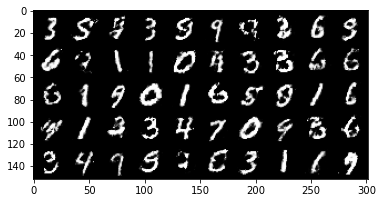

Iter: 79810/100000, Gen loss: 1.2144, Dis loss: 0.9300
Iter: 79820/100000, Gen loss: 1.0304, Dis loss: 1.0961
Iter: 79830/100000, Gen loss: 1.5650, Dis loss: 0.7128
Iter: 79840/100000, Gen loss: 1.4109, Dis loss: 0.8225
Iter: 79850/100000, Gen loss: 1.3572, Dis loss: 1.0238
Iter: 79860/100000, Gen loss: 1.6325, Dis loss: 0.8198
Iter: 79870/100000, Gen loss: 1.5501, Dis loss: 0.9374
Iter: 79880/100000, Gen loss: 1.5269, Dis loss: 0.8710
Iter: 79890/100000, Gen loss: 1.2454, Dis loss: 0.8156
Iter: 79900/100000, Gen loss: 1.1698, Dis loss: 0.9556
Iter: 79910/100000, Gen loss: 1.2403, Dis loss: 0.8354
Iter: 79920/100000, Gen loss: 1.3252, Dis loss: 1.0287
Iter: 79930/100000, Gen loss: 1.2323, Dis loss: 0.6662
Iter: 79940/100000, Gen loss: 1.4823, Dis loss: 0.8330
Iter: 79950/100000, Gen loss: 1.5759, Dis loss: 0.8220
Iter: 79960/100000, Gen loss: 1.4447, Dis loss: 0.9110
Iter: 79970/100000, Gen loss: 1.4662, Dis loss: 0.9650
Iter: 79980/100000, Gen loss: 1.3572, Dis loss: 0.8799
Iter: 7999

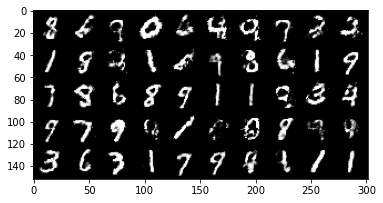

Iter: 80010/100000, Gen loss: 1.4470, Dis loss: 1.0481
Iter: 80020/100000, Gen loss: 1.8422, Dis loss: 1.0733
Iter: 80030/100000, Gen loss: 1.4519, Dis loss: 0.8980
Iter: 80040/100000, Gen loss: 1.5574, Dis loss: 0.8414
Iter: 80050/100000, Gen loss: 1.4539, Dis loss: 0.9719
Iter: 80060/100000, Gen loss: 1.4006, Dis loss: 0.9803
Iter: 80070/100000, Gen loss: 1.2859, Dis loss: 0.9368
Iter: 80080/100000, Gen loss: 1.3989, Dis loss: 1.1605
Iter: 80090/100000, Gen loss: 1.3552, Dis loss: 0.7858
Iter: 80100/100000, Gen loss: 1.4286, Dis loss: 0.9109
Iter: 80110/100000, Gen loss: 1.7404, Dis loss: 0.7513
Iter: 80120/100000, Gen loss: 1.6886, Dis loss: 0.7526
Iter: 80130/100000, Gen loss: 1.6055, Dis loss: 0.8765
Iter: 80140/100000, Gen loss: 1.5285, Dis loss: 0.9381
Iter: 80150/100000, Gen loss: 1.3255, Dis loss: 0.9534
Iter: 80160/100000, Gen loss: 1.3944, Dis loss: 0.7647
Iter: 80170/100000, Gen loss: 1.6610, Dis loss: 0.8980
Iter: 80180/100000, Gen loss: 1.7952, Dis loss: 0.8505
Iter: 8019

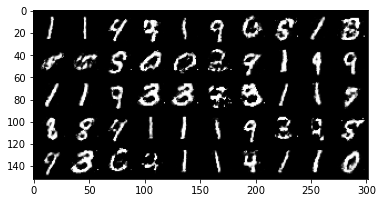

Iter: 80210/100000, Gen loss: 1.4483, Dis loss: 0.8100
Iter: 80220/100000, Gen loss: 1.5836, Dis loss: 0.6744
Iter: 80230/100000, Gen loss: 1.3793, Dis loss: 0.5985
Iter: 80240/100000, Gen loss: 1.2197, Dis loss: 0.6968
Iter: 80250/100000, Gen loss: 1.5467, Dis loss: 0.7231
Iter: 80260/100000, Gen loss: 1.2618, Dis loss: 1.0126
Iter: 80270/100000, Gen loss: 1.4842, Dis loss: 0.9324
Iter: 80280/100000, Gen loss: 1.2057, Dis loss: 0.8790
Iter: 80290/100000, Gen loss: 1.2912, Dis loss: 1.1558
Iter: 80300/100000, Gen loss: 1.1830, Dis loss: 1.0876
Iter: 80310/100000, Gen loss: 1.2349, Dis loss: 0.9247
Iter: 80320/100000, Gen loss: 1.6223, Dis loss: 0.9037
Iter: 80330/100000, Gen loss: 1.5327, Dis loss: 0.6861
Iter: 80340/100000, Gen loss: 1.3439, Dis loss: 0.7776
Iter: 80350/100000, Gen loss: 1.5589, Dis loss: 0.7337
Iter: 80360/100000, Gen loss: 1.3905, Dis loss: 0.8860
Iter: 80370/100000, Gen loss: 1.7235, Dis loss: 0.7036
Iter: 80380/100000, Gen loss: 1.5104, Dis loss: 0.8242
Iter: 8039

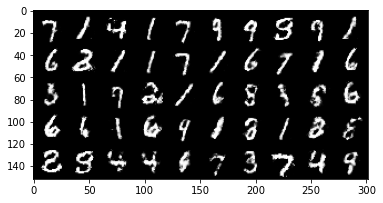

Iter: 80410/100000, Gen loss: 1.3134, Dis loss: 1.1146
Iter: 80420/100000, Gen loss: 1.4304, Dis loss: 1.0070
Iter: 80430/100000, Gen loss: 1.4092, Dis loss: 1.0292
Iter: 80440/100000, Gen loss: 1.4890, Dis loss: 1.0590
Iter: 80450/100000, Gen loss: 1.4738, Dis loss: 0.8224
Iter: 80460/100000, Gen loss: 1.2474, Dis loss: 0.8131
Iter: 80470/100000, Gen loss: 1.2285, Dis loss: 1.0333
Iter: 80480/100000, Gen loss: 1.3897, Dis loss: 0.7999
Iter: 80490/100000, Gen loss: 1.1824, Dis loss: 0.7592
Iter: 80500/100000, Gen loss: 1.1951, Dis loss: 0.8810
Iter: 80510/100000, Gen loss: 1.5990, Dis loss: 1.1269
Iter: 80520/100000, Gen loss: 1.5966, Dis loss: 1.0286
Iter: 80530/100000, Gen loss: 1.1354, Dis loss: 1.0643
Iter: 80540/100000, Gen loss: 1.5458, Dis loss: 0.9122
Iter: 80550/100000, Gen loss: 1.3575, Dis loss: 0.7720
Iter: 80560/100000, Gen loss: 1.3200, Dis loss: 0.7446
Iter: 80570/100000, Gen loss: 1.2316, Dis loss: 0.8401
Iter: 80580/100000, Gen loss: 1.3315, Dis loss: 0.7682
Iter: 8059

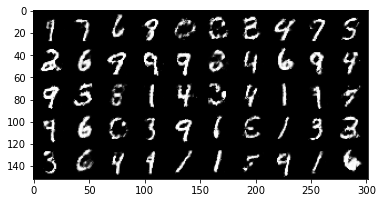

Iter: 80610/100000, Gen loss: 1.3307, Dis loss: 0.9011
Iter: 80620/100000, Gen loss: 1.3717, Dis loss: 1.0535
Iter: 80630/100000, Gen loss: 1.5768, Dis loss: 0.9881
Iter: 80640/100000, Gen loss: 1.5477, Dis loss: 0.9804
Iter: 80650/100000, Gen loss: 1.2394, Dis loss: 0.9723
Iter: 80660/100000, Gen loss: 1.3647, Dis loss: 0.8756
Iter: 80670/100000, Gen loss: 1.1241, Dis loss: 1.0202
Iter: 80680/100000, Gen loss: 1.0555, Dis loss: 0.9818
Iter: 80690/100000, Gen loss: 1.2872, Dis loss: 0.8581
Iter: 80700/100000, Gen loss: 1.1552, Dis loss: 0.7984
Iter: 80710/100000, Gen loss: 1.5161, Dis loss: 0.7512
Iter: 80720/100000, Gen loss: 1.6879, Dis loss: 1.0740
Iter: 80730/100000, Gen loss: 1.7224, Dis loss: 1.0472
Iter: 80740/100000, Gen loss: 1.5193, Dis loss: 0.9704
Iter: 80750/100000, Gen loss: 1.1166, Dis loss: 1.0275
Iter: 80760/100000, Gen loss: 1.2492, Dis loss: 1.0380
Iter: 80770/100000, Gen loss: 1.1852, Dis loss: 0.8929
Iter: 80780/100000, Gen loss: 1.2494, Dis loss: 0.9564
Iter: 8079

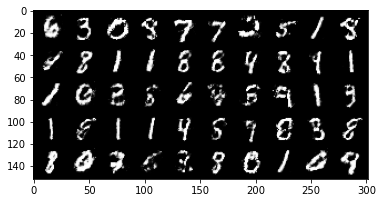

Iter: 80810/100000, Gen loss: 1.3932, Dis loss: 0.6757
Iter: 80820/100000, Gen loss: 1.3141, Dis loss: 0.9722
Iter: 80830/100000, Gen loss: 1.2395, Dis loss: 0.8885
Iter: 80840/100000, Gen loss: 1.2922, Dis loss: 0.9704
Iter: 80850/100000, Gen loss: 1.1112, Dis loss: 0.6991
Iter: 80860/100000, Gen loss: 1.3101, Dis loss: 1.0026
Iter: 80870/100000, Gen loss: 1.8049, Dis loss: 0.9532
Iter: 80880/100000, Gen loss: 1.8140, Dis loss: 0.8245
Iter: 80890/100000, Gen loss: 1.6353, Dis loss: 0.8364
Iter: 80900/100000, Gen loss: 1.5754, Dis loss: 0.8226
Iter: 80910/100000, Gen loss: 1.2118, Dis loss: 0.8403
Iter: 80920/100000, Gen loss: 1.0150, Dis loss: 0.9295
Iter: 80930/100000, Gen loss: 1.2833, Dis loss: 0.9914
Iter: 80940/100000, Gen loss: 1.5190, Dis loss: 0.8779
Iter: 80950/100000, Gen loss: 1.6947, Dis loss: 1.0368
Iter: 80960/100000, Gen loss: 1.5206, Dis loss: 0.9974
Iter: 80970/100000, Gen loss: 1.2541, Dis loss: 0.9823
Iter: 80980/100000, Gen loss: 1.4975, Dis loss: 0.9092
Iter: 8099

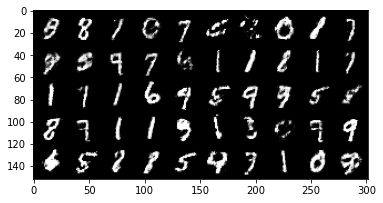

Iter: 81010/100000, Gen loss: 1.6235, Dis loss: 0.8914
Iter: 81020/100000, Gen loss: 1.3762, Dis loss: 0.8861
Iter: 81030/100000, Gen loss: 1.6668, Dis loss: 0.9895
Iter: 81040/100000, Gen loss: 1.2768, Dis loss: 0.7550
Iter: 81050/100000, Gen loss: 1.4289, Dis loss: 0.9502
Iter: 81060/100000, Gen loss: 1.3613, Dis loss: 0.9132
Iter: 81070/100000, Gen loss: 1.4008, Dis loss: 0.8976
Iter: 81080/100000, Gen loss: 1.2633, Dis loss: 1.1116
Iter: 81090/100000, Gen loss: 1.0663, Dis loss: 0.9148
Iter: 81100/100000, Gen loss: 0.9705, Dis loss: 1.1494
Iter: 81110/100000, Gen loss: 1.1194, Dis loss: 0.9565
Iter: 81120/100000, Gen loss: 1.2048, Dis loss: 1.0441
Iter: 81130/100000, Gen loss: 1.1030, Dis loss: 0.9437
Iter: 81140/100000, Gen loss: 1.1800, Dis loss: 0.9622
Iter: 81150/100000, Gen loss: 1.4476, Dis loss: 0.7432
Iter: 81160/100000, Gen loss: 1.8552, Dis loss: 0.8888
Iter: 81170/100000, Gen loss: 1.5463, Dis loss: 0.8449
Iter: 81180/100000, Gen loss: 1.1129, Dis loss: 1.0035
Iter: 8119

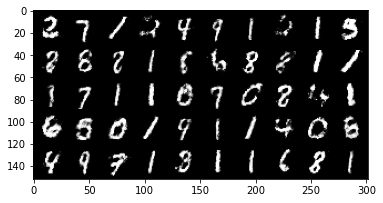

Iter: 81210/100000, Gen loss: 1.1892, Dis loss: 1.0891
Iter: 81220/100000, Gen loss: 1.4838, Dis loss: 0.9959
Iter: 81230/100000, Gen loss: 1.3048, Dis loss: 1.0485
Iter: 81240/100000, Gen loss: 1.4990, Dis loss: 0.9142
Iter: 81250/100000, Gen loss: 1.4658, Dis loss: 0.7901
Iter: 81260/100000, Gen loss: 1.1448, Dis loss: 0.7340
Iter: 81270/100000, Gen loss: 1.3210, Dis loss: 0.7361
Iter: 81280/100000, Gen loss: 1.5102, Dis loss: 0.9601
Iter: 81290/100000, Gen loss: 1.8178, Dis loss: 0.8649
Iter: 81300/100000, Gen loss: 1.5980, Dis loss: 0.9370
Iter: 81310/100000, Gen loss: 1.3381, Dis loss: 0.9506
Iter: 81320/100000, Gen loss: 1.3076, Dis loss: 1.1246
Iter: 81330/100000, Gen loss: 1.0743, Dis loss: 0.8628
Iter: 81340/100000, Gen loss: 1.3109, Dis loss: 0.8511
Iter: 81350/100000, Gen loss: 1.3659, Dis loss: 0.9839
Iter: 81360/100000, Gen loss: 1.0675, Dis loss: 0.9168
Iter: 81370/100000, Gen loss: 1.6303, Dis loss: 0.7128
Iter: 81380/100000, Gen loss: 1.4834, Dis loss: 0.8045
Iter: 8139

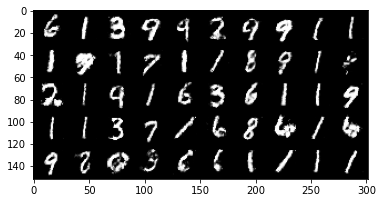

Iter: 81410/100000, Gen loss: 1.1753, Dis loss: 0.9086
Iter: 81420/100000, Gen loss: 1.1975, Dis loss: 0.8312
Iter: 81430/100000, Gen loss: 1.3714, Dis loss: 0.8751
Iter: 81440/100000, Gen loss: 1.5602, Dis loss: 0.8018
Iter: 81450/100000, Gen loss: 1.6408, Dis loss: 0.8873
Iter: 81460/100000, Gen loss: 1.3750, Dis loss: 0.9057
Iter: 81470/100000, Gen loss: 1.2846, Dis loss: 1.1419
Iter: 81480/100000, Gen loss: 1.1516, Dis loss: 1.1804
Iter: 81490/100000, Gen loss: 1.2657, Dis loss: 0.7055
Iter: 81500/100000, Gen loss: 1.0566, Dis loss: 1.2076
Iter: 81510/100000, Gen loss: 1.2329, Dis loss: 1.0494
Iter: 81520/100000, Gen loss: 1.5775, Dis loss: 1.1642
Iter: 81530/100000, Gen loss: 0.9507, Dis loss: 1.4252
Iter: 81540/100000, Gen loss: 0.8652, Dis loss: 1.1910
Iter: 81550/100000, Gen loss: 1.2330, Dis loss: 1.2057
Iter: 81560/100000, Gen loss: 1.1496, Dis loss: 1.0435
Iter: 81570/100000, Gen loss: 1.3923, Dis loss: 0.8933
Iter: 81580/100000, Gen loss: 1.1884, Dis loss: 1.1199
Iter: 8159

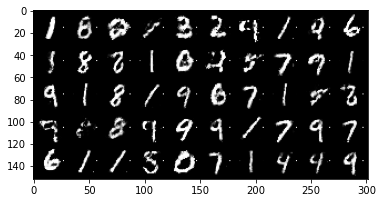

Iter: 81610/100000, Gen loss: 1.5079, Dis loss: 0.8461
Iter: 81620/100000, Gen loss: 1.4589, Dis loss: 0.7019
Iter: 81630/100000, Gen loss: 1.5505, Dis loss: 0.8274
Iter: 81640/100000, Gen loss: 1.7128, Dis loss: 0.9838
Iter: 81650/100000, Gen loss: 1.3864, Dis loss: 0.8381
Iter: 81660/100000, Gen loss: 1.9301, Dis loss: 1.0134
Iter: 81670/100000, Gen loss: 1.7059, Dis loss: 0.7047
Iter: 81680/100000, Gen loss: 1.8230, Dis loss: 0.6403
Iter: 81690/100000, Gen loss: 2.2868, Dis loss: 0.8023
Iter: 81700/100000, Gen loss: 1.7263, Dis loss: 0.7689
Iter: 81710/100000, Gen loss: 1.4905, Dis loss: 1.0352
Iter: 81720/100000, Gen loss: 1.2568, Dis loss: 0.9057
Iter: 81730/100000, Gen loss: 1.5488, Dis loss: 0.9415
Iter: 81740/100000, Gen loss: 1.4918, Dis loss: 0.9484
Iter: 81750/100000, Gen loss: 1.1105, Dis loss: 0.9159
Iter: 81760/100000, Gen loss: 0.8608, Dis loss: 1.2042
Iter: 81770/100000, Gen loss: 1.2813, Dis loss: 0.8222
Iter: 81780/100000, Gen loss: 1.9067, Dis loss: 1.0118
Iter: 8179

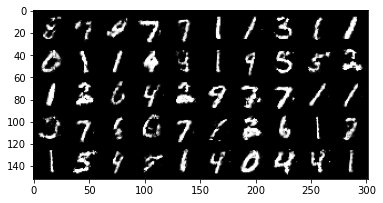

Iter: 81810/100000, Gen loss: 1.1468, Dis loss: 0.9760
Iter: 81820/100000, Gen loss: 1.1031, Dis loss: 1.1295
Iter: 81830/100000, Gen loss: 1.4751, Dis loss: 0.7737
Iter: 81840/100000, Gen loss: 1.6246, Dis loss: 0.9204
Iter: 81850/100000, Gen loss: 1.5336, Dis loss: 1.0338
Iter: 81860/100000, Gen loss: 1.3155, Dis loss: 0.9223
Iter: 81870/100000, Gen loss: 1.1621, Dis loss: 1.0735
Iter: 81880/100000, Gen loss: 1.3021, Dis loss: 0.8635
Iter: 81890/100000, Gen loss: 1.4270, Dis loss: 0.8394
Iter: 81900/100000, Gen loss: 1.3809, Dis loss: 0.7711
Iter: 81910/100000, Gen loss: 1.1311, Dis loss: 0.9105
Iter: 81920/100000, Gen loss: 1.3516, Dis loss: 0.8132
Iter: 81930/100000, Gen loss: 1.3695, Dis loss: 0.8839
Iter: 81940/100000, Gen loss: 1.4646, Dis loss: 1.0657
Iter: 81950/100000, Gen loss: 1.6338, Dis loss: 0.9662
Iter: 81960/100000, Gen loss: 1.1575, Dis loss: 1.0665
Iter: 81970/100000, Gen loss: 1.1815, Dis loss: 0.9438
Iter: 81980/100000, Gen loss: 1.0585, Dis loss: 1.0409
Iter: 8199

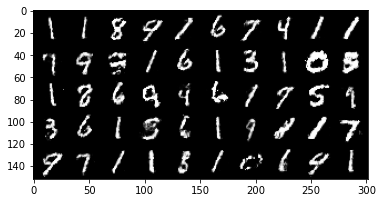

Iter: 82010/100000, Gen loss: 1.4147, Dis loss: 1.0321
Iter: 82020/100000, Gen loss: 1.6641, Dis loss: 0.8351
Iter: 82030/100000, Gen loss: 1.6239, Dis loss: 0.6900
Iter: 82040/100000, Gen loss: 1.4367, Dis loss: 0.8313
Iter: 82050/100000, Gen loss: 1.3543, Dis loss: 0.8120
Iter: 82060/100000, Gen loss: 1.2034, Dis loss: 0.9209
Iter: 82070/100000, Gen loss: 1.7298, Dis loss: 0.7252
Iter: 82080/100000, Gen loss: 1.4501, Dis loss: 1.1614
Iter: 82090/100000, Gen loss: 1.4663, Dis loss: 1.1003
Iter: 82100/100000, Gen loss: 1.3390, Dis loss: 1.0073
Iter: 82110/100000, Gen loss: 1.2693, Dis loss: 1.1615
Iter: 82120/100000, Gen loss: 1.4105, Dis loss: 0.9334
Iter: 82130/100000, Gen loss: 1.2779, Dis loss: 0.9413
Iter: 82140/100000, Gen loss: 1.7244, Dis loss: 0.9482
Iter: 82150/100000, Gen loss: 1.6607, Dis loss: 0.8418
Iter: 82160/100000, Gen loss: 1.5917, Dis loss: 1.0170
Iter: 82170/100000, Gen loss: 1.2798, Dis loss: 1.0382
Iter: 82180/100000, Gen loss: 1.1105, Dis loss: 1.1082
Iter: 8219

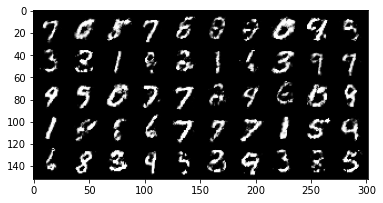

Iter: 82210/100000, Gen loss: 1.5122, Dis loss: 0.9988
Iter: 82220/100000, Gen loss: 1.1580, Dis loss: 1.0672
Iter: 82230/100000, Gen loss: 1.3558, Dis loss: 0.9718
Iter: 82240/100000, Gen loss: 1.4809, Dis loss: 0.9896
Iter: 82250/100000, Gen loss: 1.6130, Dis loss: 0.7931
Iter: 82260/100000, Gen loss: 1.3062, Dis loss: 0.8612
Iter: 82270/100000, Gen loss: 1.2626, Dis loss: 0.7660
Iter: 82280/100000, Gen loss: 1.1230, Dis loss: 1.1122
Iter: 82290/100000, Gen loss: 1.5574, Dis loss: 0.9120
Iter: 82300/100000, Gen loss: 1.7238, Dis loss: 1.1114
Iter: 82310/100000, Gen loss: 1.6743, Dis loss: 0.6337
Iter: 82320/100000, Gen loss: 1.4181, Dis loss: 0.9840
Iter: 82330/100000, Gen loss: 1.0569, Dis loss: 0.8920
Iter: 82340/100000, Gen loss: 1.0858, Dis loss: 1.0494
Iter: 82350/100000, Gen loss: 1.3238, Dis loss: 1.0906
Iter: 82360/100000, Gen loss: 1.3590, Dis loss: 1.1573
Iter: 82370/100000, Gen loss: 1.3073, Dis loss: 1.2966
Iter: 82380/100000, Gen loss: 1.6083, Dis loss: 0.8938
Iter: 8239

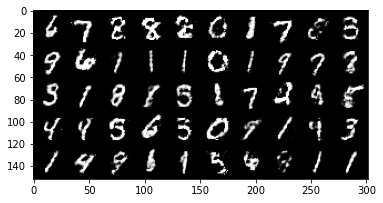

Iter: 82410/100000, Gen loss: 1.4845, Dis loss: 1.1173
Iter: 82420/100000, Gen loss: 1.3892, Dis loss: 0.8108
Iter: 82430/100000, Gen loss: 1.4066, Dis loss: 0.9761
Iter: 82440/100000, Gen loss: 1.2108, Dis loss: 0.7860
Iter: 82450/100000, Gen loss: 1.2519, Dis loss: 0.8579
Iter: 82460/100000, Gen loss: 1.5509, Dis loss: 1.0725
Iter: 82470/100000, Gen loss: 1.4991, Dis loss: 0.8144
Iter: 82480/100000, Gen loss: 1.3929, Dis loss: 0.9881
Iter: 82490/100000, Gen loss: 1.1829, Dis loss: 0.9808
Iter: 82500/100000, Gen loss: 1.2682, Dis loss: 0.9204
Iter: 82510/100000, Gen loss: 1.5384, Dis loss: 0.6254
Iter: 82520/100000, Gen loss: 1.3473, Dis loss: 0.8335
Iter: 82530/100000, Gen loss: 1.6182, Dis loss: 0.9832
Iter: 82540/100000, Gen loss: 1.3891, Dis loss: 1.0312
Iter: 82550/100000, Gen loss: 1.3305, Dis loss: 0.9776
Iter: 82560/100000, Gen loss: 1.2144, Dis loss: 1.0322
Iter: 82570/100000, Gen loss: 1.1346, Dis loss: 1.0614
Iter: 82580/100000, Gen loss: 1.2991, Dis loss: 0.8132
Iter: 8259

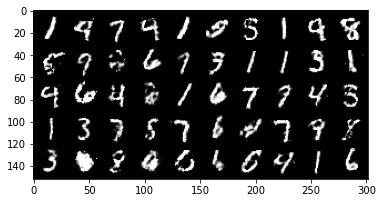

Iter: 82610/100000, Gen loss: 1.7000, Dis loss: 0.7733
Iter: 82620/100000, Gen loss: 1.4500, Dis loss: 1.1940
Iter: 82630/100000, Gen loss: 1.5020, Dis loss: 0.7942
Iter: 82640/100000, Gen loss: 1.1802, Dis loss: 0.9608
Iter: 82650/100000, Gen loss: 0.9716, Dis loss: 0.8545
Iter: 82660/100000, Gen loss: 1.3459, Dis loss: 0.9353
Iter: 82670/100000, Gen loss: 1.5770, Dis loss: 1.1402
Iter: 82680/100000, Gen loss: 1.6242, Dis loss: 1.0289
Iter: 82690/100000, Gen loss: 1.2375, Dis loss: 0.9696
Iter: 82700/100000, Gen loss: 1.2093, Dis loss: 1.0807
Iter: 82710/100000, Gen loss: 1.1799, Dis loss: 1.0604
Iter: 82720/100000, Gen loss: 1.3416, Dis loss: 0.8717
Iter: 82730/100000, Gen loss: 1.3727, Dis loss: 0.8209
Iter: 82740/100000, Gen loss: 1.3040, Dis loss: 0.9064
Iter: 82750/100000, Gen loss: 1.2772, Dis loss: 0.8186
Iter: 82760/100000, Gen loss: 1.3890, Dis loss: 0.9089
Iter: 82770/100000, Gen loss: 1.0278, Dis loss: 0.8781
Iter: 82780/100000, Gen loss: 1.2745, Dis loss: 0.8137
Iter: 8279

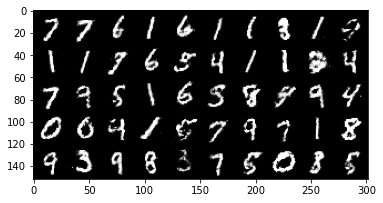

Iter: 82810/100000, Gen loss: 1.0459, Dis loss: 0.8921
Iter: 82820/100000, Gen loss: 1.0566, Dis loss: 0.9587
Iter: 82830/100000, Gen loss: 1.1111, Dis loss: 0.8698
Iter: 82840/100000, Gen loss: 1.4391, Dis loss: 1.0098
Iter: 82850/100000, Gen loss: 1.3441, Dis loss: 1.0795
Iter: 82860/100000, Gen loss: 1.5524, Dis loss: 0.9957
Iter: 82870/100000, Gen loss: 1.2084, Dis loss: 0.7413
Iter: 82880/100000, Gen loss: 1.3290, Dis loss: 0.8622
Iter: 82890/100000, Gen loss: 1.6053, Dis loss: 0.8056
Iter: 82900/100000, Gen loss: 1.3209, Dis loss: 0.9607
Iter: 82910/100000, Gen loss: 1.0887, Dis loss: 0.9916
Iter: 82920/100000, Gen loss: 1.0119, Dis loss: 1.2427
Iter: 82930/100000, Gen loss: 1.1486, Dis loss: 0.8299
Iter: 82940/100000, Gen loss: 1.3843, Dis loss: 0.9055
Iter: 82950/100000, Gen loss: 1.6128, Dis loss: 0.7253
Iter: 82960/100000, Gen loss: 1.4944, Dis loss: 0.8791
Iter: 82970/100000, Gen loss: 1.3424, Dis loss: 1.0320
Iter: 82980/100000, Gen loss: 1.1546, Dis loss: 0.9846
Iter: 8299

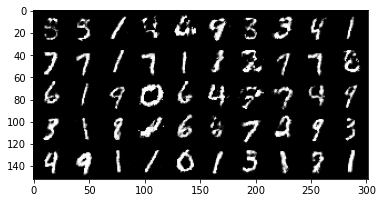

Iter: 83010/100000, Gen loss: 0.9512, Dis loss: 0.8482
Iter: 83020/100000, Gen loss: 1.3216, Dis loss: 0.8057
Iter: 83030/100000, Gen loss: 1.2184, Dis loss: 1.2045
Iter: 83040/100000, Gen loss: 1.0998, Dis loss: 0.9665
Iter: 83050/100000, Gen loss: 1.0688, Dis loss: 0.7966
Iter: 83060/100000, Gen loss: 1.3169, Dis loss: 0.9408
Iter: 83070/100000, Gen loss: 1.1793, Dis loss: 0.8908
Iter: 83080/100000, Gen loss: 1.3364, Dis loss: 0.9203
Iter: 83090/100000, Gen loss: 1.3924, Dis loss: 0.8155
Iter: 83100/100000, Gen loss: 1.4334, Dis loss: 1.0533
Iter: 83110/100000, Gen loss: 1.2576, Dis loss: 0.9662
Iter: 83120/100000, Gen loss: 1.1697, Dis loss: 1.0207
Iter: 83130/100000, Gen loss: 1.1947, Dis loss: 1.1018
Iter: 83140/100000, Gen loss: 1.3964, Dis loss: 0.9936
Iter: 83150/100000, Gen loss: 1.2520, Dis loss: 1.0915
Iter: 83160/100000, Gen loss: 1.5419, Dis loss: 0.9219
Iter: 83170/100000, Gen loss: 1.1468, Dis loss: 0.8111
Iter: 83180/100000, Gen loss: 1.2092, Dis loss: 0.9669
Iter: 8319

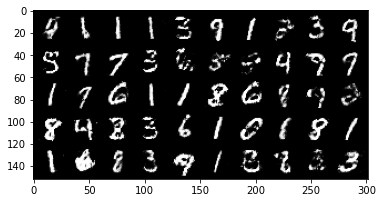

Iter: 83210/100000, Gen loss: 1.3329, Dis loss: 1.1048
Iter: 83220/100000, Gen loss: 1.2678, Dis loss: 0.9588
Iter: 83230/100000, Gen loss: 1.5278, Dis loss: 0.9177
Iter: 83240/100000, Gen loss: 1.1878, Dis loss: 1.0752
Iter: 83250/100000, Gen loss: 1.3961, Dis loss: 0.8647
Iter: 83260/100000, Gen loss: 1.2300, Dis loss: 0.9796
Iter: 83270/100000, Gen loss: 0.9826, Dis loss: 1.1322
Iter: 83280/100000, Gen loss: 1.2453, Dis loss: 0.9615
Iter: 83290/100000, Gen loss: 1.1469, Dis loss: 1.0087
Iter: 83300/100000, Gen loss: 1.0250, Dis loss: 0.8979
Iter: 83310/100000, Gen loss: 0.9478, Dis loss: 0.9998
Iter: 83320/100000, Gen loss: 1.2873, Dis loss: 1.0325
Iter: 83330/100000, Gen loss: 1.2944, Dis loss: 0.8730
Iter: 83340/100000, Gen loss: 1.3518, Dis loss: 0.7515
Iter: 83350/100000, Gen loss: 1.3981, Dis loss: 0.9835
Iter: 83360/100000, Gen loss: 1.7972, Dis loss: 1.0608
Iter: 83370/100000, Gen loss: 1.5161, Dis loss: 0.8535
Iter: 83380/100000, Gen loss: 1.6519, Dis loss: 1.1001
Iter: 8339

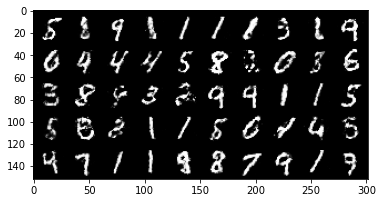

Iter: 83410/100000, Gen loss: 1.1882, Dis loss: 1.1827
Iter: 83420/100000, Gen loss: 1.1544, Dis loss: 0.9742
Iter: 83430/100000, Gen loss: 1.3323, Dis loss: 0.9739
Iter: 83440/100000, Gen loss: 1.3208, Dis loss: 0.9359
Iter: 83450/100000, Gen loss: 1.2491, Dis loss: 0.9604
Iter: 83460/100000, Gen loss: 1.4435, Dis loss: 1.0412
Iter: 83470/100000, Gen loss: 1.4572, Dis loss: 1.0728
Iter: 83480/100000, Gen loss: 1.2069, Dis loss: 0.6529
Iter: 83490/100000, Gen loss: 1.1604, Dis loss: 1.0858
Iter: 83500/100000, Gen loss: 1.0742, Dis loss: 1.0621
Iter: 83510/100000, Gen loss: 1.3359, Dis loss: 0.9815
Iter: 83520/100000, Gen loss: 1.6721, Dis loss: 0.9748
Iter: 83530/100000, Gen loss: 1.2256, Dis loss: 0.9568
Iter: 83540/100000, Gen loss: 1.1945, Dis loss: 1.0051
Iter: 83550/100000, Gen loss: 1.1470, Dis loss: 1.0298
Iter: 83560/100000, Gen loss: 1.1847, Dis loss: 1.0198
Iter: 83570/100000, Gen loss: 1.1235, Dis loss: 0.8837
Iter: 83580/100000, Gen loss: 1.3923, Dis loss: 0.7742
Iter: 8359

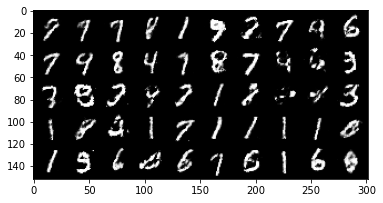

Iter: 83610/100000, Gen loss: 1.0927, Dis loss: 1.2874
Iter: 83620/100000, Gen loss: 0.9944, Dis loss: 1.0255
Iter: 83630/100000, Gen loss: 1.1697, Dis loss: 0.9298
Iter: 83640/100000, Gen loss: 1.5685, Dis loss: 0.8589
Iter: 83650/100000, Gen loss: 1.2153, Dis loss: 0.9597
Iter: 83660/100000, Gen loss: 1.0469, Dis loss: 1.0428
Iter: 83670/100000, Gen loss: 1.4704, Dis loss: 0.6948
Iter: 83680/100000, Gen loss: 1.6877, Dis loss: 0.9655
Iter: 83690/100000, Gen loss: 1.3877, Dis loss: 1.0442
Iter: 83700/100000, Gen loss: 1.3751, Dis loss: 0.9078
Iter: 83710/100000, Gen loss: 1.2989, Dis loss: 0.8942
Iter: 83720/100000, Gen loss: 1.2389, Dis loss: 0.9259
Iter: 83730/100000, Gen loss: 1.3728, Dis loss: 0.9075
Iter: 83740/100000, Gen loss: 1.5007, Dis loss: 0.8294
Iter: 83750/100000, Gen loss: 1.5149, Dis loss: 0.9103
Iter: 83760/100000, Gen loss: 1.3843, Dis loss: 0.7266
Iter: 83770/100000, Gen loss: 1.4095, Dis loss: 0.8292
Iter: 83780/100000, Gen loss: 1.0862, Dis loss: 0.7720
Iter: 8379

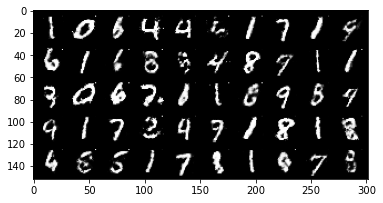

Iter: 83810/100000, Gen loss: 1.2959, Dis loss: 0.8898
Iter: 83820/100000, Gen loss: 1.4380, Dis loss: 0.9391
Iter: 83830/100000, Gen loss: 1.2862, Dis loss: 0.8151
Iter: 83840/100000, Gen loss: 1.0633, Dis loss: 0.8855
Iter: 83850/100000, Gen loss: 1.0890, Dis loss: 0.9275
Iter: 83860/100000, Gen loss: 1.5664, Dis loss: 0.9026
Iter: 83870/100000, Gen loss: 1.5426, Dis loss: 0.9187
Iter: 83880/100000, Gen loss: 1.4694, Dis loss: 0.9990
Iter: 83890/100000, Gen loss: 1.5190, Dis loss: 0.9325
Iter: 83900/100000, Gen loss: 1.2699, Dis loss: 0.8292
Iter: 83910/100000, Gen loss: 1.4477, Dis loss: 0.8905
Iter: 83920/100000, Gen loss: 1.3749, Dis loss: 0.9568
Iter: 83930/100000, Gen loss: 1.6190, Dis loss: 0.8164
Iter: 83940/100000, Gen loss: 1.3467, Dis loss: 0.8933
Iter: 83950/100000, Gen loss: 1.0816, Dis loss: 0.9244
Iter: 83960/100000, Gen loss: 1.3535, Dis loss: 1.0201
Iter: 83970/100000, Gen loss: 1.2381, Dis loss: 1.0544
Iter: 83980/100000, Gen loss: 1.2185, Dis loss: 1.0172
Iter: 8399

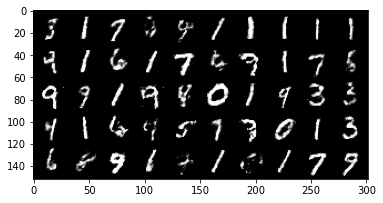

Iter: 84010/100000, Gen loss: 1.2773, Dis loss: 0.9038
Iter: 84020/100000, Gen loss: 1.4880, Dis loss: 0.9291
Iter: 84030/100000, Gen loss: 1.1552, Dis loss: 0.8489
Iter: 84040/100000, Gen loss: 1.3323, Dis loss: 0.9946
Iter: 84050/100000, Gen loss: 1.1647, Dis loss: 0.8969
Iter: 84060/100000, Gen loss: 1.4414, Dis loss: 0.7216
Iter: 84070/100000, Gen loss: 1.2616, Dis loss: 0.9936
Iter: 84080/100000, Gen loss: 1.4005, Dis loss: 0.9822
Iter: 84090/100000, Gen loss: 1.5188, Dis loss: 0.8853
Iter: 84100/100000, Gen loss: 1.3316, Dis loss: 0.8092
Iter: 84110/100000, Gen loss: 1.2414, Dis loss: 0.8688
Iter: 84120/100000, Gen loss: 1.1612, Dis loss: 0.8917
Iter: 84130/100000, Gen loss: 1.0367, Dis loss: 0.9244
Iter: 84140/100000, Gen loss: 1.2918, Dis loss: 0.7642
Iter: 84150/100000, Gen loss: 1.3285, Dis loss: 0.8470
Iter: 84160/100000, Gen loss: 1.1809, Dis loss: 0.8417
Iter: 84170/100000, Gen loss: 1.1781, Dis loss: 1.1331
Iter: 84180/100000, Gen loss: 1.1132, Dis loss: 0.8894
Iter: 8419

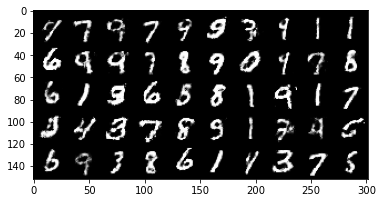

Iter: 84210/100000, Gen loss: 0.9906, Dis loss: 1.0119
Iter: 84220/100000, Gen loss: 1.1715, Dis loss: 1.0409
Iter: 84230/100000, Gen loss: 1.1191, Dis loss: 0.9595
Iter: 84240/100000, Gen loss: 1.5229, Dis loss: 1.0493
Iter: 84250/100000, Gen loss: 1.2192, Dis loss: 0.9069
Iter: 84260/100000, Gen loss: 1.2903, Dis loss: 0.8748
Iter: 84270/100000, Gen loss: 1.4363, Dis loss: 0.9528
Iter: 84280/100000, Gen loss: 1.2482, Dis loss: 0.9151
Iter: 84290/100000, Gen loss: 1.1583, Dis loss: 0.8962
Iter: 84300/100000, Gen loss: 1.0273, Dis loss: 0.8555
Iter: 84310/100000, Gen loss: 1.2011, Dis loss: 1.1194
Iter: 84320/100000, Gen loss: 1.2009, Dis loss: 0.9622
Iter: 84330/100000, Gen loss: 1.2318, Dis loss: 1.0659
Iter: 84340/100000, Gen loss: 1.4093, Dis loss: 1.0751
Iter: 84350/100000, Gen loss: 1.2336, Dis loss: 0.9279
Iter: 84360/100000, Gen loss: 1.3089, Dis loss: 1.1351
Iter: 84370/100000, Gen loss: 1.4844, Dis loss: 0.8830
Iter: 84380/100000, Gen loss: 1.3804, Dis loss: 0.8439
Iter: 8439

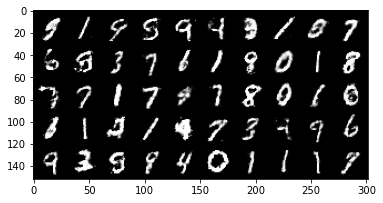

Iter: 84410/100000, Gen loss: 1.4211, Dis loss: 1.1482
Iter: 84420/100000, Gen loss: 1.2273, Dis loss: 0.7652
Iter: 84430/100000, Gen loss: 1.4287, Dis loss: 0.9043
Iter: 84440/100000, Gen loss: 1.5566, Dis loss: 0.7816
Iter: 84450/100000, Gen loss: 1.5233, Dis loss: 0.7972
Iter: 84460/100000, Gen loss: 1.5130, Dis loss: 0.8778
Iter: 84470/100000, Gen loss: 1.5543, Dis loss: 0.9676
Iter: 84480/100000, Gen loss: 1.4302, Dis loss: 1.0503
Iter: 84490/100000, Gen loss: 1.5019, Dis loss: 0.8478
Iter: 84500/100000, Gen loss: 1.4754, Dis loss: 1.2317
Iter: 84510/100000, Gen loss: 1.3277, Dis loss: 0.9340
Iter: 84520/100000, Gen loss: 0.9628, Dis loss: 1.1532
Iter: 84530/100000, Gen loss: 1.2125, Dis loss: 0.8954
Iter: 84540/100000, Gen loss: 0.9603, Dis loss: 0.8470
Iter: 84550/100000, Gen loss: 1.3380, Dis loss: 0.8964
Iter: 84560/100000, Gen loss: 1.3267, Dis loss: 1.0662
Iter: 84570/100000, Gen loss: 1.4072, Dis loss: 0.9280
Iter: 84580/100000, Gen loss: 1.5204, Dis loss: 0.9271
Iter: 8459

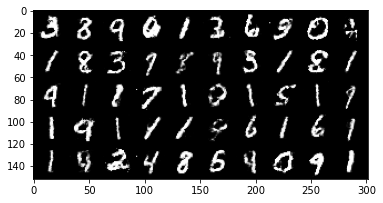

Iter: 84610/100000, Gen loss: 1.3138, Dis loss: 0.7990
Iter: 84620/100000, Gen loss: 1.4788, Dis loss: 0.8298
Iter: 84630/100000, Gen loss: 1.5288, Dis loss: 0.8947
Iter: 84640/100000, Gen loss: 1.3985, Dis loss: 1.0225
Iter: 84650/100000, Gen loss: 1.3725, Dis loss: 1.0664
Iter: 84660/100000, Gen loss: 1.4281, Dis loss: 0.8713
Iter: 84670/100000, Gen loss: 1.4533, Dis loss: 0.8850
Iter: 84680/100000, Gen loss: 1.4119, Dis loss: 0.9073
Iter: 84690/100000, Gen loss: 1.3404, Dis loss: 0.8638
Iter: 84700/100000, Gen loss: 1.3698, Dis loss: 0.9183
Iter: 84710/100000, Gen loss: 1.2887, Dis loss: 0.7210
Iter: 84720/100000, Gen loss: 1.4888, Dis loss: 0.7572
Iter: 84730/100000, Gen loss: 1.4439, Dis loss: 0.8440
Iter: 84740/100000, Gen loss: 1.0500, Dis loss: 0.9450
Iter: 84750/100000, Gen loss: 1.1632, Dis loss: 0.9338
Iter: 84760/100000, Gen loss: 1.2239, Dis loss: 0.7953
Iter: 84770/100000, Gen loss: 1.5073, Dis loss: 0.8713
Iter: 84780/100000, Gen loss: 1.2847, Dis loss: 0.9956
Iter: 8479

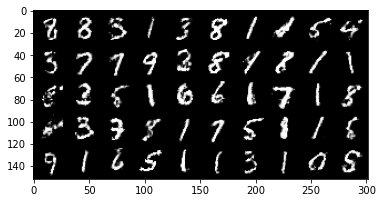

Iter: 84810/100000, Gen loss: 1.3375, Dis loss: 1.0591
Iter: 84820/100000, Gen loss: 1.1327, Dis loss: 0.8626
Iter: 84830/100000, Gen loss: 1.0279, Dis loss: 0.9217
Iter: 84840/100000, Gen loss: 1.2750, Dis loss: 0.7753
Iter: 84850/100000, Gen loss: 1.2016, Dis loss: 1.0897
Iter: 84860/100000, Gen loss: 1.2590, Dis loss: 0.8791
Iter: 84870/100000, Gen loss: 1.2189, Dis loss: 1.1652
Iter: 84880/100000, Gen loss: 1.3742, Dis loss: 1.1776
Iter: 84890/100000, Gen loss: 1.5774, Dis loss: 0.9838
Iter: 84900/100000, Gen loss: 1.4075, Dis loss: 0.8876
Iter: 84910/100000, Gen loss: 1.2357, Dis loss: 0.9444
Iter: 84920/100000, Gen loss: 1.2566, Dis loss: 0.9340
Iter: 84930/100000, Gen loss: 1.3358, Dis loss: 0.8827
Iter: 84940/100000, Gen loss: 1.1725, Dis loss: 0.9737
Iter: 84950/100000, Gen loss: 1.2504, Dis loss: 1.0128
Iter: 84960/100000, Gen loss: 1.0733, Dis loss: 1.0798
Iter: 84970/100000, Gen loss: 1.3182, Dis loss: 1.0486
Iter: 84980/100000, Gen loss: 1.1525, Dis loss: 0.9537
Iter: 8499

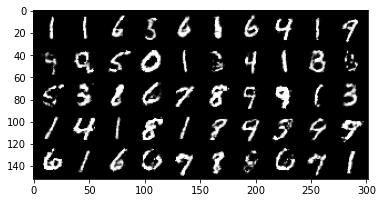

Iter: 85010/100000, Gen loss: 1.1777, Dis loss: 1.0824
Iter: 85020/100000, Gen loss: 1.3224, Dis loss: 0.9493
Iter: 85030/100000, Gen loss: 1.2237, Dis loss: 1.0047
Iter: 85040/100000, Gen loss: 1.1547, Dis loss: 0.9210
Iter: 85050/100000, Gen loss: 1.4427, Dis loss: 0.9988
Iter: 85060/100000, Gen loss: 1.2355, Dis loss: 0.7947
Iter: 85070/100000, Gen loss: 1.5178, Dis loss: 0.9878
Iter: 85080/100000, Gen loss: 1.4907, Dis loss: 0.8962
Iter: 85090/100000, Gen loss: 1.7192, Dis loss: 0.6739
Iter: 85100/100000, Gen loss: 1.1060, Dis loss: 0.8694
Iter: 85110/100000, Gen loss: 1.5683, Dis loss: 1.0452
Iter: 85120/100000, Gen loss: 1.4460, Dis loss: 0.9109
Iter: 85130/100000, Gen loss: 1.4225, Dis loss: 1.0702
Iter: 85140/100000, Gen loss: 1.4911, Dis loss: 0.8732
Iter: 85150/100000, Gen loss: 1.2218, Dis loss: 0.7899
Iter: 85160/100000, Gen loss: 1.3235, Dis loss: 0.9998
Iter: 85170/100000, Gen loss: 1.2345, Dis loss: 0.9157
Iter: 85180/100000, Gen loss: 1.0833, Dis loss: 0.9620
Iter: 8519

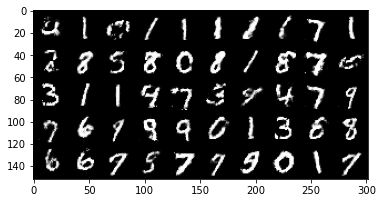

Iter: 85210/100000, Gen loss: 1.3858, Dis loss: 0.8005
Iter: 85220/100000, Gen loss: 1.3701, Dis loss: 0.8775
Iter: 85230/100000, Gen loss: 1.2240, Dis loss: 0.9943
Iter: 85240/100000, Gen loss: 1.3227, Dis loss: 1.0106
Iter: 85250/100000, Gen loss: 1.4222, Dis loss: 0.8493
Iter: 85260/100000, Gen loss: 1.1913, Dis loss: 1.0550
Iter: 85270/100000, Gen loss: 1.4220, Dis loss: 0.8352
Iter: 85280/100000, Gen loss: 0.9853, Dis loss: 0.8083
Iter: 85290/100000, Gen loss: 1.0693, Dis loss: 1.0036
Iter: 85300/100000, Gen loss: 1.3928, Dis loss: 1.0358
Iter: 85310/100000, Gen loss: 1.2216, Dis loss: 0.9565
Iter: 85320/100000, Gen loss: 1.2148, Dis loss: 1.0701
Iter: 85330/100000, Gen loss: 1.3519, Dis loss: 1.1659
Iter: 85340/100000, Gen loss: 1.4459, Dis loss: 0.8963
Iter: 85350/100000, Gen loss: 1.4885, Dis loss: 0.8661
Iter: 85360/100000, Gen loss: 1.5183, Dis loss: 0.9548
Iter: 85370/100000, Gen loss: 1.3748, Dis loss: 0.9447
Iter: 85380/100000, Gen loss: 1.2348, Dis loss: 0.9737
Iter: 8539

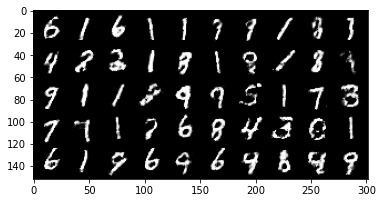

Iter: 85410/100000, Gen loss: 1.0963, Dis loss: 0.9206
Iter: 85420/100000, Gen loss: 1.2106, Dis loss: 0.8692
Iter: 85430/100000, Gen loss: 1.5091, Dis loss: 1.0156
Iter: 85440/100000, Gen loss: 1.7256, Dis loss: 0.8966
Iter: 85450/100000, Gen loss: 1.4025, Dis loss: 0.9881
Iter: 85460/100000, Gen loss: 1.3854, Dis loss: 0.8798
Iter: 85470/100000, Gen loss: 1.2277, Dis loss: 0.9932
Iter: 85480/100000, Gen loss: 1.0850, Dis loss: 0.9680
Iter: 85490/100000, Gen loss: 1.2819, Dis loss: 0.9315
Iter: 85500/100000, Gen loss: 1.5372, Dis loss: 0.9586
Iter: 85510/100000, Gen loss: 1.2355, Dis loss: 1.1069
Iter: 85520/100000, Gen loss: 0.9608, Dis loss: 1.0313
Iter: 85530/100000, Gen loss: 1.1934, Dis loss: 0.9666
Iter: 85540/100000, Gen loss: 1.2099, Dis loss: 0.7116
Iter: 85550/100000, Gen loss: 1.3693, Dis loss: 0.8910
Iter: 85560/100000, Gen loss: 1.5561, Dis loss: 0.9737
Iter: 85570/100000, Gen loss: 1.0461, Dis loss: 0.9037
Iter: 85580/100000, Gen loss: 1.0565, Dis loss: 0.9351
Iter: 8559

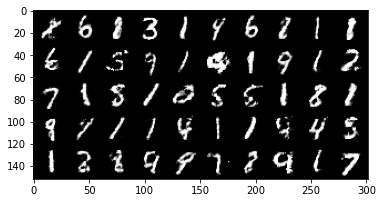

Iter: 85610/100000, Gen loss: 1.2202, Dis loss: 1.0345
Iter: 85620/100000, Gen loss: 1.2686, Dis loss: 0.8595
Iter: 85630/100000, Gen loss: 1.3323, Dis loss: 1.0365
Iter: 85640/100000, Gen loss: 1.3814, Dis loss: 0.8493
Iter: 85650/100000, Gen loss: 1.4183, Dis loss: 1.0234
Iter: 85660/100000, Gen loss: 1.6274, Dis loss: 0.7975
Iter: 85670/100000, Gen loss: 1.3458, Dis loss: 1.0082
Iter: 85680/100000, Gen loss: 1.5945, Dis loss: 0.9240
Iter: 85690/100000, Gen loss: 1.2951, Dis loss: 1.0467
Iter: 85700/100000, Gen loss: 1.2286, Dis loss: 1.1206
Iter: 85710/100000, Gen loss: 1.4622, Dis loss: 0.8635
Iter: 85720/100000, Gen loss: 1.0463, Dis loss: 1.0572
Iter: 85730/100000, Gen loss: 1.0404, Dis loss: 0.9615
Iter: 85740/100000, Gen loss: 1.2504, Dis loss: 1.0204
Iter: 85750/100000, Gen loss: 1.0401, Dis loss: 0.8368
Iter: 85760/100000, Gen loss: 1.3453, Dis loss: 0.9311
Iter: 85770/100000, Gen loss: 1.3677, Dis loss: 0.9880
Iter: 85780/100000, Gen loss: 1.6189, Dis loss: 0.8429
Iter: 8579

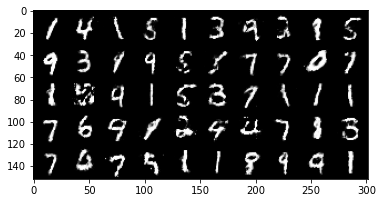

Iter: 85810/100000, Gen loss: 1.1054, Dis loss: 1.0068
Iter: 85820/100000, Gen loss: 1.2654, Dis loss: 0.9201
Iter: 85830/100000, Gen loss: 0.9548, Dis loss: 0.9404
Iter: 85840/100000, Gen loss: 1.1433, Dis loss: 0.9668
Iter: 85850/100000, Gen loss: 1.3770, Dis loss: 0.9426
Iter: 85860/100000, Gen loss: 1.3753, Dis loss: 0.8448
Iter: 85870/100000, Gen loss: 1.5564, Dis loss: 1.0622
Iter: 85880/100000, Gen loss: 1.0154, Dis loss: 0.7989
Iter: 85890/100000, Gen loss: 1.1055, Dis loss: 1.0548
Iter: 85900/100000, Gen loss: 1.2540, Dis loss: 0.7398
Iter: 85910/100000, Gen loss: 1.2413, Dis loss: 1.1667
Iter: 85920/100000, Gen loss: 1.1726, Dis loss: 1.0506
Iter: 85930/100000, Gen loss: 1.2210, Dis loss: 1.1378
Iter: 85940/100000, Gen loss: 1.1627, Dis loss: 1.0821
Iter: 85950/100000, Gen loss: 1.2894, Dis loss: 1.0691
Iter: 85960/100000, Gen loss: 1.0821, Dis loss: 0.9371
Iter: 85970/100000, Gen loss: 1.1803, Dis loss: 0.9244
Iter: 85980/100000, Gen loss: 1.1963, Dis loss: 0.8663
Iter: 8599

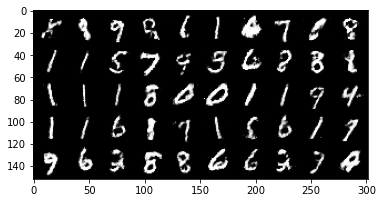

Iter: 86010/100000, Gen loss: 1.0714, Dis loss: 0.9427
Iter: 86020/100000, Gen loss: 1.1826, Dis loss: 0.9832
Iter: 86030/100000, Gen loss: 0.8579, Dis loss: 0.9553
Iter: 86040/100000, Gen loss: 1.3458, Dis loss: 1.0814
Iter: 86050/100000, Gen loss: 0.8735, Dis loss: 1.1363
Iter: 86060/100000, Gen loss: 1.5109, Dis loss: 0.8538
Iter: 86070/100000, Gen loss: 1.4250, Dis loss: 1.0523
Iter: 86080/100000, Gen loss: 1.1880, Dis loss: 0.9198
Iter: 86090/100000, Gen loss: 1.2980, Dis loss: 0.7048
Iter: 86100/100000, Gen loss: 1.3913, Dis loss: 0.9862
Iter: 86110/100000, Gen loss: 1.3939, Dis loss: 0.9868
Iter: 86120/100000, Gen loss: 1.1771, Dis loss: 0.9689
Iter: 86130/100000, Gen loss: 1.1532, Dis loss: 1.1181
Iter: 86140/100000, Gen loss: 1.0989, Dis loss: 1.0828
Iter: 86150/100000, Gen loss: 1.0329, Dis loss: 1.0627
Iter: 86160/100000, Gen loss: 1.5016, Dis loss: 0.9207
Iter: 86170/100000, Gen loss: 1.2730, Dis loss: 0.8588
Iter: 86180/100000, Gen loss: 1.1047, Dis loss: 1.0512
Iter: 8619

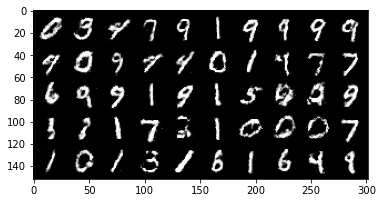

Iter: 86210/100000, Gen loss: 0.8558, Dis loss: 1.0499
Iter: 86220/100000, Gen loss: 1.4147, Dis loss: 0.8974
Iter: 86230/100000, Gen loss: 1.5025, Dis loss: 0.9352
Iter: 86240/100000, Gen loss: 1.4527, Dis loss: 0.9109
Iter: 86250/100000, Gen loss: 1.4019, Dis loss: 0.7844
Iter: 86260/100000, Gen loss: 1.4512, Dis loss: 0.9825
Iter: 86270/100000, Gen loss: 1.2616, Dis loss: 1.1681
Iter: 86280/100000, Gen loss: 1.0440, Dis loss: 1.1046
Iter: 86290/100000, Gen loss: 1.2031, Dis loss: 0.7518
Iter: 86300/100000, Gen loss: 1.2421, Dis loss: 0.9910
Iter: 86310/100000, Gen loss: 1.2569, Dis loss: 0.9759
Iter: 86320/100000, Gen loss: 1.3717, Dis loss: 1.0164
Iter: 86330/100000, Gen loss: 1.3346, Dis loss: 0.8938
Iter: 86340/100000, Gen loss: 1.2485, Dis loss: 1.0041
Iter: 86350/100000, Gen loss: 1.3543, Dis loss: 0.8102
Iter: 86360/100000, Gen loss: 1.1376, Dis loss: 1.1778
Iter: 86370/100000, Gen loss: 1.0735, Dis loss: 0.7950
Iter: 86380/100000, Gen loss: 1.1048, Dis loss: 0.9515
Iter: 8639

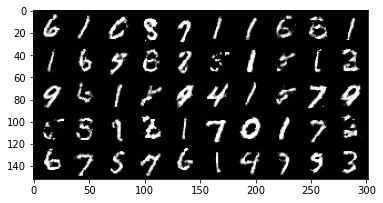

Iter: 86410/100000, Gen loss: 1.4605, Dis loss: 0.8854
Iter: 86420/100000, Gen loss: 1.1961, Dis loss: 0.9954
Iter: 86430/100000, Gen loss: 1.3736, Dis loss: 0.9456
Iter: 86440/100000, Gen loss: 1.2516, Dis loss: 0.9218
Iter: 86450/100000, Gen loss: 1.1006, Dis loss: 0.9374
Iter: 86460/100000, Gen loss: 1.0197, Dis loss: 0.8855
Iter: 86470/100000, Gen loss: 1.1059, Dis loss: 1.0038
Iter: 86480/100000, Gen loss: 1.2447, Dis loss: 0.8981
Iter: 86490/100000, Gen loss: 1.5147, Dis loss: 0.7437
Iter: 86500/100000, Gen loss: 1.6107, Dis loss: 1.1171
Iter: 86510/100000, Gen loss: 1.3098, Dis loss: 1.0960
Iter: 86520/100000, Gen loss: 1.4101, Dis loss: 0.9550
Iter: 86530/100000, Gen loss: 1.4086, Dis loss: 0.8736
Iter: 86540/100000, Gen loss: 1.4522, Dis loss: 0.9542
Iter: 86550/100000, Gen loss: 1.3318, Dis loss: 0.8950
Iter: 86560/100000, Gen loss: 1.3800, Dis loss: 0.8855
Iter: 86570/100000, Gen loss: 1.3501, Dis loss: 0.7986
Iter: 86580/100000, Gen loss: 1.4198, Dis loss: 1.0112
Iter: 8659

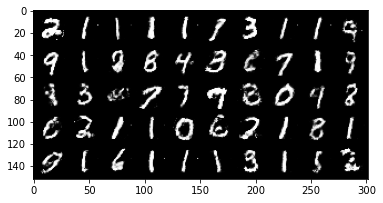

Iter: 86610/100000, Gen loss: 1.1999, Dis loss: 0.9026
Iter: 86620/100000, Gen loss: 1.3891, Dis loss: 1.1005
Iter: 86630/100000, Gen loss: 1.3291, Dis loss: 1.0375
Iter: 86640/100000, Gen loss: 1.2383, Dis loss: 0.8815
Iter: 86650/100000, Gen loss: 1.0575, Dis loss: 1.1147
Iter: 86660/100000, Gen loss: 0.8970, Dis loss: 0.9169
Iter: 86670/100000, Gen loss: 0.9693, Dis loss: 0.9812
Iter: 86680/100000, Gen loss: 1.1933, Dis loss: 1.1111
Iter: 86690/100000, Gen loss: 1.0959, Dis loss: 0.9483
Iter: 86700/100000, Gen loss: 1.3127, Dis loss: 0.7809
Iter: 86710/100000, Gen loss: 1.1667, Dis loss: 0.9423
Iter: 86720/100000, Gen loss: 1.2519, Dis loss: 1.1467
Iter: 86730/100000, Gen loss: 1.3041, Dis loss: 0.9144
Iter: 86740/100000, Gen loss: 1.1882, Dis loss: 0.9614
Iter: 86750/100000, Gen loss: 1.0564, Dis loss: 1.2239
Iter: 86760/100000, Gen loss: 1.1050, Dis loss: 0.7765
Iter: 86770/100000, Gen loss: 1.4658, Dis loss: 0.7999
Iter: 86780/100000, Gen loss: 1.2741, Dis loss: 1.0093
Iter: 8679

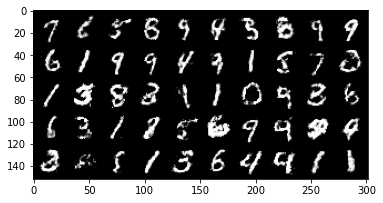

Iter: 86810/100000, Gen loss: 1.1596, Dis loss: 1.2409
Iter: 86820/100000, Gen loss: 0.9432, Dis loss: 0.8205
Iter: 86830/100000, Gen loss: 0.9183, Dis loss: 0.9122
Iter: 86840/100000, Gen loss: 1.2687, Dis loss: 0.8876
Iter: 86850/100000, Gen loss: 1.3684, Dis loss: 0.8464
Iter: 86860/100000, Gen loss: 1.0086, Dis loss: 1.2121
Iter: 86870/100000, Gen loss: 1.5024, Dis loss: 0.9499
Iter: 86880/100000, Gen loss: 1.4579, Dis loss: 0.9340
Iter: 86890/100000, Gen loss: 1.3112, Dis loss: 1.2180
Iter: 86900/100000, Gen loss: 1.0746, Dis loss: 1.0681
Iter: 86910/100000, Gen loss: 1.2937, Dis loss: 0.8777
Iter: 86920/100000, Gen loss: 1.3570, Dis loss: 0.9985
Iter: 86930/100000, Gen loss: 1.3993, Dis loss: 1.0503
Iter: 86940/100000, Gen loss: 1.5038, Dis loss: 1.1739
Iter: 86950/100000, Gen loss: 1.3942, Dis loss: 0.8466
Iter: 86960/100000, Gen loss: 1.1848, Dis loss: 1.0397
Iter: 86970/100000, Gen loss: 1.4651, Dis loss: 0.9955
Iter: 86980/100000, Gen loss: 1.2915, Dis loss: 0.9919
Iter: 8699

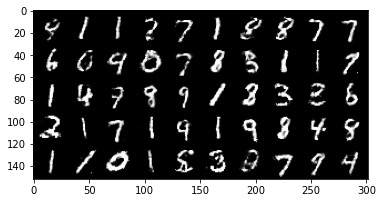

Iter: 87010/100000, Gen loss: 1.6333, Dis loss: 0.9936
Iter: 87020/100000, Gen loss: 1.6580, Dis loss: 1.0400
Iter: 87030/100000, Gen loss: 1.4380, Dis loss: 0.9769
Iter: 87040/100000, Gen loss: 1.4068, Dis loss: 0.9444
Iter: 87050/100000, Gen loss: 1.0389, Dis loss: 0.9218
Iter: 87060/100000, Gen loss: 1.0085, Dis loss: 0.7910
Iter: 87070/100000, Gen loss: 1.2472, Dis loss: 1.0245
Iter: 87080/100000, Gen loss: 1.2487, Dis loss: 0.9669
Iter: 87090/100000, Gen loss: 1.1206, Dis loss: 0.7731
Iter: 87100/100000, Gen loss: 1.3069, Dis loss: 1.0510
Iter: 87110/100000, Gen loss: 1.1820, Dis loss: 0.9438
Iter: 87120/100000, Gen loss: 1.0155, Dis loss: 0.8744
Iter: 87130/100000, Gen loss: 1.1864, Dis loss: 0.8311
Iter: 87140/100000, Gen loss: 1.4302, Dis loss: 0.9701
Iter: 87150/100000, Gen loss: 1.2203, Dis loss: 1.0132
Iter: 87160/100000, Gen loss: 1.3486, Dis loss: 0.9543
Iter: 87170/100000, Gen loss: 1.4382, Dis loss: 1.0713
Iter: 87180/100000, Gen loss: 1.4709, Dis loss: 0.8908
Iter: 8719

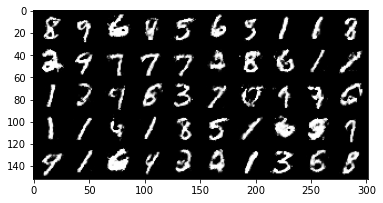

Iter: 87210/100000, Gen loss: 1.3678, Dis loss: 0.9528
Iter: 87220/100000, Gen loss: 1.4519, Dis loss: 1.0239
Iter: 87230/100000, Gen loss: 1.2807, Dis loss: 1.0697
Iter: 87240/100000, Gen loss: 1.2780, Dis loss: 0.7707
Iter: 87250/100000, Gen loss: 1.4355, Dis loss: 0.9719
Iter: 87260/100000, Gen loss: 1.2736, Dis loss: 0.7178
Iter: 87270/100000, Gen loss: 1.5792, Dis loss: 1.1362
Iter: 87280/100000, Gen loss: 1.1591, Dis loss: 0.8728
Iter: 87290/100000, Gen loss: 1.2399, Dis loss: 1.0384
Iter: 87300/100000, Gen loss: 1.4085, Dis loss: 0.9326
Iter: 87310/100000, Gen loss: 1.3336, Dis loss: 0.9090
Iter: 87320/100000, Gen loss: 1.3605, Dis loss: 0.7986
Iter: 87330/100000, Gen loss: 1.2469, Dis loss: 0.8805
Iter: 87340/100000, Gen loss: 1.3447, Dis loss: 0.8758
Iter: 87350/100000, Gen loss: 1.5221, Dis loss: 1.1757
Iter: 87360/100000, Gen loss: 1.5155, Dis loss: 0.8043
Iter: 87370/100000, Gen loss: 1.4515, Dis loss: 0.9283
Iter: 87380/100000, Gen loss: 1.2827, Dis loss: 0.8646
Iter: 8739

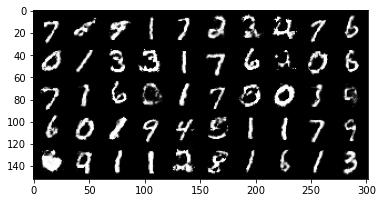

Iter: 87410/100000, Gen loss: 1.2546, Dis loss: 0.9882
Iter: 87420/100000, Gen loss: 1.1120, Dis loss: 0.8040
Iter: 87430/100000, Gen loss: 1.2528, Dis loss: 0.9004
Iter: 87440/100000, Gen loss: 1.0897, Dis loss: 1.2376
Iter: 87450/100000, Gen loss: 1.1420, Dis loss: 1.0572
Iter: 87460/100000, Gen loss: 1.1689, Dis loss: 1.0634
Iter: 87470/100000, Gen loss: 1.2613, Dis loss: 1.1095
Iter: 87480/100000, Gen loss: 1.5060, Dis loss: 0.8405
Iter: 87490/100000, Gen loss: 1.4156, Dis loss: 0.8181
Iter: 87500/100000, Gen loss: 1.2999, Dis loss: 0.9917
Iter: 87510/100000, Gen loss: 1.3414, Dis loss: 1.0719
Iter: 87520/100000, Gen loss: 1.2736, Dis loss: 0.9026
Iter: 87530/100000, Gen loss: 1.4046, Dis loss: 0.9855
Iter: 87540/100000, Gen loss: 1.1391, Dis loss: 0.9789
Iter: 87550/100000, Gen loss: 1.2152, Dis loss: 1.0982
Iter: 87560/100000, Gen loss: 1.1464, Dis loss: 0.8334
Iter: 87570/100000, Gen loss: 1.2767, Dis loss: 0.8996
Iter: 87580/100000, Gen loss: 1.2916, Dis loss: 1.0482
Iter: 8759

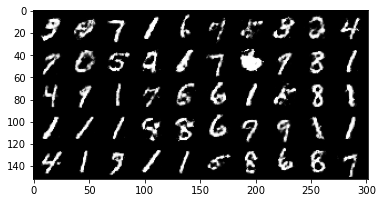

Iter: 87610/100000, Gen loss: 1.6770, Dis loss: 0.9991
Iter: 87620/100000, Gen loss: 1.5648, Dis loss: 0.9136
Iter: 87630/100000, Gen loss: 1.6182, Dis loss: 0.9740
Iter: 87640/100000, Gen loss: 1.3793, Dis loss: 0.8046
Iter: 87650/100000, Gen loss: 1.3241, Dis loss: 0.7590
Iter: 87660/100000, Gen loss: 1.2716, Dis loss: 0.9577
Iter: 87670/100000, Gen loss: 1.1671, Dis loss: 1.0450
Iter: 87680/100000, Gen loss: 1.3666, Dis loss: 1.2043
Iter: 87690/100000, Gen loss: 1.3158, Dis loss: 0.9885
Iter: 87700/100000, Gen loss: 1.4954, Dis loss: 0.8200
Iter: 87710/100000, Gen loss: 1.3194, Dis loss: 1.0401
Iter: 87720/100000, Gen loss: 1.1853, Dis loss: 1.1419
Iter: 87730/100000, Gen loss: 1.2872, Dis loss: 0.8934
Iter: 87740/100000, Gen loss: 1.5069, Dis loss: 1.0210
Iter: 87750/100000, Gen loss: 1.1643, Dis loss: 0.8930
Iter: 87760/100000, Gen loss: 1.2302, Dis loss: 0.8794
Iter: 87770/100000, Gen loss: 1.2316, Dis loss: 0.9371
Iter: 87780/100000, Gen loss: 1.2166, Dis loss: 0.8100
Iter: 8779

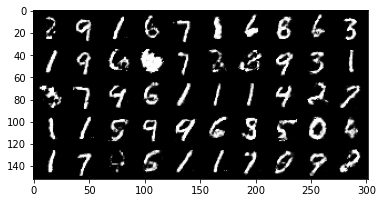

Iter: 87810/100000, Gen loss: 1.5146, Dis loss: 0.9305
Iter: 87820/100000, Gen loss: 1.4096, Dis loss: 1.1417
Iter: 87830/100000, Gen loss: 1.0381, Dis loss: 1.3451
Iter: 87840/100000, Gen loss: 1.1771, Dis loss: 1.1273
Iter: 87850/100000, Gen loss: 0.9990, Dis loss: 1.1441
Iter: 87860/100000, Gen loss: 1.0354, Dis loss: 0.9719
Iter: 87870/100000, Gen loss: 1.0492, Dis loss: 1.1164
Iter: 87880/100000, Gen loss: 1.1659, Dis loss: 0.8957
Iter: 87890/100000, Gen loss: 1.3220, Dis loss: 0.9290
Iter: 87900/100000, Gen loss: 1.1978, Dis loss: 1.0558
Iter: 87910/100000, Gen loss: 1.3925, Dis loss: 1.1217
Iter: 87920/100000, Gen loss: 1.2815, Dis loss: 0.8326
Iter: 87930/100000, Gen loss: 1.3176, Dis loss: 1.0811
Iter: 87940/100000, Gen loss: 1.1569, Dis loss: 1.1996
Iter: 87950/100000, Gen loss: 1.1840, Dis loss: 0.8393
Iter: 87960/100000, Gen loss: 1.2329, Dis loss: 1.1014
Iter: 87970/100000, Gen loss: 1.1575, Dis loss: 0.9824
Iter: 87980/100000, Gen loss: 1.0041, Dis loss: 0.9190
Iter: 8799

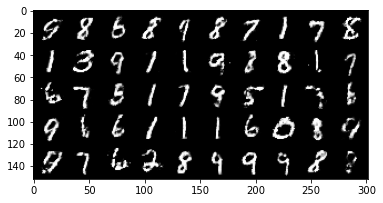

Iter: 88010/100000, Gen loss: 1.1353, Dis loss: 1.1190
Iter: 88020/100000, Gen loss: 1.3459, Dis loss: 0.7976
Iter: 88030/100000, Gen loss: 1.5349, Dis loss: 1.0584
Iter: 88040/100000, Gen loss: 1.5073, Dis loss: 0.9260
Iter: 88050/100000, Gen loss: 1.2833, Dis loss: 1.0273
Iter: 88060/100000, Gen loss: 1.1333, Dis loss: 1.0490
Iter: 88070/100000, Gen loss: 1.6302, Dis loss: 0.9010
Iter: 88080/100000, Gen loss: 1.6281, Dis loss: 1.0086
Iter: 88090/100000, Gen loss: 1.5091, Dis loss: 0.9260
Iter: 88100/100000, Gen loss: 1.2984, Dis loss: 1.0566
Iter: 88110/100000, Gen loss: 1.0450, Dis loss: 0.7189
Iter: 88120/100000, Gen loss: 1.1219, Dis loss: 1.1870
Iter: 88130/100000, Gen loss: 1.1951, Dis loss: 0.9818
Iter: 88140/100000, Gen loss: 1.1722, Dis loss: 0.7812
Iter: 88150/100000, Gen loss: 1.1378, Dis loss: 1.0065
Iter: 88160/100000, Gen loss: 1.3078, Dis loss: 0.8805
Iter: 88170/100000, Gen loss: 1.3045, Dis loss: 1.1604
Iter: 88180/100000, Gen loss: 1.2765, Dis loss: 1.1342
Iter: 8819

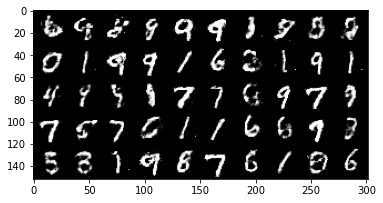

Iter: 88210/100000, Gen loss: 1.2194, Dis loss: 0.9386
Iter: 88220/100000, Gen loss: 1.3305, Dis loss: 0.8557
Iter: 88230/100000, Gen loss: 1.6535, Dis loss: 0.8969
Iter: 88240/100000, Gen loss: 1.5153, Dis loss: 1.0047
Iter: 88250/100000, Gen loss: 1.5445, Dis loss: 1.1721
Iter: 88260/100000, Gen loss: 1.3517, Dis loss: 0.9904
Iter: 88270/100000, Gen loss: 1.3727, Dis loss: 0.8818
Iter: 88280/100000, Gen loss: 1.3684, Dis loss: 1.0380
Iter: 88290/100000, Gen loss: 1.3636, Dis loss: 1.0242
Iter: 88300/100000, Gen loss: 0.7462, Dis loss: 1.0300
Iter: 88310/100000, Gen loss: 1.1131, Dis loss: 1.1113
Iter: 88320/100000, Gen loss: 1.2714, Dis loss: 0.8365
Iter: 88330/100000, Gen loss: 1.1475, Dis loss: 0.9725
Iter: 88340/100000, Gen loss: 1.5555, Dis loss: 0.7913
Iter: 88350/100000, Gen loss: 1.4668, Dis loss: 0.8863
Iter: 88360/100000, Gen loss: 1.3993, Dis loss: 0.8578
Iter: 88370/100000, Gen loss: 1.5218, Dis loss: 1.0040
Iter: 88380/100000, Gen loss: 1.3197, Dis loss: 1.0658
Iter: 8839

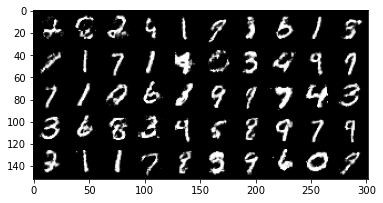

Iter: 88410/100000, Gen loss: 1.2714, Dis loss: 1.1235
Iter: 88420/100000, Gen loss: 1.1679, Dis loss: 1.0164
Iter: 88430/100000, Gen loss: 0.8928, Dis loss: 0.9894
Iter: 88440/100000, Gen loss: 1.0701, Dis loss: 0.8860
Iter: 88450/100000, Gen loss: 1.2649, Dis loss: 0.9817
Iter: 88460/100000, Gen loss: 1.4522, Dis loss: 1.0597
Iter: 88470/100000, Gen loss: 1.2264, Dis loss: 0.8706
Iter: 88480/100000, Gen loss: 1.1093, Dis loss: 0.8033
Iter: 88490/100000, Gen loss: 1.0342, Dis loss: 1.1219
Iter: 88500/100000, Gen loss: 1.5288, Dis loss: 1.0320
Iter: 88510/100000, Gen loss: 1.4264, Dis loss: 0.8877
Iter: 88520/100000, Gen loss: 1.5140, Dis loss: 1.0376
Iter: 88530/100000, Gen loss: 1.3311, Dis loss: 0.9010
Iter: 88540/100000, Gen loss: 1.3057, Dis loss: 0.8906
Iter: 88550/100000, Gen loss: 1.4734, Dis loss: 1.0246
Iter: 88560/100000, Gen loss: 1.2188, Dis loss: 1.0166
Iter: 88570/100000, Gen loss: 1.3295, Dis loss: 1.0400
Iter: 88580/100000, Gen loss: 1.5342, Dis loss: 1.0139
Iter: 8859

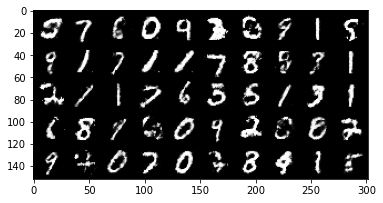

Iter: 88610/100000, Gen loss: 1.1764, Dis loss: 1.1196
Iter: 88620/100000, Gen loss: 1.2559, Dis loss: 1.0256
Iter: 88630/100000, Gen loss: 1.4586, Dis loss: 0.9741
Iter: 88640/100000, Gen loss: 1.3619, Dis loss: 0.9681
Iter: 88650/100000, Gen loss: 1.3122, Dis loss: 1.1398
Iter: 88660/100000, Gen loss: 1.2595, Dis loss: 0.9411
Iter: 88670/100000, Gen loss: 1.4082, Dis loss: 1.1424
Iter: 88680/100000, Gen loss: 1.4056, Dis loss: 1.0571
Iter: 88690/100000, Gen loss: 1.1230, Dis loss: 0.9345
Iter: 88700/100000, Gen loss: 1.1927, Dis loss: 0.9344
Iter: 88710/100000, Gen loss: 1.1458, Dis loss: 0.7991
Iter: 88720/100000, Gen loss: 1.1822, Dis loss: 0.9705
Iter: 88730/100000, Gen loss: 1.2354, Dis loss: 0.9708
Iter: 88740/100000, Gen loss: 0.9289, Dis loss: 1.1412
Iter: 88750/100000, Gen loss: 1.2463, Dis loss: 0.9219
Iter: 88760/100000, Gen loss: 1.3194, Dis loss: 0.8531
Iter: 88770/100000, Gen loss: 1.2389, Dis loss: 0.9387
Iter: 88780/100000, Gen loss: 1.1160, Dis loss: 1.2159
Iter: 8879

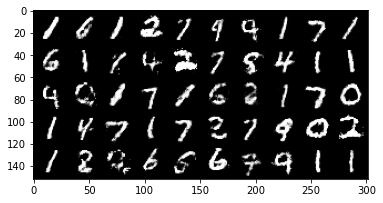

Iter: 88810/100000, Gen loss: 1.1183, Dis loss: 0.9455
Iter: 88820/100000, Gen loss: 1.4025, Dis loss: 0.9195
Iter: 88830/100000, Gen loss: 1.2937, Dis loss: 1.1474
Iter: 88840/100000, Gen loss: 1.2186, Dis loss: 1.0676
Iter: 88850/100000, Gen loss: 1.1983, Dis loss: 0.8925
Iter: 88860/100000, Gen loss: 1.2420, Dis loss: 0.9720
Iter: 88870/100000, Gen loss: 1.5228, Dis loss: 0.9477
Iter: 88880/100000, Gen loss: 1.2792, Dis loss: 0.8550
Iter: 88890/100000, Gen loss: 1.0940, Dis loss: 0.9989
Iter: 88900/100000, Gen loss: 1.3948, Dis loss: 1.0747
Iter: 88910/100000, Gen loss: 1.1067, Dis loss: 0.7861
Iter: 88920/100000, Gen loss: 1.2108, Dis loss: 1.0353
Iter: 88930/100000, Gen loss: 1.1129, Dis loss: 1.0535
Iter: 88940/100000, Gen loss: 1.2084, Dis loss: 1.3063
Iter: 88950/100000, Gen loss: 1.1186, Dis loss: 0.8639
Iter: 88960/100000, Gen loss: 1.0626, Dis loss: 0.9879
Iter: 88970/100000, Gen loss: 1.0391, Dis loss: 0.9240
Iter: 88980/100000, Gen loss: 1.2970, Dis loss: 1.1345
Iter: 8899

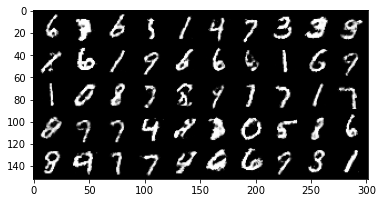

Iter: 89010/100000, Gen loss: 1.0834, Dis loss: 0.9986
Iter: 89020/100000, Gen loss: 1.0188, Dis loss: 1.0786
Iter: 89030/100000, Gen loss: 1.3728, Dis loss: 0.9571
Iter: 89040/100000, Gen loss: 1.4185, Dis loss: 0.9112
Iter: 89050/100000, Gen loss: 1.7359, Dis loss: 1.0428
Iter: 89060/100000, Gen loss: 1.3073, Dis loss: 1.0338
Iter: 89070/100000, Gen loss: 1.1453, Dis loss: 1.1105
Iter: 89080/100000, Gen loss: 1.1304, Dis loss: 1.0217
Iter: 89090/100000, Gen loss: 1.2086, Dis loss: 1.0448
Iter: 89100/100000, Gen loss: 1.1302, Dis loss: 1.0823
Iter: 89110/100000, Gen loss: 0.8065, Dis loss: 1.1702
Iter: 89120/100000, Gen loss: 1.0721, Dis loss: 0.9244
Iter: 89130/100000, Gen loss: 1.1831, Dis loss: 0.9033
Iter: 89140/100000, Gen loss: 1.3366, Dis loss: 0.9634
Iter: 89150/100000, Gen loss: 1.2472, Dis loss: 1.0998
Iter: 89160/100000, Gen loss: 1.3373, Dis loss: 1.0849
Iter: 89170/100000, Gen loss: 1.3154, Dis loss: 1.0010
Iter: 89180/100000, Gen loss: 1.2745, Dis loss: 0.8420
Iter: 8919

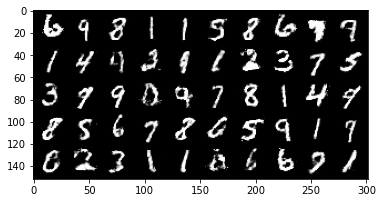

Iter: 89210/100000, Gen loss: 1.2088, Dis loss: 0.7173
Iter: 89220/100000, Gen loss: 1.1667, Dis loss: 0.8505
Iter: 89230/100000, Gen loss: 1.0716, Dis loss: 0.9992
Iter: 89240/100000, Gen loss: 0.8724, Dis loss: 1.1447
Iter: 89250/100000, Gen loss: 1.3424, Dis loss: 1.0970
Iter: 89260/100000, Gen loss: 1.1139, Dis loss: 1.1994
Iter: 89270/100000, Gen loss: 1.0177, Dis loss: 0.9434
Iter: 89280/100000, Gen loss: 1.1485, Dis loss: 0.7187
Iter: 89290/100000, Gen loss: 1.4577, Dis loss: 1.0224
Iter: 89300/100000, Gen loss: 1.3259, Dis loss: 0.9618
Iter: 89310/100000, Gen loss: 1.5916, Dis loss: 0.9364
Iter: 89320/100000, Gen loss: 1.3454, Dis loss: 1.0202
Iter: 89330/100000, Gen loss: 1.5221, Dis loss: 0.8910
Iter: 89340/100000, Gen loss: 1.3525, Dis loss: 1.0662
Iter: 89350/100000, Gen loss: 1.4703, Dis loss: 0.9966
Iter: 89360/100000, Gen loss: 1.2884, Dis loss: 0.9370
Iter: 89370/100000, Gen loss: 1.3452, Dis loss: 0.9598
Iter: 89380/100000, Gen loss: 1.4874, Dis loss: 1.0008
Iter: 8939

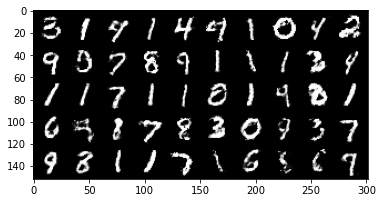

Iter: 89410/100000, Gen loss: 1.2132, Dis loss: 1.0703
Iter: 89420/100000, Gen loss: 1.1574, Dis loss: 1.0225
Iter: 89430/100000, Gen loss: 1.6358, Dis loss: 1.0977
Iter: 89440/100000, Gen loss: 1.4150, Dis loss: 1.0941
Iter: 89450/100000, Gen loss: 1.3007, Dis loss: 1.0602
Iter: 89460/100000, Gen loss: 1.2438, Dis loss: 1.0714
Iter: 89470/100000, Gen loss: 0.9450, Dis loss: 0.8088
Iter: 89480/100000, Gen loss: 1.2698, Dis loss: 0.8622
Iter: 89490/100000, Gen loss: 1.2380, Dis loss: 0.8753
Iter: 89500/100000, Gen loss: 1.3098, Dis loss: 0.9405
Iter: 89510/100000, Gen loss: 1.4480, Dis loss: 1.1776
Iter: 89520/100000, Gen loss: 1.1933, Dis loss: 1.2185
Iter: 89530/100000, Gen loss: 1.2166, Dis loss: 0.9992
Iter: 89540/100000, Gen loss: 1.2933, Dis loss: 1.2275
Iter: 89550/100000, Gen loss: 1.2148, Dis loss: 0.9957
Iter: 89560/100000, Gen loss: 1.3130, Dis loss: 0.8613
Iter: 89570/100000, Gen loss: 1.5826, Dis loss: 0.9998
Iter: 89580/100000, Gen loss: 1.4198, Dis loss: 1.2223
Iter: 8959

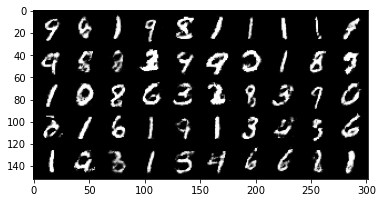

Iter: 89610/100000, Gen loss: 1.2272, Dis loss: 1.1475
Iter: 89620/100000, Gen loss: 1.4364, Dis loss: 1.0649
Iter: 89630/100000, Gen loss: 1.4619, Dis loss: 1.0900
Iter: 89640/100000, Gen loss: 1.4755, Dis loss: 0.8459
Iter: 89650/100000, Gen loss: 1.4242, Dis loss: 0.8602
Iter: 89660/100000, Gen loss: 1.2165, Dis loss: 0.9582
Iter: 89670/100000, Gen loss: 1.3630, Dis loss: 0.8069
Iter: 89680/100000, Gen loss: 1.4473, Dis loss: 1.2162
Iter: 89690/100000, Gen loss: 1.2394, Dis loss: 0.7393
Iter: 89700/100000, Gen loss: 1.3988, Dis loss: 1.0995
Iter: 89710/100000, Gen loss: 1.7533, Dis loss: 1.1477
Iter: 89720/100000, Gen loss: 1.4217, Dis loss: 0.9835
Iter: 89730/100000, Gen loss: 1.5007, Dis loss: 1.0094
Iter: 89740/100000, Gen loss: 1.3727, Dis loss: 0.9516
Iter: 89750/100000, Gen loss: 1.2867, Dis loss: 0.8476
Iter: 89760/100000, Gen loss: 1.3971, Dis loss: 0.9401
Iter: 89770/100000, Gen loss: 1.5067, Dis loss: 0.9594
Iter: 89780/100000, Gen loss: 1.3303, Dis loss: 1.1239
Iter: 8979

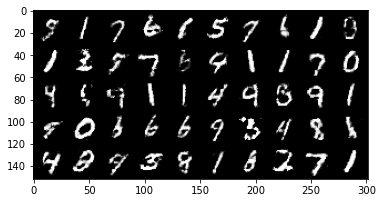

Iter: 89810/100000, Gen loss: 1.2451, Dis loss: 0.9913
Iter: 89820/100000, Gen loss: 1.2897, Dis loss: 0.9099
Iter: 89830/100000, Gen loss: 1.2282, Dis loss: 1.1174
Iter: 89840/100000, Gen loss: 1.3571, Dis loss: 1.0098
Iter: 89850/100000, Gen loss: 1.4570, Dis loss: 0.9881
Iter: 89860/100000, Gen loss: 1.2313, Dis loss: 1.0262
Iter: 89870/100000, Gen loss: 1.0222, Dis loss: 0.8455
Iter: 89880/100000, Gen loss: 1.2933, Dis loss: 1.1889
Iter: 89890/100000, Gen loss: 1.2693, Dis loss: 0.8511
Iter: 89900/100000, Gen loss: 1.1527, Dis loss: 1.0379
Iter: 89910/100000, Gen loss: 1.3244, Dis loss: 0.7520
Iter: 89920/100000, Gen loss: 1.4267, Dis loss: 1.3067
Iter: 89930/100000, Gen loss: 1.2400, Dis loss: 1.1378
Iter: 89940/100000, Gen loss: 1.5341, Dis loss: 0.7965
Iter: 89950/100000, Gen loss: 1.6126, Dis loss: 1.1855
Iter: 89960/100000, Gen loss: 1.3305, Dis loss: 1.0388
Iter: 89970/100000, Gen loss: 1.1103, Dis loss: 1.0199
Iter: 89980/100000, Gen loss: 1.2570, Dis loss: 0.9089
Iter: 8999

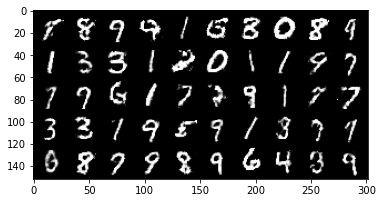

Iter: 90010/100000, Gen loss: 1.3815, Dis loss: 1.0802
Iter: 90020/100000, Gen loss: 1.2779, Dis loss: 1.1294
Iter: 90030/100000, Gen loss: 1.0612, Dis loss: 1.2460
Iter: 90040/100000, Gen loss: 1.2667, Dis loss: 0.8098
Iter: 90050/100000, Gen loss: 1.3003, Dis loss: 0.8888
Iter: 90060/100000, Gen loss: 1.3298, Dis loss: 0.8820
Iter: 90070/100000, Gen loss: 1.1865, Dis loss: 1.1454
Iter: 90080/100000, Gen loss: 1.4659, Dis loss: 0.9550
Iter: 90090/100000, Gen loss: 1.2992, Dis loss: 1.1483
Iter: 90100/100000, Gen loss: 1.3874, Dis loss: 0.8465
Iter: 90110/100000, Gen loss: 1.1520, Dis loss: 0.9104
Iter: 90120/100000, Gen loss: 1.1341, Dis loss: 0.8792
Iter: 90130/100000, Gen loss: 0.8639, Dis loss: 0.9443
Iter: 90140/100000, Gen loss: 1.0633, Dis loss: 1.0937
Iter: 90150/100000, Gen loss: 0.9758, Dis loss: 0.8896
Iter: 90160/100000, Gen loss: 1.3885, Dis loss: 0.9271
Iter: 90170/100000, Gen loss: 1.0859, Dis loss: 1.0205
Iter: 90180/100000, Gen loss: 1.2086, Dis loss: 0.8846
Iter: 9019

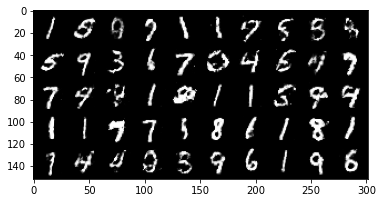

Iter: 90210/100000, Gen loss: 1.5845, Dis loss: 0.8495
Iter: 90220/100000, Gen loss: 1.2741, Dis loss: 1.0095
Iter: 90230/100000, Gen loss: 1.3753, Dis loss: 0.9515
Iter: 90240/100000, Gen loss: 1.1802, Dis loss: 0.9231
Iter: 90250/100000, Gen loss: 1.2531, Dis loss: 1.0498
Iter: 90260/100000, Gen loss: 1.0017, Dis loss: 0.9764
Iter: 90270/100000, Gen loss: 1.2427, Dis loss: 0.8006
Iter: 90280/100000, Gen loss: 1.2697, Dis loss: 1.0149
Iter: 90290/100000, Gen loss: 1.1500, Dis loss: 0.9525
Iter: 90300/100000, Gen loss: 1.2635, Dis loss: 0.8610
Iter: 90310/100000, Gen loss: 1.4516, Dis loss: 1.0170
Iter: 90320/100000, Gen loss: 1.4851, Dis loss: 1.1026
Iter: 90330/100000, Gen loss: 1.4704, Dis loss: 1.2876
Iter: 90340/100000, Gen loss: 1.4363, Dis loss: 0.8242
Iter: 90350/100000, Gen loss: 1.4512, Dis loss: 1.0666
Iter: 90360/100000, Gen loss: 1.3781, Dis loss: 1.2114
Iter: 90370/100000, Gen loss: 1.2639, Dis loss: 0.8756
Iter: 90380/100000, Gen loss: 1.4036, Dis loss: 0.9003
Iter: 9039

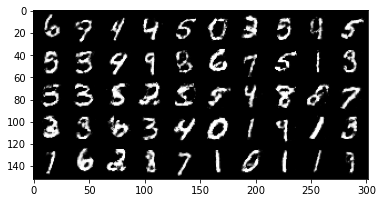

Iter: 90410/100000, Gen loss: 1.2963, Dis loss: 1.0594
Iter: 90420/100000, Gen loss: 1.3842, Dis loss: 1.1038
Iter: 90430/100000, Gen loss: 1.2890, Dis loss: 0.9839
Iter: 90440/100000, Gen loss: 1.1601, Dis loss: 0.8689
Iter: 90450/100000, Gen loss: 1.1151, Dis loss: 1.1758
Iter: 90460/100000, Gen loss: 1.1189, Dis loss: 1.0408
Iter: 90470/100000, Gen loss: 1.5741, Dis loss: 1.1221
Iter: 90480/100000, Gen loss: 1.4068, Dis loss: 0.9600
Iter: 90490/100000, Gen loss: 1.1680, Dis loss: 1.0285
Iter: 90500/100000, Gen loss: 1.2108, Dis loss: 0.9089
Iter: 90510/100000, Gen loss: 1.1028, Dis loss: 0.9949
Iter: 90520/100000, Gen loss: 0.9909, Dis loss: 1.0487
Iter: 90530/100000, Gen loss: 1.0390, Dis loss: 0.9929
Iter: 90540/100000, Gen loss: 1.2025, Dis loss: 1.0766
Iter: 90550/100000, Gen loss: 1.0584, Dis loss: 1.0226
Iter: 90560/100000, Gen loss: 1.2499, Dis loss: 1.2098
Iter: 90570/100000, Gen loss: 1.2007, Dis loss: 1.1092
Iter: 90580/100000, Gen loss: 1.4638, Dis loss: 0.9138
Iter: 9059

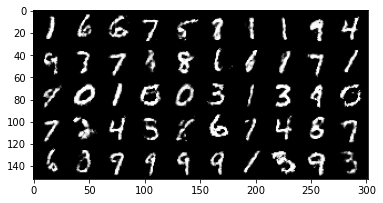

Iter: 90610/100000, Gen loss: 1.5060, Dis loss: 1.1516
Iter: 90620/100000, Gen loss: 1.5711, Dis loss: 1.0224
Iter: 90630/100000, Gen loss: 1.2288, Dis loss: 0.8787
Iter: 90640/100000, Gen loss: 1.2062, Dis loss: 0.9317
Iter: 90650/100000, Gen loss: 1.1899, Dis loss: 1.0177
Iter: 90660/100000, Gen loss: 1.1258, Dis loss: 0.9979
Iter: 90670/100000, Gen loss: 1.1289, Dis loss: 0.9591
Iter: 90680/100000, Gen loss: 1.5029, Dis loss: 0.8844
Iter: 90690/100000, Gen loss: 1.1699, Dis loss: 0.9388
Iter: 90700/100000, Gen loss: 1.2216, Dis loss: 1.1117
Iter: 90710/100000, Gen loss: 1.0800, Dis loss: 0.9673
Iter: 90720/100000, Gen loss: 1.0837, Dis loss: 1.0146
Iter: 90730/100000, Gen loss: 1.3774, Dis loss: 0.9362
Iter: 90740/100000, Gen loss: 1.2788, Dis loss: 1.1237
Iter: 90750/100000, Gen loss: 1.2174, Dis loss: 1.0774
Iter: 90760/100000, Gen loss: 1.4333, Dis loss: 0.9796
Iter: 90770/100000, Gen loss: 1.2861, Dis loss: 1.0082
Iter: 90780/100000, Gen loss: 1.3144, Dis loss: 1.2964
Iter: 9079

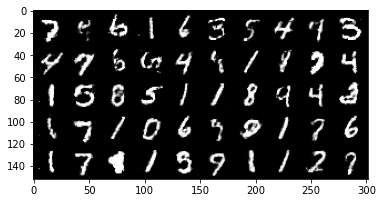

Iter: 90810/100000, Gen loss: 1.1709, Dis loss: 1.0706
Iter: 90820/100000, Gen loss: 1.0323, Dis loss: 1.1469
Iter: 90830/100000, Gen loss: 1.1215, Dis loss: 0.9638
Iter: 90840/100000, Gen loss: 0.9375, Dis loss: 1.0810
Iter: 90850/100000, Gen loss: 1.0739, Dis loss: 1.1752
Iter: 90860/100000, Gen loss: 1.0566, Dis loss: 1.0032
Iter: 90870/100000, Gen loss: 1.2741, Dis loss: 1.0763
Iter: 90880/100000, Gen loss: 1.2691, Dis loss: 0.7996
Iter: 90890/100000, Gen loss: 1.3511, Dis loss: 0.7541
Iter: 90900/100000, Gen loss: 0.9650, Dis loss: 1.0317
Iter: 90910/100000, Gen loss: 1.0698, Dis loss: 0.9833
Iter: 90920/100000, Gen loss: 1.2811, Dis loss: 0.8074
Iter: 90930/100000, Gen loss: 1.2356, Dis loss: 1.0612
Iter: 90940/100000, Gen loss: 1.1941, Dis loss: 0.8759
Iter: 90950/100000, Gen loss: 1.3562, Dis loss: 0.8997
Iter: 90960/100000, Gen loss: 1.1387, Dis loss: 1.0056
Iter: 90970/100000, Gen loss: 1.1783, Dis loss: 0.9546
Iter: 90980/100000, Gen loss: 1.1677, Dis loss: 1.0471
Iter: 9099

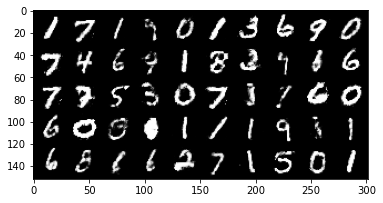

Iter: 91010/100000, Gen loss: 1.1488, Dis loss: 0.8440
Iter: 91020/100000, Gen loss: 0.9542, Dis loss: 1.0002
Iter: 91030/100000, Gen loss: 0.8456, Dis loss: 0.9779
Iter: 91040/100000, Gen loss: 1.2239, Dis loss: 0.8486
Iter: 91050/100000, Gen loss: 1.1892, Dis loss: 0.9639
Iter: 91060/100000, Gen loss: 1.1913, Dis loss: 0.8218
Iter: 91070/100000, Gen loss: 1.5058, Dis loss: 1.0979
Iter: 91080/100000, Gen loss: 1.5327, Dis loss: 1.0059
Iter: 91090/100000, Gen loss: 1.0548, Dis loss: 1.0186
Iter: 91100/100000, Gen loss: 1.0893, Dis loss: 1.2081
Iter: 91110/100000, Gen loss: 1.0463, Dis loss: 1.0487
Iter: 91120/100000, Gen loss: 1.1195, Dis loss: 0.9565
Iter: 91130/100000, Gen loss: 1.1279, Dis loss: 0.9547
Iter: 91140/100000, Gen loss: 1.1255, Dis loss: 0.9331
Iter: 91150/100000, Gen loss: 1.2875, Dis loss: 0.9635
Iter: 91160/100000, Gen loss: 1.2317, Dis loss: 0.9237
Iter: 91170/100000, Gen loss: 1.2457, Dis loss: 1.2546
Iter: 91180/100000, Gen loss: 1.3020, Dis loss: 1.0173
Iter: 9119

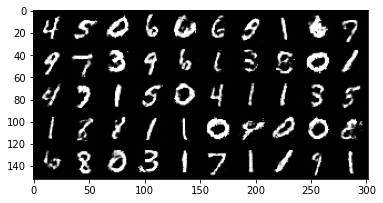

Iter: 91210/100000, Gen loss: 1.3787, Dis loss: 1.0894
Iter: 91220/100000, Gen loss: 1.5314, Dis loss: 1.0828
Iter: 91230/100000, Gen loss: 1.2086, Dis loss: 0.8067
Iter: 91240/100000, Gen loss: 1.2288, Dis loss: 0.9317
Iter: 91250/100000, Gen loss: 1.1763, Dis loss: 1.1278
Iter: 91260/100000, Gen loss: 1.1414, Dis loss: 0.8975
Iter: 91270/100000, Gen loss: 1.2131, Dis loss: 0.9416
Iter: 91280/100000, Gen loss: 1.4331, Dis loss: 1.0259
Iter: 91290/100000, Gen loss: 1.2868, Dis loss: 0.9990
Iter: 91300/100000, Gen loss: 1.3494, Dis loss: 1.0366
Iter: 91310/100000, Gen loss: 1.4156, Dis loss: 0.9369
Iter: 91320/100000, Gen loss: 1.4444, Dis loss: 1.1213
Iter: 91330/100000, Gen loss: 1.2362, Dis loss: 1.1387
Iter: 91340/100000, Gen loss: 0.9926, Dis loss: 1.1120
Iter: 91350/100000, Gen loss: 1.1544, Dis loss: 1.1093
Iter: 91360/100000, Gen loss: 1.3045, Dis loss: 0.8988
Iter: 91370/100000, Gen loss: 1.4726, Dis loss: 1.0844
Iter: 91380/100000, Gen loss: 1.3060, Dis loss: 1.1247
Iter: 9139

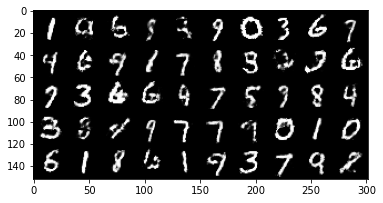

Iter: 91410/100000, Gen loss: 1.3512, Dis loss: 1.1469
Iter: 91420/100000, Gen loss: 1.2738, Dis loss: 0.9371
Iter: 91430/100000, Gen loss: 1.0069, Dis loss: 0.9828
Iter: 91440/100000, Gen loss: 1.0699, Dis loss: 1.0639
Iter: 91450/100000, Gen loss: 1.1379, Dis loss: 0.9170
Iter: 91460/100000, Gen loss: 1.1933, Dis loss: 0.9201
Iter: 91470/100000, Gen loss: 1.3455, Dis loss: 1.1434
Iter: 91480/100000, Gen loss: 1.6189, Dis loss: 1.0080
Iter: 91490/100000, Gen loss: 1.1529, Dis loss: 1.1821
Iter: 91500/100000, Gen loss: 1.1433, Dis loss: 0.9793
Iter: 91510/100000, Gen loss: 1.0450, Dis loss: 1.0301
Iter: 91520/100000, Gen loss: 1.0842, Dis loss: 0.9697
Iter: 91530/100000, Gen loss: 1.4165, Dis loss: 1.0274
Iter: 91540/100000, Gen loss: 1.1912, Dis loss: 1.0772
Iter: 91550/100000, Gen loss: 1.3307, Dis loss: 1.1424
Iter: 91560/100000, Gen loss: 1.3308, Dis loss: 0.9057
Iter: 91570/100000, Gen loss: 1.0880, Dis loss: 0.8963
Iter: 91580/100000, Gen loss: 1.4063, Dis loss: 0.7658
Iter: 9159

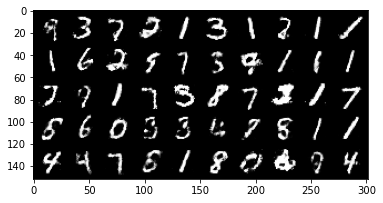

Iter: 91610/100000, Gen loss: 1.1120, Dis loss: 1.0000
Iter: 91620/100000, Gen loss: 1.3686, Dis loss: 1.0349
Iter: 91630/100000, Gen loss: 1.3004, Dis loss: 0.8961
Iter: 91640/100000, Gen loss: 1.0352, Dis loss: 0.7986
Iter: 91650/100000, Gen loss: 0.9276, Dis loss: 1.0530
Iter: 91660/100000, Gen loss: 1.3716, Dis loss: 0.9786
Iter: 91670/100000, Gen loss: 1.2570, Dis loss: 0.9836
Iter: 91680/100000, Gen loss: 0.9617, Dis loss: 0.8875
Iter: 91690/100000, Gen loss: 1.4423, Dis loss: 0.8940
Iter: 91700/100000, Gen loss: 1.1333, Dis loss: 0.9647
Iter: 91710/100000, Gen loss: 1.3574, Dis loss: 0.9194
Iter: 91720/100000, Gen loss: 1.1528, Dis loss: 0.9315
Iter: 91730/100000, Gen loss: 1.0159, Dis loss: 0.9862
Iter: 91740/100000, Gen loss: 1.1554, Dis loss: 0.9525
Iter: 91750/100000, Gen loss: 1.0266, Dis loss: 1.0013
Iter: 91760/100000, Gen loss: 0.9283, Dis loss: 0.8137
Iter: 91770/100000, Gen loss: 1.0733, Dis loss: 1.3010
Iter: 91780/100000, Gen loss: 1.1585, Dis loss: 1.2273
Iter: 9179

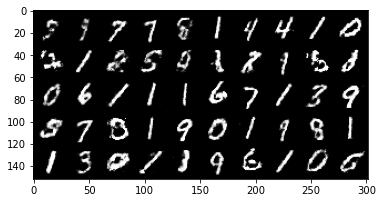

Iter: 91810/100000, Gen loss: 1.2819, Dis loss: 1.0206
Iter: 91820/100000, Gen loss: 0.9830, Dis loss: 1.0403
Iter: 91830/100000, Gen loss: 1.4499, Dis loss: 1.1059
Iter: 91840/100000, Gen loss: 1.2784, Dis loss: 0.9611
Iter: 91850/100000, Gen loss: 1.2802, Dis loss: 0.8324
Iter: 91860/100000, Gen loss: 1.0835, Dis loss: 1.1744
Iter: 91870/100000, Gen loss: 0.9951, Dis loss: 0.8774
Iter: 91880/100000, Gen loss: 1.1883, Dis loss: 1.0005
Iter: 91890/100000, Gen loss: 1.4255, Dis loss: 1.0397
Iter: 91900/100000, Gen loss: 1.0605, Dis loss: 0.8811
Iter: 91910/100000, Gen loss: 1.2198, Dis loss: 0.9433
Iter: 91920/100000, Gen loss: 1.1609, Dis loss: 0.9688
Iter: 91930/100000, Gen loss: 1.1594, Dis loss: 1.0109
Iter: 91940/100000, Gen loss: 1.3657, Dis loss: 0.9131
Iter: 91950/100000, Gen loss: 1.0278, Dis loss: 0.9656
Iter: 91960/100000, Gen loss: 1.2462, Dis loss: 0.9223
Iter: 91970/100000, Gen loss: 1.0449, Dis loss: 1.0872
Iter: 91980/100000, Gen loss: 1.2643, Dis loss: 1.2183
Iter: 9199

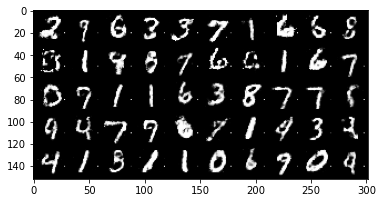

Iter: 92010/100000, Gen loss: 1.4100, Dis loss: 0.9227
Iter: 92020/100000, Gen loss: 1.5074, Dis loss: 0.8399
Iter: 92030/100000, Gen loss: 1.3756, Dis loss: 0.7827
Iter: 92040/100000, Gen loss: 1.3507, Dis loss: 1.0863
Iter: 92050/100000, Gen loss: 1.2451, Dis loss: 0.9352
Iter: 92060/100000, Gen loss: 1.6889, Dis loss: 1.1423
Iter: 92070/100000, Gen loss: 1.4350, Dis loss: 1.0960
Iter: 92080/100000, Gen loss: 1.4555, Dis loss: 1.0413
Iter: 92090/100000, Gen loss: 1.3653, Dis loss: 0.8207
Iter: 92100/100000, Gen loss: 1.2264, Dis loss: 1.1333
Iter: 92110/100000, Gen loss: 1.2846, Dis loss: 0.7113
Iter: 92120/100000, Gen loss: 1.0354, Dis loss: 0.8414
Iter: 92130/100000, Gen loss: 1.1110, Dis loss: 0.8638
Iter: 92140/100000, Gen loss: 0.9188, Dis loss: 1.0516
Iter: 92150/100000, Gen loss: 1.2262, Dis loss: 1.1404
Iter: 92160/100000, Gen loss: 1.5302, Dis loss: 0.9687
Iter: 92170/100000, Gen loss: 1.1112, Dis loss: 0.9873
Iter: 92180/100000, Gen loss: 1.1410, Dis loss: 0.8097
Iter: 9219

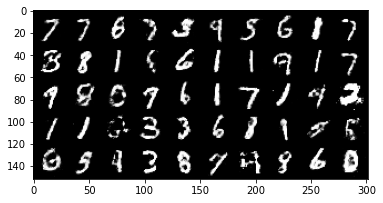

Iter: 92210/100000, Gen loss: 1.3711, Dis loss: 0.8914
Iter: 92220/100000, Gen loss: 1.2386, Dis loss: 0.8766
Iter: 92230/100000, Gen loss: 1.1932, Dis loss: 0.9956
Iter: 92240/100000, Gen loss: 1.2941, Dis loss: 1.0909
Iter: 92250/100000, Gen loss: 0.9698, Dis loss: 0.9041
Iter: 92260/100000, Gen loss: 0.8328, Dis loss: 1.0233
Iter: 92270/100000, Gen loss: 1.0543, Dis loss: 1.0541
Iter: 92280/100000, Gen loss: 0.9995, Dis loss: 1.0403
Iter: 92290/100000, Gen loss: 1.0237, Dis loss: 1.0994
Iter: 92300/100000, Gen loss: 1.0715, Dis loss: 1.3144
Iter: 92310/100000, Gen loss: 1.1184, Dis loss: 0.9284
Iter: 92320/100000, Gen loss: 1.2356, Dis loss: 0.8094
Iter: 92330/100000, Gen loss: 1.2571, Dis loss: 0.9758
Iter: 92340/100000, Gen loss: 1.3232, Dis loss: 1.1339
Iter: 92350/100000, Gen loss: 1.2985, Dis loss: 1.1462
Iter: 92360/100000, Gen loss: 1.3247, Dis loss: 0.9847
Iter: 92370/100000, Gen loss: 1.4148, Dis loss: 1.0746
Iter: 92380/100000, Gen loss: 1.5932, Dis loss: 0.8018
Iter: 9239

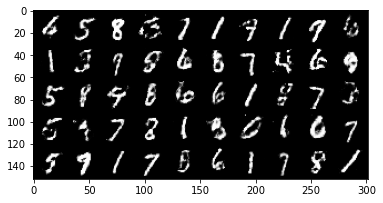

Iter: 92410/100000, Gen loss: 1.6716, Dis loss: 0.9252
Iter: 92420/100000, Gen loss: 1.4304, Dis loss: 1.2278
Iter: 92430/100000, Gen loss: 1.3650, Dis loss: 0.9362
Iter: 92440/100000, Gen loss: 1.2628, Dis loss: 1.0306
Iter: 92450/100000, Gen loss: 1.4743, Dis loss: 1.1035
Iter: 92460/100000, Gen loss: 1.1815, Dis loss: 0.8716
Iter: 92470/100000, Gen loss: 1.4777, Dis loss: 0.9213
Iter: 92480/100000, Gen loss: 1.3589, Dis loss: 0.8308
Iter: 92490/100000, Gen loss: 1.3745, Dis loss: 0.9214
Iter: 92500/100000, Gen loss: 1.3365, Dis loss: 0.8943
Iter: 92510/100000, Gen loss: 1.4487, Dis loss: 0.8636
Iter: 92520/100000, Gen loss: 1.0833, Dis loss: 1.0213
Iter: 92530/100000, Gen loss: 1.1151, Dis loss: 1.0015
Iter: 92540/100000, Gen loss: 1.1724, Dis loss: 1.0247
Iter: 92550/100000, Gen loss: 1.3923, Dis loss: 1.0085
Iter: 92560/100000, Gen loss: 1.0068, Dis loss: 1.0004
Iter: 92570/100000, Gen loss: 1.3803, Dis loss: 0.8733
Iter: 92580/100000, Gen loss: 1.3772, Dis loss: 0.8238
Iter: 9259

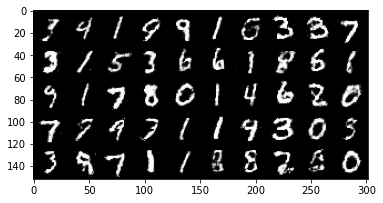

Iter: 92610/100000, Gen loss: 1.4206, Dis loss: 0.8745
Iter: 92620/100000, Gen loss: 1.3068, Dis loss: 1.0560
Iter: 92630/100000, Gen loss: 0.9995, Dis loss: 1.1167
Iter: 92640/100000, Gen loss: 1.2840, Dis loss: 0.8047
Iter: 92650/100000, Gen loss: 1.1613, Dis loss: 0.9809
Iter: 92660/100000, Gen loss: 1.2834, Dis loss: 0.8064
Iter: 92670/100000, Gen loss: 1.1448, Dis loss: 1.2138
Iter: 92680/100000, Gen loss: 1.0464, Dis loss: 0.9954
Iter: 92690/100000, Gen loss: 1.2830, Dis loss: 0.8639
Iter: 92700/100000, Gen loss: 1.2169, Dis loss: 0.9244
Iter: 92710/100000, Gen loss: 1.1564, Dis loss: 0.8100
Iter: 92720/100000, Gen loss: 1.2237, Dis loss: 0.8313
Iter: 92730/100000, Gen loss: 0.9216, Dis loss: 1.2416
Iter: 92740/100000, Gen loss: 1.0229, Dis loss: 0.9867
Iter: 92750/100000, Gen loss: 1.2001, Dis loss: 1.0775
Iter: 92760/100000, Gen loss: 1.2064, Dis loss: 1.1101
Iter: 92770/100000, Gen loss: 1.2342, Dis loss: 0.9883
Iter: 92780/100000, Gen loss: 1.2835, Dis loss: 1.0622
Iter: 9279

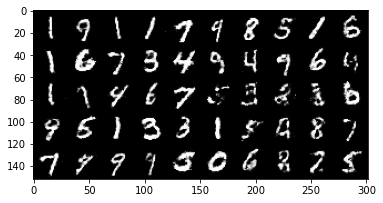

Iter: 92810/100000, Gen loss: 1.3861, Dis loss: 0.9877
Iter: 92820/100000, Gen loss: 1.2120, Dis loss: 0.9364
Iter: 92830/100000, Gen loss: 1.5595, Dis loss: 0.9500
Iter: 92840/100000, Gen loss: 1.7451, Dis loss: 1.0461
Iter: 92850/100000, Gen loss: 1.2946, Dis loss: 1.1771
Iter: 92860/100000, Gen loss: 0.9911, Dis loss: 1.0363
Iter: 92870/100000, Gen loss: 1.2857, Dis loss: 1.1058
Iter: 92880/100000, Gen loss: 1.1897, Dis loss: 0.8082
Iter: 92890/100000, Gen loss: 1.3956, Dis loss: 0.8599
Iter: 92900/100000, Gen loss: 0.8049, Dis loss: 1.0690
Iter: 92910/100000, Gen loss: 1.2381, Dis loss: 0.8887
Iter: 92920/100000, Gen loss: 1.0558, Dis loss: 0.9752
Iter: 92930/100000, Gen loss: 1.1746, Dis loss: 0.7554
Iter: 92940/100000, Gen loss: 1.3571, Dis loss: 0.9493
Iter: 92950/100000, Gen loss: 1.2373, Dis loss: 0.9248
Iter: 92960/100000, Gen loss: 1.3069, Dis loss: 0.9183
Iter: 92970/100000, Gen loss: 1.2717, Dis loss: 0.9024
Iter: 92980/100000, Gen loss: 1.1636, Dis loss: 1.0054
Iter: 9299

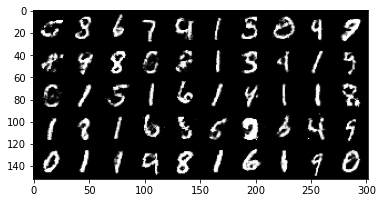

Iter: 93010/100000, Gen loss: 1.2729, Dis loss: 0.9280
Iter: 93020/100000, Gen loss: 1.1329, Dis loss: 0.9719
Iter: 93030/100000, Gen loss: 0.9051, Dis loss: 0.8271
Iter: 93040/100000, Gen loss: 1.2194, Dis loss: 0.7690
Iter: 93050/100000, Gen loss: 1.2123, Dis loss: 0.8902
Iter: 93060/100000, Gen loss: 1.2224, Dis loss: 1.0054
Iter: 93070/100000, Gen loss: 1.2248, Dis loss: 0.9115
Iter: 93080/100000, Gen loss: 1.0013, Dis loss: 0.9880
Iter: 93090/100000, Gen loss: 1.1282, Dis loss: 1.0831
Iter: 93100/100000, Gen loss: 1.1902, Dis loss: 0.9161
Iter: 93110/100000, Gen loss: 1.4272, Dis loss: 1.0705
Iter: 93120/100000, Gen loss: 1.0547, Dis loss: 1.0460
Iter: 93130/100000, Gen loss: 1.3642, Dis loss: 0.9588
Iter: 93140/100000, Gen loss: 1.3451, Dis loss: 1.1356
Iter: 93150/100000, Gen loss: 0.9732, Dis loss: 1.0703
Iter: 93160/100000, Gen loss: 1.0928, Dis loss: 1.0507
Iter: 93170/100000, Gen loss: 1.0283, Dis loss: 0.9921
Iter: 93180/100000, Gen loss: 1.3848, Dis loss: 0.8804
Iter: 9319

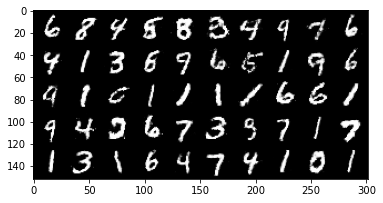

Iter: 93210/100000, Gen loss: 1.3720, Dis loss: 1.1534
Iter: 93220/100000, Gen loss: 1.2478, Dis loss: 0.8430
Iter: 93230/100000, Gen loss: 1.4043, Dis loss: 1.0045
Iter: 93240/100000, Gen loss: 0.9855, Dis loss: 0.9917
Iter: 93250/100000, Gen loss: 0.9427, Dis loss: 0.7879
Iter: 93260/100000, Gen loss: 0.9537, Dis loss: 1.1171
Iter: 93270/100000, Gen loss: 1.0079, Dis loss: 0.8875
Iter: 93280/100000, Gen loss: 1.1064, Dis loss: 1.0231
Iter: 93290/100000, Gen loss: 1.0803, Dis loss: 1.1446
Iter: 93300/100000, Gen loss: 0.9652, Dis loss: 1.0683
Iter: 93310/100000, Gen loss: 1.0733, Dis loss: 0.9395
Iter: 93320/100000, Gen loss: 0.9741, Dis loss: 1.1953
Iter: 93330/100000, Gen loss: 1.1061, Dis loss: 1.0517
Iter: 93340/100000, Gen loss: 1.1718, Dis loss: 0.8332
Iter: 93350/100000, Gen loss: 1.1516, Dis loss: 1.0188
Iter: 93360/100000, Gen loss: 1.1655, Dis loss: 1.0465
Iter: 93370/100000, Gen loss: 1.2795, Dis loss: 0.9462
Iter: 93380/100000, Gen loss: 1.1391, Dis loss: 0.9896
Iter: 9339

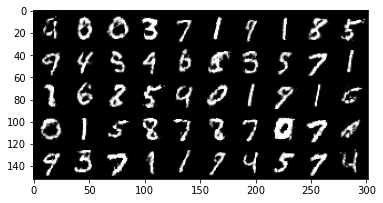

Iter: 93410/100000, Gen loss: 1.3085, Dis loss: 1.0146
Iter: 93420/100000, Gen loss: 1.1929, Dis loss: 1.0698
Iter: 93430/100000, Gen loss: 1.0694, Dis loss: 1.0445
Iter: 93440/100000, Gen loss: 1.3915, Dis loss: 1.1718
Iter: 93450/100000, Gen loss: 1.0665, Dis loss: 1.2129
Iter: 93460/100000, Gen loss: 1.5955, Dis loss: 0.9367
Iter: 93470/100000, Gen loss: 1.3596, Dis loss: 0.9071
Iter: 93480/100000, Gen loss: 1.3116, Dis loss: 0.7669
Iter: 93490/100000, Gen loss: 1.1339, Dis loss: 1.0169
Iter: 93500/100000, Gen loss: 0.9427, Dis loss: 0.9115
Iter: 93510/100000, Gen loss: 1.2016, Dis loss: 0.9991
Iter: 93520/100000, Gen loss: 1.1839, Dis loss: 0.8347
Iter: 93530/100000, Gen loss: 1.1539, Dis loss: 1.1780
Iter: 93540/100000, Gen loss: 1.5692, Dis loss: 1.1335
Iter: 93550/100000, Gen loss: 1.3380, Dis loss: 1.1276
Iter: 93560/100000, Gen loss: 1.3786, Dis loss: 0.9331
Iter: 93570/100000, Gen loss: 1.0667, Dis loss: 0.8674
Iter: 93580/100000, Gen loss: 1.3325, Dis loss: 0.9230
Iter: 9359

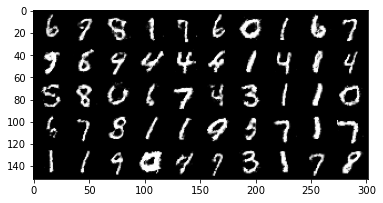

Iter: 93610/100000, Gen loss: 1.3405, Dis loss: 1.1574
Iter: 93620/100000, Gen loss: 1.0888, Dis loss: 1.0801
Iter: 93630/100000, Gen loss: 1.0273, Dis loss: 0.9193
Iter: 93640/100000, Gen loss: 1.3326, Dis loss: 0.9396
Iter: 93650/100000, Gen loss: 1.3120, Dis loss: 1.1556
Iter: 93660/100000, Gen loss: 1.1150, Dis loss: 1.1533
Iter: 93670/100000, Gen loss: 1.3334, Dis loss: 0.9973
Iter: 93680/100000, Gen loss: 1.3811, Dis loss: 1.0369
Iter: 93690/100000, Gen loss: 1.3085, Dis loss: 1.0620
Iter: 93700/100000, Gen loss: 1.3983, Dis loss: 0.9415
Iter: 93710/100000, Gen loss: 1.1824, Dis loss: 1.0075
Iter: 93720/100000, Gen loss: 1.6300, Dis loss: 1.0187
Iter: 93730/100000, Gen loss: 1.6187, Dis loss: 1.0302
Iter: 93740/100000, Gen loss: 1.0377, Dis loss: 0.9831
Iter: 93750/100000, Gen loss: 1.3627, Dis loss: 1.1113
Iter: 93760/100000, Gen loss: 1.1079, Dis loss: 0.8299
Iter: 93770/100000, Gen loss: 1.1482, Dis loss: 1.0881
Iter: 93780/100000, Gen loss: 1.3773, Dis loss: 1.0688
Iter: 9379

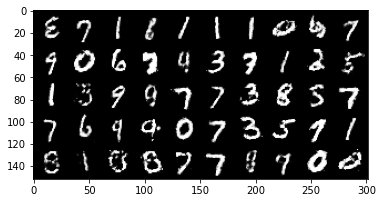

Iter: 93810/100000, Gen loss: 1.1856, Dis loss: 1.0609
Iter: 93820/100000, Gen loss: 1.0740, Dis loss: 0.9895
Iter: 93830/100000, Gen loss: 1.3058, Dis loss: 1.3846
Iter: 93840/100000, Gen loss: 1.1500, Dis loss: 0.9900
Iter: 93850/100000, Gen loss: 1.0283, Dis loss: 1.0244
Iter: 93860/100000, Gen loss: 0.9578, Dis loss: 1.0805
Iter: 93870/100000, Gen loss: 0.9871, Dis loss: 0.8513
Iter: 93880/100000, Gen loss: 1.0852, Dis loss: 0.9767
Iter: 93890/100000, Gen loss: 1.1665, Dis loss: 0.8157
Iter: 93900/100000, Gen loss: 1.3397, Dis loss: 0.8986
Iter: 93910/100000, Gen loss: 1.0101, Dis loss: 0.9810
Iter: 93920/100000, Gen loss: 0.8989, Dis loss: 1.0838
Iter: 93930/100000, Gen loss: 0.9925, Dis loss: 1.1591
Iter: 93940/100000, Gen loss: 1.1594, Dis loss: 0.9905
Iter: 93950/100000, Gen loss: 1.1517, Dis loss: 1.0113
Iter: 93960/100000, Gen loss: 0.9954, Dis loss: 1.1340
Iter: 93970/100000, Gen loss: 1.1919, Dis loss: 0.8968
Iter: 93980/100000, Gen loss: 1.1044, Dis loss: 1.0356
Iter: 9399

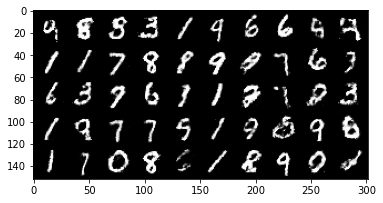

Iter: 94010/100000, Gen loss: 1.1051, Dis loss: 1.0329
Iter: 94020/100000, Gen loss: 1.3075, Dis loss: 0.9436
Iter: 94030/100000, Gen loss: 1.2878, Dis loss: 0.9064
Iter: 94040/100000, Gen loss: 1.0125, Dis loss: 1.1363
Iter: 94050/100000, Gen loss: 1.1318, Dis loss: 1.0665
Iter: 94060/100000, Gen loss: 1.3769, Dis loss: 1.1211
Iter: 94070/100000, Gen loss: 1.2112, Dis loss: 1.0226
Iter: 94080/100000, Gen loss: 1.1260, Dis loss: 1.0289
Iter: 94090/100000, Gen loss: 1.0036, Dis loss: 0.8818
Iter: 94100/100000, Gen loss: 1.0065, Dis loss: 0.8718
Iter: 94110/100000, Gen loss: 1.1566, Dis loss: 0.9386
Iter: 94120/100000, Gen loss: 1.0822, Dis loss: 0.9766
Iter: 94130/100000, Gen loss: 1.0465, Dis loss: 1.0770
Iter: 94140/100000, Gen loss: 1.1485, Dis loss: 0.9381
Iter: 94150/100000, Gen loss: 1.2811, Dis loss: 0.9754
Iter: 94160/100000, Gen loss: 1.1507, Dis loss: 0.7252
Iter: 94170/100000, Gen loss: 1.1010, Dis loss: 0.9106
Iter: 94180/100000, Gen loss: 0.8761, Dis loss: 0.8804
Iter: 9419

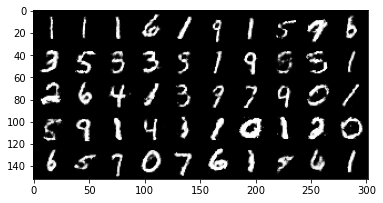

Iter: 94210/100000, Gen loss: 0.8966, Dis loss: 1.1005
Iter: 94220/100000, Gen loss: 1.2543, Dis loss: 1.0787
Iter: 94230/100000, Gen loss: 1.3555, Dis loss: 0.9498
Iter: 94240/100000, Gen loss: 1.5529, Dis loss: 0.9528
Iter: 94250/100000, Gen loss: 1.1386, Dis loss: 1.1215
Iter: 94260/100000, Gen loss: 1.1165, Dis loss: 1.0761
Iter: 94270/100000, Gen loss: 0.9591, Dis loss: 1.1343
Iter: 94280/100000, Gen loss: 1.0695, Dis loss: 1.1659
Iter: 94290/100000, Gen loss: 0.9227, Dis loss: 0.9534
Iter: 94300/100000, Gen loss: 1.0748, Dis loss: 1.0154
Iter: 94310/100000, Gen loss: 1.3835, Dis loss: 0.8642
Iter: 94320/100000, Gen loss: 0.9789, Dis loss: 1.0756
Iter: 94330/100000, Gen loss: 1.1028, Dis loss: 0.8606
Iter: 94340/100000, Gen loss: 1.3792, Dis loss: 1.1287
Iter: 94350/100000, Gen loss: 1.1312, Dis loss: 0.9507
Iter: 94360/100000, Gen loss: 1.0195, Dis loss: 0.9981
Iter: 94370/100000, Gen loss: 1.2457, Dis loss: 1.1884
Iter: 94380/100000, Gen loss: 1.0962, Dis loss: 1.1221
Iter: 9439

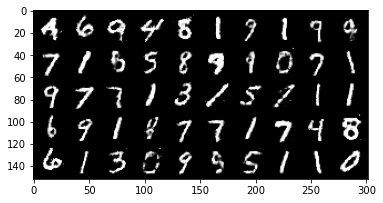

Iter: 94410/100000, Gen loss: 1.5436, Dis loss: 1.1214
Iter: 94420/100000, Gen loss: 1.3557, Dis loss: 1.1350
Iter: 94430/100000, Gen loss: 1.4501, Dis loss: 1.0490
Iter: 94440/100000, Gen loss: 1.1824, Dis loss: 0.9749
Iter: 94450/100000, Gen loss: 1.3672, Dis loss: 0.9073
Iter: 94460/100000, Gen loss: 1.3963, Dis loss: 1.1639
Iter: 94470/100000, Gen loss: 1.5084, Dis loss: 1.0230
Iter: 94480/100000, Gen loss: 1.1221, Dis loss: 0.9119
Iter: 94490/100000, Gen loss: 1.1655, Dis loss: 0.9530
Iter: 94500/100000, Gen loss: 1.2704, Dis loss: 0.9898
Iter: 94510/100000, Gen loss: 1.2684, Dis loss: 0.9995
Iter: 94520/100000, Gen loss: 1.0975, Dis loss: 1.2103
Iter: 94530/100000, Gen loss: 1.2727, Dis loss: 1.0333
Iter: 94540/100000, Gen loss: 1.4623, Dis loss: 1.0739
Iter: 94550/100000, Gen loss: 1.3075, Dis loss: 1.0235
Iter: 94560/100000, Gen loss: 1.1479, Dis loss: 1.0801
Iter: 94570/100000, Gen loss: 1.0723, Dis loss: 0.9827
Iter: 94580/100000, Gen loss: 1.3440, Dis loss: 0.9762
Iter: 9459

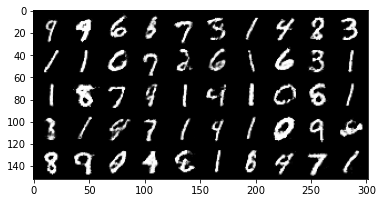

Iter: 94610/100000, Gen loss: 1.1421, Dis loss: 0.9640
Iter: 94620/100000, Gen loss: 1.2182, Dis loss: 0.9056
Iter: 94630/100000, Gen loss: 1.1441, Dis loss: 1.0392
Iter: 94640/100000, Gen loss: 1.4266, Dis loss: 0.8800
Iter: 94650/100000, Gen loss: 1.1626, Dis loss: 1.0152
Iter: 94660/100000, Gen loss: 1.5578, Dis loss: 1.0249
Iter: 94670/100000, Gen loss: 1.3733, Dis loss: 1.1130
Iter: 94680/100000, Gen loss: 1.1610, Dis loss: 1.0729
Iter: 94690/100000, Gen loss: 1.1281, Dis loss: 1.1624
Iter: 94700/100000, Gen loss: 1.2031, Dis loss: 0.9141
Iter: 94710/100000, Gen loss: 1.2302, Dis loss: 0.7252
Iter: 94720/100000, Gen loss: 1.5052, Dis loss: 0.9139
Iter: 94730/100000, Gen loss: 1.3404, Dis loss: 0.9474
Iter: 94740/100000, Gen loss: 1.4034, Dis loss: 0.9857
Iter: 94750/100000, Gen loss: 1.3731, Dis loss: 0.9468
Iter: 94760/100000, Gen loss: 1.1261, Dis loss: 1.1818
Iter: 94770/100000, Gen loss: 1.2390, Dis loss: 1.0411
Iter: 94780/100000, Gen loss: 1.4171, Dis loss: 1.1355
Iter: 9479

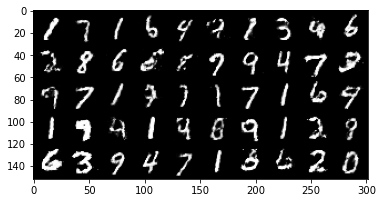

Iter: 94810/100000, Gen loss: 1.4035, Dis loss: 1.1441
Iter: 94820/100000, Gen loss: 1.2293, Dis loss: 1.0111
Iter: 94830/100000, Gen loss: 1.2006, Dis loss: 1.0660
Iter: 94840/100000, Gen loss: 1.3520, Dis loss: 0.8873
Iter: 94850/100000, Gen loss: 1.1886, Dis loss: 1.1573
Iter: 94860/100000, Gen loss: 1.3439, Dis loss: 0.9806
Iter: 94870/100000, Gen loss: 1.0883, Dis loss: 1.1632
Iter: 94880/100000, Gen loss: 1.2317, Dis loss: 1.2435
Iter: 94890/100000, Gen loss: 1.2421, Dis loss: 0.7733
Iter: 94900/100000, Gen loss: 0.9986, Dis loss: 1.0661
Iter: 94910/100000, Gen loss: 1.2230, Dis loss: 1.1158
Iter: 94920/100000, Gen loss: 1.1946, Dis loss: 0.9948
Iter: 94930/100000, Gen loss: 1.3941, Dis loss: 0.8848
Iter: 94940/100000, Gen loss: 1.3194, Dis loss: 1.0204
Iter: 94950/100000, Gen loss: 1.2146, Dis loss: 1.0108
Iter: 94960/100000, Gen loss: 1.3449, Dis loss: 1.0482
Iter: 94970/100000, Gen loss: 0.9593, Dis loss: 0.9287
Iter: 94980/100000, Gen loss: 0.9588, Dis loss: 1.1797
Iter: 9499

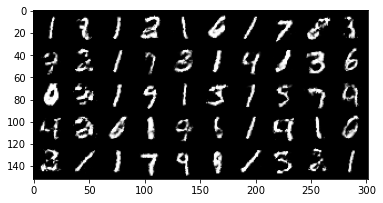

Iter: 95010/100000, Gen loss: 1.2529, Dis loss: 0.9828
Iter: 95020/100000, Gen loss: 1.2254, Dis loss: 1.0434
Iter: 95030/100000, Gen loss: 1.1634, Dis loss: 1.1371
Iter: 95040/100000, Gen loss: 1.5547, Dis loss: 0.9133
Iter: 95050/100000, Gen loss: 1.2335, Dis loss: 1.0580
Iter: 95060/100000, Gen loss: 1.2724, Dis loss: 1.0779
Iter: 95070/100000, Gen loss: 1.0882, Dis loss: 1.1111
Iter: 95080/100000, Gen loss: 1.3251, Dis loss: 0.9713
Iter: 95090/100000, Gen loss: 1.2442, Dis loss: 1.3137
Iter: 95100/100000, Gen loss: 1.4146, Dis loss: 0.9935
Iter: 95110/100000, Gen loss: 1.7494, Dis loss: 1.1925
Iter: 95120/100000, Gen loss: 1.6048, Dis loss: 1.2273
Iter: 95130/100000, Gen loss: 1.2720, Dis loss: 0.9238
Iter: 95140/100000, Gen loss: 1.5234, Dis loss: 1.3912
Iter: 95150/100000, Gen loss: 1.4206, Dis loss: 0.7904
Iter: 95160/100000, Gen loss: 1.3947, Dis loss: 0.8902
Iter: 95170/100000, Gen loss: 1.3765, Dis loss: 1.0296
Iter: 95180/100000, Gen loss: 1.0909, Dis loss: 1.0112
Iter: 9519

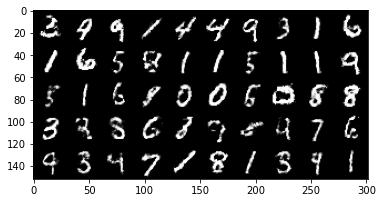

Iter: 95210/100000, Gen loss: 1.3634, Dis loss: 1.2016
Iter: 95220/100000, Gen loss: 1.1870, Dis loss: 1.1984
Iter: 95230/100000, Gen loss: 1.1231, Dis loss: 0.9718
Iter: 95240/100000, Gen loss: 1.1233, Dis loss: 1.1554
Iter: 95250/100000, Gen loss: 1.0117, Dis loss: 1.1792
Iter: 95260/100000, Gen loss: 1.0697, Dis loss: 1.1197
Iter: 95270/100000, Gen loss: 0.9902, Dis loss: 1.0876
Iter: 95280/100000, Gen loss: 1.2596, Dis loss: 0.8974
Iter: 95290/100000, Gen loss: 1.2019, Dis loss: 1.0589
Iter: 95300/100000, Gen loss: 1.1844, Dis loss: 1.0418
Iter: 95310/100000, Gen loss: 1.6250, Dis loss: 0.9323
Iter: 95320/100000, Gen loss: 1.4689, Dis loss: 1.1357
Iter: 95330/100000, Gen loss: 1.2157, Dis loss: 1.0083
Iter: 95340/100000, Gen loss: 1.0986, Dis loss: 1.4523
Iter: 95350/100000, Gen loss: 1.1134, Dis loss: 1.0374
Iter: 95360/100000, Gen loss: 1.2435, Dis loss: 1.0309
Iter: 95370/100000, Gen loss: 1.2834, Dis loss: 0.8079
Iter: 95380/100000, Gen loss: 1.1575, Dis loss: 0.9169
Iter: 9539

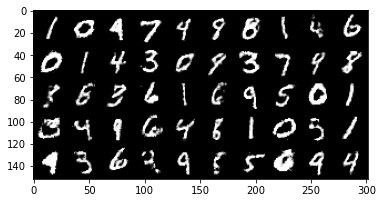

Iter: 95410/100000, Gen loss: 1.0399, Dis loss: 1.0120
Iter: 95420/100000, Gen loss: 0.9810, Dis loss: 0.9210
Iter: 95430/100000, Gen loss: 1.1923, Dis loss: 0.9843
Iter: 95440/100000, Gen loss: 1.1363, Dis loss: 1.0412
Iter: 95450/100000, Gen loss: 1.2309, Dis loss: 1.2333
Iter: 95460/100000, Gen loss: 1.2152, Dis loss: 0.8840
Iter: 95470/100000, Gen loss: 1.2898, Dis loss: 1.2341
Iter: 95480/100000, Gen loss: 1.1195, Dis loss: 1.0883
Iter: 95490/100000, Gen loss: 1.1505, Dis loss: 0.8381
Iter: 95500/100000, Gen loss: 1.0563, Dis loss: 0.9012
Iter: 95510/100000, Gen loss: 1.0779, Dis loss: 0.8961
Iter: 95520/100000, Gen loss: 1.2171, Dis loss: 0.9390
Iter: 95530/100000, Gen loss: 1.5435, Dis loss: 1.0598
Iter: 95540/100000, Gen loss: 1.1593, Dis loss: 0.9191
Iter: 95550/100000, Gen loss: 1.1295, Dis loss: 1.1067
Iter: 95560/100000, Gen loss: 1.0984, Dis loss: 1.0921
Iter: 95570/100000, Gen loss: 1.3603, Dis loss: 1.0060
Iter: 95580/100000, Gen loss: 1.2059, Dis loss: 0.8215
Iter: 9559

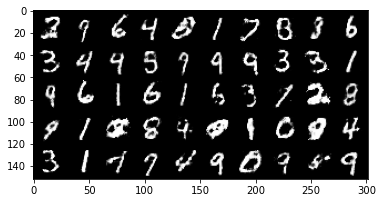

Iter: 95610/100000, Gen loss: 0.9275, Dis loss: 1.1144
Iter: 95620/100000, Gen loss: 1.0804, Dis loss: 1.0807
Iter: 95630/100000, Gen loss: 1.0326, Dis loss: 0.9098
Iter: 95640/100000, Gen loss: 1.0943, Dis loss: 1.1110
Iter: 95650/100000, Gen loss: 1.0682, Dis loss: 1.1702
Iter: 95660/100000, Gen loss: 0.8314, Dis loss: 0.8539
Iter: 95670/100000, Gen loss: 1.1867, Dis loss: 0.9349
Iter: 95680/100000, Gen loss: 1.2106, Dis loss: 0.9450
Iter: 95690/100000, Gen loss: 1.1030, Dis loss: 0.9535
Iter: 95700/100000, Gen loss: 1.0170, Dis loss: 0.9382
Iter: 95710/100000, Gen loss: 1.1709, Dis loss: 0.8590
Iter: 95720/100000, Gen loss: 1.0521, Dis loss: 1.0086
Iter: 95730/100000, Gen loss: 0.9192, Dis loss: 0.9237
Iter: 95740/100000, Gen loss: 1.2547, Dis loss: 0.9750
Iter: 95750/100000, Gen loss: 1.3218, Dis loss: 0.9647
Iter: 95760/100000, Gen loss: 1.2679, Dis loss: 1.0923
Iter: 95770/100000, Gen loss: 1.2342, Dis loss: 1.0939
Iter: 95780/100000, Gen loss: 1.0327, Dis loss: 1.0837
Iter: 9579

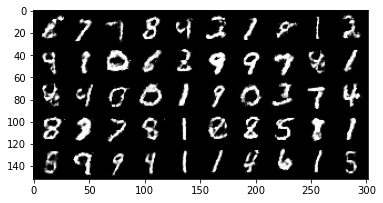

Iter: 95810/100000, Gen loss: 1.2834, Dis loss: 1.0928
Iter: 95820/100000, Gen loss: 1.0276, Dis loss: 1.0393
Iter: 95830/100000, Gen loss: 1.2680, Dis loss: 1.0611
Iter: 95840/100000, Gen loss: 1.1269, Dis loss: 1.2309
Iter: 95850/100000, Gen loss: 1.0327, Dis loss: 0.8875
Iter: 95860/100000, Gen loss: 1.2654, Dis loss: 1.1005
Iter: 95870/100000, Gen loss: 1.2955, Dis loss: 0.9256
Iter: 95880/100000, Gen loss: 0.9828, Dis loss: 0.9777
Iter: 95890/100000, Gen loss: 1.1499, Dis loss: 1.0788
Iter: 95900/100000, Gen loss: 1.0843, Dis loss: 0.9878
Iter: 95910/100000, Gen loss: 1.2875, Dis loss: 1.0020
Iter: 95920/100000, Gen loss: 1.1266, Dis loss: 0.9589
Iter: 95930/100000, Gen loss: 1.1776, Dis loss: 1.0521
Iter: 95940/100000, Gen loss: 1.0940, Dis loss: 1.0050
Iter: 95950/100000, Gen loss: 0.9450, Dis loss: 1.0086
Iter: 95960/100000, Gen loss: 0.7430, Dis loss: 1.1091
Iter: 95970/100000, Gen loss: 0.8402, Dis loss: 1.0832
Iter: 95980/100000, Gen loss: 0.9493, Dis loss: 0.9714
Iter: 9599

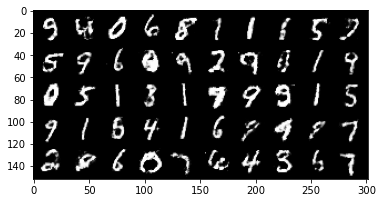

Iter: 96010/100000, Gen loss: 1.2350, Dis loss: 0.9647
Iter: 96020/100000, Gen loss: 0.9611, Dis loss: 0.9445
Iter: 96030/100000, Gen loss: 1.1203, Dis loss: 0.8818
Iter: 96040/100000, Gen loss: 1.0760, Dis loss: 1.1571
Iter: 96050/100000, Gen loss: 0.9670, Dis loss: 1.1868
Iter: 96060/100000, Gen loss: 0.9789, Dis loss: 0.9430
Iter: 96070/100000, Gen loss: 1.1160, Dis loss: 1.0055
Iter: 96080/100000, Gen loss: 1.1271, Dis loss: 1.2059
Iter: 96090/100000, Gen loss: 1.2035, Dis loss: 1.0778
Iter: 96100/100000, Gen loss: 1.3006, Dis loss: 1.0239
Iter: 96110/100000, Gen loss: 1.2642, Dis loss: 0.8955
Iter: 96120/100000, Gen loss: 1.0036, Dis loss: 1.0174
Iter: 96130/100000, Gen loss: 1.0382, Dis loss: 0.9252
Iter: 96140/100000, Gen loss: 1.1740, Dis loss: 1.0458
Iter: 96150/100000, Gen loss: 1.3158, Dis loss: 0.9555
Iter: 96160/100000, Gen loss: 0.9954, Dis loss: 1.1560
Iter: 96170/100000, Gen loss: 0.8741, Dis loss: 1.0877
Iter: 96180/100000, Gen loss: 1.2321, Dis loss: 0.9921
Iter: 9619

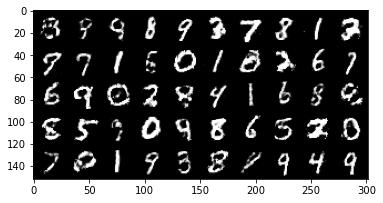

Iter: 96210/100000, Gen loss: 1.3892, Dis loss: 0.9323
Iter: 96220/100000, Gen loss: 1.3273, Dis loss: 0.9652
Iter: 96230/100000, Gen loss: 1.2005, Dis loss: 1.0276
Iter: 96240/100000, Gen loss: 1.4502, Dis loss: 1.0169
Iter: 96250/100000, Gen loss: 1.1378, Dis loss: 0.8746
Iter: 96260/100000, Gen loss: 1.2565, Dis loss: 1.0376
Iter: 96270/100000, Gen loss: 1.1231, Dis loss: 0.9242
Iter: 96280/100000, Gen loss: 1.3909, Dis loss: 1.1279
Iter: 96290/100000, Gen loss: 1.3989, Dis loss: 1.0659
Iter: 96300/100000, Gen loss: 1.2875, Dis loss: 1.0460
Iter: 96310/100000, Gen loss: 1.4223, Dis loss: 1.1694
Iter: 96320/100000, Gen loss: 1.2841, Dis loss: 1.1891
Iter: 96330/100000, Gen loss: 1.1673, Dis loss: 0.9739
Iter: 96340/100000, Gen loss: 1.4342, Dis loss: 0.9252
Iter: 96350/100000, Gen loss: 1.2223, Dis loss: 0.9178
Iter: 96360/100000, Gen loss: 1.4537, Dis loss: 1.0380
Iter: 96370/100000, Gen loss: 1.3654, Dis loss: 0.9370
Iter: 96380/100000, Gen loss: 1.3834, Dis loss: 0.9054
Iter: 9639

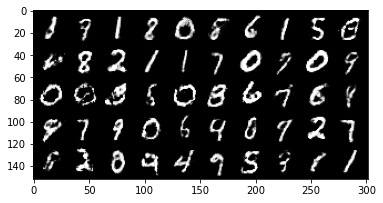

Iter: 96410/100000, Gen loss: 1.2624, Dis loss: 0.9551
Iter: 96420/100000, Gen loss: 1.2878, Dis loss: 1.0261
Iter: 96430/100000, Gen loss: 1.2570, Dis loss: 1.2586
Iter: 96440/100000, Gen loss: 1.1245, Dis loss: 1.1800
Iter: 96450/100000, Gen loss: 1.1763, Dis loss: 1.0653
Iter: 96460/100000, Gen loss: 1.0100, Dis loss: 1.0928
Iter: 96470/100000, Gen loss: 1.1319, Dis loss: 0.9095
Iter: 96480/100000, Gen loss: 1.0837, Dis loss: 1.0597
Iter: 96490/100000, Gen loss: 1.0183, Dis loss: 1.0373
Iter: 96500/100000, Gen loss: 1.0996, Dis loss: 0.9373
Iter: 96510/100000, Gen loss: 0.8786, Dis loss: 1.0109
Iter: 96520/100000, Gen loss: 0.9937, Dis loss: 1.0213
Iter: 96530/100000, Gen loss: 1.1557, Dis loss: 0.8827
Iter: 96540/100000, Gen loss: 0.8472, Dis loss: 0.8781
Iter: 96550/100000, Gen loss: 0.9580, Dis loss: 1.1649
Iter: 96560/100000, Gen loss: 0.8785, Dis loss: 0.9718
Iter: 96570/100000, Gen loss: 1.0259, Dis loss: 0.9454
Iter: 96580/100000, Gen loss: 1.2339, Dis loss: 0.9223
Iter: 9659

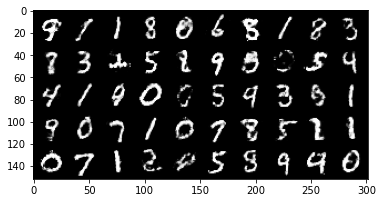

Iter: 96610/100000, Gen loss: 1.1525, Dis loss: 1.0686
Iter: 96620/100000, Gen loss: 1.1197, Dis loss: 0.9916
Iter: 96630/100000, Gen loss: 1.0769, Dis loss: 0.8535
Iter: 96640/100000, Gen loss: 1.0262, Dis loss: 0.9685
Iter: 96650/100000, Gen loss: 1.4588, Dis loss: 1.1072
Iter: 96660/100000, Gen loss: 1.2346, Dis loss: 0.8930
Iter: 96670/100000, Gen loss: 1.2856, Dis loss: 0.7706
Iter: 96680/100000, Gen loss: 1.3953, Dis loss: 1.2298
Iter: 96690/100000, Gen loss: 1.3614, Dis loss: 1.0575
Iter: 96700/100000, Gen loss: 1.1793, Dis loss: 1.1597
Iter: 96710/100000, Gen loss: 1.2402, Dis loss: 1.1021
Iter: 96720/100000, Gen loss: 1.4091, Dis loss: 1.2449
Iter: 96730/100000, Gen loss: 1.1149, Dis loss: 1.3456
Iter: 96740/100000, Gen loss: 1.0078, Dis loss: 1.1892
Iter: 96750/100000, Gen loss: 1.2376, Dis loss: 1.0718
Iter: 96760/100000, Gen loss: 1.3072, Dis loss: 1.1462
Iter: 96770/100000, Gen loss: 1.3471, Dis loss: 0.9421
Iter: 96780/100000, Gen loss: 1.4184, Dis loss: 0.7754
Iter: 9679

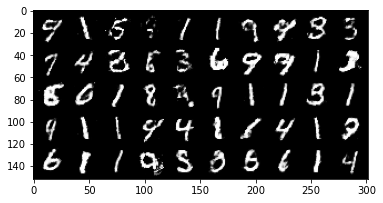

Iter: 96810/100000, Gen loss: 1.2006, Dis loss: 0.9428
Iter: 96820/100000, Gen loss: 1.1756, Dis loss: 0.9180
Iter: 96830/100000, Gen loss: 0.9607, Dis loss: 1.0985
Iter: 96840/100000, Gen loss: 0.9964, Dis loss: 0.7625
Iter: 96850/100000, Gen loss: 0.9758, Dis loss: 1.0633
Iter: 96860/100000, Gen loss: 1.0824, Dis loss: 1.0439
Iter: 96870/100000, Gen loss: 1.1708, Dis loss: 0.8960
Iter: 96880/100000, Gen loss: 1.2173, Dis loss: 1.0461
Iter: 96890/100000, Gen loss: 1.0747, Dis loss: 1.0594
Iter: 96900/100000, Gen loss: 1.3540, Dis loss: 0.9632
Iter: 96910/100000, Gen loss: 1.2544, Dis loss: 1.0132
Iter: 96920/100000, Gen loss: 0.9587, Dis loss: 1.0975
Iter: 96930/100000, Gen loss: 1.1036, Dis loss: 0.9212
Iter: 96940/100000, Gen loss: 1.2426, Dis loss: 0.9471
Iter: 96950/100000, Gen loss: 1.1878, Dis loss: 1.1850
Iter: 96960/100000, Gen loss: 1.1359, Dis loss: 0.9064
Iter: 96970/100000, Gen loss: 1.4164, Dis loss: 1.2242
Iter: 96980/100000, Gen loss: 1.1619, Dis loss: 1.0646
Iter: 9699

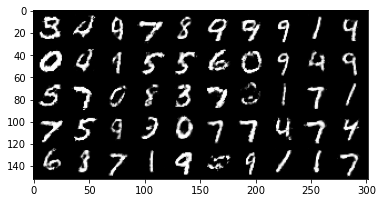

Iter: 97010/100000, Gen loss: 1.1212, Dis loss: 1.1482
Iter: 97020/100000, Gen loss: 1.3493, Dis loss: 1.1637
Iter: 97030/100000, Gen loss: 1.0893, Dis loss: 1.1124
Iter: 97040/100000, Gen loss: 1.0289, Dis loss: 1.1960
Iter: 97050/100000, Gen loss: 1.2877, Dis loss: 0.8588
Iter: 97060/100000, Gen loss: 1.2405, Dis loss: 0.9591
Iter: 97070/100000, Gen loss: 1.2971, Dis loss: 0.9754
Iter: 97080/100000, Gen loss: 1.3752, Dis loss: 1.0412
Iter: 97090/100000, Gen loss: 1.1025, Dis loss: 0.9416
Iter: 97100/100000, Gen loss: 0.8993, Dis loss: 1.0665
Iter: 97110/100000, Gen loss: 1.2347, Dis loss: 1.2899
Iter: 97120/100000, Gen loss: 1.2894, Dis loss: 0.9639
Iter: 97130/100000, Gen loss: 1.2971, Dis loss: 1.1198
Iter: 97140/100000, Gen loss: 1.2911, Dis loss: 0.8674
Iter: 97150/100000, Gen loss: 0.9203, Dis loss: 1.1575
Iter: 97160/100000, Gen loss: 1.2618, Dis loss: 1.4090
Iter: 97170/100000, Gen loss: 1.1257, Dis loss: 1.0528
Iter: 97180/100000, Gen loss: 1.1882, Dis loss: 1.2436
Iter: 9719

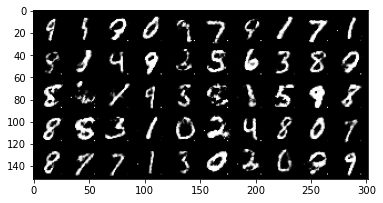

Iter: 97210/100000, Gen loss: 1.5133, Dis loss: 0.8283
Iter: 97220/100000, Gen loss: 1.1839, Dis loss: 0.8662
Iter: 97230/100000, Gen loss: 1.4987, Dis loss: 1.0030
Iter: 97240/100000, Gen loss: 1.3276, Dis loss: 0.8284
Iter: 97250/100000, Gen loss: 1.1728, Dis loss: 1.2965
Iter: 97260/100000, Gen loss: 1.2291, Dis loss: 0.9974
Iter: 97270/100000, Gen loss: 1.2414, Dis loss: 0.8803
Iter: 97280/100000, Gen loss: 1.2775, Dis loss: 1.0828
Iter: 97290/100000, Gen loss: 1.4657, Dis loss: 0.8760
Iter: 97300/100000, Gen loss: 1.5425, Dis loss: 0.9608
Iter: 97310/100000, Gen loss: 1.5307, Dis loss: 0.8539
Iter: 97320/100000, Gen loss: 1.5186, Dis loss: 0.9811
Iter: 97330/100000, Gen loss: 1.1645, Dis loss: 1.0831
Iter: 97340/100000, Gen loss: 1.1306, Dis loss: 0.7907
Iter: 97350/100000, Gen loss: 1.1247, Dis loss: 1.0952
Iter: 97360/100000, Gen loss: 1.2531, Dis loss: 0.9667
Iter: 97370/100000, Gen loss: 1.1356, Dis loss: 0.9199
Iter: 97380/100000, Gen loss: 1.3541, Dis loss: 1.0468
Iter: 9739

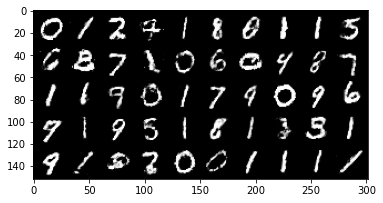

Iter: 97410/100000, Gen loss: 1.1540, Dis loss: 0.7763
Iter: 97420/100000, Gen loss: 1.1632, Dis loss: 0.9805
Iter: 97430/100000, Gen loss: 1.1489, Dis loss: 1.1026
Iter: 97440/100000, Gen loss: 1.0475, Dis loss: 0.9411
Iter: 97450/100000, Gen loss: 0.9771, Dis loss: 1.0518
Iter: 97460/100000, Gen loss: 1.4238, Dis loss: 1.0755
Iter: 97470/100000, Gen loss: 1.3472, Dis loss: 1.0910
Iter: 97480/100000, Gen loss: 1.1824, Dis loss: 0.9034
Iter: 97490/100000, Gen loss: 1.0626, Dis loss: 1.1045
Iter: 97500/100000, Gen loss: 1.0456, Dis loss: 0.9131
Iter: 97510/100000, Gen loss: 1.2118, Dis loss: 0.8997
Iter: 97520/100000, Gen loss: 1.2800, Dis loss: 1.1521
Iter: 97530/100000, Gen loss: 1.3452, Dis loss: 1.1485
Iter: 97540/100000, Gen loss: 1.1581, Dis loss: 0.9287
Iter: 97550/100000, Gen loss: 1.1882, Dis loss: 0.9340
Iter: 97560/100000, Gen loss: 0.8705, Dis loss: 0.8667
Iter: 97570/100000, Gen loss: 0.9409, Dis loss: 0.9790
Iter: 97580/100000, Gen loss: 1.2956, Dis loss: 1.1913
Iter: 9759

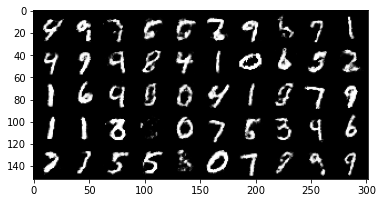

Iter: 97610/100000, Gen loss: 1.2429, Dis loss: 1.1403
Iter: 97620/100000, Gen loss: 1.1128, Dis loss: 0.9059
Iter: 97630/100000, Gen loss: 1.0063, Dis loss: 0.9716
Iter: 97640/100000, Gen loss: 1.0948, Dis loss: 0.9227
Iter: 97650/100000, Gen loss: 1.1690, Dis loss: 0.8747
Iter: 97660/100000, Gen loss: 1.6454, Dis loss: 0.8293
Iter: 97670/100000, Gen loss: 1.5415, Dis loss: 1.0053
Iter: 97680/100000, Gen loss: 1.4756, Dis loss: 0.9704
Iter: 97690/100000, Gen loss: 1.0560, Dis loss: 0.9478
Iter: 97700/100000, Gen loss: 1.2410, Dis loss: 0.9963
Iter: 97710/100000, Gen loss: 1.5100, Dis loss: 1.0416
Iter: 97720/100000, Gen loss: 1.2124, Dis loss: 1.0407
Iter: 97730/100000, Gen loss: 1.1838, Dis loss: 1.0390
Iter: 97740/100000, Gen loss: 0.9157, Dis loss: 0.9219
Iter: 97750/100000, Gen loss: 1.0254, Dis loss: 1.1458
Iter: 97760/100000, Gen loss: 1.0996, Dis loss: 0.8964
Iter: 97770/100000, Gen loss: 1.0670, Dis loss: 1.1225
Iter: 97780/100000, Gen loss: 1.3412, Dis loss: 0.8983
Iter: 9779

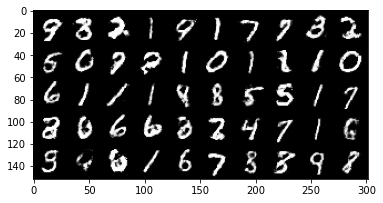

Iter: 97810/100000, Gen loss: 1.0785, Dis loss: 0.9482
Iter: 97820/100000, Gen loss: 1.1974, Dis loss: 1.0556
Iter: 97830/100000, Gen loss: 1.1869, Dis loss: 1.1070
Iter: 97840/100000, Gen loss: 1.0064, Dis loss: 0.9381
Iter: 97850/100000, Gen loss: 1.3163, Dis loss: 0.9997
Iter: 97860/100000, Gen loss: 1.4612, Dis loss: 0.9855
Iter: 97870/100000, Gen loss: 1.5871, Dis loss: 0.9452
Iter: 97880/100000, Gen loss: 1.4310, Dis loss: 0.7145
Iter: 97890/100000, Gen loss: 1.4705, Dis loss: 1.2022
Iter: 97900/100000, Gen loss: 1.3704, Dis loss: 0.8706
Iter: 97910/100000, Gen loss: 1.3109, Dis loss: 1.2504
Iter: 97920/100000, Gen loss: 1.7282, Dis loss: 1.1495
Iter: 97930/100000, Gen loss: 1.3578, Dis loss: 1.0001
Iter: 97940/100000, Gen loss: 0.9771, Dis loss: 0.9614
Iter: 97950/100000, Gen loss: 0.9470, Dis loss: 1.0442
Iter: 97960/100000, Gen loss: 0.9012, Dis loss: 0.9995
Iter: 97970/100000, Gen loss: 1.2428, Dis loss: 1.2196
Iter: 97980/100000, Gen loss: 1.1651, Dis loss: 1.0580
Iter: 9799

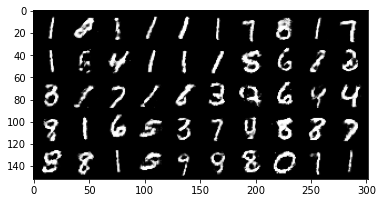

Iter: 98010/100000, Gen loss: 1.1327, Dis loss: 1.1333
Iter: 98020/100000, Gen loss: 1.1427, Dis loss: 0.8081
Iter: 98030/100000, Gen loss: 1.1419, Dis loss: 1.1030
Iter: 98040/100000, Gen loss: 1.0496, Dis loss: 0.7795
Iter: 98050/100000, Gen loss: 1.0236, Dis loss: 1.1355
Iter: 98060/100000, Gen loss: 1.0126, Dis loss: 1.0815
Iter: 98070/100000, Gen loss: 0.9906, Dis loss: 1.0087
Iter: 98080/100000, Gen loss: 0.9005, Dis loss: 0.8808
Iter: 98090/100000, Gen loss: 0.9949, Dis loss: 1.1567
Iter: 98100/100000, Gen loss: 1.1419, Dis loss: 0.9674
Iter: 98110/100000, Gen loss: 1.2996, Dis loss: 0.8017
Iter: 98120/100000, Gen loss: 1.4988, Dis loss: 1.0853
Iter: 98130/100000, Gen loss: 1.3991, Dis loss: 1.0388
Iter: 98140/100000, Gen loss: 1.3356, Dis loss: 0.9129
Iter: 98150/100000, Gen loss: 1.0363, Dis loss: 1.0283
Iter: 98160/100000, Gen loss: 1.0323, Dis loss: 1.0891
Iter: 98170/100000, Gen loss: 1.1212, Dis loss: 0.9263
Iter: 98180/100000, Gen loss: 1.0735, Dis loss: 0.9750
Iter: 9819

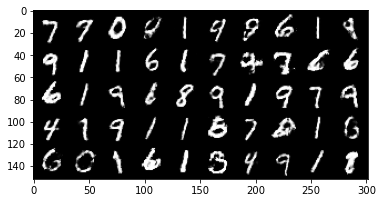

Iter: 98210/100000, Gen loss: 1.3670, Dis loss: 0.9433
Iter: 98220/100000, Gen loss: 0.9981, Dis loss: 0.9457
Iter: 98230/100000, Gen loss: 1.3162, Dis loss: 1.0330
Iter: 98240/100000, Gen loss: 1.3326, Dis loss: 1.1633
Iter: 98250/100000, Gen loss: 1.2320, Dis loss: 1.0972
Iter: 98260/100000, Gen loss: 0.9949, Dis loss: 1.1412
Iter: 98270/100000, Gen loss: 1.2642, Dis loss: 1.0641
Iter: 98280/100000, Gen loss: 0.9113, Dis loss: 1.0478
Iter: 98290/100000, Gen loss: 0.8330, Dis loss: 1.1002
Iter: 98300/100000, Gen loss: 1.0042, Dis loss: 1.0907
Iter: 98310/100000, Gen loss: 1.1050, Dis loss: 1.0556
Iter: 98320/100000, Gen loss: 1.0268, Dis loss: 1.0157
Iter: 98330/100000, Gen loss: 0.9553, Dis loss: 0.9071
Iter: 98340/100000, Gen loss: 0.9633, Dis loss: 1.1100
Iter: 98350/100000, Gen loss: 1.0775, Dis loss: 1.1613
Iter: 98360/100000, Gen loss: 1.1006, Dis loss: 0.9009
Iter: 98370/100000, Gen loss: 1.1240, Dis loss: 0.9161
Iter: 98380/100000, Gen loss: 0.9403, Dis loss: 0.8883
Iter: 9839

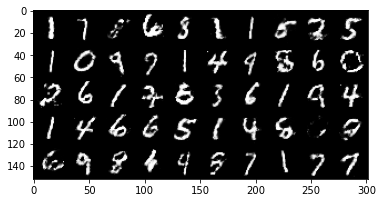

Iter: 98410/100000, Gen loss: 1.0417, Dis loss: 1.0875
Iter: 98420/100000, Gen loss: 0.9944, Dis loss: 0.8842
Iter: 98430/100000, Gen loss: 1.3700, Dis loss: 1.0037
Iter: 98440/100000, Gen loss: 1.1708, Dis loss: 0.8870
Iter: 98450/100000, Gen loss: 1.2924, Dis loss: 1.0514
Iter: 98460/100000, Gen loss: 1.1281, Dis loss: 1.0122
Iter: 98470/100000, Gen loss: 1.1138, Dis loss: 0.9388
Iter: 98480/100000, Gen loss: 1.0818, Dis loss: 1.0745
Iter: 98490/100000, Gen loss: 1.0583, Dis loss: 0.9955
Iter: 98500/100000, Gen loss: 1.2136, Dis loss: 1.0317
Iter: 98510/100000, Gen loss: 1.1253, Dis loss: 1.1758
Iter: 98520/100000, Gen loss: 0.9859, Dis loss: 0.8915
Iter: 98530/100000, Gen loss: 0.9226, Dis loss: 1.2488
Iter: 98540/100000, Gen loss: 1.1611, Dis loss: 0.9696
Iter: 98550/100000, Gen loss: 1.0701, Dis loss: 1.2495
Iter: 98560/100000, Gen loss: 1.2518, Dis loss: 1.2787
Iter: 98570/100000, Gen loss: 1.1944, Dis loss: 0.8782
Iter: 98580/100000, Gen loss: 1.3151, Dis loss: 0.8315
Iter: 9859

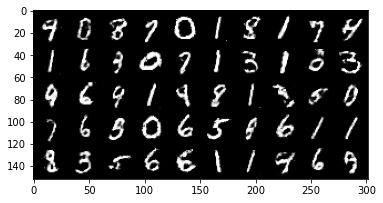

Iter: 98610/100000, Gen loss: 1.2091, Dis loss: 1.0343
Iter: 98620/100000, Gen loss: 1.1064, Dis loss: 1.3426
Iter: 98630/100000, Gen loss: 1.0788, Dis loss: 1.1322
Iter: 98640/100000, Gen loss: 1.1709, Dis loss: 0.8610
Iter: 98650/100000, Gen loss: 1.1810, Dis loss: 1.1433
Iter: 98660/100000, Gen loss: 1.1159, Dis loss: 1.2037
Iter: 98670/100000, Gen loss: 1.2642, Dis loss: 1.0446
Iter: 98680/100000, Gen loss: 1.2457, Dis loss: 0.9212
Iter: 98690/100000, Gen loss: 1.5109, Dis loss: 1.1076
Iter: 98700/100000, Gen loss: 1.4706, Dis loss: 1.0504
Iter: 98710/100000, Gen loss: 1.2844, Dis loss: 0.9410
Iter: 98720/100000, Gen loss: 1.1754, Dis loss: 0.7957
Iter: 98730/100000, Gen loss: 1.1670, Dis loss: 0.9956
Iter: 98740/100000, Gen loss: 1.1292, Dis loss: 1.0348
Iter: 98750/100000, Gen loss: 1.1075, Dis loss: 1.1720
Iter: 98760/100000, Gen loss: 1.2944, Dis loss: 1.0076
Iter: 98770/100000, Gen loss: 1.2262, Dis loss: 1.1355
Iter: 98780/100000, Gen loss: 0.9145, Dis loss: 1.3146
Iter: 9879

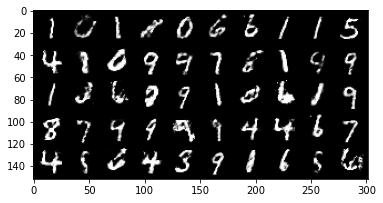

Iter: 98810/100000, Gen loss: 1.0257, Dis loss: 1.0464
Iter: 98820/100000, Gen loss: 1.1917, Dis loss: 1.1973
Iter: 98830/100000, Gen loss: 1.1790, Dis loss: 1.3032
Iter: 98840/100000, Gen loss: 1.2848, Dis loss: 1.2078
Iter: 98850/100000, Gen loss: 1.2226, Dis loss: 1.3587
Iter: 98860/100000, Gen loss: 1.1531, Dis loss: 1.4431
Iter: 98870/100000, Gen loss: 1.1263, Dis loss: 1.5596
Iter: 98880/100000, Gen loss: 0.9865, Dis loss: 0.9857
Iter: 98890/100000, Gen loss: 0.9483, Dis loss: 0.9948
Iter: 98900/100000, Gen loss: 1.2301, Dis loss: 0.9482
Iter: 98910/100000, Gen loss: 1.3217, Dis loss: 0.8403
Iter: 98920/100000, Gen loss: 1.2089, Dis loss: 0.8281
Iter: 98930/100000, Gen loss: 1.3706, Dis loss: 0.8357
Iter: 98940/100000, Gen loss: 1.4323, Dis loss: 0.8406
Iter: 98950/100000, Gen loss: 1.0931, Dis loss: 0.8097
Iter: 98960/100000, Gen loss: 1.0276, Dis loss: 0.8930
Iter: 98970/100000, Gen loss: 1.0716, Dis loss: 0.9140
Iter: 98980/100000, Gen loss: 1.3723, Dis loss: 0.9643
Iter: 9899

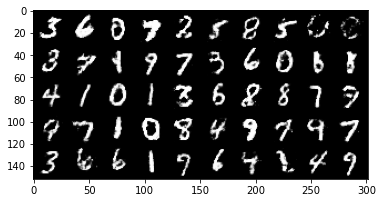

Iter: 99010/100000, Gen loss: 1.3944, Dis loss: 1.0056
Iter: 99020/100000, Gen loss: 1.2484, Dis loss: 0.9130
Iter: 99030/100000, Gen loss: 1.1948, Dis loss: 1.0026
Iter: 99040/100000, Gen loss: 1.2202, Dis loss: 0.9771
Iter: 99050/100000, Gen loss: 1.1482, Dis loss: 0.9955
Iter: 99060/100000, Gen loss: 1.1270, Dis loss: 1.0301
Iter: 99070/100000, Gen loss: 1.2516, Dis loss: 1.1061
Iter: 99080/100000, Gen loss: 0.9610, Dis loss: 1.2900
Iter: 99090/100000, Gen loss: 1.0166, Dis loss: 1.0054
Iter: 99100/100000, Gen loss: 1.2104, Dis loss: 0.8930
Iter: 99110/100000, Gen loss: 1.0061, Dis loss: 1.0898
Iter: 99120/100000, Gen loss: 1.2847, Dis loss: 0.9242
Iter: 99130/100000, Gen loss: 1.3958, Dis loss: 1.0400
Iter: 99140/100000, Gen loss: 1.0866, Dis loss: 1.0116
Iter: 99150/100000, Gen loss: 1.2606, Dis loss: 0.9281
Iter: 99160/100000, Gen loss: 1.1694, Dis loss: 0.8845
Iter: 99170/100000, Gen loss: 1.0763, Dis loss: 1.1061
Iter: 99180/100000, Gen loss: 1.2563, Dis loss: 1.0887
Iter: 9919

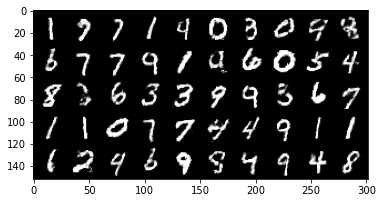

Iter: 99210/100000, Gen loss: 1.5287, Dis loss: 1.1963
Iter: 99220/100000, Gen loss: 1.2230, Dis loss: 1.0700
Iter: 99230/100000, Gen loss: 1.2650, Dis loss: 1.1010
Iter: 99240/100000, Gen loss: 1.2178, Dis loss: 1.0703
Iter: 99250/100000, Gen loss: 1.2430, Dis loss: 0.9352
Iter: 99260/100000, Gen loss: 1.0392, Dis loss: 0.8943
Iter: 99270/100000, Gen loss: 1.2765, Dis loss: 1.0251
Iter: 99280/100000, Gen loss: 1.1833, Dis loss: 1.0111
Iter: 99290/100000, Gen loss: 1.2118, Dis loss: 1.0602
Iter: 99300/100000, Gen loss: 1.2103, Dis loss: 0.9325
Iter: 99310/100000, Gen loss: 1.4628, Dis loss: 1.1049
Iter: 99320/100000, Gen loss: 1.1338, Dis loss: 1.0054
Iter: 99330/100000, Gen loss: 1.1652, Dis loss: 1.1012
Iter: 99340/100000, Gen loss: 1.3137, Dis loss: 1.1399
Iter: 99350/100000, Gen loss: 1.3117, Dis loss: 0.9336
Iter: 99360/100000, Gen loss: 1.0595, Dis loss: 1.1096
Iter: 99370/100000, Gen loss: 1.3672, Dis loss: 0.9169
Iter: 99380/100000, Gen loss: 1.3272, Dis loss: 1.0598
Iter: 9939

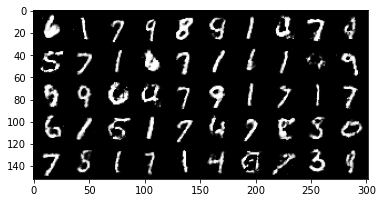

Iter: 99410/100000, Gen loss: 1.3222, Dis loss: 0.9663
Iter: 99420/100000, Gen loss: 1.1544, Dis loss: 1.0056
Iter: 99430/100000, Gen loss: 1.2004, Dis loss: 1.0410
Iter: 99440/100000, Gen loss: 1.3027, Dis loss: 0.8170
Iter: 99450/100000, Gen loss: 1.3549, Dis loss: 1.2639
Iter: 99460/100000, Gen loss: 1.5143, Dis loss: 0.9985
Iter: 99470/100000, Gen loss: 1.2578, Dis loss: 1.1117
Iter: 99480/100000, Gen loss: 1.2761, Dis loss: 1.1174
Iter: 99490/100000, Gen loss: 1.5440, Dis loss: 0.9062
Iter: 99500/100000, Gen loss: 1.1963, Dis loss: 1.2018
Iter: 99510/100000, Gen loss: 1.0517, Dis loss: 1.1488
Iter: 99520/100000, Gen loss: 1.0695, Dis loss: 0.9658
Iter: 99530/100000, Gen loss: 1.1851, Dis loss: 0.9943
Iter: 99540/100000, Gen loss: 1.1140, Dis loss: 0.9322
Iter: 99550/100000, Gen loss: 1.3738, Dis loss: 1.1195
Iter: 99560/100000, Gen loss: 0.8957, Dis loss: 1.0035
Iter: 99570/100000, Gen loss: 1.2323, Dis loss: 1.0097
Iter: 99580/100000, Gen loss: 1.2575, Dis loss: 1.0857
Iter: 9959

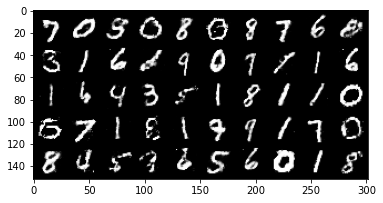

Iter: 99610/100000, Gen loss: 1.4338, Dis loss: 1.0511
Iter: 99620/100000, Gen loss: 1.4997, Dis loss: 1.0521
Iter: 99630/100000, Gen loss: 1.0794, Dis loss: 1.0648
Iter: 99640/100000, Gen loss: 1.0633, Dis loss: 1.0559
Iter: 99650/100000, Gen loss: 1.3270, Dis loss: 1.1107
Iter: 99660/100000, Gen loss: 0.9133, Dis loss: 1.2421
Iter: 99670/100000, Gen loss: 1.2658, Dis loss: 0.9113
Iter: 99680/100000, Gen loss: 1.5344, Dis loss: 0.9739
Iter: 99690/100000, Gen loss: 1.4702, Dis loss: 1.1491
Iter: 99700/100000, Gen loss: 1.1781, Dis loss: 1.0201
Iter: 99710/100000, Gen loss: 1.1315, Dis loss: 1.1965
Iter: 99720/100000, Gen loss: 1.1889, Dis loss: 1.2573
Iter: 99730/100000, Gen loss: 0.9713, Dis loss: 1.2247
Iter: 99740/100000, Gen loss: 0.8749, Dis loss: 0.9072
Iter: 99750/100000, Gen loss: 1.2471, Dis loss: 1.1950
Iter: 99760/100000, Gen loss: 1.5278, Dis loss: 0.9847
Iter: 99770/100000, Gen loss: 1.3276, Dis loss: 1.0305
Iter: 99780/100000, Gen loss: 1.9010, Dis loss: 0.8272
Iter: 9979

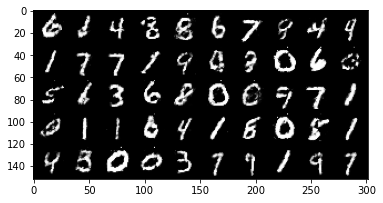

Iter: 99810/100000, Gen loss: 1.2248, Dis loss: 1.0447
Iter: 99820/100000, Gen loss: 1.1840, Dis loss: 1.0357
Iter: 99830/100000, Gen loss: 1.0441, Dis loss: 0.9766
Iter: 99840/100000, Gen loss: 0.8995, Dis loss: 1.0746
Iter: 99850/100000, Gen loss: 1.2598, Dis loss: 0.9212
Iter: 99860/100000, Gen loss: 1.3025, Dis loss: 1.0438
Iter: 99870/100000, Gen loss: 1.0678, Dis loss: 0.9869
Iter: 99880/100000, Gen loss: 1.3731, Dis loss: 1.1205
Iter: 99890/100000, Gen loss: 0.9944, Dis loss: 1.0333
Iter: 99900/100000, Gen loss: 1.0745, Dis loss: 1.1109
Iter: 99910/100000, Gen loss: 1.0890, Dis loss: 1.1882
Iter: 99920/100000, Gen loss: 1.5693, Dis loss: 0.9879
Iter: 99930/100000, Gen loss: 1.3507, Dis loss: 1.1776
Iter: 99940/100000, Gen loss: 1.2198, Dis loss: 0.8953
Iter: 99950/100000, Gen loss: 1.1931, Dis loss: 0.9904
Iter: 99960/100000, Gen loss: 1.0954, Dis loss: 1.0967
Iter: 99970/100000, Gen loss: 1.3146, Dis loss: 1.4030
Iter: 99980/100000, Gen loss: 1.0581, Dis loss: 1.0985
Iter: 9999

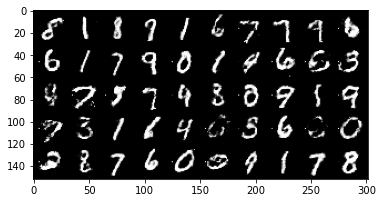

In [7]:
from torch.utils.data import DataLoader
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, drop_last=True)
dataloader_iter = iter(dataloader)

netG = Generator(latent_dim, img_dim).to(device)
netD = Discriminator(img_dim).to(device)

optimG = torch.optim.Adam(netG.parameters(), learning_rate)
optimD = torch.optim.Adam(netD.parameters(), learning_rate)


real_labels = torch.ones(batch_size).to(device)
fake_labels = torch.zeros(batch_size).to(device)

for it in range(total_iter):
    
    # train Discriminator
    for _ in range(num_D_updates_per_G_update):
        try:
            real_imgs, _ = next(dataloader_iter)
        except:
            dataloader_iter = iter(dataloader)
            real_imgs, _ = next(dataloader_iter)

        real_imgs = real_imgs.to(device)

        z = torch.randn((batch_size, latent_dim)).to(device)
        fake_imgs = netG(z).detach()
        
        real_probs = netD(real_imgs).squeeze()
        fake_probs = netD(fake_imgs).squeeze()

        ################ ToDo ################
        D_loss = -torch.mean(torch.log(real_probs)) - torch.mean(torch.log(1-fake_probs)) # real_prob은 1, fake_prob은 0이 되도록 학습
        
        optimD.zero_grad()
        D_loss.backward()
        optimD.step()
      
    # train the Generator
    z = torch.randn((batch_size, latent_dim)).to(device)
    fake_imgs = netG(z)
        
    fake_probs = netD(fake_imgs)

    ################ ToDo ################
    G_loss = -torch.mean(torch.log(fake_probs))  # fake_prob 이 1 이 되도록 학습

    optimG.zero_grad()
    G_loss.backward()
    optimG.step()
    
    if (it+1) % log_freq == 0:
        print("Iter: %05d/%d, Gen loss: %.4f, Dis loss: %.4f"%(it+1, total_iter,
                                                              G_loss.data.item(),
                                                              D_loss.data.item()))
    if (it+1) % viz_freq == 0:
        z = torch.randn((gen_num_samples, latent_dim)).to(device)
        with torch.no_grad():
            gen_imgs = netG(z)
        
        gen_imgs = make_grid(gen_imgs, nrow=10).permute(1, 2, 0).cpu().detach().numpy()
        plt.imshow(gen_imgs)
        plt.show()